In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation 
from IPython.display import display, HTML
import cv2 as cv
import numpy as np
import tensorflow as tf
from tqdm import trange 
from kaggle_secrets import UserSecretsClient
from kaggle_datasets import KaggleDatasets
import tensorflow_addons as tfa
from dataclasses import dataclass, asdict, field
import pandas as pd
import json

In [2]:
def build_dataset(path, batch=True, batch_size=5, cache=True, ordered=False, shuffle=False, test=False):
    dataset = tf.data.TFRecordDataset(path)
    ignore_order = tf.data.Options()
    if not ordered:
        ignore_order.experimental_deterministic = False
        
    dataset = dataset.with_options(ignore_order)
    
    image_feature_description = {
        'flow': tf.io.FixedLenFeature([], tf.string),
        'num': tf.io.FixedLenFeature([], tf.int64),
        'scene': tf.io.FixedLenFeature([], tf.string),
        'current_frame': tf.io.FixedLenFeature([], tf.string),
        'previous_frame': tf.io.FixedLenFeature([], tf.string),
    }

    def _parse_image_function(example_proto):
        content = tf.io.parse_single_example(example_proto, image_feature_description)
        current_frame = tf.cast(tf.io.decode_jpeg(content['current_frame']), tf.float32)/255.0
        previous_frame = tf.cast(tf.io.decode_jpeg(content['previous_frame']), tf.float32)/255.0
        if test:
            flow = tf.io.parse_tensor(content['flow'], tf.float64)
            
        else:
            flow = tf.io.parse_tensor(content['flow'], tf.float32)
            
        img_stacked = tf.concat([previous_frame, current_frame], axis=-1)
        return (img_stacked, flow)
    
    dataset = dataset.map(_parse_image_function, num_parallel_calls=tf.data.AUTOTUNE)
    if shuffle:
        dataset = dataset.shuffle(1024)
        
    if batch:
        dataset = dataset.batch(batch_size, drop_remainder=False)
        
    if cache:
        dataset = dataset.cache()
        
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    
    return dataset

In [3]:
class Angulizer(tf.keras.layers.Layer):
    def __init__(self):
        super(Angulizer, self).__init__()

    def call(self, inputs):
        div = tf.math.divide_no_nan(inputs[..., 1], inputs[..., 0])
        
        return tf.expand_dims(tf.math.atan(div), axis=-1)

In [4]:
class Model():
    def SobelXInitialiser(self, depth):
        def SobelXInitialiser(shape, dtype=tf.float32):
            """
            Sobel-X Kernel
            """
            
            sobel_x = tf.constant(
                [
                    [1, 0, -1], 
                    [2, 0, -2], 
                    [1, 0, -1], 
                ], dtype=dtype )
            sobel_x = tf.reshape(sobel_x, (3, 3, 1, 1))
            sobel_x = tf.tile(sobel_x, (1, 1, depth, 1))
            return sobel_x

        return SobelXInitialiser

    def SobelYInitialiser(self, depth):
        def SobelYInitialiser(shape, dtype=tf.float32):
            """
            Sobel-Y Kernel
            """
            
            sobel_y = tf.constant(
                [
                    [1, 2, 1], 
                    [0, 0, 0], 
                    [-1, -2, -1], 
                ], dtype=dtype )
            sobel_y = tf.reshape(sobel_y, (3, 3, 1, 1))
            sobel_y = tf.tile(sobel_y, (1, 1, depth, 1))
            return sobel_y
        
        return SobelYInitialiser

    def encoder_blk(self, inp: tf.Tensor, layers: int=2, filters: int=32, 
                    pool: bool=True, activation=None, residual=True):
        """
        Encoder Block
        """
        
        node_inp = tf.keras.layers.Conv2D(filters, (1, 1), 
                                          activation=activation, 
                                          padding='SAME')(inp)
        node = tf.keras.layers.Conv2D(filters, (3, 3), 
                                      activation=activation,
                                      padding='SAME')(node_inp)
        for i in range(layers-1):
            node = tf.keras.layers.Conv2D(filters, (3, 3), 
                                          activation=activation, 
                                          padding='SAME')(node)
            
        if residual:
            node = tf.keras.layers.Add()([node, node_inp])
            
        if pool:
            pool = tf.keras.layers.AveragePooling2D()(node)
            
        return node, pool

    def decoder_blk(self, inp: tf.Tensor, node: tf.Tensor, layers: int=2, filters: int=32, 
                    pool: bool=True, activation=None, residual=True):
        """
        Decoder Block
        """
        
        conv =  tf.keras.layers.Conv2DTranspose(filters, (3, 3), activation=activation, padding='SAME')(inp)
        for i in range(layers-1):
            conv = tf.keras.layers.Conv2DTranspose(filters, (3, 3), activation=activation, padding='SAME')(conv)
            
        ups = tf.keras.layers.UpSampling2D(interpolation='bilinear')(conv)

        # Optic Flow at current scale
        of = tf.keras.layers.Lambda(lambda x : x[:,:,:, 0:2])(ups)
        concat = tf.keras.layers.concatenate([ups, node], axis=-1)
        
        return concat, of
    
    def flow_net(self, inp, activation=None):
        """
        FlowNetSimple-UNet-like Architecture with Residuals Connections.
        """
        
        conv0 = tf.keras.layers.Conv2D(8, (5, 5), activation=activation, padding='SAME')(inp)
        
        # Encoder Blocks
        conv1, pool0 = self.encoder_blk(conv0, layers=2, filters=8, activation=activation, residual=True)
        conv2, pool1 = self.encoder_blk(pool0, layers=2, filters=16, activation=activation, residual=True)
        conv3, pool2 = self.encoder_blk(pool1, layers=2, filters=32, activation=activation, residual=True)
        conv4, pool3 = self.encoder_blk(pool2, layers=2, filters=32, activation=activation, residual=True)
        
        # Pipe
        conv = tf.keras.layers.Conv2D(64, (3, 3), activation=activation, padding='SAME')(pool3)
        conv = tf.keras.layers.Conv2D(64, (3, 3), activation=activation, padding='SAME')(conv)
        of_4 = tf.keras.layers.Lambda(lambda x : x[:,:,:, 0:2])(conv)
        
        # Decoder Blocks
        concat, of_3 = self.decoder_blk(conv, node=conv4, layers=2, filters=32, activation=activation)
        concat, of_2 = self.decoder_blk(concat, node=conv3, layers=2, filters=32, activation=activation)
        concat, of_1 = self.decoder_blk(concat, node=conv2, layers=2, filters=16, activation=activation)
        concat, _ = self.decoder_blk(concat, node=conv1, layers=2, filters=8, activation=activation)
        
        # Garnishing
        deconv3 =  tf.keras.layers.Conv2D(8, (3, 3), activation=activation, padding='SAME')(concat)
        deconv3 =  tf.keras.layers.Conv2D(4, (3, 3), activation=activation, padding='SAME')(deconv3)
        of_0 =  tf.keras.layers.Conv2D(2, (3, 3), activation=activation, padding='SAME')(deconv3)

        return of_0, of_1, of_2, of_3, of_4
    
    def downsample(self, inp: tf.Tensor, factor: int=1):
        """
        Downsample Tensors by factor of two using average pooling,
        Designed to downsample the input images for multi-scale coarse-to-fine warping.
        Inputs:
            Shape: (BATCH_SIZE, X, Y, C)
        Outputs:
            Shape: (BATCH_SIZE, X/(2^factor), Y/(2^factor), C)
        """
        
        pool = tf.keras.layers.AveragePooling2D()(inp)
        for _ in range(factor-1):
            pool = tf.keras.layers.AveragePooling2D()(pool)
        return pool
    
    def diff(self, inp: tf.Tensor, input_depth: int=2):
        """
        Differentiator: Designed to perform x- and y- directional differentiation after applying 3x3 gaussian smoothings
        Inputs:
            Shape: (BATCH_SIZE, X, Y, C)
        Outputs:
            Depthwise concatenation in the order [dx, dy] where dx, and dy both have same channels as the inputs
            Shape: [(BATCH_SIZE, X, Y, C), (BATCH_SIZE, X, Y, C)] = (BATCH_SIZE, X, Y, 2*C)
        """
        
        # x-derivative
#         xdiff = tf.keras.layers.DepthwiseConv2D((3, 3), (1, 1), depthwise_initializer=self.GaussianInitializer, 
#                                                 use_bias=None, trainable=False, padding='SAME')(inp)
        xdiff = tf.keras.layers.DepthwiseConv2D((3, 3), (1, 1), depthwise_initializer=self.SobelXInitialiser(input_depth), 
                                                use_bias=None, trainable=False, padding='VALID')(inp)
        xdiff = tf.keras.layers.ZeroPadding2D(padding=(1, 1))(xdiff)
        
        # y-derivative
#         ydiff = tf.keras.layers.DepthwiseConv2D((3, 3), (1, 1), depthwise_initializer=self.GaussianInitializer, 
#                                                 use_bias=None, trainable=False, padding='SAME')(inp)
        ydiff = tf.keras.layers.DepthwiseConv2D((3, 3), (1, 1), depthwise_initializer=self.SobelYInitialiser(input_depth), 
                                                use_bias=None, trainable=False, padding='VALID')(inp)
        ydiff = tf.keras.layers.ZeroPadding2D(padding=(1, 1))(ydiff)
        
        return tf.keras.layers.concatenate([xdiff, ydiff], axis=-1)
    
    def build_network(self, activation, load=False, path=None):
        """
        Defining the full network with differentiation and downsampling blocks
        Nomenclature:
            Inputs ---> Contains previous_frame, current_frame at index 0, 1 respectively
            of_x ---> Optic flow at scale x with u, v at index 0, 1 respectively
            
            Scale-3 ---> Resolution at 16x32
            Scale-2 ---> Resolution at 32x64
            Scale-1 ---> Resolution at 64x128
            Scale-0 ---> Resolution at 128x256 (Input Resolution)
                        
            Current frame ---> Frame at instant i
            Previous frame ---> Frame at instant i-1
            
            flow_x ---> Contains optic flow, input frames, and the x, y derivatives at scale x
        """
        
        # Define Input
        inp = tf.keras.Input((128, 256, 2))
        
        # Split input tensor into two separate tensors
        current_frame = tf.keras.layers.Lambda(lambda x : x[:,:,:,1])(inp)
        current_frame = tf.keras.layers.Reshape((128, 256, 1))(current_frame)
        previous_frame = tf.keras.layers.Lambda(lambda x : x[:,:,:,0])(inp)
        previous_frame = tf.keras.layers.Reshape((128, 256, 1))(previous_frame)
        
        # Define Main Network
        of_0, of_1, of_2, of_3, of_4 = self.flow_net(inp, activation=activation)

        # Add 3-stage downsample 
        inp_2x = self.downsample(inp, 1)
        inp_4x = self.downsample(inp, 2)
        inp_8x = self.downsample(inp, 3)
        inp_16x = self.downsample(inp, 4)
        
        # Concatentate the computed Optic Flow and downsampled image at scale  depthwise
        # Perform x- and y- differentiation on the concatenated result
        concat = tf.keras.layers.concatenate([of_0, inp])
        diff = self.diff(concat, input_depth=4)
        flow_0 = tf.keras.layers.concatenate([concat, diff])
        
        concat = tf.keras.layers.concatenate([of_1, inp_2x])
        diff = self.diff(concat, input_depth=4)
        flow_1 = tf.keras.layers.concatenate([concat, diff])

        concat = tf.keras.layers.concatenate([of_2, inp_4x])
        diff = self.diff(concat, input_depth=4)
        flow_2 = tf.keras.layers.concatenate([concat, diff])

        concat = tf.keras.layers.concatenate([of_3, inp_8x])
        diff = self.diff(concat, input_depth=4)
        flow_3 = tf.keras.layers.concatenate([concat, diff])
        
        concat = tf.keras.layers.concatenate([of_4, inp_16x])
        diff = self.diff(concat, input_depth=4)
        flow_4 = tf.keras.layers.concatenate([concat, diff])

        model = tf.keras.Model(inputs=inp, outputs=[flow_0, flow_1, flow_2, flow_3, flow_4])

        if load:
            model.load_weights(path)

        return model

In [5]:
model = Model().build_network(tf.keras.layers.LeakyReLU())

2022-08-23 09:28:15.844223: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


2022-08-23 09:28:15.969587: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-08-23 09:28:15.970514: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-08-23 09:28:15.972415: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-08-23 09:28:15.972806: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA 

In [6]:
# model.summary()
# tf.keras.utils.plot_model(model, show_shapes=True)

In [7]:

@dataclass
class Settings:
    name: str
    lr: float=0.0008
    lr_decay: float=0.8
    patience: int=12
    epochs: int=1000
    alpha: float=0.01 # Regularization parameter
    lmbda: float=0.8 # Gradient Constancy parameter
    epsilon: float=0.001
    multi_scale_weights: list=field(default_factory=list)
    def dict(self):
        return {k: str(v) for k, v in asdict(self).items()}

In [8]:
10e-3

0.01

In [9]:
def charbonier_penalizer(x: tf.Tensor, epsilon: float=10e-3):
    """
    Charbonnier Penaliser (Bruhn and Weickert 2005)
    """
    
    return tf.sqrt(x+tf.square(epsilon))

def IIDR(frame_diff, ux, uy, vx, vy, lmbda=1e-2):
    """
    Isotropic Flow-Driven Regularisation (Schn¨orr 1994) 
    """
    
    grad_mag = tf.square(ux) + tf.square(uy) + tf.square(vx) + tf.square(vy)
    return grad_mag

def IFDR(theta_mag, ux, uy, vx, vy, lmbda=1e-2):
    """
    Isotropic Flow-Driven Regularisation (Schn¨orr 1994) 
    """
    
    grad_mag = tf.square(ux) + tf.square(uy) + tf.square(vx) + tf.square(vy)
    return perona_malik_diffusivity(grad_mag, lmbda)*grad_mag

def charbonier_diffusivity(x, lmbda=1e-2):
    """
    Diffusivity for the Smoothness Term
    Charbonnier Diffusivity 
    """
    
    return 1/tf.sqrt(1 + x/tf.square(lmbda))

def perona_malik_diffusivity(x, lmbda=1e-2):
    """
    Diffusivity for the Smoothness Term
    Perona-Malik Diffusivity 
    """
    
    return 1/(1 + x/tf.square(lmbda))

def get_energy(flow, alpha, epsilon, lmbda):
    """
    Calulate Variational Energy Loss 
    """
    
    # Get the optic flow (u, v) and the corresponding derivatives
    of = flow[:, :, :, 0:2]
    ux = flow[:, :, :, 4]
    vx = flow[:, :, :, 5]
    uy = flow[:, :, :, 8]
    vy = flow[:, :, :, 9]
    frame0_diffx = tf.expand_dims(flow[:, :, :, 6], axis=-1)
    frame0_diffy = tf.expand_dims(flow[:, :, :, 10], axis=-1)
    frame_diff = tf.square(frame0_diffy) + tf.square(frame0_diffy)
    frame_diff = tf.squeeze(frame_diff, axis=-1)
    # Get previous and current frame with the corresponding derivatives 
    prev_frame = tf.expand_dims(flow[:, :, :, 2], axis=-1)
    current_frame = tf.expand_dims(flow[:, :, :, 3], axis=-1)
    
    # Warp the previous frame to match the next frame (Make sure to switch the u,v  to v,u)
    # Inverse Bilinear Warping of the current frame using computed optic flow
    warped_frame_current = tfa.image.dense_image_warp(current_frame, -of[:, :, :, ::-1])

    # Compute the squared differences of the current frame and the warped version of the previous frame
    brightness_loss = tf.square(prev_frame-warped_frame_current)

    # Compute data term for all pixels using the computed squared differences and the charbonier penalizer
    data_terms = charbonier_penalizer(brightness_loss, epsilon) #+ gradient_loss
    
    # Compute smoothness term using the x-y derivatives of u and v component of optic flow and perona malik diffusivity
    smoothness_term = IIDR(frame_diff, ux, uy, vx, vy, lmbda)
    
    # Sum up results for all pixels
    data_loss = tf.reduce_sum(data_terms, axis=[-3, -2, -1])
    smooth_loss = alpha*tf.reduce_sum(smoothness_term, axis=[-2, -1])

    return data_loss + smooth_loss

def compute_loss(pred, alpha, epsilon, lmbda, weights, of_gt, train):
    """
    Compute Variational Energy Loss, and EPE
    """
    
    epe = tf.reduce_mean(tf.norm(pred[0][:, :, :, 0:2]-of_gt, axis=-1))
    if train:
        
        # Compute energy for each scale 
        energy_0 = get_energy(pred[0], alpha, epsilon, lmbda)
        energy_1 = get_energy(pred[1], alpha, epsilon, lmbda)
        energy_2 = get_energy(pred[2], alpha, epsilon, lmbda)
        energy_3 = get_energy(pred[3], alpha, epsilon, lmbda)
        energy_4 = get_energy(pred[4], alpha, epsilon, lmbda)
        
        # Weighted summation of the energies of all scales
        energy = weights[0]*energy_0 + weights[1]*energy_1 + weights[2]*energy_2 + weights[3]*energy_3 + weights[4]*energy_4
        return energy, epe
    
    else:
        return 0, epe

def train(data, model, settings):
    """
    Training Loop
    """
    
    # Fetch config from settings
    pbar = trange(settings.epochs)
    optimiser = tf.keras.optimizers.Adam(settings.lr)
    alpha = tf.Variable(settings.alpha, trainable=False)
    epsilon = tf.Variable(settings.epsilon, trainable=False)
    lmbda = tf.Variable(settings.lmbda, trainable=False)
    weights = settings.multi_scale_weights
    patience = settings.patience
    lr_decay = settings.lr_decay
    
    losses = []
    counter = 0
    history = {'train': {'energy': [], 'epe': []}, 'val': {'epe': []}, 'lr': []}
    for i in pbar:
        iter_losses = []
        train_epe = []
        val_epe = []
        history['lr'].append(optimiser.lr.numpy())
        for batch in data[0]:
            loss, epe = train_step(batch, model, optimiser, alpha, epsilon, lmbda, weights, train=True)
            iter_losses.append(loss)
            train_epe.append(epe)
            
        epoch_loss = tf.reduce_mean(iter_losses).numpy()
        train_epoch_epe = tf.reduce_mean(train_epe).numpy()
        history['train']['energy'].append(epoch_loss)
        history['train']['epe'].append(train_epoch_epe)
        if(min(history['train']['energy']) < epoch_loss):
            counter += 1
            
        else:
            counter = 0
            model.save('ckpt.h5')
            
        if(patience is not None and counter == patience):
            counter = 0
            optimiser.lr.assign(optimiser.lr.numpy()*lr_decay)
            print(f"Learning rate decayed to: {optimiser.lr.numpy()}, Minimum (energy, epe) was: ({min(history['train']['energy'])}, {min(history['train']['epe'])})")
       
        val_losses = []
        if(data[1] is not None):
            for batch in data[1]:
                loss, epe = train_step(batch, model, optimiser, alpha, epsilon, lmbda, weights, train=False)
                val_epe.append(epe)
                
        val_epoch_epe = tf.reduce_mean(val_epe).numpy()
        history['val']['epe'].append(val_epoch_epe)
        pbar.set_description(f"energy:  {epoch_loss}, train_epe: {train_epoch_epe}, val_epe: {val_epoch_epe}, patience_count: {counter}")
        
    return model, history

In [10]:
@tf.function
def train_step(batch, model, optimiser, alpha, epsilon, lmbda, weights, train=True):
    """ 
    Single Forward and Backpropagation Step
    """
    
    with tf.GradientTape(persistent=False) as tape:
        pred = model(batch[0])
        energy_loss, epe = compute_loss(pred, alpha, epsilon, lmbda, weights, batch[1], train)
    
    if(train):
        grad = tape.gradient(energy_loss, model.trainable_variables)
        optimiser.apply_gradients(zip(grad, model.trainable_variables))
        
    return tf.reduce_mean(energy_loss), epe

In [11]:
settings = Settings(
    name='model.h5',
    lr=0.001, #0.0008
    lr_decay=0.8,
    patience=12,
    epochs=5000,
    alpha=0.01, #0.01
    lmbda=0.005, # 0.8, 0.1, 0.08
    epsilon=10e-3, 
    multi_scale_weights=[0.2, 0.4, 0.6, 0.8, 1]
)
file_paths = np.sort(tf.io.gfile.glob('../input/mpisinteltfrecord/train/albedo/*'))

In [12]:
# Load training and validation data
train_dataset = build_dataset(file_paths[0:8], batch_size=128, cache=True, shuffle=False)
val_dataset = build_dataset(file_paths[8:], batch_size=128, cache=True, shuffle=True)

# Initialize the model
model = Model().build_network(tf.keras.layers.LeakyReLU(), load=False, path='../input/of0001000095000/model.h5')

In [13]:
model, history = train((train_dataset, val_dataset), model, settings)
model.save(settings.name)

  0%|          | 0/5000 [00:00<?, ?it/s]

2022-08-23 09:28:20.140710: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


2022-08-23 09:28:29.683478: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


/opt/conda/lib/python3.7/site-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


energy:  533.9457397460938, train_epe: 12.671481132507324, val_epe: 13.536975860595703, patience_count: 0:   0%|          | 0/5000 [00:27<?, ?it/s]

energy:  533.9457397460938, train_epe: 12.671481132507324, val_epe: 13.536975860595703, patience_count: 0:   0%|          | 1/5000 [00:27<38:41:04, 27.86s/it]

energy:  532.0853881835938, train_epe: 12.716893196105957, val_epe: 13.545339584350586, patience_count: 0:   0%|          | 1/5000 [00:29<38:41:04, 27.86s/it]

energy:  532.0853881835938, train_epe: 12.716893196105957, val_epe: 13.545339584350586, patience_count: 0:   0%|          | 2/5000 [00:29<17:33:19, 12.65s/it]

energy:  530.4439697265625, train_epe: 12.697311401367188, val_epe: 13.550975799560547, patience_count: 0:   0%|          | 2/5000 [00:31<17:33:19, 12.65s/it]

energy:  530.4439697265625, train_epe: 12.697311401367188, val_epe: 13.550975799560547, patience_count: 0:   0%|          | 3/5000 [00:31<10:47:28,  7.77s/it]

energy:  529.3955688476562, train_epe: 12.708046913146973, val_epe: 13.554845809936523, patience_count: 0:   0%|          | 3/5000 [00:33<10:47:28,  7.77s/it]

energy:  529.3955688476562, train_epe: 12.708046913146973, val_epe: 13.554845809936523, patience_count: 0:   0%|          | 4/5000 [00:33<7:38:23,  5.51s/it] 

energy:  528.8404541015625, train_epe: 12.718069076538086, val_epe: 13.554035186767578, patience_count: 0:   0%|          | 4/5000 [00:35<7:38:23,  5.51s/it]

energy:  528.8404541015625, train_epe: 12.718069076538086, val_epe: 13.554035186767578, patience_count: 0:   0%|          | 5/5000 [00:35<5:54:20,  4.26s/it]

energy:  531.2290649414062, train_epe: 12.724528312683105, val_epe: 13.539491653442383, patience_count: 1:   0%|          | 5/5000 [00:37<5:54:20,  4.26s/it]

energy:  531.2290649414062, train_epe: 12.724528312683105, val_epe: 13.539491653442383, patience_count: 1:   0%|          | 6/5000 [00:37<4:47:48,  3.46s/it]

energy:  528.4457397460938, train_epe: 12.697819709777832, val_epe: 13.560216903686523, patience_count: 0:   0%|          | 6/5000 [00:39<4:47:48,  3.46s/it]

energy:  528.4457397460938, train_epe: 12.697819709777832, val_epe: 13.560216903686523, patience_count: 0:   0%|          | 7/5000 [00:39<4:07:55,  2.98s/it]

energy:  529.5965576171875, train_epe: 12.715235710144043, val_epe: 13.560464859008789, patience_count: 1:   0%|          | 7/5000 [00:41<4:07:55,  2.98s/it]

energy:  529.5965576171875, train_epe: 12.715235710144043, val_epe: 13.560464859008789, patience_count: 1:   0%|          | 8/5000 [00:41<3:38:44,  2.63s/it]

energy:  528.8152465820312, train_epe: 12.71087646484375, val_epe: 13.565227508544922, patience_count: 2:   0%|          | 8/5000 [00:43<3:38:44,  2.63s/it] 

energy:  528.8152465820312, train_epe: 12.71087646484375, val_epe: 13.565227508544922, patience_count: 2:   0%|          | 9/5000 [00:43<3:19:26,  2.40s/it]

energy:  528.9511108398438, train_epe: 12.719513893127441, val_epe: 13.560632705688477, patience_count: 3:   0%|          | 9/5000 [00:45<3:19:26,  2.40s/it]

energy:  528.9511108398438, train_epe: 12.719513893127441, val_epe: 13.560632705688477, patience_count: 3:   0%|          | 10/5000 [00:45<3:08:06,  2.26s/it]

energy:  528.1895141601562, train_epe: 12.703203201293945, val_epe: 13.567972183227539, patience_count: 0:   0%|          | 10/5000 [00:47<3:08:06,  2.26s/it]

energy:  528.1895141601562, train_epe: 12.703203201293945, val_epe: 13.567972183227539, patience_count: 0:   0%|          | 11/5000 [00:47<3:01:13,  2.18s/it]

energy:  528.3164672851562, train_epe: 12.720793724060059, val_epe: 13.561702728271484, patience_count: 1:   0%|          | 11/5000 [00:49<3:01:13,  2.18s/it]

energy:  528.3164672851562, train_epe: 12.720793724060059, val_epe: 13.561702728271484, patience_count: 1:   0%|          | 12/5000 [00:49<2:54:06,  2.09s/it]

energy:  527.3553466796875, train_epe: 12.710222244262695, val_epe: 13.573091506958008, patience_count: 0:   0%|          | 12/5000 [00:51<2:54:06,  2.09s/it]

energy:  527.3553466796875, train_epe: 12.710222244262695, val_epe: 13.573091506958008, patience_count: 0:   0%|          | 13/5000 [00:51<2:53:55,  2.09s/it]

energy:  527.5653076171875, train_epe: 12.72184944152832, val_epe: 13.555706024169922, patience_count: 1:   0%|          | 13/5000 [00:53<2:53:55,  2.09s/it] 

energy:  527.5653076171875, train_epe: 12.72184944152832, val_epe: 13.555706024169922, patience_count: 1:   0%|          | 14/5000 [00:53<2:48:36,  2.03s/it]

energy:  526.4844970703125, train_epe: 12.704025268554688, val_epe: 13.541901588439941, patience_count: 0:   0%|          | 14/5000 [00:55<2:48:36,  2.03s/it]

energy:  526.4844970703125, train_epe: 12.704025268554688, val_epe: 13.541901588439941, patience_count: 0:   0%|          | 15/5000 [00:55<2:47:41,  2.02s/it]

energy:  525.7659301757812, train_epe: 12.720463752746582, val_epe: 13.548377990722656, patience_count: 0:   0%|          | 15/5000 [00:57<2:47:41,  2.02s/it]

energy:  525.7659301757812, train_epe: 12.720463752746582, val_epe: 13.548377990722656, patience_count: 0:   0%|          | 16/5000 [00:57<2:48:37,  2.03s/it]

energy:  526.6381225585938, train_epe: 12.711359977722168, val_epe: 13.544960021972656, patience_count: 1:   0%|          | 16/5000 [00:59<2:48:37,  2.03s/it]

energy:  526.6381225585938, train_epe: 12.711359977722168, val_epe: 13.544960021972656, patience_count: 1:   0%|          | 17/5000 [00:59<2:45:27,  1.99s/it]

energy:  525.6580200195312, train_epe: 12.718381881713867, val_epe: 13.544672012329102, patience_count: 0:   0%|          | 17/5000 [01:01<2:45:27,  1.99s/it]

energy:  525.6580200195312, train_epe: 12.718381881713867, val_epe: 13.544672012329102, patience_count: 0:   0%|          | 18/5000 [01:01<2:44:34,  1.98s/it]

energy:  524.3746948242188, train_epe: 12.714333534240723, val_epe: 13.512301445007324, patience_count: 0:   0%|          | 18/5000 [01:03<2:44:34,  1.98s/it]

energy:  524.3746948242188, train_epe: 12.714333534240723, val_epe: 13.512301445007324, patience_count: 0:   0%|          | 19/5000 [01:03<2:44:09,  1.98s/it]

energy:  525.4826049804688, train_epe: 12.718749046325684, val_epe: 13.544595718383789, patience_count: 1:   0%|          | 19/5000 [01:05<2:44:09,  1.98s/it]

energy:  525.4826049804688, train_epe: 12.718749046325684, val_epe: 13.544595718383789, patience_count: 1:   0%|          | 20/5000 [01:05<2:42:14,  1.95s/it]

energy:  524.1150512695312, train_epe: 12.71003532409668, val_epe: 13.514394760131836, patience_count: 0:   0%|          | 20/5000 [01:07<2:42:14,  1.95s/it] 

energy:  524.1150512695312, train_epe: 12.71003532409668, val_epe: 13.514394760131836, patience_count: 0:   0%|          | 21/5000 [01:07<2:44:38,  1.98s/it]

energy:  523.5606689453125, train_epe: 12.714680671691895, val_epe: 13.52743911743164, patience_count: 0:   0%|          | 21/5000 [01:09<2:44:38,  1.98s/it]

energy:  523.5606689453125, train_epe: 12.714680671691895, val_epe: 13.52743911743164, patience_count: 0:   0%|          | 22/5000 [01:09<2:44:46,  1.99s/it]

energy:  522.8046264648438, train_epe: 12.712366104125977, val_epe: 13.529834747314453, patience_count: 0:   0%|          | 22/5000 [01:11<2:44:46,  1.99s/it]

energy:  522.8046264648438, train_epe: 12.712366104125977, val_epe: 13.529834747314453, patience_count: 0:   0%|          | 23/5000 [01:11<2:43:55,  1.98s/it]

energy:  521.6549682617188, train_epe: 12.710923194885254, val_epe: 13.492866516113281, patience_count: 0:   0%|          | 23/5000 [01:13<2:43:55,  1.98s/it]

energy:  521.6549682617188, train_epe: 12.710923194885254, val_epe: 13.492866516113281, patience_count: 0:   0%|          | 24/5000 [01:13<2:44:35,  1.98s/it]

energy:  522.9132690429688, train_epe: 12.716055870056152, val_epe: 13.522286415100098, patience_count: 1:   0%|          | 24/5000 [01:15<2:44:35,  1.98s/it]

energy:  522.9132690429688, train_epe: 12.716055870056152, val_epe: 13.522286415100098, patience_count: 1:   0%|          | 25/5000 [01:15<2:42:08,  1.96s/it]

energy:  522.1644287109375, train_epe: 12.716459274291992, val_epe: 13.530187606811523, patience_count: 2:   0%|          | 25/5000 [01:16<2:42:08,  1.96s/it]

energy:  522.1644287109375, train_epe: 12.716459274291992, val_epe: 13.530187606811523, patience_count: 2:   1%|          | 26/5000 [01:16<2:40:17,  1.93s/it]

energy:  521.0714721679688, train_epe: 12.705430030822754, val_epe: 13.47799301147461, patience_count: 0:   1%|          | 26/5000 [01:19<2:40:17,  1.93s/it] 

energy:  521.0714721679688, train_epe: 12.705430030822754, val_epe: 13.47799301147461, patience_count: 0:   1%|          | 27/5000 [01:19<2:43:21,  1.97s/it]

energy:  522.0499877929688, train_epe: 12.721571922302246, val_epe: 13.521871566772461, patience_count: 1:   1%|          | 27/5000 [01:20<2:43:21,  1.97s/it]

energy:  522.0499877929688, train_epe: 12.721571922302246, val_epe: 13.521871566772461, patience_count: 1:   1%|          | 28/5000 [01:20<2:40:52,  1.94s/it]

energy:  520.5653686523438, train_epe: 12.7102632522583, val_epe: 13.52030086517334, patience_count: 0:   1%|          | 28/5000 [01:22<2:40:52,  1.94s/it]   

energy:  520.5653686523438, train_epe: 12.7102632522583, val_epe: 13.52030086517334, patience_count: 0:   1%|          | 29/5000 [01:22<2:41:56,  1.95s/it]

energy:  520.0831909179688, train_epe: 12.72059154510498, val_epe: 13.49252700805664, patience_count: 0:   1%|          | 29/5000 [01:24<2:41:56,  1.95s/it]

energy:  520.0831909179688, train_epe: 12.72059154510498, val_epe: 13.49252700805664, patience_count: 0:   1%|          | 30/5000 [01:24<2:42:47,  1.97s/it]

energy:  521.7573852539062, train_epe: 12.728983879089355, val_epe: 13.524784088134766, patience_count: 1:   1%|          | 30/5000 [01:26<2:42:47,  1.97s/it]

energy:  521.7573852539062, train_epe: 12.728983879089355, val_epe: 13.524784088134766, patience_count: 1:   1%|          | 31/5000 [01:26<2:40:47,  1.94s/it]

energy:  521.2813110351562, train_epe: 12.69766902923584, val_epe: 13.500876426696777, patience_count: 2:   1%|          | 31/5000 [01:28<2:40:47,  1.94s/it] 

energy:  521.2813110351562, train_epe: 12.69766902923584, val_epe: 13.500876426696777, patience_count: 2:   1%|          | 32/5000 [01:28<2:39:22,  1.92s/it]

energy:  521.1973266601562, train_epe: 12.704460144042969, val_epe: 13.518474578857422, patience_count: 3:   1%|          | 32/5000 [01:30<2:39:22,  1.92s/it]

energy:  521.1973266601562, train_epe: 12.704460144042969, val_epe: 13.518474578857422, patience_count: 3:   1%|          | 33/5000 [01:30<2:39:36,  1.93s/it]

energy:  521.8043823242188, train_epe: 12.714362144470215, val_epe: 13.539095878601074, patience_count: 4:   1%|          | 33/5000 [01:32<2:39:36,  1.93s/it]

energy:  521.8043823242188, train_epe: 12.714362144470215, val_epe: 13.539095878601074, patience_count: 4:   1%|          | 34/5000 [01:32<2:38:13,  1.91s/it]

energy:  520.924560546875, train_epe: 12.704435348510742, val_epe: 13.438834190368652, patience_count: 5:   1%|          | 34/5000 [01:34<2:38:13,  1.91s/it] 

energy:  520.924560546875, train_epe: 12.704435348510742, val_epe: 13.438834190368652, patience_count: 5:   1%|          | 35/5000 [01:34<2:36:59,  1.90s/it]

energy:  521.129638671875, train_epe: 12.732369422912598, val_epe: 13.531587600708008, patience_count: 6:   1%|          | 35/5000 [01:36<2:36:59,  1.90s/it]

energy:  521.129638671875, train_epe: 12.732369422912598, val_epe: 13.531587600708008, patience_count: 6:   1%|          | 36/5000 [01:36<2:37:08,  1.90s/it]

energy:  519.4519653320312, train_epe: 12.706350326538086, val_epe: 13.507877349853516, patience_count: 0:   1%|          | 36/5000 [01:38<2:37:08,  1.90s/it]

energy:  519.4519653320312, train_epe: 12.706350326538086, val_epe: 13.507877349853516, patience_count: 0:   1%|          | 37/5000 [01:38<2:39:17,  1.93s/it]

energy:  518.9623413085938, train_epe: 12.714411735534668, val_epe: 13.509726524353027, patience_count: 0:   1%|          | 37/5000 [01:40<2:39:17,  1.93s/it]

energy:  518.9623413085938, train_epe: 12.714411735534668, val_epe: 13.509726524353027, patience_count: 0:   1%|          | 38/5000 [01:40<2:42:29,  1.96s/it]

energy:  517.9788818359375, train_epe: 12.713409423828125, val_epe: 13.525960922241211, patience_count: 0:   1%|          | 38/5000 [01:42<2:42:29,  1.96s/it]

energy:  517.9788818359375, train_epe: 12.713409423828125, val_epe: 13.525960922241211, patience_count: 0:   1%|          | 39/5000 [01:42<2:43:33,  1.98s/it]

energy:  518.5845947265625, train_epe: 12.70804500579834, val_epe: 13.526493072509766, patience_count: 1:   1%|          | 39/5000 [01:44<2:43:33,  1.98s/it] 

energy:  518.5845947265625, train_epe: 12.70804500579834, val_epe: 13.526493072509766, patience_count: 1:   1%|          | 40/5000 [01:44<2:41:36,  1.95s/it]

energy:  517.3483276367188, train_epe: 12.71174144744873, val_epe: 13.5289888381958, patience_count: 0:   1%|          | 40/5000 [01:46<2:41:36,  1.95s/it]  

energy:  517.3483276367188, train_epe: 12.71174144744873, val_epe: 13.5289888381958, patience_count: 0:   1%|          | 41/5000 [01:46<2:42:32,  1.97s/it]

energy:  518.1187744140625, train_epe: 12.720403671264648, val_epe: 13.483695983886719, patience_count: 1:   1%|          | 41/5000 [01:48<2:42:32,  1.97s/it]

energy:  518.1187744140625, train_epe: 12.720403671264648, val_epe: 13.483695983886719, patience_count: 1:   1%|          | 42/5000 [01:48<2:40:23,  1.94s/it]

energy:  517.9703979492188, train_epe: 12.696840286254883, val_epe: 13.511238098144531, patience_count: 2:   1%|          | 42/5000 [01:49<2:40:23,  1.94s/it]

energy:  517.9703979492188, train_epe: 12.696840286254883, val_epe: 13.511238098144531, patience_count: 2:   1%|          | 43/5000 [01:49<2:39:08,  1.93s/it]

energy:  517.8873291015625, train_epe: 12.720174789428711, val_epe: 13.512162208557129, patience_count: 3:   1%|          | 43/5000 [01:51<2:39:08,  1.93s/it]

energy:  517.8873291015625, train_epe: 12.720174789428711, val_epe: 13.512162208557129, patience_count: 3:   1%|          | 44/5000 [01:51<2:41:18,  1.95s/it]

energy:  516.0266723632812, train_epe: 12.709237098693848, val_epe: 13.495584487915039, patience_count: 0:   1%|          | 44/5000 [01:53<2:41:18,  1.95s/it]

energy:  516.0266723632812, train_epe: 12.709237098693848, val_epe: 13.495584487915039, patience_count: 0:   1%|          | 45/5000 [01:53<2:42:55,  1.97s/it]

energy:  515.4261474609375, train_epe: 12.712960243225098, val_epe: 13.505514144897461, patience_count: 0:   1%|          | 45/5000 [01:55<2:42:55,  1.97s/it]

energy:  515.4261474609375, train_epe: 12.712960243225098, val_epe: 13.505514144897461, patience_count: 0:   1%|          | 46/5000 [01:55<2:43:05,  1.98s/it]

energy:  514.0584716796875, train_epe: 12.698357582092285, val_epe: 13.507797241210938, patience_count: 0:   1%|          | 46/5000 [01:57<2:43:05,  1.98s/it]

energy:  514.0584716796875, train_epe: 12.698357582092285, val_epe: 13.507797241210938, patience_count: 0:   1%|          | 47/5000 [01:57<2:44:04,  1.99s/it]

energy:  522.7283325195312, train_epe: 12.676729202270508, val_epe: 13.494970321655273, patience_count: 1:   1%|          | 47/5000 [01:59<2:44:04,  1.99s/it]

energy:  522.7283325195312, train_epe: 12.676729202270508, val_epe: 13.494970321655273, patience_count: 1:   1%|          | 48/5000 [01:59<2:41:20,  1.95s/it]

energy:  525.0595092773438, train_epe: 12.695266723632812, val_epe: 13.524629592895508, patience_count: 2:   1%|          | 48/5000 [02:01<2:41:20,  1.95s/it]

energy:  525.0595092773438, train_epe: 12.695266723632812, val_epe: 13.524629592895508, patience_count: 2:   1%|          | 49/5000 [02:01<2:39:37,  1.93s/it]

energy:  522.6248168945312, train_epe: 12.693490028381348, val_epe: 13.462518692016602, patience_count: 3:   1%|          | 49/5000 [02:03<2:39:37,  1.93s/it]

energy:  522.6248168945312, train_epe: 12.693490028381348, val_epe: 13.462518692016602, patience_count: 3:   1%|          | 50/5000 [02:03<2:39:59,  1.94s/it]

energy:  522.7218017578125, train_epe: 12.725662231445312, val_epe: 13.517708778381348, patience_count: 4:   1%|          | 50/5000 [02:05<2:39:59,  1.94s/it]

energy:  522.7218017578125, train_epe: 12.725662231445312, val_epe: 13.517708778381348, patience_count: 4:   1%|          | 51/5000 [02:05<2:38:14,  1.92s/it]

energy:  519.6927490234375, train_epe: 12.720879554748535, val_epe: 13.482129096984863, patience_count: 5:   1%|          | 51/5000 [02:07<2:38:14,  1.92s/it]

energy:  519.6927490234375, train_epe: 12.720879554748535, val_epe: 13.482129096984863, patience_count: 5:   1%|          | 52/5000 [02:07<2:36:52,  1.90s/it]

energy:  518.7518310546875, train_epe: 12.717339515686035, val_epe: 13.51313304901123, patience_count: 6:   1%|          | 52/5000 [02:09<2:36:52,  1.90s/it] 

energy:  518.7518310546875, train_epe: 12.717339515686035, val_epe: 13.51313304901123, patience_count: 6:   1%|          | 53/5000 [02:09<2:36:15,  1.90s/it]

energy:  516.9461059570312, train_epe: 12.71049976348877, val_epe: 13.482688903808594, patience_count: 7:   1%|          | 53/5000 [02:11<2:36:15,  1.90s/it]

energy:  516.9461059570312, train_epe: 12.71049976348877, val_epe: 13.482688903808594, patience_count: 7:   1%|          | 54/5000 [02:11<2:36:13,  1.90s/it]

energy:  516.6153564453125, train_epe: 12.715657234191895, val_epe: 13.500650405883789, patience_count: 8:   1%|          | 54/5000 [02:13<2:36:13,  1.90s/it]

energy:  516.6153564453125, train_epe: 12.715657234191895, val_epe: 13.500650405883789, patience_count: 8:   1%|          | 55/5000 [02:13<2:37:36,  1.91s/it]

energy:  515.4182739257812, train_epe: 12.715104103088379, val_epe: 13.515199661254883, patience_count: 9:   1%|          | 55/5000 [02:15<2:37:36,  1.91s/it]

energy:  515.4182739257812, train_epe: 12.715104103088379, val_epe: 13.515199661254883, patience_count: 9:   1%|          | 56/5000 [02:15<2:37:42,  1.91s/it]

energy:  515.425048828125, train_epe: 12.716856002807617, val_epe: 13.489131927490234, patience_count: 10:   1%|          | 56/5000 [02:16<2:37:42,  1.91s/it]

energy:  515.425048828125, train_epe: 12.716856002807617, val_epe: 13.489131927490234, patience_count: 10:   1%|          | 57/5000 [02:16<2:36:28,  1.90s/it]

energy:  516.2286376953125, train_epe: 12.710312843322754, val_epe: 13.53610897064209, patience_count: 11:   1%|          | 57/5000 [02:18<2:36:28,  1.90s/it]

energy:  516.2286376953125, train_epe: 12.710312843322754, val_epe: 13.53610897064209, patience_count: 11:   1%|          | 58/5000 [02:18<2:36:21,  1.90s/it]

energy:  517.9771728515625, train_epe: 12.70848274230957, val_epe: 13.497331619262695, patience_count: 0:   1%|          | 58/5000 [02:20<2:36:21,  1.90s/it] 

energy:  517.9771728515625, train_epe: 12.70848274230957, val_epe: 13.497331619262695, patience_count: 0:   1%|          | 59/5000 [02:20<2:35:38,  1.89s/it]

Learning rate decayed to: 0.000800000037997961, Minimum (energy, epe) was: (514.0584716796875, 12.671481132507324)


energy:  516.4539184570312, train_epe: 12.71313762664795, val_epe: 13.475900650024414, patience_count: 1:   1%|          | 59/5000 [02:22<2:35:38,  1.89s/it]

energy:  516.4539184570312, train_epe: 12.71313762664795, val_epe: 13.475900650024414, patience_count: 1:   1%|          | 60/5000 [02:22<2:35:36,  1.89s/it]

energy:  515.2275390625, train_epe: 12.720246315002441, val_epe: 13.506260871887207, patience_count: 2:   1%|          | 60/5000 [02:24<2:35:36,  1.89s/it]  

energy:  515.2275390625, train_epe: 12.720246315002441, val_epe: 13.506260871887207, patience_count: 2:   1%|          | 61/5000 [02:24<2:36:52,  1.91s/it]

energy:  513.5969848632812, train_epe: 12.714505195617676, val_epe: 13.484508514404297, patience_count: 0:   1%|          | 61/5000 [02:26<2:36:52,  1.91s/it]

energy:  513.5969848632812, train_epe: 12.714505195617676, val_epe: 13.484508514404297, patience_count: 0:   1%|          | 62/5000 [02:26<2:38:48,  1.93s/it]

energy:  513.1532592773438, train_epe: 12.712821960449219, val_epe: 13.494060516357422, patience_count: 0:   1%|          | 62/5000 [02:28<2:38:48,  1.93s/it]

energy:  513.1532592773438, train_epe: 12.712821960449219, val_epe: 13.494060516357422, patience_count: 0:   1%|▏         | 63/5000 [02:28<2:39:40,  1.94s/it]

energy:  512.1638793945312, train_epe: 12.71339225769043, val_epe: 13.494843482971191, patience_count: 0:   1%|▏         | 63/5000 [02:30<2:39:40,  1.94s/it] 

energy:  512.1638793945312, train_epe: 12.71339225769043, val_epe: 13.494843482971191, patience_count: 0:   1%|▏         | 64/5000 [02:30<2:40:07,  1.95s/it]

energy:  512.2542724609375, train_epe: 12.712936401367188, val_epe: 13.466032028198242, patience_count: 1:   1%|▏         | 64/5000 [02:32<2:40:07,  1.95s/it]

energy:  512.2542724609375, train_epe: 12.712936401367188, val_epe: 13.466032028198242, patience_count: 1:   1%|▏         | 65/5000 [02:32<2:37:49,  1.92s/it]

energy:  511.7648010253906, train_epe: 12.703701972961426, val_epe: 13.46670150756836, patience_count: 0:   1%|▏         | 65/5000 [02:34<2:37:49,  1.92s/it] 

energy:  511.7648010253906, train_epe: 12.703701972961426, val_epe: 13.46670150756836, patience_count: 0:   1%|▏         | 66/5000 [02:34<2:39:00,  1.93s/it]

energy:  510.7093200683594, train_epe: 12.719987869262695, val_epe: 13.445714950561523, patience_count: 0:   1%|▏         | 66/5000 [02:36<2:39:00,  1.93s/it]

energy:  510.7093200683594, train_epe: 12.719987869262695, val_epe: 13.445714950561523, patience_count: 0:   1%|▏         | 67/5000 [02:36<2:41:21,  1.96s/it]

energy:  510.6110534667969, train_epe: 12.701143264770508, val_epe: 13.463590621948242, patience_count: 0:   1%|▏         | 67/5000 [02:38<2:41:21,  1.96s/it]

energy:  510.6110534667969, train_epe: 12.701143264770508, val_epe: 13.463590621948242, patience_count: 0:   1%|▏         | 68/5000 [02:38<2:41:29,  1.96s/it]

energy:  511.75482177734375, train_epe: 12.7116060256958, val_epe: 13.478067398071289, patience_count: 1:   1%|▏         | 68/5000 [02:40<2:41:29,  1.96s/it] 

energy:  511.75482177734375, train_epe: 12.7116060256958, val_epe: 13.478067398071289, patience_count: 1:   1%|▏         | 69/5000 [02:40<2:39:05,  1.94s/it]

energy:  513.0989990234375, train_epe: 12.694376945495605, val_epe: 13.504518508911133, patience_count: 2:   1%|▏         | 69/5000 [02:41<2:39:05,  1.94s/it]

energy:  513.0989990234375, train_epe: 12.694376945495605, val_epe: 13.504518508911133, patience_count: 2:   1%|▏         | 70/5000 [02:41<2:37:38,  1.92s/it]

energy:  512.3201904296875, train_epe: 12.698933601379395, val_epe: 13.424925804138184, patience_count: 3:   1%|▏         | 70/5000 [02:43<2:37:38,  1.92s/it]

energy:  512.3201904296875, train_epe: 12.698933601379395, val_epe: 13.424925804138184, patience_count: 3:   1%|▏         | 71/5000 [02:43<2:37:24,  1.92s/it]

energy:  510.493408203125, train_epe: 12.70938777923584, val_epe: 13.494232177734375, patience_count: 0:   1%|▏         | 71/5000 [02:45<2:37:24,  1.92s/it]  

energy:  510.493408203125, train_epe: 12.70938777923584, val_epe: 13.494232177734375, patience_count: 0:   1%|▏         | 72/5000 [02:45<2:41:38,  1.97s/it]

energy:  509.05377197265625, train_epe: 12.718572616577148, val_epe: 13.488987922668457, patience_count: 0:   1%|▏         | 72/5000 [02:48<2:41:38,  1.97s/it]

energy:  509.05377197265625, train_epe: 12.718572616577148, val_epe: 13.488987922668457, patience_count: 0:   1%|▏         | 73/5000 [02:48<2:43:43,  1.99s/it]

energy:  508.5564880371094, train_epe: 12.692206382751465, val_epe: 13.439556121826172, patience_count: 0:   1%|▏         | 73/5000 [02:50<2:43:43,  1.99s/it] 

energy:  508.5564880371094, train_epe: 12.692206382751465, val_epe: 13.439556121826172, patience_count: 0:   1%|▏         | 74/5000 [02:50<2:44:52,  2.01s/it]

energy:  508.53277587890625, train_epe: 12.698281288146973, val_epe: 13.40684986114502, patience_count: 0:   1%|▏         | 74/5000 [02:52<2:44:52,  2.01s/it]

energy:  508.53277587890625, train_epe: 12.698281288146973, val_epe: 13.40684986114502, patience_count: 0:   2%|▏         | 75/5000 [02:52<2:43:55,  2.00s/it]

energy:  508.00262451171875, train_epe: 12.696352005004883, val_epe: 13.44862174987793, patience_count: 0:   2%|▏         | 75/5000 [02:54<2:43:55,  2.00s/it]

energy:  508.00262451171875, train_epe: 12.696352005004883, val_epe: 13.44862174987793, patience_count: 0:   2%|▏         | 76/5000 [02:54<2:47:58,  2.05s/it]

energy:  506.9675598144531, train_epe: 12.70605182647705, val_epe: 13.440671920776367, patience_count: 0:   2%|▏         | 76/5000 [02:56<2:47:58,  2.05s/it] 

energy:  506.9675598144531, train_epe: 12.70605182647705, val_epe: 13.440671920776367, patience_count: 0:   2%|▏         | 77/5000 [02:56<2:46:35,  2.03s/it]

energy:  507.1148986816406, train_epe: 12.692641258239746, val_epe: 13.45187759399414, patience_count: 1:   2%|▏         | 77/5000 [02:58<2:46:35,  2.03s/it]

energy:  507.1148986816406, train_epe: 12.692641258239746, val_epe: 13.45187759399414, patience_count: 1:   2%|▏         | 78/5000 [02:58<2:44:39,  2.01s/it]

energy:  508.61968994140625, train_epe: 12.674764633178711, val_epe: 13.466147422790527, patience_count: 2:   2%|▏         | 78/5000 [03:00<2:44:39,  2.01s/it]

energy:  508.61968994140625, train_epe: 12.674764633178711, val_epe: 13.466147422790527, patience_count: 2:   2%|▏         | 79/5000 [03:00<2:41:56,  1.97s/it]

energy:  508.8879089355469, train_epe: 12.70036506652832, val_epe: 13.451251983642578, patience_count: 3:   2%|▏         | 79/5000 [03:01<2:41:56,  1.97s/it]  

energy:  508.8879089355469, train_epe: 12.70036506652832, val_epe: 13.451251983642578, patience_count: 3:   2%|▏         | 80/5000 [03:01<2:39:32,  1.95s/it]

energy:  505.8827819824219, train_epe: 12.683213233947754, val_epe: 13.41025447845459, patience_count: 0:   2%|▏         | 80/5000 [03:03<2:39:32,  1.95s/it]

energy:  505.8827819824219, train_epe: 12.683213233947754, val_epe: 13.41025447845459, patience_count: 0:   2%|▏         | 81/5000 [03:03<2:40:11,  1.95s/it]

energy:  505.78314208984375, train_epe: 12.696464538574219, val_epe: 13.465339660644531, patience_count: 0:   2%|▏         | 81/5000 [03:05<2:40:11,  1.95s/it]

energy:  505.78314208984375, train_epe: 12.696464538574219, val_epe: 13.465339660644531, patience_count: 0:   2%|▏         | 82/5000 [03:05<2:40:58,  1.96s/it]

energy:  505.3691101074219, train_epe: 12.695295333862305, val_epe: 13.415736198425293, patience_count: 0:   2%|▏         | 82/5000 [03:07<2:40:58,  1.96s/it] 

energy:  505.3691101074219, train_epe: 12.695295333862305, val_epe: 13.415736198425293, patience_count: 0:   2%|▏         | 83/5000 [03:07<2:42:51,  1.99s/it]

energy:  506.5316467285156, train_epe: 12.689173698425293, val_epe: 13.505306243896484, patience_count: 1:   2%|▏         | 83/5000 [03:09<2:42:51,  1.99s/it]

energy:  506.5316467285156, train_epe: 12.689173698425293, val_epe: 13.505306243896484, patience_count: 1:   2%|▏         | 84/5000 [03:09<2:41:15,  1.97s/it]

energy:  506.7132263183594, train_epe: 12.694830894470215, val_epe: 13.386750221252441, patience_count: 2:   2%|▏         | 84/5000 [03:11<2:41:15,  1.97s/it]

energy:  506.7132263183594, train_epe: 12.694830894470215, val_epe: 13.386750221252441, patience_count: 2:   2%|▏         | 85/5000 [03:11<2:39:01,  1.94s/it]

energy:  505.5555114746094, train_epe: 12.696112632751465, val_epe: 13.479741096496582, patience_count: 3:   2%|▏         | 85/5000 [03:13<2:39:01,  1.94s/it]

energy:  505.5555114746094, train_epe: 12.696112632751465, val_epe: 13.479741096496582, patience_count: 3:   2%|▏         | 86/5000 [03:13<2:37:26,  1.92s/it]

energy:  504.0490417480469, train_epe: 12.681450843811035, val_epe: 13.42969036102295, patience_count: 0:   2%|▏         | 86/5000 [03:15<2:37:26,  1.92s/it] 

energy:  504.0490417480469, train_epe: 12.681450843811035, val_epe: 13.42969036102295, patience_count: 0:   2%|▏         | 87/5000 [03:15<2:38:06,  1.93s/it]

energy:  501.3680114746094, train_epe: 12.663140296936035, val_epe: 13.445966720581055, patience_count: 0:   2%|▏         | 87/5000 [03:17<2:38:06,  1.93s/it]

energy:  501.3680114746094, train_epe: 12.663140296936035, val_epe: 13.445966720581055, patience_count: 0:   2%|▏         | 88/5000 [03:17<2:38:46,  1.94s/it]

energy:  499.8631286621094, train_epe: 12.66020393371582, val_epe: 13.380895614624023, patience_count: 0:   2%|▏         | 88/5000 [03:19<2:38:46,  1.94s/it] 

energy:  499.8631286621094, train_epe: 12.66020393371582, val_epe: 13.380895614624023, patience_count: 0:   2%|▏         | 89/5000 [03:19<2:42:12,  1.98s/it]

energy:  497.90093994140625, train_epe: 12.575590133666992, val_epe: 13.429998397827148, patience_count: 0:   2%|▏         | 89/5000 [03:21<2:42:12,  1.98s/it]

energy:  497.90093994140625, train_epe: 12.575590133666992, val_epe: 13.429998397827148, patience_count: 0:   2%|▏         | 90/5000 [03:21<2:42:41,  1.99s/it]

energy:  495.5908203125, train_epe: 12.523428916931152, val_epe: 13.353824615478516, patience_count: 0:   2%|▏         | 90/5000 [03:23<2:42:41,  1.99s/it]    

energy:  495.5908203125, train_epe: 12.523428916931152, val_epe: 13.353824615478516, patience_count: 0:   2%|▏         | 91/5000 [03:23<2:43:10,  1.99s/it]

energy:  494.6869812011719, train_epe: 12.522806167602539, val_epe: 13.472484588623047, patience_count: 0:   2%|▏         | 91/5000 [03:25<2:43:10,  1.99s/it]

energy:  494.6869812011719, train_epe: 12.522806167602539, val_epe: 13.472484588623047, patience_count: 0:   2%|▏         | 92/5000 [03:25<2:42:42,  1.99s/it]

energy:  502.3708801269531, train_epe: 12.515299797058105, val_epe: 13.349809646606445, patience_count: 1:   2%|▏         | 92/5000 [03:27<2:42:42,  1.99s/it]

energy:  502.3708801269531, train_epe: 12.515299797058105, val_epe: 13.349809646606445, patience_count: 1:   2%|▏         | 93/5000 [03:27<2:39:52,  1.95s/it]

energy:  506.238525390625, train_epe: 12.608545303344727, val_epe: 13.376641273498535, patience_count: 2:   2%|▏         | 93/5000 [03:29<2:39:52,  1.95s/it] 

energy:  506.238525390625, train_epe: 12.608545303344727, val_epe: 13.376641273498535, patience_count: 2:   2%|▏         | 94/5000 [03:29<2:37:49,  1.93s/it]

energy:  502.72662353515625, train_epe: 12.599058151245117, val_epe: 13.289405822753906, patience_count: 3:   2%|▏         | 94/5000 [03:31<2:37:49,  1.93s/it]

energy:  502.72662353515625, train_epe: 12.599058151245117, val_epe: 13.289405822753906, patience_count: 3:   2%|▏         | 95/5000 [03:31<2:38:11,  1.93s/it]

energy:  506.6774597167969, train_epe: 12.599173545837402, val_epe: 13.471851348876953, patience_count: 4:   2%|▏         | 95/5000 [03:33<2:38:11,  1.93s/it] 

energy:  506.6774597167969, train_epe: 12.599173545837402, val_epe: 13.471851348876953, patience_count: 4:   2%|▏         | 96/5000 [03:33<2:36:32,  1.92s/it]

energy:  501.94671630859375, train_epe: 12.600577354431152, val_epe: 13.463176727294922, patience_count: 5:   2%|▏         | 96/5000 [03:35<2:36:32,  1.92s/it]

energy:  501.94671630859375, train_epe: 12.600577354431152, val_epe: 13.463176727294922, patience_count: 5:   2%|▏         | 97/5000 [03:35<2:35:57,  1.91s/it]

energy:  498.8307800292969, train_epe: 12.509228706359863, val_epe: 13.471212387084961, patience_count: 6:   2%|▏         | 97/5000 [03:36<2:35:57,  1.91s/it] 

energy:  498.8307800292969, train_epe: 12.509228706359863, val_epe: 13.471212387084961, patience_count: 6:   2%|▏         | 98/5000 [03:36<2:34:32,  1.89s/it]

energy:  497.0065002441406, train_epe: 12.478151321411133, val_epe: 13.473869323730469, patience_count: 7:   2%|▏         | 98/5000 [03:38<2:34:32,  1.89s/it]

energy:  497.0065002441406, train_epe: 12.478151321411133, val_epe: 13.473869323730469, patience_count: 7:   2%|▏         | 99/5000 [03:38<2:34:08,  1.89s/it]

energy:  496.4885559082031, train_epe: 12.550541877746582, val_epe: 13.41253662109375, patience_count: 8:   2%|▏         | 99/5000 [03:40<2:34:08,  1.89s/it] 

energy:  496.4885559082031, train_epe: 12.550541877746582, val_epe: 13.41253662109375, patience_count: 8:   2%|▏         | 100/5000 [03:40<2:33:51,  1.88s/it]

energy:  497.12054443359375, train_epe: 12.539685249328613, val_epe: 13.418659210205078, patience_count: 9:   2%|▏         | 100/5000 [03:42<2:33:51,  1.88s/it]

energy:  497.12054443359375, train_epe: 12.539685249328613, val_epe: 13.418659210205078, patience_count: 9:   2%|▏         | 101/5000 [03:42<2:35:26,  1.90s/it]

energy:  496.8300476074219, train_epe: 12.573712348937988, val_epe: 13.421943664550781, patience_count: 10:   2%|▏         | 101/5000 [03:44<2:35:26,  1.90s/it]

energy:  496.8300476074219, train_epe: 12.573712348937988, val_epe: 13.421943664550781, patience_count: 10:   2%|▏         | 102/5000 [03:44<2:35:17,  1.90s/it]

energy:  492.8352355957031, train_epe: 12.556800842285156, val_epe: 13.357972145080566, patience_count: 0:   2%|▏         | 102/5000 [03:46<2:35:17,  1.90s/it] 

energy:  492.8352355957031, train_epe: 12.556800842285156, val_epe: 13.357972145080566, patience_count: 0:   2%|▏         | 103/5000 [03:46<2:37:19,  1.93s/it]

energy:  489.4728088378906, train_epe: 12.44660472869873, val_epe: 13.37967300415039, patience_count: 0:   2%|▏         | 103/5000 [03:48<2:37:19,  1.93s/it]  

energy:  489.4728088378906, train_epe: 12.44660472869873, val_epe: 13.37967300415039, patience_count: 0:   2%|▏         | 104/5000 [03:48<2:38:37,  1.94s/it]

energy:  491.1477966308594, train_epe: 12.491743087768555, val_epe: 13.388303756713867, patience_count: 1:   2%|▏         | 104/5000 [03:50<2:38:37,  1.94s/it]

energy:  491.1477966308594, train_epe: 12.491743087768555, val_epe: 13.388303756713867, patience_count: 1:   2%|▏         | 105/5000 [03:50<2:37:17,  1.93s/it]

energy:  499.7086486816406, train_epe: 12.551496505737305, val_epe: 13.402751922607422, patience_count: 2:   2%|▏         | 105/5000 [03:52<2:37:17,  1.93s/it]

energy:  499.7086486816406, train_epe: 12.551496505737305, val_epe: 13.402751922607422, patience_count: 2:   2%|▏         | 106/5000 [03:52<2:36:55,  1.92s/it]

energy:  504.1432189941406, train_epe: 12.604911804199219, val_epe: 13.457611083984375, patience_count: 3:   2%|▏         | 106/5000 [03:54<2:36:55,  1.92s/it]

energy:  504.1432189941406, train_epe: 12.604911804199219, val_epe: 13.457611083984375, patience_count: 3:   2%|▏         | 107/5000 [03:54<2:35:41,  1.91s/it]

energy:  499.6427917480469, train_epe: 12.559286117553711, val_epe: 13.480140686035156, patience_count: 4:   2%|▏         | 107/5000 [03:56<2:35:41,  1.91s/it]

energy:  499.6427917480469, train_epe: 12.559286117553711, val_epe: 13.480140686035156, patience_count: 4:   2%|▏         | 108/5000 [03:56<2:39:13,  1.95s/it]

energy:  498.0442810058594, train_epe: 12.537753105163574, val_epe: 13.393840789794922, patience_count: 5:   2%|▏         | 108/5000 [03:58<2:39:13,  1.95s/it]

energy:  498.0442810058594, train_epe: 12.537753105163574, val_epe: 13.393840789794922, patience_count: 5:   2%|▏         | 109/5000 [03:58<2:37:14,  1.93s/it]

energy:  497.53314208984375, train_epe: 12.559677124023438, val_epe: 13.457191467285156, patience_count: 6:   2%|▏         | 109/5000 [03:59<2:37:14,  1.93s/it]

energy:  497.53314208984375, train_epe: 12.559677124023438, val_epe: 13.457191467285156, patience_count: 6:   2%|▏         | 110/5000 [03:59<2:36:14,  1.92s/it]

energy:  493.376953125, train_epe: 12.520905494689941, val_epe: 13.448261260986328, patience_count: 7:   2%|▏         | 110/5000 [04:01<2:36:14,  1.92s/it]     

energy:  493.376953125, train_epe: 12.520905494689941, val_epe: 13.448261260986328, patience_count: 7:   2%|▏         | 111/5000 [04:01<2:35:25,  1.91s/it]

energy:  488.63690185546875, train_epe: 12.474356651306152, val_epe: 13.272074699401855, patience_count: 0:   2%|▏         | 111/5000 [04:03<2:35:25,  1.91s/it]

energy:  488.63690185546875, train_epe: 12.474356651306152, val_epe: 13.272074699401855, patience_count: 0:   2%|▏         | 112/5000 [04:03<2:38:16,  1.94s/it]

energy:  489.80963134765625, train_epe: 12.488012313842773, val_epe: 13.463642120361328, patience_count: 1:   2%|▏         | 112/5000 [04:05<2:38:16,  1.94s/it]

energy:  489.80963134765625, train_epe: 12.488012313842773, val_epe: 13.463642120361328, patience_count: 1:   2%|▏         | 113/5000 [04:05<2:36:36,  1.92s/it]

energy:  490.20703125, train_epe: 12.48505687713623, val_epe: 13.323049545288086, patience_count: 2:   2%|▏         | 113/5000 [04:07<2:36:36,  1.92s/it]       

energy:  490.20703125, train_epe: 12.48505687713623, val_epe: 13.323049545288086, patience_count: 2:   2%|▏         | 114/5000 [04:07<2:35:27,  1.91s/it]

energy:  491.71234130859375, train_epe: 12.552696228027344, val_epe: 13.374547958374023, patience_count: 3:   2%|▏         | 114/5000 [04:09<2:35:27,  1.91s/it]

energy:  491.71234130859375, train_epe: 12.552696228027344, val_epe: 13.374547958374023, patience_count: 3:   2%|▏         | 115/5000 [04:09<2:34:47,  1.90s/it]

energy:  487.3235778808594, train_epe: 12.466851234436035, val_epe: 13.358774185180664, patience_count: 0:   2%|▏         | 115/5000 [04:11<2:34:47,  1.90s/it] 

energy:  487.3235778808594, train_epe: 12.466851234436035, val_epe: 13.358774185180664, patience_count: 0:   2%|▏         | 116/5000 [04:11<2:36:02,  1.92s/it]

energy:  487.58837890625, train_epe: 12.45736026763916, val_epe: 13.322067260742188, patience_count: 1:   2%|▏         | 116/5000 [04:13<2:36:02,  1.92s/it]   

energy:  487.58837890625, train_epe: 12.45736026763916, val_epe: 13.322067260742188, patience_count: 1:   2%|▏         | 117/5000 [04:13<2:35:04,  1.91s/it]

energy:  488.77716064453125, train_epe: 12.514348983764648, val_epe: 13.349292755126953, patience_count: 2:   2%|▏         | 117/5000 [04:15<2:35:04,  1.91s/it]

energy:  488.77716064453125, train_epe: 12.514348983764648, val_epe: 13.349292755126953, patience_count: 2:   2%|▏         | 118/5000 [04:15<2:35:35,  1.91s/it]

energy:  490.74285888671875, train_epe: 12.448084831237793, val_epe: 13.359358787536621, patience_count: 3:   2%|▏         | 118/5000 [04:17<2:35:35,  1.91s/it]

energy:  490.74285888671875, train_epe: 12.448084831237793, val_epe: 13.359358787536621, patience_count: 3:   2%|▏         | 119/5000 [04:17<2:34:17,  1.90s/it]

energy:  485.08935546875, train_epe: 12.445836067199707, val_epe: 13.251110076904297, patience_count: 0:   2%|▏         | 119/5000 [04:19<2:34:17,  1.90s/it]   

energy:  485.08935546875, train_epe: 12.445836067199707, val_epe: 13.251110076904297, patience_count: 0:   2%|▏         | 120/5000 [04:19<2:35:46,  1.92s/it]

energy:  485.70648193359375, train_epe: 12.460511207580566, val_epe: 13.335010528564453, patience_count: 1:   2%|▏         | 120/5000 [04:20<2:35:46,  1.92s/it]

energy:  485.70648193359375, train_epe: 12.460511207580566, val_epe: 13.335010528564453, patience_count: 1:   2%|▏         | 121/5000 [04:20<2:35:04,  1.91s/it]

energy:  482.64263916015625, train_epe: 12.447661399841309, val_epe: 13.292872428894043, patience_count: 0:   2%|▏         | 121/5000 [04:22<2:35:04,  1.91s/it]

energy:  482.64263916015625, train_epe: 12.447661399841309, val_epe: 13.292872428894043, patience_count: 0:   2%|▏         | 122/5000 [04:22<2:37:02,  1.93s/it]

energy:  481.3353576660156, train_epe: 12.409088134765625, val_epe: 13.24902629852295, patience_count: 0:   2%|▏         | 122/5000 [04:25<2:37:02,  1.93s/it]  

energy:  481.3353576660156, train_epe: 12.409088134765625, val_epe: 13.24902629852295, patience_count: 0:   2%|▏         | 123/5000 [04:25<2:39:15,  1.96s/it]

energy:  480.3503112792969, train_epe: 12.370025634765625, val_epe: 13.333574295043945, patience_count: 0:   2%|▏         | 123/5000 [04:27<2:39:15,  1.96s/it]

energy:  480.3503112792969, train_epe: 12.370025634765625, val_epe: 13.333574295043945, patience_count: 0:   2%|▏         | 124/5000 [04:27<2:40:31,  1.98s/it]

energy:  484.00048828125, train_epe: 12.48125171661377, val_epe: 13.37563705444336, patience_count: 1:   2%|▏         | 124/5000 [04:28<2:40:31,  1.98s/it]    

energy:  484.00048828125, train_epe: 12.48125171661377, val_epe: 13.37563705444336, patience_count: 1:   2%|▎         | 125/5000 [04:28<2:38:44,  1.95s/it]

energy:  482.6105651855469, train_epe: 12.355758666992188, val_epe: 13.34603500366211, patience_count: 2:   2%|▎         | 125/5000 [04:30<2:38:44,  1.95s/it]

energy:  482.6105651855469, train_epe: 12.355758666992188, val_epe: 13.34603500366211, patience_count: 2:   3%|▎         | 126/5000 [04:30<2:36:27,  1.93s/it]

energy:  483.9236755371094, train_epe: 12.470368385314941, val_epe: 13.361029624938965, patience_count: 3:   3%|▎         | 126/5000 [04:32<2:36:27,  1.93s/it]

energy:  483.9236755371094, train_epe: 12.470368385314941, val_epe: 13.361029624938965, patience_count: 3:   3%|▎         | 127/5000 [04:32<2:35:09,  1.91s/it]

energy:  481.2705383300781, train_epe: 12.400492668151855, val_epe: 13.30528736114502, patience_count: 4:   3%|▎         | 127/5000 [04:34<2:35:09,  1.91s/it] 

energy:  481.2705383300781, train_epe: 12.400492668151855, val_epe: 13.30528736114502, patience_count: 4:   3%|▎         | 128/5000 [04:34<2:34:43,  1.91s/it]

energy:  481.6337890625, train_epe: 12.458537101745605, val_epe: 13.329000473022461, patience_count: 5:   3%|▎         | 128/5000 [04:36<2:34:43,  1.91s/it]  

energy:  481.6337890625, train_epe: 12.458537101745605, val_epe: 13.329000473022461, patience_count: 5:   3%|▎         | 129/5000 [04:36<2:35:58,  1.92s/it]

energy:  477.9356994628906, train_epe: 12.366406440734863, val_epe: 13.332258224487305, patience_count: 0:   3%|▎         | 129/5000 [04:38<2:35:58,  1.92s/it]

energy:  477.9356994628906, train_epe: 12.366406440734863, val_epe: 13.332258224487305, patience_count: 0:   3%|▎         | 130/5000 [04:38<2:37:39,  1.94s/it]

energy:  477.6398620605469, train_epe: 12.388021469116211, val_epe: 13.360984802246094, patience_count: 0:   3%|▎         | 130/5000 [04:40<2:37:39,  1.94s/it]

energy:  477.6398620605469, train_epe: 12.388021469116211, val_epe: 13.360984802246094, patience_count: 0:   3%|▎         | 131/5000 [04:40<2:38:31,  1.95s/it]

energy:  480.9892272949219, train_epe: 12.49543571472168, val_epe: 13.24336051940918, patience_count: 1:   3%|▎         | 131/5000 [04:42<2:38:31,  1.95s/it]  

energy:  480.9892272949219, train_epe: 12.49543571472168, val_epe: 13.24336051940918, patience_count: 1:   3%|▎         | 132/5000 [04:42<2:37:05,  1.94s/it]

energy:  480.0911560058594, train_epe: 12.384478569030762, val_epe: 13.352590560913086, patience_count: 2:   3%|▎         | 132/5000 [04:44<2:37:05,  1.94s/it]

energy:  480.0911560058594, train_epe: 12.384478569030762, val_epe: 13.352590560913086, patience_count: 2:   3%|▎         | 133/5000 [04:44<2:35:44,  1.92s/it]

energy:  484.78302001953125, train_epe: 12.422369956970215, val_epe: 13.337320327758789, patience_count: 3:   3%|▎         | 133/5000 [04:46<2:35:44,  1.92s/it]

energy:  484.78302001953125, train_epe: 12.422369956970215, val_epe: 13.337320327758789, patience_count: 3:   3%|▎         | 134/5000 [04:46<2:35:12,  1.91s/it]

energy:  482.3456115722656, train_epe: 12.432435989379883, val_epe: 13.42494010925293, patience_count: 4:   3%|▎         | 134/5000 [04:48<2:35:12,  1.91s/it]  

energy:  482.3456115722656, train_epe: 12.432435989379883, val_epe: 13.42494010925293, patience_count: 4:   3%|▎         | 135/5000 [04:48<2:36:24,  1.93s/it]

energy:  484.2511901855469, train_epe: 12.484176635742188, val_epe: 13.171941757202148, patience_count: 5:   3%|▎         | 135/5000 [04:50<2:36:24,  1.93s/it]

energy:  484.2511901855469, train_epe: 12.484176635742188, val_epe: 13.171941757202148, patience_count: 5:   3%|▎         | 136/5000 [04:50<2:35:43,  1.92s/it]

energy:  481.8269958496094, train_epe: 12.407196998596191, val_epe: 13.36047077178955, patience_count: 6:   3%|▎         | 136/5000 [04:51<2:35:43,  1.92s/it] 

energy:  481.8269958496094, train_epe: 12.407196998596191, val_epe: 13.36047077178955, patience_count: 6:   3%|▎         | 137/5000 [04:51<2:34:48,  1.91s/it]

energy:  480.0190124511719, train_epe: 12.398272514343262, val_epe: 13.196540832519531, patience_count: 7:   3%|▎         | 137/5000 [04:53<2:34:48,  1.91s/it]

energy:  480.0190124511719, train_epe: 12.398272514343262, val_epe: 13.196540832519531, patience_count: 7:   3%|▎         | 138/5000 [04:53<2:34:18,  1.90s/it]

energy:  484.83294677734375, train_epe: 12.513727188110352, val_epe: 13.309715270996094, patience_count: 8:   3%|▎         | 138/5000 [04:55<2:34:18,  1.90s/it]

energy:  484.83294677734375, train_epe: 12.513727188110352, val_epe: 13.309715270996094, patience_count: 8:   3%|▎         | 139/5000 [04:55<2:34:22,  1.91s/it]

energy:  479.984130859375, train_epe: 12.400923728942871, val_epe: 13.252065658569336, patience_count: 9:   3%|▎         | 139/5000 [04:58<2:34:22,  1.91s/it]  

energy:  479.984130859375, train_epe: 12.400923728942871, val_epe: 13.252065658569336, patience_count: 9:   3%|▎         | 140/5000 [04:58<2:52:53,  2.13s/it]

energy:  475.3955383300781, train_epe: 12.373208999633789, val_epe: 13.311847686767578, patience_count: 0:   3%|▎         | 140/5000 [05:00<2:52:53,  2.13s/it]

energy:  475.3955383300781, train_epe: 12.373208999633789, val_epe: 13.311847686767578, patience_count: 0:   3%|▎         | 141/5000 [05:00<2:48:31,  2.08s/it]

energy:  475.4944763183594, train_epe: 12.36118221282959, val_epe: 13.251646041870117, patience_count: 1:   3%|▎         | 141/5000 [05:02<2:48:31,  2.08s/it] 

energy:  475.4944763183594, train_epe: 12.36118221282959, val_epe: 13.251646041870117, patience_count: 1:   3%|▎         | 142/5000 [05:02<2:43:17,  2.02s/it]

energy:  481.8046875, train_epe: 12.481846809387207, val_epe: 13.166812896728516, patience_count: 2:   3%|▎         | 142/5000 [05:04<2:43:17,  2.02s/it]     

energy:  481.8046875, train_epe: 12.481846809387207, val_epe: 13.166812896728516, patience_count: 2:   3%|▎         | 143/5000 [05:04<2:39:10,  1.97s/it]

energy:  476.0798034667969, train_epe: 12.390562057495117, val_epe: 13.26547622680664, patience_count: 3:   3%|▎         | 143/5000 [05:05<2:39:10,  1.97s/it]

energy:  476.0798034667969, train_epe: 12.390562057495117, val_epe: 13.26547622680664, patience_count: 3:   3%|▎         | 144/5000 [05:05<2:37:00,  1.94s/it]

energy:  479.0476989746094, train_epe: 12.369489669799805, val_epe: 13.265798568725586, patience_count: 4:   3%|▎         | 144/5000 [05:07<2:37:00,  1.94s/it]

energy:  479.0476989746094, train_epe: 12.369489669799805, val_epe: 13.265798568725586, patience_count: 4:   3%|▎         | 145/5000 [05:07<2:35:33,  1.92s/it]

energy:  488.7624206542969, train_epe: 12.564560890197754, val_epe: 13.260690689086914, patience_count: 5:   3%|▎         | 145/5000 [05:09<2:35:33,  1.92s/it]

energy:  488.7624206542969, train_epe: 12.564560890197754, val_epe: 13.260690689086914, patience_count: 5:   3%|▎         | 146/5000 [05:09<2:35:09,  1.92s/it]

energy:  484.5500183105469, train_epe: 12.524096488952637, val_epe: 13.325483322143555, patience_count: 6:   3%|▎         | 146/5000 [05:11<2:35:09,  1.92s/it]

energy:  484.5500183105469, train_epe: 12.524096488952637, val_epe: 13.325483322143555, patience_count: 6:   3%|▎         | 147/5000 [05:11<2:34:12,  1.91s/it]

energy:  478.5763244628906, train_epe: 12.402594566345215, val_epe: 13.20433521270752, patience_count: 7:   3%|▎         | 147/5000 [05:13<2:34:12,  1.91s/it] 

energy:  478.5763244628906, train_epe: 12.402594566345215, val_epe: 13.20433521270752, patience_count: 7:   3%|▎         | 148/5000 [05:13<2:34:01,  1.90s/it]

energy:  479.6199035644531, train_epe: 12.403488159179688, val_epe: 13.209692001342773, patience_count: 8:   3%|▎         | 148/5000 [05:15<2:34:01,  1.90s/it]

energy:  479.6199035644531, train_epe: 12.403488159179688, val_epe: 13.209692001342773, patience_count: 8:   3%|▎         | 149/5000 [05:15<2:33:42,  1.90s/it]

energy:  479.0248107910156, train_epe: 12.40255069732666, val_epe: 13.350663185119629, patience_count: 9:   3%|▎         | 149/5000 [05:17<2:33:42,  1.90s/it] 

energy:  479.0248107910156, train_epe: 12.40255069732666, val_epe: 13.350663185119629, patience_count: 9:   3%|▎         | 150/5000 [05:17<2:33:02,  1.89s/it]

energy:  484.6827697753906, train_epe: 12.51630687713623, val_epe: 13.327070236206055, patience_count: 10:   3%|▎         | 150/5000 [05:19<2:33:02,  1.89s/it]

energy:  484.6827697753906, train_epe: 12.51630687713623, val_epe: 13.327070236206055, patience_count: 10:   3%|▎         | 151/5000 [05:19<2:33:17,  1.90s/it]

energy:  480.11419677734375, train_epe: 12.432730674743652, val_epe: 13.262825012207031, patience_count: 11:   3%|▎         | 151/5000 [05:21<2:33:17,  1.90s/it]

energy:  480.11419677734375, train_epe: 12.432730674743652, val_epe: 13.262825012207031, patience_count: 11:   3%|▎         | 152/5000 [05:21<2:33:34,  1.90s/it]

energy:  477.7399597167969, train_epe: 12.43756103515625, val_epe: 13.293895721435547, patience_count: 0:   3%|▎         | 152/5000 [05:22<2:33:34,  1.90s/it]   

energy:  477.7399597167969, train_epe: 12.43756103515625, val_epe: 13.293895721435547, patience_count: 0:   3%|▎         | 153/5000 [05:22<2:33:19,  1.90s/it]

Learning rate decayed to: 0.000640000042039901, Minimum (energy, epe) was: (475.3955383300781, 12.355758666992188)


energy:  471.12939453125, train_epe: 12.35258960723877, val_epe: 13.226125717163086, patience_count: 0:   3%|▎         | 153/5000 [05:24<2:33:19,  1.90s/it]  

energy:  471.12939453125, train_epe: 12.35258960723877, val_epe: 13.226125717163086, patience_count: 0:   3%|▎         | 154/5000 [05:24<2:34:38,  1.91s/it]

energy:  469.3632507324219, train_epe: 12.320221900939941, val_epe: 13.22634220123291, patience_count: 0:   3%|▎         | 154/5000 [05:26<2:34:38,  1.91s/it]

energy:  469.3632507324219, train_epe: 12.320221900939941, val_epe: 13.22634220123291, patience_count: 0:   3%|▎         | 155/5000 [05:26<2:35:59,  1.93s/it]

energy:  467.88677978515625, train_epe: 12.356606483459473, val_epe: 13.082015991210938, patience_count: 0:   3%|▎         | 155/5000 [05:28<2:35:59,  1.93s/it]

energy:  467.88677978515625, train_epe: 12.356606483459473, val_epe: 13.082015991210938, patience_count: 0:   3%|▎         | 156/5000 [05:28<2:36:02,  1.93s/it]

energy:  465.35308837890625, train_epe: 12.281245231628418, val_epe: 13.170631408691406, patience_count: 0:   3%|▎         | 156/5000 [05:30<2:36:02,  1.93s/it]

energy:  465.35308837890625, train_epe: 12.281245231628418, val_epe: 13.170631408691406, patience_count: 0:   3%|▎         | 157/5000 [05:30<2:39:01,  1.97s/it]

energy:  466.2096252441406, train_epe: 12.269914627075195, val_epe: 13.186863899230957, patience_count: 1:   3%|▎         | 157/5000 [05:32<2:39:01,  1.97s/it] 

energy:  466.2096252441406, train_epe: 12.269914627075195, val_epe: 13.186863899230957, patience_count: 1:   3%|▎         | 158/5000 [05:32<2:36:43,  1.94s/it]

energy:  466.4427185058594, train_epe: 12.355854988098145, val_epe: 13.124578475952148, patience_count: 2:   3%|▎         | 158/5000 [05:34<2:36:43,  1.94s/it]

energy:  466.4427185058594, train_epe: 12.355854988098145, val_epe: 13.124578475952148, patience_count: 2:   3%|▎         | 159/5000 [05:34<2:34:53,  1.92s/it]

energy:  465.20306396484375, train_epe: 12.268908500671387, val_epe: 13.109376907348633, patience_count: 0:   3%|▎         | 159/5000 [05:36<2:34:53,  1.92s/it]

energy:  465.20306396484375, train_epe: 12.268908500671387, val_epe: 13.109376907348633, patience_count: 0:   3%|▎         | 160/5000 [05:36<2:36:00,  1.93s/it]

energy:  465.9411926269531, train_epe: 12.292075157165527, val_epe: 13.04798698425293, patience_count: 1:   3%|▎         | 160/5000 [05:38<2:36:00,  1.93s/it]  

energy:  465.9411926269531, train_epe: 12.292075157165527, val_epe: 13.04798698425293, patience_count: 1:   3%|▎         | 161/5000 [05:38<2:34:30,  1.92s/it]

energy:  462.31292724609375, train_epe: 12.26286792755127, val_epe: 13.073556900024414, patience_count: 0:   3%|▎         | 161/5000 [05:40<2:34:30,  1.92s/it]

energy:  462.31292724609375, train_epe: 12.26286792755127, val_epe: 13.073556900024414, patience_count: 0:   3%|▎         | 162/5000 [05:40<2:36:07,  1.94s/it]

energy:  462.22796630859375, train_epe: 12.254715919494629, val_epe: 13.088793754577637, patience_count: 0:   3%|▎         | 162/5000 [05:42<2:36:07,  1.94s/it]

energy:  462.22796630859375, train_epe: 12.254715919494629, val_epe: 13.088793754577637, patience_count: 0:   3%|▎         | 163/5000 [05:42<2:37:18,  1.95s/it]

energy:  462.3136901855469, train_epe: 12.225418090820312, val_epe: 13.18263053894043, patience_count: 1:   3%|▎         | 163/5000 [05:44<2:37:18,  1.95s/it]  

energy:  462.3136901855469, train_epe: 12.225418090820312, val_epe: 13.18263053894043, patience_count: 1:   3%|▎         | 164/5000 [05:44<2:35:29,  1.93s/it]

energy:  464.9056091308594, train_epe: 12.306646347045898, val_epe: 12.920780181884766, patience_count: 2:   3%|▎         | 164/5000 [05:46<2:35:29,  1.93s/it]

energy:  464.9056091308594, train_epe: 12.306646347045898, val_epe: 12.920780181884766, patience_count: 2:   3%|▎         | 165/5000 [05:46<2:33:52,  1.91s/it]

energy:  462.153564453125, train_epe: 12.215592384338379, val_epe: 13.070372581481934, patience_count: 0:   3%|▎         | 165/5000 [05:48<2:33:52,  1.91s/it] 

energy:  462.153564453125, train_epe: 12.215592384338379, val_epe: 13.070372581481934, patience_count: 0:   3%|▎         | 166/5000 [05:48<2:35:50,  1.93s/it]

energy:  462.8595275878906, train_epe: 12.228890419006348, val_epe: 12.943589210510254, patience_count: 1:   3%|▎         | 166/5000 [05:50<2:35:50,  1.93s/it]

energy:  462.8595275878906, train_epe: 12.228890419006348, val_epe: 12.943589210510254, patience_count: 1:   3%|▎         | 167/5000 [05:50<2:34:34,  1.92s/it]

energy:  462.8746643066406, train_epe: 12.273303031921387, val_epe: 12.988258361816406, patience_count: 2:   3%|▎         | 167/5000 [05:51<2:34:34,  1.92s/it]

energy:  462.8746643066406, train_epe: 12.273303031921387, val_epe: 12.988258361816406, patience_count: 2:   3%|▎         | 168/5000 [05:51<2:33:28,  1.91s/it]

energy:  460.95343017578125, train_epe: 12.19610595703125, val_epe: 13.010274887084961, patience_count: 0:   3%|▎         | 168/5000 [05:53<2:33:28,  1.91s/it]

energy:  460.95343017578125, train_epe: 12.19610595703125, val_epe: 13.010274887084961, patience_count: 0:   3%|▎         | 169/5000 [05:53<2:37:11,  1.95s/it]

energy:  462.03131103515625, train_epe: 12.218741416931152, val_epe: 13.21347713470459, patience_count: 1:   3%|▎         | 169/5000 [05:55<2:37:11,  1.95s/it]

energy:  462.03131103515625, train_epe: 12.218741416931152, val_epe: 13.21347713470459, patience_count: 1:   3%|▎         | 170/5000 [05:55<2:35:23,  1.93s/it]

energy:  464.6825256347656, train_epe: 12.288766860961914, val_epe: 13.043790817260742, patience_count: 2:   3%|▎         | 170/5000 [05:57<2:35:23,  1.93s/it]

energy:  464.6825256347656, train_epe: 12.288766860961914, val_epe: 13.043790817260742, patience_count: 2:   3%|▎         | 171/5000 [05:57<2:33:48,  1.91s/it]

energy:  461.8962097167969, train_epe: 12.224672317504883, val_epe: 13.035102844238281, patience_count: 3:   3%|▎         | 171/5000 [05:59<2:33:48,  1.91s/it]

energy:  461.8962097167969, train_epe: 12.224672317504883, val_epe: 13.035102844238281, patience_count: 3:   3%|▎         | 172/5000 [05:59<2:36:53,  1.95s/it]

energy:  461.6471252441406, train_epe: 12.199498176574707, val_epe: 12.902264595031738, patience_count: 4:   3%|▎         | 172/5000 [06:01<2:36:53,  1.95s/it]

energy:  461.6471252441406, train_epe: 12.199498176574707, val_epe: 12.902264595031738, patience_count: 4:   3%|▎         | 173/5000 [06:01<2:34:49,  1.92s/it]

energy:  461.42974853515625, train_epe: 12.254088401794434, val_epe: 13.007891654968262, patience_count: 5:   3%|▎         | 173/5000 [06:03<2:34:49,  1.92s/it]

energy:  461.42974853515625, train_epe: 12.254088401794434, val_epe: 13.007891654968262, patience_count: 5:   3%|▎         | 174/5000 [06:03<2:34:03,  1.92s/it]

energy:  459.04791259765625, train_epe: 12.171720504760742, val_epe: 13.065255165100098, patience_count: 0:   3%|▎         | 174/5000 [06:05<2:34:03,  1.92s/it]

energy:  459.04791259765625, train_epe: 12.171720504760742, val_epe: 13.065255165100098, patience_count: 0:   4%|▎         | 175/5000 [06:05<2:38:04,  1.97s/it]

energy:  460.0423889160156, train_epe: 12.191956520080566, val_epe: 13.154767036437988, patience_count: 1:   4%|▎         | 175/5000 [06:07<2:38:04,  1.97s/it] 

energy:  460.0423889160156, train_epe: 12.191956520080566, val_epe: 13.154767036437988, patience_count: 1:   4%|▎         | 176/5000 [06:07<2:36:06,  1.94s/it]

energy:  462.62371826171875, train_epe: 12.276890754699707, val_epe: 12.916448593139648, patience_count: 2:   4%|▎         | 176/5000 [06:09<2:36:06,  1.94s/it]

energy:  462.62371826171875, train_epe: 12.276890754699707, val_epe: 12.916448593139648, patience_count: 2:   4%|▎         | 177/5000 [06:09<2:34:44,  1.92s/it]

energy:  460.5668029785156, train_epe: 12.147196769714355, val_epe: 13.086274147033691, patience_count: 3:   4%|▎         | 177/5000 [06:11<2:34:44,  1.92s/it] 

energy:  460.5668029785156, train_epe: 12.147196769714355, val_epe: 13.086274147033691, patience_count: 3:   4%|▎         | 178/5000 [06:11<2:33:49,  1.91s/it]

energy:  461.6136169433594, train_epe: 12.20020580291748, val_epe: 13.1891450881958, patience_count: 4:   4%|▎         | 178/5000 [06:13<2:33:49,  1.91s/it]   

energy:  461.6136169433594, train_epe: 12.20020580291748, val_epe: 13.1891450881958, patience_count: 4:   4%|▎         | 179/5000 [06:13<2:33:08,  1.91s/it]

energy:  467.2929382324219, train_epe: 12.278521537780762, val_epe: 12.771556854248047, patience_count: 5:   4%|▎         | 179/5000 [06:15<2:33:08,  1.91s/it]

energy:  467.2929382324219, train_epe: 12.278521537780762, val_epe: 12.771556854248047, patience_count: 5:   4%|▎         | 180/5000 [06:15<2:33:01,  1.90s/it]

energy:  463.8566589355469, train_epe: 12.23507022857666, val_epe: 13.183456420898438, patience_count: 6:   4%|▎         | 180/5000 [06:16<2:33:01,  1.90s/it] 

energy:  463.8566589355469, train_epe: 12.23507022857666, val_epe: 13.183456420898438, patience_count: 6:   4%|▎         | 181/5000 [06:16<2:32:53,  1.90s/it]

energy:  463.52349853515625, train_epe: 12.223563194274902, val_epe: 13.193290710449219, patience_count: 7:   4%|▎         | 181/5000 [06:18<2:32:53,  1.90s/it]

energy:  463.52349853515625, train_epe: 12.223563194274902, val_epe: 13.193290710449219, patience_count: 7:   4%|▎         | 182/5000 [06:18<2:32:14,  1.90s/it]

energy:  464.2566223144531, train_epe: 12.21579647064209, val_epe: 13.056938171386719, patience_count: 8:   4%|▎         | 182/5000 [06:20<2:32:14,  1.90s/it]  

energy:  464.2566223144531, train_epe: 12.21579647064209, val_epe: 13.056938171386719, patience_count: 8:   4%|▎         | 183/5000 [06:20<2:32:19,  1.90s/it]

energy:  460.9004821777344, train_epe: 12.176069259643555, val_epe: 13.022619247436523, patience_count: 9:   4%|▎         | 183/5000 [06:22<2:32:19,  1.90s/it]

energy:  460.9004821777344, train_epe: 12.176069259643555, val_epe: 13.022619247436523, patience_count: 9:   4%|▎         | 184/5000 [06:22<2:31:51,  1.89s/it]

energy:  461.0832824707031, train_epe: 12.233182907104492, val_epe: 13.018632888793945, patience_count: 10:   4%|▎         | 184/5000 [06:24<2:31:51,  1.89s/it]

energy:  461.0832824707031, train_epe: 12.233182907104492, val_epe: 13.018632888793945, patience_count: 10:   4%|▎         | 185/5000 [06:24<2:31:25,  1.89s/it]

energy:  457.91748046875, train_epe: 12.139575004577637, val_epe: 12.916390419006348, patience_count: 0:   4%|▎         | 185/5000 [06:26<2:31:25,  1.89s/it]   

energy:  457.91748046875, train_epe: 12.139575004577637, val_epe: 12.916390419006348, patience_count: 0:   4%|▎         | 186/5000 [06:26<2:35:10,  1.93s/it]

energy:  456.34136962890625, train_epe: 12.102867126464844, val_epe: 13.041313171386719, patience_count: 0:   4%|▎         | 186/5000 [06:28<2:35:10,  1.93s/it]

energy:  456.34136962890625, train_epe: 12.102867126464844, val_epe: 13.041313171386719, patience_count: 0:   4%|▎         | 187/5000 [06:28<2:36:29,  1.95s/it]

energy:  457.7780456542969, train_epe: 12.142317771911621, val_epe: 13.002549171447754, patience_count: 1:   4%|▎         | 187/5000 [06:30<2:36:29,  1.95s/it] 

energy:  457.7780456542969, train_epe: 12.142317771911621, val_epe: 13.002549171447754, patience_count: 1:   4%|▍         | 188/5000 [06:30<2:34:46,  1.93s/it]

energy:  458.6081848144531, train_epe: 12.202826499938965, val_epe: 12.851058006286621, patience_count: 2:   4%|▍         | 188/5000 [06:32<2:34:46,  1.93s/it]

energy:  458.6081848144531, train_epe: 12.202826499938965, val_epe: 12.851058006286621, patience_count: 2:   4%|▍         | 189/5000 [06:32<2:33:08,  1.91s/it]

energy:  456.2888488769531, train_epe: 12.115708351135254, val_epe: 12.876260757446289, patience_count: 0:   4%|▍         | 189/5000 [06:34<2:33:08,  1.91s/it]

energy:  456.2888488769531, train_epe: 12.115708351135254, val_epe: 12.876260757446289, patience_count: 0:   4%|▍         | 190/5000 [06:34<2:34:28,  1.93s/it]

energy:  454.35205078125, train_epe: 12.089995384216309, val_epe: 12.956822395324707, patience_count: 0:   4%|▍         | 190/5000 [06:36<2:34:28,  1.93s/it]  

energy:  454.35205078125, train_epe: 12.089995384216309, val_epe: 12.956822395324707, patience_count: 0:   4%|▍         | 191/5000 [06:36<2:35:44,  1.94s/it]

energy:  458.1379699707031, train_epe: 12.16367244720459, val_epe: 12.699188232421875, patience_count: 1:   4%|▍         | 191/5000 [06:38<2:35:44,  1.94s/it]

energy:  458.1379699707031, train_epe: 12.16367244720459, val_epe: 12.699188232421875, patience_count: 1:   4%|▍         | 192/5000 [06:38<2:36:23,  1.95s/it]

energy:  453.6000671386719, train_epe: 12.085417747497559, val_epe: 12.936330795288086, patience_count: 0:   4%|▍         | 192/5000 [06:40<2:36:23,  1.95s/it]

energy:  453.6000671386719, train_epe: 12.085417747497559, val_epe: 12.936330795288086, patience_count: 0:   4%|▍         | 193/5000 [06:40<2:37:17,  1.96s/it]

energy:  452.5074157714844, train_epe: 12.067986488342285, val_epe: 13.017580032348633, patience_count: 0:   4%|▍         | 193/5000 [06:42<2:37:17,  1.96s/it]

energy:  452.5074157714844, train_epe: 12.067986488342285, val_epe: 13.017580032348633, patience_count: 0:   4%|▍         | 194/5000 [06:42<2:37:40,  1.97s/it]

energy:  457.015625, train_epe: 12.12488842010498, val_epe: 12.897967338562012, patience_count: 1:   4%|▍         | 194/5000 [06:44<2:37:40,  1.97s/it]        

energy:  457.015625, train_epe: 12.12488842010498, val_epe: 12.897967338562012, patience_count: 1:   4%|▍         | 195/5000 [06:44<2:35:47,  1.95s/it]

energy:  453.60150146484375, train_epe: 12.080344200134277, val_epe: 12.895200729370117, patience_count: 2:   4%|▍         | 195/5000 [06:45<2:35:47,  1.95s/it]

energy:  453.60150146484375, train_epe: 12.080344200134277, val_epe: 12.895200729370117, patience_count: 2:   4%|▍         | 196/5000 [06:45<2:34:09,  1.93s/it]

energy:  453.2923889160156, train_epe: 12.084486961364746, val_epe: 12.741171836853027, patience_count: 3:   4%|▍         | 196/5000 [06:47<2:34:09,  1.93s/it] 

energy:  453.2923889160156, train_epe: 12.084486961364746, val_epe: 12.741171836853027, patience_count: 3:   4%|▍         | 197/5000 [06:47<2:34:19,  1.93s/it]

energy:  456.04351806640625, train_epe: 12.093222618103027, val_epe: 12.965128898620605, patience_count: 4:   4%|▍         | 197/5000 [06:49<2:34:19,  1.93s/it]

energy:  456.04351806640625, train_epe: 12.093222618103027, val_epe: 12.965128898620605, patience_count: 4:   4%|▍         | 198/5000 [06:49<2:34:18,  1.93s/it]

energy:  455.12939453125, train_epe: 12.09522533416748, val_epe: 13.023744583129883, patience_count: 5:   4%|▍         | 198/5000 [06:51<2:34:18,  1.93s/it]    

energy:  455.12939453125, train_epe: 12.09522533416748, val_epe: 13.023744583129883, patience_count: 5:   4%|▍         | 199/5000 [06:51<2:32:37,  1.91s/it]

energy:  450.8364562988281, train_epe: 12.053895950317383, val_epe: 13.00723648071289, patience_count: 0:   4%|▍         | 199/5000 [06:53<2:32:37,  1.91s/it]

energy:  450.8364562988281, train_epe: 12.053895950317383, val_epe: 13.00723648071289, patience_count: 0:   4%|▍         | 200/5000 [06:53<2:34:28,  1.93s/it]

energy:  449.82269287109375, train_epe: 12.025721549987793, val_epe: 12.981744766235352, patience_count: 0:   4%|▍         | 200/5000 [06:55<2:34:28,  1.93s/it]

energy:  449.82269287109375, train_epe: 12.025721549987793, val_epe: 12.981744766235352, patience_count: 0:   4%|▍         | 201/5000 [06:55<2:35:46,  1.95s/it]

energy:  450.1723327636719, train_epe: 12.035951614379883, val_epe: 12.841476440429688, patience_count: 1:   4%|▍         | 201/5000 [06:57<2:35:46,  1.95s/it] 

energy:  450.1723327636719, train_epe: 12.035951614379883, val_epe: 12.841476440429688, patience_count: 1:   4%|▍         | 202/5000 [06:57<2:34:55,  1.94s/it]

energy:  449.2386169433594, train_epe: 11.968931198120117, val_epe: 12.613935470581055, patience_count: 0:   4%|▍         | 202/5000 [06:59<2:34:55,  1.94s/it]

energy:  449.2386169433594, train_epe: 11.968931198120117, val_epe: 12.613935470581055, patience_count: 0:   4%|▍         | 203/5000 [06:59<2:38:00,  1.98s/it]

energy:  457.85791015625, train_epe: 11.95944881439209, val_epe: 12.733338356018066, patience_count: 1:   4%|▍         | 203/5000 [07:01<2:38:00,  1.98s/it]   

energy:  457.85791015625, train_epe: 11.95944881439209, val_epe: 12.733338356018066, patience_count: 1:   4%|▍         | 204/5000 [07:01<2:39:49,  2.00s/it]

energy:  460.32318115234375, train_epe: 12.095693588256836, val_epe: 13.237906455993652, patience_count: 2:   4%|▍         | 204/5000 [07:03<2:39:49,  2.00s/it]

energy:  460.32318115234375, train_epe: 12.095693588256836, val_epe: 13.237906455993652, patience_count: 2:   4%|▍         | 205/5000 [07:03<2:37:12,  1.97s/it]

energy:  463.33544921875, train_epe: 12.047293663024902, val_epe: 13.237916946411133, patience_count: 3:   4%|▍         | 205/5000 [07:05<2:37:12,  1.97s/it]   

energy:  463.33544921875, train_epe: 12.047293663024902, val_epe: 13.237916946411133, patience_count: 3:   4%|▍         | 206/5000 [07:05<2:35:10,  1.94s/it]

energy:  472.30633544921875, train_epe: 12.32790470123291, val_epe: 12.924097061157227, patience_count: 4:   4%|▍         | 206/5000 [07:07<2:35:10,  1.94s/it]

energy:  472.30633544921875, train_epe: 12.32790470123291, val_epe: 12.924097061157227, patience_count: 4:   4%|▍         | 207/5000 [07:07<2:33:54,  1.93s/it]

energy:  466.3701171875, train_epe: 12.185518264770508, val_epe: 13.12730598449707, patience_count: 5:   4%|▍         | 207/5000 [07:09<2:33:54,  1.93s/it]    

energy:  466.3701171875, train_epe: 12.185518264770508, val_epe: 13.12730598449707, patience_count: 5:   4%|▍         | 208/5000 [07:09<2:33:24,  1.92s/it]

energy:  458.5480041503906, train_epe: 12.1068115234375, val_epe: 12.991146087646484, patience_count: 6:   4%|▍         | 208/5000 [07:11<2:33:24,  1.92s/it]

energy:  458.5480041503906, train_epe: 12.1068115234375, val_epe: 12.991146087646484, patience_count: 6:   4%|▍         | 209/5000 [07:11<2:33:45,  1.93s/it]

energy:  454.0263977050781, train_epe: 12.061248779296875, val_epe: 13.000207901000977, patience_count: 7:   4%|▍         | 209/5000 [07:13<2:33:45,  1.93s/it]

energy:  454.0263977050781, train_epe: 12.061248779296875, val_epe: 13.000207901000977, patience_count: 7:   4%|▍         | 210/5000 [07:13<2:32:22,  1.91s/it]

energy:  449.2044372558594, train_epe: 11.973401069641113, val_epe: 12.989986419677734, patience_count: 0:   4%|▍         | 210/5000 [07:15<2:32:22,  1.91s/it]

energy:  449.2044372558594, train_epe: 11.973401069641113, val_epe: 12.989986419677734, patience_count: 0:   4%|▍         | 211/5000 [07:15<2:33:22,  1.92s/it]

energy:  448.4888000488281, train_epe: 11.95610237121582, val_epe: 12.840669631958008, patience_count: 0:   4%|▍         | 211/5000 [07:16<2:33:22,  1.92s/it] 

energy:  448.4888000488281, train_epe: 11.95610237121582, val_epe: 12.840669631958008, patience_count: 0:   4%|▍         | 212/5000 [07:16<2:34:43,  1.94s/it]

energy:  445.02105712890625, train_epe: 11.978982925415039, val_epe: 12.939278602600098, patience_count: 0:   4%|▍         | 212/5000 [07:18<2:34:43,  1.94s/it]

energy:  445.02105712890625, train_epe: 11.978982925415039, val_epe: 12.939278602600098, patience_count: 0:   4%|▍         | 213/5000 [07:18<2:35:28,  1.95s/it]

energy:  443.5904846191406, train_epe: 11.93093204498291, val_epe: 12.776525497436523, patience_count: 0:   4%|▍         | 213/5000 [07:21<2:35:28,  1.95s/it]  

energy:  443.5904846191406, train_epe: 11.93093204498291, val_epe: 12.776525497436523, patience_count: 0:   4%|▍         | 214/5000 [07:21<2:38:47,  1.99s/it]

energy:  441.78997802734375, train_epe: 11.915695190429688, val_epe: 13.02535343170166, patience_count: 0:   4%|▍         | 214/5000 [07:23<2:38:47,  1.99s/it]

energy:  441.78997802734375, train_epe: 11.915695190429688, val_epe: 13.02535343170166, patience_count: 0:   4%|▍         | 215/5000 [07:23<2:39:13,  2.00s/it]

energy:  443.08544921875, train_epe: 11.905309677124023, val_epe: 12.829544067382812, patience_count: 1:   4%|▍         | 215/5000 [07:24<2:39:13,  2.00s/it]  

energy:  443.08544921875, train_epe: 11.905309677124023, val_epe: 12.829544067382812, patience_count: 1:   4%|▍         | 216/5000 [07:24<2:36:12,  1.96s/it]

energy:  446.55950927734375, train_epe: 11.917624473571777, val_epe: 12.858593940734863, patience_count: 2:   4%|▍         | 216/5000 [07:26<2:36:12,  1.96s/it]

energy:  446.55950927734375, train_epe: 11.917624473571777, val_epe: 12.858593940734863, patience_count: 2:   4%|▍         | 217/5000 [07:26<2:33:49,  1.93s/it]

energy:  451.04327392578125, train_epe: 12.002161979675293, val_epe: 12.999738693237305, patience_count: 3:   4%|▍         | 217/5000 [07:28<2:33:49,  1.93s/it]

energy:  451.04327392578125, train_epe: 12.002161979675293, val_epe: 12.999738693237305, patience_count: 3:   4%|▍         | 218/5000 [07:28<2:32:27,  1.91s/it]

energy:  443.37506103515625, train_epe: 11.95285701751709, val_epe: 12.813254356384277, patience_count: 4:   4%|▍         | 218/5000 [07:30<2:32:27,  1.91s/it] 

energy:  443.37506103515625, train_epe: 11.95285701751709, val_epe: 12.813254356384277, patience_count: 4:   4%|▍         | 219/5000 [07:30<2:31:30,  1.90s/it]

energy:  440.0569152832031, train_epe: 11.871886253356934, val_epe: 12.548993110656738, patience_count: 0:   4%|▍         | 219/5000 [07:32<2:31:30,  1.90s/it]

energy:  440.0569152832031, train_epe: 11.871886253356934, val_epe: 12.548993110656738, patience_count: 0:   4%|▍         | 220/5000 [07:32<2:34:43,  1.94s/it]

energy:  443.6521301269531, train_epe: 11.875414848327637, val_epe: 12.838794708251953, patience_count: 1:   4%|▍         | 220/5000 [07:34<2:34:43,  1.94s/it]

energy:  443.6521301269531, train_epe: 11.875414848327637, val_epe: 12.838794708251953, patience_count: 1:   4%|▍         | 221/5000 [07:34<2:33:33,  1.93s/it]

energy:  443.4417419433594, train_epe: 11.881990432739258, val_epe: 12.991738319396973, patience_count: 2:   4%|▍         | 221/5000 [07:36<2:33:33,  1.93s/it]

energy:  443.4417419433594, train_epe: 11.881990432739258, val_epe: 12.991738319396973, patience_count: 2:   4%|▍         | 222/5000 [07:36<2:32:18,  1.91s/it]

energy:  447.65869140625, train_epe: 11.957365036010742, val_epe: 12.830495834350586, patience_count: 3:   4%|▍         | 222/5000 [07:38<2:32:18,  1.91s/it]  

energy:  447.65869140625, train_epe: 11.957365036010742, val_epe: 12.830495834350586, patience_count: 3:   4%|▍         | 223/5000 [07:38<2:31:36,  1.90s/it]

energy:  441.1877136230469, train_epe: 11.907450675964355, val_epe: 12.818992614746094, patience_count: 4:   4%|▍         | 223/5000 [07:40<2:31:36,  1.90s/it]

energy:  441.1877136230469, train_epe: 11.907450675964355, val_epe: 12.818992614746094, patience_count: 4:   4%|▍         | 224/5000 [07:40<2:31:04,  1.90s/it]

energy:  439.25140380859375, train_epe: 11.852242469787598, val_epe: 12.657024383544922, patience_count: 0:   4%|▍         | 224/5000 [07:42<2:31:04,  1.90s/it]

energy:  439.25140380859375, train_epe: 11.852242469787598, val_epe: 12.657024383544922, patience_count: 0:   4%|▍         | 225/5000 [07:42<2:33:26,  1.93s/it]

energy:  437.9541931152344, train_epe: 11.808917045593262, val_epe: 12.829439163208008, patience_count: 0:   4%|▍         | 225/5000 [07:44<2:33:26,  1.93s/it] 

energy:  437.9541931152344, train_epe: 11.808917045593262, val_epe: 12.829439163208008, patience_count: 0:   5%|▍         | 226/5000 [07:44<2:36:43,  1.97s/it]

energy:  438.6982116699219, train_epe: 11.880974769592285, val_epe: 12.841621398925781, patience_count: 1:   5%|▍         | 226/5000 [07:46<2:36:43,  1.97s/it]

energy:  438.6982116699219, train_epe: 11.880974769592285, val_epe: 12.841621398925781, patience_count: 1:   5%|▍         | 227/5000 [07:46<2:35:11,  1.95s/it]

energy:  439.3577575683594, train_epe: 11.891104698181152, val_epe: 12.799476623535156, patience_count: 2:   5%|▍         | 227/5000 [07:47<2:35:11,  1.95s/it]

energy:  439.3577575683594, train_epe: 11.891104698181152, val_epe: 12.799476623535156, patience_count: 2:   5%|▍         | 228/5000 [07:47<2:33:51,  1.93s/it]

energy:  438.6911315917969, train_epe: 11.848526000976562, val_epe: 12.455181121826172, patience_count: 3:   5%|▍         | 228/5000 [07:49<2:33:51,  1.93s/it]

energy:  438.6911315917969, train_epe: 11.848526000976562, val_epe: 12.455181121826172, patience_count: 3:   5%|▍         | 229/5000 [07:49<2:32:25,  1.92s/it]

energy:  444.15362548828125, train_epe: 11.859187126159668, val_epe: 12.814743995666504, patience_count: 4:   5%|▍         | 229/5000 [07:51<2:32:25,  1.92s/it]

energy:  444.15362548828125, train_epe: 11.859187126159668, val_epe: 12.814743995666504, patience_count: 4:   5%|▍         | 230/5000 [07:51<2:31:45,  1.91s/it]

energy:  444.3583984375, train_epe: 11.921136856079102, val_epe: 12.966190338134766, patience_count: 5:   5%|▍         | 230/5000 [07:53<2:31:45,  1.91s/it]    

energy:  444.3583984375, train_epe: 11.921136856079102, val_epe: 12.966190338134766, patience_count: 5:   5%|▍         | 231/5000 [07:53<2:30:50,  1.90s/it]

energy:  445.47698974609375, train_epe: 11.915410041809082, val_epe: 12.424464225769043, patience_count: 6:   5%|▍         | 231/5000 [07:55<2:30:50,  1.90s/it]

energy:  445.47698974609375, train_epe: 11.915410041809082, val_epe: 12.424464225769043, patience_count: 6:   5%|▍         | 232/5000 [07:55<2:32:06,  1.91s/it]

energy:  446.8971252441406, train_epe: 11.93090534210205, val_epe: 13.037920951843262, patience_count: 7:   5%|▍         | 232/5000 [07:57<2:32:06,  1.91s/it]  

energy:  446.8971252441406, train_epe: 11.93090534210205, val_epe: 13.037920951843262, patience_count: 7:   5%|▍         | 233/5000 [07:57<2:31:06,  1.90s/it]

energy:  445.9623718261719, train_epe: 11.940201759338379, val_epe: 12.904586791992188, patience_count: 8:   5%|▍         | 233/5000 [07:59<2:31:06,  1.90s/it]

energy:  445.9623718261719, train_epe: 11.940201759338379, val_epe: 12.904586791992188, patience_count: 8:   5%|▍         | 234/5000 [07:59<2:30:52,  1.90s/it]

energy:  440.7048645019531, train_epe: 11.88416576385498, val_epe: 13.119353294372559, patience_count: 9:   5%|▍         | 234/5000 [08:01<2:30:52,  1.90s/it] 

energy:  440.7048645019531, train_epe: 11.88416576385498, val_epe: 13.119353294372559, patience_count: 9:   5%|▍         | 235/5000 [08:01<2:30:40,  1.90s/it]

energy:  442.89739990234375, train_epe: 11.870697975158691, val_epe: 12.859203338623047, patience_count: 10:   5%|▍         | 235/5000 [08:03<2:30:40,  1.90s/it]

energy:  442.89739990234375, train_epe: 11.870697975158691, val_epe: 12.859203338623047, patience_count: 10:   5%|▍         | 236/5000 [08:03<2:35:44,  1.96s/it]

energy:  445.38677978515625, train_epe: 11.96083927154541, val_epe: 12.988275527954102, patience_count: 11:   5%|▍         | 236/5000 [08:05<2:35:44,  1.96s/it] 

energy:  445.38677978515625, train_epe: 11.96083927154541, val_epe: 12.988275527954102, patience_count: 11:   5%|▍         | 237/5000 [08:05<2:35:37,  1.96s/it]

energy:  447.8035583496094, train_epe: 11.924461364746094, val_epe: 13.03196907043457, patience_count: 0:   5%|▍         | 237/5000 [08:07<2:35:37,  1.96s/it]  

energy:  447.8035583496094, train_epe: 11.924461364746094, val_epe: 13.03196907043457, patience_count: 0:   5%|▍         | 238/5000 [08:07<2:33:45,  1.94s/it]

Learning rate decayed to: 0.0005120000569149852, Minimum (energy, epe) was: (437.9541931152344, 11.808917045593262)


energy:  443.78082275390625, train_epe: 11.930521011352539, val_epe: 12.850207328796387, patience_count: 1:   5%|▍         | 238/5000 [08:09<2:33:45,  1.94s/it]

energy:  443.78082275390625, train_epe: 11.930521011352539, val_epe: 12.850207328796387, patience_count: 1:   5%|▍         | 239/5000 [08:09<2:32:33,  1.92s/it]

energy:  438.6965026855469, train_epe: 11.79261589050293, val_epe: 12.682746887207031, patience_count: 2:   5%|▍         | 239/5000 [08:10<2:32:33,  1.92s/it]  

energy:  438.6965026855469, train_epe: 11.79261589050293, val_epe: 12.682746887207031, patience_count: 2:   5%|▍         | 240/5000 [08:10<2:31:48,  1.91s/it]

energy:  438.8869934082031, train_epe: 11.883213996887207, val_epe: 12.74693489074707, patience_count: 3:   5%|▍         | 240/5000 [08:12<2:31:48,  1.91s/it]

energy:  438.8869934082031, train_epe: 11.883213996887207, val_epe: 12.74693489074707, patience_count: 3:   5%|▍         | 241/5000 [08:12<2:30:41,  1.90s/it]

energy:  434.43328857421875, train_epe: 11.801262855529785, val_epe: 12.726089477539062, patience_count: 0:   5%|▍         | 241/5000 [08:14<2:30:41,  1.90s/it]

energy:  434.43328857421875, train_epe: 11.801262855529785, val_epe: 12.726089477539062, patience_count: 0:   5%|▍         | 242/5000 [08:14<2:32:29,  1.92s/it]

energy:  434.54833984375, train_epe: 11.780829429626465, val_epe: 12.596187591552734, patience_count: 1:   5%|▍         | 242/5000 [08:16<2:32:29,  1.92s/it]   

energy:  434.54833984375, train_epe: 11.780829429626465, val_epe: 12.596187591552734, patience_count: 1:   5%|▍         | 243/5000 [08:16<2:32:57,  1.93s/it]

energy:  435.62255859375, train_epe: 11.82349681854248, val_epe: 12.743057250976562, patience_count: 2:   5%|▍         | 243/5000 [08:18<2:32:57,  1.93s/it] 

energy:  435.62255859375, train_epe: 11.82349681854248, val_epe: 12.743057250976562, patience_count: 2:   5%|▍         | 244/5000 [08:18<2:32:11,  1.92s/it]

energy:  434.1308898925781, train_epe: 11.790178298950195, val_epe: 12.707422256469727, patience_count: 0:   5%|▍         | 244/5000 [08:20<2:32:11,  1.92s/it]

energy:  434.1308898925781, train_epe: 11.790178298950195, val_epe: 12.707422256469727, patience_count: 0:   5%|▍         | 245/5000 [08:20<2:33:06,  1.93s/it]

energy:  433.3620300292969, train_epe: 11.741975784301758, val_epe: 12.635049819946289, patience_count: 0:   5%|▍         | 245/5000 [08:22<2:33:06,  1.93s/it]

energy:  433.3620300292969, train_epe: 11.741975784301758, val_epe: 12.635049819946289, patience_count: 0:   5%|▍         | 246/5000 [08:22<2:34:16,  1.95s/it]

energy:  434.6204528808594, train_epe: 11.792920112609863, val_epe: 12.677711486816406, patience_count: 1:   5%|▍         | 246/5000 [08:24<2:34:16,  1.95s/it]

energy:  434.6204528808594, train_epe: 11.792920112609863, val_epe: 12.677711486816406, patience_count: 1:   5%|▍         | 247/5000 [08:24<2:32:25,  1.92s/it]

energy:  434.2232971191406, train_epe: 11.82580852508545, val_epe: 12.509420394897461, patience_count: 2:   5%|▍         | 247/5000 [08:26<2:32:25,  1.92s/it] 

energy:  434.2232971191406, train_epe: 11.82580852508545, val_epe: 12.509420394897461, patience_count: 2:   5%|▍         | 248/5000 [08:26<2:30:53,  1.91s/it]

energy:  433.9950256347656, train_epe: 11.738825798034668, val_epe: 12.741241455078125, patience_count: 3:   5%|▍         | 248/5000 [08:28<2:30:53,  1.91s/it]

energy:  433.9950256347656, train_epe: 11.738825798034668, val_epe: 12.741241455078125, patience_count: 3:   5%|▍         | 249/5000 [08:28<2:33:27,  1.94s/it]

energy:  434.7135314941406, train_epe: 11.807282447814941, val_epe: 12.661904335021973, patience_count: 4:   5%|▍         | 249/5000 [08:30<2:33:27,  1.94s/it]

energy:  434.7135314941406, train_epe: 11.807282447814941, val_epe: 12.661904335021973, patience_count: 4:   5%|▌         | 250/5000 [08:30<2:32:01,  1.92s/it]

energy:  434.3399353027344, train_epe: 11.779301643371582, val_epe: 12.599539756774902, patience_count: 5:   5%|▌         | 250/5000 [08:32<2:32:01,  1.92s/it]

energy:  434.3399353027344, train_epe: 11.779301643371582, val_epe: 12.599539756774902, patience_count: 5:   5%|▌         | 251/5000 [08:32<2:30:58,  1.91s/it]

energy:  431.63165283203125, train_epe: 11.7586669921875, val_epe: 12.711950302124023, patience_count: 0:   5%|▌         | 251/5000 [08:34<2:30:58,  1.91s/it] 

energy:  431.63165283203125, train_epe: 11.7586669921875, val_epe: 12.711950302124023, patience_count: 0:   5%|▌         | 252/5000 [08:34<2:32:32,  1.93s/it]

energy:  432.1045837402344, train_epe: 11.791834831237793, val_epe: 12.66111946105957, patience_count: 1:   5%|▌         | 252/5000 [08:35<2:32:32,  1.93s/it]

energy:  432.1045837402344, train_epe: 11.791834831237793, val_epe: 12.66111946105957, patience_count: 1:   5%|▌         | 253/5000 [08:35<2:31:39,  1.92s/it]

energy:  431.4692077636719, train_epe: 11.714933395385742, val_epe: 12.468456268310547, patience_count: 0:   5%|▌         | 253/5000 [08:38<2:31:39,  1.92s/it]

energy:  431.4692077636719, train_epe: 11.714933395385742, val_epe: 12.468456268310547, patience_count: 0:   5%|▌         | 254/5000 [08:38<2:36:25,  1.98s/it]

energy:  435.2130432128906, train_epe: 11.730191230773926, val_epe: 13.011093139648438, patience_count: 1:   5%|▌         | 254/5000 [08:39<2:36:25,  1.98s/it]

energy:  435.2130432128906, train_epe: 11.730191230773926, val_epe: 13.011093139648438, patience_count: 1:   5%|▌         | 255/5000 [08:39<2:34:22,  1.95s/it]

energy:  436.0197448730469, train_epe: 11.826531410217285, val_epe: 12.66436767578125, patience_count: 2:   5%|▌         | 255/5000 [08:41<2:34:22,  1.95s/it] 

energy:  436.0197448730469, train_epe: 11.826531410217285, val_epe: 12.66436767578125, patience_count: 2:   5%|▌         | 256/5000 [08:41<2:32:57,  1.93s/it]

energy:  433.44427490234375, train_epe: 11.820014953613281, val_epe: 12.737570762634277, patience_count: 3:   5%|▌         | 256/5000 [08:43<2:32:57,  1.93s/it]

energy:  433.44427490234375, train_epe: 11.820014953613281, val_epe: 12.737570762634277, patience_count: 3:   5%|▌         | 257/5000 [08:43<2:31:32,  1.92s/it]

energy:  433.8921813964844, train_epe: 11.746121406555176, val_epe: 12.550336837768555, patience_count: 4:   5%|▌         | 257/5000 [08:45<2:31:32,  1.92s/it] 

energy:  433.8921813964844, train_epe: 11.746121406555176, val_epe: 12.550336837768555, patience_count: 4:   5%|▌         | 258/5000 [08:45<2:29:39,  1.89s/it]

energy:  435.0699768066406, train_epe: 11.76190185546875, val_epe: 12.756136894226074, patience_count: 5:   5%|▌         | 258/5000 [08:47<2:29:39,  1.89s/it] 

energy:  435.0699768066406, train_epe: 11.76190185546875, val_epe: 12.756136894226074, patience_count: 5:   5%|▌         | 259/5000 [08:47<2:28:24,  1.88s/it]

energy:  436.9258728027344, train_epe: 11.820364952087402, val_epe: 12.604053497314453, patience_count: 6:   5%|▌         | 259/5000 [08:49<2:28:24,  1.88s/it]

energy:  436.9258728027344, train_epe: 11.820364952087402, val_epe: 12.604053497314453, patience_count: 6:   5%|▌         | 260/5000 [08:49<2:29:20,  1.89s/it]

energy:  432.0716857910156, train_epe: 11.813519477844238, val_epe: 12.579113006591797, patience_count: 7:   5%|▌         | 260/5000 [08:51<2:29:20,  1.89s/it]

energy:  432.0716857910156, train_epe: 11.813519477844238, val_epe: 12.579113006591797, patience_count: 7:   5%|▌         | 261/5000 [08:51<2:28:34,  1.88s/it]

energy:  432.3232116699219, train_epe: 11.763216972351074, val_epe: 12.567381858825684, patience_count: 8:   5%|▌         | 261/5000 [08:53<2:28:34,  1.88s/it]

energy:  432.3232116699219, train_epe: 11.763216972351074, val_epe: 12.567381858825684, patience_count: 8:   5%|▌         | 262/5000 [08:53<2:28:57,  1.89s/it]

energy:  431.98382568359375, train_epe: 11.72952938079834, val_epe: 12.77633285522461, patience_count: 9:   5%|▌         | 262/5000 [08:54<2:28:57,  1.89s/it] 

energy:  431.98382568359375, train_epe: 11.72952938079834, val_epe: 12.77633285522461, patience_count: 9:   5%|▌         | 263/5000 [08:54<2:29:08,  1.89s/it]

energy:  434.6642150878906, train_epe: 11.81544303894043, val_epe: 12.43771743774414, patience_count: 10:   5%|▌         | 263/5000 [08:56<2:29:08,  1.89s/it]

energy:  434.6642150878906, train_epe: 11.81544303894043, val_epe: 12.43771743774414, patience_count: 10:   5%|▌         | 264/5000 [08:56<2:29:04,  1.89s/it]

energy:  433.0552673339844, train_epe: 11.739013671875, val_epe: 12.807432174682617, patience_count: 11:   5%|▌         | 264/5000 [08:58<2:29:04,  1.89s/it] 

energy:  433.0552673339844, train_epe: 11.739013671875, val_epe: 12.807432174682617, patience_count: 11:   5%|▌         | 265/5000 [08:58<2:28:46,  1.89s/it]

energy:  432.8587951660156, train_epe: 11.750383377075195, val_epe: 12.760501861572266, patience_count: 0:   5%|▌         | 265/5000 [09:00<2:28:46,  1.89s/it]

energy:  432.8587951660156, train_epe: 11.750383377075195, val_epe: 12.760501861572266, patience_count: 0:   5%|▌         | 266/5000 [09:00<2:30:45,  1.91s/it]

Learning rate decayed to: 0.00040960003389045596, Minimum (energy, epe) was: (431.4692077636719, 11.714933395385742)


energy:  434.5290832519531, train_epe: 11.823098182678223, val_epe: 12.500734329223633, patience_count: 1:   5%|▌         | 266/5000 [09:02<2:30:45,  1.91s/it]

energy:  434.5290832519531, train_epe: 11.823098182678223, val_epe: 12.500734329223633, patience_count: 1:   5%|▌         | 267/5000 [09:02<2:30:00,  1.90s/it]

energy:  430.79937744140625, train_epe: 11.694653511047363, val_epe: 12.708861351013184, patience_count: 0:   5%|▌         | 267/5000 [09:04<2:30:00,  1.90s/it]

energy:  430.79937744140625, train_epe: 11.694653511047363, val_epe: 12.708861351013184, patience_count: 0:   5%|▌         | 268/5000 [09:04<2:33:45,  1.95s/it]

energy:  429.79278564453125, train_epe: 11.740888595581055, val_epe: 12.610227584838867, patience_count: 0:   5%|▌         | 268/5000 [09:06<2:33:45,  1.95s/it]

energy:  429.79278564453125, train_epe: 11.740888595581055, val_epe: 12.610227584838867, patience_count: 0:   5%|▌         | 269/5000 [09:06<2:34:27,  1.96s/it]

energy:  427.4894104003906, train_epe: 11.704469680786133, val_epe: 12.467397689819336, patience_count: 0:   5%|▌         | 269/5000 [09:08<2:34:27,  1.96s/it] 

energy:  427.4894104003906, train_epe: 11.704469680786133, val_epe: 12.467397689819336, patience_count: 0:   5%|▌         | 270/5000 [09:08<2:34:19,  1.96s/it]

energy:  427.031982421875, train_epe: 11.691366195678711, val_epe: 12.561270713806152, patience_count: 0:   5%|▌         | 270/5000 [09:10<2:34:19,  1.96s/it] 

energy:  427.031982421875, train_epe: 11.691366195678711, val_epe: 12.561270713806152, patience_count: 0:   5%|▌         | 271/5000 [09:10<2:33:38,  1.95s/it]

energy:  426.29052734375, train_epe: 11.646074295043945, val_epe: 12.561805725097656, patience_count: 0:   5%|▌         | 271/5000 [09:12<2:33:38,  1.95s/it] 

energy:  426.29052734375, train_epe: 11.646074295043945, val_epe: 12.561805725097656, patience_count: 0:   5%|▌         | 272/5000 [09:12<2:34:59,  1.97s/it]

energy:  427.45623779296875, train_epe: 11.687508583068848, val_epe: 12.497596740722656, patience_count: 1:   5%|▌         | 272/5000 [09:14<2:34:59,  1.97s/it]

energy:  427.45623779296875, train_epe: 11.687508583068848, val_epe: 12.497596740722656, patience_count: 1:   5%|▌         | 273/5000 [09:14<2:32:13,  1.93s/it]

energy:  427.0864562988281, train_epe: 11.707273483276367, val_epe: 12.518685340881348, patience_count: 2:   5%|▌         | 273/5000 [09:16<2:32:13,  1.93s/it] 

energy:  427.0864562988281, train_epe: 11.707273483276367, val_epe: 12.518685340881348, patience_count: 2:   5%|▌         | 274/5000 [09:16<2:30:16,  1.91s/it]

energy:  427.20941162109375, train_epe: 11.653093338012695, val_epe: 12.528406143188477, patience_count: 3:   5%|▌         | 274/5000 [09:18<2:30:16,  1.91s/it]

energy:  427.20941162109375, train_epe: 11.653093338012695, val_epe: 12.528406143188477, patience_count: 3:   6%|▌         | 275/5000 [09:18<2:29:29,  1.90s/it]

energy:  428.7272033691406, train_epe: 11.683777809143066, val_epe: 12.548803329467773, patience_count: 4:   6%|▌         | 275/5000 [09:19<2:29:29,  1.90s/it] 

energy:  428.7272033691406, train_epe: 11.683777809143066, val_epe: 12.548803329467773, patience_count: 4:   6%|▌         | 276/5000 [09:19<2:28:27,  1.89s/it]

energy:  429.75653076171875, train_epe: 11.73612117767334, val_epe: 12.567829132080078, patience_count: 5:   6%|▌         | 276/5000 [09:21<2:28:27,  1.89s/it]

energy:  429.75653076171875, train_epe: 11.73612117767334, val_epe: 12.567829132080078, patience_count: 5:   6%|▌         | 277/5000 [09:21<2:27:45,  1.88s/it]

energy:  427.42547607421875, train_epe: 11.684382438659668, val_epe: 12.510798454284668, patience_count: 6:   6%|▌         | 277/5000 [09:23<2:27:45,  1.88s/it]

energy:  427.42547607421875, train_epe: 11.684382438659668, val_epe: 12.510798454284668, patience_count: 6:   6%|▌         | 278/5000 [09:23<2:27:52,  1.88s/it]

energy:  427.17584228515625, train_epe: 11.669340133666992, val_epe: 12.479223251342773, patience_count: 7:   6%|▌         | 278/5000 [09:25<2:27:52,  1.88s/it]

energy:  427.17584228515625, train_epe: 11.669340133666992, val_epe: 12.479223251342773, patience_count: 7:   6%|▌         | 279/5000 [09:25<2:27:03,  1.87s/it]

energy:  428.9665222167969, train_epe: 11.682737350463867, val_epe: 12.636701583862305, patience_count: 8:   6%|▌         | 279/5000 [09:27<2:27:03,  1.87s/it] 

energy:  428.9665222167969, train_epe: 11.682737350463867, val_epe: 12.636701583862305, patience_count: 8:   6%|▌         | 280/5000 [09:27<2:26:35,  1.86s/it]

energy:  426.52545166015625, train_epe: 11.704252243041992, val_epe: 12.501949310302734, patience_count: 9:   6%|▌         | 280/5000 [09:29<2:26:35,  1.86s/it]

energy:  426.52545166015625, train_epe: 11.704252243041992, val_epe: 12.501949310302734, patience_count: 9:   6%|▌         | 281/5000 [09:29<2:26:08,  1.86s/it]

energy:  426.64544677734375, train_epe: 11.657487869262695, val_epe: 12.447568893432617, patience_count: 10:   6%|▌         | 281/5000 [09:31<2:26:08,  1.86s/it]

energy:  426.64544677734375, train_epe: 11.657487869262695, val_epe: 12.447568893432617, patience_count: 10:   6%|▌         | 282/5000 [09:31<2:26:09,  1.86s/it]

energy:  425.84906005859375, train_epe: 11.64694881439209, val_epe: 12.563919067382812, patience_count: 0:   6%|▌         | 282/5000 [09:33<2:26:09,  1.86s/it]  

energy:  425.84906005859375, train_epe: 11.64694881439209, val_epe: 12.563919067382812, patience_count: 0:   6%|▌         | 283/5000 [09:33<2:29:48,  1.91s/it]

energy:  427.0418395996094, train_epe: 11.681051254272461, val_epe: 12.492002487182617, patience_count: 1:   6%|▌         | 283/5000 [09:34<2:29:48,  1.91s/it]

energy:  427.0418395996094, train_epe: 11.681051254272461, val_epe: 12.492002487182617, patience_count: 1:   6%|▌         | 284/5000 [09:34<2:28:34,  1.89s/it]

energy:  426.5524597167969, train_epe: 11.699287414550781, val_epe: 12.427108764648438, patience_count: 2:   6%|▌         | 284/5000 [09:36<2:28:34,  1.89s/it]

energy:  426.5524597167969, train_epe: 11.699287414550781, val_epe: 12.427108764648438, patience_count: 2:   6%|▌         | 285/5000 [09:36<2:28:15,  1.89s/it]

energy:  425.31353759765625, train_epe: 11.633172035217285, val_epe: 12.591438293457031, patience_count: 0:   6%|▌         | 285/5000 [09:38<2:28:15,  1.89s/it]

energy:  425.31353759765625, train_epe: 11.633172035217285, val_epe: 12.591438293457031, patience_count: 0:   6%|▌         | 286/5000 [09:38<2:29:56,  1.91s/it]

energy:  427.5114440917969, train_epe: 11.66099739074707, val_epe: 12.449577331542969, patience_count: 1:   6%|▌         | 286/5000 [09:40<2:29:56,  1.91s/it]  

energy:  427.5114440917969, train_epe: 11.66099739074707, val_epe: 12.449577331542969, patience_count: 1:   6%|▌         | 287/5000 [09:40<2:28:27,  1.89s/it]

energy:  425.6626892089844, train_epe: 11.696589469909668, val_epe: 12.37938117980957, patience_count: 2:   6%|▌         | 287/5000 [09:42<2:28:27,  1.89s/it]

energy:  425.6626892089844, train_epe: 11.696589469909668, val_epe: 12.37938117980957, patience_count: 2:   6%|▌         | 288/5000 [09:42<2:27:25,  1.88s/it]

energy:  427.0191345214844, train_epe: 11.648683547973633, val_epe: 12.615219116210938, patience_count: 3:   6%|▌         | 288/5000 [09:44<2:27:25,  1.88s/it]

energy:  427.0191345214844, train_epe: 11.648683547973633, val_epe: 12.615219116210938, patience_count: 3:   6%|▌         | 289/5000 [09:44<2:28:07,  1.89s/it]

energy:  428.01617431640625, train_epe: 11.650992393493652, val_epe: 12.635663986206055, patience_count: 4:   6%|▌         | 289/5000 [09:46<2:28:07,  1.89s/it]

energy:  428.01617431640625, train_epe: 11.650992393493652, val_epe: 12.635663986206055, patience_count: 4:   6%|▌         | 290/5000 [09:46<2:27:09,  1.87s/it]

energy:  427.4538269042969, train_epe: 11.705212593078613, val_epe: 12.188142776489258, patience_count: 5:   6%|▌         | 290/5000 [09:48<2:27:09,  1.87s/it] 

energy:  427.4538269042969, train_epe: 11.705212593078613, val_epe: 12.188142776489258, patience_count: 5:   6%|▌         | 291/5000 [09:48<2:26:16,  1.86s/it]

energy:  430.0753479003906, train_epe: 11.673157691955566, val_epe: 12.881638526916504, patience_count: 6:   6%|▌         | 291/5000 [09:49<2:26:16,  1.86s/it]

energy:  430.0753479003906, train_epe: 11.673157691955566, val_epe: 12.881638526916504, patience_count: 6:   6%|▌         | 292/5000 [09:49<2:25:40,  1.86s/it]

energy:  430.28387451171875, train_epe: 11.714287757873535, val_epe: 12.62106704711914, patience_count: 7:   6%|▌         | 292/5000 [09:51<2:25:40,  1.86s/it]

energy:  430.28387451171875, train_epe: 11.714287757873535, val_epe: 12.62106704711914, patience_count: 7:   6%|▌         | 293/5000 [09:51<2:25:47,  1.86s/it]

energy:  429.0246276855469, train_epe: 11.770339965820312, val_epe: 12.54971694946289, patience_count: 8:   6%|▌         | 293/5000 [09:53<2:25:47,  1.86s/it] 

energy:  429.0246276855469, train_epe: 11.770339965820312, val_epe: 12.54971694946289, patience_count: 8:   6%|▌         | 294/5000 [09:53<2:25:40,  1.86s/it]

energy:  428.3667907714844, train_epe: 11.663615226745605, val_epe: 12.556283950805664, patience_count: 9:   6%|▌         | 294/5000 [09:55<2:25:40,  1.86s/it]

energy:  428.3667907714844, train_epe: 11.663615226745605, val_epe: 12.556283950805664, patience_count: 9:   6%|▌         | 295/5000 [09:55<2:26:12,  1.86s/it]

energy:  427.8444519042969, train_epe: 11.64326286315918, val_epe: 12.635644912719727, patience_count: 10:   6%|▌         | 295/5000 [09:57<2:26:12,  1.86s/it]

energy:  427.8444519042969, train_epe: 11.64326286315918, val_epe: 12.635644912719727, patience_count: 10:   6%|▌         | 296/5000 [09:57<2:26:38,  1.87s/it]

energy:  427.1681213378906, train_epe: 11.720037460327148, val_epe: 12.192792892456055, patience_count: 11:   6%|▌         | 296/5000 [09:59<2:26:38,  1.87s/it]

energy:  427.1681213378906, train_epe: 11.720037460327148, val_epe: 12.192792892456055, patience_count: 11:   6%|▌         | 297/5000 [09:59<2:25:46,  1.86s/it]

energy:  428.7320251464844, train_epe: 11.664335250854492, val_epe: 12.840879440307617, patience_count: 0:   6%|▌         | 297/5000 [10:01<2:25:46,  1.86s/it] 

energy:  428.7320251464844, train_epe: 11.664335250854492, val_epe: 12.840879440307617, patience_count: 0:   6%|▌         | 298/5000 [10:01<2:25:35,  1.86s/it]

Learning rate decayed to: 0.00032768002711236477, Minimum (energy, epe) was: (425.31353759765625, 11.633172035217285)


energy:  427.5495300292969, train_epe: 11.690190315246582, val_epe: 12.501766204833984, patience_count: 1:   6%|▌         | 298/5000 [10:03<2:25:35,  1.86s/it]

energy:  427.5495300292969, train_epe: 11.690190315246582, val_epe: 12.501766204833984, patience_count: 1:   6%|▌         | 299/5000 [10:03<2:25:54,  1.86s/it]

energy:  425.4536437988281, train_epe: 11.71119499206543, val_epe: 12.556727409362793, patience_count: 2:   6%|▌         | 299/5000 [10:04<2:25:54,  1.86s/it] 

energy:  425.4536437988281, train_epe: 11.71119499206543, val_epe: 12.556727409362793, patience_count: 2:   6%|▌         | 300/5000 [10:04<2:25:47,  1.86s/it]

energy:  424.08544921875, train_epe: 11.621034622192383, val_epe: 12.451147079467773, patience_count: 0:   6%|▌         | 300/5000 [10:07<2:25:47,  1.86s/it] 

energy:  424.08544921875, train_epe: 11.621034622192383, val_epe: 12.451147079467773, patience_count: 0:   6%|▌         | 301/5000 [10:07<2:33:57,  1.97s/it]

energy:  423.23291015625, train_epe: 11.617462158203125, val_epe: 12.547850608825684, patience_count: 0:   6%|▌         | 301/5000 [10:09<2:33:57,  1.97s/it]

energy:  423.23291015625, train_epe: 11.617462158203125, val_epe: 12.547850608825684, patience_count: 0:   6%|▌         | 302/5000 [10:09<2:34:17,  1.97s/it]

energy:  422.47821044921875, train_epe: 11.629996299743652, val_epe: 12.442909240722656, patience_count: 0:   6%|▌         | 302/5000 [10:10<2:34:17,  1.97s/it]

energy:  422.47821044921875, train_epe: 11.629996299743652, val_epe: 12.442909240722656, patience_count: 0:   6%|▌         | 303/5000 [10:10<2:33:13,  1.96s/it]

energy:  421.9443359375, train_epe: 11.599587440490723, val_epe: 12.398429870605469, patience_count: 0:   6%|▌         | 303/5000 [10:12<2:33:13,  1.96s/it]    

energy:  421.9443359375, train_epe: 11.599587440490723, val_epe: 12.398429870605469, patience_count: 0:   6%|▌         | 304/5000 [10:12<2:32:38,  1.95s/it]

energy:  421.7395935058594, train_epe: 11.610323905944824, val_epe: 12.476613998413086, patience_count: 0:   6%|▌         | 304/5000 [10:14<2:32:38,  1.95s/it]

energy:  421.7395935058594, train_epe: 11.610323905944824, val_epe: 12.476613998413086, patience_count: 0:   6%|▌         | 305/5000 [10:14<2:32:44,  1.95s/it]

energy:  421.61651611328125, train_epe: 11.60444164276123, val_epe: 12.438464164733887, patience_count: 0:   6%|▌         | 305/5000 [10:16<2:32:44,  1.95s/it]

energy:  421.61651611328125, train_epe: 11.60444164276123, val_epe: 12.438464164733887, patience_count: 0:   6%|▌         | 306/5000 [10:16<2:34:54,  1.98s/it]

energy:  421.38665771484375, train_epe: 11.590415954589844, val_epe: 12.335013389587402, patience_count: 0:   6%|▌         | 306/5000 [10:18<2:34:54,  1.98s/it]

energy:  421.38665771484375, train_epe: 11.590415954589844, val_epe: 12.335013389587402, patience_count: 0:   6%|▌         | 307/5000 [10:18<2:34:46,  1.98s/it]

energy:  421.8516540527344, train_epe: 11.591349601745605, val_epe: 12.490242004394531, patience_count: 1:   6%|▌         | 307/5000 [10:20<2:34:46,  1.98s/it] 

energy:  421.8516540527344, train_epe: 11.591349601745605, val_epe: 12.490242004394531, patience_count: 1:   6%|▌         | 308/5000 [10:20<2:32:00,  1.94s/it]

energy:  422.1639709472656, train_epe: 11.619526863098145, val_epe: 12.531410217285156, patience_count: 2:   6%|▌         | 308/5000 [10:22<2:32:00,  1.94s/it]

energy:  422.1639709472656, train_epe: 11.619526863098145, val_epe: 12.531410217285156, patience_count: 2:   6%|▌         | 309/5000 [10:22<2:30:05,  1.92s/it]

energy:  422.0544738769531, train_epe: 11.602066040039062, val_epe: 12.259716033935547, patience_count: 3:   6%|▌         | 309/5000 [10:24<2:30:05,  1.92s/it]

energy:  422.0544738769531, train_epe: 11.602066040039062, val_epe: 12.259716033935547, patience_count: 3:   6%|▌         | 310/5000 [10:24<2:28:40,  1.90s/it]

energy:  424.7916564941406, train_epe: 11.614550590515137, val_epe: 12.658716201782227, patience_count: 4:   6%|▌         | 310/5000 [10:26<2:28:40,  1.90s/it]

energy:  424.7916564941406, train_epe: 11.614550590515137, val_epe: 12.658716201782227, patience_count: 4:   6%|▌         | 311/5000 [10:26<2:27:17,  1.88s/it]

energy:  425.37994384765625, train_epe: 11.647692680358887, val_epe: 12.532991409301758, patience_count: 5:   6%|▌         | 311/5000 [10:28<2:27:17,  1.88s/it]

energy:  425.37994384765625, train_epe: 11.647692680358887, val_epe: 12.532991409301758, patience_count: 5:   6%|▌         | 312/5000 [10:28<2:27:37,  1.89s/it]

energy:  424.8708801269531, train_epe: 11.640868186950684, val_epe: 12.47472858428955, patience_count: 6:   6%|▌         | 312/5000 [10:30<2:27:37,  1.89s/it]  

energy:  424.8708801269531, train_epe: 11.640868186950684, val_epe: 12.47472858428955, patience_count: 6:   6%|▋         | 313/5000 [10:30<2:27:12,  1.88s/it]

energy:  427.2600402832031, train_epe: 11.67365550994873, val_epe: 12.574514389038086, patience_count: 7:   6%|▋         | 313/5000 [10:31<2:27:12,  1.88s/it]

energy:  427.2600402832031, train_epe: 11.67365550994873, val_epe: 12.574514389038086, patience_count: 7:   6%|▋         | 314/5000 [10:31<2:26:10,  1.87s/it]

energy:  425.4681091308594, train_epe: 11.611856460571289, val_epe: 12.500463485717773, patience_count: 8:   6%|▋         | 314/5000 [10:33<2:26:10,  1.87s/it]

energy:  425.4681091308594, train_epe: 11.611856460571289, val_epe: 12.500463485717773, patience_count: 8:   6%|▋         | 315/5000 [10:33<2:25:33,  1.86s/it]

energy:  423.38916015625, train_epe: 11.651402473449707, val_epe: 12.347875595092773, patience_count: 9:   6%|▋         | 315/5000 [10:35<2:25:33,  1.86s/it]  

energy:  423.38916015625, train_epe: 11.651402473449707, val_epe: 12.347875595092773, patience_count: 9:   6%|▋         | 316/5000 [10:35<2:25:25,  1.86s/it]

energy:  423.2121887207031, train_epe: 11.636590003967285, val_epe: 12.60342788696289, patience_count: 10:   6%|▋         | 316/5000 [10:37<2:25:25,  1.86s/it]

energy:  423.2121887207031, train_epe: 11.636590003967285, val_epe: 12.60342788696289, patience_count: 10:   6%|▋         | 317/5000 [10:37<2:24:55,  1.86s/it]

energy:  422.3791198730469, train_epe: 11.594640731811523, val_epe: 12.456134796142578, patience_count: 11:   6%|▋         | 317/5000 [10:39<2:24:55,  1.86s/it]

energy:  422.3791198730469, train_epe: 11.594640731811523, val_epe: 12.456134796142578, patience_count: 11:   6%|▋         | 318/5000 [10:39<2:26:23,  1.88s/it]

energy:  422.6518859863281, train_epe: 11.616315841674805, val_epe: 12.327288627624512, patience_count: 0:   6%|▋         | 318/5000 [10:41<2:26:23,  1.88s/it] 

energy:  422.6518859863281, train_epe: 11.616315841674805, val_epe: 12.327288627624512, patience_count: 0:   6%|▋         | 319/5000 [10:41<2:25:53,  1.87s/it]

Learning rate decayed to: 0.0002621440216898918, Minimum (energy, epe) was: (421.38665771484375, 11.590415954589844)


energy:  421.5095520019531, train_epe: 11.609344482421875, val_epe: 12.519213676452637, patience_count: 1:   6%|▋         | 319/5000 [10:43<2:25:53,  1.87s/it]

energy:  421.5095520019531, train_epe: 11.609344482421875, val_epe: 12.519213676452637, patience_count: 1:   6%|▋         | 320/5000 [10:43<2:25:18,  1.86s/it]

energy:  420.6484375, train_epe: 11.576302528381348, val_epe: 12.391151428222656, patience_count: 0:   6%|▋         | 320/5000 [10:45<2:25:18,  1.86s/it]      

energy:  420.6484375, train_epe: 11.576302528381348, val_epe: 12.391151428222656, patience_count: 0:   6%|▋         | 321/5000 [10:45<2:27:41,  1.89s/it]

energy:  420.24395751953125, train_epe: 11.596762657165527, val_epe: 12.366170883178711, patience_count: 0:   6%|▋         | 321/5000 [10:47<2:27:41,  1.89s/it]

energy:  420.24395751953125, train_epe: 11.596762657165527, val_epe: 12.366170883178711, patience_count: 0:   6%|▋         | 322/5000 [10:47<2:28:56,  1.91s/it]

energy:  420.00775146484375, train_epe: 11.581838607788086, val_epe: 12.436240196228027, patience_count: 0:   6%|▋         | 322/5000 [10:48<2:28:56,  1.91s/it]

energy:  420.00775146484375, train_epe: 11.581838607788086, val_epe: 12.436240196228027, patience_count: 0:   6%|▋         | 323/5000 [10:48<2:30:13,  1.93s/it]

energy:  419.7726745605469, train_epe: 11.55534839630127, val_epe: 12.433223724365234, patience_count: 0:   6%|▋         | 323/5000 [10:50<2:30:13,  1.93s/it]  

energy:  419.7726745605469, train_epe: 11.55534839630127, val_epe: 12.433223724365234, patience_count: 0:   6%|▋         | 324/5000 [10:50<2:31:06,  1.94s/it]

energy:  420.0132141113281, train_epe: 11.592680931091309, val_epe: 12.319538116455078, patience_count: 1:   6%|▋         | 324/5000 [10:52<2:31:06,  1.94s/it]

energy:  420.0132141113281, train_epe: 11.592680931091309, val_epe: 12.319538116455078, patience_count: 1:   6%|▋         | 325/5000 [10:52<2:29:10,  1.91s/it]

energy:  420.4626770019531, train_epe: 11.5739107131958, val_epe: 12.474647521972656, patience_count: 2:   6%|▋         | 325/5000 [10:54<2:29:10,  1.91s/it]  

energy:  420.4626770019531, train_epe: 11.5739107131958, val_epe: 12.474647521972656, patience_count: 2:   7%|▋         | 326/5000 [10:54<2:27:47,  1.90s/it]

energy:  420.4719543457031, train_epe: 11.560022354125977, val_epe: 12.46717357635498, patience_count: 3:   7%|▋         | 326/5000 [10:56<2:27:47,  1.90s/it]

energy:  420.4719543457031, train_epe: 11.560022354125977, val_epe: 12.46717357635498, patience_count: 3:   7%|▋         | 327/5000 [10:56<2:26:56,  1.89s/it]

energy:  420.69036865234375, train_epe: 11.615049362182617, val_epe: 12.238750457763672, patience_count: 4:   7%|▋         | 327/5000 [10:58<2:26:56,  1.89s/it]

energy:  420.69036865234375, train_epe: 11.615049362182617, val_epe: 12.238750457763672, patience_count: 4:   7%|▋         | 328/5000 [10:58<2:26:24,  1.88s/it]

energy:  422.365478515625, train_epe: 11.565971374511719, val_epe: 12.616172790527344, patience_count: 5:   7%|▋         | 328/5000 [11:00<2:26:24,  1.88s/it]  

energy:  422.365478515625, train_epe: 11.565971374511719, val_epe: 12.616172790527344, patience_count: 5:   7%|▋         | 329/5000 [11:00<2:25:59,  1.88s/it]

energy:  422.4554138183594, train_epe: 11.595732688903809, val_epe: 12.407255172729492, patience_count: 6:   7%|▋         | 329/5000 [11:02<2:25:59,  1.88s/it]

energy:  422.4554138183594, train_epe: 11.595732688903809, val_epe: 12.407255172729492, patience_count: 6:   7%|▋         | 330/5000 [11:02<2:26:48,  1.89s/it]

energy:  420.87908935546875, train_epe: 11.63679027557373, val_epe: 12.384342193603516, patience_count: 7:   7%|▋         | 330/5000 [11:04<2:26:48,  1.89s/it]

energy:  420.87908935546875, train_epe: 11.63679027557373, val_epe: 12.384342193603516, patience_count: 7:   7%|▋         | 331/5000 [11:04<2:25:53,  1.87s/it]

energy:  420.6428527832031, train_epe: 11.551956176757812, val_epe: 12.480179786682129, patience_count: 8:   7%|▋         | 331/5000 [11:05<2:25:53,  1.87s/it]

energy:  420.6428527832031, train_epe: 11.551956176757812, val_epe: 12.480179786682129, patience_count: 8:   7%|▋         | 332/5000 [11:05<2:25:16,  1.87s/it]

energy:  420.7224426269531, train_epe: 11.568511962890625, val_epe: 12.38526725769043, patience_count: 9:   7%|▋         | 332/5000 [11:07<2:25:16,  1.87s/it] 

energy:  420.7224426269531, train_epe: 11.568511962890625, val_epe: 12.38526725769043, patience_count: 9:   7%|▋         | 333/5000 [11:07<2:26:22,  1.88s/it]

energy:  419.7744445800781, train_epe: 11.611271858215332, val_epe: 12.376550674438477, patience_count: 10:   7%|▋         | 333/5000 [11:09<2:26:22,  1.88s/it]

energy:  419.7744445800781, train_epe: 11.611271858215332, val_epe: 12.376550674438477, patience_count: 10:   7%|▋         | 334/5000 [11:09<2:27:34,  1.90s/it]

energy:  419.6208801269531, train_epe: 11.55277156829834, val_epe: 12.429941177368164, patience_count: 0:   7%|▋         | 334/5000 [11:11<2:27:34,  1.90s/it]  

energy:  419.6208801269531, train_epe: 11.55277156829834, val_epe: 12.429941177368164, patience_count: 0:   7%|▋         | 335/5000 [11:11<2:29:06,  1.92s/it]

energy:  419.90966796875, train_epe: 11.557820320129395, val_epe: 12.408692359924316, patience_count: 1:   7%|▋         | 335/5000 [11:13<2:29:06,  1.92s/it] 

energy:  419.90966796875, train_epe: 11.557820320129395, val_epe: 12.408692359924316, patience_count: 1:   7%|▋         | 336/5000 [11:13<2:29:05,  1.92s/it]

energy:  419.59478759765625, train_epe: 11.600892066955566, val_epe: 12.312250137329102, patience_count: 0:   7%|▋         | 336/5000 [11:15<2:29:05,  1.92s/it]

energy:  419.59478759765625, train_epe: 11.600892066955566, val_epe: 12.312250137329102, patience_count: 0:   7%|▋         | 337/5000 [11:15<2:30:23,  1.94s/it]

energy:  419.8232421875, train_epe: 11.552153587341309, val_epe: 12.47715950012207, patience_count: 1:   7%|▋         | 337/5000 [11:17<2:30:23,  1.94s/it]     

energy:  419.8232421875, train_epe: 11.552153587341309, val_epe: 12.47715950012207, patience_count: 1:   7%|▋         | 338/5000 [11:17<2:28:33,  1.91s/it]

energy:  420.26416015625, train_epe: 11.56328010559082, val_epe: 12.443958282470703, patience_count: 2:   7%|▋         | 338/5000 [11:19<2:28:33,  1.91s/it]

energy:  420.26416015625, train_epe: 11.56328010559082, val_epe: 12.443958282470703, patience_count: 2:   7%|▋         | 339/5000 [11:19<2:27:08,  1.89s/it]

energy:  419.5677185058594, train_epe: 11.603737831115723, val_epe: 12.244808197021484, patience_count: 0:   7%|▋         | 339/5000 [11:21<2:27:08,  1.89s/it]

energy:  419.5677185058594, train_epe: 11.603737831115723, val_epe: 12.244808197021484, patience_count: 0:   7%|▋         | 340/5000 [11:21<2:28:04,  1.91s/it]

energy:  420.59674072265625, train_epe: 11.546103477478027, val_epe: 12.582054138183594, patience_count: 1:   7%|▋         | 340/5000 [11:23<2:28:04,  1.91s/it]

energy:  420.59674072265625, train_epe: 11.546103477478027, val_epe: 12.582054138183594, patience_count: 1:   7%|▋         | 341/5000 [11:23<2:28:35,  1.91s/it]

energy:  421.0051574707031, train_epe: 11.590046882629395, val_epe: 12.405153274536133, patience_count: 2:   7%|▋         | 341/5000 [11:25<2:28:35,  1.91s/it] 

energy:  421.0051574707031, train_epe: 11.590046882629395, val_epe: 12.405153274536133, patience_count: 2:   7%|▋         | 342/5000 [11:25<2:28:33,  1.91s/it]

energy:  419.45843505859375, train_epe: 11.60744571685791, val_epe: 12.334585189819336, patience_count: 0:   7%|▋         | 342/5000 [11:27<2:28:33,  1.91s/it]

energy:  419.45843505859375, train_epe: 11.60744571685791, val_epe: 12.334585189819336, patience_count: 0:   7%|▋         | 343/5000 [11:27<2:28:58,  1.92s/it]

energy:  419.5323791503906, train_epe: 11.541035652160645, val_epe: 12.464202880859375, patience_count: 1:   7%|▋         | 343/5000 [11:28<2:28:58,  1.92s/it]

energy:  419.5323791503906, train_epe: 11.541035652160645, val_epe: 12.464202880859375, patience_count: 1:   7%|▋         | 344/5000 [11:28<2:27:38,  1.90s/it]

energy:  419.72259521484375, train_epe: 11.565999031066895, val_epe: 12.431694030761719, patience_count: 2:   7%|▋         | 344/5000 [11:30<2:27:38,  1.90s/it]

energy:  419.72259521484375, train_epe: 11.565999031066895, val_epe: 12.431694030761719, patience_count: 2:   7%|▋         | 345/5000 [11:30<2:26:17,  1.89s/it]

energy:  418.96533203125, train_epe: 11.592592239379883, val_epe: 12.280227661132812, patience_count: 0:   7%|▋         | 345/5000 [11:32<2:26:17,  1.89s/it]   

energy:  418.96533203125, train_epe: 11.592592239379883, val_epe: 12.280227661132812, patience_count: 0:   7%|▋         | 346/5000 [11:32<2:27:18,  1.90s/it]

energy:  419.26263427734375, train_epe: 11.537354469299316, val_epe: 12.48800277709961, patience_count: 1:   7%|▋         | 346/5000 [11:34<2:27:18,  1.90s/it]

energy:  419.26263427734375, train_epe: 11.537354469299316, val_epe: 12.48800277709961, patience_count: 1:   7%|▋         | 347/5000 [11:34<2:27:21,  1.90s/it]

energy:  419.7439270019531, train_epe: 11.569572448730469, val_epe: 12.421353340148926, patience_count: 2:   7%|▋         | 347/5000 [11:36<2:27:21,  1.90s/it]

energy:  419.7439270019531, train_epe: 11.569572448730469, val_epe: 12.421353340148926, patience_count: 2:   7%|▋         | 348/5000 [11:36<2:26:12,  1.89s/it]

energy:  419.6803894042969, train_epe: 11.594467163085938, val_epe: 12.263381958007812, patience_count: 3:   7%|▋         | 348/5000 [11:38<2:26:12,  1.89s/it]

energy:  419.6803894042969, train_epe: 11.594467163085938, val_epe: 12.263381958007812, patience_count: 3:   7%|▋         | 349/5000 [11:38<2:25:26,  1.88s/it]

energy:  420.2942199707031, train_epe: 11.531474113464355, val_epe: 12.572917938232422, patience_count: 4:   7%|▋         | 349/5000 [11:40<2:25:26,  1.88s/it]

energy:  420.2942199707031, train_epe: 11.531474113464355, val_epe: 12.572917938232422, patience_count: 4:   7%|▋         | 350/5000 [11:40<2:25:13,  1.87s/it]

energy:  421.33251953125, train_epe: 11.609420776367188, val_epe: 12.359901428222656, patience_count: 5:   7%|▋         | 350/5000 [11:41<2:25:13,  1.87s/it]  

energy:  421.33251953125, train_epe: 11.609420776367188, val_epe: 12.359901428222656, patience_count: 5:   7%|▋         | 351/5000 [11:41<2:24:32,  1.87s/it]

energy:  420.36041259765625, train_epe: 11.60561466217041, val_epe: 12.383331298828125, patience_count: 6:   7%|▋         | 351/5000 [11:43<2:24:32,  1.87s/it]

energy:  420.36041259765625, train_epe: 11.60561466217041, val_epe: 12.383331298828125, patience_count: 6:   7%|▋         | 352/5000 [11:43<2:24:49,  1.87s/it]

energy:  419.7380065917969, train_epe: 11.533097267150879, val_epe: 12.384754180908203, patience_count: 7:   7%|▋         | 352/5000 [11:45<2:24:49,  1.87s/it]

energy:  419.7380065917969, train_epe: 11.533097267150879, val_epe: 12.384754180908203, patience_count: 7:   7%|▋         | 353/5000 [11:45<2:25:43,  1.88s/it]

energy:  420.93255615234375, train_epe: 11.60333251953125, val_epe: 12.386371612548828, patience_count: 8:   7%|▋         | 353/5000 [11:47<2:25:43,  1.88s/it]

energy:  420.93255615234375, train_epe: 11.60333251953125, val_epe: 12.386371612548828, patience_count: 8:   7%|▋         | 354/5000 [11:47<2:25:08,  1.87s/it]

energy:  419.99700927734375, train_epe: 11.588852882385254, val_epe: 12.432195663452148, patience_count: 9:   7%|▋         | 354/5000 [11:49<2:25:08,  1.87s/it]

energy:  419.99700927734375, train_epe: 11.588852882385254, val_epe: 12.432195663452148, patience_count: 9:   7%|▋         | 355/5000 [11:49<2:24:07,  1.86s/it]

energy:  419.44232177734375, train_epe: 11.547544479370117, val_epe: 12.333809852600098, patience_count: 10:   7%|▋         | 355/5000 [11:51<2:24:07,  1.86s/it]

energy:  419.44232177734375, train_epe: 11.547544479370117, val_epe: 12.333809852600098, patience_count: 10:   7%|▋         | 356/5000 [11:51<2:23:59,  1.86s/it]

energy:  420.0550842285156, train_epe: 11.591726303100586, val_epe: 12.409597396850586, patience_count: 11:   7%|▋         | 356/5000 [11:53<2:23:59,  1.86s/it] 

energy:  420.0550842285156, train_epe: 11.591726303100586, val_epe: 12.409597396850586, patience_count: 11:   7%|▋         | 357/5000 [11:53<2:23:46,  1.86s/it]

energy:  419.19366455078125, train_epe: 11.573012351989746, val_epe: 12.370767593383789, patience_count: 0:   7%|▋         | 357/5000 [11:55<2:23:46,  1.86s/it]

energy:  419.19366455078125, train_epe: 11.573012351989746, val_epe: 12.370767593383789, patience_count: 0:   7%|▋         | 358/5000 [11:55<2:23:38,  1.86s/it]

Learning rate decayed to: 0.00020971521735191345, Minimum (energy, epe) was: (418.96533203125, 11.531474113464355)


energy:  418.4225769042969, train_epe: 11.551508903503418, val_epe: 12.394211769104004, patience_count: 0:   7%|▋         | 358/5000 [11:57<2:23:38,  1.86s/it] 

energy:  418.4225769042969, train_epe: 11.551508903503418, val_epe: 12.394211769104004, patience_count: 0:   7%|▋         | 359/5000 [11:57<2:27:08,  1.90s/it]

energy:  417.7823181152344, train_epe: 11.548521041870117, val_epe: 12.353700637817383, patience_count: 0:   7%|▋         | 359/5000 [11:58<2:27:08,  1.90s/it]

energy:  417.7823181152344, train_epe: 11.548521041870117, val_epe: 12.353700637817383, patience_count: 0:   7%|▋         | 360/5000 [11:58<2:28:44,  1.92s/it]

energy:  417.2887268066406, train_epe: 11.555195808410645, val_epe: 12.342639923095703, patience_count: 0:   7%|▋         | 360/5000 [12:00<2:28:44,  1.92s/it]

energy:  417.2887268066406, train_epe: 11.555195808410645, val_epe: 12.342639923095703, patience_count: 0:   7%|▋         | 361/5000 [12:00<2:29:59,  1.94s/it]

energy:  417.2934875488281, train_epe: 11.536697387695312, val_epe: 12.38260269165039, patience_count: 1:   7%|▋         | 361/5000 [12:02<2:29:59,  1.94s/it] 

energy:  417.2934875488281, train_epe: 11.536697387695312, val_epe: 12.38260269165039, patience_count: 1:   7%|▋         | 362/5000 [12:02<2:28:13,  1.92s/it]

energy:  417.53033447265625, train_epe: 11.530824661254883, val_epe: 12.3413667678833, patience_count: 2:   7%|▋         | 362/5000 [12:04<2:28:13,  1.92s/it]

energy:  417.53033447265625, train_epe: 11.530824661254883, val_epe: 12.3413667678833, patience_count: 2:   7%|▋         | 363/5000 [12:04<2:26:55,  1.90s/it]

energy:  416.75146484375, train_epe: 11.549214363098145, val_epe: 12.339784622192383, patience_count: 0:   7%|▋         | 363/5000 [12:06<2:26:55,  1.90s/it] 

energy:  416.75146484375, train_epe: 11.549214363098145, val_epe: 12.339784622192383, patience_count: 0:   7%|▋         | 364/5000 [12:06<2:28:43,  1.92s/it]

energy:  416.610107421875, train_epe: 11.523321151733398, val_epe: 12.368898391723633, patience_count: 0:   7%|▋         | 364/5000 [12:08<2:28:43,  1.92s/it]

energy:  416.610107421875, train_epe: 11.523321151733398, val_epe: 12.368898391723633, patience_count: 0:   7%|▋         | 365/5000 [12:08<2:31:14,  1.96s/it]

energy:  416.8003845214844, train_epe: 11.523040771484375, val_epe: 12.337074279785156, patience_count: 1:   7%|▋         | 365/5000 [12:10<2:31:14,  1.96s/it]

energy:  416.8003845214844, train_epe: 11.523040771484375, val_epe: 12.337074279785156, patience_count: 1:   7%|▋         | 366/5000 [12:10<2:32:32,  1.98s/it]

energy:  416.4314880371094, train_epe: 11.543962478637695, val_epe: 12.316890716552734, patience_count: 0:   7%|▋         | 366/5000 [12:12<2:32:32,  1.98s/it]

energy:  416.4314880371094, train_epe: 11.543962478637695, val_epe: 12.316890716552734, patience_count: 0:   7%|▋         | 367/5000 [12:12<2:32:26,  1.97s/it]

energy:  416.5271301269531, train_epe: 11.517905235290527, val_epe: 12.391956329345703, patience_count: 1:   7%|▋         | 367/5000 [12:14<2:32:26,  1.97s/it]

energy:  416.5271301269531, train_epe: 11.517905235290527, val_epe: 12.391956329345703, patience_count: 1:   7%|▋         | 368/5000 [12:14<2:29:31,  1.94s/it]

energy:  417.0047302246094, train_epe: 11.519124984741211, val_epe: 12.365839004516602, patience_count: 2:   7%|▋         | 368/5000 [12:16<2:29:31,  1.94s/it]

energy:  417.0047302246094, train_epe: 11.519124984741211, val_epe: 12.365839004516602, patience_count: 2:   7%|▋         | 369/5000 [12:16<2:26:51,  1.90s/it]

energy:  416.4634094238281, train_epe: 11.548225402832031, val_epe: 12.250632286071777, patience_count: 3:   7%|▋         | 369/5000 [12:18<2:26:51,  1.90s/it]

energy:  416.4634094238281, train_epe: 11.548225402832031, val_epe: 12.250632286071777, patience_count: 3:   7%|▋         | 370/5000 [12:18<2:27:08,  1.91s/it]

energy:  417.0661315917969, train_epe: 11.511542320251465, val_epe: 12.463054656982422, patience_count: 4:   7%|▋         | 370/5000 [12:20<2:27:08,  1.91s/it]

energy:  417.0661315917969, train_epe: 11.511542320251465, val_epe: 12.463054656982422, patience_count: 4:   7%|▋         | 371/5000 [12:20<2:25:48,  1.89s/it]

energy:  417.7360534667969, train_epe: 11.529316902160645, val_epe: 12.38521671295166, patience_count: 5:   7%|▋         | 371/5000 [12:21<2:25:48,  1.89s/it] 

energy:  417.7360534667969, train_epe: 11.529316902160645, val_epe: 12.38521671295166, patience_count: 5:   7%|▋         | 372/5000 [12:21<2:24:53,  1.88s/it]

energy:  416.97772216796875, train_epe: 11.562270164489746, val_epe: 12.22274398803711, patience_count: 6:   7%|▋         | 372/5000 [12:23<2:24:53,  1.88s/it]

energy:  416.97772216796875, train_epe: 11.562270164489746, val_epe: 12.22274398803711, patience_count: 6:   7%|▋         | 373/5000 [12:23<2:24:23,  1.87s/it]

energy:  418.11871337890625, train_epe: 11.50487995147705, val_epe: 12.53858757019043, patience_count: 7:   7%|▋         | 373/5000 [12:25<2:24:23,  1.87s/it] 

energy:  418.11871337890625, train_epe: 11.50487995147705, val_epe: 12.53858757019043, patience_count: 7:   7%|▋         | 374/5000 [12:25<2:23:56,  1.87s/it]

energy:  418.6680603027344, train_epe: 11.555054664611816, val_epe: 12.346000671386719, patience_count: 8:   7%|▋         | 374/5000 [12:27<2:23:56,  1.87s/it]

energy:  418.6680603027344, train_epe: 11.555054664611816, val_epe: 12.346000671386719, patience_count: 8:   8%|▊         | 375/5000 [12:27<2:23:42,  1.86s/it]

energy:  417.025390625, train_epe: 11.563136100769043, val_epe: 12.322319030761719, patience_count: 9:   8%|▊         | 375/5000 [12:29<2:23:42,  1.86s/it]    

energy:  417.025390625, train_epe: 11.563136100769043, val_epe: 12.322319030761719, patience_count: 9:   8%|▊         | 376/5000 [12:29<2:24:24,  1.87s/it]

energy:  416.5748596191406, train_epe: 11.508722305297852, val_epe: 12.3975248336792, patience_count: 10:   8%|▊         | 376/5000 [12:31<2:24:24,  1.87s/it]

energy:  416.5748596191406, train_epe: 11.508722305297852, val_epe: 12.3975248336792, patience_count: 10:   8%|▊         | 377/5000 [12:31<2:23:33,  1.86s/it]

energy:  416.8004455566406, train_epe: 11.522671699523926, val_epe: 12.337583541870117, patience_count: 11:   8%|▊         | 377/5000 [12:33<2:23:33,  1.86s/it]

energy:  416.8004455566406, train_epe: 11.522671699523926, val_epe: 12.337583541870117, patience_count: 11:   8%|▊         | 378/5000 [12:33<2:23:37,  1.86s/it]

energy:  416.0429992675781, train_epe: 11.542008399963379, val_epe: 12.300863265991211, patience_count: 0:   8%|▊         | 378/5000 [12:35<2:23:37,  1.86s/it] 

energy:  416.0429992675781, train_epe: 11.542008399963379, val_epe: 12.300863265991211, patience_count: 0:   8%|▊         | 379/5000 [12:35<2:25:22,  1.89s/it]

energy:  416.0636291503906, train_epe: 11.509587287902832, val_epe: 12.395845413208008, patience_count: 1:   8%|▊         | 379/5000 [12:36<2:25:22,  1.89s/it]

energy:  416.0636291503906, train_epe: 11.509587287902832, val_epe: 12.395845413208008, patience_count: 1:   8%|▊         | 380/5000 [12:36<2:24:19,  1.87s/it]

energy:  416.482421875, train_epe: 11.517878532409668, val_epe: 12.362600326538086, patience_count: 2:   8%|▊         | 380/5000 [12:38<2:24:19,  1.87s/it]    

energy:  416.482421875, train_epe: 11.517878532409668, val_epe: 12.362600326538086, patience_count: 2:   8%|▊         | 381/5000 [12:38<2:24:15,  1.87s/it]

energy:  415.9166564941406, train_epe: 11.537054061889648, val_epe: 12.262372970581055, patience_count: 0:   8%|▊         | 381/5000 [12:40<2:24:15,  1.87s/it]

energy:  415.9166564941406, train_epe: 11.537054061889648, val_epe: 12.262372970581055, patience_count: 0:   8%|▊         | 382/5000 [12:40<2:28:13,  1.93s/it]

energy:  416.51751708984375, train_epe: 11.511545181274414, val_epe: 12.434171676635742, patience_count: 1:   8%|▊         | 382/5000 [12:42<2:28:13,  1.93s/it]

energy:  416.51751708984375, train_epe: 11.511545181274414, val_epe: 12.434171676635742, patience_count: 1:   8%|▊         | 383/5000 [12:42<2:26:12,  1.90s/it]

energy:  417.1241149902344, train_epe: 11.51754093170166, val_epe: 12.387012481689453, patience_count: 2:   8%|▊         | 383/5000 [12:44<2:26:12,  1.90s/it]  

energy:  417.1241149902344, train_epe: 11.51754093170166, val_epe: 12.387012481689453, patience_count: 2:   8%|▊         | 384/5000 [12:44<2:24:32,  1.88s/it]

energy:  416.52825927734375, train_epe: 11.555106163024902, val_epe: 12.213254928588867, patience_count: 3:   8%|▊         | 384/5000 [12:46<2:24:32,  1.88s/it]

energy:  416.52825927734375, train_epe: 11.555106163024902, val_epe: 12.213254928588867, patience_count: 3:   8%|▊         | 385/5000 [12:46<2:24:03,  1.87s/it]

energy:  417.76214599609375, train_epe: 11.502442359924316, val_epe: 12.524139404296875, patience_count: 4:   8%|▊         | 385/5000 [12:48<2:24:03,  1.87s/it]

energy:  417.76214599609375, train_epe: 11.502442359924316, val_epe: 12.524139404296875, patience_count: 4:   8%|▊         | 386/5000 [12:48<2:23:26,  1.87s/it]

energy:  418.27734375, train_epe: 11.543669700622559, val_epe: 12.358686447143555, patience_count: 5:   8%|▊         | 386/5000 [12:50<2:23:26,  1.87s/it]      

energy:  418.27734375, train_epe: 11.543669700622559, val_epe: 12.358686447143555, patience_count: 5:   8%|▊         | 387/5000 [12:50<2:23:06,  1.86s/it]

energy:  416.6554260253906, train_epe: 11.55858039855957, val_epe: 12.281734466552734, patience_count: 6:   8%|▊         | 387/5000 [12:52<2:23:06,  1.86s/it]

energy:  416.6554260253906, train_epe: 11.55858039855957, val_epe: 12.281734466552734, patience_count: 6:   8%|▊         | 388/5000 [12:52<2:24:05,  1.87s/it]

energy:  416.4968566894531, train_epe: 11.504243850708008, val_epe: 12.429959297180176, patience_count: 7:   8%|▊         | 388/5000 [12:53<2:24:05,  1.87s/it]

energy:  416.4968566894531, train_epe: 11.504243850708008, val_epe: 12.429959297180176, patience_count: 7:   8%|▊         | 389/5000 [12:53<2:23:22,  1.87s/it]

energy:  416.7628479003906, train_epe: 11.51484489440918, val_epe: 12.337956428527832, patience_count: 8:   8%|▊         | 389/5000 [12:55<2:23:22,  1.87s/it] 

energy:  416.7628479003906, train_epe: 11.51484489440918, val_epe: 12.337956428527832, patience_count: 8:   8%|▊         | 390/5000 [12:55<2:22:52,  1.86s/it]

energy:  416.0476379394531, train_epe: 11.545876502990723, val_epe: 12.298009872436523, patience_count: 9:   8%|▊         | 390/5000 [12:57<2:22:52,  1.86s/it]

energy:  416.0476379394531, train_epe: 11.545876502990723, val_epe: 12.298009872436523, patience_count: 9:   8%|▊         | 391/5000 [12:57<2:22:59,  1.86s/it]

energy:  416.07373046875, train_epe: 11.510568618774414, val_epe: 12.401809692382812, patience_count: 10:   8%|▊         | 391/5000 [12:59<2:22:59,  1.86s/it] 

energy:  416.07373046875, train_epe: 11.510568618774414, val_epe: 12.401809692382812, patience_count: 10:   8%|▊         | 392/5000 [12:59<2:22:51,  1.86s/it]

energy:  416.47027587890625, train_epe: 11.508713722229004, val_epe: 12.348373413085938, patience_count: 11:   8%|▊         | 392/5000 [13:01<2:22:51,  1.86s/it]

energy:  416.47027587890625, train_epe: 11.508713722229004, val_epe: 12.348373413085938, patience_count: 11:   8%|▊         | 393/5000 [13:01<2:22:18,  1.85s/it]

energy:  415.94952392578125, train_epe: 11.540082931518555, val_epe: 12.249242782592773, patience_count: 0:   8%|▊         | 393/5000 [13:03<2:22:18,  1.85s/it] 

energy:  415.94952392578125, train_epe: 11.540082931518555, val_epe: 12.249242782592773, patience_count: 0:   8%|▊         | 394/5000 [13:03<2:24:54,  1.89s/it]

Learning rate decayed to: 0.00016777217388153076, Minimum (energy, epe) was: (415.9166564941406, 11.502442359924316)


energy:  416.0210876464844, train_epe: 11.50289249420166, val_epe: 12.439919471740723, patience_count: 1:   8%|▊         | 394/5000 [13:05<2:24:54,  1.89s/it]  

energy:  416.0210876464844, train_epe: 11.50289249420166, val_epe: 12.439919471740723, patience_count: 1:   8%|▊         | 395/5000 [13:05<2:24:17,  1.88s/it]

energy:  415.99737548828125, train_epe: 11.51527214050293, val_epe: 12.293549537658691, patience_count: 2:   8%|▊         | 395/5000 [13:06<2:24:17,  1.88s/it]

energy:  415.99737548828125, train_epe: 11.51527214050293, val_epe: 12.293549537658691, patience_count: 2:   8%|▊         | 396/5000 [13:06<2:23:53,  1.88s/it]

energy:  415.30950927734375, train_epe: 11.532415390014648, val_epe: 12.332803726196289, patience_count: 0:   8%|▊         | 396/5000 [13:08<2:23:53,  1.88s/it]

energy:  415.30950927734375, train_epe: 11.532415390014648, val_epe: 12.332803726196289, patience_count: 0:   8%|▊         | 397/5000 [13:08<2:25:29,  1.90s/it]

energy:  415.0548400878906, train_epe: 11.49229621887207, val_epe: 12.34954833984375, patience_count: 0:   8%|▊         | 397/5000 [13:10<2:25:29,  1.90s/it]   

energy:  415.0548400878906, train_epe: 11.49229621887207, val_epe: 12.34954833984375, patience_count: 0:   8%|▊         | 398/5000 [13:10<2:26:41,  1.91s/it]

energy:  414.977294921875, train_epe: 11.514060020446777, val_epe: 12.313814163208008, patience_count: 0:   8%|▊         | 398/5000 [13:12<2:26:41,  1.91s/it]

energy:  414.977294921875, train_epe: 11.514060020446777, val_epe: 12.313814163208008, patience_count: 0:   8%|▊         | 399/5000 [13:12<2:31:51,  1.98s/it]

energy:  414.7826843261719, train_epe: 11.507712364196777, val_epe: 12.341142654418945, patience_count: 0:   8%|▊         | 399/5000 [13:14<2:31:51,  1.98s/it]

energy:  414.7826843261719, train_epe: 11.507712364196777, val_epe: 12.341142654418945, patience_count: 0:   8%|▊         | 400/5000 [13:14<2:31:49,  1.98s/it]

energy:  414.7433776855469, train_epe: 11.49724006652832, val_epe: 12.302799224853516, patience_count: 0:   8%|▊         | 400/5000 [13:16<2:31:49,  1.98s/it] 

energy:  414.7433776855469, train_epe: 11.49724006652832, val_epe: 12.302799224853516, patience_count: 0:   8%|▊         | 401/5000 [13:16<2:30:25,  1.96s/it]

energy:  414.61798095703125, train_epe: 11.503267288208008, val_epe: 12.338251113891602, patience_count: 0:   8%|▊         | 401/5000 [13:18<2:30:25,  1.96s/it]

energy:  414.61798095703125, train_epe: 11.503267288208008, val_epe: 12.338251113891602, patience_count: 0:   8%|▊         | 402/5000 [13:18<2:29:48,  1.95s/it]

energy:  414.5501403808594, train_epe: 11.50401782989502, val_epe: 12.32736587524414, patience_count: 0:   8%|▊         | 402/5000 [13:20<2:29:48,  1.95s/it]   

energy:  414.5501403808594, train_epe: 11.50401782989502, val_epe: 12.32736587524414, patience_count: 0:   8%|▊         | 403/5000 [13:20<2:30:33,  1.97s/it]

energy:  414.374755859375, train_epe: 11.50069522857666, val_epe: 12.305309295654297, patience_count: 0:   8%|▊         | 403/5000 [13:22<2:30:33,  1.97s/it]

energy:  414.374755859375, train_epe: 11.50069522857666, val_epe: 12.305309295654297, patience_count: 0:   8%|▊         | 404/5000 [13:22<2:30:22,  1.96s/it]

energy:  414.43157958984375, train_epe: 11.492895126342773, val_epe: 12.322137832641602, patience_count: 1:   8%|▊         | 404/5000 [13:24<2:30:22,  1.96s/it]

energy:  414.43157958984375, train_epe: 11.492895126342773, val_epe: 12.322137832641602, patience_count: 1:   8%|▊         | 405/5000 [13:24<2:30:06,  1.96s/it]

energy:  414.3172302246094, train_epe: 11.5079345703125, val_epe: 12.338176727294922, patience_count: 0:   8%|▊         | 405/5000 [13:26<2:30:06,  1.96s/it]   

energy:  414.3172302246094, train_epe: 11.5079345703125, val_epe: 12.338176727294922, patience_count: 0:   8%|▊         | 406/5000 [13:26<2:29:42,  1.96s/it]

energy:  414.1992492675781, train_epe: 11.491488456726074, val_epe: 12.320261001586914, patience_count: 0:   8%|▊         | 406/5000 [13:28<2:29:42,  1.96s/it]

energy:  414.1992492675781, train_epe: 11.491488456726074, val_epe: 12.320261001586914, patience_count: 0:   8%|▊         | 407/5000 [13:28<2:29:19,  1.95s/it]

energy:  414.331787109375, train_epe: 11.494095802307129, val_epe: 12.285541534423828, patience_count: 1:   8%|▊         | 407/5000 [13:30<2:29:19,  1.95s/it] 

energy:  414.331787109375, train_epe: 11.494095802307129, val_epe: 12.285541534423828, patience_count: 1:   8%|▊         | 408/5000 [13:30<2:27:25,  1.93s/it]

energy:  414.23565673828125, train_epe: 11.503914833068848, val_epe: 12.359676361083984, patience_count: 2:   8%|▊         | 408/5000 [13:32<2:27:25,  1.93s/it]

energy:  414.23565673828125, train_epe: 11.503914833068848, val_epe: 12.359676361083984, patience_count: 2:   8%|▊         | 409/5000 [13:32<2:26:13,  1.91s/it]

energy:  414.1825866699219, train_epe: 11.48839282989502, val_epe: 12.370759963989258, patience_count: 0:   8%|▊         | 409/5000 [13:34<2:26:13,  1.91s/it]  

energy:  414.1825866699219, train_epe: 11.48839282989502, val_epe: 12.370759963989258, patience_count: 0:   8%|▊         | 410/5000 [13:34<2:26:38,  1.92s/it]

energy:  414.2790222167969, train_epe: 11.500625610351562, val_epe: 12.228650093078613, patience_count: 1:   8%|▊         | 410/5000 [13:36<2:26:38,  1.92s/it]

energy:  414.2790222167969, train_epe: 11.500625610351562, val_epe: 12.228650093078613, patience_count: 1:   8%|▊         | 411/5000 [13:36<2:25:54,  1.91s/it]

energy:  414.5700378417969, train_epe: 11.4950532913208, val_epe: 12.399831771850586, patience_count: 2:   8%|▊         | 411/5000 [13:38<2:25:54,  1.91s/it]  

energy:  414.5700378417969, train_epe: 11.4950532913208, val_epe: 12.399831771850586, patience_count: 2:   8%|▊         | 412/5000 [13:38<2:24:32,  1.89s/it]

energy:  414.59674072265625, train_epe: 11.495603561401367, val_epe: 12.39628791809082, patience_count: 3:   8%|▊         | 412/5000 [13:39<2:24:32,  1.89s/it]

energy:  414.59674072265625, train_epe: 11.495603561401367, val_epe: 12.39628791809082, patience_count: 3:   8%|▊         | 413/5000 [13:39<2:23:53,  1.88s/it]

energy:  414.8190612792969, train_epe: 11.513108253479004, val_epe: 12.186443328857422, patience_count: 4:   8%|▊         | 413/5000 [13:41<2:23:53,  1.88s/it]

energy:  414.8190612792969, train_epe: 11.513108253479004, val_epe: 12.186443328857422, patience_count: 4:   8%|▊         | 414/5000 [13:41<2:23:39,  1.88s/it]

energy:  415.5677185058594, train_epe: 11.488106727600098, val_epe: 12.511678695678711, patience_count: 5:   8%|▊         | 414/5000 [13:43<2:23:39,  1.88s/it]

energy:  415.5677185058594, train_epe: 11.488106727600098, val_epe: 12.511678695678711, patience_count: 5:   8%|▊         | 415/5000 [13:43<2:23:20,  1.88s/it]

energy:  415.7214660644531, train_epe: 11.514718055725098, val_epe: 12.319473266601562, patience_count: 6:   8%|▊         | 415/5000 [13:45<2:23:20,  1.88s/it]

energy:  415.7214660644531, train_epe: 11.514718055725098, val_epe: 12.319473266601562, patience_count: 6:   8%|▊         | 416/5000 [13:45<2:22:54,  1.87s/it]

energy:  415.0887145996094, train_epe: 11.523747444152832, val_epe: 12.261701583862305, patience_count: 7:   8%|▊         | 416/5000 [13:47<2:22:54,  1.87s/it]

energy:  415.0887145996094, train_epe: 11.523747444152832, val_epe: 12.261701583862305, patience_count: 7:   8%|▊         | 417/5000 [13:47<2:23:38,  1.88s/it]

energy:  415.1316833496094, train_epe: 11.479525566101074, val_epe: 12.416662216186523, patience_count: 8:   8%|▊         | 417/5000 [13:49<2:23:38,  1.88s/it]

energy:  415.1316833496094, train_epe: 11.479525566101074, val_epe: 12.416662216186523, patience_count: 8:   8%|▊         | 418/5000 [13:49<2:23:19,  1.88s/it]

energy:  415.3068542480469, train_epe: 11.504545211791992, val_epe: 12.344508171081543, patience_count: 9:   8%|▊         | 418/5000 [13:51<2:23:19,  1.88s/it]

energy:  415.3068542480469, train_epe: 11.504545211791992, val_epe: 12.344508171081543, patience_count: 9:   8%|▊         | 419/5000 [13:51<2:22:53,  1.87s/it]

energy:  414.7052917480469, train_epe: 11.52421760559082, val_epe: 12.278799057006836, patience_count: 10:   8%|▊         | 419/5000 [13:52<2:22:53,  1.87s/it]

energy:  414.7052917480469, train_epe: 11.52421760559082, val_epe: 12.278799057006836, patience_count: 10:   8%|▊         | 420/5000 [13:52<2:22:48,  1.87s/it]

energy:  414.52099609375, train_epe: 11.476597785949707, val_epe: 12.36072063446045, patience_count: 11:   8%|▊         | 420/5000 [13:54<2:22:48,  1.87s/it]  

energy:  414.52099609375, train_epe: 11.476597785949707, val_epe: 12.36072063446045, patience_count: 11:   8%|▊         | 421/5000 [13:54<2:22:41,  1.87s/it]

energy:  414.6325378417969, train_epe: 11.49510669708252, val_epe: 12.332971572875977, patience_count: 0:   8%|▊         | 421/5000 [13:56<2:22:41,  1.87s/it]

energy:  414.6325378417969, train_epe: 11.49510669708252, val_epe: 12.332971572875977, patience_count: 0:   8%|▊         | 422/5000 [13:56<2:22:27,  1.87s/it]

Learning rate decayed to: 0.00013421774201560766, Minimum (energy, epe) was: (414.1825866699219, 11.476597785949707)


energy:  414.1286926269531, train_epe: 11.517874717712402, val_epe: 12.292478561401367, patience_count: 0:   8%|▊         | 422/5000 [13:58<2:22:27,  1.87s/it]

energy:  414.1286926269531, train_epe: 11.517874717712402, val_epe: 12.292478561401367, patience_count: 0:   8%|▊         | 423/5000 [13:58<2:26:01,  1.91s/it]

energy:  413.9645080566406, train_epe: 11.467538833618164, val_epe: 12.352005004882812, patience_count: 0:   8%|▊         | 423/5000 [14:00<2:26:01,  1.91s/it]

energy:  413.9645080566406, train_epe: 11.467538833618164, val_epe: 12.352005004882812, patience_count: 0:   8%|▊         | 424/5000 [14:00<2:27:43,  1.94s/it]

energy:  413.83367919921875, train_epe: 11.503247261047363, val_epe: 12.319825172424316, patience_count: 0:   8%|▊         | 424/5000 [14:02<2:27:43,  1.94s/it]

energy:  413.83367919921875, train_epe: 11.503247261047363, val_epe: 12.319825172424316, patience_count: 0:   8%|▊         | 425/5000 [14:02<2:27:48,  1.94s/it]

energy:  413.5636291503906, train_epe: 11.488649368286133, val_epe: 12.285076141357422, patience_count: 0:   8%|▊         | 425/5000 [14:04<2:27:48,  1.94s/it] 

energy:  413.5636291503906, train_epe: 11.488649368286133, val_epe: 12.285076141357422, patience_count: 0:   9%|▊         | 426/5000 [14:04<2:28:09,  1.94s/it]

energy:  413.5054626464844, train_epe: 11.476640701293945, val_epe: 12.344818115234375, patience_count: 0:   9%|▊         | 426/5000 [14:06<2:28:09,  1.94s/it]

energy:  413.5054626464844, train_epe: 11.476640701293945, val_epe: 12.344818115234375, patience_count: 0:   9%|▊         | 427/5000 [14:06<2:28:14,  1.95s/it]

energy:  413.4407043457031, train_epe: 11.497970581054688, val_epe: 12.328718185424805, patience_count: 0:   9%|▊         | 427/5000 [14:08<2:28:14,  1.95s/it]

energy:  413.4407043457031, train_epe: 11.497970581054688, val_epe: 12.328718185424805, patience_count: 0:   9%|▊         | 428/5000 [14:08<2:29:20,  1.96s/it]

energy:  413.38720703125, train_epe: 11.478681564331055, val_epe: 12.270721435546875, patience_count: 0:   9%|▊         | 428/5000 [14:10<2:29:20,  1.96s/it]  

energy:  413.38720703125, train_epe: 11.478681564331055, val_epe: 12.270721435546875, patience_count: 0:   9%|▊         | 429/5000 [14:10<2:28:43,  1.95s/it]

energy:  413.5155944824219, train_epe: 11.481484413146973, val_epe: 12.359687805175781, patience_count: 1:   9%|▊         | 429/5000 [14:12<2:28:43,  1.95s/it]

energy:  413.5155944824219, train_epe: 11.481484413146973, val_epe: 12.359687805175781, patience_count: 1:   9%|▊         | 430/5000 [14:12<2:26:45,  1.93s/it]

energy:  413.3813781738281, train_epe: 11.492158889770508, val_epe: 12.325382232666016, patience_count: 0:   9%|▊         | 430/5000 [14:14<2:26:45,  1.93s/it]

energy:  413.3813781738281, train_epe: 11.492158889770508, val_epe: 12.325382232666016, patience_count: 0:   9%|▊         | 431/5000 [14:14<2:30:23,  1.97s/it]

energy:  413.25543212890625, train_epe: 11.479447364807129, val_epe: 12.263126373291016, patience_count: 0:   9%|▊         | 431/5000 [14:16<2:30:23,  1.97s/it]

energy:  413.25543212890625, train_epe: 11.479447364807129, val_epe: 12.263126373291016, patience_count: 0:   9%|▊         | 432/5000 [14:16<2:29:40,  1.97s/it]

energy:  413.4350280761719, train_epe: 11.482645988464355, val_epe: 12.37170696258545, patience_count: 1:   9%|▊         | 432/5000 [14:18<2:29:40,  1.97s/it]  

energy:  413.4350280761719, train_epe: 11.482645988464355, val_epe: 12.37170696258545, patience_count: 1:   9%|▊         | 433/5000 [14:18<2:27:13,  1.93s/it]

energy:  413.3781433105469, train_epe: 11.488224983215332, val_epe: 12.321541786193848, patience_count: 2:   9%|▊         | 433/5000 [14:20<2:27:13,  1.93s/it]

energy:  413.3781433105469, train_epe: 11.488224983215332, val_epe: 12.321541786193848, patience_count: 2:   9%|▊         | 434/5000 [14:20<2:25:55,  1.92s/it]

energy:  413.1828918457031, train_epe: 11.481185913085938, val_epe: 12.261816024780273, patience_count: 0:   9%|▊         | 434/5000 [14:22<2:25:55,  1.92s/it]

energy:  413.1828918457031, train_epe: 11.481185913085938, val_epe: 12.261816024780273, patience_count: 0:   9%|▊         | 435/5000 [14:22<2:26:45,  1.93s/it]

energy:  413.35205078125, train_epe: 11.478535652160645, val_epe: 12.372945785522461, patience_count: 1:   9%|▊         | 435/5000 [14:23<2:26:45,  1.93s/it]  

energy:  413.35205078125, train_epe: 11.478535652160645, val_epe: 12.372945785522461, patience_count: 1:   9%|▊         | 436/5000 [14:23<2:24:34,  1.90s/it]

energy:  413.2760314941406, train_epe: 11.487924575805664, val_epe: 12.321857452392578, patience_count: 2:   9%|▊         | 436/5000 [14:25<2:24:34,  1.90s/it]

energy:  413.2760314941406, train_epe: 11.487924575805664, val_epe: 12.321857452392578, patience_count: 2:   9%|▊         | 437/5000 [14:25<2:23:11,  1.88s/it]

energy:  413.10198974609375, train_epe: 11.481287002563477, val_epe: 12.262011528015137, patience_count: 0:   9%|▊         | 437/5000 [14:27<2:23:11,  1.88s/it]

energy:  413.10198974609375, train_epe: 11.481287002563477, val_epe: 12.262011528015137, patience_count: 0:   9%|▉         | 438/5000 [14:27<2:24:44,  1.90s/it]

energy:  413.2734375, train_epe: 11.473271369934082, val_epe: 12.372970581054688, patience_count: 1:   9%|▉         | 438/5000 [14:29<2:24:44,  1.90s/it]       

energy:  413.2734375, train_epe: 11.473271369934082, val_epe: 12.372970581054688, patience_count: 1:   9%|▉         | 439/5000 [14:29<2:23:55,  1.89s/it]

energy:  413.1880187988281, train_epe: 11.488243103027344, val_epe: 12.32331657409668, patience_count: 2:   9%|▉         | 439/5000 [14:31<2:23:55,  1.89s/it]

energy:  413.1880187988281, train_epe: 11.488243103027344, val_epe: 12.32331657409668, patience_count: 2:   9%|▉         | 440/5000 [14:31<2:24:36,  1.90s/it]

energy:  413.0549621582031, train_epe: 11.479300498962402, val_epe: 12.25723934173584, patience_count: 0:   9%|▉         | 440/5000 [14:33<2:24:36,  1.90s/it]

energy:  413.0549621582031, train_epe: 11.479300498962402, val_epe: 12.25723934173584, patience_count: 0:   9%|▉         | 441/5000 [14:33<2:25:46,  1.92s/it]

energy:  413.2523498535156, train_epe: 11.468108177185059, val_epe: 12.374082565307617, patience_count: 1:   9%|▉         | 441/5000 [14:35<2:25:46,  1.92s/it]

energy:  413.2523498535156, train_epe: 11.468108177185059, val_epe: 12.374082565307617, patience_count: 1:   9%|▉         | 442/5000 [14:35<2:23:43,  1.89s/it]

energy:  413.1687316894531, train_epe: 11.491166114807129, val_epe: 12.323144912719727, patience_count: 2:   9%|▉         | 442/5000 [14:37<2:23:43,  1.89s/it]

energy:  413.1687316894531, train_epe: 11.491166114807129, val_epe: 12.323144912719727, patience_count: 2:   9%|▉         | 443/5000 [14:37<2:22:38,  1.88s/it]

energy:  413.0378723144531, train_epe: 11.47690486907959, val_epe: 12.259323120117188, patience_count: 0:   9%|▉         | 443/5000 [14:39<2:22:38,  1.88s/it] 

energy:  413.0378723144531, train_epe: 11.47690486907959, val_epe: 12.259323120117188, patience_count: 0:   9%|▉         | 444/5000 [14:39<2:23:59,  1.90s/it]

energy:  413.2537536621094, train_epe: 11.464371681213379, val_epe: 12.372634887695312, patience_count: 1:   9%|▉         | 444/5000 [14:40<2:23:59,  1.90s/it]

energy:  413.2537536621094, train_epe: 11.464371681213379, val_epe: 12.372634887695312, patience_count: 1:   9%|▉         | 445/5000 [14:40<2:23:21,  1.89s/it]

energy:  413.1809387207031, train_epe: 11.496000289916992, val_epe: 12.323899269104004, patience_count: 2:   9%|▉         | 445/5000 [14:42<2:23:21,  1.89s/it]

energy:  413.1809387207031, train_epe: 11.496000289916992, val_epe: 12.323899269104004, patience_count: 2:   9%|▉         | 446/5000 [14:42<2:23:14,  1.89s/it]

energy:  413.05389404296875, train_epe: 11.475881576538086, val_epe: 12.265060424804688, patience_count: 3:   9%|▉         | 446/5000 [14:44<2:23:14,  1.89s/it]

energy:  413.05389404296875, train_epe: 11.475881576538086, val_epe: 12.265060424804688, patience_count: 3:   9%|▉         | 447/5000 [14:44<2:22:26,  1.88s/it]

energy:  413.3215026855469, train_epe: 11.461807250976562, val_epe: 12.383882522583008, patience_count: 4:   9%|▉         | 447/5000 [14:46<2:22:26,  1.88s/it] 

energy:  413.3215026855469, train_epe: 11.461807250976562, val_epe: 12.383882522583008, patience_count: 4:   9%|▉         | 448/5000 [14:46<2:21:54,  1.87s/it]

energy:  413.1479797363281, train_epe: 11.497754096984863, val_epe: 12.30551815032959, patience_count: 5:   9%|▉         | 448/5000 [14:48<2:21:54,  1.87s/it] 

energy:  413.1479797363281, train_epe: 11.497754096984863, val_epe: 12.30551815032959, patience_count: 5:   9%|▉         | 449/5000 [14:48<2:21:17,  1.86s/it]

energy:  413.02984619140625, train_epe: 11.472039222717285, val_epe: 12.276918411254883, patience_count: 0:   9%|▉         | 449/5000 [14:50<2:21:17,  1.86s/it]

energy:  413.02984619140625, train_epe: 11.472039222717285, val_epe: 12.276918411254883, patience_count: 0:   9%|▉         | 450/5000 [14:50<2:23:24,  1.89s/it]

energy:  413.3591003417969, train_epe: 11.462605476379395, val_epe: 12.385576248168945, patience_count: 1:   9%|▉         | 450/5000 [14:52<2:23:24,  1.89s/it] 

energy:  413.3591003417969, train_epe: 11.462605476379395, val_epe: 12.385576248168945, patience_count: 1:   9%|▉         | 451/5000 [14:52<2:23:36,  1.89s/it]

energy:  413.15032958984375, train_epe: 11.500372886657715, val_epe: 12.292530059814453, patience_count: 2:   9%|▉         | 451/5000 [14:54<2:23:36,  1.89s/it]

energy:  413.15032958984375, train_epe: 11.500372886657715, val_epe: 12.292530059814453, patience_count: 2:   9%|▉         | 452/5000 [14:54<2:23:06,  1.89s/it]

energy:  412.9862365722656, train_epe: 11.465181350708008, val_epe: 12.292927742004395, patience_count: 0:   9%|▉         | 452/5000 [14:56<2:23:06,  1.89s/it] 

energy:  412.9862365722656, train_epe: 11.465181350708008, val_epe: 12.292927742004395, patience_count: 0:   9%|▉         | 453/5000 [14:56<2:24:16,  1.90s/it]

energy:  413.33837890625, train_epe: 11.467039108276367, val_epe: 12.368316650390625, patience_count: 1:   9%|▉         | 453/5000 [14:57<2:24:16,  1.90s/it]  

energy:  413.33837890625, train_epe: 11.467039108276367, val_epe: 12.368316650390625, patience_count: 1:   9%|▉         | 454/5000 [14:57<2:22:42,  1.88s/it]

energy:  413.0096740722656, train_epe: 11.49747371673584, val_epe: 12.280496597290039, patience_count: 2:   9%|▉         | 454/5000 [14:59<2:22:42,  1.88s/it]

energy:  413.0096740722656, train_epe: 11.49747371673584, val_epe: 12.280496597290039, patience_count: 2:   9%|▉         | 455/5000 [14:59<2:22:03,  1.88s/it]

energy:  412.89984130859375, train_epe: 11.457944869995117, val_epe: 12.311244010925293, patience_count: 0:   9%|▉         | 455/5000 [15:01<2:22:03,  1.88s/it]

energy:  412.89984130859375, train_epe: 11.457944869995117, val_epe: 12.311244010925293, patience_count: 0:   9%|▉         | 456/5000 [15:01<2:23:56,  1.90s/it]

energy:  413.2514953613281, train_epe: 11.472349166870117, val_epe: 12.363672256469727, patience_count: 1:   9%|▉         | 456/5000 [15:03<2:23:56,  1.90s/it] 

energy:  413.2514953613281, train_epe: 11.472349166870117, val_epe: 12.363672256469727, patience_count: 1:   9%|▉         | 457/5000 [15:03<2:22:56,  1.89s/it]

energy:  412.93316650390625, train_epe: 11.49473762512207, val_epe: 12.270362854003906, patience_count: 2:   9%|▉         | 457/5000 [15:05<2:22:56,  1.89s/it]

energy:  412.93316650390625, train_epe: 11.49473762512207, val_epe: 12.270362854003906, patience_count: 2:   9%|▉         | 458/5000 [15:05<2:21:45,  1.87s/it]

energy:  412.8169860839844, train_epe: 11.452126502990723, val_epe: 12.33267593383789, patience_count: 0:   9%|▉         | 458/5000 [15:07<2:21:45,  1.87s/it] 

energy:  412.8169860839844, train_epe: 11.452126502990723, val_epe: 12.33267593383789, patience_count: 0:   9%|▉         | 459/5000 [15:07<2:23:04,  1.89s/it]

energy:  413.15093994140625, train_epe: 11.478378295898438, val_epe: 12.348610877990723, patience_count: 1:   9%|▉         | 459/5000 [15:09<2:23:04,  1.89s/it]

energy:  413.15093994140625, train_epe: 11.478378295898438, val_epe: 12.348610877990723, patience_count: 1:   9%|▉         | 460/5000 [15:09<2:22:05,  1.88s/it]

energy:  412.83343505859375, train_epe: 11.486900329589844, val_epe: 12.25285530090332, patience_count: 2:   9%|▉         | 460/5000 [15:11<2:22:05,  1.88s/it] 

energy:  412.83343505859375, train_epe: 11.486900329589844, val_epe: 12.25285530090332, patience_count: 2:   9%|▉         | 461/5000 [15:11<2:21:12,  1.87s/it]

energy:  412.79388427734375, train_epe: 11.448407173156738, val_epe: 12.374759674072266, patience_count: 0:   9%|▉         | 461/5000 [15:12<2:21:12,  1.87s/it]

energy:  412.79388427734375, train_epe: 11.448407173156738, val_epe: 12.374759674072266, patience_count: 0:   9%|▉         | 462/5000 [15:12<2:22:44,  1.89s/it]

energy:  412.9954528808594, train_epe: 11.483171463012695, val_epe: 12.326284408569336, patience_count: 1:   9%|▉         | 462/5000 [15:14<2:22:44,  1.89s/it] 

energy:  412.9954528808594, train_epe: 11.483171463012695, val_epe: 12.326284408569336, patience_count: 1:   9%|▉         | 463/5000 [15:14<2:24:01,  1.90s/it]

energy:  412.77001953125, train_epe: 11.478355407714844, val_epe: 12.242715835571289, patience_count: 0:   9%|▉         | 463/5000 [15:16<2:24:01,  1.90s/it]  

energy:  412.77001953125, train_epe: 11.478355407714844, val_epe: 12.242715835571289, patience_count: 0:   9%|▉         | 464/5000 [15:16<2:26:46,  1.94s/it]

energy:  412.89752197265625, train_epe: 11.448246955871582, val_epe: 12.416009902954102, patience_count: 1:   9%|▉         | 464/5000 [15:18<2:26:46,  1.94s/it]

energy:  412.89752197265625, train_epe: 11.448246955871582, val_epe: 12.416009902954102, patience_count: 1:   9%|▉         | 465/5000 [15:18<2:24:29,  1.91s/it]

energy:  413.0701599121094, train_epe: 11.489859580993652, val_epe: 12.282938003540039, patience_count: 2:   9%|▉         | 465/5000 [15:20<2:24:29,  1.91s/it] 

energy:  413.0701599121094, train_epe: 11.489859580993652, val_epe: 12.282938003540039, patience_count: 2:   9%|▉         | 466/5000 [15:20<2:22:47,  1.89s/it]

energy:  412.62310791015625, train_epe: 11.471328735351562, val_epe: 12.289627075195312, patience_count: 0:   9%|▉         | 466/5000 [15:22<2:22:47,  1.89s/it]

energy:  412.62310791015625, train_epe: 11.471328735351562, val_epe: 12.289627075195312, patience_count: 0:   9%|▉         | 467/5000 [15:22<2:23:37,  1.90s/it]

energy:  412.5750427246094, train_epe: 11.452140808105469, val_epe: 12.375198364257812, patience_count: 0:   9%|▉         | 467/5000 [15:24<2:23:37,  1.90s/it] 

energy:  412.5750427246094, train_epe: 11.452140808105469, val_epe: 12.375198364257812, patience_count: 0:   9%|▉         | 468/5000 [15:24<2:24:00,  1.91s/it]

energy:  412.6986389160156, train_epe: 11.482062339782715, val_epe: 12.265436172485352, patience_count: 1:   9%|▉         | 468/5000 [15:26<2:24:00,  1.91s/it]

energy:  412.6986389160156, train_epe: 11.482062339782715, val_epe: 12.265436172485352, patience_count: 1:   9%|▉         | 469/5000 [15:26<2:22:56,  1.89s/it]

energy:  412.4518737792969, train_epe: 11.46402645111084, val_epe: 12.32780933380127, patience_count: 0:   9%|▉         | 469/5000 [15:28<2:22:56,  1.89s/it]  

energy:  412.4518737792969, train_epe: 11.46402645111084, val_epe: 12.32780933380127, patience_count: 0:   9%|▉         | 470/5000 [15:28<2:23:33,  1.90s/it]

energy:  412.4677734375, train_epe: 11.457005500793457, val_epe: 12.350262641906738, patience_count: 1:   9%|▉         | 470/5000 [15:30<2:23:33,  1.90s/it] 

energy:  412.4677734375, train_epe: 11.457005500793457, val_epe: 12.350262641906738, patience_count: 1:   9%|▉         | 471/5000 [15:30<2:22:25,  1.89s/it]

energy:  412.45745849609375, train_epe: 11.485808372497559, val_epe: 12.236692428588867, patience_count: 2:   9%|▉         | 471/5000 [15:31<2:22:25,  1.89s/it]

energy:  412.45745849609375, train_epe: 11.485808372497559, val_epe: 12.236692428588867, patience_count: 2:   9%|▉         | 472/5000 [15:31<2:21:20,  1.87s/it]

energy:  412.70166015625, train_epe: 11.446573257446289, val_epe: 12.383129119873047, patience_count: 3:   9%|▉         | 472/5000 [15:33<2:21:20,  1.87s/it]   

energy:  412.70166015625, train_epe: 11.446573257446289, val_epe: 12.383129119873047, patience_count: 3:   9%|▉         | 473/5000 [15:33<2:20:31,  1.86s/it]

energy:  413.0948791503906, train_epe: 11.472314834594727, val_epe: 12.329671859741211, patience_count: 4:   9%|▉         | 473/5000 [15:35<2:20:31,  1.86s/it]

energy:  413.0948791503906, train_epe: 11.472314834594727, val_epe: 12.329671859741211, patience_count: 4:   9%|▉         | 474/5000 [15:35<2:20:01,  1.86s/it]

energy:  412.5499572753906, train_epe: 11.492377281188965, val_epe: 12.232173919677734, patience_count: 5:   9%|▉         | 474/5000 [15:37<2:20:01,  1.86s/it]

energy:  412.5499572753906, train_epe: 11.492377281188965, val_epe: 12.232173919677734, patience_count: 5:  10%|▉         | 475/5000 [15:37<2:20:28,  1.86s/it]

energy:  412.6802673339844, train_epe: 11.436469078063965, val_epe: 12.395233154296875, patience_count: 6:  10%|▉         | 475/5000 [15:39<2:20:28,  1.86s/it]

energy:  412.6802673339844, train_epe: 11.436469078063965, val_epe: 12.395233154296875, patience_count: 6:  10%|▉         | 476/5000 [15:39<2:19:50,  1.85s/it]

energy:  413.221435546875, train_epe: 11.4842529296875, val_epe: 12.314294815063477, patience_count: 7:  10%|▉         | 476/5000 [15:41<2:19:50,  1.85s/it]   

energy:  413.221435546875, train_epe: 11.4842529296875, val_epe: 12.314294815063477, patience_count: 7:  10%|▉         | 477/5000 [15:41<2:19:33,  1.85s/it]

energy:  412.4396667480469, train_epe: 11.482096672058105, val_epe: 12.268037796020508, patience_count: 0:  10%|▉         | 477/5000 [15:43<2:19:33,  1.85s/it]

energy:  412.4396667480469, train_epe: 11.482096672058105, val_epe: 12.268037796020508, patience_count: 0:  10%|▉         | 478/5000 [15:43<2:21:02,  1.87s/it]

energy:  412.33563232421875, train_epe: 11.437911987304688, val_epe: 12.361976623535156, patience_count: 0:  10%|▉         | 478/5000 [15:45<2:21:02,  1.87s/it]

energy:  412.33563232421875, train_epe: 11.437911987304688, val_epe: 12.361976623535156, patience_count: 0:  10%|▉         | 479/5000 [15:45<2:22:23,  1.89s/it]

energy:  412.78515625, train_epe: 11.482282638549805, val_epe: 12.302438735961914, patience_count: 1:  10%|▉         | 479/5000 [15:46<2:22:23,  1.89s/it]      

energy:  412.78515625, train_epe: 11.482282638549805, val_epe: 12.302438735961914, patience_count: 1:  10%|▉         | 480/5000 [15:46<2:21:52,  1.88s/it]

energy:  412.28277587890625, train_epe: 11.470637321472168, val_epe: 12.29261589050293, patience_count: 0:  10%|▉         | 480/5000 [15:48<2:21:52,  1.88s/it]

energy:  412.28277587890625, train_epe: 11.470637321472168, val_epe: 12.29261589050293, patience_count: 0:  10%|▉         | 481/5000 [15:48<2:23:55,  1.91s/it]

energy:  412.1755676269531, train_epe: 11.440656661987305, val_epe: 12.346546173095703, patience_count: 0:  10%|▉         | 481/5000 [15:50<2:23:55,  1.91s/it]

energy:  412.1755676269531, train_epe: 11.440656661987305, val_epe: 12.346546173095703, patience_count: 0:  10%|▉         | 482/5000 [15:50<2:24:41,  1.92s/it]

energy:  412.4166564941406, train_epe: 11.477476119995117, val_epe: 12.285024642944336, patience_count: 1:  10%|▉         | 482/5000 [15:52<2:24:41,  1.92s/it]

energy:  412.4166564941406, train_epe: 11.477476119995117, val_epe: 12.285024642944336, patience_count: 1:  10%|▉         | 483/5000 [15:52<2:23:26,  1.91s/it]

energy:  412.2333984375, train_epe: 11.463290214538574, val_epe: 12.282121658325195, patience_count: 2:  10%|▉         | 483/5000 [15:54<2:23:26,  1.91s/it]   

energy:  412.2333984375, train_epe: 11.463290214538574, val_epe: 12.282121658325195, patience_count: 2:  10%|▉         | 484/5000 [15:54<2:21:44,  1.88s/it]

energy:  412.2236328125, train_epe: 11.443869590759277, val_epe: 12.378046035766602, patience_count: 3:  10%|▉         | 484/5000 [15:56<2:21:44,  1.88s/it]

energy:  412.2236328125, train_epe: 11.443869590759277, val_epe: 12.378046035766602, patience_count: 3:  10%|▉         | 485/5000 [15:56<2:20:38,  1.87s/it]

energy:  412.26531982421875, train_epe: 11.483128547668457, val_epe: 12.250808715820312, patience_count: 4:  10%|▉         | 485/5000 [15:58<2:20:38,  1.87s/it]

energy:  412.26531982421875, train_epe: 11.483128547668457, val_epe: 12.250808715820312, patience_count: 4:  10%|▉         | 486/5000 [15:58<2:20:46,  1.87s/it]

energy:  412.3157043457031, train_epe: 11.449639320373535, val_epe: 12.326255798339844, patience_count: 5:  10%|▉         | 486/5000 [16:00<2:20:46,  1.87s/it] 

energy:  412.3157043457031, train_epe: 11.449639320373535, val_epe: 12.326255798339844, patience_count: 5:  10%|▉         | 487/5000 [16:00<2:19:56,  1.86s/it]

energy:  412.5785217285156, train_epe: 11.451090812683105, val_epe: 12.361188888549805, patience_count: 6:  10%|▉         | 487/5000 [16:01<2:19:56,  1.86s/it]

energy:  412.5785217285156, train_epe: 11.451090812683105, val_epe: 12.361188888549805, patience_count: 6:  10%|▉         | 488/5000 [16:01<2:19:48,  1.86s/it]

energy:  412.48150634765625, train_epe: 11.49346923828125, val_epe: 12.236135482788086, patience_count: 7:  10%|▉         | 488/5000 [16:03<2:19:48,  1.86s/it]

energy:  412.48150634765625, train_epe: 11.49346923828125, val_epe: 12.236135482788086, patience_count: 7:  10%|▉         | 489/5000 [16:03<2:19:05,  1.85s/it]

energy:  412.5228576660156, train_epe: 11.434554100036621, val_epe: 12.36836051940918, patience_count: 8:  10%|▉         | 489/5000 [16:05<2:19:05,  1.85s/it] 

energy:  412.5228576660156, train_epe: 11.434554100036621, val_epe: 12.36836051940918, patience_count: 8:  10%|▉         | 490/5000 [16:05<2:18:50,  1.85s/it]

energy:  413.1199035644531, train_epe: 11.474031448364258, val_epe: 12.346282958984375, patience_count: 9:  10%|▉         | 490/5000 [16:07<2:18:50,  1.85s/it]

energy:  413.1199035644531, train_epe: 11.474031448364258, val_epe: 12.346282958984375, patience_count: 9:  10%|▉         | 491/5000 [16:07<2:18:08,  1.84s/it]

energy:  412.4605407714844, train_epe: 11.486598014831543, val_epe: 12.24013614654541, patience_count: 10:  10%|▉         | 491/5000 [16:09<2:18:08,  1.84s/it]

energy:  412.4605407714844, train_epe: 11.486598014831543, val_epe: 12.24013614654541, patience_count: 10:  10%|▉         | 492/5000 [16:09<2:19:08,  1.85s/it]

energy:  412.3921813964844, train_epe: 11.433250427246094, val_epe: 12.375526428222656, patience_count: 11:  10%|▉         | 492/5000 [16:11<2:19:08,  1.85s/it]

energy:  412.3921813964844, train_epe: 11.433250427246094, val_epe: 12.375526428222656, patience_count: 11:  10%|▉         | 493/5000 [16:11<2:18:44,  1.85s/it]

energy:  412.94873046875, train_epe: 11.47979736328125, val_epe: 12.332054138183594, patience_count: 0:  10%|▉         | 493/5000 [16:12<2:18:44,  1.85s/it]    

energy:  412.94873046875, train_epe: 11.47979736328125, val_epe: 12.332054138183594, patience_count: 0:  10%|▉         | 494/5000 [16:12<2:18:40,  1.85s/it]

Learning rate decayed to: 0.00010737419506767765, Minimum (energy, epe) was: (412.1755676269531, 11.433250427246094)


energy:  412.0458984375, train_epe: 11.465662956237793, val_epe: 12.240974426269531, patience_count: 0:  10%|▉         | 494/5000 [16:14<2:18:40,  1.85s/it]

energy:  412.0458984375, train_epe: 11.465662956237793, val_epe: 12.240974426269531, patience_count: 0:  10%|▉         | 495/5000 [16:14<2:20:16,  1.87s/it]

energy:  411.705078125, train_epe: 11.439249992370605, val_epe: 12.388134002685547, patience_count: 0:  10%|▉         | 495/5000 [16:16<2:20:16,  1.87s/it] 

energy:  411.705078125, train_epe: 11.439249992370605, val_epe: 12.388134002685547, patience_count: 0:  10%|▉         | 496/5000 [16:16<2:24:37,  1.93s/it]

energy:  411.57427978515625, train_epe: 11.463923454284668, val_epe: 12.268196105957031, patience_count: 0:  10%|▉         | 496/5000 [16:18<2:24:37,  1.93s/it]

energy:  411.57427978515625, train_epe: 11.463923454284668, val_epe: 12.268196105957031, patience_count: 0:  10%|▉         | 497/5000 [16:18<2:26:45,  1.96s/it]

energy:  411.2296447753906, train_epe: 11.445483207702637, val_epe: 12.30424690246582, patience_count: 0:  10%|▉         | 497/5000 [16:20<2:26:45,  1.96s/it]  

energy:  411.2296447753906, train_epe: 11.445483207702637, val_epe: 12.30424690246582, patience_count: 0:  10%|▉         | 498/5000 [16:20<2:27:16,  1.96s/it]

energy:  410.9981994628906, train_epe: 11.45021915435791, val_epe: 12.319398880004883, patience_count: 0:  10%|▉         | 498/5000 [16:22<2:27:16,  1.96s/it]

energy:  410.9981994628906, train_epe: 11.45021915435791, val_epe: 12.319398880004883, patience_count: 0:  10%|▉         | 499/5000 [16:22<2:26:47,  1.96s/it]

energy:  410.9884948730469, train_epe: 11.44267463684082, val_epe: 12.268701553344727, patience_count: 0:  10%|▉         | 499/5000 [16:24<2:26:47,  1.96s/it]

energy:  410.9884948730469, train_epe: 11.44267463684082, val_epe: 12.268701553344727, patience_count: 0:  10%|█         | 500/5000 [16:24<2:26:21,  1.95s/it]

energy:  410.9866027832031, train_epe: 11.453145027160645, val_epe: 12.315227508544922, patience_count: 0:  10%|█         | 500/5000 [16:26<2:26:21,  1.95s/it]

energy:  410.9866027832031, train_epe: 11.453145027160645, val_epe: 12.315227508544922, patience_count: 0:  10%|█         | 501/5000 [16:26<2:26:21,  1.95s/it]

energy:  410.8866271972656, train_epe: 11.44162654876709, val_epe: 12.300554275512695, patience_count: 0:  10%|█         | 501/5000 [16:28<2:26:21,  1.95s/it] 

energy:  410.8866271972656, train_epe: 11.44162654876709, val_epe: 12.300554275512695, patience_count: 0:  10%|█         | 502/5000 [16:28<2:25:50,  1.95s/it]

energy:  410.8382873535156, train_epe: 11.446619987487793, val_epe: 12.27645492553711, patience_count: 0:  10%|█         | 502/5000 [16:30<2:25:50,  1.95s/it]

energy:  410.8382873535156, train_epe: 11.446619987487793, val_epe: 12.27645492553711, patience_count: 0:  10%|█         | 503/5000 [16:30<2:25:15,  1.94s/it]

energy:  410.76153564453125, train_epe: 11.444600105285645, val_epe: 12.312470436096191, patience_count: 0:  10%|█         | 503/5000 [16:32<2:25:15,  1.94s/it]

energy:  410.76153564453125, train_epe: 11.444600105285645, val_epe: 12.312470436096191, patience_count: 0:  10%|█         | 504/5000 [16:32<2:27:06,  1.96s/it]

energy:  410.7471618652344, train_epe: 11.440681457519531, val_epe: 12.290115356445312, patience_count: 0:  10%|█         | 504/5000 [16:34<2:27:06,  1.96s/it] 

energy:  410.7471618652344, train_epe: 11.440681457519531, val_epe: 12.290115356445312, patience_count: 0:  10%|█         | 505/5000 [16:34<2:26:47,  1.96s/it]

energy:  410.7099609375, train_epe: 11.444742202758789, val_epe: 12.287097930908203, patience_count: 0:  10%|█         | 505/5000 [16:36<2:26:47,  1.96s/it]   

energy:  410.7099609375, train_epe: 11.444742202758789, val_epe: 12.287097930908203, patience_count: 0:  10%|█         | 506/5000 [16:36<2:26:10,  1.95s/it]

energy:  410.6513671875, train_epe: 11.442633628845215, val_epe: 12.301814079284668, patience_count: 0:  10%|█         | 506/5000 [16:38<2:26:10,  1.95s/it]

energy:  410.6513671875, train_epe: 11.442633628845215, val_epe: 12.301814079284668, patience_count: 0:  10%|█         | 507/5000 [16:38<2:26:04,  1.95s/it]

energy:  410.6435241699219, train_epe: 11.438072204589844, val_epe: 12.296504974365234, patience_count: 0:  10%|█         | 507/5000 [16:40<2:26:04,  1.95s/it]

energy:  410.6435241699219, train_epe: 11.438072204589844, val_epe: 12.296504974365234, patience_count: 0:  10%|█         | 508/5000 [16:40<2:25:54,  1.95s/it]

energy:  410.6225891113281, train_epe: 11.446969032287598, val_epe: 12.275325775146484, patience_count: 0:  10%|█         | 508/5000 [16:42<2:25:54,  1.95s/it]

energy:  410.6225891113281, train_epe: 11.446969032287598, val_epe: 12.275325775146484, patience_count: 0:  10%|█         | 509/5000 [16:42<2:27:05,  1.97s/it]

energy:  410.58135986328125, train_epe: 11.436820983886719, val_epe: 12.316046714782715, patience_count: 0:  10%|█         | 509/5000 [16:44<2:27:05,  1.97s/it]

energy:  410.58135986328125, train_epe: 11.436820983886719, val_epe: 12.316046714782715, patience_count: 0:  10%|█         | 510/5000 [16:44<2:26:22,  1.96s/it]

energy:  410.65130615234375, train_epe: 11.439642906188965, val_epe: 12.293153762817383, patience_count: 1:  10%|█         | 510/5000 [16:46<2:26:22,  1.96s/it]

energy:  410.65130615234375, train_epe: 11.439642906188965, val_epe: 12.293153762817383, patience_count: 1:  10%|█         | 511/5000 [16:46<2:23:16,  1.92s/it]

energy:  410.5879821777344, train_epe: 11.44681453704834, val_epe: 12.26375961303711, patience_count: 2:  10%|█         | 511/5000 [16:48<2:23:16,  1.92s/it]   

energy:  410.5879821777344, train_epe: 11.44681453704834, val_epe: 12.26375961303711, patience_count: 2:  10%|█         | 512/5000 [16:48<2:22:08,  1.90s/it]

energy:  410.5932312011719, train_epe: 11.432168960571289, val_epe: 12.323770523071289, patience_count: 3:  10%|█         | 512/5000 [16:49<2:22:08,  1.90s/it]

energy:  410.5932312011719, train_epe: 11.432168960571289, val_epe: 12.323770523071289, patience_count: 3:  10%|█         | 513/5000 [16:49<2:21:07,  1.89s/it]

energy:  410.72991943359375, train_epe: 11.442031860351562, val_epe: 12.299080848693848, patience_count: 4:  10%|█         | 513/5000 [16:51<2:21:07,  1.89s/it]

energy:  410.72991943359375, train_epe: 11.442031860351562, val_epe: 12.299080848693848, patience_count: 4:  10%|█         | 514/5000 [16:51<2:20:18,  1.88s/it]

energy:  410.63330078125, train_epe: 11.447295188903809, val_epe: 12.248444557189941, patience_count: 5:  10%|█         | 514/5000 [16:53<2:20:18,  1.88s/it]   

energy:  410.63330078125, train_epe: 11.447295188903809, val_epe: 12.248444557189941, patience_count: 5:  10%|█         | 515/5000 [16:53<2:20:21,  1.88s/it]

energy:  410.6907043457031, train_epe: 11.42725944519043, val_epe: 12.346929550170898, patience_count: 6:  10%|█         | 515/5000 [16:55<2:20:21,  1.88s/it]

energy:  410.6907043457031, train_epe: 11.42725944519043, val_epe: 12.346929550170898, patience_count: 6:  10%|█         | 516/5000 [16:55<2:19:17,  1.86s/it]

energy:  410.90240478515625, train_epe: 11.449040412902832, val_epe: 12.303089141845703, patience_count: 7:  10%|█         | 516/5000 [16:57<2:19:17,  1.86s/it]

energy:  410.90240478515625, train_epe: 11.449040412902832, val_epe: 12.303089141845703, patience_count: 7:  10%|█         | 517/5000 [16:57<2:18:13,  1.85s/it]

energy:  410.83355712890625, train_epe: 11.442111015319824, val_epe: 12.227754592895508, patience_count: 8:  10%|█         | 517/5000 [16:59<2:18:13,  1.85s/it]

energy:  410.83355712890625, train_epe: 11.442111015319824, val_epe: 12.227754592895508, patience_count: 8:  10%|█         | 518/5000 [16:59<2:17:57,  1.85s/it]

energy:  410.97021484375, train_epe: 11.428444862365723, val_epe: 12.384790420532227, patience_count: 9:  10%|█         | 518/5000 [17:00<2:17:57,  1.85s/it]   

energy:  410.97021484375, train_epe: 11.428444862365723, val_epe: 12.384790420532227, patience_count: 9:  10%|█         | 519/5000 [17:00<2:18:02,  1.85s/it]

energy:  411.0726013183594, train_epe: 11.4525785446167, val_epe: 12.291025161743164, patience_count: 10:  10%|█         | 519/5000 [17:02<2:18:02,  1.85s/it]

energy:  411.0726013183594, train_epe: 11.4525785446167, val_epe: 12.291025161743164, patience_count: 10:  10%|█         | 520/5000 [17:02<2:17:33,  1.84s/it]

energy:  410.757568359375, train_epe: 11.43994140625, val_epe: 12.234129905700684, patience_count: 11:  10%|█         | 520/5000 [17:04<2:17:33,  1.84s/it]   

energy:  410.757568359375, train_epe: 11.43994140625, val_epe: 12.234129905700684, patience_count: 11:  10%|█         | 521/5000 [17:04<2:18:51,  1.86s/it]

energy:  410.9993591308594, train_epe: 11.426098823547363, val_epe: 12.394271850585938, patience_count: 0:  10%|█         | 521/5000 [17:06<2:18:51,  1.86s/it]

energy:  410.9993591308594, train_epe: 11.426098823547363, val_epe: 12.394271850585938, patience_count: 0:  10%|█         | 522/5000 [17:06<2:19:15,  1.87s/it]

Learning rate decayed to: 8.589935896452516e-05, Minimum (energy, epe) was: (410.58135986328125, 11.426098823547363)


energy:  410.99285888671875, train_epe: 11.455595016479492, val_epe: 12.240890502929688, patience_count: 1:  10%|█         | 522/5000 [17:08<2:19:15,  1.87s/it]

energy:  410.99285888671875, train_epe: 11.455595016479492, val_epe: 12.240890502929688, patience_count: 1:  10%|█         | 523/5000 [17:08<2:18:40,  1.86s/it]

energy:  410.6475524902344, train_epe: 11.430624961853027, val_epe: 12.323773384094238, patience_count: 2:  10%|█         | 523/5000 [17:10<2:18:40,  1.86s/it] 

energy:  410.6475524902344, train_epe: 11.430624961853027, val_epe: 12.323773384094238, patience_count: 2:  10%|█         | 524/5000 [17:10<2:17:51,  1.85s/it]

energy:  410.4109191894531, train_epe: 11.438591003417969, val_epe: 12.29510498046875, patience_count: 0:  10%|█         | 524/5000 [17:12<2:17:51,  1.85s/it] 

energy:  410.4109191894531, train_epe: 11.438591003417969, val_epe: 12.29510498046875, patience_count: 0:  10%|█         | 525/5000 [17:12<2:19:43,  1.87s/it]

energy:  410.3492736816406, train_epe: 11.434104919433594, val_epe: 12.274200439453125, patience_count: 0:  10%|█         | 525/5000 [17:14<2:19:43,  1.87s/it]

energy:  410.3492736816406, train_epe: 11.434104919433594, val_epe: 12.274200439453125, patience_count: 0:  11%|█         | 526/5000 [17:14<2:21:05,  1.89s/it]

energy:  410.265625, train_epe: 11.435851097106934, val_epe: 12.306875228881836, patience_count: 0:  11%|█         | 526/5000 [17:16<2:21:05,  1.89s/it]       

energy:  410.265625, train_epe: 11.435851097106934, val_epe: 12.306875228881836, patience_count: 0:  11%|█         | 527/5000 [17:16<2:23:20,  1.92s/it]

energy:  410.1687927246094, train_epe: 11.428354263305664, val_epe: 12.289939880371094, patience_count: 0:  11%|█         | 527/5000 [17:18<2:23:20,  1.92s/it]

energy:  410.1687927246094, train_epe: 11.428354263305664, val_epe: 12.289939880371094, patience_count: 0:  11%|█         | 528/5000 [17:18<2:24:38,  1.94s/it]

energy:  410.13134765625, train_epe: 11.437932014465332, val_epe: 12.27752685546875, patience_count: 0:  11%|█         | 528/5000 [17:20<2:24:38,  1.94s/it]   

energy:  410.13134765625, train_epe: 11.437932014465332, val_epe: 12.27752685546875, patience_count: 0:  11%|█         | 529/5000 [17:20<2:26:50,  1.97s/it]

energy:  410.0567932128906, train_epe: 11.428316116333008, val_epe: 12.307649612426758, patience_count: 0:  11%|█         | 529/5000 [17:22<2:26:50,  1.97s/it]

energy:  410.0567932128906, train_epe: 11.428316116333008, val_epe: 12.307649612426758, patience_count: 0:  11%|█         | 530/5000 [17:22<2:26:16,  1.96s/it]

energy:  410.04254150390625, train_epe: 11.4352388381958, val_epe: 12.277371406555176, patience_count: 0:  11%|█         | 530/5000 [17:24<2:26:16,  1.96s/it] 

energy:  410.04254150390625, train_epe: 11.4352388381958, val_epe: 12.277371406555176, patience_count: 0:  11%|█         | 531/5000 [17:24<2:25:24,  1.95s/it]

energy:  409.980712890625, train_epe: 11.430152893066406, val_epe: 12.291193962097168, patience_count: 0:  11%|█         | 531/5000 [17:26<2:25:24,  1.95s/it]

energy:  409.980712890625, train_epe: 11.430152893066406, val_epe: 12.291193962097168, patience_count: 0:  11%|█         | 532/5000 [17:26<2:26:45,  1.97s/it]

energy:  409.9572448730469, train_epe: 11.4297456741333, val_epe: 12.294256210327148, patience_count: 0:  11%|█         | 532/5000 [17:28<2:26:45,  1.97s/it] 

energy:  409.9572448730469, train_epe: 11.4297456741333, val_epe: 12.294256210327148, patience_count: 0:  11%|█         | 533/5000 [17:28<2:27:18,  1.98s/it]

energy:  409.9244079589844, train_epe: 11.431829452514648, val_epe: 12.289263725280762, patience_count: 0:  11%|█         | 533/5000 [17:29<2:27:18,  1.98s/it]

energy:  409.9244079589844, train_epe: 11.431829452514648, val_epe: 12.289263725280762, patience_count: 0:  11%|█         | 534/5000 [17:29<2:26:34,  1.97s/it]

energy:  409.89813232421875, train_epe: 11.429924964904785, val_epe: 12.281761169433594, patience_count: 0:  11%|█         | 534/5000 [17:31<2:26:34,  1.97s/it]

energy:  409.89813232421875, train_epe: 11.429924964904785, val_epe: 12.281761169433594, patience_count: 0:  11%|█         | 535/5000 [17:31<2:25:28,  1.95s/it]

energy:  409.89166259765625, train_epe: 11.426935195922852, val_epe: 12.297643661499023, patience_count: 0:  11%|█         | 535/5000 [17:33<2:25:28,  1.95s/it]

energy:  409.89166259765625, train_epe: 11.426935195922852, val_epe: 12.297643661499023, patience_count: 0:  11%|█         | 536/5000 [17:33<2:25:19,  1.95s/it]

energy:  409.86541748046875, train_epe: 11.433918952941895, val_epe: 12.288158416748047, patience_count: 0:  11%|█         | 536/5000 [17:35<2:25:19,  1.95s/it]

energy:  409.86541748046875, train_epe: 11.433918952941895, val_epe: 12.288158416748047, patience_count: 0:  11%|█         | 537/5000 [17:35<2:24:39,  1.94s/it]

energy:  409.82733154296875, train_epe: 11.424525260925293, val_epe: 12.287006378173828, patience_count: 0:  11%|█         | 537/5000 [17:37<2:24:39,  1.94s/it]

energy:  409.82733154296875, train_epe: 11.424525260925293, val_epe: 12.287006378173828, patience_count: 0:  11%|█         | 538/5000 [17:37<2:26:52,  1.98s/it]

energy:  409.8492736816406, train_epe: 11.42931842803955, val_epe: 12.281067848205566, patience_count: 1:  11%|█         | 538/5000 [17:39<2:26:52,  1.98s/it]  

energy:  409.8492736816406, train_epe: 11.42931842803955, val_epe: 12.281067848205566, patience_count: 1:  11%|█         | 539/5000 [17:39<2:23:58,  1.94s/it]

energy:  409.7669372558594, train_epe: 11.429844856262207, val_epe: 12.303634643554688, patience_count: 0:  11%|█         | 539/5000 [17:41<2:23:58,  1.94s/it]

energy:  409.7669372558594, train_epe: 11.429844856262207, val_epe: 12.303634643554688, patience_count: 0:  11%|█         | 540/5000 [17:41<2:24:22,  1.94s/it]

energy:  409.7689514160156, train_epe: 11.425251960754395, val_epe: 12.291016578674316, patience_count: 1:  11%|█         | 540/5000 [17:43<2:24:22,  1.94s/it]

energy:  409.7689514160156, train_epe: 11.425251960754395, val_epe: 12.291016578674316, patience_count: 1:  11%|█         | 541/5000 [17:43<2:22:11,  1.91s/it]

energy:  409.7683410644531, train_epe: 11.426995277404785, val_epe: 12.258058547973633, patience_count: 2:  11%|█         | 541/5000 [17:45<2:22:11,  1.91s/it]

energy:  409.7683410644531, train_epe: 11.426995277404785, val_epe: 12.258058547973633, patience_count: 2:  11%|█         | 542/5000 [17:45<2:20:56,  1.90s/it]

energy:  409.77667236328125, train_epe: 11.426663398742676, val_epe: 12.308799743652344, patience_count: 3:  11%|█         | 542/5000 [17:47<2:20:56,  1.90s/it]

energy:  409.77667236328125, train_epe: 11.426663398742676, val_epe: 12.308799743652344, patience_count: 3:  11%|█         | 543/5000 [17:47<2:19:50,  1.88s/it]

energy:  409.7682800292969, train_epe: 11.42624568939209, val_epe: 12.303415298461914, patience_count: 4:  11%|█         | 543/5000 [17:49<2:19:50,  1.88s/it]  

energy:  409.7682800292969, train_epe: 11.42624568939209, val_epe: 12.303415298461914, patience_count: 4:  11%|█         | 544/5000 [17:49<2:19:49,  1.88s/it]

energy:  409.7229919433594, train_epe: 11.428215026855469, val_epe: 12.247865676879883, patience_count: 0:  11%|█         | 544/5000 [17:50<2:19:49,  1.88s/it]

energy:  409.7229919433594, train_epe: 11.428215026855469, val_epe: 12.247865676879883, patience_count: 0:  11%|█         | 545/5000 [17:50<2:20:51,  1.90s/it]

energy:  409.8011169433594, train_epe: 11.419121742248535, val_epe: 12.314746856689453, patience_count: 1:  11%|█         | 545/5000 [17:52<2:20:51,  1.90s/it]

energy:  409.8011169433594, train_epe: 11.419121742248535, val_epe: 12.314746856689453, patience_count: 1:  11%|█         | 546/5000 [17:52<2:19:36,  1.88s/it]

energy:  409.76129150390625, train_epe: 11.428141593933105, val_epe: 12.304525375366211, patience_count: 2:  11%|█         | 546/5000 [17:54<2:19:36,  1.88s/it]

energy:  409.76129150390625, train_epe: 11.428141593933105, val_epe: 12.304525375366211, patience_count: 2:  11%|█         | 547/5000 [17:54<2:18:16,  1.86s/it]

energy:  409.7922058105469, train_epe: 11.428645133972168, val_epe: 12.24385929107666, patience_count: 3:  11%|█         | 547/5000 [17:56<2:18:16,  1.86s/it]  

energy:  409.7922058105469, train_epe: 11.428645133972168, val_epe: 12.24385929107666, patience_count: 3:  11%|█         | 548/5000 [17:56<2:17:52,  1.86s/it]

energy:  409.8925476074219, train_epe: 11.415292739868164, val_epe: 12.334321022033691, patience_count: 4:  11%|█         | 548/5000 [17:58<2:17:52,  1.86s/it]

energy:  409.8925476074219, train_epe: 11.415292739868164, val_epe: 12.334321022033691, patience_count: 4:  11%|█         | 549/5000 [17:58<2:18:00,  1.86s/it]

energy:  409.8477478027344, train_epe: 11.43359375, val_epe: 12.291402816772461, patience_count: 5:  11%|█         | 549/5000 [18:00<2:18:00,  1.86s/it]       

energy:  409.8477478027344, train_epe: 11.43359375, val_epe: 12.291402816772461, patience_count: 5:  11%|█         | 550/5000 [18:00<2:19:14,  1.88s/it]

energy:  409.8244323730469, train_epe: 11.426275253295898, val_epe: 12.228540420532227, patience_count: 6:  11%|█         | 550/5000 [18:02<2:19:14,  1.88s/it]

energy:  409.8244323730469, train_epe: 11.426275253295898, val_epe: 12.228540420532227, patience_count: 6:  11%|█         | 551/5000 [18:02<2:18:07,  1.86s/it]

energy:  410.086669921875, train_epe: 11.415972709655762, val_epe: 12.373201370239258, patience_count: 7:  11%|█         | 551/5000 [18:03<2:18:07,  1.86s/it] 

energy:  410.086669921875, train_epe: 11.415972709655762, val_epe: 12.373201370239258, patience_count: 7:  11%|█         | 552/5000 [18:03<2:17:58,  1.86s/it]

energy:  410.0852355957031, train_epe: 11.43924617767334, val_epe: 12.264793395996094, patience_count: 8:  11%|█         | 552/5000 [18:05<2:17:58,  1.86s/it]

energy:  410.0852355957031, train_epe: 11.43924617767334, val_epe: 12.264793395996094, patience_count: 8:  11%|█         | 553/5000 [18:05<2:17:29,  1.86s/it]

energy:  409.8314514160156, train_epe: 11.422285079956055, val_epe: 12.256229400634766, patience_count: 9:  11%|█         | 553/5000 [18:07<2:17:29,  1.86s/it]

energy:  409.8314514160156, train_epe: 11.422285079956055, val_epe: 12.256229400634766, patience_count: 9:  11%|█         | 554/5000 [18:07<2:17:13,  1.85s/it]

energy:  409.89447021484375, train_epe: 11.41736125946045, val_epe: 12.366153717041016, patience_count: 10:  11%|█         | 554/5000 [18:09<2:17:13,  1.85s/it]

energy:  409.89447021484375, train_epe: 11.41736125946045, val_epe: 12.366153717041016, patience_count: 10:  11%|█         | 555/5000 [18:09<2:16:34,  1.84s/it]

energy:  410.01080322265625, train_epe: 11.437212944030762, val_epe: 12.229930877685547, patience_count: 11:  11%|█         | 555/5000 [18:11<2:16:34,  1.84s/it]

energy:  410.01080322265625, train_epe: 11.437212944030762, val_epe: 12.229930877685547, patience_count: 11:  11%|█         | 556/5000 [18:11<2:17:22,  1.85s/it]

energy:  409.8401794433594, train_epe: 11.41905403137207, val_epe: 12.327742576599121, patience_count: 0:  11%|█         | 556/5000 [18:13<2:17:22,  1.85s/it]   

energy:  409.8401794433594, train_epe: 11.41905403137207, val_epe: 12.327742576599121, patience_count: 0:  11%|█         | 557/5000 [18:13<2:16:44,  1.85s/it]

Learning rate decayed to: 6.871948426123708e-05, Minimum (energy, epe) was: (409.7229919433594, 11.415292739868164)


energy:  409.69317626953125, train_epe: 11.418782234191895, val_epe: 12.296287536621094, patience_count: 0:  11%|█         | 557/5000 [18:15<2:16:44,  1.85s/it]

energy:  409.69317626953125, train_epe: 11.418782234191895, val_epe: 12.296287536621094, patience_count: 0:  11%|█         | 558/5000 [18:15<2:18:33,  1.87s/it]

energy:  409.5634765625, train_epe: 11.431974411010742, val_epe: 12.242740631103516, patience_count: 0:  11%|█         | 558/5000 [18:17<2:18:33,  1.87s/it]    

energy:  409.5634765625, train_epe: 11.431974411010742, val_epe: 12.242740631103516, patience_count: 0:  11%|█         | 559/5000 [18:17<2:19:57,  1.89s/it]

energy:  409.52496337890625, train_epe: 11.41235065460205, val_epe: 12.33484935760498, patience_count: 0:  11%|█         | 559/5000 [18:19<2:19:57,  1.89s/it]

energy:  409.52496337890625, train_epe: 11.41235065460205, val_epe: 12.33484935760498, patience_count: 0:  11%|█         | 560/5000 [18:19<2:21:08,  1.91s/it]

energy:  409.4967956542969, train_epe: 11.427335739135742, val_epe: 12.25881290435791, patience_count: 0:  11%|█         | 560/5000 [18:21<2:21:08,  1.91s/it]

energy:  409.4967956542969, train_epe: 11.427335739135742, val_epe: 12.25881290435791, patience_count: 0:  11%|█         | 561/5000 [18:21<2:29:34,  2.02s/it]

energy:  409.38616943359375, train_epe: 11.41987419128418, val_epe: 12.293317794799805, patience_count: 0:  11%|█         | 561/5000 [18:23<2:29:34,  2.02s/it]

energy:  409.38616943359375, train_epe: 11.41987419128418, val_epe: 12.293317794799805, patience_count: 0:  11%|█         | 562/5000 [18:23<2:28:30,  2.01s/it]

energy:  409.29681396484375, train_epe: 11.419520378112793, val_epe: 12.292482376098633, patience_count: 0:  11%|█         | 562/5000 [18:25<2:28:30,  2.01s/it]

energy:  409.29681396484375, train_epe: 11.419520378112793, val_epe: 12.292482376098633, patience_count: 0:  11%|█▏        | 563/5000 [18:25<2:26:57,  1.99s/it]

energy:  409.2901916503906, train_epe: 11.421008110046387, val_epe: 12.27089786529541, patience_count: 0:  11%|█▏        | 563/5000 [18:27<2:26:57,  1.99s/it]  

energy:  409.2901916503906, train_epe: 11.421008110046387, val_epe: 12.27089786529541, patience_count: 0:  11%|█▏        | 564/5000 [18:27<2:26:10,  1.98s/it]

energy:  409.27935791015625, train_epe: 11.420973777770996, val_epe: 12.299240112304688, patience_count: 0:  11%|█▏        | 564/5000 [18:29<2:26:10,  1.98s/it]

energy:  409.27935791015625, train_epe: 11.420973777770996, val_epe: 12.299240112304688, patience_count: 0:  11%|█▏        | 565/5000 [18:29<2:24:38,  1.96s/it]

energy:  409.2431335449219, train_epe: 11.418577194213867, val_epe: 12.280387878417969, patience_count: 0:  11%|█▏        | 565/5000 [18:30<2:24:38,  1.96s/it] 

energy:  409.2431335449219, train_epe: 11.418577194213867, val_epe: 12.280387878417969, patience_count: 0:  11%|█▏        | 566/5000 [18:30<2:23:45,  1.95s/it]

energy:  409.2156677246094, train_epe: 11.421236991882324, val_epe: 12.277195930480957, patience_count: 0:  11%|█▏        | 566/5000 [18:33<2:23:45,  1.95s/it]

energy:  409.2156677246094, train_epe: 11.421236991882324, val_epe: 12.277195930480957, patience_count: 0:  11%|█▏        | 567/5000 [18:33<2:25:21,  1.97s/it]

energy:  409.1750793457031, train_epe: 11.418045997619629, val_epe: 12.299896240234375, patience_count: 0:  11%|█▏        | 567/5000 [18:34<2:25:21,  1.97s/it]

energy:  409.1750793457031, train_epe: 11.418045997619629, val_epe: 12.299896240234375, patience_count: 0:  11%|█▏        | 568/5000 [18:34<2:24:45,  1.96s/it]

energy:  409.1722717285156, train_epe: 11.420466423034668, val_epe: 12.27511215209961, patience_count: 0:  11%|█▏        | 568/5000 [18:36<2:24:45,  1.96s/it] 

energy:  409.1722717285156, train_epe: 11.420466423034668, val_epe: 12.27511215209961, patience_count: 0:  11%|█▏        | 569/5000 [18:36<2:23:48,  1.95s/it]

energy:  409.14276123046875, train_epe: 11.418423652648926, val_epe: 12.281417846679688, patience_count: 0:  11%|█▏        | 569/5000 [18:38<2:23:48,  1.95s/it]

energy:  409.14276123046875, train_epe: 11.418423652648926, val_epe: 12.281417846679688, patience_count: 0:  11%|█▏        | 570/5000 [18:38<2:23:49,  1.95s/it]

energy:  409.1307067871094, train_epe: 11.417657852172852, val_epe: 12.2973051071167, patience_count: 0:  11%|█▏        | 570/5000 [18:40<2:23:49,  1.95s/it]   

energy:  409.1307067871094, train_epe: 11.417657852172852, val_epe: 12.2973051071167, patience_count: 0:  11%|█▏        | 571/5000 [18:40<2:23:47,  1.95s/it]

energy:  409.11029052734375, train_epe: 11.421150207519531, val_epe: 12.278680801391602, patience_count: 0:  11%|█▏        | 571/5000 [18:42<2:23:47,  1.95s/it]

energy:  409.11029052734375, train_epe: 11.421150207519531, val_epe: 12.278680801391602, patience_count: 0:  11%|█▏        | 572/5000 [18:42<2:24:33,  1.96s/it]

energy:  409.0818176269531, train_epe: 11.415766716003418, val_epe: 12.280233383178711, patience_count: 0:  11%|█▏        | 572/5000 [18:44<2:24:33,  1.96s/it] 

energy:  409.0818176269531, train_epe: 11.415766716003418, val_epe: 12.280233383178711, patience_count: 0:  11%|█▏        | 573/5000 [18:44<2:26:41,  1.99s/it]

energy:  409.0925598144531, train_epe: 11.417553901672363, val_epe: 12.291515350341797, patience_count: 1:  11%|█▏        | 573/5000 [18:46<2:26:41,  1.99s/it]

energy:  409.0925598144531, train_epe: 11.417553901672363, val_epe: 12.291515350341797, patience_count: 1:  11%|█▏        | 574/5000 [18:46<2:23:41,  1.95s/it]

energy:  409.05706787109375, train_epe: 11.420517921447754, val_epe: 12.283864974975586, patience_count: 0:  11%|█▏        | 574/5000 [18:48<2:23:41,  1.95s/it]

energy:  409.05706787109375, train_epe: 11.420517921447754, val_epe: 12.283864974975586, patience_count: 0:  12%|█▏        | 575/5000 [18:48<2:23:06,  1.94s/it]

energy:  409.0288391113281, train_epe: 11.414013862609863, val_epe: 12.279167175292969, patience_count: 0:  12%|█▏        | 575/5000 [18:50<2:23:06,  1.94s/it] 

energy:  409.0288391113281, train_epe: 11.414013862609863, val_epe: 12.279167175292969, patience_count: 0:  12%|█▏        | 576/5000 [18:50<2:23:18,  1.94s/it]

energy:  409.0523986816406, train_epe: 11.417304992675781, val_epe: 12.281890869140625, patience_count: 1:  12%|█▏        | 576/5000 [18:52<2:23:18,  1.94s/it]

energy:  409.0523986816406, train_epe: 11.417304992675781, val_epe: 12.281890869140625, patience_count: 1:  12%|█▏        | 577/5000 [18:52<2:21:11,  1.92s/it]

energy:  408.9957580566406, train_epe: 11.417759895324707, val_epe: 12.297697067260742, patience_count: 0:  12%|█▏        | 577/5000 [18:54<2:21:11,  1.92s/it]

energy:  408.9957580566406, train_epe: 11.417759895324707, val_epe: 12.297697067260742, patience_count: 0:  12%|█▏        | 578/5000 [18:54<2:23:42,  1.95s/it]

energy:  408.9904479980469, train_epe: 11.414847373962402, val_epe: 12.275599479675293, patience_count: 0:  12%|█▏        | 578/5000 [18:56<2:23:42,  1.95s/it]

energy:  408.9904479980469, train_epe: 11.414847373962402, val_epe: 12.275599479675293, patience_count: 0:  12%|█▏        | 579/5000 [18:56<2:23:47,  1.95s/it]

energy:  408.98760986328125, train_epe: 11.416219711303711, val_epe: 12.270252227783203, patience_count: 0:  12%|█▏        | 579/5000 [18:58<2:23:47,  1.95s/it]

energy:  408.98760986328125, train_epe: 11.416219711303711, val_epe: 12.270252227783203, patience_count: 0:  12%|█▏        | 580/5000 [18:58<2:23:46,  1.95s/it]

energy:  408.9580383300781, train_epe: 11.41583251953125, val_epe: 12.305355072021484, patience_count: 0:  12%|█▏        | 580/5000 [19:00<2:23:46,  1.95s/it]  

energy:  408.9580383300781, train_epe: 11.41583251953125, val_epe: 12.305355072021484, patience_count: 0:  12%|█▏        | 581/5000 [19:00<2:23:11,  1.94s/it]

energy:  408.97308349609375, train_epe: 11.416735649108887, val_epe: 12.273088455200195, patience_count: 1:  12%|█▏        | 581/5000 [19:02<2:23:11,  1.94s/it]

energy:  408.97308349609375, train_epe: 11.416735649108887, val_epe: 12.273088455200195, patience_count: 1:  12%|█▏        | 582/5000 [19:02<2:20:37,  1.91s/it]

energy:  408.93157958984375, train_epe: 11.414262771606445, val_epe: 12.266056060791016, patience_count: 0:  12%|█▏        | 582/5000 [19:04<2:20:37,  1.91s/it]

energy:  408.93157958984375, train_epe: 11.414262771606445, val_epe: 12.266056060791016, patience_count: 0:  12%|█▏        | 583/5000 [19:04<2:21:21,  1.92s/it]

energy:  408.9413146972656, train_epe: 11.413371086120605, val_epe: 12.312335968017578, patience_count: 1:  12%|█▏        | 583/5000 [19:05<2:21:21,  1.92s/it] 

energy:  408.9413146972656, train_epe: 11.413371086120605, val_epe: 12.312335968017578, patience_count: 1:  12%|█▏        | 584/5000 [19:05<2:22:19,  1.93s/it]

energy:  408.96588134765625, train_epe: 11.418853759765625, val_epe: 12.269929885864258, patience_count: 2:  12%|█▏        | 584/5000 [19:07<2:22:19,  1.93s/it]

energy:  408.96588134765625, train_epe: 11.418853759765625, val_epe: 12.269929885864258, patience_count: 2:  12%|█▏        | 585/5000 [19:07<2:20:35,  1.91s/it]

energy:  408.9075622558594, train_epe: 11.412015914916992, val_epe: 12.264617919921875, patience_count: 0:  12%|█▏        | 585/5000 [19:09<2:20:35,  1.91s/it] 

energy:  408.9075622558594, train_epe: 11.412015914916992, val_epe: 12.264617919921875, patience_count: 0:  12%|█▏        | 586/5000 [19:09<2:21:06,  1.92s/it]

energy:  408.9670715332031, train_epe: 11.410958290100098, val_epe: 12.318333625793457, patience_count: 1:  12%|█▏        | 586/5000 [19:11<2:21:06,  1.92s/it]

energy:  408.9670715332031, train_epe: 11.410958290100098, val_epe: 12.318333625793457, patience_count: 1:  12%|█▏        | 587/5000 [19:11<2:18:59,  1.89s/it]

energy:  408.9679870605469, train_epe: 11.420717239379883, val_epe: 12.262201309204102, patience_count: 2:  12%|█▏        | 587/5000 [19:13<2:18:59,  1.89s/it]

energy:  408.9679870605469, train_epe: 11.420717239379883, val_epe: 12.262201309204102, patience_count: 2:  12%|█▏        | 588/5000 [19:13<2:17:57,  1.88s/it]

energy:  408.9248046875, train_epe: 11.408162117004395, val_epe: 12.271663665771484, patience_count: 3:  12%|█▏        | 588/5000 [19:15<2:17:57,  1.88s/it]   

energy:  408.9248046875, train_epe: 11.408162117004395, val_epe: 12.271663665771484, patience_count: 3:  12%|█▏        | 589/5000 [19:15<2:17:19,  1.87s/it]

energy:  408.99853515625, train_epe: 11.413701057434082, val_epe: 12.316377639770508, patience_count: 4:  12%|█▏        | 589/5000 [19:17<2:17:19,  1.87s/it]

energy:  408.99853515625, train_epe: 11.413701057434082, val_epe: 12.316377639770508, patience_count: 4:  12%|█▏        | 590/5000 [19:17<2:17:56,  1.88s/it]

energy:  408.9587707519531, train_epe: 11.41910457611084, val_epe: 12.253365516662598, patience_count: 5:  12%|█▏        | 590/5000 [19:19<2:17:56,  1.88s/it]

energy:  408.9587707519531, train_epe: 11.41910457611084, val_epe: 12.253365516662598, patience_count: 5:  12%|█▏        | 591/5000 [19:19<2:16:56,  1.86s/it]

energy:  408.8810119628906, train_epe: 11.406288146972656, val_epe: 12.291267395019531, patience_count: 0:  12%|█▏        | 591/5000 [19:20<2:16:56,  1.86s/it]

energy:  408.8810119628906, train_epe: 11.406288146972656, val_epe: 12.291267395019531, patience_count: 0:  12%|█▏        | 592/5000 [19:20<2:18:41,  1.89s/it]

energy:  408.89849853515625, train_epe: 11.413406372070312, val_epe: 12.308730125427246, patience_count: 1:  12%|█▏        | 592/5000 [19:22<2:18:41,  1.89s/it]

energy:  408.89849853515625, train_epe: 11.413406372070312, val_epe: 12.308730125427246, patience_count: 1:  12%|█▏        | 593/5000 [19:22<2:19:46,  1.90s/it]

energy:  408.87017822265625, train_epe: 11.417803764343262, val_epe: 12.24113941192627, patience_count: 0:  12%|█▏        | 593/5000 [19:24<2:19:46,  1.90s/it] 

energy:  408.87017822265625, train_epe: 11.417803764343262, val_epe: 12.24113941192627, patience_count: 0:  12%|█▏        | 594/5000 [19:24<2:20:42,  1.92s/it]

energy:  408.86553955078125, train_epe: 11.403594017028809, val_epe: 12.316635131835938, patience_count: 0:  12%|█▏        | 594/5000 [19:26<2:20:42,  1.92s/it]

energy:  408.86553955078125, train_epe: 11.403594017028809, val_epe: 12.316635131835938, patience_count: 0:  12%|█▏        | 595/5000 [19:26<2:22:28,  1.94s/it]

energy:  408.9095153808594, train_epe: 11.41636848449707, val_epe: 12.288166999816895, patience_count: 1:  12%|█▏        | 595/5000 [19:28<2:22:28,  1.94s/it]  

energy:  408.9095153808594, train_epe: 11.41636848449707, val_epe: 12.288166999816895, patience_count: 1:  12%|█▏        | 596/5000 [19:28<2:21:44,  1.93s/it]

energy:  408.8566589355469, train_epe: 11.416800498962402, val_epe: 12.235133171081543, patience_count: 0:  12%|█▏        | 596/5000 [19:30<2:21:44,  1.93s/it]

energy:  408.8566589355469, train_epe: 11.416800498962402, val_epe: 12.235133171081543, patience_count: 0:  12%|█▏        | 597/5000 [19:30<2:22:17,  1.94s/it]

energy:  408.92633056640625, train_epe: 11.402289390563965, val_epe: 12.347549438476562, patience_count: 1:  12%|█▏        | 597/5000 [19:32<2:22:17,  1.94s/it]

energy:  408.92633056640625, train_epe: 11.402289390563965, val_epe: 12.347549438476562, patience_count: 1:  12%|█▏        | 598/5000 [19:32<2:19:26,  1.90s/it]

energy:  409.0368957519531, train_epe: 11.421476364135742, val_epe: 12.262456893920898, patience_count: 2:  12%|█▏        | 598/5000 [19:34<2:19:26,  1.90s/it] 

energy:  409.0368957519531, train_epe: 11.421476364135742, val_epe: 12.262456893920898, patience_count: 2:  12%|█▏        | 599/5000 [19:34<2:18:30,  1.89s/it]

energy:  408.89752197265625, train_epe: 11.413941383361816, val_epe: 12.254706382751465, patience_count: 3:  12%|█▏        | 599/5000 [19:36<2:18:30,  1.89s/it]

energy:  408.89752197265625, train_epe: 11.413941383361816, val_epe: 12.254706382751465, patience_count: 3:  12%|█▏        | 600/5000 [19:36<2:17:36,  1.88s/it]

energy:  408.9236755371094, train_epe: 11.401541709899902, val_epe: 12.347923278808594, patience_count: 4:  12%|█▏        | 600/5000 [19:38<2:17:36,  1.88s/it] 

energy:  408.9236755371094, train_epe: 11.401541709899902, val_epe: 12.347923278808594, patience_count: 4:  12%|█▏        | 601/5000 [19:38<2:18:27,  1.89s/it]

energy:  408.99114990234375, train_epe: 11.424428939819336, val_epe: 12.236108779907227, patience_count: 5:  12%|█▏        | 601/5000 [19:40<2:18:27,  1.89s/it]

energy:  408.99114990234375, train_epe: 11.424428939819336, val_epe: 12.236108779907227, patience_count: 5:  12%|█▏        | 602/5000 [19:40<2:18:38,  1.89s/it]

energy:  408.8883972167969, train_epe: 11.405024528503418, val_epe: 12.298595428466797, patience_count: 6:  12%|█▏        | 602/5000 [19:41<2:18:38,  1.89s/it] 

energy:  408.8883972167969, train_epe: 11.405024528503418, val_epe: 12.298595428466797, patience_count: 6:  12%|█▏        | 603/5000 [19:41<2:17:32,  1.88s/it]

energy:  408.9156799316406, train_epe: 11.406764030456543, val_epe: 12.311578750610352, patience_count: 7:  12%|█▏        | 603/5000 [19:43<2:17:32,  1.88s/it]

energy:  408.9156799316406, train_epe: 11.406764030456543, val_epe: 12.311578750610352, patience_count: 7:  12%|█▏        | 604/5000 [19:43<2:17:03,  1.87s/it]

energy:  408.828125, train_epe: 11.42033576965332, val_epe: 12.227764129638672, patience_count: 0:  12%|█▏        | 604/5000 [19:45<2:17:03,  1.87s/it]        

energy:  408.828125, train_epe: 11.42033576965332, val_epe: 12.227764129638672, patience_count: 0:  12%|█▏        | 605/5000 [19:45<2:18:33,  1.89s/it]

energy:  408.8269958496094, train_epe: 11.400219917297363, val_epe: 12.326677322387695, patience_count: 0:  12%|█▏        | 605/5000 [19:47<2:18:33,  1.89s/it]

energy:  408.8269958496094, train_epe: 11.400219917297363, val_epe: 12.326677322387695, patience_count: 0:  12%|█▏        | 606/5000 [19:47<2:19:54,  1.91s/it]

energy:  408.9548645019531, train_epe: 11.41081428527832, val_epe: 12.290594100952148, patience_count: 1:  12%|█▏        | 606/5000 [19:49<2:19:54,  1.91s/it] 

energy:  408.9548645019531, train_epe: 11.41081428527832, val_epe: 12.290594100952148, patience_count: 1:  12%|█▏        | 607/5000 [19:49<2:19:47,  1.91s/it]

energy:  408.7710876464844, train_epe: 11.421293258666992, val_epe: 12.224421501159668, patience_count: 0:  12%|█▏        | 607/5000 [19:51<2:19:47,  1.91s/it]

energy:  408.7710876464844, train_epe: 11.421293258666992, val_epe: 12.224421501159668, patience_count: 0:  12%|█▏        | 608/5000 [19:51<2:20:20,  1.92s/it]

energy:  408.82928466796875, train_epe: 11.395559310913086, val_epe: 12.352306365966797, patience_count: 1:  12%|█▏        | 608/5000 [19:53<2:20:20,  1.92s/it]

energy:  408.82928466796875, train_epe: 11.395559310913086, val_epe: 12.352306365966797, patience_count: 1:  12%|█▏        | 609/5000 [19:53<2:18:55,  1.90s/it]

energy:  408.9908752441406, train_epe: 11.418655395507812, val_epe: 12.259786605834961, patience_count: 2:  12%|█▏        | 609/5000 [19:55<2:18:55,  1.90s/it] 

energy:  408.9908752441406, train_epe: 11.418655395507812, val_epe: 12.259786605834961, patience_count: 2:  12%|█▏        | 610/5000 [19:55<2:18:01,  1.89s/it]

energy:  408.7304992675781, train_epe: 11.41571044921875, val_epe: 12.252702713012695, patience_count: 0:  12%|█▏        | 610/5000 [19:57<2:18:01,  1.89s/it] 

energy:  408.7304992675781, train_epe: 11.41571044921875, val_epe: 12.252702713012695, patience_count: 0:  12%|█▏        | 611/5000 [19:57<2:19:13,  1.90s/it]

energy:  408.6950378417969, train_epe: 11.396424293518066, val_epe: 12.3454008102417, patience_count: 0:  12%|█▏        | 611/5000 [19:59<2:19:13,  1.90s/it] 

energy:  408.6950378417969, train_epe: 11.396424293518066, val_epe: 12.3454008102417, patience_count: 0:  12%|█▏        | 612/5000 [19:59<2:20:08,  1.92s/it]

energy:  408.8277893066406, train_epe: 11.420117378234863, val_epe: 12.245543479919434, patience_count: 1:  12%|█▏        | 612/5000 [20:01<2:20:08,  1.92s/it]

energy:  408.8277893066406, train_epe: 11.420117378234863, val_epe: 12.245543479919434, patience_count: 1:  12%|█▏        | 613/5000 [20:01<2:20:46,  1.93s/it]

energy:  408.6441955566406, train_epe: 11.407526969909668, val_epe: 12.275463104248047, patience_count: 0:  12%|█▏        | 613/5000 [20:03<2:20:46,  1.93s/it]

energy:  408.6441955566406, train_epe: 11.407526969909668, val_epe: 12.275463104248047, patience_count: 0:  12%|█▏        | 614/5000 [20:03<2:21:32,  1.94s/it]

energy:  408.64752197265625, train_epe: 11.397841453552246, val_epe: 12.327770233154297, patience_count: 1:  12%|█▏        | 614/5000 [20:04<2:21:32,  1.94s/it]

energy:  408.64752197265625, train_epe: 11.397841453552246, val_epe: 12.327770233154297, patience_count: 1:  12%|█▏        | 615/5000 [20:04<2:19:28,  1.91s/it]

energy:  408.65478515625, train_epe: 11.421667098999023, val_epe: 12.233928680419922, patience_count: 2:  12%|█▏        | 615/5000 [20:06<2:19:28,  1.91s/it]   

energy:  408.65478515625, train_epe: 11.421667098999023, val_epe: 12.233928680419922, patience_count: 2:  12%|█▏        | 616/5000 [20:06<2:18:04,  1.89s/it]

energy:  408.6197814941406, train_epe: 11.396122932434082, val_epe: 12.302803039550781, patience_count: 0:  12%|█▏        | 616/5000 [20:08<2:18:04,  1.89s/it]

energy:  408.6197814941406, train_epe: 11.396122932434082, val_epe: 12.302803039550781, patience_count: 0:  12%|█▏        | 617/5000 [20:08<2:18:53,  1.90s/it]

energy:  408.73870849609375, train_epe: 11.405682563781738, val_epe: 12.30843734741211, patience_count: 1:  12%|█▏        | 617/5000 [20:10<2:18:53,  1.90s/it]

energy:  408.73870849609375, train_epe: 11.405682563781738, val_epe: 12.30843734741211, patience_count: 1:  12%|█▏        | 618/5000 [20:10<2:17:23,  1.88s/it]

energy:  408.64593505859375, train_epe: 11.420072555541992, val_epe: 12.220584869384766, patience_count: 2:  12%|█▏        | 618/5000 [20:12<2:17:23,  1.88s/it]

energy:  408.64593505859375, train_epe: 11.420072555541992, val_epe: 12.220584869384766, patience_count: 2:  12%|█▏        | 619/5000 [20:12<2:17:38,  1.89s/it]

energy:  408.6896667480469, train_epe: 11.390179634094238, val_epe: 12.339839935302734, patience_count: 3:  12%|█▏        | 619/5000 [20:14<2:17:38,  1.89s/it] 

energy:  408.6896667480469, train_epe: 11.390179634094238, val_epe: 12.339839935302734, patience_count: 3:  12%|█▏        | 620/5000 [20:14<2:16:31,  1.87s/it]

energy:  408.8335876464844, train_epe: 11.416433334350586, val_epe: 12.278536796569824, patience_count: 4:  12%|█▏        | 620/5000 [20:16<2:16:31,  1.87s/it]

energy:  408.8335876464844, train_epe: 11.416433334350586, val_epe: 12.278536796569824, patience_count: 4:  12%|█▏        | 621/5000 [20:16<2:16:17,  1.87s/it]

energy:  408.54071044921875, train_epe: 11.414529800415039, val_epe: 12.229043006896973, patience_count: 0:  12%|█▏        | 621/5000 [20:17<2:16:17,  1.87s/it]

energy:  408.54071044921875, train_epe: 11.414529800415039, val_epe: 12.229043006896973, patience_count: 0:  12%|█▏        | 622/5000 [20:17<2:17:28,  1.88s/it]

energy:  408.57733154296875, train_epe: 11.391363143920898, val_epe: 12.355342864990234, patience_count: 1:  12%|█▏        | 622/5000 [20:19<2:17:28,  1.88s/it]

energy:  408.57733154296875, train_epe: 11.391363143920898, val_epe: 12.355342864990234, patience_count: 1:  12%|█▏        | 623/5000 [20:19<2:16:58,  1.88s/it]

energy:  408.75640869140625, train_epe: 11.41920280456543, val_epe: 12.25198745727539, patience_count: 2:  12%|█▏        | 623/5000 [20:21<2:16:58,  1.88s/it]  

energy:  408.75640869140625, train_epe: 11.41920280456543, val_epe: 12.25198745727539, patience_count: 2:  12%|█▏        | 624/5000 [20:21<2:15:35,  1.86s/it]

energy:  408.44708251953125, train_epe: 11.40723991394043, val_epe: 12.267008781433105, patience_count: 0:  12%|█▏        | 624/5000 [20:23<2:15:35,  1.86s/it]

energy:  408.44708251953125, train_epe: 11.40723991394043, val_epe: 12.267008781433105, patience_count: 0:  12%|█▎        | 625/5000 [20:23<2:19:47,  1.92s/it]

energy:  408.3589172363281, train_epe: 11.394291877746582, val_epe: 12.330575942993164, patience_count: 0:  12%|█▎        | 625/5000 [20:25<2:19:47,  1.92s/it]

energy:  408.3589172363281, train_epe: 11.394291877746582, val_epe: 12.330575942993164, patience_count: 0:  13%|█▎        | 626/5000 [20:25<2:22:34,  1.96s/it]

energy:  408.43804931640625, train_epe: 11.416851997375488, val_epe: 12.238737106323242, patience_count: 1:  13%|█▎        | 626/5000 [20:27<2:22:34,  1.96s/it]

energy:  408.43804931640625, train_epe: 11.416851997375488, val_epe: 12.238737106323242, patience_count: 1:  13%|█▎        | 627/5000 [20:27<2:20:08,  1.92s/it]

energy:  408.3990173339844, train_epe: 11.396916389465332, val_epe: 12.29252815246582, patience_count: 2:  13%|█▎        | 627/5000 [20:29<2:20:08,  1.92s/it]  

energy:  408.3990173339844, train_epe: 11.396916389465332, val_epe: 12.29252815246582, patience_count: 2:  13%|█▎        | 628/5000 [20:29<2:18:16,  1.90s/it]

energy:  408.4362487792969, train_epe: 11.399415969848633, val_epe: 12.314516067504883, patience_count: 3:  13%|█▎        | 628/5000 [20:31<2:18:16,  1.90s/it]

energy:  408.4362487792969, train_epe: 11.399415969848633, val_epe: 12.314516067504883, patience_count: 3:  13%|█▎        | 629/5000 [20:31<2:17:14,  1.88s/it]

energy:  408.3835754394531, train_epe: 11.418180465698242, val_epe: 12.227884292602539, patience_count: 4:  13%|█▎        | 629/5000 [20:33<2:17:14,  1.88s/it]

energy:  408.3835754394531, train_epe: 11.418180465698242, val_epe: 12.227884292602539, patience_count: 4:  13%|█▎        | 630/5000 [20:33<2:17:55,  1.89s/it]

energy:  408.40167236328125, train_epe: 11.38704776763916, val_epe: 12.318164825439453, patience_count: 5:  13%|█▎        | 630/5000 [20:35<2:17:55,  1.89s/it]

energy:  408.40167236328125, train_epe: 11.38704776763916, val_epe: 12.318164825439453, patience_count: 5:  13%|█▎        | 631/5000 [20:35<2:17:05,  1.88s/it]

energy:  408.59381103515625, train_epe: 11.409795761108398, val_epe: 12.291637420654297, patience_count: 6:  13%|█▎        | 631/5000 [20:36<2:17:05,  1.88s/it]

energy:  408.59381103515625, train_epe: 11.409795761108398, val_epe: 12.291637420654297, patience_count: 6:  13%|█▎        | 632/5000 [20:36<2:16:50,  1.88s/it]

energy:  408.4059143066406, train_epe: 11.412184715270996, val_epe: 12.225948333740234, patience_count: 7:  13%|█▎        | 632/5000 [20:38<2:16:50,  1.88s/it] 

energy:  408.4059143066406, train_epe: 11.412184715270996, val_epe: 12.225948333740234, patience_count: 7:  13%|█▎        | 633/5000 [20:38<2:15:59,  1.87s/it]

energy:  408.4297790527344, train_epe: 11.386685371398926, val_epe: 12.345892906188965, patience_count: 8:  13%|█▎        | 633/5000 [20:40<2:15:59,  1.87s/it]

energy:  408.4297790527344, train_epe: 11.386685371398926, val_epe: 12.345892906188965, patience_count: 8:  13%|█▎        | 634/5000 [20:40<2:15:18,  1.86s/it]

energy:  408.55419921875, train_epe: 11.417320251464844, val_epe: 12.26673698425293, patience_count: 9:  13%|█▎        | 634/5000 [20:42<2:15:18,  1.86s/it]   

energy:  408.55419921875, train_epe: 11.417320251464844, val_epe: 12.26673698425293, patience_count: 9:  13%|█▎        | 635/5000 [20:42<2:14:48,  1.85s/it]

energy:  408.3078918457031, train_epe: 11.403471946716309, val_epe: 12.244123458862305, patience_count: 0:  13%|█▎        | 635/5000 [20:44<2:14:48,  1.85s/it]

energy:  408.3078918457031, train_epe: 11.403471946716309, val_epe: 12.244123458862305, patience_count: 0:  13%|█▎        | 636/5000 [20:44<2:18:04,  1.90s/it]

energy:  408.3016052246094, train_epe: 11.390656471252441, val_epe: 12.34579086303711, patience_count: 0:  13%|█▎        | 636/5000 [20:46<2:18:04,  1.90s/it] 

energy:  408.3016052246094, train_epe: 11.390656471252441, val_epe: 12.34579086303711, patience_count: 0:  13%|█▎        | 637/5000 [20:46<2:18:50,  1.91s/it]

energy:  408.3908996582031, train_epe: 11.417373657226562, val_epe: 12.243539810180664, patience_count: 1:  13%|█▎        | 637/5000 [20:48<2:18:50,  1.91s/it]

energy:  408.3908996582031, train_epe: 11.417373657226562, val_epe: 12.243539810180664, patience_count: 1:  13%|█▎        | 638/5000 [20:48<2:17:09,  1.89s/it]

energy:  408.2467346191406, train_epe: 11.39411449432373, val_epe: 12.280664443969727, patience_count: 0:  13%|█▎        | 638/5000 [20:50<2:17:09,  1.89s/it] 

energy:  408.2467346191406, train_epe: 11.39411449432373, val_epe: 12.280664443969727, patience_count: 0:  13%|█▎        | 639/5000 [20:50<2:18:22,  1.90s/it]

energy:  408.27288818359375, train_epe: 11.39517879486084, val_epe: 12.320455551147461, patience_count: 1:  13%|█▎        | 639/5000 [20:52<2:18:22,  1.90s/it]

energy:  408.27288818359375, train_epe: 11.39517879486084, val_epe: 12.320455551147461, patience_count: 1:  13%|█▎        | 640/5000 [20:52<2:17:30,  1.89s/it]

energy:  408.23388671875, train_epe: 11.415212631225586, val_epe: 12.231910705566406, patience_count: 0:  13%|█▎        | 640/5000 [20:53<2:17:30,  1.89s/it]  

energy:  408.23388671875, train_epe: 11.415212631225586, val_epe: 12.231910705566406, patience_count: 0:  13%|█▎        | 641/5000 [20:53<2:18:53,  1.91s/it]

energy:  408.23583984375, train_epe: 11.385046005249023, val_epe: 12.308475494384766, patience_count: 1:  13%|█▎        | 641/5000 [20:55<2:18:53,  1.91s/it]

energy:  408.23583984375, train_epe: 11.385046005249023, val_epe: 12.308475494384766, patience_count: 1:  13%|█▎        | 642/5000 [20:55<2:18:19,  1.90s/it]

energy:  408.38861083984375, train_epe: 11.403364181518555, val_epe: 12.299436569213867, patience_count: 2:  13%|█▎        | 642/5000 [20:57<2:18:19,  1.90s/it]

energy:  408.38861083984375, train_epe: 11.403364181518555, val_epe: 12.299436569213867, patience_count: 2:  13%|█▎        | 643/5000 [20:57<2:17:31,  1.89s/it]

energy:  408.22479248046875, train_epe: 11.41219425201416, val_epe: 12.2239990234375, patience_count: 0:  13%|█▎        | 643/5000 [20:59<2:17:31,  1.89s/it]   

energy:  408.22479248046875, train_epe: 11.41219425201416, val_epe: 12.2239990234375, patience_count: 0:  13%|█▎        | 644/5000 [20:59<2:18:33,  1.91s/it]

energy:  408.24749755859375, train_epe: 11.381884574890137, val_epe: 12.343408584594727, patience_count: 1:  13%|█▎        | 644/5000 [21:01<2:18:33,  1.91s/it]

energy:  408.24749755859375, train_epe: 11.381884574890137, val_epe: 12.343408584594727, patience_count: 1:  13%|█▎        | 645/5000 [21:01<2:16:49,  1.88s/it]

energy:  408.4243469238281, train_epe: 11.41397762298584, val_epe: 12.268198013305664, patience_count: 2:  13%|█▎        | 645/5000 [21:03<2:16:49,  1.88s/it]  

energy:  408.4243469238281, train_epe: 11.41397762298584, val_epe: 12.268198013305664, patience_count: 2:  13%|█▎        | 646/5000 [21:03<2:15:29,  1.87s/it]

energy:  408.1593933105469, train_epe: 11.403091430664062, val_epe: 12.239126205444336, patience_count: 0:  13%|█▎        | 646/5000 [21:05<2:15:29,  1.87s/it]

energy:  408.1593933105469, train_epe: 11.403091430664062, val_epe: 12.239126205444336, patience_count: 0:  13%|█▎        | 647/5000 [21:05<2:17:04,  1.89s/it]

energy:  408.13519287109375, train_epe: 11.386860847473145, val_epe: 12.35076904296875, patience_count: 0:  13%|█▎        | 647/5000 [21:07<2:17:04,  1.89s/it]

energy:  408.13519287109375, train_epe: 11.386860847473145, val_epe: 12.35076904296875, patience_count: 0:  13%|█▎        | 648/5000 [21:07<2:20:34,  1.94s/it]

energy:  408.2766418457031, train_epe: 11.413409233093262, val_epe: 12.243829727172852, patience_count: 1:  13%|█▎        | 648/5000 [21:09<2:20:34,  1.94s/it]

energy:  408.2766418457031, train_epe: 11.413409233093262, val_epe: 12.243829727172852, patience_count: 1:  13%|█▎        | 649/5000 [21:09<2:18:35,  1.91s/it]

energy:  408.06500244140625, train_epe: 11.394612312316895, val_epe: 12.278923034667969, patience_count: 0:  13%|█▎        | 649/5000 [21:11<2:18:35,  1.91s/it]

energy:  408.06500244140625, train_epe: 11.394612312316895, val_epe: 12.278923034667969, patience_count: 0:  13%|█▎        | 650/5000 [21:11<2:18:54,  1.92s/it]

energy:  408.0274353027344, train_epe: 11.390202522277832, val_epe: 12.323175430297852, patience_count: 0:  13%|█▎        | 650/5000 [21:13<2:18:54,  1.92s/it] 

energy:  408.0274353027344, train_epe: 11.390202522277832, val_epe: 12.323175430297852, patience_count: 0:  13%|█▎        | 651/5000 [21:13<2:19:32,  1.93s/it]

energy:  408.04791259765625, train_epe: 11.412420272827148, val_epe: 12.22878360748291, patience_count: 1:  13%|█▎        | 651/5000 [21:14<2:19:32,  1.93s/it]

energy:  408.04791259765625, train_epe: 11.412420272827148, val_epe: 12.22878360748291, patience_count: 1:  13%|█▎        | 652/5000 [21:14<2:17:31,  1.90s/it]

energy:  408.09100341796875, train_epe: 11.383895874023438, val_epe: 12.307273864746094, patience_count: 2:  13%|█▎        | 652/5000 [21:16<2:17:31,  1.90s/it]

energy:  408.09100341796875, train_epe: 11.383895874023438, val_epe: 12.307273864746094, patience_count: 2:  13%|█▎        | 653/5000 [21:16<2:17:04,  1.89s/it]

energy:  408.23980712890625, train_epe: 11.397783279418945, val_epe: 12.301226615905762, patience_count: 3:  13%|█▎        | 653/5000 [21:18<2:17:04,  1.89s/it]

energy:  408.23980712890625, train_epe: 11.397783279418945, val_epe: 12.301226615905762, patience_count: 3:  13%|█▎        | 654/5000 [21:18<2:17:11,  1.89s/it]

energy:  408.04449462890625, train_epe: 11.411507606506348, val_epe: 12.218209266662598, patience_count: 4:  13%|█▎        | 654/5000 [21:20<2:17:11,  1.89s/it]

energy:  408.04449462890625, train_epe: 11.411507606506348, val_epe: 12.218209266662598, patience_count: 4:  13%|█▎        | 655/5000 [21:20<2:15:32,  1.87s/it]

energy:  408.1081237792969, train_epe: 11.37843132019043, val_epe: 12.34683609008789, patience_count: 5:  13%|█▎        | 655/5000 [21:22<2:15:32,  1.87s/it]   

energy:  408.1081237792969, train_epe: 11.37843132019043, val_epe: 12.34683609008789, patience_count: 5:  13%|█▎        | 656/5000 [21:22<2:14:56,  1.86s/it]

energy:  408.3473815917969, train_epe: 11.41046142578125, val_epe: 12.268098831176758, patience_count: 6:  13%|█▎        | 656/5000 [21:24<2:14:56,  1.86s/it]

energy:  408.3473815917969, train_epe: 11.41046142578125, val_epe: 12.268098831176758, patience_count: 6:  13%|█▎        | 657/5000 [21:24<2:14:43,  1.86s/it]

energy:  408.0058288574219, train_epe: 11.40185832977295, val_epe: 12.235776901245117, patience_count: 0:  13%|█▎        | 657/5000 [21:26<2:14:43,  1.86s/it]

energy:  408.0058288574219, train_epe: 11.40185832977295, val_epe: 12.235776901245117, patience_count: 0:  13%|█▎        | 658/5000 [21:26<2:19:18,  1.93s/it]

energy:  407.967529296875, train_epe: 11.383767127990723, val_epe: 12.349164962768555, patience_count: 0:  13%|█▎        | 658/5000 [21:28<2:19:18,  1.93s/it]

energy:  407.967529296875, train_epe: 11.383767127990723, val_epe: 12.349164962768555, patience_count: 0:  13%|█▎        | 659/5000 [21:28<2:22:03,  1.96s/it]

energy:  408.1311340332031, train_epe: 11.409040451049805, val_epe: 12.247276306152344, patience_count: 1:  13%|█▎        | 659/5000 [21:30<2:22:03,  1.96s/it]

energy:  408.1311340332031, train_epe: 11.409040451049805, val_epe: 12.247276306152344, patience_count: 1:  13%|█▎        | 660/5000 [21:30<2:19:26,  1.93s/it]

energy:  407.8642272949219, train_epe: 11.394566535949707, val_epe: 12.27031135559082, patience_count: 0:  13%|█▎        | 660/5000 [21:32<2:19:26,  1.93s/it] 

energy:  407.8642272949219, train_epe: 11.394566535949707, val_epe: 12.27031135559082, patience_count: 0:  13%|█▎        | 661/5000 [21:32<2:19:35,  1.93s/it]

energy:  407.7690124511719, train_epe: 11.385740280151367, val_epe: 12.324087142944336, patience_count: 0:  13%|█▎        | 661/5000 [21:34<2:19:35,  1.93s/it]

energy:  407.7690124511719, train_epe: 11.385740280151367, val_epe: 12.324087142944336, patience_count: 0:  13%|█▎        | 662/5000 [21:34<2:19:33,  1.93s/it]

energy:  407.8396301269531, train_epe: 11.405990600585938, val_epe: 12.231216430664062, patience_count: 1:  13%|█▎        | 662/5000 [21:35<2:19:33,  1.93s/it]

energy:  407.8396301269531, train_epe: 11.405990600585938, val_epe: 12.231216430664062, patience_count: 1:  13%|█▎        | 663/5000 [21:35<2:17:31,  1.90s/it]

energy:  407.8535461425781, train_epe: 11.3862886428833, val_epe: 12.293092727661133, patience_count: 2:  13%|█▎        | 663/5000 [21:37<2:17:31,  1.90s/it]  

energy:  407.8535461425781, train_epe: 11.3862886428833, val_epe: 12.293092727661133, patience_count: 2:  13%|█▎        | 664/5000 [21:37<2:16:31,  1.89s/it]

energy:  407.94622802734375, train_epe: 11.389968872070312, val_epe: 12.308250427246094, patience_count: 3:  13%|█▎        | 664/5000 [21:39<2:16:31,  1.89s/it]

energy:  407.94622802734375, train_epe: 11.389968872070312, val_epe: 12.308250427246094, patience_count: 3:  13%|█▎        | 665/5000 [21:39<2:16:31,  1.89s/it]

energy:  407.8312072753906, train_epe: 11.409162521362305, val_epe: 12.221126556396484, patience_count: 4:  13%|█▎        | 665/5000 [21:41<2:16:31,  1.89s/it] 

energy:  407.8312072753906, train_epe: 11.409162521362305, val_epe: 12.221126556396484, patience_count: 4:  13%|█▎        | 666/5000 [21:41<2:15:52,  1.88s/it]

energy:  407.90325927734375, train_epe: 11.37784481048584, val_epe: 12.330870628356934, patience_count: 5:  13%|█▎        | 666/5000 [21:43<2:15:52,  1.88s/it]

energy:  407.90325927734375, train_epe: 11.37784481048584, val_epe: 12.330870628356934, patience_count: 5:  13%|█▎        | 667/5000 [21:43<2:14:40,  1.86s/it]

energy:  408.1611328125, train_epe: 11.401063919067383, val_epe: 12.279977798461914, patience_count: 6:  13%|█▎        | 667/5000 [21:45<2:14:40,  1.86s/it]   

energy:  408.1611328125, train_epe: 11.401063919067383, val_epe: 12.279977798461914, patience_count: 6:  13%|█▎        | 668/5000 [21:45<2:13:52,  1.85s/it]

energy:  407.8464050292969, train_epe: 11.404199600219727, val_epe: 12.228097915649414, patience_count: 7:  13%|█▎        | 668/5000 [21:46<2:13:52,  1.85s/it]

energy:  407.8464050292969, train_epe: 11.404199600219727, val_epe: 12.228097915649414, patience_count: 7:  13%|█▎        | 669/5000 [21:46<2:13:07,  1.84s/it]

energy:  407.8307189941406, train_epe: 11.377713203430176, val_epe: 12.345817565917969, patience_count: 8:  13%|█▎        | 669/5000 [21:48<2:13:07,  1.84s/it]

energy:  407.8307189941406, train_epe: 11.377713203430176, val_epe: 12.345817565917969, patience_count: 8:  13%|█▎        | 670/5000 [21:48<2:13:38,  1.85s/it]

energy:  408.0671081542969, train_epe: 11.407516479492188, val_epe: 12.256649017333984, patience_count: 9:  13%|█▎        | 670/5000 [21:50<2:13:38,  1.85s/it]

energy:  408.0671081542969, train_epe: 11.407516479492188, val_epe: 12.256649017333984, patience_count: 9:  13%|█▎        | 671/5000 [21:50<2:14:26,  1.86s/it]

energy:  407.7815856933594, train_epe: 11.396100044250488, val_epe: 12.248448371887207, patience_count: 10:  13%|█▎        | 671/5000 [21:52<2:14:26,  1.86s/it]

energy:  407.7815856933594, train_epe: 11.396100044250488, val_epe: 12.248448371887207, patience_count: 10:  13%|█▎        | 672/5000 [21:52<2:13:39,  1.85s/it]

energy:  407.703125, train_epe: 11.381088256835938, val_epe: 12.339303970336914, patience_count: 0:  13%|█▎        | 672/5000 [21:54<2:13:39,  1.85s/it]        

energy:  407.703125, train_epe: 11.381088256835938, val_epe: 12.339303970336914, patience_count: 0:  13%|█▎        | 673/5000 [21:54<2:15:49,  1.88s/it]

energy:  407.8229675292969, train_epe: 11.403420448303223, val_epe: 12.243473052978516, patience_count: 1:  13%|█▎        | 673/5000 [21:56<2:15:49,  1.88s/it]

energy:  407.8229675292969, train_epe: 11.403420448303223, val_epe: 12.243473052978516, patience_count: 1:  13%|█▎        | 674/5000 [21:56<2:14:37,  1.87s/it]

energy:  407.7005310058594, train_epe: 11.388914108276367, val_epe: 12.268606185913086, patience_count: 0:  13%|█▎        | 674/5000 [21:58<2:14:37,  1.87s/it]

energy:  407.7005310058594, train_epe: 11.388914108276367, val_epe: 12.268606185913086, patience_count: 0:  14%|█▎        | 675/5000 [21:58<2:15:56,  1.89s/it]

energy:  407.7073669433594, train_epe: 11.383737564086914, val_epe: 12.321395874023438, patience_count: 1:  14%|█▎        | 675/5000 [22:00<2:15:56,  1.89s/it]

energy:  407.7073669433594, train_epe: 11.383737564086914, val_epe: 12.321395874023438, patience_count: 1:  14%|█▎        | 676/5000 [22:00<2:14:43,  1.87s/it]

energy:  407.6695861816406, train_epe: 11.402613639831543, val_epe: 12.232270240783691, patience_count: 0:  14%|█▎        | 676/5000 [22:02<2:14:43,  1.87s/it]

energy:  407.6695861816406, train_epe: 11.402613639831543, val_epe: 12.232270240783691, patience_count: 0:  14%|█▎        | 677/5000 [22:02<2:17:53,  1.91s/it]

energy:  407.7150573730469, train_epe: 11.381394386291504, val_epe: 12.291723251342773, patience_count: 1:  14%|█▎        | 677/5000 [22:03<2:17:53,  1.91s/it]

energy:  407.7150573730469, train_epe: 11.381394386291504, val_epe: 12.291723251342773, patience_count: 1:  14%|█▎        | 678/5000 [22:03<2:16:01,  1.89s/it]

energy:  407.86669921875, train_epe: 11.389508247375488, val_epe: 12.302082061767578, patience_count: 2:  14%|█▎        | 678/5000 [22:05<2:16:01,  1.89s/it]  

energy:  407.86669921875, train_epe: 11.389508247375488, val_epe: 12.302082061767578, patience_count: 2:  14%|█▎        | 679/5000 [22:05<2:15:03,  1.88s/it]

energy:  407.66162109375, train_epe: 11.401820182800293, val_epe: 12.217954635620117, patience_count: 0:  14%|█▎        | 679/5000 [22:07<2:15:03,  1.88s/it]

energy:  407.66162109375, train_epe: 11.401820182800293, val_epe: 12.217954635620117, patience_count: 0:  14%|█▎        | 680/5000 [22:07<2:16:31,  1.90s/it]

energy:  407.68060302734375, train_epe: 11.378561973571777, val_epe: 12.331463813781738, patience_count: 1:  14%|█▎        | 680/5000 [22:09<2:16:31,  1.90s/it]

energy:  407.68060302734375, train_epe: 11.378561973571777, val_epe: 12.331463813781738, patience_count: 1:  14%|█▎        | 681/5000 [22:09<2:15:33,  1.88s/it]

energy:  407.9640197753906, train_epe: 11.396368980407715, val_epe: 12.280657768249512, patience_count: 2:  14%|█▎        | 681/5000 [22:11<2:15:33,  1.88s/it] 

energy:  407.9640197753906, train_epe: 11.396368980407715, val_epe: 12.280657768249512, patience_count: 2:  14%|█▎        | 682/5000 [22:11<2:14:18,  1.87s/it]

energy:  407.72308349609375, train_epe: 11.399312019348145, val_epe: 12.217556953430176, patience_count: 3:  14%|█▎        | 682/5000 [22:13<2:14:18,  1.87s/it]

energy:  407.72308349609375, train_epe: 11.399312019348145, val_epe: 12.217556953430176, patience_count: 3:  14%|█▎        | 683/5000 [22:13<2:14:33,  1.87s/it]

energy:  407.7218322753906, train_epe: 11.376809120178223, val_epe: 12.35403823852539, patience_count: 4:  14%|█▎        | 683/5000 [22:15<2:14:33,  1.87s/it]  

energy:  407.7218322753906, train_epe: 11.376809120178223, val_epe: 12.35403823852539, patience_count: 4:  14%|█▎        | 684/5000 [22:15<2:13:46,  1.86s/it]

energy:  407.9348449707031, train_epe: 11.400017738342285, val_epe: 12.253360748291016, patience_count: 5:  14%|█▎        | 684/5000 [22:16<2:13:46,  1.86s/it]

energy:  407.9348449707031, train_epe: 11.400017738342285, val_epe: 12.253360748291016, patience_count: 5:  14%|█▎        | 685/5000 [22:16<2:13:14,  1.85s/it]

energy:  407.68145751953125, train_epe: 11.394646644592285, val_epe: 12.24540901184082, patience_count: 6:  14%|█▎        | 685/5000 [22:18<2:13:14,  1.85s/it]

energy:  407.68145751953125, train_epe: 11.394646644592285, val_epe: 12.24540901184082, patience_count: 6:  14%|█▎        | 686/5000 [22:18<2:12:33,  1.84s/it]

energy:  407.52886962890625, train_epe: 11.381147384643555, val_epe: 12.327776908874512, patience_count: 0:  14%|█▎        | 686/5000 [22:20<2:12:33,  1.84s/it]

energy:  407.52886962890625, train_epe: 11.381147384643555, val_epe: 12.327776908874512, patience_count: 0:  14%|█▎        | 687/5000 [22:20<2:14:36,  1.87s/it]

energy:  407.6285095214844, train_epe: 11.392271995544434, val_epe: 12.250961303710938, patience_count: 1:  14%|█▎        | 687/5000 [22:22<2:14:36,  1.87s/it] 

energy:  407.6285095214844, train_epe: 11.392271995544434, val_epe: 12.250961303710938, patience_count: 1:  14%|█▍        | 688/5000 [22:22<2:13:32,  1.86s/it]

energy:  407.55633544921875, train_epe: 11.39509391784668, val_epe: 12.252917289733887, patience_count: 2:  14%|█▍        | 688/5000 [22:24<2:13:32,  1.86s/it]

energy:  407.55633544921875, train_epe: 11.39509391784668, val_epe: 12.252917289733887, patience_count: 2:  14%|█▍        | 689/5000 [22:24<2:14:57,  1.88s/it]

energy:  407.55133056640625, train_epe: 11.37848949432373, val_epe: 12.319075584411621, patience_count: 3:  14%|█▍        | 689/5000 [22:26<2:14:57,  1.88s/it]

energy:  407.55133056640625, train_epe: 11.37848949432373, val_epe: 12.319075584411621, patience_count: 3:  14%|█▍        | 690/5000 [22:26<2:14:38,  1.87s/it]

energy:  407.5729064941406, train_epe: 11.392820358276367, val_epe: 12.246570587158203, patience_count: 4:  14%|█▍        | 690/5000 [22:28<2:14:38,  1.87s/it]

energy:  407.5729064941406, train_epe: 11.392820358276367, val_epe: 12.246570587158203, patience_count: 4:  14%|█▍        | 691/5000 [22:28<2:16:40,  1.90s/it]

energy:  407.5305480957031, train_epe: 11.394048690795898, val_epe: 12.254487991333008, patience_count: 5:  14%|█▍        | 691/5000 [22:30<2:16:40,  1.90s/it]

energy:  407.5305480957031, train_epe: 11.394048690795898, val_epe: 12.254487991333008, patience_count: 5:  14%|█▍        | 692/5000 [22:30<2:15:31,  1.89s/it]

energy:  407.5401916503906, train_epe: 11.374953269958496, val_epe: 12.322105407714844, patience_count: 6:  14%|█▍        | 692/5000 [22:31<2:15:31,  1.89s/it]

energy:  407.5401916503906, train_epe: 11.374953269958496, val_epe: 12.322105407714844, patience_count: 6:  14%|█▍        | 693/5000 [22:31<2:14:25,  1.87s/it]

energy:  407.5599670410156, train_epe: 11.39980411529541, val_epe: 12.232006072998047, patience_count: 7:  14%|█▍        | 693/5000 [22:33<2:14:25,  1.87s/it] 

energy:  407.5599670410156, train_epe: 11.39980411529541, val_epe: 12.232006072998047, patience_count: 7:  14%|█▍        | 694/5000 [22:33<2:14:20,  1.87s/it]

energy:  407.4860534667969, train_epe: 11.388185501098633, val_epe: 12.281906127929688, patience_count: 0:  14%|█▍        | 694/5000 [22:35<2:14:20,  1.87s/it]

energy:  407.4860534667969, train_epe: 11.388185501098633, val_epe: 12.281906127929688, patience_count: 0:  14%|█▍        | 695/5000 [22:35<2:15:57,  1.89s/it]

energy:  407.54205322265625, train_epe: 11.374764442443848, val_epe: 12.310890197753906, patience_count: 1:  14%|█▍        | 695/5000 [22:37<2:15:57,  1.89s/it]

energy:  407.54205322265625, train_epe: 11.374764442443848, val_epe: 12.310890197753906, patience_count: 1:  14%|█▍        | 696/5000 [22:37<2:14:57,  1.88s/it]

energy:  407.5534362792969, train_epe: 11.408388137817383, val_epe: 12.213948249816895, patience_count: 2:  14%|█▍        | 696/5000 [22:39<2:14:57,  1.88s/it] 

energy:  407.5534362792969, train_epe: 11.408388137817383, val_epe: 12.213948249816895, patience_count: 2:  14%|█▍        | 697/5000 [22:39<2:14:34,  1.88s/it]

energy:  407.68896484375, train_epe: 11.375757217407227, val_epe: 12.32754135131836, patience_count: 3:  14%|█▍        | 697/5000 [22:41<2:14:34,  1.88s/it]   

energy:  407.68896484375, train_epe: 11.375757217407227, val_epe: 12.32754135131836, patience_count: 3:  14%|█▍        | 698/5000 [22:41<2:13:40,  1.86s/it]

energy:  407.9132995605469, train_epe: 11.38340950012207, val_epe: 12.27907657623291, patience_count: 4:  14%|█▍        | 698/5000 [22:43<2:13:40,  1.86s/it]

energy:  407.9132995605469, train_epe: 11.38340950012207, val_epe: 12.27907657623291, patience_count: 4:  14%|█▍        | 699/5000 [22:43<2:13:12,  1.86s/it]

energy:  407.623779296875, train_epe: 11.412374496459961, val_epe: 12.221479415893555, patience_count: 5:  14%|█▍        | 699/5000 [22:45<2:13:12,  1.86s/it]

energy:  407.623779296875, train_epe: 11.412374496459961, val_epe: 12.221479415893555, patience_count: 5:  14%|█▍        | 700/5000 [22:45<2:13:03,  1.86s/it]

energy:  407.6526184082031, train_epe: 11.36790943145752, val_epe: 12.341191291809082, patience_count: 6:  14%|█▍        | 700/5000 [22:46<2:13:03,  1.86s/it]

energy:  407.6526184082031, train_epe: 11.36790943145752, val_epe: 12.341191291809082, patience_count: 6:  14%|█▍        | 701/5000 [22:46<2:13:31,  1.86s/it]

energy:  407.88763427734375, train_epe: 11.395976066589355, val_epe: 12.252838134765625, patience_count: 7:  14%|█▍        | 701/5000 [22:48<2:13:31,  1.86s/it]

energy:  407.88763427734375, train_epe: 11.395976066589355, val_epe: 12.252838134765625, patience_count: 7:  14%|█▍        | 702/5000 [22:48<2:13:24,  1.86s/it]

energy:  407.371826171875, train_epe: 11.40168571472168, val_epe: 12.25082015991211, patience_count: 0:  14%|█▍        | 702/5000 [22:50<2:13:24,  1.86s/it]    

energy:  407.371826171875, train_epe: 11.40168571472168, val_epe: 12.25082015991211, patience_count: 0:  14%|█▍        | 703/5000 [22:50<2:14:45,  1.88s/it]

energy:  407.2400207519531, train_epe: 11.370750427246094, val_epe: 12.32582950592041, patience_count: 0:  14%|█▍        | 703/5000 [22:52<2:14:45,  1.88s/it]

energy:  407.2400207519531, train_epe: 11.370750427246094, val_epe: 12.32582950592041, patience_count: 0:  14%|█▍        | 704/5000 [22:52<2:15:43,  1.90s/it]

energy:  407.4459533691406, train_epe: 11.393736839294434, val_epe: 12.242118835449219, patience_count: 1:  14%|█▍        | 704/5000 [22:54<2:15:43,  1.90s/it]

energy:  407.4459533691406, train_epe: 11.393736839294434, val_epe: 12.242118835449219, patience_count: 1:  14%|█▍        | 705/5000 [22:54<2:14:21,  1.88s/it]

energy:  407.16644287109375, train_epe: 11.3917818069458, val_epe: 12.262460708618164, patience_count: 0:  14%|█▍        | 705/5000 [22:56<2:14:21,  1.88s/it] 

energy:  407.16644287109375, train_epe: 11.3917818069458, val_epe: 12.262460708618164, patience_count: 0:  14%|█▍        | 706/5000 [22:56<2:17:06,  1.92s/it]

energy:  407.04541015625, train_epe: 11.371597290039062, val_epe: 12.320207595825195, patience_count: 0:  14%|█▍        | 706/5000 [22:58<2:17:06,  1.92s/it] 

energy:  407.04541015625, train_epe: 11.371597290039062, val_epe: 12.320207595825195, patience_count: 0:  14%|█▍        | 707/5000 [22:58<2:17:52,  1.93s/it]

energy:  407.2242126464844, train_epe: 11.395611763000488, val_epe: 12.226442337036133, patience_count: 1:  14%|█▍        | 707/5000 [23:00<2:17:52,  1.93s/it]

energy:  407.2242126464844, train_epe: 11.395611763000488, val_epe: 12.226442337036133, patience_count: 1:  14%|█▍        | 708/5000 [23:00<2:15:39,  1.90s/it]

energy:  407.163818359375, train_epe: 11.382210731506348, val_epe: 12.283931732177734, patience_count: 2:  14%|█▍        | 708/5000 [23:02<2:15:39,  1.90s/it] 

energy:  407.163818359375, train_epe: 11.382210731506348, val_epe: 12.283931732177734, patience_count: 2:  14%|█▍        | 709/5000 [23:02<2:14:58,  1.89s/it]

energy:  407.16162109375, train_epe: 11.373655319213867, val_epe: 12.314130783081055, patience_count: 3:  14%|█▍        | 709/5000 [23:03<2:14:58,  1.89s/it] 

energy:  407.16162109375, train_epe: 11.373655319213867, val_epe: 12.314130783081055, patience_count: 3:  14%|█▍        | 710/5000 [23:03<2:14:15,  1.88s/it]

energy:  407.1837463378906, train_epe: 11.401840209960938, val_epe: 12.211063385009766, patience_count: 4:  14%|█▍        | 710/5000 [23:05<2:14:15,  1.88s/it]

energy:  407.1837463378906, train_epe: 11.401840209960938, val_epe: 12.211063385009766, patience_count: 4:  14%|█▍        | 711/5000 [23:05<2:13:19,  1.87s/it]

energy:  407.325439453125, train_epe: 11.368002891540527, val_epe: 12.321022033691406, patience_count: 5:  14%|█▍        | 711/5000 [23:07<2:13:19,  1.87s/it] 

energy:  407.325439453125, train_epe: 11.368002891540527, val_epe: 12.321022033691406, patience_count: 5:  14%|█▍        | 712/5000 [23:07<2:14:23,  1.88s/it]

energy:  407.5709533691406, train_epe: 11.389101028442383, val_epe: 12.285737991333008, patience_count: 6:  14%|█▍        | 712/5000 [23:09<2:14:23,  1.88s/it]

energy:  407.5709533691406, train_epe: 11.389101028442383, val_epe: 12.285737991333008, patience_count: 6:  14%|█▍        | 713/5000 [23:09<2:13:32,  1.87s/it]

energy:  407.22625732421875, train_epe: 11.403486251831055, val_epe: 12.230852127075195, patience_count: 7:  14%|█▍        | 713/5000 [23:11<2:13:32,  1.87s/it]

energy:  407.22625732421875, train_epe: 11.403486251831055, val_epe: 12.230852127075195, patience_count: 7:  14%|█▍        | 714/5000 [23:11<2:12:46,  1.86s/it]

energy:  407.16265869140625, train_epe: 11.362359046936035, val_epe: 12.31892204284668, patience_count: 8:  14%|█▍        | 714/5000 [23:13<2:12:46,  1.86s/it] 

energy:  407.16265869140625, train_epe: 11.362359046936035, val_epe: 12.31892204284668, patience_count: 8:  14%|█▍        | 715/5000 [23:13<2:12:54,  1.86s/it]

energy:  407.455078125, train_epe: 11.400148391723633, val_epe: 12.265604019165039, patience_count: 9:  14%|█▍        | 715/5000 [23:15<2:12:54,  1.86s/it]    

energy:  407.455078125, train_epe: 11.400148391723633, val_epe: 12.265604019165039, patience_count: 9:  14%|█▍        | 716/5000 [23:15<2:12:30,  1.86s/it]

energy:  407.1466369628906, train_epe: 11.390620231628418, val_epe: 12.253449440002441, patience_count: 10:  14%|█▍        | 716/5000 [23:16<2:12:30,  1.86s/it]

energy:  407.1466369628906, train_epe: 11.390620231628418, val_epe: 12.253449440002441, patience_count: 10:  14%|█▍        | 717/5000 [23:16<2:12:31,  1.86s/it]

energy:  407.0290222167969, train_epe: 11.36481761932373, val_epe: 12.308269500732422, patience_count: 0:  14%|█▍        | 717/5000 [23:18<2:12:31,  1.86s/it]  

energy:  407.0290222167969, train_epe: 11.36481761932373, val_epe: 12.308269500732422, patience_count: 0:  14%|█▍        | 718/5000 [23:18<2:15:31,  1.90s/it]

energy:  407.1214904785156, train_epe: 11.402229309082031, val_epe: 12.257431030273438, patience_count: 1:  14%|█▍        | 718/5000 [23:21<2:15:31,  1.90s/it]

energy:  407.1214904785156, train_epe: 11.402229309082031, val_epe: 12.257431030273438, patience_count: 1:  14%|█▍        | 719/5000 [23:21<2:31:59,  2.13s/it]

energy:  407.11212158203125, train_epe: 11.377772331237793, val_epe: 12.261788368225098, patience_count: 2:  14%|█▍        | 719/5000 [23:23<2:31:59,  2.13s/it]

energy:  407.11212158203125, train_epe: 11.377772331237793, val_epe: 12.261788368225098, patience_count: 2:  14%|█▍        | 720/5000 [23:23<2:25:34,  2.04s/it]

energy:  407.183349609375, train_epe: 11.370428085327148, val_epe: 12.304262161254883, patience_count: 3:  14%|█▍        | 720/5000 [23:25<2:25:34,  2.04s/it]  

energy:  407.183349609375, train_epe: 11.370428085327148, val_epe: 12.304262161254883, patience_count: 3:  14%|█▍        | 721/5000 [23:25<2:21:34,  1.99s/it]

energy:  407.0032653808594, train_epe: 11.403596878051758, val_epe: 12.252662658691406, patience_count: 0:  14%|█▍        | 721/5000 [23:27<2:21:34,  1.99s/it]

energy:  407.0032653808594, train_epe: 11.403596878051758, val_epe: 12.252662658691406, patience_count: 0:  14%|█▍        | 722/5000 [23:27<2:20:35,  1.97s/it]

energy:  407.0593566894531, train_epe: 11.367179870605469, val_epe: 12.276771545410156, patience_count: 1:  14%|█▍        | 722/5000 [23:29<2:20:35,  1.97s/it]

energy:  407.0593566894531, train_epe: 11.367179870605469, val_epe: 12.276771545410156, patience_count: 1:  14%|█▍        | 723/5000 [23:29<2:21:02,  1.98s/it]

energy:  407.2625427246094, train_epe: 11.379925727844238, val_epe: 12.287976264953613, patience_count: 2:  14%|█▍        | 723/5000 [23:31<2:21:02,  1.98s/it]

energy:  407.2625427246094, train_epe: 11.379925727844238, val_epe: 12.287976264953613, patience_count: 2:  14%|█▍        | 724/5000 [23:31<2:21:35,  1.99s/it]

energy:  406.94708251953125, train_epe: 11.398850440979004, val_epe: 12.252264976501465, patience_count: 0:  14%|█▍        | 724/5000 [23:33<2:21:35,  1.99s/it]

energy:  406.94708251953125, train_epe: 11.398850440979004, val_epe: 12.252264976501465, patience_count: 0:  14%|█▍        | 725/5000 [23:33<2:20:40,  1.97s/it]

energy:  406.857421875, train_epe: 11.363962173461914, val_epe: 12.289604187011719, patience_count: 0:  14%|█▍        | 725/5000 [23:35<2:20:40,  1.97s/it]     

energy:  406.857421875, train_epe: 11.363962173461914, val_epe: 12.289604187011719, patience_count: 0:  15%|█▍        | 726/5000 [23:35<2:20:03,  1.97s/it]

energy:  407.0700988769531, train_epe: 11.386358261108398, val_epe: 12.272944450378418, patience_count: 1:  15%|█▍        | 726/5000 [23:37<2:20:03,  1.97s/it]

energy:  407.0700988769531, train_epe: 11.386358261108398, val_epe: 12.272944450378418, patience_count: 1:  15%|█▍        | 727/5000 [23:37<2:17:12,  1.93s/it]

energy:  406.86700439453125, train_epe: 11.389602661132812, val_epe: 12.248594284057617, patience_count: 2:  15%|█▍        | 727/5000 [23:38<2:17:12,  1.93s/it]

energy:  406.86700439453125, train_epe: 11.389602661132812, val_epe: 12.248594284057617, patience_count: 2:  15%|█▍        | 728/5000 [23:38<2:15:48,  1.91s/it]

energy:  406.75738525390625, train_epe: 11.36567497253418, val_epe: 12.304891586303711, patience_count: 0:  15%|█▍        | 728/5000 [23:40<2:15:48,  1.91s/it] 

energy:  406.75738525390625, train_epe: 11.36567497253418, val_epe: 12.304891586303711, patience_count: 0:  15%|█▍        | 729/5000 [23:40<2:17:47,  1.94s/it]

energy:  406.88824462890625, train_epe: 11.390161514282227, val_epe: 12.265026092529297, patience_count: 1:  15%|█▍        | 729/5000 [23:42<2:17:47,  1.94s/it]

energy:  406.88824462890625, train_epe: 11.390161514282227, val_epe: 12.265026092529297, patience_count: 1:  15%|█▍        | 730/5000 [23:42<2:15:50,  1.91s/it]

energy:  406.82427978515625, train_epe: 11.381805419921875, val_epe: 12.247245788574219, patience_count: 2:  15%|█▍        | 730/5000 [23:44<2:15:50,  1.91s/it]

energy:  406.82427978515625, train_epe: 11.381805419921875, val_epe: 12.247245788574219, patience_count: 2:  15%|█▍        | 731/5000 [23:44<2:14:37,  1.89s/it]

energy:  406.8406677246094, train_epe: 11.367253303527832, val_epe: 12.315006256103516, patience_count: 3:  15%|█▍        | 731/5000 [23:46<2:14:37,  1.89s/it] 

energy:  406.8406677246094, train_epe: 11.367253303527832, val_epe: 12.315006256103516, patience_count: 3:  15%|█▍        | 732/5000 [23:46<2:13:23,  1.88s/it]

energy:  406.8430480957031, train_epe: 11.396379470825195, val_epe: 12.251644134521484, patience_count: 4:  15%|█▍        | 732/5000 [23:48<2:13:23,  1.88s/it]

energy:  406.8430480957031, train_epe: 11.396379470825195, val_epe: 12.251644134521484, patience_count: 4:  15%|█▍        | 733/5000 [23:48<2:12:30,  1.86s/it]

energy:  406.90692138671875, train_epe: 11.371562004089355, val_epe: 12.25389575958252, patience_count: 5:  15%|█▍        | 733/5000 [23:50<2:12:30,  1.86s/it]

energy:  406.90692138671875, train_epe: 11.371562004089355, val_epe: 12.25389575958252, patience_count: 5:  15%|█▍        | 734/5000 [23:50<2:11:47,  1.85s/it]

energy:  407.1189270019531, train_epe: 11.371621131896973, val_epe: 12.325160026550293, patience_count: 6:  15%|█▍        | 734/5000 [23:51<2:11:47,  1.85s/it]

energy:  407.1189270019531, train_epe: 11.371621131896973, val_epe: 12.325160026550293, patience_count: 6:  15%|█▍        | 735/5000 [23:51<2:12:46,  1.87s/it]

energy:  407.00439453125, train_epe: 11.402392387390137, val_epe: 12.226598739624023, patience_count: 7:  15%|█▍        | 735/5000 [23:53<2:12:46,  1.87s/it]  

energy:  407.00439453125, train_epe: 11.402392387390137, val_epe: 12.226598739624023, patience_count: 7:  15%|█▍        | 736/5000 [23:53<2:11:55,  1.86s/it]

energy:  406.9588928222656, train_epe: 11.361848831176758, val_epe: 12.290502548217773, patience_count: 8:  15%|█▍        | 736/5000 [23:55<2:11:55,  1.86s/it]

energy:  406.9588928222656, train_epe: 11.361848831176758, val_epe: 12.290502548217773, patience_count: 8:  15%|█▍        | 737/5000 [23:55<2:11:21,  1.85s/it]

energy:  407.20599365234375, train_epe: 11.385865211486816, val_epe: 12.310171127319336, patience_count: 9:  15%|█▍        | 737/5000 [23:57<2:11:21,  1.85s/it]

energy:  407.20599365234375, train_epe: 11.385865211486816, val_epe: 12.310171127319336, patience_count: 9:  15%|█▍        | 738/5000 [23:57<2:11:39,  1.85s/it]

energy:  407.10064697265625, train_epe: 11.395729064941406, val_epe: 12.212444305419922, patience_count: 10:  15%|█▍        | 738/5000 [23:59<2:11:39,  1.85s/it]

energy:  407.10064697265625, train_epe: 11.395729064941406, val_epe: 12.212444305419922, patience_count: 10:  15%|█▍        | 739/5000 [23:59<2:11:14,  1.85s/it]

energy:  407.07574462890625, train_epe: 11.35887622833252, val_epe: 12.358665466308594, patience_count: 11:  15%|█▍        | 739/5000 [24:01<2:11:14,  1.85s/it] 

energy:  407.07574462890625, train_epe: 11.35887622833252, val_epe: 12.358665466308594, patience_count: 11:  15%|█▍        | 740/5000 [24:01<2:11:19,  1.85s/it]

energy:  407.2442932128906, train_epe: 11.39652156829834, val_epe: 12.263588905334473, patience_count: 0:  15%|█▍        | 740/5000 [24:03<2:11:19,  1.85s/it]  

energy:  407.2442932128906, train_epe: 11.39652156829834, val_epe: 12.263588905334473, patience_count: 0:  15%|█▍        | 741/5000 [24:03<2:12:14,  1.86s/it]

Learning rate decayed to: 5.4975585953798145e-05, Minimum (energy, epe) was: (406.75738525390625, 11.35887622833252)


energy:  406.7496643066406, train_epe: 11.380589485168457, val_epe: 12.23747730255127, patience_count: 0:  15%|█▍        | 741/5000 [24:05<2:12:14,  1.86s/it]

energy:  406.7496643066406, train_epe: 11.380589485168457, val_epe: 12.23747730255127, patience_count: 0:  15%|█▍        | 742/5000 [24:05<2:13:41,  1.88s/it]

energy:  406.63726806640625, train_epe: 11.371946334838867, val_epe: 12.329829216003418, patience_count: 0:  15%|█▍        | 742/5000 [24:06<2:13:41,  1.88s/it]

energy:  406.63726806640625, train_epe: 11.371946334838867, val_epe: 12.329829216003418, patience_count: 0:  15%|█▍        | 743/5000 [24:06<2:14:24,  1.89s/it]

energy:  406.6774597167969, train_epe: 11.386096000671387, val_epe: 12.228921890258789, patience_count: 1:  15%|█▍        | 743/5000 [24:08<2:14:24,  1.89s/it] 

energy:  406.6774597167969, train_epe: 11.386096000671387, val_epe: 12.228921890258789, patience_count: 1:  15%|█▍        | 744/5000 [24:08<2:13:05,  1.88s/it]

energy:  406.54559326171875, train_epe: 11.368690490722656, val_epe: 12.308473587036133, patience_count: 0:  15%|█▍        | 744/5000 [24:10<2:13:05,  1.88s/it]

energy:  406.54559326171875, train_epe: 11.368690490722656, val_epe: 12.308473587036133, patience_count: 0:  15%|█▍        | 745/5000 [24:10<2:14:18,  1.89s/it]

energy:  406.4274597167969, train_epe: 11.378520011901855, val_epe: 12.263435363769531, patience_count: 0:  15%|█▍        | 745/5000 [24:12<2:14:18,  1.89s/it] 

energy:  406.4274597167969, train_epe: 11.378520011901855, val_epe: 12.263435363769531, patience_count: 0:  15%|█▍        | 746/5000 [24:12<2:14:56,  1.90s/it]

energy:  406.40966796875, train_epe: 11.369787216186523, val_epe: 12.263532638549805, patience_count: 0:  15%|█▍        | 746/5000 [24:14<2:14:56,  1.90s/it]  

energy:  406.40966796875, train_epe: 11.369787216186523, val_epe: 12.263532638549805, patience_count: 0:  15%|█▍        | 747/5000 [24:14<2:17:10,  1.94s/it]

energy:  406.426025390625, train_epe: 11.38061237335205, val_epe: 12.290163040161133, patience_count: 1:  15%|█▍        | 747/5000 [24:16<2:17:10,  1.94s/it]

energy:  406.426025390625, train_epe: 11.38061237335205, val_epe: 12.290163040161133, patience_count: 1:  15%|█▍        | 748/5000 [24:16<2:15:49,  1.92s/it]

energy:  406.45257568359375, train_epe: 11.370219230651855, val_epe: 12.248950958251953, patience_count: 2:  15%|█▍        | 748/5000 [24:18<2:15:49,  1.92s/it]

energy:  406.45257568359375, train_epe: 11.370219230651855, val_epe: 12.248950958251953, patience_count: 2:  15%|█▍        | 749/5000 [24:18<2:14:12,  1.89s/it]

energy:  406.4566345214844, train_epe: 11.377777099609375, val_epe: 12.296712875366211, patience_count: 3:  15%|█▍        | 749/5000 [24:20<2:14:12,  1.89s/it] 

energy:  406.4566345214844, train_epe: 11.377777099609375, val_epe: 12.296712875366211, patience_count: 3:  15%|█▌        | 750/5000 [24:20<2:13:04,  1.88s/it]

energy:  406.4045715332031, train_epe: 11.371113777160645, val_epe: 12.26150131225586, patience_count: 0:  15%|█▌        | 750/5000 [24:22<2:13:04,  1.88s/it] 

energy:  406.4045715332031, train_epe: 11.371113777160645, val_epe: 12.26150131225586, patience_count: 0:  15%|█▌        | 751/5000 [24:22<2:13:50,  1.89s/it]

energy:  406.38824462890625, train_epe: 11.375741004943848, val_epe: 12.265689849853516, patience_count: 0:  15%|█▌        | 751/5000 [24:24<2:13:50,  1.89s/it]

energy:  406.38824462890625, train_epe: 11.375741004943848, val_epe: 12.265689849853516, patience_count: 0:  15%|█▌        | 752/5000 [24:24<2:15:51,  1.92s/it]

energy:  406.3315124511719, train_epe: 11.37134838104248, val_epe: 12.289955139160156, patience_count: 0:  15%|█▌        | 752/5000 [24:26<2:15:51,  1.92s/it]  

energy:  406.3315124511719, train_epe: 11.37134838104248, val_epe: 12.289955139160156, patience_count: 0:  15%|█▌        | 753/5000 [24:26<2:16:41,  1.93s/it]

energy:  406.340576171875, train_epe: 11.376733779907227, val_epe: 12.250641822814941, patience_count: 1:  15%|█▌        | 753/5000 [24:27<2:16:41,  1.93s/it]

energy:  406.340576171875, train_epe: 11.376733779907227, val_epe: 12.250641822814941, patience_count: 1:  15%|█▌        | 754/5000 [24:27<2:14:25,  1.90s/it]

energy:  406.3064880371094, train_epe: 11.36918830871582, val_epe: 12.288213729858398, patience_count: 0:  15%|█▌        | 754/5000 [24:29<2:14:25,  1.90s/it]

energy:  406.3064880371094, train_epe: 11.36918830871582, val_epe: 12.288213729858398, patience_count: 0:  15%|█▌        | 755/5000 [24:29<2:15:17,  1.91s/it]

energy:  406.2810363769531, train_epe: 11.375859260559082, val_epe: 12.267681121826172, patience_count: 0:  15%|█▌        | 755/5000 [24:31<2:15:17,  1.91s/it]

energy:  406.2810363769531, train_epe: 11.375859260559082, val_epe: 12.267681121826172, patience_count: 0:  15%|█▌        | 756/5000 [24:31<2:18:50,  1.96s/it]

energy:  406.2500305175781, train_epe: 11.371774673461914, val_epe: 12.26534652709961, patience_count: 0:  15%|█▌        | 756/5000 [24:33<2:18:50,  1.96s/it] 

energy:  406.2500305175781, train_epe: 11.371774673461914, val_epe: 12.26534652709961, patience_count: 0:  15%|█▌        | 757/5000 [24:33<2:18:28,  1.96s/it]

energy:  406.2463073730469, train_epe: 11.370675086975098, val_epe: 12.282936096191406, patience_count: 0:  15%|█▌        | 757/5000 [24:35<2:18:28,  1.96s/it]

energy:  406.2463073730469, train_epe: 11.370675086975098, val_epe: 12.282936096191406, patience_count: 0:  15%|█▌        | 758/5000 [24:35<2:19:54,  1.98s/it]

energy:  406.22552490234375, train_epe: 11.375468254089355, val_epe: 12.26089096069336, patience_count: 0:  15%|█▌        | 758/5000 [24:37<2:19:54,  1.98s/it]

energy:  406.22552490234375, train_epe: 11.375468254089355, val_epe: 12.26089096069336, patience_count: 0:  15%|█▌        | 759/5000 [24:37<2:19:32,  1.97s/it]

energy:  406.1889343261719, train_epe: 11.367478370666504, val_epe: 12.269882202148438, patience_count: 0:  15%|█▌        | 759/5000 [24:39<2:19:32,  1.97s/it]

energy:  406.1889343261719, train_epe: 11.367478370666504, val_epe: 12.269882202148438, patience_count: 0:  15%|█▌        | 760/5000 [24:39<2:19:05,  1.97s/it]

energy:  406.1631164550781, train_epe: 11.373856544494629, val_epe: 12.280899047851562, patience_count: 0:  15%|█▌        | 760/5000 [24:41<2:19:05,  1.97s/it]

energy:  406.1631164550781, train_epe: 11.373856544494629, val_epe: 12.280899047851562, patience_count: 0:  15%|█▌        | 761/5000 [24:41<2:18:29,  1.96s/it]

energy:  406.1573791503906, train_epe: 11.370687484741211, val_epe: 12.25653076171875, patience_count: 0:  15%|█▌        | 761/5000 [24:43<2:18:29,  1.96s/it] 

energy:  406.1573791503906, train_epe: 11.370687484741211, val_epe: 12.25653076171875, patience_count: 0:  15%|█▌        | 762/5000 [24:43<2:17:25,  1.95s/it]

energy:  406.1486511230469, train_epe: 11.3683443069458, val_epe: 12.276407241821289, patience_count: 0:  15%|█▌        | 762/5000 [24:45<2:17:25,  1.95s/it] 

energy:  406.1486511230469, train_epe: 11.3683443069458, val_epe: 12.276407241821289, patience_count: 0:  15%|█▌        | 763/5000 [24:45<2:16:53,  1.94s/it]

energy:  406.1037902832031, train_epe: 11.37442684173584, val_epe: 12.275459289550781, patience_count: 0:  15%|█▌        | 763/5000 [24:47<2:16:53,  1.94s/it]

energy:  406.1037902832031, train_epe: 11.37442684173584, val_epe: 12.275459289550781, patience_count: 0:  15%|█▌        | 764/5000 [24:47<2:19:05,  1.97s/it]

energy:  406.0818786621094, train_epe: 11.36755657196045, val_epe: 12.259182929992676, patience_count: 0:  15%|█▌        | 764/5000 [24:49<2:19:05,  1.97s/it]

energy:  406.0818786621094, train_epe: 11.36755657196045, val_epe: 12.259182929992676, patience_count: 0:  15%|█▌        | 765/5000 [24:49<2:18:07,  1.96s/it]

energy:  406.08538818359375, train_epe: 11.370416641235352, val_epe: 12.28064250946045, patience_count: 1:  15%|█▌        | 765/5000 [24:51<2:18:07,  1.96s/it]

energy:  406.08538818359375, train_epe: 11.370416641235352, val_epe: 12.28064250946045, patience_count: 1:  15%|█▌        | 766/5000 [24:51<2:15:35,  1.92s/it]

energy:  406.0710754394531, train_epe: 11.372086524963379, val_epe: 12.270421981811523, patience_count: 0:  15%|█▌        | 766/5000 [24:53<2:15:35,  1.92s/it]

energy:  406.0710754394531, train_epe: 11.372086524963379, val_epe: 12.270421981811523, patience_count: 0:  15%|█▌        | 767/5000 [24:53<2:15:37,  1.92s/it]

energy:  406.0451354980469, train_epe: 11.367643356323242, val_epe: 12.256793975830078, patience_count: 0:  15%|█▌        | 767/5000 [24:55<2:15:37,  1.92s/it]

energy:  406.0451354980469, train_epe: 11.367643356323242, val_epe: 12.256793975830078, patience_count: 0:  15%|█▌        | 768/5000 [24:55<2:16:04,  1.93s/it]

energy:  406.04144287109375, train_epe: 11.371050834655762, val_epe: 12.289115905761719, patience_count: 0:  15%|█▌        | 768/5000 [24:57<2:16:04,  1.93s/it]

energy:  406.04144287109375, train_epe: 11.371050834655762, val_epe: 12.289115905761719, patience_count: 0:  15%|█▌        | 769/5000 [24:57<2:17:42,  1.95s/it]

energy:  406.05859375, train_epe: 11.371183395385742, val_epe: 12.262825012207031, patience_count: 1:  15%|█▌        | 769/5000 [24:59<2:17:42,  1.95s/it]      

energy:  406.05859375, train_epe: 11.371183395385742, val_epe: 12.262825012207031, patience_count: 1:  15%|█▌        | 770/5000 [24:59<2:15:30,  1.92s/it]

energy:  406.0302734375, train_epe: 11.366579055786133, val_epe: 12.256166458129883, patience_count: 0:  15%|█▌        | 770/5000 [25:01<2:15:30,  1.92s/it]

energy:  406.0302734375, train_epe: 11.366579055786133, val_epe: 12.256166458129883, patience_count: 0:  15%|█▌        | 771/5000 [25:01<2:15:40,  1.92s/it]

energy:  406.0202941894531, train_epe: 11.370686531066895, val_epe: 12.294122695922852, patience_count: 0:  15%|█▌        | 771/5000 [25:02<2:15:40,  1.92s/it]

energy:  406.0202941894531, train_epe: 11.370686531066895, val_epe: 12.294122695922852, patience_count: 0:  15%|█▌        | 772/5000 [25:02<2:15:43,  1.93s/it]

energy:  406.0487365722656, train_epe: 11.370509147644043, val_epe: 12.256261825561523, patience_count: 1:  15%|█▌        | 772/5000 [25:04<2:15:43,  1.93s/it]

energy:  406.0487365722656, train_epe: 11.370509147644043, val_epe: 12.256261825561523, patience_count: 1:  15%|█▌        | 773/5000 [25:04<2:13:30,  1.89s/it]

energy:  406.0176086425781, train_epe: 11.366559982299805, val_epe: 12.25993824005127, patience_count: 0:  15%|█▌        | 773/5000 [25:06<2:13:30,  1.89s/it] 

energy:  406.0176086425781, train_epe: 11.366559982299805, val_epe: 12.25993824005127, patience_count: 0:  15%|█▌        | 774/5000 [25:06<2:14:15,  1.91s/it]

energy:  405.9935607910156, train_epe: 11.369172096252441, val_epe: 12.295234680175781, patience_count: 0:  15%|█▌        | 774/5000 [25:08<2:14:15,  1.91s/it]

energy:  405.9935607910156, train_epe: 11.369172096252441, val_epe: 12.295234680175781, patience_count: 0:  16%|█▌        | 775/5000 [25:08<2:15:46,  1.93s/it]

energy:  406.0148010253906, train_epe: 11.371101379394531, val_epe: 12.251630783081055, patience_count: 1:  16%|█▌        | 775/5000 [25:10<2:15:46,  1.93s/it]

energy:  406.0148010253906, train_epe: 11.371101379394531, val_epe: 12.251630783081055, patience_count: 1:  16%|█▌        | 776/5000 [25:10<2:13:38,  1.90s/it]

energy:  405.99462890625, train_epe: 11.365103721618652, val_epe: 12.26658821105957, patience_count: 2:  16%|█▌        | 776/5000 [25:12<2:13:38,  1.90s/it]   

energy:  405.99462890625, train_epe: 11.365103721618652, val_epe: 12.26658821105957, patience_count: 2:  16%|█▌        | 777/5000 [25:12<2:12:14,  1.88s/it]

energy:  405.989501953125, train_epe: 11.368654251098633, val_epe: 12.292945861816406, patience_count: 0:  16%|█▌        | 777/5000 [25:14<2:12:14,  1.88s/it]

energy:  405.989501953125, train_epe: 11.368654251098633, val_epe: 12.292945861816406, patience_count: 0:  16%|█▌        | 778/5000 [25:14<2:12:58,  1.89s/it]

energy:  405.9905700683594, train_epe: 11.37189769744873, val_epe: 12.246688842773438, patience_count: 1:  16%|█▌        | 778/5000 [25:16<2:12:58,  1.89s/it]

energy:  405.9905700683594, train_epe: 11.37189769744873, val_epe: 12.246688842773438, patience_count: 1:  16%|█▌        | 779/5000 [25:16<2:12:01,  1.88s/it]

energy:  405.97271728515625, train_epe: 11.363052368164062, val_epe: 12.275379180908203, patience_count: 0:  16%|█▌        | 779/5000 [25:18<2:12:01,  1.88s/it]

energy:  405.97271728515625, train_epe: 11.363052368164062, val_epe: 12.275379180908203, patience_count: 0:  16%|█▌        | 780/5000 [25:18<2:13:50,  1.90s/it]

energy:  405.98162841796875, train_epe: 11.370322227478027, val_epe: 12.289012908935547, patience_count: 1:  16%|█▌        | 780/5000 [25:20<2:13:50,  1.90s/it]

energy:  405.98162841796875, train_epe: 11.370322227478027, val_epe: 12.289012908935547, patience_count: 1:  16%|█▌        | 781/5000 [25:20<2:14:04,  1.91s/it]

energy:  405.986328125, train_epe: 11.371094703674316, val_epe: 12.24241828918457, patience_count: 2:  16%|█▌        | 781/5000 [25:21<2:14:04,  1.91s/it]      

energy:  405.986328125, train_epe: 11.371094703674316, val_epe: 12.24241828918457, patience_count: 2:  16%|█▌        | 782/5000 [25:21<2:12:53,  1.89s/it]

energy:  405.96484375, train_epe: 11.361001968383789, val_epe: 12.286535263061523, patience_count: 0:  16%|█▌        | 782/5000 [25:23<2:12:53,  1.89s/it]

energy:  405.96484375, train_epe: 11.361001968383789, val_epe: 12.286535263061523, patience_count: 0:  16%|█▌        | 783/5000 [25:23<2:13:36,  1.90s/it]

energy:  405.9778137207031, train_epe: 11.373763084411621, val_epe: 12.281072616577148, patience_count: 1:  16%|█▌        | 783/5000 [25:25<2:13:36,  1.90s/it]

energy:  405.9778137207031, train_epe: 11.373763084411621, val_epe: 12.281072616577148, patience_count: 1:  16%|█▌        | 784/5000 [25:25<2:12:09,  1.88s/it]

energy:  406.00543212890625, train_epe: 11.368522644042969, val_epe: 12.238018035888672, patience_count: 2:  16%|█▌        | 784/5000 [25:27<2:12:09,  1.88s/it]

energy:  406.00543212890625, train_epe: 11.368522644042969, val_epe: 12.238018035888672, patience_count: 2:  16%|█▌        | 785/5000 [25:27<2:11:28,  1.87s/it]

energy:  406.04034423828125, train_epe: 11.360809326171875, val_epe: 12.306290626525879, patience_count: 3:  16%|█▌        | 785/5000 [25:29<2:11:28,  1.87s/it]

energy:  406.04034423828125, train_epe: 11.360809326171875, val_epe: 12.306290626525879, patience_count: 3:  16%|█▌        | 786/5000 [25:29<2:11:05,  1.87s/it]

energy:  406.0147399902344, train_epe: 11.378809928894043, val_epe: 12.258109092712402, patience_count: 4:  16%|█▌        | 786/5000 [25:31<2:11:05,  1.87s/it] 

energy:  406.0147399902344, train_epe: 11.378809928894043, val_epe: 12.258109092712402, patience_count: 4:  16%|█▌        | 787/5000 [25:31<2:11:34,  1.87s/it]

energy:  405.98529052734375, train_epe: 11.362784385681152, val_epe: 12.243566513061523, patience_count: 5:  16%|█▌        | 787/5000 [25:33<2:11:34,  1.87s/it]

energy:  405.98529052734375, train_epe: 11.362784385681152, val_epe: 12.243566513061523, patience_count: 5:  16%|█▌        | 788/5000 [25:33<2:12:19,  1.89s/it]

energy:  406.0804138183594, train_epe: 11.363380432128906, val_epe: 12.323972702026367, patience_count: 6:  16%|█▌        | 788/5000 [25:34<2:12:19,  1.89s/it] 

energy:  406.0804138183594, train_epe: 11.363380432128906, val_epe: 12.323972702026367, patience_count: 6:  16%|█▌        | 789/5000 [25:34<2:11:56,  1.88s/it]

energy:  406.11083984375, train_epe: 11.379457473754883, val_epe: 12.230140686035156, patience_count: 7:  16%|█▌        | 789/5000 [25:36<2:11:56,  1.88s/it]  

energy:  406.11083984375, train_epe: 11.379457473754883, val_epe: 12.230140686035156, patience_count: 7:  16%|█▌        | 790/5000 [25:36<2:10:37,  1.86s/it]

energy:  406.024169921875, train_epe: 11.358918190002441, val_epe: 12.287827491760254, patience_count: 8:  16%|█▌        | 790/5000 [25:38<2:10:37,  1.86s/it]

energy:  406.024169921875, train_epe: 11.358918190002441, val_epe: 12.287827491760254, patience_count: 8:  16%|█▌        | 791/5000 [25:38<2:10:32,  1.86s/it]

energy:  406.0378723144531, train_epe: 11.36732292175293, val_epe: 12.298039436340332, patience_count: 9:  16%|█▌        | 791/5000 [25:40<2:10:32,  1.86s/it]

energy:  406.0378723144531, train_epe: 11.36732292175293, val_epe: 12.298039436340332, patience_count: 9:  16%|█▌        | 792/5000 [25:40<2:09:57,  1.85s/it]

energy:  406.0203552246094, train_epe: 11.375749588012695, val_epe: 12.21262264251709, patience_count: 10:  16%|█▌        | 792/5000 [25:42<2:09:57,  1.85s/it]

energy:  406.0203552246094, train_epe: 11.375749588012695, val_epe: 12.21262264251709, patience_count: 10:  16%|█▌        | 793/5000 [25:42<2:09:57,  1.85s/it]

energy:  406.09759521484375, train_epe: 11.356724739074707, val_epe: 12.336749076843262, patience_count: 11:  16%|█▌        | 793/5000 [25:44<2:09:57,  1.85s/it]

energy:  406.09759521484375, train_epe: 11.356724739074707, val_epe: 12.336749076843262, patience_count: 11:  16%|█▌        | 794/5000 [25:44<2:09:33,  1.85s/it]

energy:  406.24993896484375, train_epe: 11.37476921081543, val_epe: 12.253238677978516, patience_count: 0:  16%|█▌        | 794/5000 [25:46<2:09:33,  1.85s/it]  

energy:  406.24993896484375, train_epe: 11.37476921081543, val_epe: 12.253238677978516, patience_count: 0:  16%|█▌        | 795/5000 [25:46<2:09:02,  1.84s/it]

Learning rate decayed to: 4.3980468035442755e-05, Minimum (energy, epe) was: (405.96484375, 11.356724739074707)


energy:  405.9632263183594, train_epe: 11.372334480285645, val_epe: 12.260597229003906, patience_count: 0:  16%|█▌        | 795/5000 [25:47<2:09:02,  1.84s/it]

energy:  405.9632263183594, train_epe: 11.372334480285645, val_epe: 12.260597229003906, patience_count: 0:  16%|█▌        | 796/5000 [25:47<2:10:43,  1.87s/it]

energy:  405.81793212890625, train_epe: 11.357783317565918, val_epe: 12.29813003540039, patience_count: 0:  16%|█▌        | 796/5000 [25:49<2:10:43,  1.87s/it]

energy:  405.81793212890625, train_epe: 11.357783317565918, val_epe: 12.29813003540039, patience_count: 0:  16%|█▌        | 797/5000 [25:49<2:12:51,  1.90s/it]

energy:  405.7903137207031, train_epe: 11.372429847717285, val_epe: 12.235530853271484, patience_count: 0:  16%|█▌        | 797/5000 [25:51<2:12:51,  1.90s/it]

energy:  405.7903137207031, train_epe: 11.372429847717285, val_epe: 12.235530853271484, patience_count: 0:  16%|█▌        | 798/5000 [25:51<2:15:17,  1.93s/it]

energy:  405.75177001953125, train_epe: 11.359660148620605, val_epe: 12.291766166687012, patience_count: 0:  16%|█▌        | 798/5000 [25:53<2:15:17,  1.93s/it]

energy:  405.75177001953125, train_epe: 11.359660148620605, val_epe: 12.291766166687012, patience_count: 0:  16%|█▌        | 799/5000 [25:53<2:15:42,  1.94s/it]

energy:  405.7223815917969, train_epe: 11.36722469329834, val_epe: 12.256677627563477, patience_count: 0:  16%|█▌        | 799/5000 [25:55<2:15:42,  1.94s/it]  

energy:  405.7223815917969, train_epe: 11.36722469329834, val_epe: 12.256677627563477, patience_count: 0:  16%|█▌        | 800/5000 [25:55<2:15:52,  1.94s/it]

energy:  405.70855712890625, train_epe: 11.361628532409668, val_epe: 12.269495010375977, patience_count: 0:  16%|█▌        | 800/5000 [25:57<2:15:52,  1.94s/it]

energy:  405.70855712890625, train_epe: 11.361628532409668, val_epe: 12.269495010375977, patience_count: 0:  16%|█▌        | 801/5000 [25:57<2:15:58,  1.94s/it]

energy:  405.69647216796875, train_epe: 11.368535995483398, val_epe: 12.277499198913574, patience_count: 0:  16%|█▌        | 801/5000 [25:59<2:15:58,  1.94s/it]

energy:  405.69647216796875, train_epe: 11.368535995483398, val_epe: 12.277499198913574, patience_count: 0:  16%|█▌        | 802/5000 [25:59<2:15:36,  1.94s/it]

energy:  405.6969299316406, train_epe: 11.358705520629883, val_epe: 12.25448226928711, patience_count: 1:  16%|█▌        | 802/5000 [26:01<2:15:36,  1.94s/it]  

energy:  405.6969299316406, train_epe: 11.358705520629883, val_epe: 12.25448226928711, patience_count: 1:  16%|█▌        | 803/5000 [26:01<2:13:26,  1.91s/it]

energy:  405.6961364746094, train_epe: 11.368487358093262, val_epe: 12.285825729370117, patience_count: 0:  16%|█▌        | 803/5000 [26:03<2:13:26,  1.91s/it]

energy:  405.6961364746094, train_epe: 11.368487358093262, val_epe: 12.285825729370117, patience_count: 0:  16%|█▌        | 804/5000 [26:03<2:15:39,  1.94s/it]

energy:  405.6712341308594, train_epe: 11.359925270080566, val_epe: 12.256407737731934, patience_count: 0:  16%|█▌        | 804/5000 [26:05<2:15:39,  1.94s/it]

energy:  405.6712341308594, train_epe: 11.359925270080566, val_epe: 12.256407737731934, patience_count: 0:  16%|█▌        | 805/5000 [26:05<2:15:12,  1.93s/it]

energy:  405.642578125, train_epe: 11.366491317749023, val_epe: 12.272812843322754, patience_count: 0:  16%|█▌        | 805/5000 [26:07<2:15:12,  1.93s/it]    

energy:  405.642578125, train_epe: 11.366491317749023, val_epe: 12.272812843322754, patience_count: 0:  16%|█▌        | 806/5000 [26:07<2:14:53,  1.93s/it]

energy:  405.59906005859375, train_epe: 11.361018180847168, val_epe: 12.274003982543945, patience_count: 0:  16%|█▌        | 806/5000 [26:09<2:14:53,  1.93s/it]

energy:  405.59906005859375, train_epe: 11.361018180847168, val_epe: 12.274003982543945, patience_count: 0:  16%|█▌        | 807/5000 [26:09<2:14:52,  1.93s/it]

energy:  405.587158203125, train_epe: 11.364495277404785, val_epe: 12.258749008178711, patience_count: 0:  16%|█▌        | 807/5000 [26:11<2:14:52,  1.93s/it]  

energy:  405.587158203125, train_epe: 11.364495277404785, val_epe: 12.258749008178711, patience_count: 0:  16%|█▌        | 808/5000 [26:11<2:14:30,  1.93s/it]

energy:  405.5660705566406, train_epe: 11.360692024230957, val_epe: 12.283906936645508, patience_count: 0:  16%|█▌        | 808/5000 [26:13<2:14:30,  1.93s/it]

energy:  405.5660705566406, train_epe: 11.360692024230957, val_epe: 12.283906936645508, patience_count: 0:  16%|█▌        | 809/5000 [26:13<2:14:38,  1.93s/it]

energy:  405.5589294433594, train_epe: 11.36513614654541, val_epe: 12.25774097442627, patience_count: 0:  16%|█▌        | 809/5000 [26:15<2:14:38,  1.93s/it]  

energy:  405.5589294433594, train_epe: 11.36513614654541, val_epe: 12.25774097442627, patience_count: 0:  16%|█▌        | 810/5000 [26:15<2:15:49,  1.94s/it]

energy:  405.53424072265625, train_epe: 11.361085891723633, val_epe: 12.275400161743164, patience_count: 0:  16%|█▌        | 810/5000 [26:17<2:15:49,  1.94s/it]

energy:  405.53424072265625, train_epe: 11.361085891723633, val_epe: 12.275400161743164, patience_count: 0:  16%|█▌        | 811/5000 [26:17<2:15:30,  1.94s/it]

energy:  405.52203369140625, train_epe: 11.363325119018555, val_epe: 12.27086067199707, patience_count: 0:  16%|█▌        | 811/5000 [26:19<2:15:30,  1.94s/it] 

energy:  405.52203369140625, train_epe: 11.363325119018555, val_epe: 12.27086067199707, patience_count: 0:  16%|█▌        | 812/5000 [26:19<2:15:26,  1.94s/it]

energy:  405.50439453125, train_epe: 11.361770629882812, val_epe: 12.263090133666992, patience_count: 0:  16%|█▌        | 812/5000 [26:20<2:15:26,  1.94s/it]  

energy:  405.50439453125, train_epe: 11.361770629882812, val_epe: 12.263090133666992, patience_count: 0:  16%|█▋        | 813/5000 [26:20<2:15:38,  1.94s/it]

energy:  405.49615478515625, train_epe: 11.361421585083008, val_epe: 12.278526306152344, patience_count: 0:  16%|█▋        | 813/5000 [26:22<2:15:38,  1.94s/it]

energy:  405.49615478515625, train_epe: 11.361421585083008, val_epe: 12.278526306152344, patience_count: 0:  16%|█▋        | 814/5000 [26:22<2:15:19,  1.94s/it]

energy:  405.48333740234375, train_epe: 11.3626708984375, val_epe: 12.266098022460938, patience_count: 0:  16%|█▋        | 814/5000 [26:24<2:15:19,  1.94s/it]  

energy:  405.48333740234375, train_epe: 11.3626708984375, val_epe: 12.266098022460938, patience_count: 0:  16%|█▋        | 815/5000 [26:24<2:16:45,  1.96s/it]

energy:  405.4679260253906, train_epe: 11.36136531829834, val_epe: 12.269279479980469, patience_count: 0:  16%|█▋        | 815/5000 [26:26<2:16:45,  1.96s/it]

energy:  405.4679260253906, train_epe: 11.36136531829834, val_epe: 12.269279479980469, patience_count: 0:  16%|█▋        | 816/5000 [26:26<2:17:19,  1.97s/it]

energy:  405.4530944824219, train_epe: 11.360780715942383, val_epe: 12.276874542236328, patience_count: 0:  16%|█▋        | 816/5000 [26:28<2:17:19,  1.97s/it]

energy:  405.4530944824219, train_epe: 11.360780715942383, val_epe: 12.276874542236328, patience_count: 0:  16%|█▋        | 817/5000 [26:28<2:16:37,  1.96s/it]

energy:  405.4464416503906, train_epe: 11.363639831542969, val_epe: 12.259040832519531, patience_count: 0:  16%|█▋        | 817/5000 [26:30<2:16:37,  1.96s/it]

energy:  405.4464416503906, train_epe: 11.363639831542969, val_epe: 12.259040832519531, patience_count: 0:  16%|█▋        | 818/5000 [26:30<2:16:18,  1.96s/it]

energy:  405.43310546875, train_epe: 11.358207702636719, val_epe: 12.280353546142578, patience_count: 0:  16%|█▋        | 818/5000 [26:32<2:16:18,  1.96s/it]  

energy:  405.43310546875, train_epe: 11.358207702636719, val_epe: 12.280353546142578, patience_count: 0:  16%|█▋        | 819/5000 [26:32<2:15:26,  1.94s/it]

energy:  405.4270935058594, train_epe: 11.364395141601562, val_epe: 12.266796112060547, patience_count: 0:  16%|█▋        | 819/5000 [26:34<2:15:26,  1.94s/it]

energy:  405.4270935058594, train_epe: 11.364395141601562, val_epe: 12.266796112060547, patience_count: 0:  16%|█▋        | 820/5000 [26:34<2:17:18,  1.97s/it]

energy:  405.4084167480469, train_epe: 11.35936164855957, val_epe: 12.267868041992188, patience_count: 0:  16%|█▋        | 820/5000 [26:36<2:17:18,  1.97s/it] 

energy:  405.4084167480469, train_epe: 11.35936164855957, val_epe: 12.267868041992188, patience_count: 0:  16%|█▋        | 821/5000 [26:36<2:19:05,  2.00s/it]

energy:  405.40325927734375, train_epe: 11.360254287719727, val_epe: 12.274391174316406, patience_count: 0:  16%|█▋        | 821/5000 [26:38<2:19:05,  2.00s/it]

energy:  405.40325927734375, train_epe: 11.360254287719727, val_epe: 12.274391174316406, patience_count: 0:  16%|█▋        | 822/5000 [26:38<2:18:13,  1.98s/it]

energy:  405.38507080078125, train_epe: 11.36268138885498, val_epe: 12.265483856201172, patience_count: 0:  16%|█▋        | 822/5000 [26:40<2:18:13,  1.98s/it] 

energy:  405.38507080078125, train_epe: 11.36268138885498, val_epe: 12.265483856201172, patience_count: 0:  16%|█▋        | 823/5000 [26:40<2:16:47,  1.96s/it]

energy:  405.3760070800781, train_epe: 11.35888671875, val_epe: 12.272546768188477, patience_count: 0:  16%|█▋        | 823/5000 [26:42<2:16:47,  1.96s/it]    

energy:  405.3760070800781, train_epe: 11.35888671875, val_epe: 12.272546768188477, patience_count: 0:  16%|█▋        | 824/5000 [26:42<2:15:49,  1.95s/it]

energy:  405.3821105957031, train_epe: 11.360424995422363, val_epe: 12.270807266235352, patience_count: 1:  16%|█▋        | 824/5000 [26:44<2:15:49,  1.95s/it]

energy:  405.3821105957031, train_epe: 11.360424995422363, val_epe: 12.270807266235352, patience_count: 1:  16%|█▋        | 825/5000 [26:44<2:13:14,  1.91s/it]

energy:  405.3693542480469, train_epe: 11.363423347473145, val_epe: 12.265928268432617, patience_count: 0:  16%|█▋        | 825/5000 [26:46<2:13:14,  1.91s/it]

energy:  405.3693542480469, train_epe: 11.363423347473145, val_epe: 12.265928268432617, patience_count: 0:  17%|█▋        | 826/5000 [26:46<2:13:04,  1.91s/it]

energy:  405.35052490234375, train_epe: 11.35617733001709, val_epe: 12.277040481567383, patience_count: 0:  17%|█▋        | 826/5000 [26:48<2:13:04,  1.91s/it]

energy:  405.35052490234375, train_epe: 11.35617733001709, val_epe: 12.277040481567383, patience_count: 0:  17%|█▋        | 827/5000 [26:48<2:15:12,  1.94s/it]

energy:  405.3462829589844, train_epe: 11.36368465423584, val_epe: 12.2628173828125, patience_count: 0:  17%|█▋        | 827/5000 [26:50<2:15:12,  1.94s/it]   

energy:  405.3462829589844, train_epe: 11.36368465423584, val_epe: 12.2628173828125, patience_count: 0:  17%|█▋        | 828/5000 [26:50<2:14:42,  1.94s/it]

energy:  405.32464599609375, train_epe: 11.359146118164062, val_epe: 12.27627944946289, patience_count: 0:  17%|█▋        | 828/5000 [26:52<2:14:42,  1.94s/it]

energy:  405.32464599609375, train_epe: 11.359146118164062, val_epe: 12.27627944946289, patience_count: 0:  17%|█▋        | 829/5000 [26:52<2:15:34,  1.95s/it]

energy:  405.3203125, train_epe: 11.35765552520752, val_epe: 12.2700777053833, patience_count: 0:  17%|█▋        | 829/5000 [26:54<2:15:34,  1.95s/it]         

energy:  405.3203125, train_epe: 11.35765552520752, val_epe: 12.2700777053833, patience_count: 0:  17%|█▋        | 830/5000 [26:54<2:15:07,  1.94s/it]

energy:  405.2990417480469, train_epe: 11.363064765930176, val_epe: 12.263040542602539, patience_count: 0:  17%|█▋        | 830/5000 [26:56<2:15:07,  1.94s/it]

energy:  405.2990417480469, train_epe: 11.363064765930176, val_epe: 12.263040542602539, patience_count: 0:  17%|█▋        | 831/5000 [26:56<2:14:49,  1.94s/it]

energy:  405.295654296875, train_epe: 11.357194900512695, val_epe: 12.280746459960938, patience_count: 0:  17%|█▋        | 831/5000 [26:58<2:14:49,  1.94s/it] 

energy:  405.295654296875, train_epe: 11.357194900512695, val_epe: 12.280746459960938, patience_count: 0:  17%|█▋        | 832/5000 [26:58<2:16:45,  1.97s/it]

energy:  405.3221130371094, train_epe: 11.358912467956543, val_epe: 12.2672119140625, patience_count: 1:  17%|█▋        | 832/5000 [26:59<2:16:45,  1.97s/it] 

energy:  405.3221130371094, train_epe: 11.358912467956543, val_epe: 12.2672119140625, patience_count: 1:  17%|█▋        | 833/5000 [26:59<2:14:11,  1.93s/it]

energy:  405.3025817871094, train_epe: 11.363707542419434, val_epe: 12.262567520141602, patience_count: 2:  17%|█▋        | 833/5000 [27:01<2:14:11,  1.93s/it]

energy:  405.3025817871094, train_epe: 11.363707542419434, val_epe: 12.262567520141602, patience_count: 2:  17%|█▋        | 834/5000 [27:01<2:12:14,  1.90s/it]

energy:  405.27392578125, train_epe: 11.353082656860352, val_epe: 12.28577995300293, patience_count: 0:  17%|█▋        | 834/5000 [27:03<2:12:14,  1.90s/it]   

energy:  405.27392578125, train_epe: 11.353082656860352, val_epe: 12.28577995300293, patience_count: 0:  17%|█▋        | 835/5000 [27:03<2:13:12,  1.92s/it]

energy:  405.2911682128906, train_epe: 11.364300727844238, val_epe: 12.259201049804688, patience_count: 1:  17%|█▋        | 835/5000 [27:05<2:13:12,  1.92s/it]

energy:  405.2911682128906, train_epe: 11.364300727844238, val_epe: 12.259201049804688, patience_count: 1:  17%|█▋        | 836/5000 [27:05<2:11:24,  1.89s/it]

energy:  405.2878112792969, train_epe: 11.358125686645508, val_epe: 12.274639129638672, patience_count: 2:  17%|█▋        | 836/5000 [27:07<2:11:24,  1.89s/it]

energy:  405.2878112792969, train_epe: 11.358125686645508, val_epe: 12.274639129638672, patience_count: 2:  17%|█▋        | 837/5000 [27:07<2:09:56,  1.87s/it]

energy:  405.3000183105469, train_epe: 11.354142189025879, val_epe: 12.278244018554688, patience_count: 3:  17%|█▋        | 837/5000 [27:09<2:09:56,  1.87s/it]

energy:  405.3000183105469, train_epe: 11.354142189025879, val_epe: 12.278244018554688, patience_count: 3:  17%|█▋        | 838/5000 [27:09<2:10:27,  1.88s/it]

energy:  405.27349853515625, train_epe: 11.367752075195312, val_epe: 12.253735542297363, patience_count: 0:  17%|█▋        | 838/5000 [27:11<2:10:27,  1.88s/it]

energy:  405.27349853515625, train_epe: 11.367752075195312, val_epe: 12.253735542297363, patience_count: 0:  17%|█▋        | 839/5000 [27:11<2:11:47,  1.90s/it]

energy:  405.28228759765625, train_epe: 11.351522445678711, val_epe: 12.289658546447754, patience_count: 1:  17%|█▋        | 839/5000 [27:13<2:11:47,  1.90s/it]

energy:  405.28228759765625, train_epe: 11.351522445678711, val_epe: 12.289658546447754, patience_count: 1:  17%|█▋        | 840/5000 [27:13<2:10:01,  1.88s/it]

energy:  405.3876953125, train_epe: 11.36041259765625, val_epe: 12.268143653869629, patience_count: 2:  17%|█▋        | 840/5000 [27:14<2:10:01,  1.88s/it]     

energy:  405.3876953125, train_epe: 11.36041259765625, val_epe: 12.268143653869629, patience_count: 2:  17%|█▋        | 841/5000 [27:14<2:09:30,  1.87s/it]

energy:  405.3317565917969, train_epe: 11.366233825683594, val_epe: 12.255878448486328, patience_count: 3:  17%|█▋        | 841/5000 [27:16<2:09:30,  1.87s/it]

energy:  405.3317565917969, train_epe: 11.366233825683594, val_epe: 12.255878448486328, patience_count: 3:  17%|█▋        | 842/5000 [27:16<2:09:08,  1.86s/it]

energy:  405.287109375, train_epe: 11.348820686340332, val_epe: 12.299362182617188, patience_count: 4:  17%|█▋        | 842/5000 [27:18<2:09:08,  1.86s/it]    

energy:  405.287109375, train_epe: 11.348820686340332, val_epe: 12.299362182617188, patience_count: 4:  17%|█▋        | 843/5000 [27:18<2:08:59,  1.86s/it]

energy:  405.3540344238281, train_epe: 11.36955738067627, val_epe: 12.252803802490234, patience_count: 5:  17%|█▋        | 843/5000 [27:20<2:08:59,  1.86s/it]

energy:  405.3540344238281, train_epe: 11.36955738067627, val_epe: 12.252803802490234, patience_count: 5:  17%|█▋        | 844/5000 [27:20<2:09:36,  1.87s/it]

energy:  405.3772277832031, train_epe: 11.35374927520752, val_epe: 12.269216537475586, patience_count: 6:  17%|█▋        | 844/5000 [27:22<2:09:36,  1.87s/it]

energy:  405.3772277832031, train_epe: 11.35374927520752, val_epe: 12.269216537475586, patience_count: 6:  17%|█▋        | 845/5000 [27:22<2:09:06,  1.86s/it]

energy:  405.4036560058594, train_epe: 11.355501174926758, val_epe: 12.29954719543457, patience_count: 7:  17%|█▋        | 845/5000 [27:24<2:09:06,  1.86s/it]

energy:  405.4036560058594, train_epe: 11.355501174926758, val_epe: 12.29954719543457, patience_count: 7:  17%|█▋        | 846/5000 [27:24<2:08:25,  1.85s/it]

energy:  405.34832763671875, train_epe: 11.371068954467773, val_epe: 12.237974166870117, patience_count: 8:  17%|█▋        | 846/5000 [27:26<2:08:25,  1.85s/it]

energy:  405.34832763671875, train_epe: 11.371068954467773, val_epe: 12.237974166870117, patience_count: 8:  17%|█▋        | 847/5000 [27:26<2:08:08,  1.85s/it]

energy:  405.34375, train_epe: 11.344939231872559, val_epe: 12.290523529052734, patience_count: 9:  17%|█▋        | 847/5000 [27:27<2:08:08,  1.85s/it]         

energy:  405.34375, train_epe: 11.344939231872559, val_epe: 12.290523529052734, patience_count: 9:  17%|█▋        | 848/5000 [27:27<2:07:16,  1.84s/it]

energy:  405.4276428222656, train_epe: 11.364580154418945, val_epe: 12.284093856811523, patience_count: 10:  17%|█▋        | 848/5000 [27:29<2:07:16,  1.84s/it]

energy:  405.4276428222656, train_epe: 11.364580154418945, val_epe: 12.284093856811523, patience_count: 10:  17%|█▋        | 849/5000 [27:29<2:07:35,  1.84s/it]

energy:  405.357666015625, train_epe: 11.3638277053833, val_epe: 12.233036041259766, patience_count: 11:  17%|█▋        | 849/5000 [27:31<2:07:35,  1.84s/it]   

energy:  405.357666015625, train_epe: 11.3638277053833, val_epe: 12.233036041259766, patience_count: 11:  17%|█▋        | 850/5000 [27:31<2:09:30,  1.87s/it]

energy:  405.3591613769531, train_epe: 11.347344398498535, val_epe: 12.316831588745117, patience_count: 0:  17%|█▋        | 850/5000 [27:33<2:09:30,  1.87s/it]

energy:  405.3591613769531, train_epe: 11.347344398498535, val_epe: 12.316831588745117, patience_count: 0:  17%|█▋        | 851/5000 [27:33<2:08:34,  1.86s/it]

Learning rate decayed to: 3.518437370075844e-05, Minimum (energy, epe) was: (405.27349853515625, 11.344939231872559)


energy:  405.34912109375, train_epe: 11.369741439819336, val_epe: 12.247368812561035, patience_count: 1:  17%|█▋        | 851/5000 [27:35<2:08:34,  1.86s/it]  

energy:  405.34912109375, train_epe: 11.369741439819336, val_epe: 12.247368812561035, patience_count: 1:  17%|█▋        | 852/5000 [27:35<2:07:55,  1.85s/it]

energy:  405.24761962890625, train_epe: 11.349836349487305, val_epe: 12.27737045288086, patience_count: 0:  17%|█▋        | 852/5000 [27:37<2:07:55,  1.85s/it]

energy:  405.24761962890625, train_epe: 11.349836349487305, val_epe: 12.27737045288086, patience_count: 0:  17%|█▋        | 853/5000 [27:37<2:11:33,  1.90s/it]

energy:  405.16363525390625, train_epe: 11.35905933380127, val_epe: 12.280704498291016, patience_count: 0:  17%|█▋        | 853/5000 [27:39<2:11:33,  1.90s/it]

energy:  405.16363525390625, train_epe: 11.35905933380127, val_epe: 12.280704498291016, patience_count: 0:  17%|█▋        | 854/5000 [27:39<2:11:46,  1.91s/it]

energy:  405.1255798339844, train_epe: 11.355107307434082, val_epe: 12.252996444702148, patience_count: 0:  17%|█▋        | 854/5000 [27:41<2:11:46,  1.91s/it]

energy:  405.1255798339844, train_epe: 11.355107307434082, val_epe: 12.252996444702148, patience_count: 0:  17%|█▋        | 855/5000 [27:41<2:11:49,  1.91s/it]

energy:  405.10589599609375, train_epe: 11.356680870056152, val_epe: 12.28537368774414, patience_count: 0:  17%|█▋        | 855/5000 [27:43<2:11:49,  1.91s/it]

energy:  405.10589599609375, train_epe: 11.356680870056152, val_epe: 12.28537368774414, patience_count: 0:  17%|█▋        | 856/5000 [27:43<2:13:51,  1.94s/it]

energy:  405.0832824707031, train_epe: 11.35651969909668, val_epe: 12.262805938720703, patience_count: 0:  17%|█▋        | 856/5000 [27:45<2:13:51,  1.94s/it] 

energy:  405.0832824707031, train_epe: 11.35651969909668, val_epe: 12.262805938720703, patience_count: 0:  17%|█▋        | 857/5000 [27:45<2:13:07,  1.93s/it]

energy:  405.0685119628906, train_epe: 11.355203628540039, val_epe: 12.2684965133667, patience_count: 0:  17%|█▋        | 857/5000 [27:47<2:13:07,  1.93s/it] 

energy:  405.0685119628906, train_epe: 11.355203628540039, val_epe: 12.2684965133667, patience_count: 0:  17%|█▋        | 858/5000 [27:47<2:13:06,  1.93s/it]

energy:  405.05865478515625, train_epe: 11.358549118041992, val_epe: 12.282489776611328, patience_count: 0:  17%|█▋        | 858/5000 [27:48<2:13:06,  1.93s/it]

energy:  405.05865478515625, train_epe: 11.358549118041992, val_epe: 12.282489776611328, patience_count: 0:  17%|█▋        | 859/5000 [27:48<2:13:13,  1.93s/it]

energy:  405.0709533691406, train_epe: 11.352442741394043, val_epe: 12.253061294555664, patience_count: 1:  17%|█▋        | 859/5000 [27:50<2:13:13,  1.93s/it] 

energy:  405.0709533691406, train_epe: 11.352442741394043, val_epe: 12.253061294555664, patience_count: 1:  17%|█▋        | 860/5000 [27:50<2:11:32,  1.91s/it]

energy:  405.0708312988281, train_epe: 11.3589506149292, val_epe: 12.288544654846191, patience_count: 2:  17%|█▋        | 860/5000 [27:52<2:11:32,  1.91s/it]  

energy:  405.0708312988281, train_epe: 11.3589506149292, val_epe: 12.288544654846191, patience_count: 2:  17%|█▋        | 861/5000 [27:52<2:10:46,  1.90s/it]

energy:  405.0539855957031, train_epe: 11.352967262268066, val_epe: 12.259342193603516, patience_count: 0:  17%|█▋        | 861/5000 [27:54<2:10:46,  1.90s/it]

energy:  405.0539855957031, train_epe: 11.352967262268066, val_epe: 12.259342193603516, patience_count: 0:  17%|█▋        | 862/5000 [27:54<2:12:45,  1.92s/it]

energy:  405.0187072753906, train_epe: 11.35759162902832, val_epe: 12.272075653076172, patience_count: 0:  17%|█▋        | 862/5000 [27:56<2:12:45,  1.92s/it] 

energy:  405.0187072753906, train_epe: 11.35759162902832, val_epe: 12.272075653076172, patience_count: 0:  17%|█▋        | 863/5000 [27:56<2:12:18,  1.92s/it]

energy:  404.9753723144531, train_epe: 11.352754592895508, val_epe: 12.278477668762207, patience_count: 0:  17%|█▋        | 863/5000 [27:58<2:12:18,  1.92s/it]

energy:  404.9753723144531, train_epe: 11.352754592895508, val_epe: 12.278477668762207, patience_count: 0:  17%|█▋        | 864/5000 [27:58<2:12:08,  1.92s/it]

energy:  404.9645690917969, train_epe: 11.357666969299316, val_epe: 12.257795333862305, patience_count: 0:  17%|█▋        | 864/5000 [28:00<2:12:08,  1.92s/it]

energy:  404.9645690917969, train_epe: 11.357666969299316, val_epe: 12.257795333862305, patience_count: 0:  17%|█▋        | 865/5000 [28:00<2:12:24,  1.92s/it]

energy:  404.9522399902344, train_epe: 11.351418495178223, val_epe: 12.283803939819336, patience_count: 0:  17%|█▋        | 865/5000 [28:02<2:12:24,  1.92s/it]

energy:  404.9522399902344, train_epe: 11.351418495178223, val_epe: 12.283803939819336, patience_count: 0:  17%|█▋        | 866/5000 [28:02<2:12:08,  1.92s/it]

energy:  404.9510192871094, train_epe: 11.358689308166504, val_epe: 12.263514518737793, patience_count: 0:  17%|█▋        | 866/5000 [28:04<2:12:08,  1.92s/it]

energy:  404.9510192871094, train_epe: 11.358689308166504, val_epe: 12.263514518737793, patience_count: 0:  17%|█▋        | 867/5000 [28:04<2:14:09,  1.95s/it]

energy:  404.93133544921875, train_epe: 11.35175895690918, val_epe: 12.273072242736816, patience_count: 0:  17%|█▋        | 867/5000 [28:06<2:14:09,  1.95s/it]

energy:  404.93133544921875, train_epe: 11.35175895690918, val_epe: 12.273072242736816, patience_count: 0:  17%|█▋        | 868/5000 [28:06<2:13:58,  1.95s/it]

energy:  404.9264221191406, train_epe: 11.356011390686035, val_epe: 12.27231216430664, patience_count: 0:  17%|█▋        | 868/5000 [28:08<2:13:58,  1.95s/it] 

energy:  404.9264221191406, train_epe: 11.356011390686035, val_epe: 12.27231216430664, patience_count: 0:  17%|█▋        | 869/5000 [28:08<2:13:36,  1.94s/it]

energy:  404.9098205566406, train_epe: 11.354165077209473, val_epe: 12.266432762145996, patience_count: 0:  17%|█▋        | 869/5000 [28:10<2:13:36,  1.94s/it]

energy:  404.9098205566406, train_epe: 11.354165077209473, val_epe: 12.266432762145996, patience_count: 0:  17%|█▋        | 870/5000 [28:10<2:13:18,  1.94s/it]

energy:  404.89898681640625, train_epe: 11.353377342224121, val_epe: 12.273277282714844, patience_count: 0:  17%|█▋        | 870/5000 [28:12<2:13:18,  1.94s/it]

energy:  404.89898681640625, train_epe: 11.353377342224121, val_epe: 12.273277282714844, patience_count: 0:  17%|█▋        | 871/5000 [28:12<2:13:10,  1.94s/it]

energy:  404.8873596191406, train_epe: 11.354948043823242, val_epe: 12.27196979522705, patience_count: 0:  17%|█▋        | 871/5000 [28:14<2:13:10,  1.94s/it]  

energy:  404.8873596191406, train_epe: 11.354948043823242, val_epe: 12.27196979522705, patience_count: 0:  17%|█▋        | 872/5000 [28:14<2:12:50,  1.93s/it]

energy:  404.87689208984375, train_epe: 11.35390567779541, val_epe: 12.264389038085938, patience_count: 0:  17%|█▋        | 872/5000 [28:16<2:12:50,  1.93s/it]

energy:  404.87689208984375, train_epe: 11.35390567779541, val_epe: 12.264389038085938, patience_count: 0:  17%|█▋        | 873/5000 [28:16<2:14:25,  1.95s/it]

energy:  404.8671875, train_epe: 11.352749824523926, val_epe: 12.278759002685547, patience_count: 0:  17%|█▋        | 873/5000 [28:17<2:14:25,  1.95s/it]      

energy:  404.8671875, train_epe: 11.352749824523926, val_epe: 12.278759002685547, patience_count: 0:  17%|█▋        | 874/5000 [28:17<2:14:30,  1.96s/it]

energy:  404.8655090332031, train_epe: 11.35594654083252, val_epe: 12.266563415527344, patience_count: 0:  17%|█▋        | 874/5000 [28:19<2:14:30,  1.96s/it]

energy:  404.8655090332031, train_epe: 11.35594654083252, val_epe: 12.266563415527344, patience_count: 0:  18%|█▊        | 875/5000 [28:19<2:13:46,  1.95s/it]

energy:  404.84429931640625, train_epe: 11.351729393005371, val_epe: 12.27135944366455, patience_count: 0:  18%|█▊        | 875/5000 [28:21<2:13:46,  1.95s/it]

energy:  404.84429931640625, train_epe: 11.351729393005371, val_epe: 12.27135944366455, patience_count: 0:  18%|█▊        | 876/5000 [28:21<2:13:27,  1.94s/it]

energy:  404.8371887207031, train_epe: 11.354649543762207, val_epe: 12.27392578125, patience_count: 0:  18%|█▊        | 876/5000 [28:23<2:13:27,  1.94s/it]    

energy:  404.8371887207031, train_epe: 11.354649543762207, val_epe: 12.27392578125, patience_count: 0:  18%|█▊        | 877/5000 [28:23<2:13:40,  1.95s/it]

energy:  404.83251953125, train_epe: 11.353053092956543, val_epe: 12.267772674560547, patience_count: 0:  18%|█▊        | 877/5000 [28:25<2:13:40,  1.95s/it]

energy:  404.83251953125, train_epe: 11.353053092956543, val_epe: 12.267772674560547, patience_count: 0:  18%|█▊        | 878/5000 [28:25<2:13:33,  1.94s/it]

energy:  404.8231506347656, train_epe: 11.353569030761719, val_epe: 12.27109146118164, patience_count: 0:  18%|█▊        | 878/5000 [28:27<2:13:33,  1.94s/it]

energy:  404.8231506347656, train_epe: 11.353569030761719, val_epe: 12.27109146118164, patience_count: 0:  18%|█▊        | 879/5000 [28:27<2:14:42,  1.96s/it]

energy:  404.8100280761719, train_epe: 11.352492332458496, val_epe: 12.274740219116211, patience_count: 0:  18%|█▊        | 879/5000 [28:29<2:14:42,  1.96s/it]

energy:  404.8100280761719, train_epe: 11.352492332458496, val_epe: 12.274740219116211, patience_count: 0:  18%|█▊        | 880/5000 [28:29<2:14:27,  1.96s/it]

energy:  404.8052062988281, train_epe: 11.354866981506348, val_epe: 12.262834548950195, patience_count: 0:  18%|█▊        | 880/5000 [28:31<2:14:27,  1.96s/it]

energy:  404.8052062988281, train_epe: 11.354866981506348, val_epe: 12.262834548950195, patience_count: 0:  18%|█▊        | 881/5000 [28:31<2:13:37,  1.95s/it]

energy:  404.7909851074219, train_epe: 11.3509521484375, val_epe: 12.27672004699707, patience_count: 0:  18%|█▊        | 881/5000 [28:33<2:13:37,  1.95s/it]   

energy:  404.7909851074219, train_epe: 11.3509521484375, val_epe: 12.27672004699707, patience_count: 0:  18%|█▊        | 882/5000 [28:33<2:13:16,  1.94s/it]

energy:  404.7874450683594, train_epe: 11.354591369628906, val_epe: 12.271390914916992, patience_count: 0:  18%|█▊        | 882/5000 [28:35<2:13:16,  1.94s/it]

energy:  404.7874450683594, train_epe: 11.354591369628906, val_epe: 12.271390914916992, patience_count: 0:  18%|█▊        | 883/5000 [28:35<2:12:52,  1.94s/it]

energy:  404.7734680175781, train_epe: 11.352688789367676, val_epe: 12.264551162719727, patience_count: 0:  18%|█▊        | 883/5000 [28:37<2:12:52,  1.94s/it]

energy:  404.7734680175781, train_epe: 11.352688789367676, val_epe: 12.264551162719727, patience_count: 0:  18%|█▊        | 884/5000 [28:37<2:14:34,  1.96s/it]

energy:  404.77362060546875, train_epe: 11.351539611816406, val_epe: 12.275918960571289, patience_count: 1:  18%|█▊        | 884/5000 [28:39<2:14:34,  1.96s/it]

energy:  404.77362060546875, train_epe: 11.351539611816406, val_epe: 12.275918960571289, patience_count: 1:  18%|█▊        | 885/5000 [28:39<2:14:23,  1.96s/it]

energy:  404.7712097167969, train_epe: 11.353631019592285, val_epe: 12.272574424743652, patience_count: 0:  18%|█▊        | 885/5000 [28:41<2:14:23,  1.96s/it] 

energy:  404.7712097167969, train_epe: 11.353631019592285, val_epe: 12.272574424743652, patience_count: 0:  18%|█▊        | 886/5000 [28:41<2:13:25,  1.95s/it]

energy:  404.7640075683594, train_epe: 11.353764533996582, val_epe: 12.261881828308105, patience_count: 0:  18%|█▊        | 886/5000 [28:43<2:13:25,  1.95s/it]

energy:  404.7640075683594, train_epe: 11.353764533996582, val_epe: 12.261881828308105, patience_count: 0:  18%|█▊        | 887/5000 [28:43<2:12:41,  1.94s/it]

energy:  404.75579833984375, train_epe: 11.348965644836426, val_epe: 12.279804229736328, patience_count: 0:  18%|█▊        | 887/5000 [28:45<2:12:41,  1.94s/it]

energy:  404.75579833984375, train_epe: 11.348965644836426, val_epe: 12.279804229736328, patience_count: 0:  18%|█▊        | 888/5000 [28:45<2:12:23,  1.93s/it]

energy:  404.7486877441406, train_epe: 11.356650352478027, val_epe: 12.26762580871582, patience_count: 0:  18%|█▊        | 888/5000 [28:47<2:12:23,  1.93s/it]  

energy:  404.7486877441406, train_epe: 11.356650352478027, val_epe: 12.26762580871582, patience_count: 0:  18%|█▊        | 889/5000 [28:47<2:12:16,  1.93s/it]

energy:  404.73150634765625, train_epe: 11.349967002868652, val_epe: 12.269859313964844, patience_count: 0:  18%|█▊        | 889/5000 [28:49<2:12:16,  1.93s/it]

energy:  404.73150634765625, train_epe: 11.349967002868652, val_epe: 12.269859313964844, patience_count: 0:  18%|█▊        | 890/5000 [28:49<2:13:38,  1.95s/it]

energy:  404.72955322265625, train_epe: 11.350736618041992, val_epe: 12.272438049316406, patience_count: 0:  18%|█▊        | 890/5000 [28:51<2:13:38,  1.95s/it]

energy:  404.72955322265625, train_epe: 11.350736618041992, val_epe: 12.272438049316406, patience_count: 0:  18%|█▊        | 891/5000 [28:51<2:13:45,  1.95s/it]

energy:  404.7096252441406, train_epe: 11.354525566101074, val_epe: 12.268835067749023, patience_count: 0:  18%|█▊        | 891/5000 [28:53<2:13:45,  1.95s/it] 

energy:  404.7096252441406, train_epe: 11.354525566101074, val_epe: 12.268835067749023, patience_count: 0:  18%|█▊        | 892/5000 [28:53<2:13:17,  1.95s/it]

energy:  404.70465087890625, train_epe: 11.350142478942871, val_epe: 12.271798133850098, patience_count: 0:  18%|█▊        | 892/5000 [28:54<2:13:17,  1.95s/it]

energy:  404.70465087890625, train_epe: 11.350142478942871, val_epe: 12.271798133850098, patience_count: 0:  18%|█▊        | 893/5000 [28:54<2:13:35,  1.95s/it]

energy:  404.7135925292969, train_epe: 11.350278854370117, val_epe: 12.273031234741211, patience_count: 1:  18%|█▊        | 893/5000 [28:56<2:13:35,  1.95s/it] 

energy:  404.7135925292969, train_epe: 11.350278854370117, val_epe: 12.273031234741211, patience_count: 1:  18%|█▊        | 894/5000 [28:56<2:11:28,  1.92s/it]

energy:  404.6940612792969, train_epe: 11.355942726135254, val_epe: 12.264572143554688, patience_count: 0:  18%|█▊        | 894/5000 [28:58<2:11:28,  1.92s/it]

energy:  404.6940612792969, train_epe: 11.355942726135254, val_epe: 12.264572143554688, patience_count: 0:  18%|█▊        | 895/5000 [28:58<2:11:57,  1.93s/it]

energy:  404.66986083984375, train_epe: 11.346473693847656, val_epe: 12.277579307556152, patience_count: 0:  18%|█▊        | 895/5000 [29:00<2:11:57,  1.93s/it]

energy:  404.66986083984375, train_epe: 11.346473693847656, val_epe: 12.277579307556152, patience_count: 0:  18%|█▊        | 896/5000 [29:00<2:13:26,  1.95s/it]

energy:  404.68011474609375, train_epe: 11.35425853729248, val_epe: 12.267256736755371, patience_count: 1:  18%|█▊        | 896/5000 [29:02<2:13:26,  1.95s/it] 

energy:  404.68011474609375, train_epe: 11.35425853729248, val_epe: 12.267256736755371, patience_count: 1:  18%|█▊        | 897/5000 [29:02<2:10:36,  1.91s/it]

energy:  404.6623229980469, train_epe: 11.35168170928955, val_epe: 12.269344329833984, patience_count: 0:  18%|█▊        | 897/5000 [29:04<2:10:36,  1.91s/it] 

energy:  404.6623229980469, train_epe: 11.35168170928955, val_epe: 12.269344329833984, patience_count: 0:  18%|█▊        | 898/5000 [29:04<2:10:41,  1.91s/it]

energy:  404.64398193359375, train_epe: 11.347990036010742, val_epe: 12.275166511535645, patience_count: 0:  18%|█▊        | 898/5000 [29:06<2:10:41,  1.91s/it]

energy:  404.64398193359375, train_epe: 11.347990036010742, val_epe: 12.275166511535645, patience_count: 0:  18%|█▊        | 899/5000 [29:06<2:11:02,  1.92s/it]

energy:  404.6499328613281, train_epe: 11.354387283325195, val_epe: 12.264348983764648, patience_count: 1:  18%|█▊        | 899/5000 [29:08<2:11:02,  1.92s/it] 

energy:  404.6499328613281, train_epe: 11.354387283325195, val_epe: 12.264348983764648, patience_count: 1:  18%|█▊        | 900/5000 [29:08<2:09:20,  1.89s/it]

energy:  404.6636047363281, train_epe: 11.350289344787598, val_epe: 12.27406120300293, patience_count: 2:  18%|█▊        | 900/5000 [29:10<2:09:20,  1.89s/it] 

energy:  404.6636047363281, train_epe: 11.350289344787598, val_epe: 12.27406120300293, patience_count: 2:  18%|█▊        | 901/5000 [29:10<2:09:28,  1.90s/it]

energy:  404.6818542480469, train_epe: 11.3473539352417, val_epe: 12.27713394165039, patience_count: 3:  18%|█▊        | 901/5000 [29:12<2:09:28,  1.90s/it]  

energy:  404.6818542480469, train_epe: 11.3473539352417, val_epe: 12.27713394165039, patience_count: 3:  18%|█▊        | 902/5000 [29:12<2:08:36,  1.88s/it]

energy:  404.6610412597656, train_epe: 11.359010696411133, val_epe: 12.25722599029541, patience_count: 4:  18%|█▊        | 902/5000 [29:13<2:08:36,  1.88s/it]

energy:  404.6610412597656, train_epe: 11.359010696411133, val_epe: 12.25722599029541, patience_count: 4:  18%|█▊        | 903/5000 [29:13<2:07:44,  1.87s/it]

energy:  404.6508483886719, train_epe: 11.342232704162598, val_epe: 12.281246185302734, patience_count: 5:  18%|█▊        | 903/5000 [29:15<2:07:44,  1.87s/it]

energy:  404.6508483886719, train_epe: 11.342232704162598, val_epe: 12.281246185302734, patience_count: 5:  18%|█▊        | 904/5000 [29:15<2:07:29,  1.87s/it]

energy:  404.71185302734375, train_epe: 11.35488224029541, val_epe: 12.268723487854004, patience_count: 6:  18%|█▊        | 904/5000 [29:17<2:07:29,  1.87s/it]

energy:  404.71185302734375, train_epe: 11.35488224029541, val_epe: 12.268723487854004, patience_count: 6:  18%|█▊        | 905/5000 [29:17<2:06:43,  1.86s/it]

energy:  404.6853332519531, train_epe: 11.353894233703613, val_epe: 12.264010429382324, patience_count: 7:  18%|█▊        | 905/5000 [29:19<2:06:43,  1.86s/it]

energy:  404.6853332519531, train_epe: 11.353894233703613, val_epe: 12.264010429382324, patience_count: 7:  18%|█▊        | 906/5000 [29:19<2:06:05,  1.85s/it]

energy:  404.6340637207031, train_epe: 11.34330940246582, val_epe: 12.279134750366211, patience_count: 0:  18%|█▊        | 906/5000 [29:21<2:06:05,  1.85s/it] 

energy:  404.6340637207031, train_epe: 11.34330940246582, val_epe: 12.279134750366211, patience_count: 0:  18%|█▊        | 907/5000 [29:21<2:09:33,  1.90s/it]

energy:  404.6487121582031, train_epe: 11.358668327331543, val_epe: 12.268775939941406, patience_count: 1:  18%|█▊        | 907/5000 [29:23<2:09:33,  1.90s/it]

energy:  404.6487121582031, train_epe: 11.358668327331543, val_epe: 12.268775939941406, patience_count: 1:  18%|█▊        | 908/5000 [29:23<2:07:57,  1.88s/it]

energy:  404.686767578125, train_epe: 11.34675121307373, val_epe: 12.266284942626953, patience_count: 2:  18%|█▊        | 908/5000 [29:25<2:07:57,  1.88s/it]  

energy:  404.686767578125, train_epe: 11.34675121307373, val_epe: 12.266284942626953, patience_count: 2:  18%|█▊        | 909/5000 [29:25<2:07:58,  1.88s/it]

energy:  404.7095642089844, train_epe: 11.345703125, val_epe: 12.280096054077148, patience_count: 3:  18%|█▊        | 909/5000 [29:26<2:07:58,  1.88s/it]    

energy:  404.7095642089844, train_epe: 11.345703125, val_epe: 12.280096054077148, patience_count: 3:  18%|█▊        | 910/5000 [29:26<2:07:13,  1.87s/it]

energy:  404.6447448730469, train_epe: 11.361555099487305, val_epe: 12.26578140258789, patience_count: 4:  18%|█▊        | 910/5000 [29:28<2:07:13,  1.87s/it]

energy:  404.6447448730469, train_epe: 11.361555099487305, val_epe: 12.26578140258789, patience_count: 4:  18%|█▊        | 911/5000 [29:28<2:06:51,  1.86s/it]

energy:  404.62890625, train_epe: 11.339658737182617, val_epe: 12.263591766357422, patience_count: 0:  18%|█▊        | 911/5000 [29:30<2:06:51,  1.86s/it]    

energy:  404.62890625, train_epe: 11.339658737182617, val_epe: 12.263591766357422, patience_count: 0:  18%|█▊        | 912/5000 [29:30<2:08:22,  1.88s/it]

energy:  404.7195129394531, train_epe: 11.353617668151855, val_epe: 12.282145500183105, patience_count: 1:  18%|█▊        | 912/5000 [29:32<2:08:22,  1.88s/it]

energy:  404.7195129394531, train_epe: 11.353617668151855, val_epe: 12.282145500183105, patience_count: 1:  18%|█▊        | 913/5000 [29:32<2:08:19,  1.88s/it]

energy:  404.65924072265625, train_epe: 11.354928970336914, val_epe: 12.257879257202148, patience_count: 2:  18%|█▊        | 913/5000 [29:34<2:08:19,  1.88s/it]

energy:  404.65924072265625, train_epe: 11.354928970336914, val_epe: 12.257879257202148, patience_count: 2:  18%|█▊        | 914/5000 [29:34<2:07:36,  1.87s/it]

energy:  404.5710144042969, train_epe: 11.342032432556152, val_epe: 12.26816177368164, patience_count: 0:  18%|█▊        | 914/5000 [29:36<2:07:36,  1.87s/it]  

energy:  404.5710144042969, train_epe: 11.342032432556152, val_epe: 12.26816177368164, patience_count: 0:  18%|█▊        | 915/5000 [29:36<2:09:01,  1.90s/it]

energy:  404.5544738769531, train_epe: 11.355117797851562, val_epe: 12.289863586425781, patience_count: 0:  18%|█▊        | 915/5000 [29:38<2:09:01,  1.90s/it]

energy:  404.5544738769531, train_epe: 11.355117797851562, val_epe: 12.289863586425781, patience_count: 0:  18%|█▊        | 916/5000 [29:38<2:10:02,  1.91s/it]

energy:  404.61297607421875, train_epe: 11.348353385925293, val_epe: 12.25125503540039, patience_count: 1:  18%|█▊        | 916/5000 [29:40<2:10:02,  1.91s/it]

energy:  404.61297607421875, train_epe: 11.348353385925293, val_epe: 12.25125503540039, patience_count: 1:  18%|█▊        | 917/5000 [29:40<2:11:08,  1.93s/it]

energy:  404.59503173828125, train_epe: 11.344779014587402, val_epe: 12.284147262573242, patience_count: 2:  18%|█▊        | 917/5000 [29:42<2:11:08,  1.93s/it]

energy:  404.59503173828125, train_epe: 11.344779014587402, val_epe: 12.284147262573242, patience_count: 2:  18%|█▊        | 918/5000 [29:42<2:09:28,  1.90s/it]

energy:  404.5315856933594, train_epe: 11.356022834777832, val_epe: 12.278860092163086, patience_count: 0:  18%|█▊        | 918/5000 [29:44<2:09:28,  1.90s/it] 

energy:  404.5315856933594, train_epe: 11.356022834777832, val_epe: 12.278860092163086, patience_count: 0:  18%|█▊        | 919/5000 [29:44<2:11:45,  1.94s/it]

energy:  404.51165771484375, train_epe: 11.345136642456055, val_epe: 12.243810653686523, patience_count: 0:  18%|█▊        | 919/5000 [29:46<2:11:45,  1.94s/it]

energy:  404.51165771484375, train_epe: 11.345136642456055, val_epe: 12.243810653686523, patience_count: 0:  18%|█▊        | 920/5000 [29:46<2:11:34,  1.93s/it]

energy:  404.59893798828125, train_epe: 11.3466796875, val_epe: 12.299413681030273, patience_count: 1:  18%|█▊        | 920/5000 [29:47<2:11:34,  1.93s/it]     

energy:  404.59893798828125, train_epe: 11.3466796875, val_epe: 12.299413681030273, patience_count: 1:  18%|█▊        | 921/5000 [29:47<2:09:39,  1.91s/it]

energy:  404.5693054199219, train_epe: 11.353765487670898, val_epe: 12.258464813232422, patience_count: 2:  18%|█▊        | 921/5000 [29:49<2:09:39,  1.91s/it]

energy:  404.5693054199219, train_epe: 11.353765487670898, val_epe: 12.258464813232422, patience_count: 2:  18%|█▊        | 922/5000 [29:49<2:08:24,  1.89s/it]

energy:  404.5124816894531, train_epe: 11.346601486206055, val_epe: 12.253242492675781, patience_count: 3:  18%|█▊        | 922/5000 [29:51<2:08:24,  1.89s/it]

energy:  404.5124816894531, train_epe: 11.346601486206055, val_epe: 12.253242492675781, patience_count: 3:  18%|█▊        | 923/5000 [29:51<2:07:08,  1.87s/it]

energy:  404.5486755371094, train_epe: 11.34483814239502, val_epe: 12.311223983764648, patience_count: 4:  18%|█▊        | 923/5000 [29:53<2:07:08,  1.87s/it] 

energy:  404.5486755371094, train_epe: 11.34483814239502, val_epe: 12.311223983764648, patience_count: 4:  18%|█▊        | 924/5000 [29:53<2:05:59,  1.85s/it]

energy:  404.6116638183594, train_epe: 11.357611656188965, val_epe: 12.233259201049805, patience_count: 5:  18%|█▊        | 924/5000 [29:55<2:05:59,  1.85s/it]

energy:  404.6116638183594, train_epe: 11.357611656188965, val_epe: 12.233259201049805, patience_count: 5:  18%|█▊        | 925/5000 [29:55<2:07:08,  1.87s/it]

energy:  404.5914611816406, train_epe: 11.341099739074707, val_epe: 12.292047500610352, patience_count: 6:  18%|█▊        | 925/5000 [29:57<2:07:08,  1.87s/it]

energy:  404.5914611816406, train_epe: 11.341099739074707, val_epe: 12.292047500610352, patience_count: 6:  19%|█▊        | 926/5000 [29:57<2:06:49,  1.87s/it]

energy:  404.64678955078125, train_epe: 11.350525856018066, val_epe: 12.280624389648438, patience_count: 7:  19%|█▊        | 926/5000 [29:59<2:06:49,  1.87s/it]

energy:  404.64678955078125, train_epe: 11.350525856018066, val_epe: 12.280624389648438, patience_count: 7:  19%|█▊        | 927/5000 [29:59<2:06:13,  1.86s/it]

energy:  404.5812072753906, train_epe: 11.354203224182129, val_epe: 12.230403900146484, patience_count: 8:  19%|█▊        | 927/5000 [30:00<2:06:13,  1.86s/it] 

energy:  404.5812072753906, train_epe: 11.354203224182129, val_epe: 12.230403900146484, patience_count: 8:  19%|█▊        | 928/5000 [30:00<2:05:51,  1.85s/it]

energy:  404.58935546875, train_epe: 11.340170860290527, val_epe: 12.318758010864258, patience_count: 9:  19%|█▊        | 928/5000 [30:02<2:05:51,  1.85s/it]  

energy:  404.58935546875, train_epe: 11.340170860290527, val_epe: 12.318758010864258, patience_count: 9:  19%|█▊        | 929/5000 [30:02<2:05:41,  1.85s/it]

energy:  404.7626647949219, train_epe: 11.357171058654785, val_epe: 12.243917465209961, patience_count: 10:  19%|█▊        | 929/5000 [30:04<2:05:41,  1.85s/it]

energy:  404.7626647949219, train_epe: 11.357171058654785, val_epe: 12.243917465209961, patience_count: 10:  19%|█▊        | 930/5000 [30:04<2:05:25,  1.85s/it]

energy:  404.71319580078125, train_epe: 11.348410606384277, val_epe: 12.27676773071289, patience_count: 11:  19%|█▊        | 930/5000 [30:06<2:05:25,  1.85s/it]

energy:  404.71319580078125, train_epe: 11.348410606384277, val_epe: 12.27676773071289, patience_count: 11:  19%|█▊        | 931/5000 [30:06<2:06:45,  1.87s/it]

energy:  404.6385192871094, train_epe: 11.344040870666504, val_epe: 12.28553581237793, patience_count: 0:  19%|█▊        | 931/5000 [30:08<2:06:45,  1.87s/it]  

energy:  404.6385192871094, train_epe: 11.344040870666504, val_epe: 12.28553581237793, patience_count: 0:  19%|█▊        | 932/5000 [30:08<2:06:42,  1.87s/it]

Learning rate decayed to: 2.8147498596808873e-05, Minimum (energy, epe) was: (404.51165771484375, 11.339658737182617)


energy:  404.5373840332031, train_epe: 11.35483455657959, val_epe: 12.249795913696289, patience_count: 1:  19%|█▊        | 932/5000 [30:10<2:06:42,  1.87s/it]

energy:  404.5373840332031, train_epe: 11.35483455657959, val_epe: 12.249795913696289, patience_count: 1:  19%|█▊        | 933/5000 [30:10<2:06:11,  1.86s/it]

energy:  404.4560546875, train_epe: 11.344039916992188, val_epe: 12.282548904418945, patience_count: 0:  19%|█▊        | 933/5000 [30:12<2:06:11,  1.86s/it]  

energy:  404.4560546875, train_epe: 11.344039916992188, val_epe: 12.282548904418945, patience_count: 0:  19%|█▊        | 934/5000 [30:12<2:07:41,  1.88s/it]

energy:  404.4502258300781, train_epe: 11.346343040466309, val_epe: 12.260452270507812, patience_count: 0:  19%|█▊        | 934/5000 [30:14<2:07:41,  1.88s/it]

energy:  404.4502258300781, train_epe: 11.346343040466309, val_epe: 12.260452270507812, patience_count: 0:  19%|█▊        | 935/5000 [30:14<2:08:53,  1.90s/it]

energy:  404.44122314453125, train_epe: 11.34864616394043, val_epe: 12.274386405944824, patience_count: 0:  19%|█▊        | 935/5000 [30:16<2:08:53,  1.90s/it]

energy:  404.44122314453125, train_epe: 11.34864616394043, val_epe: 12.274386405944824, patience_count: 0:  19%|█▊        | 936/5000 [30:16<2:11:21,  1.94s/it]

energy:  404.3976135253906, train_epe: 11.347502708435059, val_epe: 12.266866683959961, patience_count: 0:  19%|█▊        | 936/5000 [30:18<2:11:21,  1.94s/it]

energy:  404.3976135253906, train_epe: 11.347502708435059, val_epe: 12.266866683959961, patience_count: 0:  19%|█▊        | 937/5000 [30:18<2:11:28,  1.94s/it]

energy:  404.35870361328125, train_epe: 11.344569206237793, val_epe: 12.266340255737305, patience_count: 0:  19%|█▊        | 937/5000 [30:20<2:11:28,  1.94s/it]

energy:  404.35870361328125, train_epe: 11.344569206237793, val_epe: 12.266340255737305, patience_count: 0:  19%|█▉        | 938/5000 [30:20<2:11:20,  1.94s/it]

energy:  404.32086181640625, train_epe: 11.350288391113281, val_epe: 12.276734352111816, patience_count: 0:  19%|█▉        | 938/5000 [30:21<2:11:20,  1.94s/it]

energy:  404.32086181640625, train_epe: 11.350288391113281, val_epe: 12.276734352111816, patience_count: 0:  19%|█▉        | 939/5000 [30:21<2:10:50,  1.93s/it]

energy:  404.30078125, train_epe: 11.342912673950195, val_epe: 12.259312629699707, patience_count: 0:  19%|█▉        | 939/5000 [30:23<2:10:50,  1.93s/it]      

energy:  404.30078125, train_epe: 11.342912673950195, val_epe: 12.259312629699707, patience_count: 0:  19%|█▉        | 940/5000 [30:23<2:10:58,  1.94s/it]

energy:  404.2859191894531, train_epe: 11.348531723022461, val_epe: 12.277469635009766, patience_count: 0:  19%|█▉        | 940/5000 [30:25<2:10:58,  1.94s/it]

energy:  404.2859191894531, train_epe: 11.348531723022461, val_epe: 12.277469635009766, patience_count: 0:  19%|█▉        | 941/5000 [30:25<2:11:36,  1.95s/it]

energy:  404.2695617675781, train_epe: 11.344794273376465, val_epe: 12.266799926757812, patience_count: 0:  19%|█▉        | 941/5000 [30:27<2:11:36,  1.95s/it]

energy:  404.2695617675781, train_epe: 11.344794273376465, val_epe: 12.266799926757812, patience_count: 0:  19%|█▉        | 942/5000 [30:27<2:12:17,  1.96s/it]

energy:  404.2503356933594, train_epe: 11.347058296203613, val_epe: 12.264653205871582, patience_count: 0:  19%|█▉        | 942/5000 [30:29<2:12:17,  1.96s/it]

energy:  404.2503356933594, train_epe: 11.347058296203613, val_epe: 12.264653205871582, patience_count: 0:  19%|█▉        | 943/5000 [30:29<2:11:30,  1.94s/it]

energy:  404.23577880859375, train_epe: 11.345808029174805, val_epe: 12.279340744018555, patience_count: 0:  19%|█▉        | 943/5000 [30:31<2:11:30,  1.94s/it]

energy:  404.23577880859375, train_epe: 11.345808029174805, val_epe: 12.279340744018555, patience_count: 0:  19%|█▉        | 944/5000 [30:31<2:11:22,  1.94s/it]

energy:  404.23663330078125, train_epe: 11.3464994430542, val_epe: 12.257074356079102, patience_count: 1:  19%|█▉        | 944/5000 [30:33<2:11:22,  1.94s/it]  

energy:  404.23663330078125, train_epe: 11.3464994430542, val_epe: 12.257074356079102, patience_count: 1:  19%|█▉        | 945/5000 [30:33<2:09:09,  1.91s/it]

energy:  404.2263488769531, train_epe: 11.345587730407715, val_epe: 12.278950691223145, patience_count: 0:  19%|█▉        | 945/5000 [30:35<2:09:09,  1.91s/it]

energy:  404.2263488769531, train_epe: 11.345587730407715, val_epe: 12.278950691223145, patience_count: 0:  19%|█▉        | 946/5000 [30:35<2:09:47,  1.92s/it]

energy:  404.2185363769531, train_epe: 11.34630298614502, val_epe: 12.265647888183594, patience_count: 0:  19%|█▉        | 946/5000 [30:37<2:09:47,  1.92s/it] 

energy:  404.2185363769531, train_epe: 11.34630298614502, val_epe: 12.265647888183594, patience_count: 0:  19%|█▉        | 947/5000 [30:37<2:09:54,  1.92s/it]

energy:  404.2003479003906, train_epe: 11.345535278320312, val_epe: 12.265497207641602, patience_count: 0:  19%|█▉        | 947/5000 [30:39<2:09:54,  1.92s/it]

energy:  404.2003479003906, train_epe: 11.345535278320312, val_epe: 12.265497207641602, patience_count: 0:  19%|█▉        | 948/5000 [30:39<2:11:37,  1.95s/it]

energy:  404.1916809082031, train_epe: 11.34534740447998, val_epe: 12.277777671813965, patience_count: 0:  19%|█▉        | 948/5000 [30:41<2:11:37,  1.95s/it] 

energy:  404.1916809082031, train_epe: 11.34534740447998, val_epe: 12.277777671813965, patience_count: 0:  19%|█▉        | 949/5000 [30:41<2:13:11,  1.97s/it]

energy:  404.1905212402344, train_epe: 11.346405029296875, val_epe: 12.261549949645996, patience_count: 0:  19%|█▉        | 949/5000 [30:43<2:13:11,  1.97s/it]

energy:  404.1905212402344, train_epe: 11.346405029296875, val_epe: 12.261549949645996, patience_count: 0:  19%|█▉        | 950/5000 [30:43<2:13:28,  1.98s/it]

energy:  404.18072509765625, train_epe: 11.344367980957031, val_epe: 12.272592544555664, patience_count: 0:  19%|█▉        | 950/5000 [30:45<2:13:28,  1.98s/it]

energy:  404.18072509765625, train_epe: 11.344367980957031, val_epe: 12.272592544555664, patience_count: 0:  19%|█▉        | 951/5000 [30:45<2:12:18,  1.96s/it]

energy:  404.1722717285156, train_epe: 11.345861434936523, val_epe: 12.271956443786621, patience_count: 0:  19%|█▉        | 951/5000 [30:47<2:12:18,  1.96s/it] 

energy:  404.1722717285156, train_epe: 11.345861434936523, val_epe: 12.271956443786621, patience_count: 0:  19%|█▉        | 952/5000 [30:47<2:12:10,  1.96s/it]

energy:  404.1615905761719, train_epe: 11.3460693359375, val_epe: 12.262487411499023, patience_count: 0:  19%|█▉        | 952/5000 [30:49<2:12:10,  1.96s/it]  

energy:  404.1615905761719, train_epe: 11.3460693359375, val_epe: 12.262487411499023, patience_count: 0:  19%|█▉        | 953/5000 [30:49<2:13:53,  1.99s/it]

energy:  404.1528625488281, train_epe: 11.343132972717285, val_epe: 12.276116371154785, patience_count: 0:  19%|█▉        | 953/5000 [30:51<2:13:53,  1.99s/it]

energy:  404.1528625488281, train_epe: 11.343132972717285, val_epe: 12.276116371154785, patience_count: 0:  19%|█▉        | 954/5000 [30:51<2:12:49,  1.97s/it]

energy:  404.1517639160156, train_epe: 11.347198486328125, val_epe: 12.265837669372559, patience_count: 0:  19%|█▉        | 954/5000 [30:53<2:12:49,  1.97s/it]

energy:  404.1517639160156, train_epe: 11.347198486328125, val_epe: 12.265837669372559, patience_count: 0:  19%|█▉        | 955/5000 [30:53<2:11:54,  1.96s/it]

energy:  404.1393127441406, train_epe: 11.34364128112793, val_epe: 12.267593383789062, patience_count: 0:  19%|█▉        | 955/5000 [30:55<2:11:54,  1.96s/it] 

energy:  404.1393127441406, train_epe: 11.34364128112793, val_epe: 12.267593383789062, patience_count: 0:  19%|█▉        | 956/5000 [30:55<2:11:34,  1.95s/it]

energy:  404.13226318359375, train_epe: 11.344992637634277, val_epe: 12.274518966674805, patience_count: 0:  19%|█▉        | 956/5000 [30:57<2:11:34,  1.95s/it]

energy:  404.13226318359375, train_epe: 11.344992637634277, val_epe: 12.274518966674805, patience_count: 0:  19%|█▉        | 957/5000 [30:57<2:11:49,  1.96s/it]

energy:  404.1271057128906, train_epe: 11.345999717712402, val_epe: 12.264984130859375, patience_count: 0:  19%|█▉        | 957/5000 [30:59<2:11:49,  1.96s/it] 

energy:  404.1271057128906, train_epe: 11.345999717712402, val_epe: 12.264984130859375, patience_count: 0:  19%|█▉        | 958/5000 [30:59<2:11:12,  1.95s/it]

energy:  404.11572265625, train_epe: 11.343253135681152, val_epe: 12.269744873046875, patience_count: 0:  19%|█▉        | 958/5000 [31:01<2:11:12,  1.95s/it]  

energy:  404.11572265625, train_epe: 11.343253135681152, val_epe: 12.269744873046875, patience_count: 0:  19%|█▉        | 959/5000 [31:01<2:11:58,  1.96s/it]

energy:  404.1084899902344, train_epe: 11.345335960388184, val_epe: 12.273117065429688, patience_count: 0:  19%|█▉        | 959/5000 [31:02<2:11:58,  1.96s/it]

energy:  404.1084899902344, train_epe: 11.345335960388184, val_epe: 12.273117065429688, patience_count: 0:  19%|█▉        | 960/5000 [31:02<2:11:35,  1.95s/it]

energy:  404.10150146484375, train_epe: 11.345402717590332, val_epe: 12.263315200805664, patience_count: 0:  19%|█▉        | 960/5000 [31:04<2:11:35,  1.95s/it]

energy:  404.10150146484375, train_epe: 11.345402717590332, val_epe: 12.263315200805664, patience_count: 0:  19%|█▉        | 961/5000 [31:04<2:10:54,  1.94s/it]

energy:  404.0945739746094, train_epe: 11.342602729797363, val_epe: 12.273893356323242, patience_count: 0:  19%|█▉        | 961/5000 [31:06<2:10:54,  1.94s/it] 

energy:  404.0945739746094, train_epe: 11.342602729797363, val_epe: 12.273893356323242, patience_count: 0:  19%|█▉        | 962/5000 [31:06<2:10:43,  1.94s/it]

energy:  404.0908203125, train_epe: 11.345685005187988, val_epe: 12.267156600952148, patience_count: 0:  19%|█▉        | 962/5000 [31:08<2:10:43,  1.94s/it]   

energy:  404.0908203125, train_epe: 11.345685005187988, val_epe: 12.267156600952148, patience_count: 0:  19%|█▉        | 963/5000 [31:08<2:10:39,  1.94s/it]

energy:  404.0794372558594, train_epe: 11.344255447387695, val_epe: 12.26498794555664, patience_count: 0:  19%|█▉        | 963/5000 [31:10<2:10:39,  1.94s/it]

energy:  404.0794372558594, train_epe: 11.344255447387695, val_epe: 12.26498794555664, patience_count: 0:  19%|█▉        | 964/5000 [31:10<2:10:10,  1.94s/it]

energy:  404.07513427734375, train_epe: 11.343369483947754, val_epe: 12.277400970458984, patience_count: 0:  19%|█▉        | 964/5000 [31:12<2:10:10,  1.94s/it]

energy:  404.07513427734375, train_epe: 11.343369483947754, val_epe: 12.277400970458984, patience_count: 0:  19%|█▉        | 965/5000 [31:12<2:11:11,  1.95s/it]

energy:  404.0726623535156, train_epe: 11.34538459777832, val_epe: 12.261865615844727, patience_count: 0:  19%|█▉        | 965/5000 [31:14<2:11:11,  1.95s/it]  

energy:  404.0726623535156, train_epe: 11.34538459777832, val_epe: 12.261865615844727, patience_count: 0:  19%|█▉        | 966/5000 [31:14<2:11:03,  1.95s/it]

energy:  404.0597839355469, train_epe: 11.343711853027344, val_epe: 12.268970489501953, patience_count: 0:  19%|█▉        | 966/5000 [31:16<2:11:03,  1.95s/it]

energy:  404.0597839355469, train_epe: 11.343711853027344, val_epe: 12.268970489501953, patience_count: 0:  19%|█▉        | 967/5000 [31:16<2:10:35,  1.94s/it]

energy:  404.048828125, train_epe: 11.34338092803955, val_epe: 12.278820037841797, patience_count: 0:  19%|█▉        | 967/5000 [31:18<2:10:35,  1.94s/it]     

energy:  404.048828125, train_epe: 11.34338092803955, val_epe: 12.278820037841797, patience_count: 0:  19%|█▉        | 968/5000 [31:18<2:10:16,  1.94s/it]

energy:  404.0456237792969, train_epe: 11.34515380859375, val_epe: 12.257770538330078, patience_count: 0:  19%|█▉        | 968/5000 [31:20<2:10:16,  1.94s/it]

energy:  404.0456237792969, train_epe: 11.34515380859375, val_epe: 12.257770538330078, patience_count: 0:  19%|█▉        | 969/5000 [31:20<2:09:20,  1.93s/it]

energy:  404.0400695800781, train_epe: 11.342074394226074, val_epe: 12.272987365722656, patience_count: 0:  19%|█▉        | 969/5000 [31:22<2:09:20,  1.93s/it]

energy:  404.0400695800781, train_epe: 11.342074394226074, val_epe: 12.272987365722656, patience_count: 0:  19%|█▉        | 970/5000 [31:22<2:11:41,  1.96s/it]

energy:  404.0297546386719, train_epe: 11.34451961517334, val_epe: 12.276155471801758, patience_count: 0:  19%|█▉        | 970/5000 [31:24<2:11:41,  1.96s/it] 

energy:  404.0297546386719, train_epe: 11.34451961517334, val_epe: 12.276155471801758, patience_count: 0:  19%|█▉        | 971/5000 [31:24<2:11:10,  1.95s/it]

energy:  404.02325439453125, train_epe: 11.344510078430176, val_epe: 12.25607967376709, patience_count: 0:  19%|█▉        | 971/5000 [31:26<2:11:10,  1.95s/it]

energy:  404.02325439453125, train_epe: 11.344510078430176, val_epe: 12.25607967376709, patience_count: 0:  19%|█▉        | 972/5000 [31:26<2:10:59,  1.95s/it]

energy:  404.0267028808594, train_epe: 11.34014892578125, val_epe: 12.276609420776367, patience_count: 1:  19%|█▉        | 972/5000 [31:28<2:10:59,  1.95s/it] 

energy:  404.0267028808594, train_epe: 11.34014892578125, val_epe: 12.276609420776367, patience_count: 1:  19%|█▉        | 973/5000 [31:28<2:09:19,  1.93s/it]

energy:  404.0239562988281, train_epe: 11.34677791595459, val_epe: 12.270686149597168, patience_count: 2:  19%|█▉        | 973/5000 [31:29<2:09:19,  1.93s/it]

energy:  404.0239562988281, train_epe: 11.34677791595459, val_epe: 12.270686149597168, patience_count: 2:  19%|█▉        | 974/5000 [31:29<2:07:20,  1.90s/it]

energy:  404.02581787109375, train_epe: 11.342545509338379, val_epe: 12.257978439331055, patience_count: 3:  19%|█▉        | 974/5000 [31:31<2:07:20,  1.90s/it]

energy:  404.02581787109375, train_epe: 11.342545509338379, val_epe: 12.257978439331055, patience_count: 3:  20%|█▉        | 975/5000 [31:31<2:06:22,  1.88s/it]

energy:  404.03851318359375, train_epe: 11.339821815490723, val_epe: 12.280622482299805, patience_count: 4:  20%|█▉        | 975/5000 [31:33<2:06:22,  1.88s/it]

energy:  404.03851318359375, train_epe: 11.339821815490723, val_epe: 12.280622482299805, patience_count: 4:  20%|█▉        | 976/5000 [31:33<2:06:58,  1.89s/it]

energy:  404.02044677734375, train_epe: 11.349066734313965, val_epe: 12.266884803771973, patience_count: 0:  20%|█▉        | 976/5000 [31:35<2:06:58,  1.89s/it]

energy:  404.02044677734375, train_epe: 11.349066734313965, val_epe: 12.266884803771973, patience_count: 0:  20%|█▉        | 977/5000 [31:35<2:07:43,  1.90s/it]

energy:  404.0251770019531, train_epe: 11.338075637817383, val_epe: 12.259916305541992, patience_count: 1:  20%|█▉        | 977/5000 [31:37<2:07:43,  1.90s/it] 

energy:  404.0251770019531, train_epe: 11.338075637817383, val_epe: 12.259916305541992, patience_count: 1:  20%|█▉        | 978/5000 [31:37<2:06:03,  1.88s/it]

energy:  404.05926513671875, train_epe: 11.342839241027832, val_epe: 12.284158706665039, patience_count: 2:  20%|█▉        | 978/5000 [31:39<2:06:03,  1.88s/it]

energy:  404.05926513671875, train_epe: 11.342839241027832, val_epe: 12.284158706665039, patience_count: 2:  20%|█▉        | 979/5000 [31:39<2:04:53,  1.86s/it]

energy:  404.0302734375, train_epe: 11.347905158996582, val_epe: 12.259284973144531, patience_count: 3:  20%|█▉        | 979/5000 [31:41<2:04:53,  1.86s/it]    

energy:  404.0302734375, train_epe: 11.347905158996582, val_epe: 12.259284973144531, patience_count: 3:  20%|█▉        | 980/5000 [31:41<2:04:20,  1.86s/it]

energy:  403.989990234375, train_epe: 11.337185859680176, val_epe: 12.264335632324219, patience_count: 0:  20%|█▉        | 980/5000 [31:44<2:04:20,  1.86s/it]

energy:  403.989990234375, train_epe: 11.337185859680176, val_epe: 12.264335632324219, patience_count: 0:  20%|█▉        | 981/5000 [31:44<2:24:02,  2.15s/it]

energy:  404.0031433105469, train_epe: 11.345782279968262, val_epe: 12.285208702087402, patience_count: 1:  20%|█▉        | 981/5000 [31:45<2:24:02,  2.15s/it]

energy:  404.0031433105469, train_epe: 11.345782279968262, val_epe: 12.285208702087402, patience_count: 1:  20%|█▉        | 982/5000 [31:45<2:18:03,  2.06s/it]

energy:  404.0083312988281, train_epe: 11.34441089630127, val_epe: 12.251434326171875, patience_count: 2:  20%|█▉        | 982/5000 [31:47<2:18:03,  2.06s/it] 

energy:  404.0083312988281, train_epe: 11.34441089630127, val_epe: 12.251434326171875, patience_count: 2:  20%|█▉        | 983/5000 [31:47<2:13:26,  1.99s/it]

energy:  403.9815368652344, train_epe: 11.338343620300293, val_epe: 12.277095794677734, patience_count: 0:  20%|█▉        | 983/5000 [31:49<2:13:26,  1.99s/it]

energy:  403.9815368652344, train_epe: 11.338343620300293, val_epe: 12.277095794677734, patience_count: 0:  20%|█▉        | 984/5000 [31:49<2:11:45,  1.97s/it]

energy:  403.9630432128906, train_epe: 11.345768928527832, val_epe: 12.277908325195312, patience_count: 0:  20%|█▉        | 984/5000 [31:51<2:11:45,  1.97s/it]

energy:  403.9630432128906, train_epe: 11.345768928527832, val_epe: 12.277908325195312, patience_count: 0:  20%|█▉        | 985/5000 [31:51<2:10:44,  1.95s/it]

energy:  403.96820068359375, train_epe: 11.342259407043457, val_epe: 12.244657516479492, patience_count: 1:  20%|█▉        | 985/5000 [31:53<2:10:44,  1.95s/it]

energy:  403.96820068359375, train_epe: 11.342259407043457, val_epe: 12.244657516479492, patience_count: 1:  20%|█▉        | 986/5000 [31:53<2:08:24,  1.92s/it]

energy:  403.99932861328125, train_epe: 11.337906837463379, val_epe: 12.294952392578125, patience_count: 2:  20%|█▉        | 986/5000 [31:55<2:08:24,  1.92s/it]

energy:  403.99932861328125, train_epe: 11.337906837463379, val_epe: 12.294952392578125, patience_count: 2:  20%|█▉        | 987/5000 [31:55<2:07:35,  1.91s/it]

energy:  404.000244140625, train_epe: 11.348034858703613, val_epe: 12.257311820983887, patience_count: 3:  20%|█▉        | 987/5000 [31:57<2:07:35,  1.91s/it]  

energy:  404.000244140625, train_epe: 11.348034858703613, val_epe: 12.257311820983887, patience_count: 3:  20%|█▉        | 988/5000 [31:57<2:06:10,  1.89s/it]

energy:  403.98370361328125, train_epe: 11.338690757751465, val_epe: 12.262548446655273, patience_count: 4:  20%|█▉        | 988/5000 [31:58<2:06:10,  1.89s/it]

energy:  403.98370361328125, train_epe: 11.338690757751465, val_epe: 12.262548446655273, patience_count: 4:  20%|█▉        | 989/5000 [31:58<2:05:56,  1.88s/it]

energy:  403.9903869628906, train_epe: 11.33978271484375, val_epe: 12.292610168457031, patience_count: 5:  20%|█▉        | 989/5000 [32:00<2:05:56,  1.88s/it]  

energy:  403.9903869628906, train_epe: 11.33978271484375, val_epe: 12.292610168457031, patience_count: 5:  20%|█▉        | 990/5000 [32:00<2:05:07,  1.87s/it]

energy:  403.9752502441406, train_epe: 11.347814559936523, val_epe: 12.244441986083984, patience_count: 6:  20%|█▉        | 990/5000 [32:02<2:05:07,  1.87s/it]

energy:  403.9752502441406, train_epe: 11.347814559936523, val_epe: 12.244441986083984, patience_count: 6:  20%|█▉        | 991/5000 [32:02<2:04:33,  1.86s/it]

energy:  403.96441650390625, train_epe: 11.335723876953125, val_epe: 12.28179931640625, patience_count: 7:  20%|█▉        | 991/5000 [32:04<2:04:33,  1.86s/it]

energy:  403.96441650390625, train_epe: 11.335723876953125, val_epe: 12.28179931640625, patience_count: 7:  20%|█▉        | 992/5000 [32:04<2:03:53,  1.85s/it]

energy:  403.98785400390625, train_epe: 11.34517765045166, val_epe: 12.272590637207031, patience_count: 8:  20%|█▉        | 992/5000 [32:06<2:03:53,  1.85s/it]

energy:  403.98785400390625, train_epe: 11.34517765045166, val_epe: 12.272590637207031, patience_count: 8:  20%|█▉        | 993/5000 [32:06<2:04:19,  1.86s/it]

energy:  403.94720458984375, train_epe: 11.343231201171875, val_epe: 12.24749755859375, patience_count: 0:  20%|█▉        | 993/5000 [32:08<2:04:19,  1.86s/it]

energy:  403.94720458984375, train_epe: 11.343231201171875, val_epe: 12.24749755859375, patience_count: 0:  20%|█▉        | 994/5000 [32:08<2:05:44,  1.88s/it]

energy:  403.92437744140625, train_epe: 11.33758544921875, val_epe: 12.292988777160645, patience_count: 0:  20%|█▉        | 994/5000 [32:10<2:05:44,  1.88s/it]

energy:  403.92437744140625, train_epe: 11.33758544921875, val_epe: 12.292988777160645, patience_count: 0:  20%|█▉        | 995/5000 [32:10<2:06:30,  1.90s/it]

energy:  403.9560546875, train_epe: 11.344782829284668, val_epe: 12.257280349731445, patience_count: 1:  20%|█▉        | 995/5000 [32:12<2:06:30,  1.90s/it]   

energy:  403.9560546875, train_epe: 11.344782829284668, val_epe: 12.257280349731445, patience_count: 1:  20%|█▉        | 996/5000 [32:12<2:04:52,  1.87s/it]

energy:  403.9610900878906, train_epe: 11.340693473815918, val_epe: 12.266691207885742, patience_count: 2:  20%|█▉        | 996/5000 [32:13<2:04:52,  1.87s/it]

energy:  403.9610900878906, train_epe: 11.340693473815918, val_epe: 12.266691207885742, patience_count: 2:  20%|█▉        | 997/5000 [32:13<2:03:43,  1.85s/it]

energy:  403.9450378417969, train_epe: 11.337912559509277, val_epe: 12.284576416015625, patience_count: 3:  20%|█▉        | 997/5000 [32:15<2:03:43,  1.85s/it]

energy:  403.9450378417969, train_epe: 11.337912559509277, val_epe: 12.284576416015625, patience_count: 3:  20%|█▉        | 998/5000 [32:15<2:03:11,  1.85s/it]

energy:  403.9026184082031, train_epe: 11.344682693481445, val_epe: 12.24717903137207, patience_count: 0:  20%|█▉        | 998/5000 [32:17<2:03:11,  1.85s/it] 

energy:  403.9026184082031, train_epe: 11.344682693481445, val_epe: 12.24717903137207, patience_count: 0:  20%|█▉        | 999/5000 [32:17<2:05:33,  1.88s/it]

energy:  403.91595458984375, train_epe: 11.338235855102539, val_epe: 12.278200149536133, patience_count: 1:  20%|█▉        | 999/5000 [32:19<2:05:33,  1.88s/it]

energy:  403.91595458984375, train_epe: 11.338235855102539, val_epe: 12.278200149536133, patience_count: 1:  20%|██        | 1000/5000 [32:19<2:04:48,  1.87s/it]

energy:  403.97052001953125, train_epe: 11.340225219726562, val_epe: 12.266765594482422, patience_count: 2:  20%|██        | 1000/5000 [32:21<2:04:48,  1.87s/it]

energy:  403.97052001953125, train_epe: 11.340225219726562, val_epe: 12.266765594482422, patience_count: 2:  20%|██        | 1001/5000 [32:21<2:04:06,  1.86s/it]

energy:  403.9189147949219, train_epe: 11.344599723815918, val_epe: 12.256380081176758, patience_count: 3:  20%|██        | 1001/5000 [32:23<2:04:06,  1.86s/it] 

energy:  403.9189147949219, train_epe: 11.344599723815918, val_epe: 12.256380081176758, patience_count: 3:  20%|██        | 1002/5000 [32:23<2:03:35,  1.85s/it]

energy:  403.86456298828125, train_epe: 11.338094711303711, val_epe: 12.282907485961914, patience_count: 0:  20%|██        | 1002/5000 [32:25<2:03:35,  1.85s/it]

energy:  403.86456298828125, train_epe: 11.338094711303711, val_epe: 12.282907485961914, patience_count: 0:  20%|██        | 1003/5000 [32:25<2:05:41,  1.89s/it]

energy:  403.8733825683594, train_epe: 11.339689254760742, val_epe: 12.258503913879395, patience_count: 1:  20%|██        | 1003/5000 [32:26<2:05:41,  1.89s/it] 

energy:  403.8733825683594, train_epe: 11.339689254760742, val_epe: 12.258503913879395, patience_count: 1:  20%|██        | 1004/5000 [32:26<2:04:49,  1.87s/it]

energy:  403.91241455078125, train_epe: 11.34493350982666, val_epe: 12.265098571777344, patience_count: 2:  20%|██        | 1004/5000 [32:28<2:04:49,  1.87s/it]

energy:  403.91241455078125, train_epe: 11.34493350982666, val_epe: 12.265098571777344, patience_count: 2:  20%|██        | 1005/5000 [32:28<2:04:57,  1.88s/it]

energy:  403.89154052734375, train_epe: 11.333597183227539, val_epe: 12.276266098022461, patience_count: 3:  20%|██        | 1005/5000 [32:30<2:04:57,  1.88s/it]

energy:  403.89154052734375, train_epe: 11.333597183227539, val_epe: 12.276266098022461, patience_count: 3:  20%|██        | 1006/5000 [32:30<2:04:21,  1.87s/it]

energy:  403.8505859375, train_epe: 11.344995498657227, val_epe: 12.255860328674316, patience_count: 0:  20%|██        | 1006/5000 [32:32<2:04:21,  1.87s/it]    

energy:  403.8505859375, train_epe: 11.344995498657227, val_epe: 12.255860328674316, patience_count: 0:  20%|██        | 1007/5000 [32:32<2:05:29,  1.89s/it]

energy:  403.8132019042969, train_epe: 11.339912414550781, val_epe: 12.274402618408203, patience_count: 0:  20%|██        | 1007/5000 [32:34<2:05:29,  1.89s/it]

energy:  403.8132019042969, train_epe: 11.339912414550781, val_epe: 12.274402618408203, patience_count: 0:  20%|██        | 1008/5000 [32:34<2:06:23,  1.90s/it]

energy:  403.8527526855469, train_epe: 11.334577560424805, val_epe: 12.265268325805664, patience_count: 1:  20%|██        | 1008/5000 [32:36<2:06:23,  1.90s/it]

energy:  403.8527526855469, train_epe: 11.334577560424805, val_epe: 12.265268325805664, patience_count: 1:  20%|██        | 1009/5000 [32:36<2:04:46,  1.88s/it]

energy:  403.8263854980469, train_epe: 11.348419189453125, val_epe: 12.261629104614258, patience_count: 2:  20%|██        | 1009/5000 [32:38<2:04:46,  1.88s/it]

energy:  403.8263854980469, train_epe: 11.348419189453125, val_epe: 12.261629104614258, patience_count: 2:  20%|██        | 1010/5000 [32:38<2:03:42,  1.86s/it]

energy:  403.7828674316406, train_epe: 11.334314346313477, val_epe: 12.272735595703125, patience_count: 0:  20%|██        | 1010/5000 [32:40<2:03:42,  1.86s/it]

energy:  403.7828674316406, train_epe: 11.334314346313477, val_epe: 12.272735595703125, patience_count: 0:  20%|██        | 1011/5000 [32:40<2:06:30,  1.90s/it]

energy:  403.805908203125, train_epe: 11.340524673461914, val_epe: 12.262918472290039, patience_count: 1:  20%|██        | 1011/5000 [32:42<2:06:30,  1.90s/it] 

energy:  403.805908203125, train_epe: 11.340524673461914, val_epe: 12.262918472290039, patience_count: 1:  20%|██        | 1012/5000 [32:42<2:05:10,  1.88s/it]

energy:  403.7878112792969, train_epe: 11.345457077026367, val_epe: 12.264808654785156, patience_count: 2:  20%|██        | 1012/5000 [32:43<2:05:10,  1.88s/it]

energy:  403.7878112792969, train_epe: 11.345457077026367, val_epe: 12.264808654785156, patience_count: 2:  20%|██        | 1013/5000 [32:43<2:04:04,  1.87s/it]

energy:  403.76312255859375, train_epe: 11.331690788269043, val_epe: 12.271475791931152, patience_count: 0:  20%|██        | 1013/5000 [32:45<2:04:04,  1.87s/it]

energy:  403.76312255859375, train_epe: 11.331690788269043, val_epe: 12.271475791931152, patience_count: 0:  20%|██        | 1014/5000 [32:45<2:07:23,  1.92s/it]

energy:  403.7436828613281, train_epe: 11.346426963806152, val_epe: 12.260438919067383, patience_count: 0:  20%|██        | 1014/5000 [32:47<2:07:23,  1.92s/it] 

energy:  403.7436828613281, train_epe: 11.346426963806152, val_epe: 12.260438919067383, patience_count: 0:  20%|██        | 1015/5000 [32:47<2:07:52,  1.93s/it]

energy:  403.7384948730469, train_epe: 11.336220741271973, val_epe: 12.269876480102539, patience_count: 0:  20%|██        | 1015/5000 [32:49<2:07:52,  1.93s/it]

energy:  403.7384948730469, train_epe: 11.336220741271973, val_epe: 12.269876480102539, patience_count: 0:  20%|██        | 1016/5000 [32:49<2:09:17,  1.95s/it]

energy:  403.7682800292969, train_epe: 11.336166381835938, val_epe: 12.269830703735352, patience_count: 1:  20%|██        | 1016/5000 [32:51<2:09:17,  1.95s/it]

energy:  403.7682800292969, train_epe: 11.336166381835938, val_epe: 12.269830703735352, patience_count: 1:  20%|██        | 1017/5000 [32:51<2:08:04,  1.93s/it]

energy:  403.72821044921875, train_epe: 11.34626293182373, val_epe: 12.254718780517578, patience_count: 0:  20%|██        | 1017/5000 [32:53<2:08:04,  1.93s/it]

energy:  403.72821044921875, train_epe: 11.34626293182373, val_epe: 12.254718780517578, patience_count: 0:  20%|██        | 1018/5000 [32:53<2:07:49,  1.93s/it]

energy:  403.6925354003906, train_epe: 11.332399368286133, val_epe: 12.27538776397705, patience_count: 0:  20%|██        | 1018/5000 [32:55<2:07:49,  1.93s/it] 

energy:  403.6925354003906, train_epe: 11.332399368286133, val_epe: 12.27538776397705, patience_count: 0:  20%|██        | 1019/5000 [32:55<2:07:48,  1.93s/it]

energy:  403.7160949707031, train_epe: 11.342849731445312, val_epe: 12.266279220581055, patience_count: 1:  20%|██        | 1019/5000 [32:57<2:07:48,  1.93s/it]

energy:  403.7160949707031, train_epe: 11.342849731445312, val_epe: 12.266279220581055, patience_count: 1:  20%|██        | 1020/5000 [32:57<2:05:59,  1.90s/it]

energy:  403.7126159667969, train_epe: 11.340209007263184, val_epe: 12.254842758178711, patience_count: 2:  20%|██        | 1020/5000 [32:59<2:05:59,  1.90s/it]

energy:  403.7126159667969, train_epe: 11.340209007263184, val_epe: 12.254842758178711, patience_count: 2:  20%|██        | 1021/5000 [32:59<2:05:06,  1.89s/it]

energy:  403.6987609863281, train_epe: 11.333173751831055, val_epe: 12.283531188964844, patience_count: 3:  20%|██        | 1021/5000 [33:01<2:05:06,  1.89s/it]

energy:  403.6987609863281, train_epe: 11.333173751831055, val_epe: 12.283531188964844, patience_count: 3:  20%|██        | 1022/5000 [33:01<2:05:46,  1.90s/it]

energy:  403.6804504394531, train_epe: 11.344687461853027, val_epe: 12.258474349975586, patience_count: 0:  20%|██        | 1022/5000 [33:03<2:05:46,  1.90s/it]

energy:  403.6804504394531, train_epe: 11.344687461853027, val_epe: 12.258474349975586, patience_count: 0:  20%|██        | 1023/5000 [33:03<2:06:31,  1.91s/it]

energy:  403.67919921875, train_epe: 11.335476875305176, val_epe: 12.256056785583496, patience_count: 0:  20%|██        | 1023/5000 [33:05<2:06:31,  1.91s/it]  

energy:  403.67919921875, train_epe: 11.335476875305176, val_epe: 12.256056785583496, patience_count: 0:  20%|██        | 1024/5000 [33:05<2:07:18,  1.92s/it]

energy:  403.7277526855469, train_epe: 11.335428237915039, val_epe: 12.292285919189453, patience_count: 1:  20%|██        | 1024/5000 [33:06<2:07:18,  1.92s/it]

energy:  403.7277526855469, train_epe: 11.335428237915039, val_epe: 12.292285919189453, patience_count: 1:  20%|██        | 1025/5000 [33:06<2:05:24,  1.89s/it]

energy:  403.72760009765625, train_epe: 11.346572875976562, val_epe: 12.241409301757812, patience_count: 2:  20%|██        | 1025/5000 [33:08<2:05:24,  1.89s/it]

energy:  403.72760009765625, train_epe: 11.346572875976562, val_epe: 12.241409301757812, patience_count: 2:  21%|██        | 1026/5000 [33:08<2:04:38,  1.88s/it]

energy:  403.69622802734375, train_epe: 11.331833839416504, val_epe: 12.275753021240234, patience_count: 3:  21%|██        | 1026/5000 [33:10<2:04:38,  1.88s/it]

energy:  403.69622802734375, train_epe: 11.331833839416504, val_epe: 12.275753021240234, patience_count: 3:  21%|██        | 1027/5000 [33:10<2:03:26,  1.86s/it]

energy:  403.7060546875, train_epe: 11.340889930725098, val_epe: 12.28227424621582, patience_count: 4:  21%|██        | 1027/5000 [33:12<2:03:26,  1.86s/it]     

energy:  403.7060546875, train_epe: 11.340889930725098, val_epe: 12.28227424621582, patience_count: 4:  21%|██        | 1028/5000 [33:12<2:04:14,  1.88s/it]

energy:  403.71392822265625, train_epe: 11.341965675354004, val_epe: 12.234018325805664, patience_count: 5:  21%|██        | 1028/5000 [33:14<2:04:14,  1.88s/it]

energy:  403.71392822265625, train_epe: 11.341965675354004, val_epe: 12.234018325805664, patience_count: 5:  21%|██        | 1029/5000 [33:14<2:03:24,  1.86s/it]

energy:  403.76031494140625, train_epe: 11.331079483032227, val_epe: 12.304798126220703, patience_count: 6:  21%|██        | 1029/5000 [33:16<2:03:24,  1.86s/it]

energy:  403.76031494140625, train_epe: 11.331079483032227, val_epe: 12.304798126220703, patience_count: 6:  21%|██        | 1030/5000 [33:16<2:02:26,  1.85s/it]

energy:  403.7947082519531, train_epe: 11.344850540161133, val_epe: 12.254510879516602, patience_count: 7:  21%|██        | 1030/5000 [33:18<2:02:26,  1.85s/it] 

energy:  403.7947082519531, train_epe: 11.344850540161133, val_epe: 12.254510879516602, patience_count: 7:  21%|██        | 1031/5000 [33:18<2:02:27,  1.85s/it]

energy:  403.6965637207031, train_epe: 11.339296340942383, val_epe: 12.250720977783203, patience_count: 8:  21%|██        | 1031/5000 [33:19<2:02:27,  1.85s/it]

energy:  403.6965637207031, train_epe: 11.339296340942383, val_epe: 12.250720977783203, patience_count: 8:  21%|██        | 1032/5000 [33:19<2:01:57,  1.84s/it]

energy:  403.6749572753906, train_epe: 11.33200740814209, val_epe: 12.301748275756836, patience_count: 0:  21%|██        | 1032/5000 [33:21<2:01:57,  1.84s/it] 

energy:  403.6749572753906, train_epe: 11.33200740814209, val_epe: 12.301748275756836, patience_count: 0:  21%|██        | 1033/5000 [33:21<2:03:45,  1.87s/it]

energy:  403.7213439941406, train_epe: 11.34566593170166, val_epe: 12.237091064453125, patience_count: 1:  21%|██        | 1033/5000 [33:23<2:03:45,  1.87s/it]

energy:  403.7213439941406, train_epe: 11.34566593170166, val_epe: 12.237091064453125, patience_count: 1:  21%|██        | 1034/5000 [33:23<2:04:32,  1.88s/it]

energy:  403.7070007324219, train_epe: 11.33381175994873, val_epe: 12.281999588012695, patience_count: 2:  21%|██        | 1034/5000 [33:25<2:04:32,  1.88s/it]

energy:  403.7070007324219, train_epe: 11.33381175994873, val_epe: 12.281999588012695, patience_count: 2:  21%|██        | 1035/5000 [33:25<2:03:37,  1.87s/it]

energy:  403.6977844238281, train_epe: 11.336047172546387, val_epe: 12.274367332458496, patience_count: 3:  21%|██        | 1035/5000 [33:27<2:03:37,  1.87s/it]

energy:  403.6977844238281, train_epe: 11.336047172546387, val_epe: 12.274367332458496, patience_count: 3:  21%|██        | 1036/5000 [33:27<2:03:00,  1.86s/it]

energy:  403.6439514160156, train_epe: 11.34458065032959, val_epe: 12.237570762634277, patience_count: 0:  21%|██        | 1036/5000 [33:29<2:03:00,  1.86s/it] 

energy:  403.6439514160156, train_epe: 11.34458065032959, val_epe: 12.237570762634277, patience_count: 0:  21%|██        | 1037/5000 [33:29<2:04:26,  1.88s/it]

energy:  403.6186828613281, train_epe: 11.330175399780273, val_epe: 12.295794486999512, patience_count: 0:  21%|██        | 1037/5000 [33:31<2:04:26,  1.88s/it]

energy:  403.6186828613281, train_epe: 11.330175399780273, val_epe: 12.295794486999512, patience_count: 0:  21%|██        | 1038/5000 [33:31<2:05:34,  1.90s/it]

energy:  403.679931640625, train_epe: 11.342293739318848, val_epe: 12.2550048828125, patience_count: 1:  21%|██        | 1038/5000 [33:33<2:05:34,  1.90s/it]   

energy:  403.679931640625, train_epe: 11.342293739318848, val_epe: 12.2550048828125, patience_count: 1:  21%|██        | 1039/5000 [33:33<2:04:57,  1.89s/it]

energy:  403.6510925292969, train_epe: 11.33806324005127, val_epe: 12.261510848999023, patience_count: 2:  21%|██        | 1039/5000 [33:35<2:04:57,  1.89s/it]

energy:  403.6510925292969, train_epe: 11.33806324005127, val_epe: 12.261510848999023, patience_count: 2:  21%|██        | 1040/5000 [33:35<2:05:27,  1.90s/it]

energy:  403.6048889160156, train_epe: 11.333003044128418, val_epe: 12.285945892333984, patience_count: 0:  21%|██        | 1040/5000 [33:36<2:05:27,  1.90s/it]

energy:  403.6048889160156, train_epe: 11.333003044128418, val_epe: 12.285945892333984, patience_count: 0:  21%|██        | 1041/5000 [33:36<2:05:52,  1.91s/it]

energy:  403.5778503417969, train_epe: 11.340949058532715, val_epe: 12.246171951293945, patience_count: 0:  21%|██        | 1041/5000 [33:38<2:05:52,  1.91s/it]

energy:  403.5778503417969, train_epe: 11.340949058532715, val_epe: 12.246171951293945, patience_count: 0:  21%|██        | 1042/5000 [33:38<2:06:19,  1.91s/it]

energy:  403.5768737792969, train_epe: 11.334847450256348, val_epe: 12.273149490356445, patience_count: 0:  21%|██        | 1042/5000 [33:40<2:06:19,  1.91s/it]

energy:  403.5768737792969, train_epe: 11.334847450256348, val_epe: 12.273149490356445, patience_count: 0:  21%|██        | 1043/5000 [33:40<2:06:52,  1.92s/it]

energy:  403.5946960449219, train_epe: 11.333975791931152, val_epe: 12.271989822387695, patience_count: 1:  21%|██        | 1043/5000 [33:42<2:06:52,  1.92s/it]

energy:  403.5946960449219, train_epe: 11.333975791931152, val_epe: 12.271989822387695, patience_count: 1:  21%|██        | 1044/5000 [33:42<2:05:01,  1.90s/it]

energy:  403.5549621582031, train_epe: 11.341780662536621, val_epe: 12.24683952331543, patience_count: 0:  21%|██        | 1044/5000 [33:44<2:05:01,  1.90s/it] 

energy:  403.5549621582031, train_epe: 11.341780662536621, val_epe: 12.24683952331543, patience_count: 0:  21%|██        | 1045/5000 [33:44<2:05:54,  1.91s/it]

energy:  403.5163879394531, train_epe: 11.33221435546875, val_epe: 12.283224105834961, patience_count: 0:  21%|██        | 1045/5000 [33:46<2:05:54,  1.91s/it]

energy:  403.5163879394531, train_epe: 11.33221435546875, val_epe: 12.283224105834961, patience_count: 0:  21%|██        | 1046/5000 [33:46<2:09:42,  1.97s/it]

energy:  403.54473876953125, train_epe: 11.336783409118652, val_epe: 12.257829666137695, patience_count: 1:  21%|██        | 1046/5000 [33:48<2:09:42,  1.97s/it]

energy:  403.54473876953125, train_epe: 11.336783409118652, val_epe: 12.257829666137695, patience_count: 1:  21%|██        | 1047/5000 [33:48<2:07:37,  1.94s/it]

energy:  403.55413818359375, train_epe: 11.339592933654785, val_epe: 12.258115768432617, patience_count: 2:  21%|██        | 1047/5000 [33:50<2:07:37,  1.94s/it]

energy:  403.55413818359375, train_epe: 11.339592933654785, val_epe: 12.258115768432617, patience_count: 2:  21%|██        | 1048/5000 [33:50<2:05:04,  1.90s/it]

energy:  403.5223083496094, train_epe: 11.330924034118652, val_epe: 12.280926704406738, patience_count: 3:  21%|██        | 1048/5000 [33:52<2:05:04,  1.90s/it] 

energy:  403.5223083496094, train_epe: 11.330924034118652, val_epe: 12.280926704406738, patience_count: 3:  21%|██        | 1049/5000 [33:52<2:03:46,  1.88s/it]

energy:  403.50848388671875, train_epe: 11.339414596557617, val_epe: 12.251033782958984, patience_count: 0:  21%|██        | 1049/5000 [33:54<2:03:46,  1.88s/it]

energy:  403.50848388671875, train_epe: 11.339414596557617, val_epe: 12.251033782958984, patience_count: 0:  21%|██        | 1050/5000 [33:54<2:04:58,  1.90s/it]

energy:  403.5002746582031, train_epe: 11.33708381652832, val_epe: 12.26579761505127, patience_count: 0:  21%|██        | 1050/5000 [33:56<2:04:58,  1.90s/it]   

energy:  403.5002746582031, train_epe: 11.33708381652832, val_epe: 12.26579761505127, patience_count: 0:  21%|██        | 1051/5000 [33:56<2:06:49,  1.93s/it]

energy:  403.51959228515625, train_epe: 11.330123901367188, val_epe: 12.274442672729492, patience_count: 1:  21%|██        | 1051/5000 [33:58<2:06:49,  1.93s/it]

energy:  403.51959228515625, train_epe: 11.330123901367188, val_epe: 12.274442672729492, patience_count: 1:  21%|██        | 1052/5000 [33:58<2:05:04,  1.90s/it]

energy:  403.4775695800781, train_epe: 11.343729972839355, val_epe: 12.24686050415039, patience_count: 0:  21%|██        | 1052/5000 [33:59<2:05:04,  1.90s/it]  

energy:  403.4775695800781, train_epe: 11.343729972839355, val_epe: 12.24686050415039, patience_count: 0:  21%|██        | 1053/5000 [33:59<2:05:33,  1.91s/it]

energy:  403.4528503417969, train_epe: 11.330241203308105, val_epe: 12.278042793273926, patience_count: 0:  21%|██        | 1053/5000 [34:01<2:05:33,  1.91s/it]

energy:  403.4528503417969, train_epe: 11.330241203308105, val_epe: 12.278042793273926, patience_count: 0:  21%|██        | 1054/5000 [34:01<2:05:51,  1.91s/it]

energy:  403.49700927734375, train_epe: 11.335859298706055, val_epe: 12.261960983276367, patience_count: 1:  21%|██        | 1054/5000 [34:03<2:05:51,  1.91s/it]

energy:  403.49700927734375, train_epe: 11.335859298706055, val_epe: 12.261960983276367, patience_count: 1:  21%|██        | 1055/5000 [34:03<2:05:08,  1.90s/it]

energy:  403.4743957519531, train_epe: 11.341215133666992, val_epe: 12.251644134521484, patience_count: 2:  21%|██        | 1055/5000 [34:05<2:05:08,  1.90s/it] 

energy:  403.4743957519531, train_epe: 11.341215133666992, val_epe: 12.251644134521484, patience_count: 2:  21%|██        | 1056/5000 [34:05<2:03:57,  1.89s/it]

energy:  403.43243408203125, train_epe: 11.328557014465332, val_epe: 12.281011581420898, patience_count: 0:  21%|██        | 1056/5000 [34:07<2:03:57,  1.89s/it]

energy:  403.43243408203125, train_epe: 11.328557014465332, val_epe: 12.281011581420898, patience_count: 0:  21%|██        | 1057/5000 [34:07<2:06:06,  1.92s/it]

energy:  403.4371643066406, train_epe: 11.33996295928955, val_epe: 12.255208969116211, patience_count: 1:  21%|██        | 1057/5000 [34:09<2:06:06,  1.92s/it]  

energy:  403.4371643066406, train_epe: 11.33996295928955, val_epe: 12.255208969116211, patience_count: 1:  21%|██        | 1058/5000 [34:09<2:04:26,  1.89s/it]

energy:  403.4436950683594, train_epe: 11.33560848236084, val_epe: 12.25894546508789, patience_count: 2:  21%|██        | 1058/5000 [34:11<2:04:26,  1.89s/it] 

energy:  403.4436950683594, train_epe: 11.33560848236084, val_epe: 12.25894546508789, patience_count: 2:  21%|██        | 1059/5000 [34:11<2:03:27,  1.88s/it]

energy:  403.44769287109375, train_epe: 11.329255104064941, val_epe: 12.280991554260254, patience_count: 3:  21%|██        | 1059/5000 [34:13<2:03:27,  1.88s/it]

energy:  403.44769287109375, train_epe: 11.329255104064941, val_epe: 12.280991554260254, patience_count: 3:  21%|██        | 1060/5000 [34:13<2:02:20,  1.86s/it]

energy:  403.4167785644531, train_epe: 11.343423843383789, val_epe: 12.246200561523438, patience_count: 0:  21%|██        | 1060/5000 [34:15<2:02:20,  1.86s/it] 

energy:  403.4167785644531, train_epe: 11.343423843383789, val_epe: 12.246200561523438, patience_count: 0:  21%|██        | 1061/5000 [34:15<2:03:27,  1.88s/it]

energy:  403.39581298828125, train_epe: 11.32913875579834, val_epe: 12.26910400390625, patience_count: 0:  21%|██        | 1061/5000 [34:16<2:03:27,  1.88s/it] 

energy:  403.39581298828125, train_epe: 11.32913875579834, val_epe: 12.26910400390625, patience_count: 0:  21%|██        | 1062/5000 [34:16<2:04:11,  1.89s/it]

energy:  403.4314270019531, train_epe: 11.334925651550293, val_epe: 12.27213191986084, patience_count: 1:  21%|██        | 1062/5000 [34:18<2:04:11,  1.89s/it]

energy:  403.4314270019531, train_epe: 11.334925651550293, val_epe: 12.27213191986084, patience_count: 1:  21%|██▏       | 1063/5000 [34:18<2:04:18,  1.89s/it]

energy:  403.4151306152344, train_epe: 11.341116905212402, val_epe: 12.242117881774902, patience_count: 2:  21%|██▏       | 1063/5000 [34:20<2:04:18,  1.89s/it]

energy:  403.4151306152344, train_epe: 11.341116905212402, val_epe: 12.242117881774902, patience_count: 2:  21%|██▏       | 1064/5000 [34:20<2:03:15,  1.88s/it]

energy:  403.3995666503906, train_epe: 11.32679271697998, val_epe: 12.284191131591797, patience_count: 3:  21%|██▏       | 1064/5000 [34:22<2:03:15,  1.88s/it] 

energy:  403.3995666503906, train_epe: 11.32679271697998, val_epe: 12.284191131591797, patience_count: 3:  21%|██▏       | 1065/5000 [34:22<2:02:58,  1.88s/it]

energy:  403.40277099609375, train_epe: 11.339706420898438, val_epe: 12.263545036315918, patience_count: 4:  21%|██▏       | 1065/5000 [34:24<2:02:58,  1.88s/it]

energy:  403.40277099609375, train_epe: 11.339706420898438, val_epe: 12.263545036315918, patience_count: 4:  21%|██▏       | 1066/5000 [34:24<2:02:42,  1.87s/it]

energy:  403.3933410644531, train_epe: 11.335291862487793, val_epe: 12.243945121765137, patience_count: 0:  21%|██▏       | 1066/5000 [34:26<2:02:42,  1.87s/it] 

energy:  403.3933410644531, train_epe: 11.335291862487793, val_epe: 12.243945121765137, patience_count: 0:  21%|██▏       | 1067/5000 [34:26<2:04:16,  1.90s/it]

energy:  403.4313049316406, train_epe: 11.327043533325195, val_epe: 12.296191215515137, patience_count: 1:  21%|██▏       | 1067/5000 [34:28<2:04:16,  1.90s/it]

energy:  403.4313049316406, train_epe: 11.327043533325195, val_epe: 12.296191215515137, patience_count: 1:  21%|██▏       | 1068/5000 [34:28<2:03:07,  1.88s/it]

energy:  403.4327087402344, train_epe: 11.343767166137695, val_epe: 12.242786407470703, patience_count: 2:  21%|██▏       | 1068/5000 [34:30<2:03:07,  1.88s/it]

energy:  403.4327087402344, train_epe: 11.343767166137695, val_epe: 12.242786407470703, patience_count: 2:  21%|██▏       | 1069/5000 [34:30<2:03:08,  1.88s/it]

energy:  403.3858947753906, train_epe: 11.328763961791992, val_epe: 12.262065887451172, patience_count: 0:  21%|██▏       | 1069/5000 [34:31<2:03:08,  1.88s/it]

energy:  403.3858947753906, train_epe: 11.328763961791992, val_epe: 12.262065887451172, patience_count: 0:  21%|██▏       | 1070/5000 [34:31<2:04:08,  1.90s/it]

energy:  403.3774108886719, train_epe: 11.333027839660645, val_epe: 12.285892486572266, patience_count: 0:  21%|██▏       | 1070/5000 [34:33<2:04:08,  1.90s/it]

energy:  403.3774108886719, train_epe: 11.333027839660645, val_epe: 12.285892486572266, patience_count: 0:  21%|██▏       | 1071/5000 [34:33<2:04:58,  1.91s/it]

energy:  403.3898010253906, train_epe: 11.340917587280273, val_epe: 12.234821319580078, patience_count: 1:  21%|██▏       | 1071/5000 [34:35<2:04:58,  1.91s/it]

energy:  403.3898010253906, train_epe: 11.340917587280273, val_epe: 12.234821319580078, patience_count: 1:  21%|██▏       | 1072/5000 [34:35<2:04:29,  1.90s/it]

energy:  403.40362548828125, train_epe: 11.326424598693848, val_epe: 12.290485382080078, patience_count: 2:  21%|██▏       | 1072/5000 [34:37<2:04:29,  1.90s/it]

energy:  403.40362548828125, train_epe: 11.326424598693848, val_epe: 12.290485382080078, patience_count: 2:  21%|██▏       | 1073/5000 [34:37<2:03:05,  1.88s/it]

energy:  403.4130554199219, train_epe: 11.33745002746582, val_epe: 12.265117645263672, patience_count: 3:  21%|██▏       | 1073/5000 [34:39<2:03:05,  1.88s/it]  

energy:  403.4130554199219, train_epe: 11.33745002746582, val_epe: 12.265117645263672, patience_count: 3:  21%|██▏       | 1074/5000 [34:39<2:02:19,  1.87s/it]

energy:  403.3342590332031, train_epe: 11.337607383728027, val_epe: 12.239028930664062, patience_count: 0:  21%|██▏       | 1074/5000 [34:41<2:02:19,  1.87s/it]

energy:  403.3342590332031, train_epe: 11.337607383728027, val_epe: 12.239028930664062, patience_count: 0:  22%|██▏       | 1075/5000 [34:41<2:04:47,  1.91s/it]

energy:  403.3481140136719, train_epe: 11.32518196105957, val_epe: 12.299201965332031, patience_count: 1:  22%|██▏       | 1075/5000 [34:43<2:04:47,  1.91s/it] 

energy:  403.3481140136719, train_epe: 11.32518196105957, val_epe: 12.299201965332031, patience_count: 1:  22%|██▏       | 1076/5000 [34:43<2:03:32,  1.89s/it]

energy:  403.3995666503906, train_epe: 11.343060493469238, val_epe: 12.243656158447266, patience_count: 2:  22%|██▏       | 1076/5000 [34:45<2:03:32,  1.89s/it]

energy:  403.3995666503906, train_epe: 11.343060493469238, val_epe: 12.243656158447266, patience_count: 2:  22%|██▏       | 1077/5000 [34:45<2:02:58,  1.88s/it]

energy:  403.36181640625, train_epe: 11.329429626464844, val_epe: 12.264838218688965, patience_count: 3:  22%|██▏       | 1077/5000 [34:47<2:02:58,  1.88s/it]  

energy:  403.36181640625, train_epe: 11.329429626464844, val_epe: 12.264838218688965, patience_count: 3:  22%|██▏       | 1078/5000 [34:47<2:02:23,  1.87s/it]

energy:  403.3477478027344, train_epe: 11.331060409545898, val_epe: 12.285024642944336, patience_count: 4:  22%|██▏       | 1078/5000 [34:49<2:02:23,  1.87s/it]

energy:  403.3477478027344, train_epe: 11.331060409545898, val_epe: 12.285024642944336, patience_count: 4:  22%|██▏       | 1079/5000 [34:49<2:04:07,  1.90s/it]

energy:  403.3221130371094, train_epe: 11.341715812683105, val_epe: 12.232868194580078, patience_count: 0:  22%|██▏       | 1079/5000 [34:51<2:04:07,  1.90s/it]

energy:  403.3221130371094, train_epe: 11.341715812683105, val_epe: 12.232868194580078, patience_count: 0:  22%|██▏       | 1080/5000 [34:51<2:07:08,  1.95s/it]

energy:  403.3367004394531, train_epe: 11.323410987854004, val_epe: 12.289039611816406, patience_count: 1:  22%|██▏       | 1080/5000 [34:52<2:07:08,  1.95s/it]

energy:  403.3367004394531, train_epe: 11.323410987854004, val_epe: 12.289039611816406, patience_count: 1:  22%|██▏       | 1081/5000 [34:52<2:05:49,  1.93s/it]

energy:  403.3641662597656, train_epe: 11.339326858520508, val_epe: 12.259971618652344, patience_count: 2:  22%|██▏       | 1081/5000 [34:54<2:05:49,  1.93s/it]

energy:  403.3641662597656, train_epe: 11.339326858520508, val_epe: 12.259971618652344, patience_count: 2:  22%|██▏       | 1082/5000 [34:54<2:04:03,  1.90s/it]

energy:  403.30548095703125, train_epe: 11.333524703979492, val_epe: 12.245182037353516, patience_count: 0:  22%|██▏       | 1082/5000 [34:56<2:04:03,  1.90s/it]

energy:  403.30548095703125, train_epe: 11.333524703979492, val_epe: 12.245182037353516, patience_count: 0:  22%|██▏       | 1083/5000 [34:56<2:04:45,  1.91s/it]

energy:  403.2820739746094, train_epe: 11.327913284301758, val_epe: 12.292306900024414, patience_count: 0:  22%|██▏       | 1083/5000 [34:58<2:04:45,  1.91s/it] 

energy:  403.2820739746094, train_epe: 11.327913284301758, val_epe: 12.292306900024414, patience_count: 0:  22%|██▏       | 1084/5000 [34:58<2:05:09,  1.92s/it]

energy:  403.30084228515625, train_epe: 11.339279174804688, val_epe: 12.241500854492188, patience_count: 1:  22%|██▏       | 1084/5000 [35:00<2:05:09,  1.92s/it]

energy:  403.30084228515625, train_epe: 11.339279174804688, val_epe: 12.241500854492188, patience_count: 1:  22%|██▏       | 1085/5000 [35:00<2:03:46,  1.90s/it]

energy:  403.2851867675781, train_epe: 11.327962875366211, val_epe: 12.271099090576172, patience_count: 2:  22%|██▏       | 1085/5000 [35:02<2:03:46,  1.90s/it] 

energy:  403.2851867675781, train_epe: 11.327962875366211, val_epe: 12.271099090576172, patience_count: 2:  22%|██▏       | 1086/5000 [35:02<2:04:32,  1.91s/it]

energy:  403.2688293457031, train_epe: 11.332098007202148, val_epe: 12.273063659667969, patience_count: 0:  22%|██▏       | 1086/5000 [35:04<2:04:32,  1.91s/it]

energy:  403.2688293457031, train_epe: 11.332098007202148, val_epe: 12.273063659667969, patience_count: 0:  22%|██▏       | 1087/5000 [35:04<2:05:22,  1.92s/it]

energy:  403.2358093261719, train_epe: 11.335161209106445, val_epe: 12.239112854003906, patience_count: 0:  22%|██▏       | 1087/5000 [35:06<2:05:22,  1.92s/it]

energy:  403.2358093261719, train_epe: 11.335161209106445, val_epe: 12.239112854003906, patience_count: 0:  22%|██▏       | 1088/5000 [35:06<2:05:20,  1.92s/it]

energy:  403.2342224121094, train_epe: 11.328618049621582, val_epe: 12.284107208251953, patience_count: 0:  22%|██▏       | 1088/5000 [35:08<2:05:20,  1.92s/it]

energy:  403.2342224121094, train_epe: 11.328618049621582, val_epe: 12.284107208251953, patience_count: 0:  22%|██▏       | 1089/5000 [35:08<2:05:43,  1.93s/it]

energy:  403.27081298828125, train_epe: 11.334101676940918, val_epe: 12.250848770141602, patience_count: 1:  22%|██▏       | 1089/5000 [35:10<2:05:43,  1.93s/it]

energy:  403.27081298828125, train_epe: 11.334101676940918, val_epe: 12.250848770141602, patience_count: 1:  22%|██▏       | 1090/5000 [35:10<2:04:11,  1.91s/it]

energy:  403.248046875, train_epe: 11.332890510559082, val_epe: 12.260231018066406, patience_count: 2:  22%|██▏       | 1090/5000 [35:11<2:04:11,  1.91s/it]     

energy:  403.248046875, train_epe: 11.332890510559082, val_epe: 12.260231018066406, patience_count: 2:  22%|██▏       | 1091/5000 [35:11<2:02:55,  1.89s/it]

energy:  403.19903564453125, train_epe: 11.329116821289062, val_epe: 12.276674270629883, patience_count: 0:  22%|██▏       | 1091/5000 [35:13<2:02:55,  1.89s/it]

energy:  403.19903564453125, train_epe: 11.329116821289062, val_epe: 12.276674270629883, patience_count: 0:  22%|██▏       | 1092/5000 [35:13<2:05:06,  1.92s/it]

energy:  403.1896057128906, train_epe: 11.332165718078613, val_epe: 12.243826866149902, patience_count: 0:  22%|██▏       | 1092/5000 [35:15<2:05:06,  1.92s/it] 

energy:  403.1896057128906, train_epe: 11.332165718078613, val_epe: 12.243826866149902, patience_count: 0:  22%|██▏       | 1093/5000 [35:15<2:05:40,  1.93s/it]

energy:  403.23883056640625, train_epe: 11.33204174041748, val_epe: 12.274948120117188, patience_count: 1:  22%|██▏       | 1093/5000 [35:17<2:05:40,  1.93s/it]

energy:  403.23883056640625, train_epe: 11.33204174041748, val_epe: 12.274948120117188, patience_count: 1:  22%|██▏       | 1094/5000 [35:17<2:04:03,  1.91s/it]

energy:  403.26531982421875, train_epe: 11.327326774597168, val_epe: 12.253608703613281, patience_count: 2:  22%|██▏       | 1094/5000 [35:19<2:04:03,  1.91s/it]

energy:  403.26531982421875, train_epe: 11.327326774597168, val_epe: 12.253608703613281, patience_count: 2:  22%|██▏       | 1095/5000 [35:19<2:02:53,  1.89s/it]

energy:  403.2245788574219, train_epe: 11.336151123046875, val_epe: 12.26012897491455, patience_count: 3:  22%|██▏       | 1095/5000 [35:21<2:02:53,  1.89s/it]  

energy:  403.2245788574219, train_epe: 11.336151123046875, val_epe: 12.26012897491455, patience_count: 3:  22%|██▏       | 1096/5000 [35:21<2:02:07,  1.88s/it]

energy:  403.15960693359375, train_epe: 11.328287124633789, val_epe: 12.270238876342773, patience_count: 0:  22%|██▏       | 1096/5000 [35:23<2:02:07,  1.88s/it]

energy:  403.15960693359375, train_epe: 11.328287124633789, val_epe: 12.270238876342773, patience_count: 0:  22%|██▏       | 1097/5000 [35:23<2:03:15,  1.89s/it]

energy:  403.1730651855469, train_epe: 11.327677726745605, val_epe: 12.24704360961914, patience_count: 1:  22%|██▏       | 1097/5000 [35:25<2:03:15,  1.89s/it]  

energy:  403.1730651855469, train_epe: 11.327677726745605, val_epe: 12.24704360961914, patience_count: 1:  22%|██▏       | 1098/5000 [35:25<2:03:07,  1.89s/it]

energy:  403.20086669921875, train_epe: 11.337071418762207, val_epe: 12.273663520812988, patience_count: 2:  22%|██▏       | 1098/5000 [35:27<2:03:07,  1.89s/it]

energy:  403.20086669921875, train_epe: 11.337071418762207, val_epe: 12.273663520812988, patience_count: 2:  22%|██▏       | 1099/5000 [35:27<2:02:19,  1.88s/it]

energy:  403.20001220703125, train_epe: 11.325312614440918, val_epe: 12.249700546264648, patience_count: 3:  22%|██▏       | 1099/5000 [35:28<2:02:19,  1.88s/it]

energy:  403.20001220703125, train_epe: 11.325312614440918, val_epe: 12.249700546264648, patience_count: 3:  22%|██▏       | 1100/5000 [35:28<2:01:24,  1.87s/it]

energy:  403.1985168457031, train_epe: 11.333687782287598, val_epe: 12.266996383666992, patience_count: 4:  22%|██▏       | 1100/5000 [35:30<2:01:24,  1.87s/it] 

energy:  403.1985168457031, train_epe: 11.333687782287598, val_epe: 12.266996383666992, patience_count: 4:  22%|██▏       | 1101/5000 [35:30<2:00:46,  1.86s/it]

energy:  403.1466369628906, train_epe: 11.333715438842773, val_epe: 12.263943672180176, patience_count: 0:  22%|██▏       | 1101/5000 [35:32<2:00:46,  1.86s/it]

energy:  403.1466369628906, train_epe: 11.333715438842773, val_epe: 12.263943672180176, patience_count: 0:  22%|██▏       | 1102/5000 [35:32<2:02:05,  1.88s/it]

energy:  403.1468811035156, train_epe: 11.321805953979492, val_epe: 12.251873016357422, patience_count: 1:  22%|██▏       | 1102/5000 [35:34<2:02:05,  1.88s/it]

energy:  403.1468811035156, train_epe: 11.321805953979492, val_epe: 12.251873016357422, patience_count: 1:  22%|██▏       | 1103/5000 [35:34<2:01:28,  1.87s/it]

energy:  403.1613464355469, train_epe: 11.339973449707031, val_epe: 12.273855209350586, patience_count: 2:  22%|██▏       | 1103/5000 [35:36<2:01:28,  1.87s/it]

energy:  403.1613464355469, train_epe: 11.339973449707031, val_epe: 12.273855209350586, patience_count: 2:  22%|██▏       | 1104/5000 [35:36<2:02:36,  1.89s/it]

energy:  403.15625, train_epe: 11.324177742004395, val_epe: 12.249245643615723, patience_count: 3:  22%|██▏       | 1104/5000 [35:38<2:02:36,  1.89s/it]        

energy:  403.15625, train_epe: 11.324177742004395, val_epe: 12.249245643615723, patience_count: 3:  22%|██▏       | 1105/5000 [35:38<2:02:38,  1.89s/it]

energy:  403.15875244140625, train_epe: 11.331330299377441, val_epe: 12.269941329956055, patience_count: 4:  22%|██▏       | 1105/5000 [35:40<2:02:38,  1.89s/it]

energy:  403.15875244140625, train_epe: 11.331330299377441, val_epe: 12.269941329956055, patience_count: 4:  22%|██▏       | 1106/5000 [35:40<2:02:11,  1.88s/it]

energy:  403.0834045410156, train_epe: 11.334593772888184, val_epe: 12.259836196899414, patience_count: 0:  22%|██▏       | 1106/5000 [35:42<2:02:11,  1.88s/it] 

energy:  403.0834045410156, train_epe: 11.334593772888184, val_epe: 12.259836196899414, patience_count: 0:  22%|██▏       | 1107/5000 [35:42<2:03:15,  1.90s/it]

energy:  403.056640625, train_epe: 11.322908401489258, val_epe: 12.25108528137207, patience_count: 0:  22%|██▏       | 1107/5000 [35:44<2:03:15,  1.90s/it]     

energy:  403.056640625, train_epe: 11.322908401489258, val_epe: 12.25108528137207, patience_count: 0:  22%|██▏       | 1108/5000 [35:44<2:04:10,  1.91s/it]

energy:  403.0695495605469, train_epe: 11.334948539733887, val_epe: 12.275285720825195, patience_count: 1:  22%|██▏       | 1108/5000 [35:46<2:04:10,  1.91s/it]

energy:  403.0695495605469, train_epe: 11.334948539733887, val_epe: 12.275285720825195, patience_count: 1:  22%|██▏       | 1109/5000 [35:46<2:03:45,  1.91s/it]

energy:  403.0734558105469, train_epe: 11.328944206237793, val_epe: 12.245909690856934, patience_count: 2:  22%|██▏       | 1109/5000 [35:47<2:03:45,  1.91s/it]

energy:  403.0734558105469, train_epe: 11.328944206237793, val_epe: 12.245909690856934, patience_count: 2:  22%|██▏       | 1110/5000 [35:48<2:04:19,  1.92s/it]

energy:  403.0587463378906, train_epe: 11.32652759552002, val_epe: 12.27204418182373, patience_count: 3:  22%|██▏       | 1110/5000 [35:49<2:04:19,  1.92s/it]  

energy:  403.0587463378906, train_epe: 11.32652759552002, val_epe: 12.27204418182373, patience_count: 3:  22%|██▏       | 1111/5000 [35:49<2:05:03,  1.93s/it]

energy:  403.00836181640625, train_epe: 11.334473609924316, val_epe: 12.262121200561523, patience_count: 0:  22%|██▏       | 1111/5000 [35:51<2:05:03,  1.93s/it]

energy:  403.00836181640625, train_epe: 11.334473609924316, val_epe: 12.262121200561523, patience_count: 0:  22%|██▏       | 1112/5000 [35:51<2:06:06,  1.95s/it]

energy:  403.0039978027344, train_epe: 11.325329780578613, val_epe: 12.245275497436523, patience_count: 0:  22%|██▏       | 1112/5000 [35:53<2:06:06,  1.95s/it] 

energy:  403.0039978027344, train_epe: 11.325329780578613, val_epe: 12.245275497436523, patience_count: 0:  22%|██▏       | 1113/5000 [35:53<2:06:03,  1.95s/it]

energy:  403.0442810058594, train_epe: 11.329789161682129, val_epe: 12.281606674194336, patience_count: 1:  22%|██▏       | 1113/5000 [35:55<2:06:03,  1.95s/it]

energy:  403.0442810058594, train_epe: 11.329789161682129, val_epe: 12.281606674194336, patience_count: 1:  22%|██▏       | 1114/5000 [35:55<2:03:47,  1.91s/it]

energy:  403.0348205566406, train_epe: 11.332306861877441, val_epe: 12.244237899780273, patience_count: 2:  22%|██▏       | 1114/5000 [35:57<2:03:47,  1.91s/it]

energy:  403.0348205566406, train_epe: 11.332306861877441, val_epe: 12.244237899780273, patience_count: 2:  22%|██▏       | 1115/5000 [35:57<2:03:12,  1.90s/it]

energy:  403.0122985839844, train_epe: 11.326254844665527, val_epe: 12.2655029296875, patience_count: 3:  22%|██▏       | 1115/5000 [35:59<2:03:12,  1.90s/it]  

energy:  403.0122985839844, train_epe: 11.326254844665527, val_epe: 12.2655029296875, patience_count: 3:  22%|██▏       | 1116/5000 [35:59<2:01:32,  1.88s/it]

energy:  403.0119323730469, train_epe: 11.329687118530273, val_epe: 12.271037101745605, patience_count: 4:  22%|██▏       | 1116/5000 [36:01<2:01:32,  1.88s/it]

energy:  403.0119323730469, train_epe: 11.329687118530273, val_epe: 12.271037101745605, patience_count: 4:  22%|██▏       | 1117/5000 [36:01<2:00:46,  1.87s/it]

energy:  402.9951171875, train_epe: 11.331070899963379, val_epe: 12.238906860351562, patience_count: 0:  22%|██▏       | 1117/5000 [36:03<2:00:46,  1.87s/it]   

energy:  402.9951171875, train_epe: 11.331070899963379, val_epe: 12.238906860351562, patience_count: 0:  22%|██▏       | 1118/5000 [36:03<2:02:03,  1.89s/it]

energy:  402.9999084472656, train_epe: 11.326130867004395, val_epe: 12.281661987304688, patience_count: 1:  22%|██▏       | 1118/5000 [36:05<2:02:03,  1.89s/it]

energy:  402.9999084472656, train_epe: 11.326130867004395, val_epe: 12.281661987304688, patience_count: 1:  22%|██▏       | 1119/5000 [36:05<2:01:03,  1.87s/it]

energy:  403.064453125, train_epe: 11.330110549926758, val_epe: 12.250535011291504, patience_count: 2:  22%|██▏       | 1119/5000 [36:06<2:01:03,  1.87s/it]    

energy:  403.064453125, train_epe: 11.330110549926758, val_epe: 12.250535011291504, patience_count: 2:  22%|██▏       | 1120/5000 [36:06<2:00:24,  1.86s/it]

energy:  403.0540466308594, train_epe: 11.332663536071777, val_epe: 12.256377220153809, patience_count: 3:  22%|██▏       | 1120/5000 [36:08<2:00:24,  1.86s/it]

energy:  403.0540466308594, train_epe: 11.332663536071777, val_epe: 12.256377220153809, patience_count: 3:  22%|██▏       | 1121/5000 [36:08<2:00:56,  1.87s/it]

energy:  402.9992980957031, train_epe: 11.323761940002441, val_epe: 12.279406547546387, patience_count: 4:  22%|██▏       | 1121/5000 [36:10<2:00:56,  1.87s/it]

energy:  402.9992980957031, train_epe: 11.323761940002441, val_epe: 12.279406547546387, patience_count: 4:  22%|██▏       | 1122/5000 [36:10<2:00:34,  1.87s/it]

energy:  403.0115051269531, train_epe: 11.331482887268066, val_epe: 12.240747451782227, patience_count: 5:  22%|██▏       | 1122/5000 [36:12<2:00:34,  1.87s/it]

energy:  403.0115051269531, train_epe: 11.331482887268066, val_epe: 12.240747451782227, patience_count: 5:  22%|██▏       | 1123/5000 [36:12<2:00:20,  1.86s/it]

energy:  403.07537841796875, train_epe: 11.330389022827148, val_epe: 12.272446632385254, patience_count: 6:  22%|██▏       | 1123/5000 [36:14<2:00:20,  1.86s/it]

energy:  403.07537841796875, train_epe: 11.330389022827148, val_epe: 12.272446632385254, patience_count: 6:  22%|██▏       | 1124/5000 [36:14<1:59:42,  1.85s/it]

energy:  403.1227111816406, train_epe: 11.321237564086914, val_epe: 12.260891914367676, patience_count: 7:  22%|██▏       | 1124/5000 [36:16<1:59:42,  1.85s/it] 

energy:  403.1227111816406, train_epe: 11.321237564086914, val_epe: 12.260891914367676, patience_count: 7:  22%|██▎       | 1125/5000 [36:16<1:59:25,  1.85s/it]

energy:  403.0667419433594, train_epe: 11.339415550231934, val_epe: 12.247488021850586, patience_count: 8:  22%|██▎       | 1125/5000 [36:17<1:59:25,  1.85s/it]

energy:  403.0667419433594, train_epe: 11.339415550231934, val_epe: 12.247488021850586, patience_count: 8:  23%|██▎       | 1126/5000 [36:17<1:59:18,  1.85s/it]

energy:  403.00738525390625, train_epe: 11.32087516784668, val_epe: 12.274728775024414, patience_count: 9:  23%|██▎       | 1126/5000 [36:19<1:59:18,  1.85s/it]

energy:  403.00738525390625, train_epe: 11.32087516784668, val_epe: 12.274728775024414, patience_count: 9:  23%|██▎       | 1127/5000 [36:19<2:00:08,  1.86s/it]

energy:  403.0351257324219, train_epe: 11.32795238494873, val_epe: 12.252572059631348, patience_count: 10:  23%|██▎       | 1127/5000 [36:21<2:00:08,  1.86s/it]

energy:  403.0351257324219, train_epe: 11.32795238494873, val_epe: 12.252572059631348, patience_count: 10:  23%|██▎       | 1128/5000 [36:21<1:59:57,  1.86s/it]

energy:  403.00775146484375, train_epe: 11.336939811706543, val_epe: 12.255929946899414, patience_count: 11:  23%|██▎       | 1128/5000 [36:23<1:59:57,  1.86s/it]

energy:  403.00775146484375, train_epe: 11.336939811706543, val_epe: 12.255929946899414, patience_count: 11:  23%|██▎       | 1129/5000 [36:23<1:59:56,  1.86s/it]

energy:  402.97265625, train_epe: 11.318406105041504, val_epe: 12.2684326171875, patience_count: 0:  23%|██▎       | 1129/5000 [36:25<1:59:56,  1.86s/it]         

energy:  402.97265625, train_epe: 11.318406105041504, val_epe: 12.2684326171875, patience_count: 0:  23%|██▎       | 1130/5000 [36:25<2:01:43,  1.89s/it]

energy:  402.96209716796875, train_epe: 11.336073875427246, val_epe: 12.254590034484863, patience_count: 0:  23%|██▎       | 1130/5000 [36:27<2:01:43,  1.89s/it]

energy:  402.96209716796875, train_epe: 11.336073875427246, val_epe: 12.254590034484863, patience_count: 0:  23%|██▎       | 1131/5000 [36:27<2:02:48,  1.90s/it]

energy:  402.9291076660156, train_epe: 11.32729434967041, val_epe: 12.257747650146484, patience_count: 0:  23%|██▎       | 1131/5000 [36:29<2:02:48,  1.90s/it]  

energy:  402.9291076660156, train_epe: 11.32729434967041, val_epe: 12.257747650146484, patience_count: 0:  23%|██▎       | 1132/5000 [36:29<2:03:19,  1.91s/it]

energy:  402.9385070800781, train_epe: 11.32071590423584, val_epe: 12.270099639892578, patience_count: 1:  23%|██▎       | 1132/5000 [36:31<2:03:19,  1.91s/it]

energy:  402.9385070800781, train_epe: 11.32071590423584, val_epe: 12.270099639892578, patience_count: 1:  23%|██▎       | 1133/5000 [36:31<2:03:12,  1.91s/it]

energy:  402.8943786621094, train_epe: 11.338982582092285, val_epe: 12.248136520385742, patience_count: 0:  23%|██▎       | 1133/5000 [36:33<2:03:12,  1.91s/it]

energy:  402.8943786621094, train_epe: 11.338982582092285, val_epe: 12.248136520385742, patience_count: 0:  23%|██▎       | 1134/5000 [36:33<2:03:41,  1.92s/it]

energy:  402.88232421875, train_epe: 11.318938255310059, val_epe: 12.261138916015625, patience_count: 0:  23%|██▎       | 1134/5000 [36:35<2:03:41,  1.92s/it]  

energy:  402.88232421875, train_epe: 11.318938255310059, val_epe: 12.261138916015625, patience_count: 0:  23%|██▎       | 1135/5000 [36:35<2:04:37,  1.93s/it]

energy:  402.92913818359375, train_epe: 11.330345153808594, val_epe: 12.268022537231445, patience_count: 1:  23%|██▎       | 1135/5000 [36:37<2:04:37,  1.93s/it]

energy:  402.92913818359375, train_epe: 11.330345153808594, val_epe: 12.268022537231445, patience_count: 1:  23%|██▎       | 1136/5000 [36:37<2:02:45,  1.91s/it]

energy:  402.8955078125, train_epe: 11.332818984985352, val_epe: 12.241086959838867, patience_count: 2:  23%|██▎       | 1136/5000 [36:38<2:02:45,  1.91s/it]    

energy:  402.8955078125, train_epe: 11.332818984985352, val_epe: 12.241086959838867, patience_count: 2:  23%|██▎       | 1137/5000 [36:38<2:01:57,  1.89s/it]

energy:  402.8782653808594, train_epe: 11.319487571716309, val_epe: 12.278331756591797, patience_count: 0:  23%|██▎       | 1137/5000 [36:41<2:01:57,  1.89s/it]

energy:  402.8782653808594, train_epe: 11.319487571716309, val_epe: 12.278331756591797, patience_count: 0:  23%|██▎       | 1138/5000 [36:41<2:05:16,  1.95s/it]

energy:  402.86529541015625, train_epe: 11.334322929382324, val_epe: 12.261333465576172, patience_count: 0:  23%|██▎       | 1138/5000 [36:42<2:05:16,  1.95s/it]

energy:  402.86529541015625, train_epe: 11.334322929382324, val_epe: 12.261333465576172, patience_count: 0:  23%|██▎       | 1139/5000 [36:42<2:05:55,  1.96s/it]

energy:  402.86700439453125, train_epe: 11.32547664642334, val_epe: 12.237630844116211, patience_count: 1:  23%|██▎       | 1139/5000 [36:44<2:05:55,  1.96s/it] 

energy:  402.86700439453125, train_epe: 11.32547664642334, val_epe: 12.237630844116211, patience_count: 1:  23%|██▎       | 1140/5000 [36:44<2:03:45,  1.92s/it]

energy:  402.9314880371094, train_epe: 11.322562217712402, val_epe: 12.297433853149414, patience_count: 2:  23%|██▎       | 1140/5000 [36:46<2:03:45,  1.92s/it]

energy:  402.9314880371094, train_epe: 11.322562217712402, val_epe: 12.297433853149414, patience_count: 2:  23%|██▎       | 1141/5000 [36:46<2:02:32,  1.91s/it]

energy:  402.9335021972656, train_epe: 11.334940910339355, val_epe: 12.232406616210938, patience_count: 3:  23%|██▎       | 1141/5000 [36:48<2:02:32,  1.91s/it]

energy:  402.9335021972656, train_epe: 11.334940910339355, val_epe: 12.232406616210938, patience_count: 3:  23%|██▎       | 1142/5000 [36:48<2:01:52,  1.90s/it]

energy:  402.8974609375, train_epe: 11.322718620300293, val_epe: 12.269353866577148, patience_count: 4:  23%|██▎       | 1142/5000 [36:50<2:01:52,  1.90s/it]   

energy:  402.8974609375, train_epe: 11.322718620300293, val_epe: 12.269353866577148, patience_count: 4:  23%|██▎       | 1143/5000 [36:50<2:00:35,  1.88s/it]

energy:  402.8475036621094, train_epe: 11.326798439025879, val_epe: 12.277780532836914, patience_count: 0:  23%|██▎       | 1143/5000 [36:53<2:00:35,  1.88s/it]

energy:  402.8475036621094, train_epe: 11.326798439025879, val_epe: 12.277780532836914, patience_count: 0:  23%|██▎       | 1144/5000 [36:53<2:17:41,  2.14s/it]

energy:  402.8674621582031, train_epe: 11.330802917480469, val_epe: 12.224189758300781, patience_count: 1:  23%|██▎       | 1144/5000 [36:55<2:17:41,  2.14s/it]

energy:  402.8674621582031, train_epe: 11.330802917480469, val_epe: 12.224189758300781, patience_count: 1:  23%|██▎       | 1145/5000 [36:55<2:12:03,  2.06s/it]

energy:  402.947265625, train_epe: 11.32255744934082, val_epe: 12.298895835876465, patience_count: 2:  23%|██▎       | 1145/5000 [36:56<2:12:03,  2.06s/it]     

energy:  402.947265625, train_epe: 11.32255744934082, val_epe: 12.298895835876465, patience_count: 2:  23%|██▎       | 1146/5000 [36:56<2:08:00,  1.99s/it]

energy:  402.9813537597656, train_epe: 11.327878952026367, val_epe: 12.246540069580078, patience_count: 3:  23%|██▎       | 1146/5000 [36:58<2:08:00,  1.99s/it]

energy:  402.9813537597656, train_epe: 11.327878952026367, val_epe: 12.246540069580078, patience_count: 3:  23%|██▎       | 1147/5000 [36:58<2:05:39,  1.96s/it]

energy:  402.8687438964844, train_epe: 11.332127571105957, val_epe: 12.25299072265625, patience_count: 4:  23%|██▎       | 1147/5000 [37:00<2:05:39,  1.96s/it] 

energy:  402.8687438964844, train_epe: 11.332127571105957, val_epe: 12.25299072265625, patience_count: 4:  23%|██▎       | 1148/5000 [37:00<2:03:34,  1.92s/it]

energy:  402.7927551269531, train_epe: 11.318410873413086, val_epe: 12.283538818359375, patience_count: 0:  23%|██▎       | 1148/5000 [37:02<2:03:34,  1.92s/it]

energy:  402.7927551269531, train_epe: 11.318410873413086, val_epe: 12.283538818359375, patience_count: 0:  23%|██▎       | 1149/5000 [37:02<2:04:18,  1.94s/it]

energy:  402.8408203125, train_epe: 11.332049369812012, val_epe: 12.234365463256836, patience_count: 1:  23%|██▎       | 1149/5000 [37:04<2:04:18,  1.94s/it]   

energy:  402.8408203125, train_epe: 11.332049369812012, val_epe: 12.234365463256836, patience_count: 1:  23%|██▎       | 1150/5000 [37:04<2:04:45,  1.94s/it]

energy:  402.8829650878906, train_epe: 11.32573413848877, val_epe: 12.276527404785156, patience_count: 2:  23%|██▎       | 1150/5000 [37:06<2:04:45,  1.94s/it]

energy:  402.8829650878906, train_epe: 11.32573413848877, val_epe: 12.276527404785156, patience_count: 2:  23%|██▎       | 1151/5000 [37:06<2:02:39,  1.91s/it]

energy:  402.8858947753906, train_epe: 11.3215970993042, val_epe: 12.257185935974121, patience_count: 3:  23%|██▎       | 1151/5000 [37:08<2:02:39,  1.91s/it] 

energy:  402.8858947753906, train_epe: 11.3215970993042, val_epe: 12.257185935974121, patience_count: 3:  23%|██▎       | 1152/5000 [37:08<2:01:35,  1.90s/it]

energy:  402.81500244140625, train_epe: 11.334134101867676, val_epe: 12.248750686645508, patience_count: 4:  23%|██▎       | 1152/5000 [37:10<2:01:35,  1.90s/it]

energy:  402.81500244140625, train_epe: 11.334134101867676, val_epe: 12.248750686645508, patience_count: 4:  23%|██▎       | 1153/5000 [37:10<2:00:37,  1.88s/it]

energy:  402.761962890625, train_epe: 11.320032119750977, val_epe: 12.272713661193848, patience_count: 0:  23%|██▎       | 1153/5000 [37:12<2:00:37,  1.88s/it]  

energy:  402.761962890625, train_epe: 11.320032119750977, val_epe: 12.272713661193848, patience_count: 0:  23%|██▎       | 1154/5000 [37:12<2:02:25,  1.91s/it]

energy:  402.8133239746094, train_epe: 11.325713157653809, val_epe: 12.2474365234375, patience_count: 1:  23%|██▎       | 1154/5000 [37:13<2:02:25,  1.91s/it] 

energy:  402.8133239746094, train_epe: 11.325713157653809, val_epe: 12.2474365234375, patience_count: 1:  23%|██▎       | 1155/5000 [37:13<2:01:56,  1.90s/it]

energy:  402.81024169921875, train_epe: 11.332136154174805, val_epe: 12.262731552124023, patience_count: 2:  23%|██▎       | 1155/5000 [37:15<2:01:56,  1.90s/it]

energy:  402.81024169921875, train_epe: 11.332136154174805, val_epe: 12.262731552124023, patience_count: 2:  23%|██▎       | 1156/5000 [37:15<2:01:16,  1.89s/it]

energy:  402.76959228515625, train_epe: 11.317695617675781, val_epe: 12.261728286743164, patience_count: 3:  23%|██▎       | 1156/5000 [37:17<2:01:16,  1.89s/it]

energy:  402.76959228515625, train_epe: 11.317695617675781, val_epe: 12.261728286743164, patience_count: 3:  23%|██▎       | 1157/5000 [37:17<2:00:24,  1.88s/it]

energy:  402.7386169433594, train_epe: 11.331709861755371, val_epe: 12.253597259521484, patience_count: 0:  23%|██▎       | 1157/5000 [37:19<2:00:24,  1.88s/it] 

energy:  402.7386169433594, train_epe: 11.331709861755371, val_epe: 12.253597259521484, patience_count: 0:  23%|██▎       | 1158/5000 [37:19<2:02:00,  1.91s/it]

energy:  402.7078552246094, train_epe: 11.324522018432617, val_epe: 12.264278411865234, patience_count: 0:  23%|██▎       | 1158/5000 [37:21<2:02:00,  1.91s/it]

energy:  402.7078552246094, train_epe: 11.324522018432617, val_epe: 12.264278411865234, patience_count: 0:  23%|██▎       | 1159/5000 [37:21<2:02:34,  1.91s/it]

energy:  402.7282409667969, train_epe: 11.319473266601562, val_epe: 12.254207611083984, patience_count: 1:  23%|██▎       | 1159/5000 [37:23<2:02:34,  1.91s/it]

energy:  402.7282409667969, train_epe: 11.319473266601562, val_epe: 12.254207611083984, patience_count: 1:  23%|██▎       | 1160/5000 [37:23<2:01:25,  1.90s/it]

energy:  402.70269775390625, train_epe: 11.334060668945312, val_epe: 12.2606840133667, patience_count: 0:  23%|██▎       | 1160/5000 [37:25<2:01:25,  1.90s/it] 

energy:  402.70269775390625, train_epe: 11.334060668945312, val_epe: 12.2606840133667, patience_count: 0:  23%|██▎       | 1161/5000 [37:25<2:04:15,  1.94s/it]

energy:  402.67718505859375, train_epe: 11.318476676940918, val_epe: 12.257356643676758, patience_count: 0:  23%|██▎       | 1161/5000 [37:27<2:04:15,  1.94s/it]

energy:  402.67718505859375, train_epe: 11.318476676940918, val_epe: 12.257356643676758, patience_count: 0:  23%|██▎       | 1162/5000 [37:27<2:04:21,  1.94s/it]

energy:  402.70770263671875, train_epe: 11.326518058776855, val_epe: 12.256187438964844, patience_count: 1:  23%|██▎       | 1162/5000 [37:29<2:04:21,  1.94s/it]

energy:  402.70770263671875, train_epe: 11.326518058776855, val_epe: 12.256187438964844, patience_count: 1:  23%|██▎       | 1163/5000 [37:29<2:02:28,  1.92s/it]

energy:  402.66412353515625, train_epe: 11.330428123474121, val_epe: 12.259414672851562, patience_count: 0:  23%|██▎       | 1163/5000 [37:31<2:02:28,  1.92s/it]

energy:  402.66412353515625, train_epe: 11.330428123474121, val_epe: 12.259414672851562, patience_count: 0:  23%|██▎       | 1164/5000 [37:31<2:02:53,  1.92s/it]

energy:  402.6466979980469, train_epe: 11.317116737365723, val_epe: 12.256937026977539, patience_count: 0:  23%|██▎       | 1164/5000 [37:33<2:02:53,  1.92s/it] 

energy:  402.6466979980469, train_epe: 11.317116737365723, val_epe: 12.256937026977539, patience_count: 0:  23%|██▎       | 1165/5000 [37:33<2:03:33,  1.93s/it]

energy:  402.64105224609375, train_epe: 11.331474304199219, val_epe: 12.258113861083984, patience_count: 0:  23%|██▎       | 1165/5000 [37:35<2:03:33,  1.93s/it]

energy:  402.64105224609375, train_epe: 11.331474304199219, val_epe: 12.258113861083984, patience_count: 0:  23%|██▎       | 1166/5000 [37:35<2:03:47,  1.94s/it]

energy:  402.6302185058594, train_epe: 11.321617126464844, val_epe: 12.259018898010254, patience_count: 0:  23%|██▎       | 1166/5000 [37:37<2:03:47,  1.94s/it] 

energy:  402.6302185058594, train_epe: 11.321617126464844, val_epe: 12.259018898010254, patience_count: 0:  23%|██▎       | 1167/5000 [37:37<2:04:36,  1.95s/it]

energy:  402.6406555175781, train_epe: 11.321917533874512, val_epe: 12.257606506347656, patience_count: 1:  23%|██▎       | 1167/5000 [37:38<2:04:36,  1.95s/it]

energy:  402.6406555175781, train_epe: 11.321917533874512, val_epe: 12.257606506347656, patience_count: 1:  23%|██▎       | 1168/5000 [37:38<2:03:08,  1.93s/it]

energy:  402.59014892578125, train_epe: 11.330459594726562, val_epe: 12.256086349487305, patience_count: 0:  23%|██▎       | 1168/5000 [37:40<2:03:08,  1.93s/it]

energy:  402.59014892578125, train_epe: 11.330459594726562, val_epe: 12.256086349487305, patience_count: 0:  23%|██▎       | 1169/5000 [37:40<2:03:52,  1.94s/it]

energy:  402.5711364746094, train_epe: 11.318795204162598, val_epe: 12.258352279663086, patience_count: 0:  23%|██▎       | 1169/5000 [37:42<2:03:52,  1.94s/it] 

energy:  402.5711364746094, train_epe: 11.318795204162598, val_epe: 12.258352279663086, patience_count: 0:  23%|██▎       | 1170/5000 [37:42<2:04:52,  1.96s/it]

energy:  402.6082458496094, train_epe: 11.325807571411133, val_epe: 12.258849143981934, patience_count: 1:  23%|██▎       | 1170/5000 [37:44<2:04:52,  1.96s/it]

energy:  402.6082458496094, train_epe: 11.325807571411133, val_epe: 12.258849143981934, patience_count: 1:  23%|██▎       | 1171/5000 [37:44<2:03:11,  1.93s/it]

energy:  402.58746337890625, train_epe: 11.327865600585938, val_epe: 12.254210472106934, patience_count: 2:  23%|██▎       | 1171/5000 [37:46<2:03:11,  1.93s/it]

energy:  402.58746337890625, train_epe: 11.327865600585938, val_epe: 12.254210472106934, patience_count: 2:  23%|██▎       | 1172/5000 [37:46<2:01:27,  1.90s/it]

energy:  402.5609436035156, train_epe: 11.318142890930176, val_epe: 12.262754440307617, patience_count: 0:  23%|██▎       | 1172/5000 [37:48<2:01:27,  1.90s/it] 

energy:  402.5609436035156, train_epe: 11.318142890930176, val_epe: 12.262754440307617, patience_count: 0:  23%|██▎       | 1173/5000 [37:48<2:03:44,  1.94s/it]

energy:  402.5515441894531, train_epe: 11.329339027404785, val_epe: 12.253923416137695, patience_count: 0:  23%|██▎       | 1173/5000 [37:50<2:03:44,  1.94s/it]

energy:  402.5515441894531, train_epe: 11.329339027404785, val_epe: 12.253923416137695, patience_count: 0:  23%|██▎       | 1174/5000 [37:50<2:03:30,  1.94s/it]

energy:  402.5630187988281, train_epe: 11.321687698364258, val_epe: 12.256122589111328, patience_count: 1:  23%|██▎       | 1174/5000 [37:52<2:03:30,  1.94s/it]

energy:  402.5630187988281, train_epe: 11.321687698364258, val_epe: 12.256122589111328, patience_count: 1:  24%|██▎       | 1175/5000 [37:52<2:02:01,  1.91s/it]

energy:  402.59033203125, train_epe: 11.320734024047852, val_epe: 12.266148567199707, patience_count: 2:  24%|██▎       | 1175/5000 [37:54<2:02:01,  1.91s/it]  

energy:  402.59033203125, train_epe: 11.320734024047852, val_epe: 12.266148567199707, patience_count: 2:  24%|██▎       | 1176/5000 [37:54<2:03:16,  1.93s/it]

energy:  402.54010009765625, train_epe: 11.329864501953125, val_epe: 12.249136924743652, patience_count: 0:  24%|██▎       | 1176/5000 [37:56<2:03:16,  1.93s/it]

energy:  402.54010009765625, train_epe: 11.329864501953125, val_epe: 12.249136924743652, patience_count: 0:  24%|██▎       | 1177/5000 [37:56<2:03:06,  1.93s/it]

energy:  402.53070068359375, train_epe: 11.318283081054688, val_epe: 12.259611129760742, patience_count: 0:  24%|██▎       | 1177/5000 [37:58<2:03:06,  1.93s/it]

energy:  402.53070068359375, train_epe: 11.318283081054688, val_epe: 12.259611129760742, patience_count: 0:  24%|██▎       | 1178/5000 [37:58<2:05:12,  1.97s/it]

energy:  402.6022033691406, train_epe: 11.324233055114746, val_epe: 12.267854690551758, patience_count: 1:  24%|██▎       | 1178/5000 [38:00<2:05:12,  1.97s/it] 

energy:  402.6022033691406, train_epe: 11.324233055114746, val_epe: 12.267854690551758, patience_count: 1:  24%|██▎       | 1179/5000 [38:00<2:02:54,  1.93s/it]

energy:  402.58062744140625, train_epe: 11.329537391662598, val_epe: 12.238405227661133, patience_count: 2:  24%|██▎       | 1179/5000 [38:02<2:02:54,  1.93s/it]

energy:  402.58062744140625, train_epe: 11.329537391662598, val_epe: 12.238405227661133, patience_count: 2:  24%|██▎       | 1180/5000 [38:02<2:01:28,  1.91s/it]

energy:  402.57037353515625, train_epe: 11.31605339050293, val_epe: 12.276579856872559, patience_count: 3:  24%|██▎       | 1180/5000 [38:03<2:01:28,  1.91s/it] 

energy:  402.57037353515625, train_epe: 11.31605339050293, val_epe: 12.276579856872559, patience_count: 3:  24%|██▎       | 1181/5000 [38:03<1:59:52,  1.88s/it]

energy:  402.5823669433594, train_epe: 11.329269409179688, val_epe: 12.262130737304688, patience_count: 4:  24%|██▎       | 1181/5000 [38:05<1:59:52,  1.88s/it]

energy:  402.5823669433594, train_epe: 11.329269409179688, val_epe: 12.262130737304688, patience_count: 4:  24%|██▎       | 1182/5000 [38:05<1:59:32,  1.88s/it]

energy:  402.60260009765625, train_epe: 11.324515342712402, val_epe: 12.232171058654785, patience_count: 5:  24%|██▎       | 1182/5000 [38:07<1:59:32,  1.88s/it]

energy:  402.60260009765625, train_epe: 11.324515342712402, val_epe: 12.232171058654785, patience_count: 5:  24%|██▎       | 1183/5000 [38:07<1:59:00,  1.87s/it]

energy:  402.6880187988281, train_epe: 11.316168785095215, val_epe: 12.304357528686523, patience_count: 6:  24%|██▎       | 1183/5000 [38:09<1:59:00,  1.87s/it] 

energy:  402.6880187988281, train_epe: 11.316168785095215, val_epe: 12.304357528686523, patience_count: 6:  24%|██▎       | 1184/5000 [38:09<1:59:47,  1.88s/it]

energy:  402.70819091796875, train_epe: 11.333626747131348, val_epe: 12.231109619140625, patience_count: 7:  24%|██▎       | 1184/5000 [38:11<1:59:47,  1.88s/it]

energy:  402.70819091796875, train_epe: 11.333626747131348, val_epe: 12.231109619140625, patience_count: 7:  24%|██▎       | 1185/5000 [38:11<1:59:12,  1.87s/it]

energy:  402.6419372558594, train_epe: 11.31978702545166, val_epe: 12.2610445022583, patience_count: 8:  24%|██▎       | 1185/5000 [38:13<1:59:12,  1.87s/it]    

energy:  402.6419372558594, train_epe: 11.31978702545166, val_epe: 12.2610445022583, patience_count: 8:  24%|██▎       | 1186/5000 [38:13<1:58:44,  1.87s/it]

energy:  402.58160400390625, train_epe: 11.321879386901855, val_epe: 12.288360595703125, patience_count: 9:  24%|██▎       | 1186/5000 [38:15<1:58:44,  1.87s/it]

energy:  402.58160400390625, train_epe: 11.321879386901855, val_epe: 12.288360595703125, patience_count: 9:  24%|██▎       | 1187/5000 [38:15<1:57:33,  1.85s/it]

energy:  402.6510925292969, train_epe: 11.3290376663208, val_epe: 12.214225769042969, patience_count: 10:  24%|██▎       | 1187/5000 [38:16<1:57:33,  1.85s/it]  

energy:  402.6510925292969, train_epe: 11.3290376663208, val_epe: 12.214225769042969, patience_count: 10:  24%|██▍       | 1188/5000 [38:16<1:57:12,  1.84s/it]

energy:  402.7795715332031, train_epe: 11.317828178405762, val_epe: 12.311983108520508, patience_count: 11:  24%|██▍       | 1188/5000 [38:18<1:57:12,  1.84s/it]

energy:  402.7795715332031, train_epe: 11.317828178405762, val_epe: 12.311983108520508, patience_count: 11:  24%|██▍       | 1189/5000 [38:18<1:57:19,  1.85s/it]

energy:  402.7746276855469, train_epe: 11.324556350708008, val_epe: 12.242389678955078, patience_count: 0:  24%|██▍       | 1189/5000 [38:20<1:57:19,  1.85s/it] 

energy:  402.7746276855469, train_epe: 11.324556350708008, val_epe: 12.242389678955078, patience_count: 0:  24%|██▍       | 1190/5000 [38:20<1:58:38,  1.87s/it]

Learning rate decayed to: 2.251799924124498e-05, Minimum (energy, epe) was: (402.53070068359375, 11.31605339050293)


energy:  402.5481262207031, train_epe: 11.328804969787598, val_epe: 12.265151977539062, patience_count: 1:  24%|██▍       | 1190/5000 [38:22<1:58:38,  1.87s/it]

energy:  402.5481262207031, train_epe: 11.328804969787598, val_epe: 12.265151977539062, patience_count: 1:  24%|██▍       | 1191/5000 [38:22<1:57:57,  1.86s/it]

energy:  402.44232177734375, train_epe: 11.31646728515625, val_epe: 12.261305809020996, patience_count: 0:  24%|██▍       | 1191/5000 [38:24<1:57:57,  1.86s/it]

energy:  402.44232177734375, train_epe: 11.31646728515625, val_epe: 12.261305809020996, patience_count: 0:  24%|██▍       | 1192/5000 [38:24<1:59:42,  1.89s/it]

energy:  402.4113464355469, train_epe: 11.325690269470215, val_epe: 12.250207901000977, patience_count: 0:  24%|██▍       | 1192/5000 [38:26<1:59:42,  1.89s/it]

energy:  402.4113464355469, train_epe: 11.325690269470215, val_epe: 12.250207901000977, patience_count: 0:  24%|██▍       | 1193/5000 [38:26<2:01:02,  1.91s/it]

energy:  402.3854064941406, train_epe: 11.320343971252441, val_epe: 12.264090538024902, patience_count: 0:  24%|██▍       | 1193/5000 [38:28<2:01:02,  1.91s/it]

energy:  402.3854064941406, train_epe: 11.320343971252441, val_epe: 12.264090538024902, patience_count: 0:  24%|██▍       | 1194/5000 [38:28<2:01:30,  1.92s/it]

energy:  402.36895751953125, train_epe: 11.322358131408691, val_epe: 12.25238037109375, patience_count: 0:  24%|██▍       | 1194/5000 [38:30<2:01:30,  1.92s/it]

energy:  402.36895751953125, train_epe: 11.322358131408691, val_epe: 12.25238037109375, patience_count: 0:  24%|██▍       | 1195/5000 [38:30<2:02:16,  1.93s/it]

energy:  402.361328125, train_epe: 11.321500778198242, val_epe: 12.262655258178711, patience_count: 0:  24%|██▍       | 1195/5000 [38:32<2:02:16,  1.93s/it]    

energy:  402.361328125, train_epe: 11.321500778198242, val_epe: 12.262655258178711, patience_count: 0:  24%|██▍       | 1196/5000 [38:32<2:04:40,  1.97s/it]

energy:  402.35162353515625, train_epe: 11.322481155395508, val_epe: 12.255081176757812, patience_count: 0:  24%|██▍       | 1196/5000 [38:34<2:04:40,  1.97s/it]

energy:  402.35162353515625, train_epe: 11.322481155395508, val_epe: 12.255081176757812, patience_count: 0:  24%|██▍       | 1197/5000 [38:34<2:04:26,  1.96s/it]

energy:  402.3435363769531, train_epe: 11.32138729095459, val_epe: 12.255970001220703, patience_count: 0:  24%|██▍       | 1197/5000 [38:36<2:04:26,  1.96s/it]  

energy:  402.3435363769531, train_epe: 11.32138729095459, val_epe: 12.255970001220703, patience_count: 0:  24%|██▍       | 1198/5000 [38:36<2:04:21,  1.96s/it]

energy:  402.33709716796875, train_epe: 11.321410179138184, val_epe: 12.25950813293457, patience_count: 0:  24%|██▍       | 1198/5000 [38:38<2:04:21,  1.96s/it]

energy:  402.33709716796875, train_epe: 11.321410179138184, val_epe: 12.25950813293457, patience_count: 0:  24%|██▍       | 1199/5000 [38:38<2:04:46,  1.97s/it]

energy:  402.3287658691406, train_epe: 11.322328567504883, val_epe: 12.25664234161377, patience_count: 0:  24%|██▍       | 1199/5000 [38:40<2:04:46,  1.97s/it] 

energy:  402.3287658691406, train_epe: 11.322328567504883, val_epe: 12.25664234161377, patience_count: 0:  24%|██▍       | 1200/5000 [38:40<2:04:34,  1.97s/it]

energy:  402.32330322265625, train_epe: 11.32036018371582, val_epe: 12.256122589111328, patience_count: 0:  24%|██▍       | 1200/5000 [38:42<2:04:34,  1.97s/it]

energy:  402.32330322265625, train_epe: 11.32036018371582, val_epe: 12.256122589111328, patience_count: 0:  24%|██▍       | 1201/5000 [38:42<2:06:21,  2.00s/it]

energy:  402.3171081542969, train_epe: 11.322590827941895, val_epe: 12.260292053222656, patience_count: 0:  24%|██▍       | 1201/5000 [38:44<2:06:21,  2.00s/it]

energy:  402.3171081542969, train_epe: 11.322590827941895, val_epe: 12.260292053222656, patience_count: 0:  24%|██▍       | 1202/5000 [38:44<2:05:53,  1.99s/it]

energy:  402.3111877441406, train_epe: 11.320806503295898, val_epe: 12.25578498840332, patience_count: 0:  24%|██▍       | 1202/5000 [38:46<2:05:53,  1.99s/it] 

energy:  402.3111877441406, train_epe: 11.320806503295898, val_epe: 12.25578498840332, patience_count: 0:  24%|██▍       | 1203/5000 [38:46<2:05:04,  1.98s/it]

energy:  402.30596923828125, train_epe: 11.321565628051758, val_epe: 12.25663948059082, patience_count: 0:  24%|██▍       | 1203/5000 [38:48<2:05:04,  1.98s/it]

energy:  402.30596923828125, train_epe: 11.321565628051758, val_epe: 12.25663948059082, patience_count: 0:  24%|██▍       | 1204/5000 [38:48<2:04:09,  1.96s/it]

energy:  402.2972106933594, train_epe: 11.320974349975586, val_epe: 12.26077651977539, patience_count: 0:  24%|██▍       | 1204/5000 [38:50<2:04:09,  1.96s/it] 

energy:  402.2972106933594, train_epe: 11.320974349975586, val_epe: 12.26077651977539, patience_count: 0:  24%|██▍       | 1205/5000 [38:50<2:03:28,  1.95s/it]

energy:  402.2922058105469, train_epe: 11.32160758972168, val_epe: 12.253610610961914, patience_count: 0:  24%|██▍       | 1205/5000 [38:51<2:03:28,  1.95s/it]

energy:  402.2922058105469, train_epe: 11.32160758972168, val_epe: 12.253610610961914, patience_count: 0:  24%|██▍       | 1206/5000 [38:51<2:02:56,  1.94s/it]

energy:  402.2874450683594, train_epe: 11.320723533630371, val_epe: 12.259693145751953, patience_count: 0:  24%|██▍       | 1206/5000 [38:53<2:02:56,  1.94s/it]

energy:  402.2874450683594, train_epe: 11.320723533630371, val_epe: 12.259693145751953, patience_count: 0:  24%|██▍       | 1207/5000 [38:53<2:03:50,  1.96s/it]

energy:  402.2845153808594, train_epe: 11.320921897888184, val_epe: 12.258275985717773, patience_count: 0:  24%|██▍       | 1207/5000 [38:56<2:03:50,  1.96s/it]

energy:  402.2845153808594, train_epe: 11.320921897888184, val_epe: 12.258275985717773, patience_count: 0:  24%|██▍       | 1208/5000 [38:56<2:05:34,  1.99s/it]

energy:  402.27459716796875, train_epe: 11.321706771850586, val_epe: 12.254864692687988, patience_count: 0:  24%|██▍       | 1208/5000 [38:57<2:05:34,  1.99s/it]

energy:  402.27459716796875, train_epe: 11.321706771850586, val_epe: 12.254864692687988, patience_count: 0:  24%|██▍       | 1209/5000 [38:57<2:04:44,  1.97s/it]

energy:  402.2698059082031, train_epe: 11.319732666015625, val_epe: 12.260263442993164, patience_count: 0:  24%|██▍       | 1209/5000 [38:59<2:04:44,  1.97s/it] 

energy:  402.2698059082031, train_epe: 11.319732666015625, val_epe: 12.260263442993164, patience_count: 0:  24%|██▍       | 1210/5000 [38:59<2:04:01,  1.96s/it]

energy:  402.2693176269531, train_epe: 11.32133674621582, val_epe: 12.257599830627441, patience_count: 0:  24%|██▍       | 1210/5000 [39:01<2:04:01,  1.96s/it] 

energy:  402.2693176269531, train_epe: 11.32133674621582, val_epe: 12.257599830627441, patience_count: 0:  24%|██▍       | 1211/5000 [39:01<2:04:03,  1.96s/it]

energy:  402.26123046875, train_epe: 11.321489334106445, val_epe: 12.255064010620117, patience_count: 0:  24%|██▍       | 1211/5000 [39:03<2:04:03,  1.96s/it] 

energy:  402.26123046875, train_epe: 11.321489334106445, val_epe: 12.255064010620117, patience_count: 0:  24%|██▍       | 1212/5000 [39:03<2:04:14,  1.97s/it]

energy:  402.2544860839844, train_epe: 11.318937301635742, val_epe: 12.261434555053711, patience_count: 0:  24%|██▍       | 1212/5000 [39:05<2:04:14,  1.97s/it]

energy:  402.2544860839844, train_epe: 11.318937301635742, val_epe: 12.261434555053711, patience_count: 0:  24%|██▍       | 1213/5000 [39:05<2:05:07,  1.98s/it]

energy:  402.2508239746094, train_epe: 11.322382926940918, val_epe: 12.255615234375, patience_count: 0:  24%|██▍       | 1213/5000 [39:07<2:05:07,  1.98s/it]   

energy:  402.2508239746094, train_epe: 11.322382926940918, val_epe: 12.255615234375, patience_count: 0:  24%|██▍       | 1214/5000 [39:07<2:04:12,  1.97s/it]

energy:  402.2447204589844, train_epe: 11.31982421875, val_epe: 12.256502151489258, patience_count: 0:  24%|██▍       | 1214/5000 [39:09<2:04:12,  1.97s/it] 

energy:  402.2447204589844, train_epe: 11.31982421875, val_epe: 12.256502151489258, patience_count: 0:  24%|██▍       | 1215/5000 [39:09<2:03:42,  1.96s/it]

energy:  402.24273681640625, train_epe: 11.319717407226562, val_epe: 12.260465621948242, patience_count: 0:  24%|██▍       | 1215/5000 [39:11<2:03:42,  1.96s/it]

energy:  402.24273681640625, train_epe: 11.319717407226562, val_epe: 12.260465621948242, patience_count: 0:  24%|██▍       | 1216/5000 [39:11<2:02:57,  1.95s/it]

energy:  402.2292175292969, train_epe: 11.322100639343262, val_epe: 12.255989074707031, patience_count: 0:  24%|██▍       | 1216/5000 [39:13<2:02:57,  1.95s/it] 

energy:  402.2292175292969, train_epe: 11.322100639343262, val_epe: 12.255989074707031, patience_count: 0:  24%|██▍       | 1217/5000 [39:13<2:02:41,  1.95s/it]

energy:  402.2264099121094, train_epe: 11.31917667388916, val_epe: 12.256607055664062, patience_count: 0:  24%|██▍       | 1217/5000 [39:15<2:02:41,  1.95s/it] 

energy:  402.2264099121094, train_epe: 11.31917667388916, val_epe: 12.256607055664062, patience_count: 0:  24%|██▍       | 1218/5000 [39:15<2:04:23,  1.97s/it]

energy:  402.2287292480469, train_epe: 11.319682121276855, val_epe: 12.26109504699707, patience_count: 1:  24%|██▍       | 1218/5000 [39:17<2:04:23,  1.97s/it]

energy:  402.2287292480469, train_epe: 11.319682121276855, val_epe: 12.26109504699707, patience_count: 1:  24%|██▍       | 1219/5000 [39:17<2:01:50,  1.93s/it]

energy:  402.21649169921875, train_epe: 11.322433471679688, val_epe: 12.254291534423828, patience_count: 0:  24%|██▍       | 1219/5000 [39:19<2:01:50,  1.93s/it]

energy:  402.21649169921875, train_epe: 11.322433471679688, val_epe: 12.254291534423828, patience_count: 0:  24%|██▍       | 1220/5000 [39:19<2:02:01,  1.94s/it]

energy:  402.21234130859375, train_epe: 11.317564964294434, val_epe: 12.257935523986816, patience_count: 0:  24%|██▍       | 1220/5000 [39:21<2:02:01,  1.94s/it]

energy:  402.21234130859375, train_epe: 11.317564964294434, val_epe: 12.257935523986816, patience_count: 0:  24%|██▍       | 1221/5000 [39:21<2:02:07,  1.94s/it]

energy:  402.22161865234375, train_epe: 11.321388244628906, val_epe: 12.260860443115234, patience_count: 1:  24%|██▍       | 1221/5000 [39:23<2:02:07,  1.94s/it]

energy:  402.22161865234375, train_epe: 11.321388244628906, val_epe: 12.260860443115234, patience_count: 1:  24%|██▍       | 1222/5000 [39:23<2:00:05,  1.91s/it]

energy:  402.2102355957031, train_epe: 11.321175575256348, val_epe: 12.25229263305664, patience_count: 0:  24%|██▍       | 1222/5000 [39:25<2:00:05,  1.91s/it]  

energy:  402.2102355957031, train_epe: 11.321175575256348, val_epe: 12.25229263305664, patience_count: 0:  24%|██▍       | 1223/5000 [39:25<2:00:45,  1.92s/it]

energy:  402.2001953125, train_epe: 11.3175048828125, val_epe: 12.258651733398438, patience_count: 0:  24%|██▍       | 1223/5000 [39:27<2:00:45,  1.92s/it]    

energy:  402.2001953125, train_epe: 11.3175048828125, val_epe: 12.258651733398438, patience_count: 0:  24%|██▍       | 1224/5000 [39:27<2:02:03,  1.94s/it]

energy:  402.1945495605469, train_epe: 11.321542739868164, val_epe: 12.263412475585938, patience_count: 0:  24%|██▍       | 1224/5000 [39:29<2:02:03,  1.94s/it]

energy:  402.1945495605469, train_epe: 11.321542739868164, val_epe: 12.263412475585938, patience_count: 0:  24%|██▍       | 1225/5000 [39:29<2:02:13,  1.94s/it]

energy:  402.1977233886719, train_epe: 11.320582389831543, val_epe: 12.247537612915039, patience_count: 1:  24%|██▍       | 1225/5000 [39:30<2:02:13,  1.94s/it]

energy:  402.1977233886719, train_epe: 11.320582389831543, val_epe: 12.247537612915039, patience_count: 1:  25%|██▍       | 1226/5000 [39:30<2:00:27,  1.91s/it]

energy:  402.20477294921875, train_epe: 11.316383361816406, val_epe: 12.264062881469727, patience_count: 2:  25%|██▍       | 1226/5000 [39:32<2:00:27,  1.91s/it]

energy:  402.20477294921875, train_epe: 11.316383361816406, val_epe: 12.264062881469727, patience_count: 2:  25%|██▍       | 1227/5000 [39:32<1:59:03,  1.89s/it]

energy:  402.18792724609375, train_epe: 11.323798179626465, val_epe: 12.260917663574219, patience_count: 0:  25%|██▍       | 1227/5000 [39:34<1:59:03,  1.89s/it]

energy:  402.18792724609375, train_epe: 11.323798179626465, val_epe: 12.260917663574219, patience_count: 0:  25%|██▍       | 1228/5000 [39:34<1:59:28,  1.90s/it]

energy:  402.1916198730469, train_epe: 11.317537307739258, val_epe: 12.245868682861328, patience_count: 1:  25%|██▍       | 1228/5000 [39:36<1:59:28,  1.90s/it] 

energy:  402.1916198730469, train_epe: 11.317537307739258, val_epe: 12.245868682861328, patience_count: 1:  25%|██▍       | 1229/5000 [39:36<1:58:34,  1.89s/it]

energy:  402.2201232910156, train_epe: 11.31805419921875, val_epe: 12.269333839416504, patience_count: 2:  25%|██▍       | 1229/5000 [39:38<1:58:34,  1.89s/it] 

energy:  402.2201232910156, train_epe: 11.31805419921875, val_epe: 12.269333839416504, patience_count: 2:  25%|██▍       | 1230/5000 [39:38<1:59:14,  1.90s/it]

energy:  402.1929016113281, train_epe: 11.323640823364258, val_epe: 12.253365516662598, patience_count: 3:  25%|██▍       | 1230/5000 [39:40<1:59:14,  1.90s/it]

energy:  402.1929016113281, train_epe: 11.323640823364258, val_epe: 12.253365516662598, patience_count: 3:  25%|██▍       | 1231/5000 [39:40<1:58:15,  1.88s/it]

energy:  402.16796875, train_epe: 11.316605567932129, val_epe: 12.246678352355957, patience_count: 0:  25%|██▍       | 1231/5000 [39:42<1:58:15,  1.88s/it]     

energy:  402.16796875, train_epe: 11.316605567932129, val_epe: 12.246678352355957, patience_count: 0:  25%|██▍       | 1232/5000 [39:42<1:59:23,  1.90s/it]

energy:  402.189208984375, train_epe: 11.318795204162598, val_epe: 12.275480270385742, patience_count: 1:  25%|██▍       | 1232/5000 [39:44<1:59:23,  1.90s/it]

energy:  402.189208984375, train_epe: 11.318795204162598, val_epe: 12.275480270385742, patience_count: 1:  25%|██▍       | 1233/5000 [39:44<1:58:06,  1.88s/it]

energy:  402.1941833496094, train_epe: 11.323366165161133, val_epe: 12.24136734008789, patience_count: 2:  25%|██▍       | 1233/5000 [39:45<1:58:06,  1.88s/it]

energy:  402.1941833496094, train_epe: 11.323366165161133, val_epe: 12.24136734008789, patience_count: 2:  25%|██▍       | 1234/5000 [39:45<1:57:32,  1.87s/it]

energy:  402.1814270019531, train_epe: 11.315171241760254, val_epe: 12.260083198547363, patience_count: 3:  25%|██▍       | 1234/5000 [39:47<1:57:32,  1.87s/it]

energy:  402.1814270019531, train_epe: 11.315171241760254, val_epe: 12.260083198547363, patience_count: 3:  25%|██▍       | 1235/5000 [39:47<1:57:26,  1.87s/it]

energy:  402.1667785644531, train_epe: 11.32080364227295, val_epe: 12.27094841003418, patience_count: 0:  25%|██▍       | 1235/5000 [39:49<1:57:26,  1.87s/it]  

energy:  402.1667785644531, train_epe: 11.32080364227295, val_epe: 12.27094841003418, patience_count: 0:  25%|██▍       | 1236/5000 [39:49<1:59:25,  1.90s/it]

energy:  402.1701965332031, train_epe: 11.321306228637695, val_epe: 12.235841751098633, patience_count: 1:  25%|██▍       | 1236/5000 [39:51<1:59:25,  1.90s/it]

energy:  402.1701965332031, train_epe: 11.321306228637695, val_epe: 12.235841751098633, patience_count: 1:  25%|██▍       | 1237/5000 [39:51<1:58:11,  1.88s/it]

energy:  402.1955871582031, train_epe: 11.314712524414062, val_epe: 12.27587890625, patience_count: 2:  25%|██▍       | 1237/5000 [39:53<1:58:11,  1.88s/it]    

energy:  402.1955871582031, train_epe: 11.314712524414062, val_epe: 12.27587890625, patience_count: 2:  25%|██▍       | 1238/5000 [39:53<1:57:11,  1.87s/it]

energy:  402.1919250488281, train_epe: 11.322614669799805, val_epe: 12.254974365234375, patience_count: 3:  25%|██▍       | 1238/5000 [39:55<1:57:11,  1.87s/it]

energy:  402.1919250488281, train_epe: 11.322614669799805, val_epe: 12.254974365234375, patience_count: 3:  25%|██▍       | 1239/5000 [39:55<1:56:32,  1.86s/it]

energy:  402.15911865234375, train_epe: 11.319905281066895, val_epe: 12.243135452270508, patience_count: 0:  25%|██▍       | 1239/5000 [39:58<1:56:32,  1.86s/it]

energy:  402.15911865234375, train_epe: 11.319905281066895, val_epe: 12.243135452270508, patience_count: 0:  25%|██▍       | 1240/5000 [39:58<2:13:37,  2.13s/it]

energy:  402.16107177734375, train_epe: 11.314468383789062, val_epe: 12.280516624450684, patience_count: 1:  25%|██▍       | 1240/5000 [40:00<2:13:37,  2.13s/it]

energy:  402.16107177734375, train_epe: 11.314468383789062, val_epe: 12.280516624450684, patience_count: 1:  25%|██▍       | 1241/5000 [40:00<2:09:23,  2.07s/it]

energy:  402.1716613769531, train_epe: 11.32536506652832, val_epe: 12.241315841674805, patience_count: 2:  25%|██▍       | 1241/5000 [40:01<2:09:23,  2.07s/it]  

energy:  402.1716613769531, train_epe: 11.32536506652832, val_epe: 12.241315841674805, patience_count: 2:  25%|██▍       | 1242/5000 [40:01<2:05:28,  2.00s/it]

energy:  402.17572021484375, train_epe: 11.314271926879883, val_epe: 12.260774612426758, patience_count: 3:  25%|██▍       | 1242/5000 [40:03<2:05:28,  2.00s/it]

energy:  402.17572021484375, train_epe: 11.314271926879883, val_epe: 12.260774612426758, patience_count: 3:  25%|██▍       | 1243/5000 [40:03<2:02:27,  1.96s/it]

energy:  402.17486572265625, train_epe: 11.319242477416992, val_epe: 12.27059555053711, patience_count: 4:  25%|██▍       | 1243/5000 [40:05<2:02:27,  1.96s/it] 

energy:  402.17486572265625, train_epe: 11.319242477416992, val_epe: 12.27059555053711, patience_count: 4:  25%|██▍       | 1244/5000 [40:05<2:00:14,  1.92s/it]

energy:  402.14788818359375, train_epe: 11.32282829284668, val_epe: 12.235248565673828, patience_count: 0:  25%|██▍       | 1244/5000 [40:07<2:00:14,  1.92s/it]

energy:  402.14788818359375, train_epe: 11.32282829284668, val_epe: 12.235248565673828, patience_count: 0:  25%|██▍       | 1245/5000 [40:07<2:01:01,  1.93s/it]

energy:  402.150390625, train_epe: 11.313875198364258, val_epe: 12.273438453674316, patience_count: 1:  25%|██▍       | 1245/5000 [40:09<2:01:01,  1.93s/it]    

energy:  402.150390625, train_epe: 11.313875198364258, val_epe: 12.273438453674316, patience_count: 1:  25%|██▍       | 1246/5000 [40:09<1:59:21,  1.91s/it]

energy:  402.1516418457031, train_epe: 11.321670532226562, val_epe: 12.254434585571289, patience_count: 2:  25%|██▍       | 1246/5000 [40:11<1:59:21,  1.91s/it]

energy:  402.1516418457031, train_epe: 11.321670532226562, val_epe: 12.254434585571289, patience_count: 2:  25%|██▍       | 1247/5000 [40:11<1:58:46,  1.90s/it]

energy:  402.1246643066406, train_epe: 11.319616317749023, val_epe: 12.242895126342773, patience_count: 0:  25%|██▍       | 1247/5000 [40:13<1:58:46,  1.90s/it]

energy:  402.1246643066406, train_epe: 11.319616317749023, val_epe: 12.242895126342773, patience_count: 0:  25%|██▍       | 1248/5000 [40:13<1:59:38,  1.91s/it]

energy:  402.11083984375, train_epe: 11.315556526184082, val_epe: 12.280036926269531, patience_count: 0:  25%|██▍       | 1248/5000 [40:15<1:59:38,  1.91s/it]  

energy:  402.11083984375, train_epe: 11.315556526184082, val_epe: 12.280036926269531, patience_count: 0:  25%|██▍       | 1249/5000 [40:15<2:00:18,  1.92s/it]

energy:  402.1289367675781, train_epe: 11.32171630859375, val_epe: 12.241259574890137, patience_count: 1:  25%|██▍       | 1249/5000 [40:17<2:00:18,  1.92s/it]

energy:  402.1289367675781, train_epe: 11.32171630859375, val_epe: 12.241259574890137, patience_count: 1:  25%|██▌       | 1250/5000 [40:17<1:59:34,  1.91s/it]

energy:  402.134765625, train_epe: 11.31744384765625, val_epe: 12.261070251464844, patience_count: 2:  25%|██▌       | 1250/5000 [40:18<1:59:34,  1.91s/it]    

energy:  402.134765625, train_epe: 11.31744384765625, val_epe: 12.261070251464844, patience_count: 2:  25%|██▌       | 1251/5000 [40:18<1:58:44,  1.90s/it]

energy:  402.1203918457031, train_epe: 11.314943313598633, val_epe: 12.266946792602539, patience_count: 3:  25%|██▌       | 1251/5000 [40:20<1:58:44,  1.90s/it]

energy:  402.1203918457031, train_epe: 11.314943313598633, val_epe: 12.266946792602539, patience_count: 3:  25%|██▌       | 1252/5000 [40:20<1:57:36,  1.88s/it]

energy:  402.08441162109375, train_epe: 11.323336601257324, val_epe: 12.236909866333008, patience_count: 0:  25%|██▌       | 1252/5000 [40:22<1:57:36,  1.88s/it]

energy:  402.08441162109375, train_epe: 11.323336601257324, val_epe: 12.236909866333008, patience_count: 0:  25%|██▌       | 1253/5000 [40:22<1:59:41,  1.92s/it]

energy:  402.0808410644531, train_epe: 11.314245223999023, val_epe: 12.272064208984375, patience_count: 0:  25%|██▌       | 1253/5000 [40:24<1:59:41,  1.92s/it] 

energy:  402.0808410644531, train_epe: 11.314245223999023, val_epe: 12.272064208984375, patience_count: 0:  25%|██▌       | 1254/5000 [40:24<2:00:19,  1.93s/it]

energy:  402.12646484375, train_epe: 11.318832397460938, val_epe: 12.251188278198242, patience_count: 1:  25%|██▌       | 1254/5000 [40:26<2:00:19,  1.93s/it]  

energy:  402.12646484375, train_epe: 11.318832397460938, val_epe: 12.251188278198242, patience_count: 1:  25%|██▌       | 1255/5000 [40:26<1:58:59,  1.91s/it]

energy:  402.09429931640625, train_epe: 11.321415901184082, val_epe: 12.24908447265625, patience_count: 2:  25%|██▌       | 1255/5000 [40:28<1:58:59,  1.91s/it]

energy:  402.09429931640625, train_epe: 11.321415901184082, val_epe: 12.24908447265625, patience_count: 2:  25%|██▌       | 1256/5000 [40:28<1:58:08,  1.89s/it]

energy:  402.05517578125, train_epe: 11.313652038574219, val_epe: 12.274145126342773, patience_count: 0:  25%|██▌       | 1256/5000 [40:30<1:58:08,  1.89s/it]  

energy:  402.05517578125, train_epe: 11.313652038574219, val_epe: 12.274145126342773, patience_count: 0:  25%|██▌       | 1257/5000 [40:30<1:58:43,  1.90s/it]

energy:  402.060546875, train_epe: 11.320633888244629, val_epe: 12.241869926452637, patience_count: 1:  25%|██▌       | 1257/5000 [40:32<1:58:43,  1.90s/it]  

energy:  402.060546875, train_epe: 11.320633888244629, val_epe: 12.241869926452637, patience_count: 1:  25%|██▌       | 1258/5000 [40:32<1:58:17,  1.90s/it]

energy:  402.0828552246094, train_epe: 11.317730903625488, val_epe: 12.260232925415039, patience_count: 2:  25%|██▌       | 1258/5000 [40:34<1:58:17,  1.90s/it]

energy:  402.0828552246094, train_epe: 11.317730903625488, val_epe: 12.260232925415039, patience_count: 2:  25%|██▌       | 1259/5000 [40:34<1:57:33,  1.89s/it]

energy:  402.0806579589844, train_epe: 11.313458442687988, val_epe: 12.263652801513672, patience_count: 3:  25%|██▌       | 1259/5000 [40:35<1:57:33,  1.89s/it]

energy:  402.0806579589844, train_epe: 11.313458442687988, val_epe: 12.263652801513672, patience_count: 3:  25%|██▌       | 1260/5000 [40:35<1:56:36,  1.87s/it]

energy:  402.039306640625, train_epe: 11.323201179504395, val_epe: 12.239582061767578, patience_count: 0:  25%|██▌       | 1260/5000 [40:37<1:56:36,  1.87s/it] 

energy:  402.039306640625, train_epe: 11.323201179504395, val_epe: 12.239582061767578, patience_count: 0:  25%|██▌       | 1261/5000 [40:37<1:58:46,  1.91s/it]

energy:  402.0153503417969, train_epe: 11.313230514526367, val_epe: 12.270393371582031, patience_count: 0:  25%|██▌       | 1261/5000 [40:39<1:58:46,  1.91s/it]

energy:  402.0153503417969, train_epe: 11.313230514526367, val_epe: 12.270393371582031, patience_count: 0:  25%|██▌       | 1262/5000 [40:39<1:59:12,  1.91s/it]

energy:  402.051025390625, train_epe: 11.318320274353027, val_epe: 12.251428604125977, patience_count: 1:  25%|██▌       | 1262/5000 [40:41<1:59:12,  1.91s/it] 

energy:  402.051025390625, train_epe: 11.318320274353027, val_epe: 12.251428604125977, patience_count: 1:  25%|██▌       | 1263/5000 [40:41<1:57:35,  1.89s/it]

energy:  402.0388488769531, train_epe: 11.32060718536377, val_epe: 12.250068664550781, patience_count: 2:  25%|██▌       | 1263/5000 [40:43<1:57:35,  1.89s/it]

energy:  402.0388488769531, train_epe: 11.32060718536377, val_epe: 12.250068664550781, patience_count: 2:  25%|██▌       | 1264/5000 [40:43<1:57:20,  1.88s/it]

energy:  402.0090026855469, train_epe: 11.31309700012207, val_epe: 12.269927024841309, patience_count: 0:  25%|██▌       | 1264/5000 [40:45<1:57:20,  1.88s/it]

energy:  402.0090026855469, train_epe: 11.31309700012207, val_epe: 12.269927024841309, patience_count: 0:  25%|██▌       | 1265/5000 [40:45<1:58:17,  1.90s/it]

energy:  401.9996643066406, train_epe: 11.320054054260254, val_epe: 12.245058059692383, patience_count: 0:  25%|██▌       | 1265/5000 [40:47<1:58:17,  1.90s/it]

energy:  401.9996643066406, train_epe: 11.320054054260254, val_epe: 12.245058059692383, patience_count: 0:  25%|██▌       | 1266/5000 [40:47<1:59:44,  1.92s/it]

energy:  402.0022277832031, train_epe: 11.317561149597168, val_epe: 12.25619125366211, patience_count: 1:  25%|██▌       | 1266/5000 [40:49<1:59:44,  1.92s/it] 

energy:  402.0022277832031, train_epe: 11.317561149597168, val_epe: 12.25619125366211, patience_count: 1:  25%|██▌       | 1267/5000 [40:49<1:58:05,  1.90s/it]

energy:  402.01544189453125, train_epe: 11.312108993530273, val_epe: 12.268805503845215, patience_count: 2:  25%|██▌       | 1267/5000 [40:51<1:58:05,  1.90s/it]

energy:  402.01544189453125, train_epe: 11.312108993530273, val_epe: 12.268805503845215, patience_count: 2:  25%|██▌       | 1268/5000 [40:51<1:56:58,  1.88s/it]

energy:  401.98193359375, train_epe: 11.324458122253418, val_epe: 12.237030029296875, patience_count: 0:  25%|██▌       | 1268/5000 [40:53<1:56:58,  1.88s/it]   

energy:  401.98193359375, train_epe: 11.324458122253418, val_epe: 12.237030029296875, patience_count: 0:  25%|██▌       | 1269/5000 [40:53<1:58:19,  1.90s/it]

energy:  401.9738464355469, train_epe: 11.310564041137695, val_epe: 12.267341613769531, patience_count: 0:  25%|██▌       | 1269/5000 [40:55<1:58:19,  1.90s/it]

energy:  401.9738464355469, train_epe: 11.310564041137695, val_epe: 12.267341613769531, patience_count: 0:  25%|██▌       | 1270/5000 [40:55<2:00:05,  1.93s/it]

energy:  402.00042724609375, train_epe: 11.319258689880371, val_epe: 12.26016616821289, patience_count: 1:  25%|██▌       | 1270/5000 [40:56<2:00:05,  1.93s/it]

energy:  402.00042724609375, train_epe: 11.319258689880371, val_epe: 12.26016616821289, patience_count: 1:  25%|██▌       | 1271/5000 [40:56<1:58:31,  1.91s/it]

energy:  401.9894104003906, train_epe: 11.32019329071045, val_epe: 12.238298416137695, patience_count: 2:  25%|██▌       | 1271/5000 [40:59<1:58:31,  1.91s/it] 

energy:  401.9894104003906, train_epe: 11.32019329071045, val_epe: 12.238298416137695, patience_count: 2:  25%|██▌       | 1272/5000 [40:59<2:12:42,  2.14s/it]

energy:  401.9935607910156, train_epe: 11.310540199279785, val_epe: 12.276193618774414, patience_count: 3:  25%|██▌       | 1272/5000 [41:01<2:12:42,  2.14s/it]

energy:  401.9935607910156, train_epe: 11.310540199279785, val_epe: 12.276193618774414, patience_count: 3:  25%|██▌       | 1273/5000 [41:01<2:06:56,  2.04s/it]

energy:  401.9752502441406, train_epe: 11.322684288024902, val_epe: 12.250224113464355, patience_count: 4:  25%|██▌       | 1273/5000 [41:03<2:06:56,  2.04s/it]

energy:  401.9752502441406, train_epe: 11.322684288024902, val_epe: 12.250224113464355, patience_count: 4:  25%|██▌       | 1274/5000 [41:03<2:03:12,  1.98s/it]

energy:  401.9519958496094, train_epe: 11.314847946166992, val_epe: 12.24463176727295, patience_count: 0:  25%|██▌       | 1274/5000 [41:05<2:03:12,  1.98s/it] 

energy:  401.9519958496094, train_epe: 11.314847946166992, val_epe: 12.24463176727295, patience_count: 0:  26%|██▌       | 1275/5000 [41:05<2:04:27,  2.00s/it]

energy:  401.97650146484375, train_epe: 11.312925338745117, val_epe: 12.278611183166504, patience_count: 1:  26%|██▌       | 1275/5000 [41:07<2:04:27,  2.00s/it]

energy:  401.97650146484375, train_epe: 11.312925338745117, val_epe: 12.278611183166504, patience_count: 1:  26%|██▌       | 1276/5000 [41:07<2:01:11,  1.95s/it]

energy:  401.97308349609375, train_epe: 11.323904037475586, val_epe: 12.23398208618164, patience_count: 2:  26%|██▌       | 1276/5000 [41:09<2:01:11,  1.95s/it] 

energy:  401.97308349609375, train_epe: 11.323904037475586, val_epe: 12.23398208618164, patience_count: 2:  26%|██▌       | 1277/5000 [41:09<1:59:25,  1.92s/it]

energy:  401.9578552246094, train_epe: 11.310518264770508, val_epe: 12.262115478515625, patience_count: 3:  26%|██▌       | 1277/5000 [41:10<1:59:25,  1.92s/it]

energy:  401.9578552246094, train_epe: 11.310518264770508, val_epe: 12.262115478515625, patience_count: 3:  26%|██▌       | 1278/5000 [41:10<1:57:59,  1.90s/it]

energy:  401.9360046386719, train_epe: 11.318289756774902, val_epe: 12.268625259399414, patience_count: 0:  26%|██▌       | 1278/5000 [41:12<1:57:59,  1.90s/it]

energy:  401.9360046386719, train_epe: 11.318289756774902, val_epe: 12.268625259399414, patience_count: 0:  26%|██▌       | 1279/5000 [41:12<1:58:24,  1.91s/it]

energy:  401.9367980957031, train_epe: 11.318367958068848, val_epe: 12.231632232666016, patience_count: 1:  26%|██▌       | 1279/5000 [41:14<1:58:24,  1.91s/it]

energy:  401.9367980957031, train_epe: 11.318367958068848, val_epe: 12.231632232666016, patience_count: 1:  26%|██▌       | 1280/5000 [41:14<1:56:59,  1.89s/it]

energy:  401.9765930175781, train_epe: 11.311152458190918, val_epe: 12.27989673614502, patience_count: 2:  26%|██▌       | 1280/5000 [41:16<1:56:59,  1.89s/it] 

energy:  401.9765930175781, train_epe: 11.311152458190918, val_epe: 12.27989673614502, patience_count: 2:  26%|██▌       | 1281/5000 [41:16<1:58:27,  1.91s/it]

energy:  401.9669494628906, train_epe: 11.319883346557617, val_epe: 12.247535705566406, patience_count: 3:  26%|██▌       | 1281/5000 [41:18<1:58:27,  1.91s/it]

energy:  401.9669494628906, train_epe: 11.319883346557617, val_epe: 12.247535705566406, patience_count: 3:  26%|██▌       | 1282/5000 [41:18<1:58:04,  1.91s/it]

energy:  401.9132385253906, train_epe: 11.316632270812988, val_epe: 12.2437744140625, patience_count: 0:  26%|██▌       | 1282/5000 [41:20<1:58:04,  1.91s/it]  

energy:  401.9132385253906, train_epe: 11.316632270812988, val_epe: 12.2437744140625, patience_count: 0:  26%|██▌       | 1283/5000 [41:20<1:58:29,  1.91s/it]

energy:  401.8961486816406, train_epe: 11.31124210357666, val_epe: 12.28019905090332, patience_count: 0:  26%|██▌       | 1283/5000 [41:22<1:58:29,  1.91s/it]

energy:  401.8961486816406, train_epe: 11.31124210357666, val_epe: 12.28019905090332, patience_count: 0:  26%|██▌       | 1284/5000 [41:22<1:58:55,  1.92s/it]

energy:  401.9187316894531, train_epe: 11.322835922241211, val_epe: 12.234054565429688, patience_count: 1:  26%|██▌       | 1284/5000 [41:24<1:58:55,  1.92s/it]

energy:  401.9187316894531, train_epe: 11.322835922241211, val_epe: 12.234054565429688, patience_count: 1:  26%|██▌       | 1285/5000 [41:24<1:57:22,  1.90s/it]

energy:  401.9131774902344, train_epe: 11.310210227966309, val_epe: 12.265077590942383, patience_count: 2:  26%|██▌       | 1285/5000 [41:26<1:57:22,  1.90s/it]

energy:  401.9131774902344, train_epe: 11.310210227966309, val_epe: 12.265077590942383, patience_count: 2:  26%|██▌       | 1286/5000 [41:26<1:56:19,  1.88s/it]

energy:  401.9084777832031, train_epe: 11.317118644714355, val_epe: 12.26212215423584, patience_count: 3:  26%|██▌       | 1286/5000 [41:27<1:56:19,  1.88s/it] 

energy:  401.9084777832031, train_epe: 11.317118644714355, val_epe: 12.26212215423584, patience_count: 3:  26%|██▌       | 1287/5000 [41:27<1:57:02,  1.89s/it]

energy:  401.8757019042969, train_epe: 11.319037437438965, val_epe: 12.238140106201172, patience_count: 0:  26%|██▌       | 1287/5000 [41:29<1:57:02,  1.89s/it]

energy:  401.8757019042969, train_epe: 11.319037437438965, val_epe: 12.238140106201172, patience_count: 0:  26%|██▌       | 1288/5000 [41:29<1:57:39,  1.90s/it]

energy:  401.86322021484375, train_epe: 11.310173988342285, val_epe: 12.271565437316895, patience_count: 0:  26%|██▌       | 1288/5000 [41:31<1:57:39,  1.90s/it]

energy:  401.86322021484375, train_epe: 11.310173988342285, val_epe: 12.271565437316895, patience_count: 0:  26%|██▌       | 1289/5000 [41:31<1:58:22,  1.91s/it]

energy:  401.8775939941406, train_epe: 11.31940746307373, val_epe: 12.250179290771484, patience_count: 1:  26%|██▌       | 1289/5000 [41:33<1:58:22,  1.91s/it]  

energy:  401.8775939941406, train_epe: 11.31940746307373, val_epe: 12.250179290771484, patience_count: 1:  26%|██▌       | 1290/5000 [41:33<1:57:18,  1.90s/it]

energy:  401.8581848144531, train_epe: 11.315149307250977, val_epe: 12.246803283691406, patience_count: 0:  26%|██▌       | 1290/5000 [41:35<1:57:18,  1.90s/it]

energy:  401.8581848144531, train_epe: 11.315149307250977, val_epe: 12.246803283691406, patience_count: 0:  26%|██▌       | 1291/5000 [41:35<1:58:34,  1.92s/it]

energy:  401.84051513671875, train_epe: 11.311833381652832, val_epe: 12.274585723876953, patience_count: 0:  26%|██▌       | 1291/5000 [41:37<1:58:34,  1.92s/it]

energy:  401.84051513671875, train_epe: 11.311833381652832, val_epe: 12.274585723876953, patience_count: 0:  26%|██▌       | 1292/5000 [41:37<1:59:06,  1.93s/it]

energy:  401.8399963378906, train_epe: 11.319952011108398, val_epe: 12.23809814453125, patience_count: 0:  26%|██▌       | 1292/5000 [41:39<1:59:06,  1.93s/it]  

energy:  401.8399963378906, train_epe: 11.319952011108398, val_epe: 12.23809814453125, patience_count: 0:  26%|██▌       | 1293/5000 [41:39<1:59:53,  1.94s/it]

energy:  401.8583984375, train_epe: 11.311379432678223, val_epe: 12.260711669921875, patience_count: 1:  26%|██▌       | 1293/5000 [41:41<1:59:53,  1.94s/it]  

energy:  401.8583984375, train_epe: 11.311379432678223, val_epe: 12.260711669921875, patience_count: 1:  26%|██▌       | 1294/5000 [41:41<1:57:54,  1.91s/it]

energy:  401.86285400390625, train_epe: 11.314664840698242, val_epe: 12.264049530029297, patience_count: 2:  26%|██▌       | 1294/5000 [41:43<1:57:54,  1.91s/it]

energy:  401.86285400390625, train_epe: 11.314664840698242, val_epe: 12.264049530029297, patience_count: 2:  26%|██▌       | 1295/5000 [41:43<1:56:50,  1.89s/it]

energy:  401.8292541503906, train_epe: 11.318984031677246, val_epe: 12.234694480895996, patience_count: 0:  26%|██▌       | 1295/5000 [41:45<1:56:50,  1.89s/it] 

energy:  401.8292541503906, train_epe: 11.318984031677246, val_epe: 12.234694480895996, patience_count: 0:  26%|██▌       | 1296/5000 [41:45<1:58:04,  1.91s/it]

energy:  401.8216247558594, train_epe: 11.310246467590332, val_epe: 12.272138595581055, patience_count: 0:  26%|██▌       | 1296/5000 [41:47<1:58:04,  1.91s/it]

energy:  401.8216247558594, train_epe: 11.310246467590332, val_epe: 12.272138595581055, patience_count: 0:  26%|██▌       | 1297/5000 [41:47<1:58:25,  1.92s/it]

energy:  401.84368896484375, train_epe: 11.31737232208252, val_epe: 12.248987197875977, patience_count: 1:  26%|██▌       | 1297/5000 [41:49<1:58:25,  1.92s/it]

energy:  401.84368896484375, train_epe: 11.31737232208252, val_epe: 12.248987197875977, patience_count: 1:  26%|██▌       | 1298/5000 [41:49<1:57:38,  1.91s/it]

energy:  401.8325500488281, train_epe: 11.315728187561035, val_epe: 12.245949745178223, patience_count: 2:  26%|██▌       | 1298/5000 [41:50<1:57:38,  1.91s/it]

energy:  401.8325500488281, train_epe: 11.315728187561035, val_epe: 12.245949745178223, patience_count: 2:  26%|██▌       | 1299/5000 [41:50<1:56:59,  1.90s/it]

energy:  401.8128356933594, train_epe: 11.311188697814941, val_epe: 12.274406433105469, patience_count: 0:  26%|██▌       | 1299/5000 [41:52<1:56:59,  1.90s/it]

energy:  401.8128356933594, train_epe: 11.311188697814941, val_epe: 12.274406433105469, patience_count: 0:  26%|██▌       | 1300/5000 [41:52<1:58:04,  1.91s/it]

energy:  401.8125305175781, train_epe: 11.317800521850586, val_epe: 12.237619400024414, patience_count: 0:  26%|██▌       | 1300/5000 [41:54<1:58:04,  1.91s/it]

energy:  401.8125305175781, train_epe: 11.317800521850586, val_epe: 12.237619400024414, patience_count: 0:  26%|██▌       | 1301/5000 [41:54<1:57:56,  1.91s/it]

energy:  401.820068359375, train_epe: 11.314064979553223, val_epe: 12.258888244628906, patience_count: 1:  26%|██▌       | 1301/5000 [41:56<1:57:56,  1.91s/it] 

energy:  401.820068359375, train_epe: 11.314064979553223, val_epe: 12.258888244628906, patience_count: 1:  26%|██▌       | 1302/5000 [41:56<1:56:41,  1.89s/it]

energy:  401.82086181640625, train_epe: 11.310784339904785, val_epe: 12.263299942016602, patience_count: 2:  26%|██▌       | 1302/5000 [41:58<1:56:41,  1.89s/it]

energy:  401.82086181640625, train_epe: 11.310784339904785, val_epe: 12.263299942016602, patience_count: 2:  26%|██▌       | 1303/5000 [41:58<1:55:49,  1.88s/it]

energy:  401.7904968261719, train_epe: 11.31984806060791, val_epe: 12.234851837158203, patience_count: 0:  26%|██▌       | 1303/5000 [42:00<1:55:49,  1.88s/it]  

energy:  401.7904968261719, train_epe: 11.31984806060791, val_epe: 12.234851837158203, patience_count: 0:  26%|██▌       | 1304/5000 [42:00<2:03:06,  2.00s/it]

energy:  401.77679443359375, train_epe: 11.310254096984863, val_epe: 12.272085189819336, patience_count: 0:  26%|██▌       | 1304/5000 [42:02<2:03:06,  2.00s/it]

energy:  401.77679443359375, train_epe: 11.310254096984863, val_epe: 12.272085189819336, patience_count: 0:  26%|██▌       | 1305/5000 [42:02<2:02:46,  1.99s/it]

energy:  401.8195495605469, train_epe: 11.314248085021973, val_epe: 12.24876594543457, patience_count: 1:  26%|██▌       | 1305/5000 [42:04<2:02:46,  1.99s/it]  

energy:  401.8195495605469, train_epe: 11.314248085021973, val_epe: 12.24876594543457, patience_count: 1:  26%|██▌       | 1306/5000 [42:04<1:59:53,  1.95s/it]

energy:  401.80462646484375, train_epe: 11.318755149841309, val_epe: 12.24676513671875, patience_count: 2:  26%|██▌       | 1306/5000 [42:06<1:59:53,  1.95s/it]

energy:  401.80462646484375, train_epe: 11.318755149841309, val_epe: 12.24676513671875, patience_count: 2:  26%|██▌       | 1307/5000 [42:06<1:58:06,  1.92s/it]

energy:  401.7727355957031, train_epe: 11.308478355407715, val_epe: 12.272127151489258, patience_count: 0:  26%|██▌       | 1307/5000 [42:08<1:58:06,  1.92s/it]

energy:  401.7727355957031, train_epe: 11.308478355407715, val_epe: 12.272127151489258, patience_count: 0:  26%|██▌       | 1308/5000 [42:08<1:58:51,  1.93s/it]

energy:  401.7718811035156, train_epe: 11.317625999450684, val_epe: 12.237344741821289, patience_count: 0:  26%|██▌       | 1308/5000 [42:10<1:58:51,  1.93s/it]

energy:  401.7718811035156, train_epe: 11.317625999450684, val_epe: 12.237344741821289, patience_count: 0:  26%|██▌       | 1309/5000 [42:10<1:58:39,  1.93s/it]

energy:  401.77764892578125, train_epe: 11.314187049865723, val_epe: 12.259588241577148, patience_count: 1:  26%|██▌       | 1309/5000 [42:12<1:58:39,  1.93s/it]

energy:  401.77764892578125, train_epe: 11.314187049865723, val_epe: 12.259588241577148, patience_count: 1:  26%|██▌       | 1310/5000 [42:12<1:58:05,  1.92s/it]

energy:  401.783203125, train_epe: 11.308903694152832, val_epe: 12.261880874633789, patience_count: 2:  26%|██▌       | 1310/5000 [42:14<1:58:05,  1.92s/it]     

energy:  401.783203125, train_epe: 11.308903694152832, val_epe: 12.261880874633789, patience_count: 2:  26%|██▌       | 1311/5000 [42:14<1:56:43,  1.90s/it]

energy:  401.74365234375, train_epe: 11.320951461791992, val_epe: 12.236818313598633, patience_count: 0:  26%|██▌       | 1311/5000 [42:15<1:56:43,  1.90s/it]

energy:  401.74365234375, train_epe: 11.320951461791992, val_epe: 12.236818313598633, patience_count: 0:  26%|██▌       | 1312/5000 [42:15<1:57:27,  1.91s/it]

energy:  401.7226867675781, train_epe: 11.308393478393555, val_epe: 12.270145416259766, patience_count: 0:  26%|██▌       | 1312/5000 [42:17<1:57:27,  1.91s/it]

energy:  401.7226867675781, train_epe: 11.308393478393555, val_epe: 12.270145416259766, patience_count: 0:  26%|██▋       | 1313/5000 [42:17<1:57:25,  1.91s/it]

energy:  401.7513122558594, train_epe: 11.31434154510498, val_epe: 12.2489652633667, patience_count: 1:  26%|██▋       | 1313/5000 [42:19<1:57:25,  1.91s/it]   

energy:  401.7513122558594, train_epe: 11.31434154510498, val_epe: 12.2489652633667, patience_count: 1:  26%|██▋       | 1314/5000 [42:19<1:56:55,  1.90s/it]

energy:  401.740234375, train_epe: 11.317895889282227, val_epe: 12.245742797851562, patience_count: 2:  26%|██▋       | 1314/5000 [42:21<1:56:55,  1.90s/it] 

energy:  401.740234375, train_epe: 11.317895889282227, val_epe: 12.245742797851562, patience_count: 2:  26%|██▋       | 1315/5000 [42:21<1:55:45,  1.88s/it]

energy:  401.7141418457031, train_epe: 11.3078031539917, val_epe: 12.269889831542969, patience_count: 0:  26%|██▋       | 1315/5000 [42:23<1:55:45,  1.88s/it]

energy:  401.7141418457031, train_epe: 11.3078031539917, val_epe: 12.269889831542969, patience_count: 0:  26%|██▋       | 1316/5000 [42:23<1:57:50,  1.92s/it]

energy:  401.70074462890625, train_epe: 11.31816291809082, val_epe: 12.241619110107422, patience_count: 0:  26%|██▋       | 1316/5000 [42:25<1:57:50,  1.92s/it]

energy:  401.70074462890625, train_epe: 11.31816291809082, val_epe: 12.241619110107422, patience_count: 0:  26%|██▋       | 1317/5000 [42:25<1:58:21,  1.93s/it]

energy:  401.6974182128906, train_epe: 11.312344551086426, val_epe: 12.254554748535156, patience_count: 0:  26%|██▋       | 1317/5000 [42:27<1:58:21,  1.93s/it]

energy:  401.6974182128906, train_epe: 11.312344551086426, val_epe: 12.254554748535156, patience_count: 0:  26%|██▋       | 1318/5000 [42:27<1:58:16,  1.93s/it]

energy:  401.7101135253906, train_epe: 11.30894947052002, val_epe: 12.268787384033203, patience_count: 1:  26%|██▋       | 1318/5000 [42:29<1:58:16,  1.93s/it] 

energy:  401.7101135253906, train_epe: 11.30894947052002, val_epe: 12.268787384033203, patience_count: 1:  26%|██▋       | 1319/5000 [42:29<1:56:47,  1.90s/it]

energy:  401.68719482421875, train_epe: 11.321019172668457, val_epe: 12.23433780670166, patience_count: 0:  26%|██▋       | 1319/5000 [42:31<1:56:47,  1.90s/it]

energy:  401.68719482421875, train_epe: 11.321019172668457, val_epe: 12.23433780670166, patience_count: 0:  26%|██▋       | 1320/5000 [42:31<1:57:35,  1.92s/it]

energy:  401.68115234375, train_epe: 11.306777954101562, val_epe: 12.265347480773926, patience_count: 0:  26%|██▋       | 1320/5000 [42:33<1:57:35,  1.92s/it]  

energy:  401.68115234375, train_epe: 11.306777954101562, val_epe: 12.265347480773926, patience_count: 0:  26%|██▋       | 1321/5000 [42:33<1:59:39,  1.95s/it]

energy:  401.69183349609375, train_epe: 11.315145492553711, val_epe: 12.258759498596191, patience_count: 1:  26%|██▋       | 1321/5000 [42:35<1:59:39,  1.95s/it]

energy:  401.69183349609375, train_epe: 11.315145492553711, val_epe: 12.258759498596191, patience_count: 1:  26%|██▋       | 1322/5000 [42:35<1:57:13,  1.91s/it]

energy:  401.6846008300781, train_epe: 11.317347526550293, val_epe: 12.236766815185547, patience_count: 2:  26%|██▋       | 1322/5000 [42:37<1:57:13,  1.91s/it] 

energy:  401.6846008300781, train_epe: 11.317347526550293, val_epe: 12.236766815185547, patience_count: 2:  26%|██▋       | 1323/5000 [42:37<1:56:21,  1.90s/it]

energy:  401.6983947753906, train_epe: 11.305548667907715, val_epe: 12.273090362548828, patience_count: 3:  26%|██▋       | 1323/5000 [42:38<1:56:21,  1.90s/it]

energy:  401.6983947753906, train_epe: 11.305548667907715, val_epe: 12.273090362548828, patience_count: 3:  26%|██▋       | 1324/5000 [42:38<1:55:28,  1.88s/it]

energy:  401.68017578125, train_epe: 11.319737434387207, val_epe: 12.247759819030762, patience_count: 0:  26%|██▋       | 1324/5000 [42:40<1:55:28,  1.88s/it]  

energy:  401.68017578125, train_epe: 11.319737434387207, val_epe: 12.247759819030762, patience_count: 0:  26%|██▋       | 1325/5000 [42:40<1:56:54,  1.91s/it]

energy:  401.6495666503906, train_epe: 11.311235427856445, val_epe: 12.244514465332031, patience_count: 0:  26%|██▋       | 1325/5000 [42:42<1:56:54,  1.91s/it]

energy:  401.6495666503906, train_epe: 11.311235427856445, val_epe: 12.244514465332031, patience_count: 0:  27%|██▋       | 1326/5000 [42:42<1:57:33,  1.92s/it]

energy:  401.6695861816406, train_epe: 11.307795524597168, val_epe: 12.27210807800293, patience_count: 1:  27%|██▋       | 1326/5000 [42:44<1:57:33,  1.92s/it] 

energy:  401.6695861816406, train_epe: 11.307795524597168, val_epe: 12.27210807800293, patience_count: 1:  27%|██▋       | 1327/5000 [42:44<1:57:25,  1.92s/it]

energy:  401.6547546386719, train_epe: 11.320709228515625, val_epe: 12.236980438232422, patience_count: 2:  27%|██▋       | 1327/5000 [42:46<1:57:25,  1.92s/it]

energy:  401.6547546386719, train_epe: 11.320709228515625, val_epe: 12.236980438232422, patience_count: 2:  27%|██▋       | 1328/5000 [42:46<1:56:08,  1.90s/it]

energy:  401.64215087890625, train_epe: 11.30626392364502, val_epe: 12.258382797241211, patience_count: 0:  27%|██▋       | 1328/5000 [42:48<1:56:08,  1.90s/it]

energy:  401.64215087890625, train_epe: 11.30626392364502, val_epe: 12.258382797241211, patience_count: 0:  27%|██▋       | 1329/5000 [42:48<1:57:14,  1.92s/it]

energy:  401.6315612792969, train_epe: 11.313658714294434, val_epe: 12.263359069824219, patience_count: 0:  27%|██▋       | 1329/5000 [42:50<1:57:14,  1.92s/it]

energy:  401.6315612792969, train_epe: 11.313658714294434, val_epe: 12.263359069824219, patience_count: 0:  27%|██▋       | 1330/5000 [42:50<1:57:58,  1.93s/it]

energy:  401.62322998046875, train_epe: 11.316702842712402, val_epe: 12.23546314239502, patience_count: 0:  27%|██▋       | 1330/5000 [42:52<1:57:58,  1.93s/it]

energy:  401.62322998046875, train_epe: 11.316702842712402, val_epe: 12.23546314239502, patience_count: 0:  27%|██▋       | 1331/5000 [42:52<1:58:16,  1.93s/it]

energy:  401.638427734375, train_epe: 11.305206298828125, val_epe: 12.269437789916992, patience_count: 1:  27%|██▋       | 1331/5000 [42:54<1:58:16,  1.93s/it] 

energy:  401.638427734375, train_epe: 11.305206298828125, val_epe: 12.269437789916992, patience_count: 1:  27%|██▋       | 1332/5000 [42:54<1:56:24,  1.90s/it]

energy:  401.6307678222656, train_epe: 11.318090438842773, val_epe: 12.252294540405273, patience_count: 2:  27%|██▋       | 1332/5000 [42:56<1:56:24,  1.90s/it]

energy:  401.6307678222656, train_epe: 11.318090438842773, val_epe: 12.252294540405273, patience_count: 2:  27%|██▋       | 1333/5000 [42:56<1:56:29,  1.91s/it]

energy:  401.6062927246094, train_epe: 11.311320304870605, val_epe: 12.240739822387695, patience_count: 0:  27%|██▋       | 1333/5000 [42:58<1:56:29,  1.91s/it]

energy:  401.6062927246094, train_epe: 11.311320304870605, val_epe: 12.240739822387695, patience_count: 0:  27%|██▋       | 1334/5000 [42:58<1:56:58,  1.91s/it]

energy:  401.6194763183594, train_epe: 11.306609153747559, val_epe: 12.273488998413086, patience_count: 1:  27%|██▋       | 1334/5000 [42:59<1:56:58,  1.91s/it]

energy:  401.6194763183594, train_epe: 11.306609153747559, val_epe: 12.273488998413086, patience_count: 1:  27%|██▋       | 1335/5000 [42:59<1:56:09,  1.90s/it]

energy:  401.6064758300781, train_epe: 11.320088386535645, val_epe: 12.238811492919922, patience_count: 2:  27%|██▋       | 1335/5000 [43:01<1:56:09,  1.90s/it]

energy:  401.6064758300781, train_epe: 11.320088386535645, val_epe: 12.238811492919922, patience_count: 2:  27%|██▋       | 1336/5000 [43:01<1:56:23,  1.91s/it]

energy:  401.5894470214844, train_epe: 11.305630683898926, val_epe: 12.253986358642578, patience_count: 0:  27%|██▋       | 1336/5000 [43:03<1:56:23,  1.91s/it]

energy:  401.5894470214844, train_epe: 11.305630683898926, val_epe: 12.253986358642578, patience_count: 0:  27%|██▋       | 1337/5000 [43:03<1:58:33,  1.94s/it]

energy:  401.5977478027344, train_epe: 11.312910079956055, val_epe: 12.266803741455078, patience_count: 1:  27%|██▋       | 1337/5000 [43:05<1:58:33,  1.94s/it]

energy:  401.5977478027344, train_epe: 11.312910079956055, val_epe: 12.266803741455078, patience_count: 1:  27%|██▋       | 1338/5000 [43:05<1:56:56,  1.92s/it]

energy:  401.5815124511719, train_epe: 11.31640625, val_epe: 12.233948707580566, patience_count: 0:  27%|██▋       | 1338/5000 [43:07<1:56:56,  1.92s/it]       

energy:  401.5815124511719, train_epe: 11.31640625, val_epe: 12.233948707580566, patience_count: 0:  27%|██▋       | 1339/5000 [43:07<1:58:37,  1.94s/it]

energy:  401.5820007324219, train_epe: 11.304586410522461, val_epe: 12.265372276306152, patience_count: 1:  27%|██▋       | 1339/5000 [43:09<1:58:37,  1.94s/it]

energy:  401.5820007324219, train_epe: 11.304586410522461, val_epe: 12.265372276306152, patience_count: 1:  27%|██▋       | 1340/5000 [43:09<1:56:32,  1.91s/it]

energy:  401.58209228515625, train_epe: 11.316596984863281, val_epe: 12.258172988891602, patience_count: 2:  27%|██▋       | 1340/5000 [43:11<1:56:32,  1.91s/it]

energy:  401.58209228515625, train_epe: 11.316596984863281, val_epe: 12.258172988891602, patience_count: 2:  27%|██▋       | 1341/5000 [43:11<1:55:54,  1.90s/it]

energy:  401.5729675292969, train_epe: 11.311991691589355, val_epe: 12.235159873962402, patience_count: 0:  27%|██▋       | 1341/5000 [43:13<1:55:54,  1.90s/it] 

energy:  401.5729675292969, train_epe: 11.311991691589355, val_epe: 12.235159873962402, patience_count: 0:  27%|██▋       | 1342/5000 [43:13<1:56:36,  1.91s/it]

energy:  401.5848083496094, train_epe: 11.305840492248535, val_epe: 12.276222229003906, patience_count: 1:  27%|██▋       | 1342/5000 [43:15<1:56:36,  1.91s/it]

energy:  401.5848083496094, train_epe: 11.305840492248535, val_epe: 12.276222229003906, patience_count: 1:  27%|██▋       | 1343/5000 [43:15<1:55:15,  1.89s/it]

energy:  401.5714416503906, train_epe: 11.319079399108887, val_epe: 12.239649772644043, patience_count: 0:  27%|██▋       | 1343/5000 [43:17<1:55:15,  1.89s/it]

energy:  401.5714416503906, train_epe: 11.319079399108887, val_epe: 12.239649772644043, patience_count: 0:  27%|██▋       | 1344/5000 [43:17<1:58:25,  1.94s/it]

energy:  401.5560607910156, train_epe: 11.305543899536133, val_epe: 12.24837875366211, patience_count: 0:  27%|██▋       | 1344/5000 [43:19<1:58:25,  1.94s/it] 

energy:  401.5560607910156, train_epe: 11.305543899536133, val_epe: 12.24837875366211, patience_count: 0:  27%|██▋       | 1345/5000 [43:19<1:58:18,  1.94s/it]

energy:  401.5732421875, train_epe: 11.31183910369873, val_epe: 12.273799896240234, patience_count: 1:  27%|██▋       | 1345/5000 [43:21<1:58:18,  1.94s/it]   

energy:  401.5732421875, train_epe: 11.31183910369873, val_epe: 12.273799896240234, patience_count: 1:  27%|██▋       | 1346/5000 [43:21<1:56:40,  1.92s/it]

energy:  401.5709533691406, train_epe: 11.315328598022461, val_epe: 12.227380752563477, patience_count: 2:  27%|██▋       | 1346/5000 [43:22<1:56:40,  1.92s/it]

energy:  401.5709533691406, train_epe: 11.315328598022461, val_epe: 12.227380752563477, patience_count: 2:  27%|██▋       | 1347/5000 [43:22<1:55:05,  1.89s/it]

energy:  401.5798034667969, train_epe: 11.305928230285645, val_epe: 12.271061897277832, patience_count: 3:  27%|██▋       | 1347/5000 [43:24<1:55:05,  1.89s/it]

energy:  401.5798034667969, train_epe: 11.305928230285645, val_epe: 12.271061897277832, patience_count: 3:  27%|██▋       | 1348/5000 [43:24<1:53:57,  1.87s/it]

energy:  401.5625, train_epe: 11.313713073730469, val_epe: 12.253952026367188, patience_count: 4:  27%|██▋       | 1348/5000 [43:26<1:53:57,  1.87s/it]         

energy:  401.5625, train_epe: 11.313713073730469, val_epe: 12.253952026367188, patience_count: 4:  27%|██▋       | 1349/5000 [43:26<1:53:02,  1.86s/it]

energy:  401.5251770019531, train_epe: 11.312304496765137, val_epe: 12.233087539672852, patience_count: 0:  27%|██▋       | 1349/5000 [43:28<1:53:02,  1.86s/it]

energy:  401.5251770019531, train_epe: 11.312304496765137, val_epe: 12.233087539672852, patience_count: 0:  27%|██▋       | 1350/5000 [43:28<1:55:58,  1.91s/it]

energy:  401.5241394042969, train_epe: 11.307339668273926, val_epe: 12.28189754486084, patience_count: 0:  27%|██▋       | 1350/5000 [43:30<1:55:58,  1.91s/it] 

energy:  401.5241394042969, train_epe: 11.307339668273926, val_epe: 12.28189754486084, patience_count: 0:  27%|██▋       | 1351/5000 [43:30<1:56:21,  1.91s/it]

energy:  401.5588073730469, train_epe: 11.315444946289062, val_epe: 12.232483863830566, patience_count: 1:  27%|██▋       | 1351/5000 [43:32<1:56:21,  1.91s/it]

energy:  401.5588073730469, train_epe: 11.315444946289062, val_epe: 12.232483863830566, patience_count: 1:  27%|██▋       | 1352/5000 [43:32<1:55:14,  1.90s/it]

energy:  401.56414794921875, train_epe: 11.308454513549805, val_epe: 12.263144493103027, patience_count: 2:  27%|██▋       | 1352/5000 [43:34<1:55:14,  1.90s/it]

energy:  401.56414794921875, train_epe: 11.308454513549805, val_epe: 12.263144493103027, patience_count: 2:  27%|██▋       | 1353/5000 [43:34<1:54:04,  1.88s/it]

energy:  401.53265380859375, train_epe: 11.30867862701416, val_epe: 12.260198593139648, patience_count: 3:  27%|██▋       | 1353/5000 [43:36<1:54:04,  1.88s/it] 

energy:  401.53265380859375, train_epe: 11.30867862701416, val_epe: 12.260198593139648, patience_count: 3:  27%|██▋       | 1354/5000 [43:36<1:53:25,  1.87s/it]

energy:  401.4928894042969, train_epe: 11.313669204711914, val_epe: 12.2335205078125, patience_count: 0:  27%|██▋       | 1354/5000 [43:38<1:53:25,  1.87s/it]  

energy:  401.4928894042969, train_epe: 11.313669204711914, val_epe: 12.2335205078125, patience_count: 0:  27%|██▋       | 1355/5000 [43:38<1:54:57,  1.89s/it]

energy:  401.4972229003906, train_epe: 11.308939933776855, val_epe: 12.271927833557129, patience_count: 1:  27%|██▋       | 1355/5000 [43:39<1:54:57,  1.89s/it]

energy:  401.4972229003906, train_epe: 11.308939933776855, val_epe: 12.271927833557129, patience_count: 1:  27%|██▋       | 1356/5000 [43:39<1:55:11,  1.90s/it]

energy:  401.57269287109375, train_epe: 11.30964469909668, val_epe: 12.240111351013184, patience_count: 2:  27%|██▋       | 1356/5000 [43:41<1:55:11,  1.90s/it]

energy:  401.57269287109375, train_epe: 11.30964469909668, val_epe: 12.240111351013184, patience_count: 2:  27%|██▋       | 1357/5000 [43:41<1:53:51,  1.88s/it]

energy:  401.5421447753906, train_epe: 11.314276695251465, val_epe: 12.255711555480957, patience_count: 3:  27%|██▋       | 1357/5000 [43:43<1:53:51,  1.88s/it]

energy:  401.5421447753906, train_epe: 11.314276695251465, val_epe: 12.255711555480957, patience_count: 3:  27%|██▋       | 1358/5000 [43:43<1:53:22,  1.87s/it]

energy:  401.486328125, train_epe: 11.306509017944336, val_epe: 12.259309768676758, patience_count: 0:  27%|██▋       | 1358/5000 [43:45<1:53:22,  1.87s/it]    

energy:  401.486328125, train_epe: 11.306509017944336, val_epe: 12.259309768676758, patience_count: 0:  27%|██▋       | 1359/5000 [43:45<1:55:10,  1.90s/it]

energy:  401.4808654785156, train_epe: 11.310042381286621, val_epe: 12.238988876342773, patience_count: 0:  27%|██▋       | 1359/5000 [43:47<1:55:10,  1.90s/it]

energy:  401.4808654785156, train_epe: 11.310042381286621, val_epe: 12.238988876342773, patience_count: 0:  27%|██▋       | 1360/5000 [43:47<1:55:52,  1.91s/it]

energy:  401.5029296875, train_epe: 11.314484596252441, val_epe: 12.262292861938477, patience_count: 1:  27%|██▋       | 1360/5000 [43:49<1:55:52,  1.91s/it]   

energy:  401.5029296875, train_epe: 11.314484596252441, val_epe: 12.262292861938477, patience_count: 1:  27%|██▋       | 1361/5000 [43:49<1:54:49,  1.89s/it]

energy:  401.5363464355469, train_epe: 11.303513526916504, val_epe: 12.245845794677734, patience_count: 2:  27%|██▋       | 1361/5000 [43:51<1:54:49,  1.89s/it]

energy:  401.5363464355469, train_epe: 11.303513526916504, val_epe: 12.245845794677734, patience_count: 2:  27%|██▋       | 1362/5000 [43:51<1:55:09,  1.90s/it]

energy:  401.49566650390625, train_epe: 11.316451072692871, val_epe: 12.25473403930664, patience_count: 3:  27%|██▋       | 1362/5000 [43:53<1:55:09,  1.90s/it]

energy:  401.49566650390625, train_epe: 11.316451072692871, val_epe: 12.25473403930664, patience_count: 3:  27%|██▋       | 1363/5000 [43:53<1:54:52,  1.90s/it]

energy:  401.44854736328125, train_epe: 11.306082725524902, val_epe: 12.252687454223633, patience_count: 0:  27%|██▋       | 1363/5000 [43:55<1:54:52,  1.90s/it]

energy:  401.44854736328125, train_epe: 11.306082725524902, val_epe: 12.252687454223633, patience_count: 0:  27%|██▋       | 1364/5000 [43:55<1:55:26,  1.91s/it]

energy:  401.46429443359375, train_epe: 11.306915283203125, val_epe: 12.246171951293945, patience_count: 1:  27%|██▋       | 1364/5000 [43:56<1:55:26,  1.91s/it]

energy:  401.46429443359375, train_epe: 11.306915283203125, val_epe: 12.246171951293945, patience_count: 1:  27%|██▋       | 1365/5000 [43:56<1:53:49,  1.88s/it]

energy:  401.45062255859375, train_epe: 11.317229270935059, val_epe: 12.257831573486328, patience_count: 2:  27%|██▋       | 1365/5000 [43:58<1:53:49,  1.88s/it]

energy:  401.45062255859375, train_epe: 11.317229270935059, val_epe: 12.257831573486328, patience_count: 2:  27%|██▋       | 1366/5000 [43:58<1:53:34,  1.88s/it]

energy:  401.44732666015625, train_epe: 11.302276611328125, val_epe: 12.243148803710938, patience_count: 0:  27%|██▋       | 1366/5000 [44:00<1:53:34,  1.88s/it]

energy:  401.44732666015625, train_epe: 11.302276611328125, val_epe: 12.243148803710938, patience_count: 0:  27%|██▋       | 1367/5000 [44:00<1:54:18,  1.89s/it]

energy:  401.44134521484375, train_epe: 11.314528465270996, val_epe: 12.258271217346191, patience_count: 0:  27%|██▋       | 1367/5000 [44:02<1:54:18,  1.89s/it]

energy:  401.44134521484375, train_epe: 11.314528465270996, val_epe: 12.258271217346191, patience_count: 0:  27%|██▋       | 1368/5000 [44:02<1:55:31,  1.91s/it]

energy:  401.40625, train_epe: 11.308656692504883, val_epe: 12.248891830444336, patience_count: 0:  27%|██▋       | 1368/5000 [44:04<1:55:31,  1.91s/it]         

energy:  401.40625, train_epe: 11.308656692504883, val_epe: 12.248891830444336, patience_count: 0:  27%|██▋       | 1369/5000 [44:04<1:57:56,  1.95s/it]

energy:  401.4079895019531, train_epe: 11.304604530334473, val_epe: 12.246589660644531, patience_count: 1:  27%|██▋       | 1369/5000 [44:06<1:57:56,  1.95s/it]

energy:  401.4079895019531, train_epe: 11.304604530334473, val_epe: 12.246589660644531, patience_count: 1:  27%|██▋       | 1370/5000 [44:06<1:55:43,  1.91s/it]

energy:  401.3918762207031, train_epe: 11.316651344299316, val_epe: 12.259428977966309, patience_count: 0:  27%|██▋       | 1370/5000 [44:08<1:55:43,  1.91s/it]

energy:  401.3918762207031, train_epe: 11.316651344299316, val_epe: 12.259428977966309, patience_count: 0:  27%|██▋       | 1371/5000 [44:08<1:56:00,  1.92s/it]

energy:  401.3905334472656, train_epe: 11.302470207214355, val_epe: 12.241837501525879, patience_count: 0:  27%|██▋       | 1371/5000 [44:10<1:56:00,  1.92s/it]

energy:  401.3905334472656, train_epe: 11.302470207214355, val_epe: 12.241837501525879, patience_count: 0:  27%|██▋       | 1372/5000 [44:10<1:55:48,  1.92s/it]

energy:  401.39697265625, train_epe: 11.312911033630371, val_epe: 12.257423400878906, patience_count: 1:  27%|██▋       | 1372/5000 [44:12<1:55:48,  1.92s/it]  

energy:  401.39697265625, train_epe: 11.312911033630371, val_epe: 12.257423400878906, patience_count: 1:  27%|██▋       | 1373/5000 [44:12<1:55:21,  1.91s/it]

energy:  401.3552551269531, train_epe: 11.308093070983887, val_epe: 12.252191543579102, patience_count: 0:  27%|██▋       | 1373/5000 [44:14<1:55:21,  1.91s/it]

energy:  401.3552551269531, train_epe: 11.308093070983887, val_epe: 12.252191543579102, patience_count: 0:  27%|██▋       | 1374/5000 [44:14<1:55:31,  1.91s/it]

energy:  401.3455505371094, train_epe: 11.306721687316895, val_epe: 12.241212844848633, patience_count: 0:  27%|██▋       | 1374/5000 [44:16<1:55:31,  1.91s/it]

energy:  401.3455505371094, train_epe: 11.306721687316895, val_epe: 12.241212844848633, patience_count: 0:  28%|██▊       | 1375/5000 [44:16<1:55:21,  1.91s/it]

energy:  401.3334655761719, train_epe: 11.312884330749512, val_epe: 12.265697479248047, patience_count: 0:  28%|██▊       | 1375/5000 [44:18<1:55:21,  1.91s/it]

energy:  401.3334655761719, train_epe: 11.312884330749512, val_epe: 12.265697479248047, patience_count: 0:  28%|██▊       | 1376/5000 [44:18<1:55:48,  1.92s/it]

energy:  401.34356689453125, train_epe: 11.305685043334961, val_epe: 12.24102783203125, patience_count: 1:  28%|██▊       | 1376/5000 [44:19<1:55:48,  1.92s/it]

energy:  401.34356689453125, train_epe: 11.305685043334961, val_epe: 12.24102783203125, patience_count: 1:  28%|██▊       | 1377/5000 [44:19<1:54:14,  1.89s/it]

energy:  401.3343200683594, train_epe: 11.310429573059082, val_epe: 12.25152587890625, patience_count: 2:  28%|██▊       | 1377/5000 [44:21<1:54:14,  1.89s/it] 

energy:  401.3343200683594, train_epe: 11.310429573059082, val_epe: 12.25152587890625, patience_count: 2:  28%|██▊       | 1378/5000 [44:21<1:53:11,  1.87s/it]

energy:  401.29052734375, train_epe: 11.308494567871094, val_epe: 12.26144027709961, patience_count: 0:  28%|██▊       | 1378/5000 [44:23<1:53:11,  1.87s/it]  

energy:  401.29052734375, train_epe: 11.308494567871094, val_epe: 12.26144027709961, patience_count: 0:  28%|██▊       | 1379/5000 [44:23<1:56:02,  1.92s/it]

energy:  401.29852294921875, train_epe: 11.307454109191895, val_epe: 12.236045837402344, patience_count: 1:  28%|██▊       | 1379/5000 [44:25<1:56:02,  1.92s/it]

energy:  401.29852294921875, train_epe: 11.307454109191895, val_epe: 12.236045837402344, patience_count: 1:  28%|██▊       | 1380/5000 [44:25<1:54:44,  1.90s/it]

energy:  401.31396484375, train_epe: 11.310498237609863, val_epe: 12.261354446411133, patience_count: 2:  28%|██▊       | 1380/5000 [44:27<1:54:44,  1.90s/it]   

energy:  401.31396484375, train_epe: 11.310498237609863, val_epe: 12.261354446411133, patience_count: 2:  28%|██▊       | 1381/5000 [44:27<1:53:28,  1.88s/it]

energy:  401.29205322265625, train_epe: 11.306036949157715, val_epe: 12.253578186035156, patience_count: 3:  28%|██▊       | 1381/5000 [44:29<1:53:28,  1.88s/it]

energy:  401.29205322265625, train_epe: 11.306036949157715, val_epe: 12.253578186035156, patience_count: 3:  28%|██▊       | 1382/5000 [44:29<1:52:19,  1.86s/it]

energy:  401.2679748535156, train_epe: 11.3108491897583, val_epe: 12.237001419067383, patience_count: 0:  28%|██▊       | 1382/5000 [44:31<1:52:19,  1.86s/it]   

energy:  401.2679748535156, train_epe: 11.3108491897583, val_epe: 12.237001419067383, patience_count: 0:  28%|██▊       | 1383/5000 [44:31<1:53:36,  1.88s/it]

energy:  401.27386474609375, train_epe: 11.307065963745117, val_epe: 12.269706726074219, patience_count: 1:  28%|██▊       | 1383/5000 [44:33<1:53:36,  1.88s/it]

energy:  401.27386474609375, train_epe: 11.307065963745117, val_epe: 12.269706726074219, patience_count: 1:  28%|██▊       | 1384/5000 [44:33<1:52:54,  1.87s/it]

energy:  401.3249206542969, train_epe: 11.307698249816895, val_epe: 12.243053436279297, patience_count: 2:  28%|██▊       | 1384/5000 [44:34<1:52:54,  1.87s/it] 

energy:  401.3249206542969, train_epe: 11.307698249816895, val_epe: 12.243053436279297, patience_count: 2:  28%|██▊       | 1385/5000 [44:34<1:53:05,  1.88s/it]

energy:  401.31317138671875, train_epe: 11.312785148620605, val_epe: 12.246498107910156, patience_count: 3:  28%|██▊       | 1385/5000 [44:36<1:53:05,  1.88s/it]

energy:  401.31317138671875, train_epe: 11.312785148620605, val_epe: 12.246498107910156, patience_count: 3:  28%|██▊       | 1386/5000 [44:36<1:52:14,  1.86s/it]

energy:  401.2682800292969, train_epe: 11.302629470825195, val_epe: 12.268869400024414, patience_count: 4:  28%|██▊       | 1386/5000 [44:38<1:52:14,  1.86s/it] 

energy:  401.2682800292969, train_epe: 11.302629470825195, val_epe: 12.268869400024414, patience_count: 4:  28%|██▊       | 1387/5000 [44:38<1:51:27,  1.85s/it]

energy:  401.30303955078125, train_epe: 11.312813758850098, val_epe: 12.23109245300293, patience_count: 5:  28%|██▊       | 1387/5000 [44:40<1:51:27,  1.85s/it]

energy:  401.30303955078125, train_epe: 11.312813758850098, val_epe: 12.23109245300293, patience_count: 5:  28%|██▊       | 1388/5000 [44:40<1:51:23,  1.85s/it]

energy:  401.3652648925781, train_epe: 11.307798385620117, val_epe: 12.261639595031738, patience_count: 6:  28%|██▊       | 1388/5000 [44:42<1:51:23,  1.85s/it]

energy:  401.3652648925781, train_epe: 11.307798385620117, val_epe: 12.261639595031738, patience_count: 6:  28%|██▊       | 1389/5000 [44:42<1:51:07,  1.85s/it]

energy:  401.37579345703125, train_epe: 11.303666114807129, val_epe: 12.260085105895996, patience_count: 7:  28%|██▊       | 1389/5000 [44:44<1:51:07,  1.85s/it]

energy:  401.37579345703125, train_epe: 11.303666114807129, val_epe: 12.260085105895996, patience_count: 7:  28%|██▊       | 1390/5000 [44:44<1:51:23,  1.85s/it]

energy:  401.3076171875, train_epe: 11.317605018615723, val_epe: 12.230297088623047, patience_count: 8:  28%|██▊       | 1390/5000 [44:45<1:51:23,  1.85s/it]    

energy:  401.3076171875, train_epe: 11.317605018615723, val_epe: 12.230297088623047, patience_count: 8:  28%|██▊       | 1391/5000 [44:45<1:52:01,  1.86s/it]

energy:  401.29547119140625, train_epe: 11.299989700317383, val_epe: 12.272037506103516, patience_count: 9:  28%|██▊       | 1391/5000 [44:47<1:52:01,  1.86s/it]

energy:  401.29547119140625, train_epe: 11.299989700317383, val_epe: 12.272037506103516, patience_count: 9:  28%|██▊       | 1392/5000 [44:47<1:51:38,  1.86s/it]

energy:  401.3893737792969, train_epe: 11.312418937683105, val_epe: 12.245166778564453, patience_count: 10:  28%|██▊       | 1392/5000 [44:49<1:51:38,  1.86s/it]

energy:  401.3893737792969, train_epe: 11.312418937683105, val_epe: 12.245166778564453, patience_count: 10:  28%|██▊       | 1393/5000 [44:49<1:51:35,  1.86s/it]

energy:  401.3604431152344, train_epe: 11.311647415161133, val_epe: 12.238412857055664, patience_count: 11:  28%|██▊       | 1393/5000 [44:51<1:51:35,  1.86s/it]

energy:  401.3604431152344, train_epe: 11.311647415161133, val_epe: 12.238412857055664, patience_count: 11:  28%|██▊       | 1394/5000 [44:51<1:51:22,  1.85s/it]

energy:  401.3369140625, train_epe: 11.3019437789917, val_epe: 12.278213500976562, patience_count: 0:  28%|██▊       | 1394/5000 [44:53<1:51:22,  1.85s/it]      

energy:  401.3369140625, train_epe: 11.3019437789917, val_epe: 12.278213500976562, patience_count: 0:  28%|██▊       | 1395/5000 [44:53<1:51:06,  1.85s/it]

Learning rate decayed to: 1.8014399756793864e-05, Minimum (energy, epe) was: (401.2679748535156, 11.299989700317383)


energy:  401.29254150390625, train_epe: 11.315488815307617, val_epe: 12.229726791381836, patience_count: 1:  28%|██▊       | 1395/5000 [44:55<1:51:06,  1.85s/it]

energy:  401.29254150390625, train_epe: 11.315488815307617, val_epe: 12.229726791381836, patience_count: 1:  28%|██▊       | 1396/5000 [44:55<1:51:08,  1.85s/it]

energy:  401.2373046875, train_epe: 11.302668571472168, val_epe: 12.260353088378906, patience_count: 0:  28%|██▊       | 1396/5000 [44:57<1:51:08,  1.85s/it]    

energy:  401.2373046875, train_epe: 11.302668571472168, val_epe: 12.260353088378906, patience_count: 0:  28%|██▊       | 1397/5000 [44:57<1:53:46,  1.89s/it]

energy:  401.1977233886719, train_epe: 11.309736251831055, val_epe: 12.25107192993164, patience_count: 0:  28%|██▊       | 1397/5000 [44:59<1:53:46,  1.89s/it]

energy:  401.1977233886719, train_epe: 11.309736251831055, val_epe: 12.25107192993164, patience_count: 0:  28%|██▊       | 1398/5000 [44:59<1:54:52,  1.91s/it]

energy:  401.1842346191406, train_epe: 11.306516647338867, val_epe: 12.244294166564941, patience_count: 0:  28%|██▊       | 1398/5000 [45:01<1:54:52,  1.91s/it]

energy:  401.1842346191406, train_epe: 11.306516647338867, val_epe: 12.244294166564941, patience_count: 0:  28%|██▊       | 1399/5000 [45:01<1:54:58,  1.92s/it]

energy:  401.1769714355469, train_epe: 11.30790901184082, val_epe: 12.25936508178711, patience_count: 0:  28%|██▊       | 1399/5000 [45:03<1:54:58,  1.92s/it]  

energy:  401.1769714355469, train_epe: 11.30790901184082, val_epe: 12.25936508178711, patience_count: 0:  28%|██▊       | 1400/5000 [45:03<1:55:20,  1.92s/it]

energy:  401.1651916503906, train_epe: 11.306886672973633, val_epe: 12.242013931274414, patience_count: 0:  28%|██▊       | 1400/5000 [45:05<1:55:20,  1.92s/it]

energy:  401.1651916503906, train_epe: 11.306886672973633, val_epe: 12.242013931274414, patience_count: 0:  28%|██▊       | 1401/5000 [45:05<1:57:29,  1.96s/it]

energy:  401.158447265625, train_epe: 11.306946754455566, val_epe: 12.256231307983398, patience_count: 0:  28%|██▊       | 1401/5000 [45:07<1:57:29,  1.96s/it] 

energy:  401.158447265625, train_epe: 11.306946754455566, val_epe: 12.256231307983398, patience_count: 0:  28%|██▊       | 1402/5000 [45:07<2:00:27,  2.01s/it]

energy:  401.1496276855469, train_epe: 11.308622360229492, val_epe: 12.2481689453125, patience_count: 0:  28%|██▊       | 1402/5000 [45:09<2:00:27,  2.01s/it] 

energy:  401.1496276855469, train_epe: 11.308622360229492, val_epe: 12.2481689453125, patience_count: 0:  28%|██▊       | 1403/5000 [45:09<1:59:24,  1.99s/it]

energy:  401.1461486816406, train_epe: 11.304936408996582, val_epe: 12.247886657714844, patience_count: 0:  28%|██▊       | 1403/5000 [45:11<1:59:24,  1.99s/it]

energy:  401.1461486816406, train_epe: 11.304936408996582, val_epe: 12.247886657714844, patience_count: 0:  28%|██▊       | 1404/5000 [45:11<1:58:03,  1.97s/it]

energy:  401.1429138183594, train_epe: 11.309582710266113, val_epe: 12.256097793579102, patience_count: 0:  28%|██▊       | 1404/5000 [45:12<1:58:03,  1.97s/it]

energy:  401.1429138183594, train_epe: 11.309582710266113, val_epe: 12.256097793579102, patience_count: 0:  28%|██▊       | 1405/5000 [45:12<1:57:08,  1.95s/it]

energy:  401.1430358886719, train_epe: 11.304823875427246, val_epe: 12.243314743041992, patience_count: 1:  28%|██▊       | 1405/5000 [45:14<1:57:08,  1.95s/it]

energy:  401.1430358886719, train_epe: 11.304823875427246, val_epe: 12.243314743041992, patience_count: 1:  28%|██▊       | 1406/5000 [45:14<1:54:51,  1.92s/it]

energy:  401.14105224609375, train_epe: 11.30894660949707, val_epe: 12.25703239440918, patience_count: 0:  28%|██▊       | 1406/5000 [45:16<1:54:51,  1.92s/it] 

energy:  401.14105224609375, train_epe: 11.30894660949707, val_epe: 12.25703239440918, patience_count: 0:  28%|██▊       | 1407/5000 [45:16<1:55:08,  1.92s/it]

energy:  401.1311340332031, train_epe: 11.305574417114258, val_epe: 12.245443344116211, patience_count: 0:  28%|██▊       | 1407/5000 [45:18<1:55:08,  1.92s/it]

energy:  401.1311340332031, train_epe: 11.305574417114258, val_epe: 12.245443344116211, patience_count: 0:  28%|██▊       | 1408/5000 [45:18<1:56:53,  1.95s/it]

energy:  401.1240234375, train_epe: 11.307615280151367, val_epe: 12.25234603881836, patience_count: 0:  28%|██▊       | 1408/5000 [45:20<1:56:53,  1.95s/it]    

energy:  401.1240234375, train_epe: 11.307615280151367, val_epe: 12.25234603881836, patience_count: 0:  28%|██▊       | 1409/5000 [45:20<1:56:40,  1.95s/it]

energy:  401.1111755371094, train_epe: 11.306416511535645, val_epe: 12.25050163269043, patience_count: 0:  28%|██▊       | 1409/5000 [45:22<1:56:40,  1.95s/it]

energy:  401.1111755371094, train_epe: 11.306416511535645, val_epe: 12.25050163269043, patience_count: 0:  28%|██▊       | 1410/5000 [45:22<1:56:54,  1.95s/it]

energy:  401.1028747558594, train_epe: 11.30677604675293, val_epe: 12.249198913574219, patience_count: 0:  28%|██▊       | 1410/5000 [45:24<1:56:54,  1.95s/it]

energy:  401.1028747558594, train_epe: 11.30677604675293, val_epe: 12.249198913574219, patience_count: 0:  28%|██▊       | 1411/5000 [45:24<1:56:17,  1.94s/it]

energy:  401.0929260253906, train_epe: 11.30689525604248, val_epe: 12.251469612121582, patience_count: 0:  28%|██▊       | 1411/5000 [45:26<1:56:17,  1.94s/it]

energy:  401.0929260253906, train_epe: 11.30689525604248, val_epe: 12.251469612121582, patience_count: 0:  28%|██▊       | 1412/5000 [45:26<1:56:17,  1.94s/it]

energy:  401.0857238769531, train_epe: 11.306317329406738, val_epe: 12.249649047851562, patience_count: 0:  28%|██▊       | 1412/5000 [45:28<1:56:17,  1.94s/it]

energy:  401.0857238769531, train_epe: 11.306317329406738, val_epe: 12.249649047851562, patience_count: 0:  28%|██▊       | 1413/5000 [45:28<1:55:51,  1.94s/it]

energy:  401.07952880859375, train_epe: 11.306656837463379, val_epe: 12.249813079833984, patience_count: 0:  28%|██▊       | 1413/5000 [45:30<1:55:51,  1.94s/it]

energy:  401.07952880859375, train_epe: 11.306656837463379, val_epe: 12.249813079833984, patience_count: 0:  28%|██▊       | 1414/5000 [45:30<1:56:29,  1.95s/it]

energy:  401.07452392578125, train_epe: 11.306361198425293, val_epe: 12.250007629394531, patience_count: 0:  28%|██▊       | 1414/5000 [45:32<1:56:29,  1.95s/it]

energy:  401.07452392578125, train_epe: 11.306361198425293, val_epe: 12.250007629394531, patience_count: 0:  28%|██▊       | 1415/5000 [45:32<1:55:59,  1.94s/it]

energy:  401.06903076171875, train_epe: 11.306427955627441, val_epe: 12.25157642364502, patience_count: 0:  28%|██▊       | 1415/5000 [45:34<1:55:59,  1.94s/it] 

energy:  401.06903076171875, train_epe: 11.306427955627441, val_epe: 12.25157642364502, patience_count: 0:  28%|██▊       | 1416/5000 [45:34<1:55:47,  1.94s/it]

energy:  401.0628967285156, train_epe: 11.306401252746582, val_epe: 12.246986389160156, patience_count: 0:  28%|██▊       | 1416/5000 [45:36<1:55:47,  1.94s/it]

energy:  401.0628967285156, train_epe: 11.306401252746582, val_epe: 12.246986389160156, patience_count: 0:  28%|██▊       | 1417/5000 [45:36<1:55:42,  1.94s/it]

energy:  401.05902099609375, train_epe: 11.306017875671387, val_epe: 12.25216293334961, patience_count: 0:  28%|██▊       | 1417/5000 [45:38<1:55:42,  1.94s/it]

energy:  401.05902099609375, train_epe: 11.306017875671387, val_epe: 12.25216293334961, patience_count: 0:  28%|██▊       | 1418/5000 [45:38<1:55:22,  1.93s/it]

energy:  401.05487060546875, train_epe: 11.306380271911621, val_epe: 12.250255584716797, patience_count: 0:  28%|██▊       | 1418/5000 [45:40<1:55:22,  1.93s/it]

energy:  401.05487060546875, train_epe: 11.306380271911621, val_epe: 12.250255584716797, patience_count: 0:  28%|██▊       | 1419/5000 [45:40<1:56:32,  1.95s/it]

energy:  401.0489807128906, train_epe: 11.306398391723633, val_epe: 12.247159957885742, patience_count: 0:  28%|██▊       | 1419/5000 [45:42<1:56:32,  1.95s/it] 

energy:  401.0489807128906, train_epe: 11.306398391723633, val_epe: 12.247159957885742, patience_count: 0:  28%|██▊       | 1420/5000 [45:42<1:56:40,  1.96s/it]

energy:  401.04620361328125, train_epe: 11.305353164672852, val_epe: 12.252371788024902, patience_count: 0:  28%|██▊       | 1420/5000 [45:44<1:56:40,  1.96s/it]

energy:  401.04620361328125, train_epe: 11.305353164672852, val_epe: 12.252371788024902, patience_count: 0:  28%|██▊       | 1421/5000 [45:44<1:56:20,  1.95s/it]

energy:  401.04046630859375, train_epe: 11.306852340698242, val_epe: 12.250032424926758, patience_count: 0:  28%|██▊       | 1421/5000 [45:45<1:56:20,  1.95s/it]

energy:  401.04046630859375, train_epe: 11.306852340698242, val_epe: 12.250032424926758, patience_count: 0:  28%|██▊       | 1422/5000 [45:45<1:55:59,  1.95s/it]

energy:  401.03582763671875, train_epe: 11.306028366088867, val_epe: 12.247512817382812, patience_count: 0:  28%|██▊       | 1422/5000 [45:47<1:55:59,  1.95s/it]

energy:  401.03582763671875, train_epe: 11.306028366088867, val_epe: 12.247512817382812, patience_count: 0:  28%|██▊       | 1423/5000 [45:47<1:55:51,  1.94s/it]

energy:  401.03515625, train_epe: 11.304702758789062, val_epe: 12.251808166503906, patience_count: 0:  28%|██▊       | 1423/5000 [45:49<1:55:51,  1.94s/it]      

energy:  401.03515625, train_epe: 11.304702758789062, val_epe: 12.251808166503906, patience_count: 0:  28%|██▊       | 1424/5000 [45:49<1:55:52,  1.94s/it]

energy:  401.0265808105469, train_epe: 11.307708740234375, val_epe: 12.25070571899414, patience_count: 0:  28%|██▊       | 1424/5000 [45:51<1:55:52,  1.94s/it]

energy:  401.0265808105469, train_epe: 11.307708740234375, val_epe: 12.25070571899414, patience_count: 0:  28%|██▊       | 1425/5000 [45:51<1:56:33,  1.96s/it]

energy:  401.0222473144531, train_epe: 11.3047513961792, val_epe: 12.246549606323242, patience_count: 0:  28%|██▊       | 1425/5000 [45:53<1:56:33,  1.96s/it] 

energy:  401.0222473144531, train_epe: 11.3047513961792, val_epe: 12.246549606323242, patience_count: 0:  29%|██▊       | 1426/5000 [45:53<1:55:56,  1.95s/it]

energy:  401.0245666503906, train_epe: 11.305465698242188, val_epe: 12.251314163208008, patience_count: 1:  29%|██▊       | 1426/5000 [45:55<1:55:56,  1.95s/it]

energy:  401.0245666503906, train_epe: 11.305465698242188, val_epe: 12.251314163208008, patience_count: 1:  29%|██▊       | 1427/5000 [45:55<1:53:54,  1.91s/it]

energy:  401.0129089355469, train_epe: 11.306961059570312, val_epe: 12.251535415649414, patience_count: 0:  29%|██▊       | 1427/5000 [45:57<1:53:54,  1.91s/it]

energy:  401.0129089355469, train_epe: 11.306961059570312, val_epe: 12.251535415649414, patience_count: 0:  29%|██▊       | 1428/5000 [45:57<1:54:51,  1.93s/it]

energy:  401.0075988769531, train_epe: 11.30473518371582, val_epe: 12.245582580566406, patience_count: 0:  29%|██▊       | 1428/5000 [45:59<1:54:51,  1.93s/it] 

energy:  401.0075988769531, train_epe: 11.30473518371582, val_epe: 12.245582580566406, patience_count: 0:  29%|██▊       | 1429/5000 [45:59<1:55:09,  1.93s/it]

energy:  401.0076599121094, train_epe: 11.305425643920898, val_epe: 12.2512845993042, patience_count: 1:  29%|██▊       | 1429/5000 [46:01<1:55:09,  1.93s/it] 

energy:  401.0076599121094, train_epe: 11.305425643920898, val_epe: 12.2512845993042, patience_count: 1:  29%|██▊       | 1430/5000 [46:01<1:53:23,  1.91s/it]

energy:  400.997802734375, train_epe: 11.306379318237305, val_epe: 12.252304077148438, patience_count: 0:  29%|██▊       | 1430/5000 [46:03<1:53:23,  1.91s/it]

energy:  400.997802734375, train_epe: 11.306379318237305, val_epe: 12.252304077148438, patience_count: 0:  29%|██▊       | 1431/5000 [46:03<1:55:07,  1.94s/it]

energy:  400.9939270019531, train_epe: 11.304987907409668, val_epe: 12.245019912719727, patience_count: 0:  29%|██▊       | 1431/5000 [46:05<1:55:07,  1.94s/it]

energy:  400.9939270019531, train_epe: 11.304987907409668, val_epe: 12.245019912719727, patience_count: 0:  29%|██▊       | 1432/5000 [46:05<1:54:59,  1.93s/it]

energy:  400.9929504394531, train_epe: 11.304931640625, val_epe: 12.24972152709961, patience_count: 0:  29%|██▊       | 1432/5000 [46:07<1:54:59,  1.93s/it]    

energy:  400.9929504394531, train_epe: 11.304931640625, val_epe: 12.24972152709961, patience_count: 0:  29%|██▊       | 1433/5000 [46:07<1:56:05,  1.95s/it]

energy:  400.984130859375, train_epe: 11.306172370910645, val_epe: 12.254598617553711, patience_count: 0:  29%|██▊       | 1433/5000 [46:09<1:56:05,  1.95s/it]

energy:  400.984130859375, train_epe: 11.306172370910645, val_epe: 12.254598617553711, patience_count: 0:  29%|██▊       | 1434/5000 [46:09<1:57:00,  1.97s/it]

energy:  400.98394775390625, train_epe: 11.305282592773438, val_epe: 12.243447303771973, patience_count: 0:  29%|██▊       | 1434/5000 [46:11<1:57:00,  1.97s/it]

energy:  400.98394775390625, train_epe: 11.305282592773438, val_epe: 12.243447303771973, patience_count: 0:  29%|██▊       | 1435/5000 [46:11<1:55:48,  1.95s/it]

energy:  400.9830627441406, train_epe: 11.304137229919434, val_epe: 12.248992919921875, patience_count: 0:  29%|██▊       | 1435/5000 [46:13<1:55:48,  1.95s/it] 

energy:  400.9830627441406, train_epe: 11.304137229919434, val_epe: 12.248992919921875, patience_count: 0:  29%|██▊       | 1436/5000 [46:13<1:56:49,  1.97s/it]

energy:  400.9739685058594, train_epe: 11.306147575378418, val_epe: 12.256704330444336, patience_count: 0:  29%|██▊       | 1436/5000 [46:15<1:56:49,  1.97s/it]

energy:  400.9739685058594, train_epe: 11.306147575378418, val_epe: 12.256704330444336, patience_count: 0:  29%|██▊       | 1437/5000 [46:15<1:56:13,  1.96s/it]

energy:  400.9775390625, train_epe: 11.30567455291748, val_epe: 12.240882873535156, patience_count: 1:  29%|██▊       | 1437/5000 [46:16<1:56:13,  1.96s/it]    

energy:  400.9775390625, train_epe: 11.30567455291748, val_epe: 12.240882873535156, patience_count: 1:  29%|██▉       | 1438/5000 [46:16<1:53:58,  1.92s/it]

energy:  400.9767150878906, train_epe: 11.303467750549316, val_epe: 12.250411987304688, patience_count: 2:  29%|██▉       | 1438/5000 [46:18<1:53:58,  1.92s/it]

energy:  400.9767150878906, train_epe: 11.303467750549316, val_epe: 12.250411987304688, patience_count: 2:  29%|██▉       | 1439/5000 [46:18<1:52:16,  1.89s/it]

energy:  400.968505859375, train_epe: 11.305953979492188, val_epe: 12.256331443786621, patience_count: 0:  29%|██▉       | 1439/5000 [46:20<1:52:16,  1.89s/it] 

energy:  400.968505859375, train_epe: 11.305953979492188, val_epe: 12.256331443786621, patience_count: 0:  29%|██▉       | 1440/5000 [46:20<1:52:46,  1.90s/it]

energy:  400.96868896484375, train_epe: 11.30610179901123, val_epe: 12.238758087158203, patience_count: 1:  29%|██▉       | 1440/5000 [46:22<1:52:46,  1.90s/it]

energy:  400.96868896484375, train_epe: 11.30610179901123, val_epe: 12.238758087158203, patience_count: 1:  29%|██▉       | 1441/5000 [46:22<1:51:26,  1.88s/it]

energy:  400.968017578125, train_epe: 11.302369117736816, val_epe: 12.253482818603516, patience_count: 0:  29%|██▉       | 1441/5000 [46:24<1:51:26,  1.88s/it] 

energy:  400.968017578125, train_epe: 11.302369117736816, val_epe: 12.253482818603516, patience_count: 0:  29%|██▉       | 1442/5000 [46:24<1:54:12,  1.93s/it]

energy:  400.9638366699219, train_epe: 11.306734085083008, val_epe: 12.252825736999512, patience_count: 0:  29%|██▉       | 1442/5000 [46:26<1:54:12,  1.93s/it]

energy:  400.9638366699219, train_epe: 11.306734085083008, val_epe: 12.252825736999512, patience_count: 0:  29%|██▉       | 1443/5000 [46:26<1:54:36,  1.93s/it]

energy:  400.9604797363281, train_epe: 11.305563926696777, val_epe: 12.237693786621094, patience_count: 0:  29%|██▉       | 1443/5000 [46:28<1:54:36,  1.93s/it]

energy:  400.9604797363281, train_epe: 11.305563926696777, val_epe: 12.237693786621094, patience_count: 0:  29%|██▉       | 1444/5000 [46:28<1:54:53,  1.94s/it]

energy:  400.9646301269531, train_epe: 11.3018798828125, val_epe: 12.257673263549805, patience_count: 1:  29%|██▉       | 1444/5000 [46:30<1:54:53,  1.94s/it]  

energy:  400.9646301269531, train_epe: 11.3018798828125, val_epe: 12.257673263549805, patience_count: 1:  29%|██▉       | 1445/5000 [46:30<1:53:04,  1.91s/it]

energy:  400.9560546875, train_epe: 11.307942390441895, val_epe: 12.249792098999023, patience_count: 0:  29%|██▉       | 1445/5000 [46:32<1:53:04,  1.91s/it] 

energy:  400.9560546875, train_epe: 11.307942390441895, val_epe: 12.249792098999023, patience_count: 0:  29%|██▉       | 1446/5000 [46:32<1:53:32,  1.92s/it]

energy:  400.9542541503906, train_epe: 11.303476333618164, val_epe: 12.236638069152832, patience_count: 0:  29%|██▉       | 1446/5000 [46:34<1:53:32,  1.92s/it]

energy:  400.9542541503906, train_epe: 11.303476333618164, val_epe: 12.236638069152832, patience_count: 0:  29%|██▉       | 1447/5000 [46:34<1:53:37,  1.92s/it]

energy:  400.9763488769531, train_epe: 11.302146911621094, val_epe: 12.263566970825195, patience_count: 1:  29%|██▉       | 1447/5000 [46:36<1:53:37,  1.92s/it]

energy:  400.9763488769531, train_epe: 11.302146911621094, val_epe: 12.263566970825195, patience_count: 1:  29%|██▉       | 1448/5000 [46:36<1:53:04,  1.91s/it]

energy:  400.9645080566406, train_epe: 11.309229850769043, val_epe: 12.241254806518555, patience_count: 2:  29%|██▉       | 1448/5000 [46:37<1:53:04,  1.91s/it]

energy:  400.9645080566406, train_epe: 11.309229850769043, val_epe: 12.241254806518555, patience_count: 2:  29%|██▉       | 1449/5000 [46:37<1:51:50,  1.89s/it]

energy:  400.93743896484375, train_epe: 11.301206588745117, val_epe: 12.24142837524414, patience_count: 0:  29%|██▉       | 1449/5000 [46:39<1:51:50,  1.89s/it]

energy:  400.93743896484375, train_epe: 11.301206588745117, val_epe: 12.24142837524414, patience_count: 0:  29%|██▉       | 1450/5000 [46:39<1:52:41,  1.90s/it]

energy:  400.9567565917969, train_epe: 11.304566383361816, val_epe: 12.2642822265625, patience_count: 1:  29%|██▉       | 1450/5000 [46:41<1:52:41,  1.90s/it]  

energy:  400.9567565917969, train_epe: 11.304566383361816, val_epe: 12.2642822265625, patience_count: 1:  29%|██▉       | 1451/5000 [46:41<1:51:13,  1.88s/it]

energy:  400.95758056640625, train_epe: 11.307621955871582, val_epe: 12.233919143676758, patience_count: 2:  29%|██▉       | 1451/5000 [46:43<1:51:13,  1.88s/it]

energy:  400.95758056640625, train_epe: 11.307621955871582, val_epe: 12.233919143676758, patience_count: 2:  29%|██▉       | 1452/5000 [46:43<1:50:26,  1.87s/it]

energy:  400.9430847167969, train_epe: 11.300801277160645, val_epe: 12.250333786010742, patience_count: 3:  29%|██▉       | 1452/5000 [46:45<1:50:26,  1.87s/it] 

energy:  400.9430847167969, train_epe: 11.300801277160645, val_epe: 12.250333786010742, patience_count: 3:  29%|██▉       | 1453/5000 [46:45<1:50:00,  1.86s/it]

energy:  400.92779541015625, train_epe: 11.305485725402832, val_epe: 12.260190963745117, patience_count: 0:  29%|██▉       | 1453/5000 [46:47<1:50:00,  1.86s/it]

energy:  400.92779541015625, train_epe: 11.305485725402832, val_epe: 12.260190963745117, patience_count: 0:  29%|██▉       | 1454/5000 [46:47<1:52:45,  1.91s/it]

energy:  400.93450927734375, train_epe: 11.306282043457031, val_epe: 12.229948043823242, patience_count: 1:  29%|██▉       | 1454/5000 [46:49<1:52:45,  1.91s/it]

energy:  400.93450927734375, train_epe: 11.306282043457031, val_epe: 12.229948043823242, patience_count: 1:  29%|██▉       | 1455/5000 [46:49<1:51:12,  1.88s/it]

energy:  400.9433288574219, train_epe: 11.299906730651855, val_epe: 12.26357364654541, patience_count: 2:  29%|██▉       | 1455/5000 [46:51<1:51:12,  1.88s/it]  

energy:  400.9433288574219, train_epe: 11.299906730651855, val_epe: 12.26357364654541, patience_count: 2:  29%|██▉       | 1456/5000 [46:51<1:50:28,  1.87s/it]

energy:  400.9389343261719, train_epe: 11.307883262634277, val_epe: 12.24632453918457, patience_count: 3:  29%|██▉       | 1456/5000 [46:52<1:50:28,  1.87s/it]

energy:  400.9389343261719, train_epe: 11.307883262634277, val_epe: 12.24632453918457, patience_count: 3:  29%|██▉       | 1457/5000 [46:52<1:50:01,  1.86s/it]

energy:  400.9186096191406, train_epe: 11.303316116333008, val_epe: 12.235116958618164, patience_count: 0:  29%|██▉       | 1457/5000 [46:54<1:50:01,  1.86s/it]

energy:  400.9186096191406, train_epe: 11.303316116333008, val_epe: 12.235116958618164, patience_count: 0:  29%|██▉       | 1458/5000 [46:54<1:51:34,  1.89s/it]

energy:  400.927734375, train_epe: 11.301173210144043, val_epe: 12.267366409301758, patience_count: 1:  29%|██▉       | 1458/5000 [46:56<1:51:34,  1.89s/it]    

energy:  400.927734375, train_epe: 11.301173210144043, val_epe: 12.267366409301758, patience_count: 1:  29%|██▉       | 1459/5000 [46:56<1:50:36,  1.87s/it]

energy:  400.9299011230469, train_epe: 11.308228492736816, val_epe: 12.235631942749023, patience_count: 2:  29%|██▉       | 1459/5000 [46:58<1:50:36,  1.87s/it]

energy:  400.9299011230469, train_epe: 11.308228492736816, val_epe: 12.235631942749023, patience_count: 2:  29%|██▉       | 1460/5000 [46:58<1:50:26,  1.87s/it]

energy:  400.9089050292969, train_epe: 11.300722122192383, val_epe: 12.246662139892578, patience_count: 0:  29%|██▉       | 1460/5000 [47:00<1:50:26,  1.87s/it]

energy:  400.9089050292969, train_epe: 11.300722122192383, val_epe: 12.246662139892578, patience_count: 0:  29%|██▉       | 1461/5000 [47:00<1:52:05,  1.90s/it]

energy:  400.90032958984375, train_epe: 11.303750038146973, val_epe: 12.263341903686523, patience_count: 0:  29%|██▉       | 1461/5000 [47:02<1:52:05,  1.90s/it]

energy:  400.90032958984375, train_epe: 11.303750038146973, val_epe: 12.263341903686523, patience_count: 0:  29%|██▉       | 1462/5000 [47:02<1:52:52,  1.91s/it]

energy:  400.9021911621094, train_epe: 11.306391716003418, val_epe: 12.229692459106445, patience_count: 1:  29%|██▉       | 1462/5000 [47:04<1:52:52,  1.91s/it] 

energy:  400.9021911621094, train_epe: 11.306391716003418, val_epe: 12.229692459106445, patience_count: 1:  29%|██▉       | 1463/5000 [47:04<1:51:36,  1.89s/it]

energy:  400.90325927734375, train_epe: 11.30042839050293, val_epe: 12.258456230163574, patience_count: 2:  29%|██▉       | 1463/5000 [47:06<1:51:36,  1.89s/it]

energy:  400.90325927734375, train_epe: 11.30042839050293, val_epe: 12.258456230163574, patience_count: 2:  29%|██▉       | 1464/5000 [47:06<1:50:55,  1.88s/it]

energy:  400.90179443359375, train_epe: 11.304944038391113, val_epe: 12.24954605102539, patience_count: 3:  29%|██▉       | 1464/5000 [47:08<1:50:55,  1.88s/it]

energy:  400.90179443359375, train_epe: 11.304944038391113, val_epe: 12.24954605102539, patience_count: 3:  29%|██▉       | 1465/5000 [47:08<1:50:26,  1.87s/it]

energy:  400.8801574707031, train_epe: 11.305168151855469, val_epe: 12.233213424682617, patience_count: 0:  29%|██▉       | 1465/5000 [47:10<1:50:26,  1.87s/it]

energy:  400.8801574707031, train_epe: 11.305168151855469, val_epe: 12.233213424682617, patience_count: 0:  29%|██▉       | 1466/5000 [47:10<1:53:34,  1.93s/it]

energy:  400.8716125488281, train_epe: 11.299919128417969, val_epe: 12.265325546264648, patience_count: 0:  29%|██▉       | 1466/5000 [47:12<1:53:34,  1.93s/it]

energy:  400.8716125488281, train_epe: 11.299919128417969, val_epe: 12.265325546264648, patience_count: 0:  29%|██▉       | 1467/5000 [47:12<1:53:42,  1.93s/it]

energy:  400.88970947265625, train_epe: 11.306543350219727, val_epe: 12.239240646362305, patience_count: 1:  29%|██▉       | 1467/5000 [47:13<1:53:42,  1.93s/it]

energy:  400.88970947265625, train_epe: 11.306543350219727, val_epe: 12.239240646362305, patience_count: 1:  29%|██▉       | 1468/5000 [47:13<1:51:53,  1.90s/it]

energy:  400.8879699707031, train_epe: 11.303442001342773, val_epe: 12.242820739746094, patience_count: 2:  29%|██▉       | 1468/5000 [47:15<1:51:53,  1.90s/it] 

energy:  400.8879699707031, train_epe: 11.303442001342773, val_epe: 12.242820739746094, patience_count: 2:  29%|██▉       | 1469/5000 [47:15<1:50:42,  1.88s/it]

energy:  400.87261962890625, train_epe: 11.299875259399414, val_epe: 12.265054702758789, patience_count: 3:  29%|██▉       | 1469/5000 [47:17<1:50:42,  1.88s/it]

energy:  400.87261962890625, train_epe: 11.299875259399414, val_epe: 12.265054702758789, patience_count: 3:  29%|██▉       | 1470/5000 [47:17<1:49:44,  1.87s/it]

energy:  400.8659362792969, train_epe: 11.308342933654785, val_epe: 12.230827331542969, patience_count: 0:  29%|██▉       | 1470/5000 [47:19<1:49:44,  1.87s/it] 

energy:  400.8659362792969, train_epe: 11.308342933654785, val_epe: 12.230827331542969, patience_count: 0:  29%|██▉       | 1471/5000 [47:19<1:52:15,  1.91s/it]

energy:  400.8616027832031, train_epe: 11.298873901367188, val_epe: 12.252739906311035, patience_count: 0:  29%|██▉       | 1471/5000 [47:21<1:52:15,  1.91s/it]

energy:  400.8616027832031, train_epe: 11.298873901367188, val_epe: 12.252739906311035, patience_count: 0:  29%|██▉       | 1472/5000 [47:21<1:52:44,  1.92s/it]

energy:  400.8693542480469, train_epe: 11.303925514221191, val_epe: 12.254194259643555, patience_count: 1:  29%|██▉       | 1472/5000 [47:23<1:52:44,  1.92s/it]

energy:  400.8693542480469, train_epe: 11.303925514221191, val_epe: 12.254194259643555, patience_count: 1:  29%|██▉       | 1473/5000 [47:23<1:51:01,  1.89s/it]

energy:  400.8530578613281, train_epe: 11.305685043334961, val_epe: 12.23051929473877, patience_count: 0:  29%|██▉       | 1473/5000 [47:25<1:51:01,  1.89s/it] 

energy:  400.8530578613281, train_epe: 11.305685043334961, val_epe: 12.23051929473877, patience_count: 0:  29%|██▉       | 1474/5000 [47:25<1:51:23,  1.90s/it]

energy:  400.84234619140625, train_epe: 11.299017906188965, val_epe: 12.261942863464355, patience_count: 0:  29%|██▉       | 1474/5000 [47:27<1:51:23,  1.90s/it]

energy:  400.84234619140625, train_epe: 11.299017906188965, val_epe: 12.261942863464355, patience_count: 0:  30%|██▉       | 1475/5000 [47:27<1:51:52,  1.90s/it]

energy:  400.8381652832031, train_epe: 11.305487632751465, val_epe: 12.244102478027344, patience_count: 0:  30%|██▉       | 1475/5000 [47:29<1:51:52,  1.90s/it] 

energy:  400.8381652832031, train_epe: 11.305487632751465, val_epe: 12.244102478027344, patience_count: 0:  30%|██▉       | 1476/5000 [47:29<1:51:50,  1.90s/it]

energy:  400.8259582519531, train_epe: 11.303183555603027, val_epe: 12.235239028930664, patience_count: 0:  30%|██▉       | 1476/5000 [47:31<1:51:50,  1.90s/it]

energy:  400.8259582519531, train_epe: 11.303183555603027, val_epe: 12.235239028930664, patience_count: 0:  30%|██▉       | 1477/5000 [47:31<1:53:55,  1.94s/it]

energy:  400.82958984375, train_epe: 11.299020767211914, val_epe: 12.267536163330078, patience_count: 1:  30%|██▉       | 1477/5000 [47:32<1:53:55,  1.94s/it]  

energy:  400.82958984375, train_epe: 11.299020767211914, val_epe: 12.267536163330078, patience_count: 1:  30%|██▉       | 1478/5000 [47:32<1:51:56,  1.91s/it]

energy:  400.8307800292969, train_epe: 11.30732250213623, val_epe: 12.232091903686523, patience_count: 2:  30%|██▉       | 1478/5000 [47:34<1:51:56,  1.91s/it]

energy:  400.8307800292969, train_epe: 11.30732250213623, val_epe: 12.232091903686523, patience_count: 2:  30%|██▉       | 1479/5000 [47:34<1:50:31,  1.88s/it]

energy:  400.8105163574219, train_epe: 11.299895286560059, val_epe: 12.247844696044922, patience_count: 0:  30%|██▉       | 1479/5000 [47:36<1:50:31,  1.88s/it]

energy:  400.8105163574219, train_epe: 11.299895286560059, val_epe: 12.247844696044922, patience_count: 0:  30%|██▉       | 1480/5000 [47:36<1:51:23,  1.90s/it]

energy:  400.8023986816406, train_epe: 11.301809310913086, val_epe: 12.259384155273438, patience_count: 0:  30%|██▉       | 1480/5000 [47:38<1:51:23,  1.90s/it]

energy:  400.8023986816406, train_epe: 11.301809310913086, val_epe: 12.259384155273438, patience_count: 0:  30%|██▉       | 1481/5000 [47:38<1:51:55,  1.91s/it]

energy:  400.79595947265625, train_epe: 11.306344985961914, val_epe: 12.229167938232422, patience_count: 0:  30%|██▉       | 1481/5000 [47:40<1:51:55,  1.91s/it]

energy:  400.79595947265625, train_epe: 11.306344985961914, val_epe: 12.229167938232422, patience_count: 0:  30%|██▉       | 1482/5000 [47:40<1:52:08,  1.91s/it]

energy:  400.7966003417969, train_epe: 11.298124313354492, val_epe: 12.25784683227539, patience_count: 1:  30%|██▉       | 1482/5000 [47:42<1:52:08,  1.91s/it]  

energy:  400.7966003417969, train_epe: 11.298124313354492, val_epe: 12.25784683227539, patience_count: 1:  30%|██▉       | 1483/5000 [47:42<1:51:25,  1.90s/it]

energy:  400.80023193359375, train_epe: 11.303922653198242, val_epe: 12.247634887695312, patience_count: 2:  30%|██▉       | 1483/5000 [47:44<1:51:25,  1.90s/it]

energy:  400.80023193359375, train_epe: 11.303922653198242, val_epe: 12.247634887695312, patience_count: 2:  30%|██▉       | 1484/5000 [47:44<1:50:29,  1.89s/it]

energy:  400.78363037109375, train_epe: 11.304244041442871, val_epe: 12.233683586120605, patience_count: 0:  30%|██▉       | 1484/5000 [47:46<1:50:29,  1.89s/it]

energy:  400.78363037109375, train_epe: 11.304244041442871, val_epe: 12.233683586120605, patience_count: 0:  30%|██▉       | 1485/5000 [47:46<1:51:28,  1.90s/it]

energy:  400.7770080566406, train_epe: 11.29704761505127, val_epe: 12.263686180114746, patience_count: 0:  30%|██▉       | 1485/5000 [47:48<1:51:28,  1.90s/it]  

energy:  400.7770080566406, train_epe: 11.29704761505127, val_epe: 12.263686180114746, patience_count: 0:  30%|██▉       | 1486/5000 [47:48<1:52:27,  1.92s/it]

energy:  400.7783203125, train_epe: 11.307377815246582, val_epe: 12.23841667175293, patience_count: 1:  30%|██▉       | 1486/5000 [47:49<1:52:27,  1.92s/it]   

energy:  400.7783203125, train_epe: 11.307377815246582, val_epe: 12.23841667175293, patience_count: 1:  30%|██▉       | 1487/5000 [47:49<1:50:51,  1.89s/it]

energy:  400.76861572265625, train_epe: 11.299028396606445, val_epe: 12.242408752441406, patience_count: 0:  30%|██▉       | 1487/5000 [47:51<1:50:51,  1.89s/it]

energy:  400.76861572265625, train_epe: 11.299028396606445, val_epe: 12.242408752441406, patience_count: 0:  30%|██▉       | 1488/5000 [47:51<1:53:12,  1.93s/it]

energy:  400.77410888671875, train_epe: 11.300690650939941, val_epe: 12.261608123779297, patience_count: 1:  30%|██▉       | 1488/5000 [47:53<1:53:12,  1.93s/it]

energy:  400.77410888671875, train_epe: 11.300690650939941, val_epe: 12.261608123779297, patience_count: 1:  30%|██▉       | 1489/5000 [47:53<1:52:11,  1.92s/it]

energy:  400.7693176269531, train_epe: 11.30578899383545, val_epe: 12.23270320892334, patience_count: 2:  30%|██▉       | 1489/5000 [47:55<1:52:11,  1.92s/it]   

energy:  400.7693176269531, train_epe: 11.30578899383545, val_epe: 12.23270320892334, patience_count: 2:  30%|██▉       | 1490/5000 [47:55<1:50:32,  1.89s/it]

energy:  400.7513122558594, train_epe: 11.297205924987793, val_epe: 12.24813461303711, patience_count: 0:  30%|██▉       | 1490/5000 [47:57<1:50:32,  1.89s/it]

energy:  400.7513122558594, train_epe: 11.297205924987793, val_epe: 12.24813461303711, patience_count: 0:  30%|██▉       | 1491/5000 [47:57<1:51:10,  1.90s/it]

energy:  400.74371337890625, train_epe: 11.303398132324219, val_epe: 12.257535934448242, patience_count: 0:  30%|██▉       | 1491/5000 [47:59<1:51:10,  1.90s/it]

energy:  400.74371337890625, train_epe: 11.303398132324219, val_epe: 12.257535934448242, patience_count: 0:  30%|██▉       | 1492/5000 [47:59<1:51:53,  1.91s/it]

energy:  400.7468566894531, train_epe: 11.302887916564941, val_epe: 12.228836059570312, patience_count: 1:  30%|██▉       | 1492/5000 [48:01<1:51:53,  1.91s/it] 

energy:  400.7468566894531, train_epe: 11.302887916564941, val_epe: 12.228836059570312, patience_count: 1:  30%|██▉       | 1493/5000 [48:01<1:50:53,  1.90s/it]

energy:  400.7492370605469, train_epe: 11.297853469848633, val_epe: 12.260068893432617, patience_count: 2:  30%|██▉       | 1493/5000 [48:03<1:50:53,  1.90s/it]

energy:  400.7492370605469, train_epe: 11.297853469848633, val_epe: 12.260068893432617, patience_count: 2:  30%|██▉       | 1494/5000 [48:03<1:50:32,  1.89s/it]

energy:  400.7395324707031, train_epe: 11.304511070251465, val_epe: 12.24349594116211, patience_count: 0:  30%|██▉       | 1494/5000 [48:05<1:50:32,  1.89s/it] 

energy:  400.7395324707031, train_epe: 11.304511070251465, val_epe: 12.24349594116211, patience_count: 0:  30%|██▉       | 1495/5000 [48:05<1:51:04,  1.90s/it]

energy:  400.7187805175781, train_epe: 11.300362586975098, val_epe: 12.234203338623047, patience_count: 0:  30%|██▉       | 1495/5000 [48:07<1:51:04,  1.90s/it]

energy:  400.7187805175781, train_epe: 11.300362586975098, val_epe: 12.234203338623047, patience_count: 0:  30%|██▉       | 1496/5000 [48:07<1:51:48,  1.91s/it]

energy:  400.7238464355469, train_epe: 11.299433708190918, val_epe: 12.265666961669922, patience_count: 1:  30%|██▉       | 1496/5000 [48:09<1:51:48,  1.91s/it]

energy:  400.7238464355469, train_epe: 11.299433708190918, val_epe: 12.265666961669922, patience_count: 1:  30%|██▉       | 1497/5000 [48:09<1:50:36,  1.89s/it]

energy:  400.7366638183594, train_epe: 11.303797721862793, val_epe: 12.232318878173828, patience_count: 2:  30%|██▉       | 1497/5000 [48:10<1:50:36,  1.89s/it]

energy:  400.7366638183594, train_epe: 11.303797721862793, val_epe: 12.232318878173828, patience_count: 2:  30%|██▉       | 1498/5000 [48:10<1:50:49,  1.90s/it]

energy:  400.7257385253906, train_epe: 11.299505233764648, val_epe: 12.247974395751953, patience_count: 3:  30%|██▉       | 1498/5000 [48:12<1:50:49,  1.90s/it]

energy:  400.7257385253906, train_epe: 11.299505233764648, val_epe: 12.247974395751953, patience_count: 3:  30%|██▉       | 1499/5000 [48:12<1:49:57,  1.88s/it]

energy:  400.70166015625, train_epe: 11.299644470214844, val_epe: 12.257669448852539, patience_count: 0:  30%|██▉       | 1499/5000 [48:14<1:49:57,  1.88s/it]  

energy:  400.70166015625, train_epe: 11.299644470214844, val_epe: 12.257669448852539, patience_count: 0:  30%|███       | 1500/5000 [48:14<1:51:55,  1.92s/it]

energy:  400.6930236816406, train_epe: 11.304131507873535, val_epe: 12.228584289550781, patience_count: 0:  30%|███       | 1500/5000 [48:16<1:51:55,  1.92s/it]

energy:  400.6930236816406, train_epe: 11.304131507873535, val_epe: 12.228584289550781, patience_count: 0:  30%|███       | 1501/5000 [48:16<1:52:06,  1.92s/it]

energy:  400.7039489746094, train_epe: 11.297385215759277, val_epe: 12.258440017700195, patience_count: 1:  30%|███       | 1501/5000 [48:18<1:52:06,  1.92s/it]

energy:  400.7039489746094, train_epe: 11.297385215759277, val_epe: 12.258440017700195, patience_count: 1:  30%|███       | 1502/5000 [48:18<1:50:43,  1.90s/it]

energy:  400.72216796875, train_epe: 11.301587104797363, val_epe: 12.24350643157959, patience_count: 2:  30%|███       | 1502/5000 [48:20<1:50:43,  1.90s/it]   

energy:  400.72216796875, train_epe: 11.301587104797363, val_epe: 12.24350643157959, patience_count: 2:  30%|███       | 1503/5000 [48:20<1:49:13,  1.87s/it]

energy:  400.6936340332031, train_epe: 11.303135871887207, val_epe: 12.235913276672363, patience_count: 3:  30%|███       | 1503/5000 [48:22<1:49:13,  1.87s/it]

energy:  400.6936340332031, train_epe: 11.303135871887207, val_epe: 12.235913276672363, patience_count: 3:  30%|███       | 1504/5000 [48:22<1:48:32,  1.86s/it]

energy:  400.6670227050781, train_epe: 11.296916007995605, val_epe: 12.261747360229492, patience_count: 0:  30%|███       | 1504/5000 [48:24<1:48:32,  1.86s/it]

energy:  400.6670227050781, train_epe: 11.296916007995605, val_epe: 12.261747360229492, patience_count: 0:  30%|███       | 1505/5000 [48:24<1:49:36,  1.88s/it]

energy:  400.6930236816406, train_epe: 11.303237915039062, val_epe: 12.234981536865234, patience_count: 1:  30%|███       | 1505/5000 [48:26<1:49:36,  1.88s/it]

energy:  400.6930236816406, train_epe: 11.303237915039062, val_epe: 12.234981536865234, patience_count: 1:  30%|███       | 1506/5000 [48:26<1:49:44,  1.88s/it]

energy:  400.7052917480469, train_epe: 11.300333976745605, val_epe: 12.244889259338379, patience_count: 2:  30%|███       | 1506/5000 [48:27<1:49:44,  1.88s/it]

energy:  400.7052917480469, train_epe: 11.300333976745605, val_epe: 12.244889259338379, patience_count: 2:  30%|███       | 1507/5000 [48:27<1:49:05,  1.87s/it]

energy:  400.6842346191406, train_epe: 11.297371864318848, val_epe: 12.257546424865723, patience_count: 3:  30%|███       | 1507/5000 [48:29<1:49:05,  1.87s/it]

energy:  400.6842346191406, train_epe: 11.297371864318848, val_epe: 12.257546424865723, patience_count: 3:  30%|███       | 1508/5000 [48:29<1:48:27,  1.86s/it]

energy:  400.6613464355469, train_epe: 11.304640769958496, val_epe: 12.229344367980957, patience_count: 0:  30%|███       | 1508/5000 [48:31<1:48:27,  1.86s/it]

energy:  400.6613464355469, train_epe: 11.304640769958496, val_epe: 12.229344367980957, patience_count: 0:  30%|███       | 1509/5000 [48:31<1:49:36,  1.88s/it]

energy:  400.668701171875, train_epe: 11.296281814575195, val_epe: 12.254060745239258, patience_count: 1:  30%|███       | 1509/5000 [48:33<1:49:36,  1.88s/it] 

energy:  400.668701171875, train_epe: 11.296281814575195, val_epe: 12.254060745239258, patience_count: 1:  30%|███       | 1510/5000 [48:33<1:49:20,  1.88s/it]

energy:  400.6954040527344, train_epe: 11.30067253112793, val_epe: 12.247867584228516, patience_count: 2:  30%|███       | 1510/5000 [48:35<1:49:20,  1.88s/it]

energy:  400.6954040527344, train_epe: 11.30067253112793, val_epe: 12.247867584228516, patience_count: 2:  30%|███       | 1511/5000 [48:35<1:48:30,  1.87s/it]

energy:  400.6686706542969, train_epe: 11.302701950073242, val_epe: 12.231391906738281, patience_count: 3:  30%|███       | 1511/5000 [48:37<1:48:30,  1.87s/it]

energy:  400.6686706542969, train_epe: 11.302701950073242, val_epe: 12.231391906738281, patience_count: 3:  30%|███       | 1512/5000 [48:37<1:49:13,  1.88s/it]

energy:  400.6452941894531, train_epe: 11.296396255493164, val_epe: 12.260501861572266, patience_count: 0:  30%|███       | 1512/5000 [48:39<1:49:13,  1.88s/it]

energy:  400.6452941894531, train_epe: 11.296396255493164, val_epe: 12.260501861572266, patience_count: 0:  30%|███       | 1513/5000 [48:39<1:50:47,  1.91s/it]

energy:  400.65191650390625, train_epe: 11.301983833312988, val_epe: 12.238296508789062, patience_count: 1:  30%|███       | 1513/5000 [48:41<1:50:47,  1.91s/it]

energy:  400.65191650390625, train_epe: 11.301983833312988, val_epe: 12.238296508789062, patience_count: 1:  30%|███       | 1514/5000 [48:41<1:49:42,  1.89s/it]

energy:  400.6533203125, train_epe: 11.300209045410156, val_epe: 12.237762451171875, patience_count: 2:  30%|███       | 1514/5000 [48:42<1:49:42,  1.89s/it]    

energy:  400.6533203125, train_epe: 11.300209045410156, val_epe: 12.237762451171875, patience_count: 2:  30%|███       | 1515/5000 [48:42<1:48:47,  1.87s/it]

energy:  400.64532470703125, train_epe: 11.296248435974121, val_epe: 12.263577461242676, patience_count: 3:  30%|███       | 1515/5000 [48:44<1:48:47,  1.87s/it]

energy:  400.64532470703125, train_epe: 11.296248435974121, val_epe: 12.263577461242676, patience_count: 3:  30%|███       | 1516/5000 [48:44<1:48:12,  1.86s/it]

energy:  400.6390686035156, train_epe: 11.30378246307373, val_epe: 12.227273941040039, patience_count: 0:  30%|███       | 1516/5000 [48:46<1:48:12,  1.86s/it]  

energy:  400.6390686035156, train_epe: 11.30378246307373, val_epe: 12.227273941040039, patience_count: 0:  30%|███       | 1517/5000 [48:46<1:49:42,  1.89s/it]

energy:  400.6346130371094, train_epe: 11.296467781066895, val_epe: 12.250432968139648, patience_count: 0:  30%|███       | 1517/5000 [48:48<1:49:42,  1.89s/it]

energy:  400.6346130371094, train_epe: 11.296467781066895, val_epe: 12.250432968139648, patience_count: 0:  30%|███       | 1518/5000 [48:48<1:51:21,  1.92s/it]

energy:  400.6296081542969, train_epe: 11.299184799194336, val_epe: 12.253520965576172, patience_count: 0:  30%|███       | 1518/5000 [48:50<1:51:21,  1.92s/it]

energy:  400.6296081542969, train_epe: 11.299184799194336, val_epe: 12.253520965576172, patience_count: 0:  30%|███       | 1519/5000 [48:50<1:51:22,  1.92s/it]

energy:  400.6193542480469, train_epe: 11.303095817565918, val_epe: 12.226234436035156, patience_count: 0:  30%|███       | 1519/5000 [48:52<1:51:22,  1.92s/it]

energy:  400.6193542480469, train_epe: 11.303095817565918, val_epe: 12.226234436035156, patience_count: 0:  30%|███       | 1520/5000 [48:52<1:51:31,  1.92s/it]

energy:  400.6201477050781, train_epe: 11.295087814331055, val_epe: 12.261693954467773, patience_count: 1:  30%|███       | 1520/5000 [48:54<1:51:31,  1.92s/it]

energy:  400.6201477050781, train_epe: 11.295087814331055, val_epe: 12.261693954467773, patience_count: 1:  30%|███       | 1521/5000 [48:54<1:50:16,  1.90s/it]

energy:  400.62603759765625, train_epe: 11.301152229309082, val_epe: 12.241000175476074, patience_count: 2:  30%|███       | 1521/5000 [48:56<1:50:16,  1.90s/it]

energy:  400.62603759765625, train_epe: 11.301152229309082, val_epe: 12.241000175476074, patience_count: 2:  30%|███       | 1522/5000 [48:56<1:49:09,  1.88s/it]

energy:  400.6043395996094, train_epe: 11.301369667053223, val_epe: 12.234247207641602, patience_count: 0:  30%|███       | 1522/5000 [48:58<1:49:09,  1.88s/it] 

energy:  400.6043395996094, train_epe: 11.301369667053223, val_epe: 12.234247207641602, patience_count: 0:  30%|███       | 1523/5000 [48:58<1:51:09,  1.92s/it]

energy:  400.5923156738281, train_epe: 11.293910026550293, val_epe: 12.264073371887207, patience_count: 0:  30%|███       | 1523/5000 [49:00<1:51:09,  1.92s/it]

energy:  400.5923156738281, train_epe: 11.293910026550293, val_epe: 12.264073371887207, patience_count: 0:  30%|███       | 1524/5000 [49:00<1:51:37,  1.93s/it]

energy:  400.5944519042969, train_epe: 11.30486011505127, val_epe: 12.230266571044922, patience_count: 1:  30%|███       | 1524/5000 [49:02<1:51:37,  1.93s/it] 

energy:  400.5944519042969, train_epe: 11.30486011505127, val_epe: 12.230266571044922, patience_count: 1:  30%|███       | 1525/5000 [49:02<1:49:47,  1.90s/it]

energy:  400.5872497558594, train_epe: 11.295540809631348, val_epe: 12.246824264526367, patience_count: 0:  30%|███       | 1525/5000 [49:03<1:49:47,  1.90s/it]

energy:  400.5872497558594, train_epe: 11.295540809631348, val_epe: 12.246824264526367, patience_count: 0:  31%|███       | 1526/5000 [49:03<1:50:52,  1.91s/it]

energy:  400.58837890625, train_epe: 11.29803466796875, val_epe: 12.25556755065918, patience_count: 1:  31%|███       | 1526/5000 [49:05<1:50:52,  1.91s/it]    

energy:  400.58837890625, train_epe: 11.29803466796875, val_epe: 12.25556755065918, patience_count: 1:  31%|███       | 1527/5000 [49:05<1:49:47,  1.90s/it]

energy:  400.5774230957031, train_epe: 11.303564071655273, val_epe: 12.227621078491211, patience_count: 0:  31%|███       | 1527/5000 [49:07<1:49:47,  1.90s/it]

energy:  400.5774230957031, train_epe: 11.303564071655273, val_epe: 12.227621078491211, patience_count: 0:  31%|███       | 1528/5000 [49:07<1:50:26,  1.91s/it]

energy:  400.56884765625, train_epe: 11.293083190917969, val_epe: 12.255611419677734, patience_count: 0:  31%|███       | 1528/5000 [49:09<1:50:26,  1.91s/it]  

energy:  400.56884765625, train_epe: 11.293083190917969, val_epe: 12.255611419677734, patience_count: 0:  31%|███       | 1529/5000 [49:09<1:52:30,  1.94s/it]

energy:  400.56524658203125, train_epe: 11.30184268951416, val_epe: 12.24524974822998, patience_count: 0:  31%|███       | 1529/5000 [49:11<1:52:30,  1.94s/it]

energy:  400.56524658203125, train_epe: 11.30184268951416, val_epe: 12.24524974822998, patience_count: 0:  31%|███       | 1530/5000 [49:11<1:52:38,  1.95s/it]

energy:  400.559814453125, train_epe: 11.299039840698242, val_epe: 12.232386589050293, patience_count: 0:  31%|███       | 1530/5000 [49:13<1:52:38,  1.95s/it]

energy:  400.559814453125, train_epe: 11.299039840698242, val_epe: 12.232386589050293, patience_count: 0:  31%|███       | 1531/5000 [49:13<1:54:43,  1.98s/it]

energy:  400.55853271484375, train_epe: 11.294013977050781, val_epe: 12.261568069458008, patience_count: 0:  31%|███       | 1531/5000 [49:15<1:54:43,  1.98s/it]

energy:  400.55853271484375, train_epe: 11.294013977050781, val_epe: 12.261568069458008, patience_count: 0:  31%|███       | 1532/5000 [49:15<1:53:46,  1.97s/it]

energy:  400.5470886230469, train_epe: 11.303945541381836, val_epe: 12.234247207641602, patience_count: 0:  31%|███       | 1532/5000 [49:17<1:53:46,  1.97s/it] 

energy:  400.5470886230469, train_epe: 11.303945541381836, val_epe: 12.234247207641602, patience_count: 0:  31%|███       | 1533/5000 [49:17<1:53:47,  1.97s/it]

energy:  400.52447509765625, train_epe: 11.294891357421875, val_epe: 12.241935729980469, patience_count: 0:  31%|███       | 1533/5000 [49:19<1:53:47,  1.97s/it]

energy:  400.52447509765625, train_epe: 11.294891357421875, val_epe: 12.241935729980469, patience_count: 0:  31%|███       | 1534/5000 [49:19<1:53:08,  1.96s/it]

energy:  400.52532958984375, train_epe: 11.298155784606934, val_epe: 12.25678825378418, patience_count: 1:  31%|███       | 1534/5000 [49:21<1:53:08,  1.96s/it] 

energy:  400.52532958984375, train_epe: 11.298155784606934, val_epe: 12.25678825378418, patience_count: 1:  31%|███       | 1535/5000 [49:21<1:52:20,  1.95s/it]

energy:  400.5248107910156, train_epe: 11.301209449768066, val_epe: 12.230122566223145, patience_count: 2:  31%|███       | 1535/5000 [49:23<1:52:20,  1.95s/it]

energy:  400.5248107910156, train_epe: 11.301209449768066, val_epe: 12.230122566223145, patience_count: 2:  31%|███       | 1536/5000 [49:23<1:50:21,  1.91s/it]

energy:  400.5173645019531, train_epe: 11.294595718383789, val_epe: 12.24935531616211, patience_count: 0:  31%|███       | 1536/5000 [49:25<1:50:21,  1.91s/it] 

energy:  400.5173645019531, train_epe: 11.294595718383789, val_epe: 12.24935531616211, patience_count: 0:  31%|███       | 1537/5000 [49:25<1:50:43,  1.92s/it]

energy:  400.50311279296875, train_epe: 11.298903465270996, val_epe: 12.251056671142578, patience_count: 0:  31%|███       | 1537/5000 [49:27<1:50:43,  1.92s/it]

energy:  400.50311279296875, train_epe: 11.298903465270996, val_epe: 12.251056671142578, patience_count: 0:  31%|███       | 1538/5000 [49:27<1:51:01,  1.92s/it]

energy:  400.4983825683594, train_epe: 11.300236701965332, val_epe: 12.229171752929688, patience_count: 0:  31%|███       | 1538/5000 [49:29<1:51:01,  1.92s/it] 

energy:  400.4983825683594, train_epe: 11.300236701965332, val_epe: 12.229171752929688, patience_count: 0:  31%|███       | 1539/5000 [49:29<1:51:17,  1.93s/it]

energy:  400.5019836425781, train_epe: 11.293326377868652, val_epe: 12.259234428405762, patience_count: 1:  31%|███       | 1539/5000 [49:31<1:51:17,  1.93s/it]

energy:  400.5019836425781, train_epe: 11.293326377868652, val_epe: 12.259234428405762, patience_count: 1:  31%|███       | 1540/5000 [49:31<1:50:15,  1.91s/it]

energy:  400.50128173828125, train_epe: 11.302081108093262, val_epe: 12.239116668701172, patience_count: 2:  31%|███       | 1540/5000 [49:32<1:50:15,  1.91s/it]

energy:  400.50128173828125, train_epe: 11.302081108093262, val_epe: 12.239116668701172, patience_count: 2:  31%|███       | 1541/5000 [49:32<1:49:33,  1.90s/it]

energy:  400.48883056640625, train_epe: 11.296809196472168, val_epe: 12.238096237182617, patience_count: 0:  31%|███       | 1541/5000 [49:34<1:49:33,  1.90s/it]

energy:  400.48883056640625, train_epe: 11.296809196472168, val_epe: 12.238096237182617, patience_count: 0:  31%|███       | 1542/5000 [49:34<1:50:42,  1.92s/it]

energy:  400.4903869628906, train_epe: 11.294363975524902, val_epe: 12.25760269165039, patience_count: 1:  31%|███       | 1542/5000 [49:36<1:50:42,  1.92s/it]  

energy:  400.4903869628906, train_epe: 11.294363975524902, val_epe: 12.25760269165039, patience_count: 1:  31%|███       | 1543/5000 [49:36<1:49:34,  1.90s/it]

energy:  400.4803771972656, train_epe: 11.303092956542969, val_epe: 12.233024597167969, patience_count: 0:  31%|███       | 1543/5000 [49:38<1:49:34,  1.90s/it]

energy:  400.4803771972656, train_epe: 11.303092956542969, val_epe: 12.233024597167969, patience_count: 0:  31%|███       | 1544/5000 [49:38<1:50:36,  1.92s/it]

energy:  400.47076416015625, train_epe: 11.293347358703613, val_epe: 12.245962142944336, patience_count: 0:  31%|███       | 1544/5000 [49:40<1:50:36,  1.92s/it]

energy:  400.47076416015625, train_epe: 11.293347358703613, val_epe: 12.245962142944336, patience_count: 0:  31%|███       | 1545/5000 [49:40<1:50:56,  1.93s/it]

energy:  400.48443603515625, train_epe: 11.297207832336426, val_epe: 12.25320053100586, patience_count: 1:  31%|███       | 1545/5000 [49:42<1:50:56,  1.93s/it] 

energy:  400.48443603515625, train_epe: 11.297207832336426, val_epe: 12.25320053100586, patience_count: 1:  31%|███       | 1546/5000 [49:42<1:50:04,  1.91s/it]

energy:  400.4797668457031, train_epe: 11.301962852478027, val_epe: 12.230032920837402, patience_count: 2:  31%|███       | 1546/5000 [49:44<1:50:04,  1.91s/it]

energy:  400.4797668457031, train_epe: 11.301962852478027, val_epe: 12.230032920837402, patience_count: 2:  31%|███       | 1547/5000 [49:44<1:49:08,  1.90s/it]

energy:  400.4673767089844, train_epe: 11.291272163391113, val_epe: 12.254541397094727, patience_count: 0:  31%|███       | 1547/5000 [49:46<1:49:08,  1.90s/it]

energy:  400.4673767089844, train_epe: 11.291272163391113, val_epe: 12.254541397094727, patience_count: 0:  31%|███       | 1548/5000 [49:46<1:49:55,  1.91s/it]

energy:  400.46575927734375, train_epe: 11.301549911499023, val_epe: 12.243812561035156, patience_count: 0:  31%|███       | 1548/5000 [49:48<1:49:55,  1.91s/it]

energy:  400.46575927734375, train_epe: 11.301549911499023, val_epe: 12.243812561035156, patience_count: 0:  31%|███       | 1549/5000 [49:48<1:50:30,  1.92s/it]

energy:  400.46868896484375, train_epe: 11.29694938659668, val_epe: 12.233470916748047, patience_count: 1:  31%|███       | 1549/5000 [49:50<1:50:30,  1.92s/it] 

energy:  400.46868896484375, train_epe: 11.29694938659668, val_epe: 12.233470916748047, patience_count: 1:  31%|███       | 1550/5000 [49:50<1:48:51,  1.89s/it]

energy:  400.4787292480469, train_epe: 11.292475700378418, val_epe: 12.261062622070312, patience_count: 2:  31%|███       | 1550/5000 [49:51<1:48:51,  1.89s/it]

energy:  400.4787292480469, train_epe: 11.292475700378418, val_epe: 12.261062622070312, patience_count: 2:  31%|███       | 1551/5000 [49:51<1:48:07,  1.88s/it]

energy:  400.4638671875, train_epe: 11.303387641906738, val_epe: 12.231990814208984, patience_count: 0:  31%|███       | 1551/5000 [49:53<1:48:07,  1.88s/it]   

energy:  400.4638671875, train_epe: 11.303387641906738, val_epe: 12.231990814208984, patience_count: 0:  31%|███       | 1552/5000 [49:53<1:49:58,  1.91s/it]

energy:  400.4427185058594, train_epe: 11.292439460754395, val_epe: 12.243783950805664, patience_count: 0:  31%|███       | 1552/5000 [49:55<1:49:58,  1.91s/it]

energy:  400.4427185058594, train_epe: 11.292439460754395, val_epe: 12.243783950805664, patience_count: 0:  31%|███       | 1553/5000 [49:55<1:50:24,  1.92s/it]

energy:  400.44281005859375, train_epe: 11.297137260437012, val_epe: 12.256766319274902, patience_count: 1:  31%|███       | 1553/5000 [49:57<1:50:24,  1.92s/it]

energy:  400.44281005859375, train_epe: 11.297137260437012, val_epe: 12.256766319274902, patience_count: 1:  31%|███       | 1554/5000 [49:57<1:49:10,  1.90s/it]

energy:  400.45361328125, train_epe: 11.300130844116211, val_epe: 12.226282119750977, patience_count: 2:  31%|███       | 1554/5000 [49:59<1:49:10,  1.90s/it]   

energy:  400.45361328125, train_epe: 11.300130844116211, val_epe: 12.226282119750977, patience_count: 2:  31%|███       | 1555/5000 [49:59<1:47:53,  1.88s/it]

energy:  400.4532775878906, train_epe: 11.292099952697754, val_epe: 12.256660461425781, patience_count: 3:  31%|███       | 1555/5000 [50:01<1:47:53,  1.88s/it]

energy:  400.4532775878906, train_epe: 11.292099952697754, val_epe: 12.256660461425781, patience_count: 3:  31%|███       | 1556/5000 [50:01<1:47:15,  1.87s/it]

energy:  400.43701171875, train_epe: 11.299487113952637, val_epe: 12.244599342346191, patience_count: 0:  31%|███       | 1556/5000 [50:03<1:47:15,  1.87s/it]  

energy:  400.43701171875, train_epe: 11.299487113952637, val_epe: 12.244599342346191, patience_count: 0:  31%|███       | 1557/5000 [50:03<1:48:35,  1.89s/it]

energy:  400.4100646972656, train_epe: 11.297117233276367, val_epe: 12.22983169555664, patience_count: 0:  31%|███       | 1557/5000 [50:05<1:48:35,  1.89s/it]

energy:  400.4100646972656, train_epe: 11.297117233276367, val_epe: 12.22983169555664, patience_count: 0:  31%|███       | 1558/5000 [50:05<1:50:32,  1.93s/it]

energy:  400.4196472167969, train_epe: 11.292750358581543, val_epe: 12.262832641601562, patience_count: 1:  31%|███       | 1558/5000 [50:07<1:50:32,  1.93s/it]

energy:  400.4196472167969, train_epe: 11.292750358581543, val_epe: 12.262832641601562, patience_count: 1:  31%|███       | 1559/5000 [50:07<1:48:49,  1.90s/it]

energy:  400.4330139160156, train_epe: 11.300962448120117, val_epe: 12.233161926269531, patience_count: 2:  31%|███       | 1559/5000 [50:09<1:48:49,  1.90s/it]

energy:  400.4330139160156, train_epe: 11.300962448120117, val_epe: 12.233161926269531, patience_count: 2:  31%|███       | 1560/5000 [50:09<1:47:47,  1.88s/it]

energy:  400.4162902832031, train_epe: 11.295343399047852, val_epe: 12.242179870605469, patience_count: 3:  31%|███       | 1560/5000 [50:10<1:47:47,  1.88s/it]

energy:  400.4162902832031, train_epe: 11.295343399047852, val_epe: 12.242179870605469, patience_count: 3:  31%|███       | 1561/5000 [50:10<1:47:04,  1.87s/it]

energy:  400.4010314941406, train_epe: 11.29299259185791, val_epe: 12.258398056030273, patience_count: 0:  31%|███       | 1561/5000 [50:12<1:47:04,  1.87s/it] 

energy:  400.4010314941406, train_epe: 11.29299259185791, val_epe: 12.258398056030273, patience_count: 0:  31%|███       | 1562/5000 [50:12<1:48:32,  1.89s/it]

energy:  400.39556884765625, train_epe: 11.302939414978027, val_epe: 12.227310180664062, patience_count: 0:  31%|███       | 1562/5000 [50:15<1:48:32,  1.89s/it]

energy:  400.39556884765625, train_epe: 11.302939414978027, val_epe: 12.227310180664062, patience_count: 0:  31%|███▏      | 1563/5000 [50:15<1:53:48,  1.99s/it]

energy:  400.4001159667969, train_epe: 11.289631843566895, val_epe: 12.253498077392578, patience_count: 1:  31%|███▏      | 1563/5000 [50:16<1:53:48,  1.99s/it] 

energy:  400.4001159667969, train_epe: 11.289631843566895, val_epe: 12.253498077392578, patience_count: 1:  31%|███▏      | 1564/5000 [50:16<1:51:35,  1.95s/it]

energy:  400.4192199707031, train_epe: 11.298994064331055, val_epe: 12.247337341308594, patience_count: 2:  31%|███▏      | 1564/5000 [50:18<1:51:35,  1.95s/it]

energy:  400.4192199707031, train_epe: 11.298994064331055, val_epe: 12.247337341308594, patience_count: 2:  31%|███▏      | 1565/5000 [50:18<1:49:46,  1.92s/it]

energy:  400.4050598144531, train_epe: 11.29850959777832, val_epe: 12.230236053466797, patience_count: 3:  31%|███▏      | 1565/5000 [50:20<1:49:46,  1.92s/it] 

energy:  400.4050598144531, train_epe: 11.29850959777832, val_epe: 12.230236053466797, patience_count: 3:  31%|███▏      | 1566/5000 [50:20<1:48:26,  1.89s/it]

energy:  400.391357421875, train_epe: 11.289679527282715, val_epe: 12.258208274841309, patience_count: 0:  31%|███▏      | 1566/5000 [50:22<1:48:26,  1.89s/it]

energy:  400.391357421875, train_epe: 11.289679527282715, val_epe: 12.258208274841309, patience_count: 0:  31%|███▏      | 1567/5000 [50:22<1:49:03,  1.91s/it]

energy:  400.3787536621094, train_epe: 11.302334785461426, val_epe: 12.238798141479492, patience_count: 0:  31%|███▏      | 1567/5000 [50:24<1:49:03,  1.91s/it]

energy:  400.3787536621094, train_epe: 11.302334785461426, val_epe: 12.238798141479492, patience_count: 0:  31%|███▏      | 1568/5000 [50:24<1:49:26,  1.91s/it]

energy:  400.37310791015625, train_epe: 11.292364120483398, val_epe: 12.236520767211914, patience_count: 0:  31%|███▏      | 1568/5000 [50:26<1:49:26,  1.91s/it]

energy:  400.37310791015625, train_epe: 11.292364120483398, val_epe: 12.236520767211914, patience_count: 0:  31%|███▏      | 1569/5000 [50:26<1:51:12,  1.94s/it]

energy:  400.3811340332031, train_epe: 11.293461799621582, val_epe: 12.259557723999023, patience_count: 1:  31%|███▏      | 1569/5000 [50:28<1:51:12,  1.94s/it] 

energy:  400.3811340332031, train_epe: 11.293461799621582, val_epe: 12.259557723999023, patience_count: 1:  31%|███▏      | 1570/5000 [50:28<1:49:03,  1.91s/it]

energy:  400.36981201171875, train_epe: 11.301429748535156, val_epe: 12.229001998901367, patience_count: 0:  31%|███▏      | 1570/5000 [50:30<1:49:03,  1.91s/it]

energy:  400.36981201171875, train_epe: 11.301429748535156, val_epe: 12.229001998901367, patience_count: 0:  31%|███▏      | 1571/5000 [50:30<1:49:25,  1.91s/it]

energy:  400.3504333496094, train_epe: 11.289729118347168, val_epe: 12.247215270996094, patience_count: 0:  31%|███▏      | 1571/5000 [50:32<1:49:25,  1.91s/it] 

energy:  400.3504333496094, train_epe: 11.289729118347168, val_epe: 12.247215270996094, patience_count: 0:  31%|███▏      | 1572/5000 [50:32<1:49:58,  1.92s/it]

energy:  400.3465270996094, train_epe: 11.298718452453613, val_epe: 12.252655029296875, patience_count: 0:  31%|███▏      | 1572/5000 [50:34<1:49:58,  1.92s/it]

energy:  400.3465270996094, train_epe: 11.298718452453613, val_epe: 12.252655029296875, patience_count: 0:  31%|███▏      | 1573/5000 [50:34<1:50:25,  1.93s/it]

energy:  400.34857177734375, train_epe: 11.29580020904541, val_epe: 12.226733207702637, patience_count: 1:  31%|███▏      | 1573/5000 [50:36<1:50:25,  1.93s/it]

energy:  400.34857177734375, train_epe: 11.29580020904541, val_epe: 12.226733207702637, patience_count: 1:  31%|███▏      | 1574/5000 [50:36<1:49:23,  1.92s/it]

energy:  400.35528564453125, train_epe: 11.29200553894043, val_epe: 12.258623123168945, patience_count: 2:  31%|███▏      | 1574/5000 [50:37<1:49:23,  1.92s/it]

energy:  400.35528564453125, train_epe: 11.29200553894043, val_epe: 12.258623123168945, patience_count: 2:  32%|███▏      | 1575/5000 [50:37<1:49:42,  1.92s/it]

energy:  400.3377380371094, train_epe: 11.298316955566406, val_epe: 12.239418029785156, patience_count: 0:  32%|███▏      | 1575/5000 [50:39<1:49:42,  1.92s/it]

energy:  400.3377380371094, train_epe: 11.298316955566406, val_epe: 12.239418029785156, patience_count: 0:  32%|███▏      | 1576/5000 [50:39<1:49:42,  1.92s/it]

energy:  400.30615234375, train_epe: 11.29466724395752, val_epe: 12.233053207397461, patience_count: 0:  32%|███▏      | 1576/5000 [50:41<1:49:42,  1.92s/it]   

energy:  400.30615234375, train_epe: 11.29466724395752, val_epe: 12.233053207397461, patience_count: 0:  32%|███▏      | 1577/5000 [50:41<1:49:47,  1.92s/it]

energy:  400.3017578125, train_epe: 11.292726516723633, val_epe: 12.261117935180664, patience_count: 0:  32%|███▏      | 1577/5000 [50:43<1:49:47,  1.92s/it]

energy:  400.3017578125, train_epe: 11.292726516723633, val_epe: 12.261117935180664, patience_count: 0:  32%|███▏      | 1578/5000 [50:43<1:49:54,  1.93s/it]

energy:  400.31439208984375, train_epe: 11.298991203308105, val_epe: 12.2300386428833, patience_count: 1:  32%|███▏      | 1578/5000 [50:45<1:49:54,  1.93s/it]

energy:  400.31439208984375, train_epe: 11.298991203308105, val_epe: 12.2300386428833, patience_count: 1:  32%|███▏      | 1579/5000 [50:45<1:48:18,  1.90s/it]

energy:  400.3035583496094, train_epe: 11.292574882507324, val_epe: 12.244972229003906, patience_count: 2:  32%|███▏      | 1579/5000 [50:47<1:48:18,  1.90s/it]

energy:  400.3035583496094, train_epe: 11.292574882507324, val_epe: 12.244972229003906, patience_count: 2:  32%|███▏      | 1580/5000 [50:47<1:46:59,  1.88s/it]

energy:  400.2921447753906, train_epe: 11.293984413146973, val_epe: 12.255023956298828, patience_count: 0:  32%|███▏      | 1580/5000 [50:49<1:46:59,  1.88s/it]

energy:  400.2921447753906, train_epe: 11.293984413146973, val_epe: 12.255023956298828, patience_count: 0:  32%|███▏      | 1581/5000 [50:49<1:49:14,  1.92s/it]

energy:  400.2864074707031, train_epe: 11.298857688903809, val_epe: 12.226247787475586, patience_count: 0:  32%|███▏      | 1581/5000 [50:51<1:49:14,  1.92s/it]

energy:  400.2864074707031, train_epe: 11.298857688903809, val_epe: 12.226247787475586, patience_count: 0:  32%|███▏      | 1582/5000 [50:51<1:49:32,  1.92s/it]

energy:  400.289794921875, train_epe: 11.289849281311035, val_epe: 12.255340576171875, patience_count: 1:  32%|███▏      | 1582/5000 [50:53<1:49:32,  1.92s/it] 

energy:  400.289794921875, train_epe: 11.289849281311035, val_epe: 12.255340576171875, patience_count: 1:  32%|███▏      | 1583/5000 [50:53<1:47:51,  1.89s/it]

energy:  400.3082580566406, train_epe: 11.297015190124512, val_epe: 12.2446870803833, patience_count: 2:  32%|███▏      | 1583/5000 [50:55<1:47:51,  1.89s/it] 

energy:  400.3082580566406, train_epe: 11.297015190124512, val_epe: 12.2446870803833, patience_count: 2:  32%|███▏      | 1584/5000 [50:55<1:47:03,  1.88s/it]

energy:  400.2978210449219, train_epe: 11.29675006866455, val_epe: 12.230289459228516, patience_count: 3:  32%|███▏      | 1584/5000 [50:56<1:47:03,  1.88s/it]

energy:  400.2978210449219, train_epe: 11.29675006866455, val_epe: 12.230289459228516, patience_count: 3:  32%|███▏      | 1585/5000 [50:56<1:46:18,  1.87s/it]

energy:  400.2824401855469, train_epe: 11.288796424865723, val_epe: 12.26022720336914, patience_count: 0:  32%|███▏      | 1585/5000 [50:58<1:46:18,  1.87s/it]

energy:  400.2824401855469, train_epe: 11.288796424865723, val_epe: 12.26022720336914, patience_count: 0:  32%|███▏      | 1586/5000 [50:58<1:48:05,  1.90s/it]

energy:  400.2890625, train_epe: 11.300511360168457, val_epe: 12.234872817993164, patience_count: 1:  32%|███▏      | 1586/5000 [51:00<1:48:05,  1.90s/it]     

energy:  400.2890625, train_epe: 11.300511360168457, val_epe: 12.234872817993164, patience_count: 1:  32%|███▏      | 1587/5000 [51:00<1:47:54,  1.90s/it]

energy:  400.2916564941406, train_epe: 11.291366577148438, val_epe: 12.239627838134766, patience_count: 2:  32%|███▏      | 1587/5000 [51:02<1:47:54,  1.90s/it]

energy:  400.2916564941406, train_epe: 11.291366577148438, val_epe: 12.239627838134766, patience_count: 2:  32%|███▏      | 1588/5000 [51:02<1:46:47,  1.88s/it]

energy:  400.2922058105469, train_epe: 11.291825294494629, val_epe: 12.260064125061035, patience_count: 3:  32%|███▏      | 1588/5000 [51:04<1:46:47,  1.88s/it]

energy:  400.2922058105469, train_epe: 11.291825294494629, val_epe: 12.260064125061035, patience_count: 3:  32%|███▏      | 1589/5000 [51:04<1:46:12,  1.87s/it]

energy:  400.28033447265625, train_epe: 11.30005931854248, val_epe: 12.224708557128906, patience_count: 0:  32%|███▏      | 1589/5000 [51:06<1:46:12,  1.87s/it]

energy:  400.28033447265625, train_epe: 11.30005931854248, val_epe: 12.224708557128906, patience_count: 0:  32%|███▏      | 1590/5000 [51:06<1:47:08,  1.89s/it]

energy:  400.2815856933594, train_epe: 11.287564277648926, val_epe: 12.251958847045898, patience_count: 1:  32%|███▏      | 1590/5000 [51:08<1:47:08,  1.89s/it]

energy:  400.2815856933594, train_epe: 11.287564277648926, val_epe: 12.251958847045898, patience_count: 1:  32%|███▏      | 1591/5000 [51:08<1:46:52,  1.88s/it]

energy:  400.29632568359375, train_epe: 11.297308921813965, val_epe: 12.250354766845703, patience_count: 2:  32%|███▏      | 1591/5000 [51:10<1:46:52,  1.88s/it]

energy:  400.29632568359375, train_epe: 11.297308921813965, val_epe: 12.250354766845703, patience_count: 2:  32%|███▏      | 1592/5000 [51:10<1:46:49,  1.88s/it]

energy:  400.2822265625, train_epe: 11.295392990112305, val_epe: 12.222593307495117, patience_count: 3:  32%|███▏      | 1592/5000 [51:11<1:46:49,  1.88s/it]    

energy:  400.2822265625, train_epe: 11.295392990112305, val_epe: 12.222593307495117, patience_count: 3:  32%|███▏      | 1593/5000 [51:11<1:46:51,  1.88s/it]

energy:  400.28411865234375, train_epe: 11.28874397277832, val_epe: 12.264910697937012, patience_count: 4:  32%|███▏      | 1593/5000 [51:13<1:46:51,  1.88s/it]

energy:  400.28411865234375, train_epe: 11.28874397277832, val_epe: 12.264910697937012, patience_count: 4:  32%|███▏      | 1594/5000 [51:13<1:46:27,  1.88s/it]

energy:  400.2841796875, train_epe: 11.299131393432617, val_epe: 12.232267379760742, patience_count: 5:  32%|███▏      | 1594/5000 [51:15<1:46:27,  1.88s/it]   

energy:  400.2841796875, train_epe: 11.299131393432617, val_epe: 12.232267379760742, patience_count: 5:  32%|███▏      | 1595/5000 [51:15<1:46:21,  1.87s/it]

energy:  400.2596130371094, train_epe: 11.291848182678223, val_epe: 12.237174987792969, patience_count: 0:  32%|███▏      | 1595/5000 [51:17<1:46:21,  1.87s/it]

energy:  400.2596130371094, train_epe: 11.291848182678223, val_epe: 12.237174987792969, patience_count: 0:  32%|███▏      | 1596/5000 [51:17<1:49:21,  1.93s/it]

energy:  400.23583984375, train_epe: 11.292167663574219, val_epe: 12.2638578414917, patience_count: 0:  32%|███▏      | 1596/5000 [51:19<1:49:21,  1.93s/it]    

energy:  400.23583984375, train_epe: 11.292167663574219, val_epe: 12.2638578414917, patience_count: 0:  32%|███▏      | 1597/5000 [51:19<1:49:29,  1.93s/it]

energy:  400.24652099609375, train_epe: 11.297401428222656, val_epe: 12.22201156616211, patience_count: 1:  32%|███▏      | 1597/5000 [51:21<1:49:29,  1.93s/it]

energy:  400.24652099609375, train_epe: 11.297401428222656, val_epe: 12.22201156616211, patience_count: 1:  32%|███▏      | 1598/5000 [51:21<1:48:37,  1.92s/it]

energy:  400.26959228515625, train_epe: 11.29002571105957, val_epe: 12.257919311523438, patience_count: 2:  32%|███▏      | 1598/5000 [51:23<1:48:37,  1.92s/it]

energy:  400.26959228515625, train_epe: 11.29002571105957, val_epe: 12.257919311523438, patience_count: 2:  32%|███▏      | 1599/5000 [51:23<1:47:31,  1.90s/it]

energy:  400.2561340332031, train_epe: 11.294503211975098, val_epe: 12.241291999816895, patience_count: 3:  32%|███▏      | 1599/5000 [51:25<1:47:31,  1.90s/it]

energy:  400.2561340332031, train_epe: 11.294503211975098, val_epe: 12.241291999816895, patience_count: 3:  32%|███▏      | 1600/5000 [51:25<1:46:21,  1.88s/it]

energy:  400.20404052734375, train_epe: 11.294824600219727, val_epe: 12.231365203857422, patience_count: 0:  32%|███▏      | 1600/5000 [51:27<1:46:21,  1.88s/it]

energy:  400.20404052734375, train_epe: 11.294824600219727, val_epe: 12.231365203857422, patience_count: 0:  32%|███▏      | 1601/5000 [51:27<1:47:32,  1.90s/it]

energy:  400.19110107421875, train_epe: 11.290665626525879, val_epe: 12.258607864379883, patience_count: 0:  32%|███▏      | 1601/5000 [51:29<1:47:32,  1.90s/it]

energy:  400.19110107421875, train_epe: 11.290665626525879, val_epe: 12.258607864379883, patience_count: 0:  32%|███▏      | 1602/5000 [51:29<1:48:01,  1.91s/it]

energy:  400.2362976074219, train_epe: 11.294832229614258, val_epe: 12.229255676269531, patience_count: 1:  32%|███▏      | 1602/5000 [51:30<1:48:01,  1.91s/it] 

energy:  400.2362976074219, train_epe: 11.294832229614258, val_epe: 12.229255676269531, patience_count: 1:  32%|███▏      | 1603/5000 [51:30<1:46:54,  1.89s/it]

energy:  400.23602294921875, train_epe: 11.293556213378906, val_epe: 12.249639511108398, patience_count: 2:  32%|███▏      | 1603/5000 [51:32<1:46:54,  1.89s/it]

energy:  400.23602294921875, train_epe: 11.293556213378906, val_epe: 12.249639511108398, patience_count: 2:  32%|███▏      | 1604/5000 [51:32<1:46:43,  1.89s/it]

energy:  400.1788024902344, train_epe: 11.291651725769043, val_epe: 12.246883392333984, patience_count: 0:  32%|███▏      | 1604/5000 [51:34<1:46:43,  1.89s/it] 

energy:  400.1788024902344, train_epe: 11.291651725769043, val_epe: 12.246883392333984, patience_count: 0:  32%|███▏      | 1605/5000 [51:34<1:47:27,  1.90s/it]

energy:  400.1661682128906, train_epe: 11.293694496154785, val_epe: 12.232030868530273, patience_count: 0:  32%|███▏      | 1605/5000 [51:36<1:47:27,  1.90s/it]

energy:  400.1661682128906, train_epe: 11.293694496154785, val_epe: 12.232030868530273, patience_count: 0:  32%|███▏      | 1606/5000 [51:36<1:47:54,  1.91s/it]

energy:  400.2018737792969, train_epe: 11.293343544006348, val_epe: 12.25118637084961, patience_count: 1:  32%|███▏      | 1606/5000 [51:38<1:47:54,  1.91s/it] 

energy:  400.2018737792969, train_epe: 11.293343544006348, val_epe: 12.25118637084961, patience_count: 1:  32%|███▏      | 1607/5000 [51:38<1:47:12,  1.90s/it]

energy:  400.21435546875, train_epe: 11.290817260742188, val_epe: 12.237600326538086, patience_count: 2:  32%|███▏      | 1607/5000 [51:40<1:47:12,  1.90s/it] 

energy:  400.21435546875, train_epe: 11.290817260742188, val_epe: 12.237600326538086, patience_count: 2:  32%|███▏      | 1608/5000 [51:40<1:46:26,  1.88s/it]

energy:  400.17425537109375, train_epe: 11.295515060424805, val_epe: 12.238883972167969, patience_count: 3:  32%|███▏      | 1608/5000 [51:42<1:46:26,  1.88s/it]

energy:  400.17425537109375, train_epe: 11.295515060424805, val_epe: 12.238883972167969, patience_count: 3:  32%|███▏      | 1609/5000 [51:42<1:45:39,  1.87s/it]

energy:  400.1459655761719, train_epe: 11.290678024291992, val_epe: 12.250555038452148, patience_count: 0:  32%|███▏      | 1609/5000 [51:44<1:45:39,  1.87s/it] 

energy:  400.1459655761719, train_epe: 11.290678024291992, val_epe: 12.250555038452148, patience_count: 0:  32%|███▏      | 1610/5000 [51:44<1:47:53,  1.91s/it]

energy:  400.1946716308594, train_epe: 11.29140567779541, val_epe: 12.236175537109375, patience_count: 1:  32%|███▏      | 1610/5000 [51:46<1:47:53,  1.91s/it] 

energy:  400.1946716308594, train_epe: 11.29140567779541, val_epe: 12.236175537109375, patience_count: 1:  32%|███▏      | 1611/5000 [51:46<1:46:20,  1.88s/it]

energy:  400.20513916015625, train_epe: 11.294832229614258, val_epe: 12.241817474365234, patience_count: 2:  32%|███▏      | 1611/5000 [51:47<1:46:20,  1.88s/it]

energy:  400.20513916015625, train_epe: 11.294832229614258, val_epe: 12.241817474365234, patience_count: 2:  32%|███▏      | 1612/5000 [51:47<1:45:48,  1.87s/it]

energy:  400.1535339355469, train_epe: 11.289634704589844, val_epe: 12.24567985534668, patience_count: 3:  32%|███▏      | 1612/5000 [51:49<1:45:48,  1.87s/it]  

energy:  400.1535339355469, train_epe: 11.289634704589844, val_epe: 12.24567985534668, patience_count: 3:  32%|███▏      | 1613/5000 [51:49<1:45:00,  1.86s/it]

energy:  400.1278991699219, train_epe: 11.293187141418457, val_epe: 12.234062194824219, patience_count: 0:  32%|███▏      | 1613/5000 [51:51<1:45:00,  1.86s/it]

energy:  400.1278991699219, train_epe: 11.293187141418457, val_epe: 12.234062194824219, patience_count: 0:  32%|███▏      | 1614/5000 [51:51<1:46:26,  1.89s/it]

energy:  400.1438293457031, train_epe: 11.293243408203125, val_epe: 12.245755195617676, patience_count: 1:  32%|███▏      | 1614/5000 [51:53<1:46:26,  1.89s/it]

energy:  400.1438293457031, train_epe: 11.293243408203125, val_epe: 12.245755195617676, patience_count: 1:  32%|███▏      | 1615/5000 [51:53<1:45:45,  1.87s/it]

energy:  400.1715393066406, train_epe: 11.289509773254395, val_epe: 12.243278503417969, patience_count: 2:  32%|███▏      | 1615/5000 [51:55<1:45:45,  1.87s/it]

energy:  400.1715393066406, train_epe: 11.289509773254395, val_epe: 12.243278503417969, patience_count: 2:  32%|███▏      | 1616/5000 [51:55<1:46:19,  1.89s/it]

energy:  400.1424255371094, train_epe: 11.294842720031738, val_epe: 12.234115600585938, patience_count: 3:  32%|███▏      | 1616/5000 [51:57<1:46:19,  1.89s/it]

energy:  400.1424255371094, train_epe: 11.294842720031738, val_epe: 12.234115600585938, patience_count: 3:  32%|███▏      | 1617/5000 [51:57<1:45:30,  1.87s/it]

energy:  400.1058044433594, train_epe: 11.290557861328125, val_epe: 12.249767303466797, patience_count: 0:  32%|███▏      | 1617/5000 [51:59<1:45:30,  1.87s/it]

energy:  400.1058044433594, train_epe: 11.290557861328125, val_epe: 12.249767303466797, patience_count: 0:  32%|███▏      | 1618/5000 [51:59<1:46:49,  1.90s/it]

energy:  400.1139221191406, train_epe: 11.290247917175293, val_epe: 12.239116668701172, patience_count: 1:  32%|███▏      | 1618/5000 [52:01<1:46:49,  1.90s/it]

energy:  400.1139221191406, train_epe: 11.290247917175293, val_epe: 12.239116668701172, patience_count: 1:  32%|███▏      | 1619/5000 [52:01<1:45:46,  1.88s/it]

energy:  400.13116455078125, train_epe: 11.295857429504395, val_epe: 12.235393524169922, patience_count: 2:  32%|███▏      | 1619/5000 [52:02<1:45:46,  1.88s/it]

energy:  400.13116455078125, train_epe: 11.295857429504395, val_epe: 12.235393524169922, patience_count: 2:  32%|███▏      | 1620/5000 [52:02<1:45:05,  1.87s/it]

energy:  400.1105651855469, train_epe: 11.287002563476562, val_epe: 12.253042221069336, patience_count: 3:  32%|███▏      | 1620/5000 [52:04<1:45:05,  1.87s/it] 

energy:  400.1105651855469, train_epe: 11.287002563476562, val_epe: 12.253042221069336, patience_count: 3:  32%|███▏      | 1621/5000 [52:04<1:45:28,  1.87s/it]

energy:  400.1007385253906, train_epe: 11.294651985168457, val_epe: 12.231790542602539, patience_count: 0:  32%|███▏      | 1621/5000 [52:06<1:45:28,  1.87s/it]

energy:  400.1007385253906, train_epe: 11.294651985168457, val_epe: 12.231790542602539, patience_count: 0:  32%|███▏      | 1622/5000 [52:06<1:47:40,  1.91s/it]

energy:  400.09515380859375, train_epe: 11.292015075683594, val_epe: 12.242965698242188, patience_count: 0:  32%|███▏      | 1622/5000 [52:08<1:47:40,  1.91s/it]

energy:  400.09515380859375, train_epe: 11.292015075683594, val_epe: 12.242965698242188, patience_count: 0:  32%|███▏      | 1623/5000 [52:08<1:47:45,  1.91s/it]

energy:  400.1076965332031, train_epe: 11.287912368774414, val_epe: 12.251522064208984, patience_count: 1:  32%|███▏      | 1623/5000 [52:10<1:47:45,  1.91s/it] 

energy:  400.1076965332031, train_epe: 11.287912368774414, val_epe: 12.251522064208984, patience_count: 1:  32%|███▏      | 1624/5000 [52:10<1:46:52,  1.90s/it]

energy:  400.08984375, train_epe: 11.2971830368042, val_epe: 12.226664543151855, patience_count: 0:  32%|███▏      | 1624/5000 [52:12<1:46:52,  1.90s/it]       

energy:  400.08984375, train_epe: 11.2971830368042, val_epe: 12.226664543151855, patience_count: 0:  32%|███▎      | 1625/5000 [52:12<1:47:16,  1.91s/it]

energy:  400.0810546875, train_epe: 11.286771774291992, val_epe: 12.251825332641602, patience_count: 0:  32%|███▎      | 1625/5000 [52:14<1:47:16,  1.91s/it]

energy:  400.0810546875, train_epe: 11.286771774291992, val_epe: 12.251825332641602, patience_count: 0:  33%|███▎      | 1626/5000 [52:14<1:47:41,  1.91s/it]

energy:  400.0926208496094, train_epe: 11.292195320129395, val_epe: 12.243196487426758, patience_count: 1:  33%|███▎      | 1626/5000 [52:16<1:47:41,  1.91s/it]

energy:  400.0926208496094, train_epe: 11.292195320129395, val_epe: 12.243196487426758, patience_count: 1:  33%|███▎      | 1627/5000 [52:16<1:47:11,  1.91s/it]

energy:  400.0875549316406, train_epe: 11.294415473937988, val_epe: 12.227519989013672, patience_count: 2:  33%|███▎      | 1627/5000 [52:18<1:47:11,  1.91s/it]

energy:  400.0875549316406, train_epe: 11.294415473937988, val_epe: 12.227519989013672, patience_count: 2:  33%|███▎      | 1628/5000 [52:18<1:47:55,  1.92s/it]

energy:  400.08282470703125, train_epe: 11.285642623901367, val_epe: 12.260449409484863, patience_count: 3:  33%|███▎      | 1628/5000 [52:20<1:47:55,  1.92s/it]

energy:  400.08282470703125, train_epe: 11.285642623901367, val_epe: 12.260449409484863, patience_count: 3:  33%|███▎      | 1629/5000 [52:20<1:46:26,  1.89s/it]

energy:  400.0804138183594, train_epe: 11.296025276184082, val_epe: 12.23083209991455, patience_count: 0:  33%|███▎      | 1629/5000 [52:22<1:46:26,  1.89s/it]  

energy:  400.0804138183594, train_epe: 11.296025276184082, val_epe: 12.23083209991455, patience_count: 0:  33%|███▎      | 1630/5000 [52:22<1:47:04,  1.91s/it]

energy:  400.0621643066406, train_epe: 11.289556503295898, val_epe: 12.23716926574707, patience_count: 0:  33%|███▎      | 1630/5000 [52:24<1:47:04,  1.91s/it]

energy:  400.0621643066406, train_epe: 11.289556503295898, val_epe: 12.23716926574707, patience_count: 0:  33%|███▎      | 1631/5000 [52:24<1:47:38,  1.92s/it]

energy:  400.054931640625, train_epe: 11.288657188415527, val_epe: 12.258996963500977, patience_count: 0:  33%|███▎      | 1631/5000 [52:25<1:47:38,  1.92s/it]

energy:  400.054931640625, train_epe: 11.288657188415527, val_epe: 12.258996963500977, patience_count: 0:  33%|███▎      | 1632/5000 [52:25<1:47:42,  1.92s/it]

energy:  400.0599060058594, train_epe: 11.295825004577637, val_epe: 12.222532272338867, patience_count: 1:  33%|███▎      | 1632/5000 [52:27<1:47:42,  1.92s/it]

energy:  400.0599060058594, train_epe: 11.295825004577637, val_epe: 12.222532272338867, patience_count: 1:  33%|███▎      | 1633/5000 [52:27<1:47:17,  1.91s/it]

energy:  400.0680847167969, train_epe: 11.286215782165527, val_epe: 12.251001358032227, patience_count: 2:  33%|███▎      | 1633/5000 [52:29<1:47:17,  1.91s/it]

energy:  400.0680847167969, train_epe: 11.286215782165527, val_epe: 12.251001358032227, patience_count: 2:  33%|███▎      | 1634/5000 [52:29<1:45:47,  1.89s/it]

energy:  400.0540466308594, train_epe: 11.292001724243164, val_epe: 12.249310493469238, patience_count: 0:  33%|███▎      | 1634/5000 [52:31<1:45:47,  1.89s/it]

energy:  400.0540466308594, train_epe: 11.292001724243164, val_epe: 12.249310493469238, patience_count: 0:  33%|███▎      | 1635/5000 [52:31<1:46:30,  1.90s/it]

energy:  400.04046630859375, train_epe: 11.293680191040039, val_epe: 12.220682144165039, patience_count: 0:  33%|███▎      | 1635/5000 [52:33<1:46:30,  1.90s/it]

energy:  400.04046630859375, train_epe: 11.293680191040039, val_epe: 12.220682144165039, patience_count: 0:  33%|███▎      | 1636/5000 [52:33<1:47:01,  1.91s/it]

energy:  400.0588073730469, train_epe: 11.285245895385742, val_epe: 12.262899398803711, patience_count: 1:  33%|███▎      | 1636/5000 [52:35<1:47:01,  1.91s/it] 

energy:  400.0588073730469, train_epe: 11.285245895385742, val_epe: 12.262899398803711, patience_count: 1:  33%|███▎      | 1637/5000 [52:35<1:45:42,  1.89s/it]

energy:  400.06292724609375, train_epe: 11.295523643493652, val_epe: 12.23266315460205, patience_count: 2:  33%|███▎      | 1637/5000 [52:37<1:45:42,  1.89s/it]

energy:  400.06292724609375, train_epe: 11.295523643493652, val_epe: 12.23266315460205, patience_count: 2:  33%|███▎      | 1638/5000 [52:37<1:44:35,  1.87s/it]

energy:  400.0283508300781, train_epe: 11.28995418548584, val_epe: 12.233878135681152, patience_count: 0:  33%|███▎      | 1638/5000 [52:39<1:44:35,  1.87s/it] 

energy:  400.0283508300781, train_epe: 11.28995418548584, val_epe: 12.233878135681152, patience_count: 0:  33%|███▎      | 1639/5000 [52:39<1:46:28,  1.90s/it]

energy:  400.0099182128906, train_epe: 11.287338256835938, val_epe: 12.260469436645508, patience_count: 0:  33%|███▎      | 1639/5000 [52:41<1:46:28,  1.90s/it]

energy:  400.0099182128906, train_epe: 11.287338256835938, val_epe: 12.260469436645508, patience_count: 0:  33%|███▎      | 1640/5000 [52:41<1:47:47,  1.92s/it]

energy:  400.01214599609375, train_epe: 11.295957565307617, val_epe: 12.223448753356934, patience_count: 1:  33%|███▎      | 1640/5000 [52:43<1:47:47,  1.92s/it]

energy:  400.01214599609375, train_epe: 11.295957565307617, val_epe: 12.223448753356934, patience_count: 1:  33%|███▎      | 1641/5000 [52:43<1:46:32,  1.90s/it]

energy:  400.0136413574219, train_epe: 11.285569190979004, val_epe: 12.248831748962402, patience_count: 2:  33%|███▎      | 1641/5000 [52:44<1:46:32,  1.90s/it] 

energy:  400.0136413574219, train_epe: 11.285569190979004, val_epe: 12.248831748962402, patience_count: 2:  33%|███▎      | 1642/5000 [52:44<1:45:43,  1.89s/it]

energy:  400.0065612792969, train_epe: 11.29151725769043, val_epe: 12.249322891235352, patience_count: 0:  33%|███▎      | 1642/5000 [52:46<1:45:43,  1.89s/it] 

energy:  400.0065612792969, train_epe: 11.29151725769043, val_epe: 12.249322891235352, patience_count: 0:  33%|███▎      | 1643/5000 [52:46<1:46:32,  1.90s/it]

energy:  399.9903869628906, train_epe: 11.29267406463623, val_epe: 12.223947525024414, patience_count: 0:  33%|███▎      | 1643/5000 [52:48<1:46:32,  1.90s/it]

energy:  399.9903869628906, train_epe: 11.29267406463623, val_epe: 12.223947525024414, patience_count: 0:  33%|███▎      | 1644/5000 [52:48<1:46:56,  1.91s/it]

energy:  399.9969177246094, train_epe: 11.284852027893066, val_epe: 12.257375717163086, patience_count: 1:  33%|███▎      | 1644/5000 [52:50<1:46:56,  1.91s/it]

energy:  399.9969177246094, train_epe: 11.284852027893066, val_epe: 12.257375717163086, patience_count: 1:  33%|███▎      | 1645/5000 [52:50<1:46:24,  1.90s/it]

energy:  399.9963684082031, train_epe: 11.294465065002441, val_epe: 12.236358642578125, patience_count: 2:  33%|███▎      | 1645/5000 [52:52<1:46:24,  1.90s/it]

energy:  399.9963684082031, train_epe: 11.294465065002441, val_epe: 12.236358642578125, patience_count: 2:  33%|███▎      | 1646/5000 [52:52<1:45:18,  1.88s/it]

energy:  399.9738464355469, train_epe: 11.289237976074219, val_epe: 12.232398986816406, patience_count: 0:  33%|███▎      | 1646/5000 [52:54<1:45:18,  1.88s/it]

energy:  399.9738464355469, train_epe: 11.289237976074219, val_epe: 12.232398986816406, patience_count: 0:  33%|███▎      | 1647/5000 [52:54<1:46:01,  1.90s/it]

energy:  399.96612548828125, train_epe: 11.287251472473145, val_epe: 12.258487701416016, patience_count: 0:  33%|███▎      | 1647/5000 [52:56<1:46:01,  1.90s/it]

energy:  399.96612548828125, train_epe: 11.287251472473145, val_epe: 12.258487701416016, patience_count: 0:  33%|███▎      | 1648/5000 [52:56<1:46:37,  1.91s/it]

energy:  399.96331787109375, train_epe: 11.294644355773926, val_epe: 12.227072715759277, patience_count: 0:  33%|███▎      | 1648/5000 [52:58<1:46:37,  1.91s/it]

energy:  399.96331787109375, train_epe: 11.294644355773926, val_epe: 12.227072715759277, patience_count: 0:  33%|███▎      | 1649/5000 [52:58<1:47:06,  1.92s/it]

energy:  399.9634094238281, train_epe: 11.28574275970459, val_epe: 12.243423461914062, patience_count: 1:  33%|███▎      | 1649/5000 [53:00<1:47:06,  1.92s/it]  

energy:  399.9634094238281, train_epe: 11.28574275970459, val_epe: 12.243423461914062, patience_count: 1:  33%|███▎      | 1650/5000 [53:00<1:46:47,  1.91s/it]

energy:  399.9580078125, train_epe: 11.29084587097168, val_epe: 12.252622604370117, patience_count: 0:  33%|███▎      | 1650/5000 [53:02<1:46:47,  1.91s/it]   

energy:  399.9580078125, train_epe: 11.29084587097168, val_epe: 12.252622604370117, patience_count: 0:  33%|███▎      | 1651/5000 [53:02<1:47:12,  1.92s/it]

energy:  399.95025634765625, train_epe: 11.291894912719727, val_epe: 12.222616195678711, patience_count: 0:  33%|███▎      | 1651/5000 [53:04<1:47:12,  1.92s/it]

energy:  399.95025634765625, train_epe: 11.291894912719727, val_epe: 12.222616195678711, patience_count: 0:  33%|███▎      | 1652/5000 [53:04<1:47:36,  1.93s/it]

energy:  399.9640197753906, train_epe: 11.284987449645996, val_epe: 12.255555152893066, patience_count: 1:  33%|███▎      | 1652/5000 [53:05<1:47:36,  1.93s/it] 

energy:  399.9640197753906, train_epe: 11.284987449645996, val_epe: 12.255555152893066, patience_count: 1:  33%|███▎      | 1653/5000 [53:05<1:45:51,  1.90s/it]

energy:  399.9558410644531, train_epe: 11.292609214782715, val_epe: 12.238519668579102, patience_count: 2:  33%|███▎      | 1653/5000 [53:07<1:45:51,  1.90s/it]

energy:  399.9558410644531, train_epe: 11.292609214782715, val_epe: 12.238519668579102, patience_count: 2:  33%|███▎      | 1654/5000 [53:07<1:44:48,  1.88s/it]

energy:  399.9324645996094, train_epe: 11.289369583129883, val_epe: 12.228231430053711, patience_count: 0:  33%|███▎      | 1654/5000 [53:09<1:44:48,  1.88s/it]

energy:  399.9324645996094, train_epe: 11.289369583129883, val_epe: 12.228231430053711, patience_count: 0:  33%|███▎      | 1655/5000 [53:09<1:45:25,  1.89s/it]

energy:  399.9283142089844, train_epe: 11.286689758300781, val_epe: 12.260251998901367, patience_count: 0:  33%|███▎      | 1655/5000 [53:11<1:45:25,  1.89s/it]

energy:  399.9283142089844, train_epe: 11.286689758300781, val_epe: 12.260251998901367, patience_count: 0:  33%|███▎      | 1656/5000 [53:11<1:47:21,  1.93s/it]

energy:  399.9375305175781, train_epe: 11.293245315551758, val_epe: 12.226422309875488, patience_count: 1:  33%|███▎      | 1656/5000 [53:13<1:47:21,  1.93s/it]

energy:  399.9375305175781, train_epe: 11.293245315551758, val_epe: 12.226422309875488, patience_count: 1:  33%|███▎      | 1657/5000 [53:13<1:45:29,  1.89s/it]

energy:  399.9388122558594, train_epe: 11.286836624145508, val_epe: 12.243233680725098, patience_count: 2:  33%|███▎      | 1657/5000 [53:15<1:45:29,  1.89s/it]

energy:  399.9388122558594, train_epe: 11.286836624145508, val_epe: 12.243233680725098, patience_count: 2:  33%|███▎      | 1658/5000 [53:15<1:44:30,  1.88s/it]

energy:  399.9221496582031, train_epe: 11.288835525512695, val_epe: 12.251679420471191, patience_count: 0:  33%|███▎      | 1658/5000 [53:17<1:44:30,  1.88s/it]

energy:  399.9221496582031, train_epe: 11.288835525512695, val_epe: 12.251679420471191, patience_count: 0:  33%|███▎      | 1659/5000 [53:17<1:45:09,  1.89s/it]

energy:  399.9001159667969, train_epe: 11.291558265686035, val_epe: 12.22274398803711, patience_count: 0:  33%|███▎      | 1659/5000 [53:19<1:45:09,  1.89s/it] 

energy:  399.9001159667969, train_epe: 11.291558265686035, val_epe: 12.22274398803711, patience_count: 0:  33%|███▎      | 1660/5000 [53:19<1:46:31,  1.91s/it]

energy:  399.92181396484375, train_epe: 11.28541374206543, val_epe: 12.254168510437012, patience_count: 1:  33%|███▎      | 1660/5000 [53:21<1:46:31,  1.91s/it]

energy:  399.92181396484375, train_epe: 11.28541374206543, val_epe: 12.254168510437012, patience_count: 1:  33%|███▎      | 1661/5000 [53:21<1:46:58,  1.92s/it]

energy:  399.9383850097656, train_epe: 11.290481567382812, val_epe: 12.23724365234375, patience_count: 2:  33%|███▎      | 1661/5000 [53:23<1:46:58,  1.92s/it] 

energy:  399.9383850097656, train_epe: 11.290481567382812, val_epe: 12.23724365234375, patience_count: 2:  33%|███▎      | 1662/5000 [53:23<1:46:24,  1.91s/it]

energy:  399.90380859375, train_epe: 11.29057502746582, val_epe: 12.231340408325195, patience_count: 3:  33%|███▎      | 1662/5000 [53:24<1:46:24,  1.91s/it]  

energy:  399.90380859375, train_epe: 11.29057502746582, val_epe: 12.231340408325195, patience_count: 3:  33%|███▎      | 1663/5000 [53:24<1:45:22,  1.89s/it]

energy:  399.8750915527344, train_epe: 11.285815238952637, val_epe: 12.257292747497559, patience_count: 0:  33%|███▎      | 1663/5000 [53:26<1:45:22,  1.89s/it]

energy:  399.8750915527344, train_epe: 11.285815238952637, val_epe: 12.257292747497559, patience_count: 0:  33%|███▎      | 1664/5000 [53:26<1:46:05,  1.91s/it]

energy:  399.9031677246094, train_epe: 11.290899276733398, val_epe: 12.227095603942871, patience_count: 1:  33%|███▎      | 1664/5000 [53:28<1:46:05,  1.91s/it]

energy:  399.9031677246094, train_epe: 11.290899276733398, val_epe: 12.227095603942871, patience_count: 1:  33%|███▎      | 1665/5000 [53:28<1:45:06,  1.89s/it]

energy:  399.92791748046875, train_epe: 11.288480758666992, val_epe: 12.244433403015137, patience_count: 2:  33%|███▎      | 1665/5000 [53:30<1:45:06,  1.89s/it]

energy:  399.92791748046875, train_epe: 11.288480758666992, val_epe: 12.244433403015137, patience_count: 2:  33%|███▎      | 1666/5000 [53:30<1:44:10,  1.87s/it]

energy:  399.89935302734375, train_epe: 11.286626815795898, val_epe: 12.246955871582031, patience_count: 3:  33%|███▎      | 1666/5000 [53:32<1:44:10,  1.87s/it]

energy:  399.89935302734375, train_epe: 11.286626815795898, val_epe: 12.246955871582031, patience_count: 3:  33%|███▎      | 1667/5000 [53:32<1:43:40,  1.87s/it]

energy:  399.8572692871094, train_epe: 11.291329383850098, val_epe: 12.224897384643555, patience_count: 0:  33%|███▎      | 1667/5000 [53:34<1:43:40,  1.87s/it] 

energy:  399.8572692871094, train_epe: 11.291329383850098, val_epe: 12.224897384643555, patience_count: 0:  33%|███▎      | 1668/5000 [53:34<1:46:11,  1.91s/it]

energy:  399.8752746582031, train_epe: 11.28625202178955, val_epe: 12.253036499023438, patience_count: 1:  33%|███▎      | 1668/5000 [53:36<1:46:11,  1.91s/it] 

energy:  399.8752746582031, train_epe: 11.28625202178955, val_epe: 12.253036499023438, patience_count: 1:  33%|███▎      | 1669/5000 [53:36<1:44:39,  1.89s/it]

energy:  399.9208679199219, train_epe: 11.288385391235352, val_epe: 12.235301971435547, patience_count: 2:  33%|███▎      | 1669/5000 [53:37<1:44:39,  1.89s/it]

energy:  399.9208679199219, train_epe: 11.288385391235352, val_epe: 12.235301971435547, patience_count: 2:  33%|███▎      | 1670/5000 [53:37<1:43:38,  1.87s/it]

energy:  399.8943786621094, train_epe: 11.290756225585938, val_epe: 12.234504699707031, patience_count: 3:  33%|███▎      | 1670/5000 [53:39<1:43:38,  1.87s/it]

energy:  399.8943786621094, train_epe: 11.290756225585938, val_epe: 12.234504699707031, patience_count: 3:  33%|███▎      | 1671/5000 [53:39<1:42:48,  1.85s/it]

energy:  399.84796142578125, train_epe: 11.285780906677246, val_epe: 12.253473281860352, patience_count: 0:  33%|███▎      | 1671/5000 [53:41<1:42:48,  1.85s/it]

energy:  399.84796142578125, train_epe: 11.285780906677246, val_epe: 12.253473281860352, patience_count: 0:  33%|███▎      | 1672/5000 [53:41<1:44:02,  1.88s/it]

energy:  399.8610534667969, train_epe: 11.287894248962402, val_epe: 12.228957176208496, patience_count: 1:  33%|███▎      | 1672/5000 [53:43<1:44:02,  1.88s/it] 

energy:  399.8610534667969, train_epe: 11.287894248962402, val_epe: 12.228957176208496, patience_count: 1:  33%|███▎      | 1673/5000 [53:43<1:44:13,  1.88s/it]

energy:  399.8962707519531, train_epe: 11.290422439575195, val_epe: 12.244098663330078, patience_count: 2:  33%|███▎      | 1673/5000 [53:45<1:44:13,  1.88s/it]

energy:  399.8962707519531, train_epe: 11.290422439575195, val_epe: 12.244098663330078, patience_count: 2:  33%|███▎      | 1674/5000 [53:45<1:44:26,  1.88s/it]

energy:  399.87847900390625, train_epe: 11.283845901489258, val_epe: 12.243757247924805, patience_count: 3:  33%|███▎      | 1674/5000 [53:47<1:44:26,  1.88s/it]

energy:  399.87847900390625, train_epe: 11.283845901489258, val_epe: 12.243757247924805, patience_count: 3:  34%|███▎      | 1675/5000 [53:47<1:43:26,  1.87s/it]

energy:  399.84429931640625, train_epe: 11.291020393371582, val_epe: 12.227875709533691, patience_count: 0:  34%|███▎      | 1675/5000 [53:49<1:43:26,  1.87s/it]

energy:  399.84429931640625, train_epe: 11.291020393371582, val_epe: 12.227875709533691, patience_count: 0:  34%|███▎      | 1676/5000 [53:49<1:44:42,  1.89s/it]

energy:  399.8307189941406, train_epe: 11.286709785461426, val_epe: 12.252151489257812, patience_count: 0:  34%|███▎      | 1676/5000 [53:51<1:44:42,  1.89s/it] 

energy:  399.8307189941406, train_epe: 11.286709785461426, val_epe: 12.252151489257812, patience_count: 0:  34%|███▎      | 1677/5000 [53:51<1:45:30,  1.91s/it]

energy:  399.8708190917969, train_epe: 11.28532886505127, val_epe: 12.234240531921387, patience_count: 1:  34%|███▎      | 1677/5000 [53:53<1:45:30,  1.91s/it] 

energy:  399.8708190917969, train_epe: 11.28532886505127, val_epe: 12.234240531921387, patience_count: 1:  34%|███▎      | 1678/5000 [53:53<1:44:33,  1.89s/it]

energy:  399.85760498046875, train_epe: 11.291986465454102, val_epe: 12.238195419311523, patience_count: 2:  34%|███▎      | 1678/5000 [53:54<1:44:33,  1.89s/it]

energy:  399.85760498046875, train_epe: 11.291986465454102, val_epe: 12.238195419311523, patience_count: 2:  34%|███▎      | 1679/5000 [53:54<1:44:21,  1.89s/it]

energy:  399.8117980957031, train_epe: 11.283856391906738, val_epe: 12.246458053588867, patience_count: 0:  34%|███▎      | 1679/5000 [53:56<1:44:21,  1.89s/it] 

energy:  399.8117980957031, train_epe: 11.283856391906738, val_epe: 12.246458053588867, patience_count: 0:  34%|███▎      | 1680/5000 [53:56<1:45:17,  1.90s/it]

energy:  399.82562255859375, train_epe: 11.287069320678711, val_epe: 12.230451583862305, patience_count: 1:  34%|███▎      | 1680/5000 [53:58<1:45:17,  1.90s/it]

energy:  399.82562255859375, train_epe: 11.287069320678711, val_epe: 12.230451583862305, patience_count: 1:  34%|███▎      | 1681/5000 [53:58<1:44:13,  1.88s/it]

energy:  399.8382873535156, train_epe: 11.291569709777832, val_epe: 12.244300842285156, patience_count: 2:  34%|███▎      | 1681/5000 [54:00<1:44:13,  1.88s/it] 

energy:  399.8382873535156, train_epe: 11.291569709777832, val_epe: 12.244300842285156, patience_count: 2:  34%|███▎      | 1682/5000 [54:00<1:43:21,  1.87s/it]

energy:  399.84027099609375, train_epe: 11.28133487701416, val_epe: 12.240567207336426, patience_count: 3:  34%|███▎      | 1682/5000 [54:02<1:43:21,  1.87s/it]

energy:  399.84027099609375, train_epe: 11.28133487701416, val_epe: 12.240567207336426, patience_count: 3:  34%|███▎      | 1683/5000 [54:02<1:42:58,  1.86s/it]

energy:  399.8093566894531, train_epe: 11.292492866516113, val_epe: 12.233840942382812, patience_count: 0:  34%|███▎      | 1683/5000 [54:04<1:42:58,  1.86s/it]

energy:  399.8093566894531, train_epe: 11.292492866516113, val_epe: 12.233840942382812, patience_count: 0:  34%|███▎      | 1684/5000 [54:04<1:44:08,  1.88s/it]

energy:  399.78436279296875, train_epe: 11.284469604492188, val_epe: 12.248476028442383, patience_count: 0:  34%|███▎      | 1684/5000 [54:07<1:44:08,  1.88s/it]

energy:  399.78436279296875, train_epe: 11.284469604492188, val_epe: 12.248476028442383, patience_count: 0:  34%|███▎      | 1685/5000 [54:07<1:58:35,  2.15s/it]

energy:  399.8079528808594, train_epe: 11.284996032714844, val_epe: 12.233866691589355, patience_count: 1:  34%|███▎      | 1685/5000 [54:08<1:58:35,  2.15s/it] 

energy:  399.8079528808594, train_epe: 11.284996032714844, val_epe: 12.233866691589355, patience_count: 1:  34%|███▎      | 1686/5000 [54:08<1:53:31,  2.06s/it]

energy:  399.7976989746094, train_epe: 11.292101860046387, val_epe: 12.240190505981445, patience_count: 2:  34%|███▎      | 1686/5000 [54:10<1:53:31,  2.06s/it]

energy:  399.7976989746094, train_epe: 11.292101860046387, val_epe: 12.240190505981445, patience_count: 2:  34%|███▎      | 1687/5000 [54:10<1:49:33,  1.98s/it]

energy:  399.76470947265625, train_epe: 11.28209400177002, val_epe: 12.242624282836914, patience_count: 0:  34%|███▎      | 1687/5000 [54:12<1:49:33,  1.98s/it]

energy:  399.76470947265625, train_epe: 11.28209400177002, val_epe: 12.242624282836914, patience_count: 0:  34%|███▍      | 1688/5000 [54:12<1:49:11,  1.98s/it]

energy:  399.76458740234375, train_epe: 11.28857421875, val_epe: 12.233086585998535, patience_count: 0:  34%|███▍      | 1688/5000 [54:14<1:49:11,  1.98s/it]   

energy:  399.76458740234375, train_epe: 11.28857421875, val_epe: 12.233086585998535, patience_count: 0:  34%|███▍      | 1689/5000 [54:14<1:49:09,  1.98s/it]

energy:  399.76708984375, train_epe: 11.288484573364258, val_epe: 12.245649337768555, patience_count: 1:  34%|███▍      | 1689/5000 [54:16<1:49:09,  1.98s/it]

energy:  399.76708984375, train_epe: 11.288484573364258, val_epe: 12.245649337768555, patience_count: 1:  34%|███▍      | 1690/5000 [54:16<1:46:42,  1.93s/it]

energy:  399.7759094238281, train_epe: 11.28235149383545, val_epe: 12.238811492919922, patience_count: 2:  34%|███▍      | 1690/5000 [54:18<1:46:42,  1.93s/it]

energy:  399.7759094238281, train_epe: 11.28235149383545, val_epe: 12.238811492919922, patience_count: 2:  34%|███▍      | 1691/5000 [54:18<1:46:30,  1.93s/it]

energy:  399.74609375, train_epe: 11.291485786437988, val_epe: 12.233522415161133, patience_count: 0:  34%|███▍      | 1691/5000 [54:20<1:46:30,  1.93s/it]    

energy:  399.74609375, train_epe: 11.291485786437988, val_epe: 12.233522415161133, patience_count: 0:  34%|███▍      | 1692/5000 [54:20<1:46:39,  1.93s/it]

energy:  399.7208557128906, train_epe: 11.282973289489746, val_epe: 12.248350143432617, patience_count: 0:  34%|███▍      | 1692/5000 [54:22<1:46:39,  1.93s/it]

energy:  399.7208557128906, train_epe: 11.282973289489746, val_epe: 12.248350143432617, patience_count: 0:  34%|███▍      | 1693/5000 [54:22<1:48:51,  1.98s/it]

energy:  399.7436828613281, train_epe: 11.286827087402344, val_epe: 12.23393440246582, patience_count: 1:  34%|███▍      | 1693/5000 [54:24<1:48:51,  1.98s/it] 

energy:  399.7436828613281, train_epe: 11.286827087402344, val_epe: 12.23393440246582, patience_count: 1:  34%|███▍      | 1694/5000 [54:24<1:46:07,  1.93s/it]

energy:  399.7445373535156, train_epe: 11.28887939453125, val_epe: 12.236489295959473, patience_count: 2:  34%|███▍      | 1694/5000 [54:26<1:46:07,  1.93s/it]

energy:  399.7445373535156, train_epe: 11.28887939453125, val_epe: 12.236489295959473, patience_count: 2:  34%|███▍      | 1695/5000 [54:26<1:44:47,  1.90s/it]

energy:  399.7155456542969, train_epe: 11.282544136047363, val_epe: 12.248846054077148, patience_count: 0:  34%|███▍      | 1695/5000 [54:28<1:44:47,  1.90s/it]

energy:  399.7155456542969, train_epe: 11.282544136047363, val_epe: 12.248846054077148, patience_count: 0:  34%|███▍      | 1696/5000 [54:28<1:46:30,  1.93s/it]

energy:  399.69915771484375, train_epe: 11.289255142211914, val_epe: 12.229236602783203, patience_count: 0:  34%|███▍      | 1696/5000 [54:30<1:46:30,  1.93s/it]

energy:  399.69915771484375, train_epe: 11.289255142211914, val_epe: 12.229236602783203, patience_count: 0:  34%|███▍      | 1697/5000 [54:30<1:46:40,  1.94s/it]

energy:  399.7177734375, train_epe: 11.285079956054688, val_epe: 12.241378784179688, patience_count: 1:  34%|███▍      | 1697/5000 [54:31<1:46:40,  1.94s/it]    

energy:  399.7177734375, train_epe: 11.285079956054688, val_epe: 12.241378784179688, patience_count: 1:  34%|███▍      | 1698/5000 [54:31<1:45:09,  1.91s/it]

energy:  399.726318359375, train_epe: 11.284323692321777, val_epe: 12.247241973876953, patience_count: 2:  34%|███▍      | 1698/5000 [54:33<1:45:09,  1.91s/it]

energy:  399.726318359375, train_epe: 11.284323692321777, val_epe: 12.247241973876953, patience_count: 2:  34%|███▍      | 1699/5000 [54:33<1:43:50,  1.89s/it]

energy:  399.70159912109375, train_epe: 11.290342330932617, val_epe: 12.224681854248047, patience_count: 3:  34%|███▍      | 1699/5000 [54:35<1:43:50,  1.89s/it]

energy:  399.70159912109375, train_epe: 11.290342330932617, val_epe: 12.224681854248047, patience_count: 3:  34%|███▍      | 1700/5000 [54:35<1:43:00,  1.87s/it]

energy:  399.6965637207031, train_epe: 11.281737327575684, val_epe: 12.248933792114258, patience_count: 0:  34%|███▍      | 1700/5000 [54:37<1:43:00,  1.87s/it] 

energy:  399.6965637207031, train_epe: 11.281737327575684, val_epe: 12.248933792114258, patience_count: 0:  34%|███▍      | 1701/5000 [54:37<1:43:56,  1.89s/it]

energy:  399.7142028808594, train_epe: 11.287599563598633, val_epe: 12.242044448852539, patience_count: 1:  34%|███▍      | 1701/5000 [54:39<1:43:56,  1.89s/it]

energy:  399.7142028808594, train_epe: 11.287599563598633, val_epe: 12.242044448852539, patience_count: 1:  34%|███▍      | 1702/5000 [54:39<1:45:12,  1.91s/it]

energy:  399.71710205078125, train_epe: 11.288250923156738, val_epe: 12.223527908325195, patience_count: 2:  34%|███▍      | 1702/5000 [54:41<1:45:12,  1.91s/it]

energy:  399.71710205078125, train_epe: 11.288250923156738, val_epe: 12.223527908325195, patience_count: 2:  34%|███▍      | 1703/5000 [54:41<1:44:09,  1.90s/it]

energy:  399.72064208984375, train_epe: 11.281006813049316, val_epe: 12.256630897521973, patience_count: 3:  34%|███▍      | 1703/5000 [54:43<1:44:09,  1.90s/it]

energy:  399.72064208984375, train_epe: 11.281006813049316, val_epe: 12.256630897521973, patience_count: 3:  34%|███▍      | 1704/5000 [54:43<1:43:19,  1.88s/it]

energy:  399.7048034667969, train_epe: 11.29057788848877, val_epe: 12.232097625732422, patience_count: 4:  34%|███▍      | 1704/5000 [54:45<1:43:19,  1.88s/it]  

energy:  399.7048034667969, train_epe: 11.29057788848877, val_epe: 12.232097625732422, patience_count: 4:  34%|███▍      | 1705/5000 [54:45<1:43:11,  1.88s/it]

energy:  399.6905822753906, train_epe: 11.284759521484375, val_epe: 12.229925155639648, patience_count: 0:  34%|███▍      | 1705/5000 [54:47<1:43:11,  1.88s/it]

energy:  399.6905822753906, train_epe: 11.284759521484375, val_epe: 12.229925155639648, patience_count: 0:  34%|███▍      | 1706/5000 [54:47<1:44:11,  1.90s/it]

energy:  399.7029113769531, train_epe: 11.282347679138184, val_epe: 12.257543563842773, patience_count: 1:  34%|███▍      | 1706/5000 [54:48<1:44:11,  1.90s/it]

energy:  399.7029113769531, train_epe: 11.282347679138184, val_epe: 12.257543563842773, patience_count: 1:  34%|███▍      | 1707/5000 [54:48<1:43:21,  1.88s/it]

energy:  399.7004699707031, train_epe: 11.291523933410645, val_epe: 12.221647262573242, patience_count: 2:  34%|███▍      | 1707/5000 [54:50<1:43:21,  1.88s/it]

energy:  399.7004699707031, train_epe: 11.291523933410645, val_epe: 12.221647262573242, patience_count: 2:  34%|███▍      | 1708/5000 [54:50<1:44:01,  1.90s/it]

energy:  399.6943664550781, train_epe: 11.281003952026367, val_epe: 12.243185043334961, patience_count: 3:  34%|███▍      | 1708/5000 [54:52<1:44:01,  1.90s/it]

energy:  399.6943664550781, train_epe: 11.281003952026367, val_epe: 12.243185043334961, patience_count: 3:  34%|███▍      | 1709/5000 [54:52<1:43:08,  1.88s/it]

energy:  399.6794738769531, train_epe: 11.285008430480957, val_epe: 12.251117706298828, patience_count: 0:  34%|███▍      | 1709/5000 [54:54<1:43:08,  1.88s/it]

energy:  399.6794738769531, train_epe: 11.285008430480957, val_epe: 12.251117706298828, patience_count: 0:  34%|███▍      | 1710/5000 [54:54<1:44:12,  1.90s/it]

energy:  399.6748046875, train_epe: 11.290068626403809, val_epe: 12.21776008605957, patience_count: 0:  34%|███▍      | 1710/5000 [54:56<1:44:12,  1.90s/it]    

energy:  399.6748046875, train_epe: 11.290068626403809, val_epe: 12.21776008605957, patience_count: 0:  34%|███▍      | 1711/5000 [54:56<1:44:57,  1.91s/it]

energy:  399.69183349609375, train_epe: 11.278707504272461, val_epe: 12.256437301635742, patience_count: 1:  34%|███▍      | 1711/5000 [54:58<1:44:57,  1.91s/it]

energy:  399.69183349609375, train_epe: 11.278707504272461, val_epe: 12.256437301635742, patience_count: 1:  34%|███▍      | 1712/5000 [54:58<1:43:48,  1.89s/it]

energy:  399.6867370605469, train_epe: 11.289491653442383, val_epe: 12.237083435058594, patience_count: 2:  34%|███▍      | 1712/5000 [55:00<1:43:48,  1.89s/it] 

energy:  399.6867370605469, train_epe: 11.289491653442383, val_epe: 12.237083435058594, patience_count: 2:  34%|███▍      | 1713/5000 [55:00<1:42:43,  1.88s/it]

energy:  399.66107177734375, train_epe: 11.285364151000977, val_epe: 12.22321891784668, patience_count: 0:  34%|███▍      | 1713/5000 [55:02<1:42:43,  1.88s/it]

energy:  399.66107177734375, train_epe: 11.285364151000977, val_epe: 12.22321891784668, patience_count: 0:  34%|███▍      | 1714/5000 [55:02<1:44:24,  1.91s/it]

energy:  399.6731872558594, train_epe: 11.280200004577637, val_epe: 12.26099681854248, patience_count: 1:  34%|███▍      | 1714/5000 [55:04<1:44:24,  1.91s/it] 

energy:  399.6731872558594, train_epe: 11.280200004577637, val_epe: 12.26099681854248, patience_count: 1:  34%|███▍      | 1715/5000 [55:04<1:43:22,  1.89s/it]

energy:  399.67047119140625, train_epe: 11.291976928710938, val_epe: 12.225212097167969, patience_count: 2:  34%|███▍      | 1715/5000 [55:05<1:43:22,  1.89s/it]

energy:  399.67047119140625, train_epe: 11.291976928710938, val_epe: 12.225212097167969, patience_count: 2:  34%|███▍      | 1716/5000 [55:05<1:42:41,  1.88s/it]

energy:  399.6475524902344, train_epe: 11.28048038482666, val_epe: 12.237565994262695, patience_count: 0:  34%|███▍      | 1716/5000 [55:07<1:42:41,  1.88s/it]  

energy:  399.6475524902344, train_epe: 11.28048038482666, val_epe: 12.237565994262695, patience_count: 0:  34%|███▍      | 1717/5000 [55:07<1:43:46,  1.90s/it]

energy:  399.64263916015625, train_epe: 11.284494400024414, val_epe: 12.25429630279541, patience_count: 0:  34%|███▍      | 1717/5000 [55:09<1:43:46,  1.90s/it]

energy:  399.64263916015625, train_epe: 11.284494400024414, val_epe: 12.25429630279541, patience_count: 0:  34%|███▍      | 1718/5000 [55:09<1:44:18,  1.91s/it]

energy:  399.6340637207031, train_epe: 11.289153099060059, val_epe: 12.219812393188477, patience_count: 0:  34%|███▍      | 1718/5000 [55:11<1:44:18,  1.91s/it]

energy:  399.6340637207031, train_epe: 11.289153099060059, val_epe: 12.219812393188477, patience_count: 0:  34%|███▍      | 1719/5000 [55:11<1:45:16,  1.93s/it]

energy:  399.6319885253906, train_epe: 11.278244018554688, val_epe: 12.251123428344727, patience_count: 0:  34%|███▍      | 1719/5000 [55:13<1:45:16,  1.93s/it]

energy:  399.6319885253906, train_epe: 11.278244018554688, val_epe: 12.251123428344727, patience_count: 0:  34%|███▍      | 1720/5000 [55:13<1:46:44,  1.95s/it]

energy:  399.62054443359375, train_epe: 11.28818416595459, val_epe: 12.241817474365234, patience_count: 0:  34%|███▍      | 1720/5000 [55:15<1:46:44,  1.95s/it]

energy:  399.62054443359375, train_epe: 11.28818416595459, val_epe: 12.241817474365234, patience_count: 0:  34%|███▍      | 1721/5000 [55:15<1:46:46,  1.95s/it]

energy:  399.6056823730469, train_epe: 11.28399658203125, val_epe: 12.221696853637695, patience_count: 0:  34%|███▍      | 1721/5000 [55:17<1:46:46,  1.95s/it] 

energy:  399.6056823730469, train_epe: 11.28399658203125, val_epe: 12.221696853637695, patience_count: 0:  34%|███▍      | 1722/5000 [55:17<1:46:31,  1.95s/it]

energy:  399.62615966796875, train_epe: 11.281265258789062, val_epe: 12.258575439453125, patience_count: 1:  34%|███▍      | 1722/5000 [55:19<1:46:31,  1.95s/it]

energy:  399.62615966796875, train_epe: 11.281265258789062, val_epe: 12.258575439453125, patience_count: 1:  34%|███▍      | 1723/5000 [55:19<1:44:40,  1.92s/it]

energy:  399.6223449707031, train_epe: 11.288466453552246, val_epe: 12.226028442382812, patience_count: 2:  34%|███▍      | 1723/5000 [55:21<1:44:40,  1.92s/it] 

energy:  399.6223449707031, train_epe: 11.288466453552246, val_epe: 12.226028442382812, patience_count: 2:  34%|███▍      | 1724/5000 [55:21<1:43:23,  1.89s/it]

energy:  399.5983581542969, train_epe: 11.281908988952637, val_epe: 12.236433029174805, patience_count: 0:  34%|███▍      | 1724/5000 [55:23<1:43:23,  1.89s/it]

energy:  399.5983581542969, train_epe: 11.281908988952637, val_epe: 12.236433029174805, patience_count: 0:  34%|███▍      | 1725/5000 [55:23<1:50:57,  2.03s/it]

energy:  399.57904052734375, train_epe: 11.283447265625, val_epe: 12.256032943725586, patience_count: 0:  34%|███▍      | 1725/5000 [55:25<1:50:57,  2.03s/it]  

energy:  399.57904052734375, train_epe: 11.283447265625, val_epe: 12.256032943725586, patience_count: 0:  35%|███▍      | 1726/5000 [55:25<1:49:47,  2.01s/it]

energy:  399.58636474609375, train_epe: 11.286524772644043, val_epe: 12.218574523925781, patience_count: 1:  35%|███▍      | 1726/5000 [55:27<1:49:47,  2.01s/it]

energy:  399.58636474609375, train_epe: 11.286524772644043, val_epe: 12.218574523925781, patience_count: 1:  35%|███▍      | 1727/5000 [55:27<1:46:57,  1.96s/it]

energy:  399.60791015625, train_epe: 11.280295372009277, val_epe: 12.253744125366211, patience_count: 2:  35%|███▍      | 1727/5000 [55:29<1:46:57,  1.96s/it]   

energy:  399.60791015625, train_epe: 11.280295372009277, val_epe: 12.253744125366211, patience_count: 2:  35%|███▍      | 1728/5000 [55:29<1:44:58,  1.92s/it]

energy:  399.6000061035156, train_epe: 11.285435676574707, val_epe: 12.236591339111328, patience_count: 3:  35%|███▍      | 1728/5000 [55:31<1:44:58,  1.92s/it]

energy:  399.6000061035156, train_epe: 11.285435676574707, val_epe: 12.236591339111328, patience_count: 3:  35%|███▍      | 1729/5000 [55:31<1:43:54,  1.91s/it]

energy:  399.5644226074219, train_epe: 11.284859657287598, val_epe: 12.226335525512695, patience_count: 0:  35%|███▍      | 1729/5000 [55:33<1:43:54,  1.91s/it]

energy:  399.5644226074219, train_epe: 11.284859657287598, val_epe: 12.226335525512695, patience_count: 0:  35%|███▍      | 1730/5000 [55:33<1:44:04,  1.91s/it]

energy:  399.5520935058594, train_epe: 11.281451225280762, val_epe: 12.256050109863281, patience_count: 0:  35%|███▍      | 1730/5000 [55:35<1:44:04,  1.91s/it]

energy:  399.5520935058594, train_epe: 11.281451225280762, val_epe: 12.256050109863281, patience_count: 0:  35%|███▍      | 1731/5000 [55:35<1:46:01,  1.95s/it]

energy:  399.5827331542969, train_epe: 11.28531551361084, val_epe: 12.226221084594727, patience_count: 1:  35%|███▍      | 1731/5000 [55:36<1:46:01,  1.95s/it] 

energy:  399.5827331542969, train_epe: 11.28531551361084, val_epe: 12.226221084594727, patience_count: 1:  35%|███▍      | 1732/5000 [55:36<1:44:02,  1.91s/it]

energy:  399.59771728515625, train_epe: 11.283439636230469, val_epe: 12.241485595703125, patience_count: 2:  35%|███▍      | 1732/5000 [55:38<1:44:02,  1.91s/it]

energy:  399.59771728515625, train_epe: 11.283439636230469, val_epe: 12.241485595703125, patience_count: 2:  35%|███▍      | 1733/5000 [55:38<1:42:41,  1.89s/it]

energy:  399.56494140625, train_epe: 11.281044960021973, val_epe: 12.246528625488281, patience_count: 3:  35%|███▍      | 1733/5000 [55:40<1:42:41,  1.89s/it]   

energy:  399.56494140625, train_epe: 11.281044960021973, val_epe: 12.246528625488281, patience_count: 3:  35%|███▍      | 1734/5000 [55:40<1:42:02,  1.87s/it]

energy:  399.53082275390625, train_epe: 11.285988807678223, val_epe: 12.222492218017578, patience_count: 0:  35%|███▍      | 1734/5000 [55:42<1:42:02,  1.87s/it]

energy:  399.53082275390625, train_epe: 11.285988807678223, val_epe: 12.222492218017578, patience_count: 0:  35%|███▍      | 1735/5000 [55:42<1:42:58,  1.89s/it]

energy:  399.54937744140625, train_epe: 11.28203010559082, val_epe: 12.251182556152344, patience_count: 1:  35%|███▍      | 1735/5000 [55:44<1:42:58,  1.89s/it] 

energy:  399.54937744140625, train_epe: 11.28203010559082, val_epe: 12.251182556152344, patience_count: 1:  35%|███▍      | 1736/5000 [55:44<1:42:06,  1.88s/it]

energy:  399.5950012207031, train_epe: 11.282663345336914, val_epe: 12.232354164123535, patience_count: 2:  35%|███▍      | 1736/5000 [55:46<1:42:06,  1.88s/it]

energy:  399.5950012207031, train_epe: 11.282663345336914, val_epe: 12.232354164123535, patience_count: 2:  35%|███▍      | 1737/5000 [55:46<1:43:09,  1.90s/it]

energy:  399.5710754394531, train_epe: 11.285970687866211, val_epe: 12.233642578125, patience_count: 3:  35%|███▍      | 1737/5000 [55:48<1:43:09,  1.90s/it]   

energy:  399.5710754394531, train_epe: 11.285970687866211, val_epe: 12.233642578125, patience_count: 3:  35%|███▍      | 1738/5000 [55:48<1:42:22,  1.88s/it]

energy:  399.52667236328125, train_epe: 11.280412673950195, val_epe: 12.25133228302002, patience_count: 0:  35%|███▍      | 1738/5000 [55:50<1:42:22,  1.88s/it]

energy:  399.52667236328125, train_epe: 11.280412673950195, val_epe: 12.25133228302002, patience_count: 0:  35%|███▍      | 1739/5000 [55:50<1:43:24,  1.90s/it]

energy:  399.5257873535156, train_epe: 11.283072471618652, val_epe: 12.225448608398438, patience_count: 0:  35%|███▍      | 1739/5000 [55:52<1:43:24,  1.90s/it]

energy:  399.5257873535156, train_epe: 11.283072471618652, val_epe: 12.225448608398438, patience_count: 0:  35%|███▍      | 1740/5000 [55:52<1:44:07,  1.92s/it]

energy:  399.5615539550781, train_epe: 11.28523063659668, val_epe: 12.24334716796875, patience_count: 1:  35%|███▍      | 1740/5000 [55:53<1:44:07,  1.92s/it]  

energy:  399.5615539550781, train_epe: 11.28523063659668, val_epe: 12.24334716796875, patience_count: 1:  35%|███▍      | 1741/5000 [55:53<1:43:09,  1.90s/it]

energy:  399.56365966796875, train_epe: 11.27917194366455, val_epe: 12.239849090576172, patience_count: 2:  35%|███▍      | 1741/5000 [55:55<1:43:09,  1.90s/it]

energy:  399.56365966796875, train_epe: 11.27917194366455, val_epe: 12.239849090576172, patience_count: 2:  35%|███▍      | 1742/5000 [55:55<1:42:16,  1.88s/it]

energy:  399.53094482421875, train_epe: 11.286110877990723, val_epe: 12.226869583129883, patience_count: 3:  35%|███▍      | 1742/5000 [55:57<1:42:16,  1.88s/it]

energy:  399.53094482421875, train_epe: 11.286110877990723, val_epe: 12.226869583129883, patience_count: 3:  35%|███▍      | 1743/5000 [55:57<1:42:47,  1.89s/it]

energy:  399.5003356933594, train_epe: 11.281208992004395, val_epe: 12.251848220825195, patience_count: 0:  35%|███▍      | 1743/5000 [55:59<1:42:47,  1.89s/it] 

energy:  399.5003356933594, train_epe: 11.281208992004395, val_epe: 12.251848220825195, patience_count: 0:  35%|███▍      | 1744/5000 [55:59<1:43:25,  1.91s/it]

energy:  399.5237121582031, train_epe: 11.28061580657959, val_epe: 12.229893684387207, patience_count: 1:  35%|███▍      | 1744/5000 [56:01<1:43:25,  1.91s/it] 

energy:  399.5237121582031, train_epe: 11.28061580657959, val_epe: 12.229893684387207, patience_count: 1:  35%|███▍      | 1745/5000 [56:01<1:42:06,  1.88s/it]

energy:  399.54046630859375, train_epe: 11.286416053771973, val_epe: 12.23702335357666, patience_count: 2:  35%|███▍      | 1745/5000 [56:03<1:42:06,  1.88s/it]

energy:  399.54046630859375, train_epe: 11.286416053771973, val_epe: 12.23702335357666, patience_count: 2:  35%|███▍      | 1746/5000 [56:03<1:41:10,  1.87s/it]

energy:  399.511962890625, train_epe: 11.27854061126709, val_epe: 12.243572235107422, patience_count: 3:  35%|███▍      | 1746/5000 [56:05<1:41:10,  1.87s/it]  

energy:  399.511962890625, train_epe: 11.27854061126709, val_epe: 12.243572235107422, patience_count: 3:  35%|███▍      | 1747/5000 [56:05<1:40:37,  1.86s/it]

energy:  399.4977722167969, train_epe: 11.283174514770508, val_epe: 12.225181579589844, patience_count: 0:  35%|███▍      | 1747/5000 [56:07<1:40:37,  1.86s/it]

energy:  399.4977722167969, train_epe: 11.283174514770508, val_epe: 12.225181579589844, patience_count: 0:  35%|███▍      | 1748/5000 [56:07<1:42:56,  1.90s/it]

energy:  399.48760986328125, train_epe: 11.284449577331543, val_epe: 12.2467041015625, patience_count: 0:  35%|███▍      | 1748/5000 [56:09<1:42:56,  1.90s/it] 

energy:  399.48760986328125, train_epe: 11.284449577331543, val_epe: 12.2467041015625, patience_count: 0:  35%|███▍      | 1749/5000 [56:09<1:44:12,  1.92s/it]

energy:  399.50396728515625, train_epe: 11.277565002441406, val_epe: 12.234989166259766, patience_count: 1:  35%|███▍      | 1749/5000 [56:11<1:44:12,  1.92s/it]

energy:  399.50396728515625, train_epe: 11.277565002441406, val_epe: 12.234989166259766, patience_count: 1:  35%|███▌      | 1750/5000 [56:11<1:43:01,  1.90s/it]

energy:  399.49163818359375, train_epe: 11.287010192871094, val_epe: 12.232034683227539, patience_count: 2:  35%|███▌      | 1750/5000 [56:12<1:43:01,  1.90s/it]

energy:  399.49163818359375, train_epe: 11.287010192871094, val_epe: 12.232034683227539, patience_count: 2:  35%|███▌      | 1751/5000 [56:12<1:41:56,  1.88s/it]

energy:  399.45745849609375, train_epe: 11.278409004211426, val_epe: 12.248046875, patience_count: 0:  35%|███▌      | 1751/5000 [56:14<1:41:56,  1.88s/it]      

energy:  399.45745849609375, train_epe: 11.278409004211426, val_epe: 12.248046875, patience_count: 0:  35%|███▌      | 1752/5000 [56:14<1:42:35,  1.90s/it]

energy:  399.47381591796875, train_epe: 11.281076431274414, val_epe: 12.227298736572266, patience_count: 1:  35%|███▌      | 1752/5000 [56:16<1:42:35,  1.90s/it]

energy:  399.47381591796875, train_epe: 11.281076431274414, val_epe: 12.227298736572266, patience_count: 1:  35%|███▌      | 1753/5000 [56:16<1:41:53,  1.88s/it]

energy:  399.47857666015625, train_epe: 11.286581993103027, val_epe: 12.24024772644043, patience_count: 2:  35%|███▌      | 1753/5000 [56:18<1:41:53,  1.88s/it] 

energy:  399.47857666015625, train_epe: 11.286581993103027, val_epe: 12.24024772644043, patience_count: 2:  35%|███▌      | 1754/5000 [56:18<1:42:28,  1.89s/it]

energy:  399.4624328613281, train_epe: 11.275473594665527, val_epe: 12.240865707397461, patience_count: 3:  35%|███▌      | 1754/5000 [56:20<1:42:28,  1.89s/it]

energy:  399.4624328613281, train_epe: 11.275473594665527, val_epe: 12.240865707397461, patience_count: 3:  35%|███▌      | 1755/5000 [56:20<1:41:17,  1.87s/it]

energy:  399.43646240234375, train_epe: 11.286577224731445, val_epe: 12.227063179016113, patience_count: 0:  35%|███▌      | 1755/5000 [56:22<1:41:17,  1.87s/it]

energy:  399.43646240234375, train_epe: 11.286577224731445, val_epe: 12.227063179016113, patience_count: 0:  35%|███▌      | 1756/5000 [56:22<1:42:39,  1.90s/it]

energy:  399.43096923828125, train_epe: 11.279303550720215, val_epe: 12.24895191192627, patience_count: 0:  35%|███▌      | 1756/5000 [56:24<1:42:39,  1.90s/it] 

energy:  399.43096923828125, train_epe: 11.279303550720215, val_epe: 12.24895191192627, patience_count: 0:  35%|███▌      | 1757/5000 [56:24<1:44:53,  1.94s/it]

energy:  399.46337890625, train_epe: 11.279451370239258, val_epe: 12.231688499450684, patience_count: 1:  35%|███▌      | 1757/5000 [56:26<1:44:53,  1.94s/it]  

energy:  399.46337890625, train_epe: 11.279451370239258, val_epe: 12.231688499450684, patience_count: 1:  35%|███▌      | 1758/5000 [56:26<1:44:36,  1.94s/it]

energy:  399.43951416015625, train_epe: 11.286568641662598, val_epe: 12.233570098876953, patience_count: 2:  35%|███▌      | 1758/5000 [56:28<1:44:36,  1.94s/it]

energy:  399.43951416015625, train_epe: 11.286568641662598, val_epe: 12.233570098876953, patience_count: 2:  35%|███▌      | 1759/5000 [56:28<1:43:01,  1.91s/it]

energy:  399.39471435546875, train_epe: 11.275307655334473, val_epe: 12.247684478759766, patience_count: 0:  35%|███▌      | 1759/5000 [56:30<1:43:01,  1.91s/it]

energy:  399.39471435546875, train_epe: 11.275307655334473, val_epe: 12.247684478759766, patience_count: 0:  35%|███▌      | 1760/5000 [56:30<1:44:39,  1.94s/it]

energy:  399.40362548828125, train_epe: 11.284676551818848, val_epe: 12.226743698120117, patience_count: 1:  35%|███▌      | 1760/5000 [56:31<1:44:39,  1.94s/it]

energy:  399.40362548828125, train_epe: 11.284676551818848, val_epe: 12.226743698120117, patience_count: 1:  35%|███▌      | 1761/5000 [56:31<1:42:54,  1.91s/it]

energy:  399.4220886230469, train_epe: 11.280664443969727, val_epe: 12.239385604858398, patience_count: 2:  35%|███▌      | 1761/5000 [56:33<1:42:54,  1.91s/it] 

energy:  399.4220886230469, train_epe: 11.280664443969727, val_epe: 12.239385604858398, patience_count: 2:  35%|███▌      | 1762/5000 [56:33<1:41:24,  1.88s/it]

energy:  399.4201965332031, train_epe: 11.277910232543945, val_epe: 12.244842529296875, patience_count: 3:  35%|███▌      | 1762/5000 [56:35<1:41:24,  1.88s/it]

energy:  399.4201965332031, train_epe: 11.277910232543945, val_epe: 12.244842529296875, patience_count: 3:  35%|███▌      | 1763/5000 [56:35<1:40:36,  1.86s/it]

energy:  399.39129638671875, train_epe: 11.286741256713867, val_epe: 12.223189353942871, patience_count: 0:  35%|███▌      | 1763/5000 [56:37<1:40:36,  1.86s/it]

energy:  399.39129638671875, train_epe: 11.286741256713867, val_epe: 12.223189353942871, patience_count: 0:  35%|███▌      | 1764/5000 [56:37<1:41:59,  1.89s/it]

energy:  399.3860168457031, train_epe: 11.275018692016602, val_epe: 12.244216918945312, patience_count: 0:  35%|███▌      | 1764/5000 [56:39<1:41:59,  1.89s/it] 

energy:  399.3860168457031, train_epe: 11.275018692016602, val_epe: 12.244216918945312, patience_count: 0:  35%|███▌      | 1765/5000 [56:39<1:43:15,  1.92s/it]

energy:  399.40875244140625, train_epe: 11.283693313598633, val_epe: 12.240532875061035, patience_count: 1:  35%|███▌      | 1765/5000 [56:41<1:43:15,  1.92s/it]

energy:  399.40875244140625, train_epe: 11.283693313598633, val_epe: 12.240532875061035, patience_count: 1:  35%|███▌      | 1766/5000 [56:41<1:43:08,  1.91s/it]

energy:  399.4109191894531, train_epe: 11.281806945800781, val_epe: 12.221147537231445, patience_count: 2:  35%|███▌      | 1766/5000 [56:43<1:43:08,  1.91s/it] 

energy:  399.4109191894531, train_epe: 11.281806945800781, val_epe: 12.221147537231445, patience_count: 2:  35%|███▌      | 1767/5000 [56:43<1:41:46,  1.89s/it]

energy:  399.42279052734375, train_epe: 11.2762451171875, val_epe: 12.252588272094727, patience_count: 3:  35%|███▌      | 1767/5000 [56:45<1:41:46,  1.89s/it] 

energy:  399.42279052734375, train_epe: 11.2762451171875, val_epe: 12.252588272094727, patience_count: 3:  35%|███▌      | 1768/5000 [56:45<1:40:58,  1.87s/it]

energy:  399.39263916015625, train_epe: 11.286025047302246, val_epe: 12.231281280517578, patience_count: 4:  35%|███▌      | 1768/5000 [56:46<1:40:58,  1.87s/it]

energy:  399.39263916015625, train_epe: 11.286025047302246, val_epe: 12.231281280517578, patience_count: 4:  35%|███▌      | 1769/5000 [56:46<1:40:27,  1.87s/it]

energy:  399.3728332519531, train_epe: 11.277956008911133, val_epe: 12.223272323608398, patience_count: 0:  35%|███▌      | 1769/5000 [56:48<1:40:27,  1.87s/it] 

energy:  399.3728332519531, train_epe: 11.277956008911133, val_epe: 12.223272323608398, patience_count: 0:  35%|███▌      | 1770/5000 [56:48<1:42:28,  1.90s/it]

energy:  399.4020690917969, train_epe: 11.278505325317383, val_epe: 12.257932662963867, patience_count: 1:  35%|███▌      | 1770/5000 [56:50<1:42:28,  1.90s/it]

energy:  399.4020690917969, train_epe: 11.278505325317383, val_epe: 12.257932662963867, patience_count: 1:  35%|███▌      | 1771/5000 [56:50<1:41:36,  1.89s/it]

energy:  399.4065246582031, train_epe: 11.285782814025879, val_epe: 12.216779708862305, patience_count: 2:  35%|███▌      | 1771/5000 [56:52<1:41:36,  1.89s/it]

energy:  399.4065246582031, train_epe: 11.285782814025879, val_epe: 12.216779708862305, patience_count: 2:  35%|███▌      | 1772/5000 [56:52<1:41:28,  1.89s/it]

energy:  399.39447021484375, train_epe: 11.275614738464355, val_epe: 12.24278450012207, patience_count: 3:  35%|███▌      | 1772/5000 [56:54<1:41:28,  1.89s/it]

energy:  399.39447021484375, train_epe: 11.275614738464355, val_epe: 12.24278450012207, patience_count: 3:  35%|███▌      | 1773/5000 [56:54<1:40:34,  1.87s/it]

energy:  399.3578186035156, train_epe: 11.281158447265625, val_epe: 12.24846076965332, patience_count: 0:  35%|███▌      | 1773/5000 [56:56<1:40:34,  1.87s/it] 

energy:  399.3578186035156, train_epe: 11.281158447265625, val_epe: 12.24846076965332, patience_count: 0:  35%|███▌      | 1774/5000 [56:56<1:41:32,  1.89s/it]

energy:  399.36083984375, train_epe: 11.282094955444336, val_epe: 12.212120056152344, patience_count: 1:  35%|███▌      | 1774/5000 [56:58<1:41:32,  1.89s/it] 

energy:  399.36083984375, train_epe: 11.282094955444336, val_epe: 12.212120056152344, patience_count: 1:  36%|███▌      | 1775/5000 [56:58<1:40:49,  1.88s/it]

energy:  399.4090270996094, train_epe: 11.275153160095215, val_epe: 12.26108455657959, patience_count: 2:  36%|███▌      | 1775/5000 [57:00<1:40:49,  1.88s/it]

energy:  399.4090270996094, train_epe: 11.275153160095215, val_epe: 12.26108455657959, patience_count: 2:  36%|███▌      | 1776/5000 [57:00<1:40:25,  1.87s/it]

energy:  399.3977966308594, train_epe: 11.284523963928223, val_epe: 12.223703384399414, patience_count: 3:  36%|███▌      | 1776/5000 [57:02<1:40:25,  1.87s/it]

energy:  399.3977966308594, train_epe: 11.284523963928223, val_epe: 12.223703384399414, patience_count: 3:  36%|███▌      | 1777/5000 [57:02<1:40:14,  1.87s/it]

energy:  399.3512268066406, train_epe: 11.278765678405762, val_epe: 12.231033325195312, patience_count: 0:  36%|███▌      | 1777/5000 [57:03<1:40:14,  1.87s/it]

energy:  399.3512268066406, train_epe: 11.278765678405762, val_epe: 12.231033325195312, patience_count: 0:  36%|███▌      | 1778/5000 [57:03<1:41:46,  1.90s/it]

energy:  399.31884765625, train_epe: 11.278019905090332, val_epe: 12.255971908569336, patience_count: 0:  36%|███▌      | 1778/5000 [57:05<1:41:46,  1.90s/it]  

energy:  399.31884765625, train_epe: 11.278019905090332, val_epe: 12.255971908569336, patience_count: 0:  36%|███▌      | 1779/5000 [57:05<1:42:07,  1.90s/it]

energy:  399.3336486816406, train_epe: 11.283110618591309, val_epe: 12.215728759765625, patience_count: 1:  36%|███▌      | 1779/5000 [57:07<1:42:07,  1.90s/it]

energy:  399.3336486816406, train_epe: 11.283110618591309, val_epe: 12.215728759765625, patience_count: 1:  36%|███▌      | 1780/5000 [57:07<1:41:05,  1.88s/it]

energy:  399.35516357421875, train_epe: 11.276010513305664, val_epe: 12.250687599182129, patience_count: 2:  36%|███▌      | 1780/5000 [57:09<1:41:05,  1.88s/it]

energy:  399.35516357421875, train_epe: 11.276010513305664, val_epe: 12.250687599182129, patience_count: 2:  36%|███▌      | 1781/5000 [57:09<1:40:23,  1.87s/it]

energy:  399.33880615234375, train_epe: 11.280739784240723, val_epe: 12.236364364624023, patience_count: 3:  36%|███▌      | 1781/5000 [57:11<1:40:23,  1.87s/it]

energy:  399.33880615234375, train_epe: 11.280739784240723, val_epe: 12.236364364624023, patience_count: 3:  36%|███▌      | 1782/5000 [57:11<1:39:45,  1.86s/it]

energy:  399.2999572753906, train_epe: 11.28126049041748, val_epe: 12.22165584564209, patience_count: 0:  36%|███▌      | 1782/5000 [57:13<1:39:45,  1.86s/it]   

energy:  399.2999572753906, train_epe: 11.28126049041748, val_epe: 12.22165584564209, patience_count: 0:  36%|███▌      | 1783/5000 [57:13<1:42:01,  1.90s/it]

energy:  399.2961120605469, train_epe: 11.276163101196289, val_epe: 12.255379676818848, patience_count: 0:  36%|███▌      | 1783/5000 [57:15<1:42:01,  1.90s/it]

energy:  399.2961120605469, train_epe: 11.276163101196289, val_epe: 12.255379676818848, patience_count: 0:  36%|███▌      | 1784/5000 [57:15<1:42:30,  1.91s/it]

energy:  399.3226013183594, train_epe: 11.282083511352539, val_epe: 12.222383499145508, patience_count: 1:  36%|███▌      | 1784/5000 [57:17<1:42:30,  1.91s/it]

energy:  399.3226013183594, train_epe: 11.282083511352539, val_epe: 12.222383499145508, patience_count: 1:  36%|███▌      | 1785/5000 [57:17<1:41:12,  1.89s/it]

energy:  399.3235778808594, train_epe: 11.278088569641113, val_epe: 12.240066528320312, patience_count: 2:  36%|███▌      | 1785/5000 [57:19<1:41:12,  1.89s/it]

energy:  399.3235778808594, train_epe: 11.278088569641113, val_epe: 12.240066528320312, patience_count: 2:  36%|███▌      | 1786/5000 [57:19<1:40:43,  1.88s/it]

energy:  399.2893371582031, train_epe: 11.277894973754883, val_epe: 12.244855880737305, patience_count: 0:  36%|███▌      | 1786/5000 [57:21<1:40:43,  1.88s/it]

energy:  399.2893371582031, train_epe: 11.277894973754883, val_epe: 12.244855880737305, patience_count: 0:  36%|███▌      | 1787/5000 [57:21<1:42:01,  1.91s/it]

energy:  399.265625, train_epe: 11.28101921081543, val_epe: 12.219928741455078, patience_count: 0:  36%|███▌      | 1787/5000 [57:22<1:42:01,  1.91s/it]        

energy:  399.265625, train_epe: 11.28101921081543, val_epe: 12.219928741455078, patience_count: 0:  36%|███▌      | 1788/5000 [57:22<1:42:29,  1.91s/it]

energy:  399.28619384765625, train_epe: 11.27715015411377, val_epe: 12.249214172363281, patience_count: 1:  36%|███▌      | 1788/5000 [57:24<1:42:29,  1.91s/it]

energy:  399.28619384765625, train_epe: 11.27715015411377, val_epe: 12.249214172363281, patience_count: 1:  36%|███▌      | 1789/5000 [57:24<1:41:50,  1.90s/it]

energy:  399.3229675292969, train_epe: 11.279073715209961, val_epe: 12.22979736328125, patience_count: 2:  36%|███▌      | 1789/5000 [57:26<1:41:50,  1.90s/it] 

energy:  399.3229675292969, train_epe: 11.279073715209961, val_epe: 12.22979736328125, patience_count: 2:  36%|███▌      | 1790/5000 [57:26<1:42:08,  1.91s/it]

energy:  399.3011169433594, train_epe: 11.280769348144531, val_epe: 12.230440139770508, patience_count: 3:  36%|███▌      | 1790/5000 [57:28<1:42:08,  1.91s/it]

energy:  399.3011169433594, train_epe: 11.280769348144531, val_epe: 12.230440139770508, patience_count: 3:  36%|███▌      | 1791/5000 [57:28<1:41:44,  1.90s/it]

energy:  399.2594909667969, train_epe: 11.276345252990723, val_epe: 12.25207805633545, patience_count: 0:  36%|███▌      | 1791/5000 [57:30<1:41:44,  1.90s/it] 

energy:  399.2594909667969, train_epe: 11.276345252990723, val_epe: 12.25207805633545, patience_count: 0:  36%|███▌      | 1792/5000 [57:30<1:42:00,  1.91s/it]

energy:  399.2681579589844, train_epe: 11.279228210449219, val_epe: 12.220324516296387, patience_count: 1:  36%|███▌      | 1792/5000 [57:32<1:42:00,  1.91s/it]

energy:  399.2681579589844, train_epe: 11.279228210449219, val_epe: 12.220324516296387, patience_count: 1:  36%|███▌      | 1793/5000 [57:32<1:40:48,  1.89s/it]

energy:  399.3113098144531, train_epe: 11.279475212097168, val_epe: 12.244866371154785, patience_count: 2:  36%|███▌      | 1793/5000 [57:34<1:40:48,  1.89s/it]

energy:  399.3113098144531, train_epe: 11.279475212097168, val_epe: 12.244866371154785, patience_count: 2:  36%|███▌      | 1794/5000 [57:34<1:39:45,  1.87s/it]

energy:  399.3079528808594, train_epe: 11.276124954223633, val_epe: 12.234939575195312, patience_count: 3:  36%|███▌      | 1794/5000 [57:36<1:39:45,  1.87s/it]

energy:  399.3079528808594, train_epe: 11.276124954223633, val_epe: 12.234939575195312, patience_count: 3:  36%|███▌      | 1795/5000 [57:36<1:40:33,  1.88s/it]

energy:  399.2804260253906, train_epe: 11.280817985534668, val_epe: 12.225091934204102, patience_count: 4:  36%|███▌      | 1795/5000 [57:37<1:40:33,  1.88s/it]

energy:  399.2804260253906, train_epe: 11.280817985534668, val_epe: 12.225091934204102, patience_count: 4:  36%|███▌      | 1796/5000 [57:37<1:39:50,  1.87s/it]

energy:  399.25042724609375, train_epe: 11.277678489685059, val_epe: 12.252479553222656, patience_count: 0:  36%|███▌      | 1796/5000 [57:39<1:39:50,  1.87s/it]

energy:  399.25042724609375, train_epe: 11.277678489685059, val_epe: 12.252479553222656, patience_count: 0:  36%|███▌      | 1797/5000 [57:39<1:41:04,  1.89s/it]

energy:  399.27130126953125, train_epe: 11.275910377502441, val_epe: 12.225708961486816, patience_count: 1:  36%|███▌      | 1797/5000 [57:41<1:41:04,  1.89s/it]

energy:  399.27130126953125, train_epe: 11.275910377502441, val_epe: 12.225708961486816, patience_count: 1:  36%|███▌      | 1798/5000 [57:41<1:40:09,  1.88s/it]

energy:  399.3002014160156, train_epe: 11.282523155212402, val_epe: 12.238977432250977, patience_count: 2:  36%|███▌      | 1798/5000 [57:43<1:40:09,  1.88s/it] 

energy:  399.3002014160156, train_epe: 11.282523155212402, val_epe: 12.238977432250977, patience_count: 2:  36%|███▌      | 1799/5000 [57:43<1:39:36,  1.87s/it]

energy:  399.27191162109375, train_epe: 11.273682594299316, val_epe: 12.238990783691406, patience_count: 3:  36%|███▌      | 1799/5000 [57:45<1:39:36,  1.87s/it]

energy:  399.27191162109375, train_epe: 11.273682594299316, val_epe: 12.238990783691406, patience_count: 3:  36%|███▌      | 1800/5000 [57:45<1:39:06,  1.86s/it]

energy:  399.2607116699219, train_epe: 11.279711723327637, val_epe: 12.224196434020996, patience_count: 4:  36%|███▌      | 1800/5000 [57:47<1:39:06,  1.86s/it] 

energy:  399.2607116699219, train_epe: 11.279711723327637, val_epe: 12.224196434020996, patience_count: 4:  36%|███▌      | 1801/5000 [57:47<1:39:41,  1.87s/it]

energy:  399.24261474609375, train_epe: 11.27980899810791, val_epe: 12.249445915222168, patience_count: 0:  36%|███▌      | 1801/5000 [57:49<1:39:41,  1.87s/it]

energy:  399.24261474609375, train_epe: 11.27980899810791, val_epe: 12.249445915222168, patience_count: 0:  36%|███▌      | 1802/5000 [57:49<1:40:48,  1.89s/it]

energy:  399.24658203125, train_epe: 11.272961616516113, val_epe: 12.226757049560547, patience_count: 1:  36%|███▌      | 1802/5000 [57:51<1:40:48,  1.89s/it]  

energy:  399.24658203125, train_epe: 11.272961616516113, val_epe: 12.226757049560547, patience_count: 1:  36%|███▌      | 1803/5000 [57:51<1:39:55,  1.88s/it]

energy:  399.2488098144531, train_epe: 11.283345222473145, val_epe: 12.23907470703125, patience_count: 2:  36%|███▌      | 1803/5000 [57:52<1:39:55,  1.88s/it]

energy:  399.2488098144531, train_epe: 11.283345222473145, val_epe: 12.23907470703125, patience_count: 2:  36%|███▌      | 1804/5000 [57:52<1:39:55,  1.88s/it]

energy:  399.21807861328125, train_epe: 11.2739839553833, val_epe: 12.238164901733398, patience_count: 0:  36%|███▌      | 1804/5000 [57:54<1:39:55,  1.88s/it]

energy:  399.21807861328125, train_epe: 11.2739839553833, val_epe: 12.238164901733398, patience_count: 0:  36%|███▌      | 1805/5000 [57:54<1:41:26,  1.91s/it]

energy:  399.2424011230469, train_epe: 11.277374267578125, val_epe: 12.225525856018066, patience_count: 1:  36%|███▌      | 1805/5000 [57:56<1:41:26,  1.91s/it]

energy:  399.2424011230469, train_epe: 11.277374267578125, val_epe: 12.225525856018066, patience_count: 1:  36%|███▌      | 1806/5000 [57:56<1:40:30,  1.89s/it]

energy:  399.22320556640625, train_epe: 11.282305717468262, val_epe: 12.246719360351562, patience_count: 2:  36%|███▌      | 1806/5000 [57:58<1:40:30,  1.89s/it]

energy:  399.22320556640625, train_epe: 11.282305717468262, val_epe: 12.246719360351562, patience_count: 2:  36%|███▌      | 1807/5000 [57:58<1:40:58,  1.90s/it]

energy:  399.21588134765625, train_epe: 11.271651268005371, val_epe: 12.22696304321289, patience_count: 0:  36%|███▌      | 1807/5000 [58:00<1:40:58,  1.90s/it] 

energy:  399.21588134765625, train_epe: 11.271651268005371, val_epe: 12.22696304321289, patience_count: 0:  36%|███▌      | 1808/5000 [58:00<1:41:30,  1.91s/it]

energy:  399.20513916015625, train_epe: 11.282397270202637, val_epe: 12.239469528198242, patience_count: 0:  36%|███▌      | 1808/5000 [58:02<1:41:30,  1.91s/it]

energy:  399.20513916015625, train_epe: 11.282397270202637, val_epe: 12.239469528198242, patience_count: 0:  36%|███▌      | 1809/5000 [58:02<1:42:07,  1.92s/it]

energy:  399.1705627441406, train_epe: 11.275054931640625, val_epe: 12.23762035369873, patience_count: 0:  36%|███▌      | 1809/5000 [58:04<1:42:07,  1.92s/it]  

energy:  399.1705627441406, train_epe: 11.275054931640625, val_epe: 12.23762035369873, patience_count: 0:  36%|███▌      | 1810/5000 [58:04<1:42:11,  1.92s/it]

energy:  399.17974853515625, train_epe: 11.275761604309082, val_epe: 12.225809097290039, patience_count: 1:  36%|███▌      | 1810/5000 [58:06<1:42:11,  1.92s/it]

energy:  399.17974853515625, train_epe: 11.275761604309082, val_epe: 12.225809097290039, patience_count: 1:  36%|███▌      | 1811/5000 [58:06<1:40:39,  1.89s/it]

energy:  399.16851806640625, train_epe: 11.281554222106934, val_epe: 12.245399475097656, patience_count: 0:  36%|███▌      | 1811/5000 [58:08<1:40:39,  1.89s/it]

energy:  399.16851806640625, train_epe: 11.281554222106934, val_epe: 12.245399475097656, patience_count: 0:  36%|███▌      | 1812/5000 [58:08<1:43:27,  1.95s/it]

energy:  399.1650695800781, train_epe: 11.27287769317627, val_epe: 12.226981163024902, patience_count: 0:  36%|███▌      | 1812/5000 [58:10<1:43:27,  1.95s/it]  

energy:  399.1650695800781, train_epe: 11.27287769317627, val_epe: 12.226981163024902, patience_count: 0:  36%|███▋      | 1813/5000 [58:10<1:43:06,  1.94s/it]

energy:  399.1590881347656, train_epe: 11.279547691345215, val_epe: 12.236656188964844, patience_count: 0:  36%|███▋      | 1813/5000 [58:12<1:43:06,  1.94s/it]

energy:  399.1590881347656, train_epe: 11.279547691345215, val_epe: 12.236656188964844, patience_count: 0:  36%|███▋      | 1814/5000 [58:12<1:42:55,  1.94s/it]

energy:  399.1236267089844, train_epe: 11.27616024017334, val_epe: 12.242422103881836, patience_count: 0:  36%|███▋      | 1814/5000 [58:14<1:42:55,  1.94s/it] 

energy:  399.1236267089844, train_epe: 11.27616024017334, val_epe: 12.242422103881836, patience_count: 0:  36%|███▋      | 1815/5000 [58:14<1:42:50,  1.94s/it]

energy:  399.1295471191406, train_epe: 11.27500057220459, val_epe: 12.222615242004395, patience_count: 1:  36%|███▋      | 1815/5000 [58:16<1:42:50,  1.94s/it]

energy:  399.1295471191406, train_epe: 11.27500057220459, val_epe: 12.222615242004395, patience_count: 1:  36%|███▋      | 1816/5000 [58:16<1:41:40,  1.92s/it]

energy:  399.1397399902344, train_epe: 11.279449462890625, val_epe: 12.244742393493652, patience_count: 2:  36%|███▋      | 1816/5000 [58:17<1:41:40,  1.92s/it]

energy:  399.1397399902344, train_epe: 11.279449462890625, val_epe: 12.244742393493652, patience_count: 2:  36%|███▋      | 1817/5000 [58:17<1:41:13,  1.91s/it]

energy:  399.12603759765625, train_epe: 11.274428367614746, val_epe: 12.232250213623047, patience_count: 3:  36%|███▋      | 1817/5000 [58:19<1:41:13,  1.91s/it]

energy:  399.12603759765625, train_epe: 11.274428367614746, val_epe: 12.232250213623047, patience_count: 3:  36%|███▋      | 1818/5000 [58:19<1:40:48,  1.90s/it]

energy:  399.10955810546875, train_epe: 11.277409553527832, val_epe: 12.226272583007812, patience_count: 0:  36%|███▋      | 1818/5000 [58:21<1:40:48,  1.90s/it]

energy:  399.10955810546875, train_epe: 11.277409553527832, val_epe: 12.226272583007812, patience_count: 0:  36%|███▋      | 1819/5000 [58:21<1:41:18,  1.91s/it]

energy:  399.0987854003906, train_epe: 11.277113914489746, val_epe: 12.250633239746094, patience_count: 0:  36%|███▋      | 1819/5000 [58:23<1:41:18,  1.91s/it] 

energy:  399.0987854003906, train_epe: 11.277113914489746, val_epe: 12.250633239746094, patience_count: 0:  36%|███▋      | 1820/5000 [58:23<1:42:50,  1.94s/it]

energy:  399.13031005859375, train_epe: 11.275168418884277, val_epe: 12.221900939941406, patience_count: 1:  36%|███▋      | 1820/5000 [58:25<1:42:50,  1.94s/it]

energy:  399.13031005859375, train_epe: 11.275168418884277, val_epe: 12.221900939941406, patience_count: 1:  36%|███▋      | 1821/5000 [58:25<1:41:14,  1.91s/it]

energy:  399.1310119628906, train_epe: 11.277752876281738, val_epe: 12.240757942199707, patience_count: 2:  36%|███▋      | 1821/5000 [58:27<1:41:14,  1.91s/it] 

energy:  399.1310119628906, train_epe: 11.277752876281738, val_epe: 12.240757942199707, patience_count: 2:  36%|███▋      | 1822/5000 [58:27<1:40:07,  1.89s/it]

energy:  399.08795166015625, train_epe: 11.275175094604492, val_epe: 12.24041748046875, patience_count: 0:  36%|███▋      | 1822/5000 [58:29<1:40:07,  1.89s/it]

energy:  399.08795166015625, train_epe: 11.275175094604492, val_epe: 12.24041748046875, patience_count: 0:  36%|███▋      | 1823/5000 [58:29<1:43:22,  1.95s/it]

energy:  399.08966064453125, train_epe: 11.275506973266602, val_epe: 12.219525337219238, patience_count: 1:  36%|███▋      | 1823/5000 [58:31<1:43:22,  1.95s/it]

energy:  399.08966064453125, train_epe: 11.275506973266602, val_epe: 12.219525337219238, patience_count: 1:  36%|███▋      | 1824/5000 [58:31<1:42:44,  1.94s/it]

energy:  399.1159973144531, train_epe: 11.278338432312012, val_epe: 12.249309539794922, patience_count: 2:  36%|███▋      | 1824/5000 [58:33<1:42:44,  1.94s/it] 

energy:  399.1159973144531, train_epe: 11.278338432312012, val_epe: 12.249309539794922, patience_count: 2:  36%|███▋      | 1825/5000 [58:33<1:41:08,  1.91s/it]

energy:  399.1388244628906, train_epe: 11.273794174194336, val_epe: 12.227489471435547, patience_count: 3:  36%|███▋      | 1825/5000 [58:35<1:41:08,  1.91s/it]

energy:  399.1388244628906, train_epe: 11.273794174194336, val_epe: 12.227489471435547, patience_count: 3:  37%|███▋      | 1826/5000 [58:35<1:40:09,  1.89s/it]

energy:  399.110107421875, train_epe: 11.278703689575195, val_epe: 12.230901718139648, patience_count: 4:  37%|███▋      | 1826/5000 [58:37<1:40:09,  1.89s/it] 

energy:  399.110107421875, train_epe: 11.278703689575195, val_epe: 12.230901718139648, patience_count: 4:  37%|███▋      | 1827/5000 [58:37<1:39:19,  1.88s/it]

energy:  399.07672119140625, train_epe: 11.275331497192383, val_epe: 12.251020431518555, patience_count: 0:  37%|███▋      | 1827/5000 [58:39<1:39:19,  1.88s/it]

energy:  399.07672119140625, train_epe: 11.275331497192383, val_epe: 12.251020431518555, patience_count: 0:  37%|███▋      | 1828/5000 [58:39<1:40:48,  1.91s/it]

energy:  399.11328125, train_epe: 11.274396896362305, val_epe: 12.21895980834961, patience_count: 1:  37%|███▋      | 1828/5000 [58:40<1:40:48,  1.91s/it]       

energy:  399.11328125, train_epe: 11.274396896362305, val_epe: 12.21895980834961, patience_count: 1:  37%|███▋      | 1829/5000 [58:40<1:40:33,  1.90s/it]

energy:  399.1388854980469, train_epe: 11.279786109924316, val_epe: 12.24635124206543, patience_count: 2:  37%|███▋      | 1829/5000 [58:42<1:40:33,  1.90s/it]

energy:  399.1388854980469, train_epe: 11.279786109924316, val_epe: 12.24635124206543, patience_count: 2:  37%|███▋      | 1830/5000 [58:42<1:40:04,  1.89s/it]

energy:  399.10919189453125, train_epe: 11.27216911315918, val_epe: 12.231626510620117, patience_count: 3:  37%|███▋      | 1830/5000 [58:44<1:40:04,  1.89s/it]

energy:  399.10919189453125, train_epe: 11.27216911315918, val_epe: 12.231626510620117, patience_count: 3:  37%|███▋      | 1831/5000 [58:44<1:39:12,  1.88s/it]

energy:  399.1015319824219, train_epe: 11.2779541015625, val_epe: 12.225655555725098, patience_count: 4:  37%|███▋      | 1831/5000 [58:46<1:39:12,  1.88s/it]  

energy:  399.1015319824219, train_epe: 11.2779541015625, val_epe: 12.225655555725098, patience_count: 4:  37%|███▋      | 1832/5000 [58:46<1:38:36,  1.87s/it]

energy:  399.09967041015625, train_epe: 11.277692794799805, val_epe: 12.252334594726562, patience_count: 5:  37%|███▋      | 1832/5000 [58:48<1:38:36,  1.87s/it]

energy:  399.09967041015625, train_epe: 11.277692794799805, val_epe: 12.252334594726562, patience_count: 5:  37%|███▋      | 1833/5000 [58:48<1:38:36,  1.87s/it]

energy:  399.14154052734375, train_epe: 11.271477699279785, val_epe: 12.220294952392578, patience_count: 6:  37%|███▋      | 1833/5000 [58:50<1:38:36,  1.87s/it]

energy:  399.14154052734375, train_epe: 11.271477699279785, val_epe: 12.220294952392578, patience_count: 6:  37%|███▋      | 1834/5000 [58:50<1:38:03,  1.86s/it]

energy:  399.14459228515625, train_epe: 11.282261848449707, val_epe: 12.245262145996094, patience_count: 7:  37%|███▋      | 1834/5000 [58:52<1:38:03,  1.86s/it]

energy:  399.14459228515625, train_epe: 11.282261848449707, val_epe: 12.245262145996094, patience_count: 7:  37%|███▋      | 1835/5000 [58:52<1:38:11,  1.86s/it]

energy:  399.0881652832031, train_epe: 11.2703218460083, val_epe: 12.234542846679688, patience_count: 8:  37%|███▋      | 1835/5000 [58:53<1:38:11,  1.86s/it]   

energy:  399.0881652832031, train_epe: 11.2703218460083, val_epe: 12.234542846679688, patience_count: 8:  37%|███▋      | 1836/5000 [58:53<1:38:04,  1.86s/it]

energy:  399.0979309082031, train_epe: 11.276763916015625, val_epe: 12.225530624389648, patience_count: 9:  37%|███▋      | 1836/5000 [58:55<1:38:04,  1.86s/it]

energy:  399.0979309082031, train_epe: 11.276763916015625, val_epe: 12.225530624389648, patience_count: 9:  37%|███▋      | 1837/5000 [58:55<1:38:13,  1.86s/it]

energy:  399.08447265625, train_epe: 11.279146194458008, val_epe: 12.248285293579102, patience_count: 10:  37%|███▋      | 1837/5000 [58:57<1:38:13,  1.86s/it] 

energy:  399.08447265625, train_epe: 11.279146194458008, val_epe: 12.248285293579102, patience_count: 10:  37%|███▋      | 1838/5000 [58:57<1:37:48,  1.86s/it]

energy:  399.09759521484375, train_epe: 11.270272254943848, val_epe: 12.221976280212402, patience_count: 11:  37%|███▋      | 1838/5000 [58:59<1:37:48,  1.86s/it]

energy:  399.09759521484375, train_epe: 11.270272254943848, val_epe: 12.221976280212402, patience_count: 11:  37%|███▋      | 1839/5000 [58:59<1:37:29,  1.85s/it]

energy:  399.08978271484375, train_epe: 11.281264305114746, val_epe: 12.24398422241211, patience_count: 0:  37%|███▋      | 1839/5000 [59:01<1:37:29,  1.85s/it]  

energy:  399.08978271484375, train_epe: 11.281264305114746, val_epe: 12.24398422241211, patience_count: 0:  37%|███▋      | 1840/5000 [59:01<1:37:22,  1.85s/it]

Learning rate decayed to: 1.4411520169232972e-05, Minimum (energy, epe) was: (399.07672119140625, 11.270272254943848)


energy:  399.0314025878906, train_epe: 11.270173072814941, val_epe: 12.22726058959961, patience_count: 0:  37%|███▋      | 1840/5000 [59:03<1:37:22,  1.85s/it] 

energy:  399.0314025878906, train_epe: 11.270173072814941, val_epe: 12.22726058959961, patience_count: 0:  37%|███▋      | 1841/5000 [59:03<1:40:10,  1.90s/it]

energy:  399.02593994140625, train_epe: 11.277059555053711, val_epe: 12.239264488220215, patience_count: 0:  37%|███▋      | 1841/5000 [59:05<1:40:10,  1.90s/it]

energy:  399.02593994140625, train_epe: 11.277059555053711, val_epe: 12.239264488220215, patience_count: 0:  37%|███▋      | 1842/5000 [59:05<1:40:35,  1.91s/it]

energy:  399.00396728515625, train_epe: 11.276135444641113, val_epe: 12.230805397033691, patience_count: 0:  37%|███▋      | 1842/5000 [59:07<1:40:35,  1.91s/it]

energy:  399.00396728515625, train_epe: 11.276135444641113, val_epe: 12.230805397033691, patience_count: 0:  37%|███▋      | 1843/5000 [59:07<1:40:48,  1.92s/it]

energy:  399.0043029785156, train_epe: 11.27214241027832, val_epe: 12.233009338378906, patience_count: 1:  37%|███▋      | 1843/5000 [59:09<1:40:48,  1.92s/it]  

energy:  399.0043029785156, train_epe: 11.27214241027832, val_epe: 12.233009338378906, patience_count: 1:  37%|███▋      | 1844/5000 [59:09<1:39:22,  1.89s/it]

energy:  399.00787353515625, train_epe: 11.278436660766602, val_epe: 12.241130828857422, patience_count: 2:  37%|███▋      | 1844/5000 [59:10<1:39:22,  1.89s/it]

energy:  399.00787353515625, train_epe: 11.278436660766602, val_epe: 12.241130828857422, patience_count: 2:  37%|███▋      | 1845/5000 [59:10<1:38:37,  1.88s/it]

energy:  399.0124816894531, train_epe: 11.271998405456543, val_epe: 12.2234525680542, patience_count: 3:  37%|███▋      | 1845/5000 [59:12<1:38:37,  1.88s/it]   

energy:  399.0124816894531, train_epe: 11.271998405456543, val_epe: 12.2234525680542, patience_count: 3:  37%|███▋      | 1846/5000 [59:12<1:38:10,  1.87s/it]

energy:  399.020751953125, train_epe: 11.277341842651367, val_epe: 12.247047424316406, patience_count: 4:  37%|███▋      | 1846/5000 [59:14<1:38:10,  1.87s/it]

energy:  399.020751953125, train_epe: 11.277341842651367, val_epe: 12.247047424316406, patience_count: 4:  37%|███▋      | 1847/5000 [59:14<1:38:23,  1.87s/it]

energy:  399.0154113769531, train_epe: 11.273460388183594, val_epe: 12.221444129943848, patience_count: 5:  37%|███▋      | 1847/5000 [59:16<1:38:23,  1.87s/it]

energy:  399.0154113769531, train_epe: 11.273460388183594, val_epe: 12.221444129943848, patience_count: 5:  37%|███▋      | 1848/5000 [59:16<1:37:47,  1.86s/it]

energy:  399.01312255859375, train_epe: 11.275202751159668, val_epe: 12.247766494750977, patience_count: 6:  37%|███▋      | 1848/5000 [59:18<1:37:47,  1.86s/it]

energy:  399.01312255859375, train_epe: 11.275202751159668, val_epe: 12.247766494750977, patience_count: 6:  37%|███▋      | 1849/5000 [59:18<1:37:34,  1.86s/it]

energy:  399.0041809082031, train_epe: 11.275289535522461, val_epe: 12.221753120422363, patience_count: 7:  37%|███▋      | 1849/5000 [59:20<1:37:34,  1.86s/it] 

energy:  399.0041809082031, train_epe: 11.275289535522461, val_epe: 12.221753120422363, patience_count: 7:  37%|███▋      | 1850/5000 [59:20<1:37:08,  1.85s/it]

energy:  398.9992980957031, train_epe: 11.272557258605957, val_epe: 12.247177124023438, patience_count: 0:  37%|███▋      | 1850/5000 [59:22<1:37:08,  1.85s/it]

energy:  398.9992980957031, train_epe: 11.272557258605957, val_epe: 12.247177124023438, patience_count: 0:  37%|███▋      | 1851/5000 [59:22<1:38:27,  1.88s/it]

energy:  398.9915466308594, train_epe: 11.277426719665527, val_epe: 12.221834182739258, patience_count: 0:  37%|███▋      | 1851/5000 [59:23<1:38:27,  1.88s/it]

energy:  398.9915466308594, train_epe: 11.277426719665527, val_epe: 12.221834182739258, patience_count: 0:  37%|███▋      | 1852/5000 [59:23<1:39:18,  1.89s/it]

energy:  398.986328125, train_epe: 11.27015209197998, val_epe: 12.246696472167969, patience_count: 0:  37%|███▋      | 1852/5000 [59:25<1:39:18,  1.89s/it]     

energy:  398.986328125, train_epe: 11.27015209197998, val_epe: 12.246696472167969, patience_count: 0:  37%|███▋      | 1853/5000 [59:25<1:40:31,  1.92s/it]

energy:  398.979248046875, train_epe: 11.279337882995605, val_epe: 12.223600387573242, patience_count: 0:  37%|███▋      | 1853/5000 [59:27<1:40:31,  1.92s/it]

energy:  398.979248046875, train_epe: 11.279337882995605, val_epe: 12.223600387573242, patience_count: 0:  37%|███▋      | 1854/5000 [59:27<1:41:04,  1.93s/it]

energy:  398.96923828125, train_epe: 11.26811695098877, val_epe: 12.24327278137207, patience_count: 0:  37%|███▋      | 1854/5000 [59:29<1:41:04,  1.93s/it]   

energy:  398.96923828125, train_epe: 11.26811695098877, val_epe: 12.24327278137207, patience_count: 0:  37%|███▋      | 1855/5000 [59:29<1:43:11,  1.97s/it]

energy:  398.9568786621094, train_epe: 11.280405044555664, val_epe: 12.227545738220215, patience_count: 0:  37%|███▋      | 1855/5000 [59:31<1:43:11,  1.97s/it]

energy:  398.9568786621094, train_epe: 11.280405044555664, val_epe: 12.227545738220215, patience_count: 0:  37%|███▋      | 1856/5000 [59:31<1:43:41,  1.98s/it]

energy:  398.9446105957031, train_epe: 11.267303466796875, val_epe: 12.238643646240234, patience_count: 0:  37%|███▋      | 1856/5000 [59:33<1:43:41,  1.98s/it]

energy:  398.9446105957031, train_epe: 11.267303466796875, val_epe: 12.238643646240234, patience_count: 0:  37%|███▋      | 1857/5000 [59:33<1:43:12,  1.97s/it]

energy:  398.9333801269531, train_epe: 11.279977798461914, val_epe: 12.231743812561035, patience_count: 0:  37%|███▋      | 1857/5000 [59:35<1:43:12,  1.97s/it]

energy:  398.9333801269531, train_epe: 11.279977798461914, val_epe: 12.231743812561035, patience_count: 0:  37%|███▋      | 1858/5000 [59:35<1:44:17,  1.99s/it]

energy:  398.9192199707031, train_epe: 11.268386840820312, val_epe: 12.23416519165039, patience_count: 0:  37%|███▋      | 1858/5000 [59:37<1:44:17,  1.99s/it] 

energy:  398.9192199707031, train_epe: 11.268386840820312, val_epe: 12.23416519165039, patience_count: 0:  37%|███▋      | 1859/5000 [59:37<1:43:48,  1.98s/it]

energy:  398.9109802246094, train_epe: 11.277877807617188, val_epe: 12.23481273651123, patience_count: 0:  37%|███▋      | 1859/5000 [59:39<1:43:48,  1.98s/it]

energy:  398.9109802246094, train_epe: 11.277877807617188, val_epe: 12.23481273651123, patience_count: 0:  37%|███▋      | 1860/5000 [59:39<1:42:48,  1.96s/it]

energy:  398.8984375, train_epe: 11.271075248718262, val_epe: 12.233465194702148, patience_count: 0:  37%|███▋      | 1860/5000 [59:41<1:42:48,  1.96s/it]     

energy:  398.8984375, train_epe: 11.271075248718262, val_epe: 12.233465194702148, patience_count: 0:  37%|███▋      | 1861/5000 [59:41<1:42:01,  1.95s/it]

energy:  398.89654541015625, train_epe: 11.274614334106445, val_epe: 12.232904434204102, patience_count: 0:  37%|███▋      | 1861/5000 [59:43<1:42:01,  1.95s/it]

energy:  398.89654541015625, train_epe: 11.274614334106445, val_epe: 12.232904434204102, patience_count: 0:  37%|███▋      | 1862/5000 [59:43<1:41:44,  1.95s/it]

energy:  398.8902282714844, train_epe: 11.273921012878418, val_epe: 12.237489700317383, patience_count: 0:  37%|███▋      | 1862/5000 [59:45<1:41:44,  1.95s/it] 

energy:  398.8902282714844, train_epe: 11.273921012878418, val_epe: 12.237489700317383, patience_count: 0:  37%|███▋      | 1863/5000 [59:45<1:41:17,  1.94s/it]

energy:  398.8936462402344, train_epe: 11.272703170776367, val_epe: 12.229978561401367, patience_count: 1:  37%|███▋      | 1863/5000 [59:47<1:41:17,  1.94s/it]

energy:  398.8936462402344, train_epe: 11.272703170776367, val_epe: 12.229978561401367, patience_count: 1:  37%|███▋      | 1864/5000 [59:47<1:40:24,  1.92s/it]

energy:  398.8947448730469, train_epe: 11.275138854980469, val_epe: 12.238615036010742, patience_count: 2:  37%|███▋      | 1864/5000 [59:49<1:40:24,  1.92s/it]

energy:  398.8947448730469, train_epe: 11.275138854980469, val_epe: 12.238615036010742, patience_count: 2:  37%|███▋      | 1865/5000 [59:49<1:39:24,  1.90s/it]

energy:  398.8908996582031, train_epe: 11.272340774536133, val_epe: 12.23039436340332, patience_count: 3:  37%|███▋      | 1865/5000 [59:51<1:39:24,  1.90s/it] 

energy:  398.8908996582031, train_epe: 11.272340774536133, val_epe: 12.23039436340332, patience_count: 3:  37%|███▋      | 1866/5000 [59:51<1:38:29,  1.89s/it]

energy:  398.88726806640625, train_epe: 11.274627685546875, val_epe: 12.236412048339844, patience_count: 0:  37%|███▋      | 1866/5000 [59:53<1:38:29,  1.89s/it]

energy:  398.88726806640625, train_epe: 11.274627685546875, val_epe: 12.236412048339844, patience_count: 0:  37%|███▋      | 1867/5000 [59:53<1:39:28,  1.91s/it]

energy:  398.88037109375, train_epe: 11.272713661193848, val_epe: 12.231709480285645, patience_count: 0:  37%|███▋      | 1867/5000 [59:55<1:39:28,  1.91s/it]   

energy:  398.88037109375, train_epe: 11.272713661193848, val_epe: 12.231709480285645, patience_count: 0:  37%|███▋      | 1868/5000 [59:55<1:40:00,  1.92s/it]

energy:  398.8777770996094, train_epe: 11.273704528808594, val_epe: 12.23764419555664, patience_count: 0:  37%|███▋      | 1868/5000 [59:57<1:40:00,  1.92s/it]

energy:  398.8777770996094, train_epe: 11.273704528808594, val_epe: 12.23764419555664, patience_count: 0:  37%|███▋      | 1869/5000 [59:57<1:40:14,  1.92s/it]

energy:  398.8727722167969, train_epe: 11.273412704467773, val_epe: 12.228484153747559, patience_count: 0:  37%|███▋      | 1869/5000 [59:59<1:40:14,  1.92s/it]

energy:  398.8727722167969, train_epe: 11.273412704467773, val_epe: 12.228484153747559, patience_count: 0:  37%|███▋      | 1870/5000 [59:59<1:42:11,  1.96s/it]

energy:  398.8688049316406, train_epe: 11.27220344543457, val_epe: 12.240608215332031, patience_count: 0:  37%|███▋      | 1870/5000 [1:00:00<1:42:11,  1.96s/it]

energy:  398.8688049316406, train_epe: 11.27220344543457, val_epe: 12.240608215332031, patience_count: 0:  37%|███▋      | 1871/5000 [1:00:00<1:41:25,  1.94s/it]

energy:  398.8613586425781, train_epe: 11.274713516235352, val_epe: 12.2276611328125, patience_count: 0:  37%|███▋      | 1871/5000 [1:00:02<1:41:25,  1.94s/it] 

energy:  398.8613586425781, train_epe: 11.274713516235352, val_epe: 12.2276611328125, patience_count: 0:  37%|███▋      | 1872/5000 [1:00:02<1:41:12,  1.94s/it]

energy:  398.8558044433594, train_epe: 11.271120071411133, val_epe: 12.237361907958984, patience_count: 0:  37%|███▋      | 1872/5000 [1:00:04<1:41:12,  1.94s/it]

energy:  398.8558044433594, train_epe: 11.271120071411133, val_epe: 12.237361907958984, patience_count: 0:  37%|███▋      | 1873/5000 [1:00:04<1:41:11,  1.94s/it]

energy:  398.8482971191406, train_epe: 11.27543830871582, val_epe: 12.233609199523926, patience_count: 0:  37%|███▋      | 1873/5000 [1:00:06<1:41:11,  1.94s/it] 

energy:  398.8482971191406, train_epe: 11.27543830871582, val_epe: 12.233609199523926, patience_count: 0:  37%|███▋      | 1874/5000 [1:00:06<1:41:32,  1.95s/it]

energy:  398.84381103515625, train_epe: 11.271218299865723, val_epe: 12.232097625732422, patience_count: 0:  37%|███▋      | 1874/5000 [1:00:08<1:41:32,  1.95s/it]

energy:  398.84381103515625, train_epe: 11.271218299865723, val_epe: 12.232097625732422, patience_count: 0:  38%|███▊      | 1875/5000 [1:00:08<1:41:28,  1.95s/it]

energy:  398.8430480957031, train_epe: 11.274514198303223, val_epe: 12.236013412475586, patience_count: 0:  38%|███▊      | 1875/5000 [1:00:10<1:41:28,  1.95s/it] 

energy:  398.8430480957031, train_epe: 11.274514198303223, val_epe: 12.236013412475586, patience_count: 0:  38%|███▊      | 1876/5000 [1:00:10<1:42:17,  1.96s/it]

energy:  398.8374328613281, train_epe: 11.272223472595215, val_epe: 12.232495307922363, patience_count: 0:  38%|███▊      | 1876/5000 [1:00:12<1:42:17,  1.96s/it]

energy:  398.8374328613281, train_epe: 11.272223472595215, val_epe: 12.232495307922363, patience_count: 0:  38%|███▊      | 1877/5000 [1:00:12<1:41:54,  1.96s/it]

energy:  398.8363342285156, train_epe: 11.273130416870117, val_epe: 12.234294891357422, patience_count: 0:  38%|███▊      | 1877/5000 [1:00:14<1:41:54,  1.96s/it]

energy:  398.8363342285156, train_epe: 11.273130416870117, val_epe: 12.234294891357422, patience_count: 0:  38%|███▊      | 1878/5000 [1:00:14<1:41:19,  1.95s/it]

energy:  398.83221435546875, train_epe: 11.272882461547852, val_epe: 12.232427597045898, patience_count: 0:  38%|███▊      | 1878/5000 [1:00:16<1:41:19,  1.95s/it]

energy:  398.83221435546875, train_epe: 11.272882461547852, val_epe: 12.232427597045898, patience_count: 0:  38%|███▊      | 1879/5000 [1:00:16<1:41:14,  1.95s/it]

energy:  398.82958984375, train_epe: 11.271859169006348, val_epe: 12.23719596862793, patience_count: 0:  38%|███▊      | 1879/5000 [1:00:18<1:41:14,  1.95s/it]    

energy:  398.82958984375, train_epe: 11.271859169006348, val_epe: 12.23719596862793, patience_count: 0:  38%|███▊      | 1880/5000 [1:00:18<1:40:46,  1.94s/it]

energy:  398.82257080078125, train_epe: 11.274199485778809, val_epe: 12.228431701660156, patience_count: 0:  38%|███▊      | 1880/5000 [1:00:20<1:40:46,  1.94s/it]

energy:  398.82257080078125, train_epe: 11.274199485778809, val_epe: 12.228431701660156, patience_count: 0:  38%|███▊      | 1881/5000 [1:00:20<1:41:15,  1.95s/it]

energy:  398.8160705566406, train_epe: 11.270733833312988, val_epe: 12.237303733825684, patience_count: 0:  38%|███▊      | 1881/5000 [1:00:22<1:41:15,  1.95s/it] 

energy:  398.8160705566406, train_epe: 11.270733833312988, val_epe: 12.237303733825684, patience_count: 0:  38%|███▊      | 1882/5000 [1:00:22<1:41:20,  1.95s/it]

energy:  398.8082580566406, train_epe: 11.274449348449707, val_epe: 12.23382568359375, patience_count: 0:  38%|███▊      | 1882/5000 [1:00:24<1:41:20,  1.95s/it] 

energy:  398.8082580566406, train_epe: 11.274449348449707, val_epe: 12.23382568359375, patience_count: 0:  38%|███▊      | 1883/5000 [1:00:24<1:41:06,  1.95s/it]

energy:  398.80413818359375, train_epe: 11.27159309387207, val_epe: 12.229573249816895, patience_count: 0:  38%|███▊      | 1883/5000 [1:00:26<1:41:06,  1.95s/it]

energy:  398.80413818359375, train_epe: 11.27159309387207, val_epe: 12.229573249816895, patience_count: 0:  38%|███▊      | 1884/5000 [1:00:26<1:41:00,  1.94s/it]

energy:  398.8068542480469, train_epe: 11.272316932678223, val_epe: 12.239019393920898, patience_count: 1:  38%|███▊      | 1884/5000 [1:00:28<1:41:00,  1.94s/it]

energy:  398.8068542480469, train_epe: 11.272316932678223, val_epe: 12.239019393920898, patience_count: 1:  38%|███▊      | 1885/5000 [1:00:28<1:39:34,  1.92s/it]

energy:  398.7989807128906, train_epe: 11.273516654968262, val_epe: 12.230159759521484, patience_count: 0:  38%|███▊      | 1885/5000 [1:00:30<1:39:34,  1.92s/it]

energy:  398.7989807128906, train_epe: 11.273516654968262, val_epe: 12.230159759521484, patience_count: 0:  38%|███▊      | 1886/5000 [1:00:30<1:40:10,  1.93s/it]

energy:  398.7928161621094, train_epe: 11.271124839782715, val_epe: 12.23282241821289, patience_count: 0:  38%|███▊      | 1886/5000 [1:00:32<1:40:10,  1.93s/it] 

energy:  398.7928161621094, train_epe: 11.271124839782715, val_epe: 12.23282241821289, patience_count: 0:  38%|███▊      | 1887/5000 [1:00:32<1:44:42,  2.02s/it]

energy:  398.7859802246094, train_epe: 11.27310848236084, val_epe: 12.235689163208008, patience_count: 0:  38%|███▊      | 1887/5000 [1:00:34<1:44:42,  2.02s/it]

energy:  398.7859802246094, train_epe: 11.27310848236084, val_epe: 12.235689163208008, patience_count: 0:  38%|███▊      | 1888/5000 [1:00:34<1:43:28,  2.00s/it]

energy:  398.7800598144531, train_epe: 11.272221565246582, val_epe: 12.231687545776367, patience_count: 0:  38%|███▊      | 1888/5000 [1:00:36<1:43:28,  2.00s/it]

energy:  398.7800598144531, train_epe: 11.272221565246582, val_epe: 12.231687545776367, patience_count: 0:  38%|███▊      | 1889/5000 [1:00:36<1:42:33,  1.98s/it]

energy:  398.7774963378906, train_epe: 11.27220630645752, val_epe: 12.23172378540039, patience_count: 0:  38%|███▊      | 1889/5000 [1:00:38<1:42:33,  1.98s/it]  

energy:  398.7774963378906, train_epe: 11.27220630645752, val_epe: 12.23172378540039, patience_count: 0:  38%|███▊      | 1890/5000 [1:00:38<1:42:03,  1.97s/it]

energy:  398.7738952636719, train_epe: 11.272204399108887, val_epe: 12.237863540649414, patience_count: 0:  38%|███▊      | 1890/5000 [1:00:40<1:42:03,  1.97s/it]

energy:  398.7738952636719, train_epe: 11.272204399108887, val_epe: 12.237863540649414, patience_count: 0:  38%|███▊      | 1891/5000 [1:00:40<1:41:30,  1.96s/it]

energy:  398.7718200683594, train_epe: 11.27278995513916, val_epe: 12.230281829833984, patience_count: 0:  38%|███▊      | 1891/5000 [1:00:42<1:41:30,  1.96s/it] 

energy:  398.7718200683594, train_epe: 11.27278995513916, val_epe: 12.230281829833984, patience_count: 0:  38%|███▊      | 1892/5000 [1:00:42<1:42:44,  1.98s/it]

energy:  398.77008056640625, train_epe: 11.271188735961914, val_epe: 12.23109245300293, patience_count: 0:  38%|███▊      | 1892/5000 [1:00:44<1:42:44,  1.98s/it]

energy:  398.77008056640625, train_epe: 11.271188735961914, val_epe: 12.23109245300293, patience_count: 0:  38%|███▊      | 1893/5000 [1:00:44<1:42:55,  1.99s/it]

energy:  398.7649841308594, train_epe: 11.272321701049805, val_epe: 12.240568161010742, patience_count: 0:  38%|███▊      | 1893/5000 [1:00:46<1:42:55,  1.99s/it]

energy:  398.7649841308594, train_epe: 11.272321701049805, val_epe: 12.240568161010742, patience_count: 0:  38%|███▊      | 1894/5000 [1:00:46<1:42:26,  1.98s/it]

energy:  398.76385498046875, train_epe: 11.272807121276855, val_epe: 12.225428581237793, patience_count: 0:  38%|███▊      | 1894/5000 [1:00:48<1:42:26,  1.98s/it]

energy:  398.76385498046875, train_epe: 11.272807121276855, val_epe: 12.225428581237793, patience_count: 0:  38%|███▊      | 1895/5000 [1:00:48<1:41:59,  1.97s/it]

energy:  398.7688293457031, train_epe: 11.27038288116455, val_epe: 12.235944747924805, patience_count: 1:  38%|███▊      | 1895/5000 [1:00:49<1:41:59,  1.97s/it]  

energy:  398.7688293457031, train_epe: 11.27038288116455, val_epe: 12.235944747924805, patience_count: 1:  38%|███▊      | 1896/5000 [1:00:49<1:39:57,  1.93s/it]

energy:  398.76123046875, train_epe: 11.272855758666992, val_epe: 12.238950729370117, patience_count: 0:  38%|███▊      | 1896/5000 [1:00:51<1:39:57,  1.93s/it] 

energy:  398.76123046875, train_epe: 11.272855758666992, val_epe: 12.238950729370117, patience_count: 0:  38%|███▊      | 1897/5000 [1:00:51<1:40:09,  1.94s/it]

energy:  398.759765625, train_epe: 11.27237606048584, val_epe: 12.221853256225586, patience_count: 0:  38%|███▊      | 1897/5000 [1:00:53<1:40:09,  1.94s/it]   

energy:  398.759765625, train_epe: 11.27237606048584, val_epe: 12.221853256225586, patience_count: 0:  38%|███▊      | 1898/5000 [1:00:53<1:41:21,  1.96s/it]

energy:  398.76605224609375, train_epe: 11.269814491271973, val_epe: 12.243107795715332, patience_count: 1:  38%|███▊      | 1898/5000 [1:00:55<1:41:21,  1.96s/it]

energy:  398.76605224609375, train_epe: 11.269814491271973, val_epe: 12.243107795715332, patience_count: 1:  38%|███▊      | 1899/5000 [1:00:55<1:39:21,  1.92s/it]

energy:  398.7590026855469, train_epe: 11.273829460144043, val_epe: 12.230417251586914, patience_count: 0:  38%|███▊      | 1899/5000 [1:00:57<1:39:21,  1.92s/it] 

energy:  398.7590026855469, train_epe: 11.273829460144043, val_epe: 12.230417251586914, patience_count: 0:  38%|███▊      | 1900/5000 [1:00:57<1:39:34,  1.93s/it]

energy:  398.7492980957031, train_epe: 11.27094841003418, val_epe: 12.225245475769043, patience_count: 0:  38%|███▊      | 1900/5000 [1:00:59<1:39:34,  1.93s/it] 

energy:  398.7492980957031, train_epe: 11.27094841003418, val_epe: 12.225245475769043, patience_count: 0:  38%|███▊      | 1901/5000 [1:00:59<1:40:11,  1.94s/it]

energy:  398.75103759765625, train_epe: 11.270478248596191, val_epe: 12.2469482421875, patience_count: 1:  38%|███▊      | 1901/5000 [1:01:01<1:40:11,  1.94s/it]

energy:  398.75103759765625, train_epe: 11.270478248596191, val_epe: 12.2469482421875, patience_count: 1:  38%|███▊      | 1902/5000 [1:01:01<1:38:55,  1.92s/it]

energy:  398.7557678222656, train_epe: 11.274113655090332, val_epe: 12.22138500213623, patience_count: 2:  38%|███▊      | 1902/5000 [1:01:03<1:38:55,  1.92s/it]

energy:  398.7557678222656, train_epe: 11.274113655090332, val_epe: 12.22138500213623, patience_count: 2:  38%|███▊      | 1903/5000 [1:01:03<1:37:53,  1.90s/it]

energy:  398.75592041015625, train_epe: 11.269328117370605, val_epe: 12.23586654663086, patience_count: 3:  38%|███▊      | 1903/5000 [1:01:05<1:37:53,  1.90s/it]

energy:  398.75592041015625, train_epe: 11.269328117370605, val_epe: 12.23586654663086, patience_count: 3:  38%|███▊      | 1904/5000 [1:01:05<1:38:10,  1.90s/it]

energy:  398.7439880371094, train_epe: 11.27192211151123, val_epe: 12.240874290466309, patience_count: 0:  38%|███▊      | 1904/5000 [1:01:07<1:38:10,  1.90s/it] 

energy:  398.7439880371094, train_epe: 11.27192211151123, val_epe: 12.240874290466309, patience_count: 0:  38%|███▊      | 1905/5000 [1:01:07<1:39:12,  1.92s/it]

energy:  398.73626708984375, train_epe: 11.273209571838379, val_epe: 12.219066619873047, patience_count: 0:  38%|███▊      | 1905/5000 [1:01:09<1:39:12,  1.92s/it]

energy:  398.73626708984375, train_epe: 11.273209571838379, val_epe: 12.219066619873047, patience_count: 0:  38%|███▊      | 1906/5000 [1:01:09<1:38:58,  1.92s/it]

energy:  398.74517822265625, train_epe: 11.268486976623535, val_epe: 12.243959426879883, patience_count: 1:  38%|███▊      | 1906/5000 [1:01:10<1:38:58,  1.92s/it]

energy:  398.74517822265625, train_epe: 11.268486976623535, val_epe: 12.243959426879883, patience_count: 1:  38%|███▊      | 1907/5000 [1:01:10<1:37:55,  1.90s/it]

energy:  398.7398376464844, train_epe: 11.273698806762695, val_epe: 12.230892181396484, patience_count: 2:  38%|███▊      | 1907/5000 [1:01:12<1:37:55,  1.90s/it] 

energy:  398.7398376464844, train_epe: 11.273698806762695, val_epe: 12.230892181396484, patience_count: 2:  38%|███▊      | 1908/5000 [1:01:12<1:36:45,  1.88s/it]

energy:  398.7300720214844, train_epe: 11.270875930786133, val_epe: 12.223372459411621, patience_count: 0:  38%|███▊      | 1908/5000 [1:01:14<1:36:45,  1.88s/it]

energy:  398.7300720214844, train_epe: 11.270875930786133, val_epe: 12.223372459411621, patience_count: 0:  38%|███▊      | 1909/5000 [1:01:14<1:37:33,  1.89s/it]

energy:  398.7294006347656, train_epe: 11.269660949707031, val_epe: 12.248282432556152, patience_count: 0:  38%|███▊      | 1909/5000 [1:01:16<1:37:33,  1.89s/it]

energy:  398.7294006347656, train_epe: 11.269660949707031, val_epe: 12.248282432556152, patience_count: 0:  38%|███▊      | 1910/5000 [1:01:16<1:39:09,  1.93s/it]

energy:  398.7326965332031, train_epe: 11.274087905883789, val_epe: 12.22108268737793, patience_count: 1:  38%|███▊      | 1910/5000 [1:01:18<1:39:09,  1.93s/it] 

energy:  398.7326965332031, train_epe: 11.274087905883789, val_epe: 12.22108268737793, patience_count: 1:  38%|███▊      | 1911/5000 [1:01:18<1:37:28,  1.89s/it]

energy:  398.732421875, train_epe: 11.26881217956543, val_epe: 12.23565673828125, patience_count: 2:  38%|███▊      | 1911/5000 [1:01:20<1:37:28,  1.89s/it]     

energy:  398.732421875, train_epe: 11.26881217956543, val_epe: 12.23565673828125, patience_count: 2:  38%|███▊      | 1912/5000 [1:01:20<1:36:36,  1.88s/it]

energy:  398.7182312011719, train_epe: 11.271383285522461, val_epe: 12.241164207458496, patience_count: 0:  38%|███▊      | 1912/5000 [1:01:22<1:36:36,  1.88s/it]

energy:  398.7182312011719, train_epe: 11.271383285522461, val_epe: 12.241164207458496, patience_count: 0:  38%|███▊      | 1913/5000 [1:01:22<1:37:39,  1.90s/it]

energy:  398.7074890136719, train_epe: 11.272854804992676, val_epe: 12.217369079589844, patience_count: 0:  38%|███▊      | 1913/5000 [1:01:24<1:37:39,  1.90s/it]

energy:  398.7074890136719, train_epe: 11.272854804992676, val_epe: 12.217369079589844, patience_count: 0:  38%|███▊      | 1914/5000 [1:01:24<1:38:14,  1.91s/it]

energy:  398.71630859375, train_epe: 11.268406867980957, val_epe: 12.246164321899414, patience_count: 1:  38%|███▊      | 1914/5000 [1:01:26<1:38:14,  1.91s/it]  

energy:  398.71630859375, train_epe: 11.268406867980957, val_epe: 12.246164321899414, patience_count: 1:  38%|███▊      | 1915/5000 [1:01:26<1:37:50,  1.90s/it]

energy:  398.7165832519531, train_epe: 11.273103713989258, val_epe: 12.228435516357422, patience_count: 2:  38%|███▊      | 1915/5000 [1:01:28<1:37:50,  1.90s/it]

energy:  398.7165832519531, train_epe: 11.273103713989258, val_epe: 12.228435516357422, patience_count: 2:  38%|███▊      | 1916/5000 [1:01:28<1:37:15,  1.89s/it]

energy:  398.7023010253906, train_epe: 11.270804405212402, val_epe: 12.226258277893066, patience_count: 0:  38%|███▊      | 1916/5000 [1:01:29<1:37:15,  1.89s/it]

energy:  398.7023010253906, train_epe: 11.270804405212402, val_epe: 12.226258277893066, patience_count: 0:  38%|███▊      | 1917/5000 [1:01:29<1:37:56,  1.91s/it]

energy:  398.68994140625, train_epe: 11.269431114196777, val_epe: 12.247377395629883, patience_count: 0:  38%|███▊      | 1917/5000 [1:01:31<1:37:56,  1.91s/it]  

energy:  398.68994140625, train_epe: 11.269431114196777, val_epe: 12.247377395629883, patience_count: 0:  38%|███▊      | 1918/5000 [1:01:31<1:38:01,  1.91s/it]

energy:  398.6925354003906, train_epe: 11.273056030273438, val_epe: 12.21965503692627, patience_count: 1:  38%|███▊      | 1918/5000 [1:01:33<1:38:01,  1.91s/it]

energy:  398.6925354003906, train_epe: 11.273056030273438, val_epe: 12.21965503692627, patience_count: 1:  38%|███▊      | 1919/5000 [1:01:33<1:39:25,  1.94s/it]

energy:  398.70220947265625, train_epe: 11.269021034240723, val_epe: 12.238950729370117, patience_count: 2:  38%|███▊      | 1919/5000 [1:01:35<1:39:25,  1.94s/it]

energy:  398.70220947265625, train_epe: 11.269021034240723, val_epe: 12.238950729370117, patience_count: 2:  38%|███▊      | 1920/5000 [1:01:35<1:38:08,  1.91s/it]

energy:  398.68743896484375, train_epe: 11.27054500579834, val_epe: 12.238168716430664, patience_count: 0:  38%|███▊      | 1920/5000 [1:01:37<1:38:08,  1.91s/it] 

energy:  398.68743896484375, train_epe: 11.27054500579834, val_epe: 12.238168716430664, patience_count: 0:  38%|███▊      | 1921/5000 [1:01:37<1:39:22,  1.94s/it]

energy:  398.6726989746094, train_epe: 11.273012161254883, val_epe: 12.218283653259277, patience_count: 0:  38%|███▊      | 1921/5000 [1:01:39<1:39:22,  1.94s/it]

energy:  398.6726989746094, train_epe: 11.273012161254883, val_epe: 12.218283653259277, patience_count: 0:  38%|███▊      | 1922/5000 [1:01:39<1:39:15,  1.93s/it]

energy:  398.6761779785156, train_epe: 11.26789665222168, val_epe: 12.247708320617676, patience_count: 1:  38%|███▊      | 1922/5000 [1:01:41<1:39:15,  1.93s/it] 

energy:  398.6761779785156, train_epe: 11.26789665222168, val_epe: 12.247708320617676, patience_count: 1:  38%|███▊      | 1923/5000 [1:01:41<1:38:00,  1.91s/it]

energy:  398.68927001953125, train_epe: 11.27274227142334, val_epe: 12.226055145263672, patience_count: 2:  38%|███▊      | 1923/5000 [1:01:43<1:38:00,  1.91s/it]

energy:  398.68927001953125, train_epe: 11.27274227142334, val_epe: 12.226055145263672, patience_count: 2:  38%|███▊      | 1924/5000 [1:01:43<1:36:58,  1.89s/it]

energy:  398.6823425292969, train_epe: 11.270791053771973, val_epe: 12.229344367980957, patience_count: 3:  38%|███▊      | 1924/5000 [1:01:45<1:36:58,  1.89s/it]

energy:  398.6823425292969, train_epe: 11.270791053771973, val_epe: 12.229344367980957, patience_count: 3:  38%|███▊      | 1925/5000 [1:01:45<1:35:45,  1.87s/it]

energy:  398.6622619628906, train_epe: 11.268315315246582, val_epe: 12.244966506958008, patience_count: 0:  38%|███▊      | 1925/5000 [1:01:47<1:35:45,  1.87s/it]

energy:  398.6622619628906, train_epe: 11.268315315246582, val_epe: 12.244966506958008, patience_count: 0:  39%|███▊      | 1926/5000 [1:01:47<1:36:49,  1.89s/it]

energy:  398.65179443359375, train_epe: 11.273714065551758, val_epe: 12.219366073608398, patience_count: 0:  39%|███▊      | 1926/5000 [1:01:49<1:36:49,  1.89s/it]

energy:  398.65179443359375, train_epe: 11.273714065551758, val_epe: 12.219366073608398, patience_count: 0:  39%|███▊      | 1927/5000 [1:01:49<1:38:33,  1.92s/it]

energy:  398.66351318359375, train_epe: 11.267717361450195, val_epe: 12.239131927490234, patience_count: 1:  39%|███▊      | 1927/5000 [1:01:50<1:38:33,  1.92s/it]

energy:  398.66351318359375, train_epe: 11.267717361450195, val_epe: 12.239131927490234, patience_count: 1:  39%|███▊      | 1928/5000 [1:01:50<1:37:27,  1.90s/it]

energy:  398.6656799316406, train_epe: 11.270747184753418, val_epe: 12.236015319824219, patience_count: 2:  39%|███▊      | 1928/5000 [1:01:52<1:37:27,  1.90s/it] 

energy:  398.6656799316406, train_epe: 11.270747184753418, val_epe: 12.236015319824219, patience_count: 2:  39%|███▊      | 1929/5000 [1:01:52<1:36:29,  1.89s/it]

energy:  398.6471252441406, train_epe: 11.272501945495605, val_epe: 12.219453811645508, patience_count: 0:  39%|███▊      | 1929/5000 [1:01:54<1:36:29,  1.89s/it]

energy:  398.6471252441406, train_epe: 11.272501945495605, val_epe: 12.219453811645508, patience_count: 0:  39%|███▊      | 1930/5000 [1:01:54<1:37:23,  1.90s/it]

energy:  398.64117431640625, train_epe: 11.267049789428711, val_epe: 12.247079849243164, patience_count: 0:  39%|███▊      | 1930/5000 [1:01:56<1:37:23,  1.90s/it]

energy:  398.64117431640625, train_epe: 11.267049789428711, val_epe: 12.247079849243164, patience_count: 0:  39%|███▊      | 1931/5000 [1:01:56<1:38:07,  1.92s/it]

energy:  398.64947509765625, train_epe: 11.272673606872559, val_epe: 12.225727081298828, patience_count: 1:  39%|███▊      | 1931/5000 [1:01:58<1:38:07,  1.92s/it]

energy:  398.64947509765625, train_epe: 11.272673606872559, val_epe: 12.225727081298828, patience_count: 1:  39%|███▊      | 1932/5000 [1:01:58<1:36:56,  1.90s/it]

energy:  398.6473083496094, train_epe: 11.269601821899414, val_epe: 12.228697776794434, patience_count: 2:  39%|███▊      | 1932/5000 [1:02:00<1:36:56,  1.90s/it] 

energy:  398.6473083496094, train_epe: 11.269601821899414, val_epe: 12.228697776794434, patience_count: 2:  39%|███▊      | 1933/5000 [1:02:00<1:37:05,  1.90s/it]

energy:  398.6357116699219, train_epe: 11.268139839172363, val_epe: 12.246170043945312, patience_count: 0:  39%|███▊      | 1933/5000 [1:02:02<1:37:05,  1.90s/it]

energy:  398.6357116699219, train_epe: 11.268139839172363, val_epe: 12.246170043945312, patience_count: 0:  39%|███▊      | 1934/5000 [1:02:02<1:37:32,  1.91s/it]

energy:  398.62774658203125, train_epe: 11.273472785949707, val_epe: 12.216896057128906, patience_count: 0:  39%|███▊      | 1934/5000 [1:02:04<1:37:32,  1.91s/it]

energy:  398.62774658203125, train_epe: 11.273472785949707, val_epe: 12.216896057128906, patience_count: 0:  39%|███▊      | 1935/5000 [1:02:04<1:38:16,  1.92s/it]

energy:  398.63372802734375, train_epe: 11.266454696655273, val_epe: 12.24085521697998, patience_count: 1:  39%|███▊      | 1935/5000 [1:02:06<1:38:16,  1.92s/it] 

energy:  398.63372802734375, train_epe: 11.266454696655273, val_epe: 12.24085521697998, patience_count: 1:  39%|███▊      | 1936/5000 [1:02:06<1:37:02,  1.90s/it]

energy:  398.6310119628906, train_epe: 11.271265983581543, val_epe: 12.23613166809082, patience_count: 2:  39%|███▊      | 1936/5000 [1:02:08<1:37:02,  1.90s/it] 

energy:  398.6310119628906, train_epe: 11.271265983581543, val_epe: 12.23613166809082, patience_count: 2:  39%|███▊      | 1937/5000 [1:02:08<1:36:06,  1.88s/it]

energy:  398.62451171875, train_epe: 11.271166801452637, val_epe: 12.217403411865234, patience_count: 0:  39%|███▊      | 1937/5000 [1:02:10<1:36:06,  1.88s/it] 

energy:  398.62451171875, train_epe: 11.271166801452637, val_epe: 12.217403411865234, patience_count: 0:  39%|███▉      | 1938/5000 [1:02:10<1:38:12,  1.92s/it]

energy:  398.6326599121094, train_epe: 11.26652717590332, val_epe: 12.25084400177002, patience_count: 1:  39%|███▉      | 1938/5000 [1:02:11<1:38:12,  1.92s/it]

energy:  398.6326599121094, train_epe: 11.26652717590332, val_epe: 12.25084400177002, patience_count: 1:  39%|███▉      | 1939/5000 [1:02:11<1:37:35,  1.91s/it]

energy:  398.6294860839844, train_epe: 11.273664474487305, val_epe: 12.22154426574707, patience_count: 2:  39%|███▉      | 1939/5000 [1:02:13<1:37:35,  1.91s/it]

energy:  398.6294860839844, train_epe: 11.273664474487305, val_epe: 12.22154426574707, patience_count: 2:  39%|███▉      | 1940/5000 [1:02:13<1:36:34,  1.89s/it]

energy:  398.61041259765625, train_epe: 11.267305374145508, val_epe: 12.230815887451172, patience_count: 0:  39%|███▉      | 1940/5000 [1:02:15<1:36:34,  1.89s/it]

energy:  398.61041259765625, train_epe: 11.267305374145508, val_epe: 12.230815887451172, patience_count: 0:  39%|███▉      | 1941/5000 [1:02:15<1:37:22,  1.91s/it]

energy:  398.59710693359375, train_epe: 11.269285202026367, val_epe: 12.245899200439453, patience_count: 0:  39%|███▉      | 1941/5000 [1:02:17<1:37:22,  1.91s/it]

energy:  398.59710693359375, train_epe: 11.269285202026367, val_epe: 12.245899200439453, patience_count: 0:  39%|███▉      | 1942/5000 [1:02:17<1:37:56,  1.92s/it]

energy:  398.6027526855469, train_epe: 11.271989822387695, val_epe: 12.214568138122559, patience_count: 1:  39%|███▉      | 1942/5000 [1:02:19<1:37:56,  1.92s/it] 

energy:  398.6027526855469, train_epe: 11.271989822387695, val_epe: 12.214568138122559, patience_count: 1:  39%|███▉      | 1943/5000 [1:02:19<1:37:12,  1.91s/it]

energy:  398.6188049316406, train_epe: 11.265962600708008, val_epe: 12.246641159057617, patience_count: 2:  39%|███▉      | 1943/5000 [1:02:21<1:37:12,  1.91s/it]

energy:  398.6188049316406, train_epe: 11.265962600708008, val_epe: 12.246641159057617, patience_count: 2:  39%|███▉      | 1944/5000 [1:02:21<1:37:10,  1.91s/it]

energy:  398.6017150878906, train_epe: 11.271554946899414, val_epe: 12.23021411895752, patience_count: 3:  39%|███▉      | 1944/5000 [1:02:23<1:37:10,  1.91s/it] 

energy:  398.6017150878906, train_epe: 11.271554946899414, val_epe: 12.23021411895752, patience_count: 3:  39%|███▉      | 1945/5000 [1:02:23<1:36:00,  1.89s/it]

energy:  398.57568359375, train_epe: 11.269224166870117, val_epe: 12.222448348999023, patience_count: 0:  39%|███▉      | 1945/5000 [1:02:25<1:36:00,  1.89s/it] 

energy:  398.57568359375, train_epe: 11.269224166870117, val_epe: 12.222448348999023, patience_count: 0:  39%|███▉      | 1946/5000 [1:02:25<1:36:54,  1.90s/it]

energy:  398.5720520019531, train_epe: 11.267562866210938, val_epe: 12.247703552246094, patience_count: 0:  39%|███▉      | 1946/5000 [1:02:27<1:36:54,  1.90s/it]

energy:  398.5720520019531, train_epe: 11.267562866210938, val_epe: 12.247703552246094, patience_count: 0:  39%|███▉      | 1947/5000 [1:02:27<1:37:20,  1.91s/it]

energy:  398.58355712890625, train_epe: 11.271921157836914, val_epe: 12.220216751098633, patience_count: 1:  39%|███▉      | 1947/5000 [1:02:29<1:37:20,  1.91s/it]

energy:  398.58355712890625, train_epe: 11.271921157836914, val_epe: 12.220216751098633, patience_count: 1:  39%|███▉      | 1948/5000 [1:02:29<1:36:06,  1.89s/it]

energy:  398.5805969238281, train_epe: 11.267495155334473, val_epe: 12.236509323120117, patience_count: 2:  39%|███▉      | 1948/5000 [1:02:30<1:36:06,  1.89s/it] 

energy:  398.5805969238281, train_epe: 11.267495155334473, val_epe: 12.236509323120117, patience_count: 2:  39%|███▉      | 1949/5000 [1:02:30<1:35:22,  1.88s/it]

energy:  398.5634765625, train_epe: 11.26899528503418, val_epe: 12.23847770690918, patience_count: 0:  39%|███▉      | 1949/5000 [1:02:32<1:35:22,  1.88s/it]     

energy:  398.5634765625, train_epe: 11.26899528503418, val_epe: 12.23847770690918, patience_count: 0:  39%|███▉      | 1950/5000 [1:02:32<1:36:57,  1.91s/it]

energy:  398.5469055175781, train_epe: 11.271336555480957, val_epe: 12.22062873840332, patience_count: 0:  39%|███▉      | 1950/5000 [1:02:34<1:36:57,  1.91s/it]

energy:  398.5469055175781, train_epe: 11.271336555480957, val_epe: 12.22062873840332, patience_count: 0:  39%|███▉      | 1951/5000 [1:02:34<1:39:37,  1.96s/it]

energy:  398.54931640625, train_epe: 11.266077041625977, val_epe: 12.241575241088867, patience_count: 1:  39%|███▉      | 1951/5000 [1:02:36<1:39:37,  1.96s/it] 

energy:  398.54931640625, train_epe: 11.266077041625977, val_epe: 12.241575241088867, patience_count: 1:  39%|███▉      | 1952/5000 [1:02:36<1:39:01,  1.95s/it]

energy:  398.55462646484375, train_epe: 11.271096229553223, val_epe: 12.22981071472168, patience_count: 2:  39%|███▉      | 1952/5000 [1:02:38<1:39:01,  1.95s/it]

energy:  398.55462646484375, train_epe: 11.271096229553223, val_epe: 12.22981071472168, patience_count: 2:  39%|███▉      | 1953/5000 [1:02:38<1:36:53,  1.91s/it]

energy:  398.5478515625, train_epe: 11.269173622131348, val_epe: 12.225225448608398, patience_count: 3:  39%|███▉      | 1953/5000 [1:02:40<1:36:53,  1.91s/it]   

energy:  398.5478515625, train_epe: 11.269173622131348, val_epe: 12.225225448608398, patience_count: 3:  39%|███▉      | 1954/5000 [1:02:40<1:35:40,  1.88s/it]

energy:  398.53997802734375, train_epe: 11.26643180847168, val_epe: 12.243398666381836, patience_count: 0:  39%|███▉      | 1954/5000 [1:02:42<1:35:40,  1.88s/it]

energy:  398.53997802734375, train_epe: 11.26643180847168, val_epe: 12.243398666381836, patience_count: 0:  39%|███▉      | 1955/5000 [1:02:42<1:36:25,  1.90s/it]

energy:  398.53558349609375, train_epe: 11.271933555603027, val_epe: 12.223356246948242, patience_count: 0:  39%|███▉      | 1955/5000 [1:02:44<1:36:25,  1.90s/it]

energy:  398.53558349609375, train_epe: 11.271933555603027, val_epe: 12.223356246948242, patience_count: 0:  39%|███▉      | 1956/5000 [1:02:44<1:37:47,  1.93s/it]

energy:  398.544921875, train_epe: 11.266202926635742, val_epe: 12.232386589050293, patience_count: 1:  39%|███▉      | 1956/5000 [1:02:46<1:37:47,  1.93s/it]     

energy:  398.544921875, train_epe: 11.266202926635742, val_epe: 12.232386589050293, patience_count: 1:  39%|███▉      | 1957/5000 [1:02:46<1:36:29,  1.90s/it]

energy:  398.54388427734375, train_epe: 11.268607139587402, val_epe: 12.24183464050293, patience_count: 2:  39%|███▉      | 1957/5000 [1:02:48<1:36:29,  1.90s/it]

energy:  398.54388427734375, train_epe: 11.268607139587402, val_epe: 12.24183464050293, patience_count: 2:  39%|███▉      | 1958/5000 [1:02:48<1:35:37,  1.89s/it]

energy:  398.5332946777344, train_epe: 11.271392822265625, val_epe: 12.21576976776123, patience_count: 0:  39%|███▉      | 1958/5000 [1:02:50<1:35:37,  1.89s/it] 

energy:  398.5332946777344, train_epe: 11.271392822265625, val_epe: 12.21576976776123, patience_count: 0:  39%|███▉      | 1959/5000 [1:02:50<1:36:27,  1.90s/it]

energy:  398.53924560546875, train_epe: 11.264765739440918, val_epe: 12.245035171508789, patience_count: 1:  39%|███▉      | 1959/5000 [1:02:51<1:36:27,  1.90s/it]

energy:  398.53924560546875, train_epe: 11.264765739440918, val_epe: 12.245035171508789, patience_count: 1:  39%|███▉      | 1960/5000 [1:02:51<1:35:31,  1.89s/it]

energy:  398.5458679199219, train_epe: 11.271583557128906, val_epe: 12.228981971740723, patience_count: 2:  39%|███▉      | 1960/5000 [1:02:53<1:35:31,  1.89s/it] 

energy:  398.5458679199219, train_epe: 11.271583557128906, val_epe: 12.228981971740723, patience_count: 2:  39%|███▉      | 1961/5000 [1:02:53<1:35:05,  1.88s/it]

energy:  398.5410461425781, train_epe: 11.267499923706055, val_epe: 12.222073554992676, patience_count: 3:  39%|███▉      | 1961/5000 [1:02:55<1:35:05,  1.88s/it]

energy:  398.5410461425781, train_epe: 11.267499923706055, val_epe: 12.222073554992676, patience_count: 3:  39%|███▉      | 1962/5000 [1:02:55<1:34:48,  1.87s/it]

energy:  398.5368957519531, train_epe: 11.267090797424316, val_epe: 12.249961853027344, patience_count: 4:  39%|███▉      | 1962/5000 [1:02:57<1:34:48,  1.87s/it]

energy:  398.5368957519531, train_epe: 11.267090797424316, val_epe: 12.249961853027344, patience_count: 4:  39%|███▉      | 1963/5000 [1:02:57<1:34:30,  1.87s/it]

energy:  398.5340270996094, train_epe: 11.271329879760742, val_epe: 12.216431617736816, patience_count: 5:  39%|███▉      | 1963/5000 [1:02:59<1:34:30,  1.87s/it]

energy:  398.5340270996094, train_epe: 11.271329879760742, val_epe: 12.216431617736816, patience_count: 5:  39%|███▉      | 1964/5000 [1:02:59<1:34:01,  1.86s/it]

energy:  398.5299987792969, train_epe: 11.265920639038086, val_epe: 12.238288879394531, patience_count: 0:  39%|███▉      | 1964/5000 [1:03:01<1:34:01,  1.86s/it]

energy:  398.5299987792969, train_epe: 11.265920639038086, val_epe: 12.238288879394531, patience_count: 0:  39%|███▉      | 1965/5000 [1:03:01<1:35:07,  1.88s/it]

energy:  398.5070495605469, train_epe: 11.268575668334961, val_epe: 12.239609718322754, patience_count: 0:  39%|███▉      | 1965/5000 [1:03:03<1:35:07,  1.88s/it]

energy:  398.5070495605469, train_epe: 11.268575668334961, val_epe: 12.239609718322754, patience_count: 0:  39%|███▉      | 1966/5000 [1:03:03<1:35:57,  1.90s/it]

energy:  398.50250244140625, train_epe: 11.26975154876709, val_epe: 12.213033676147461, patience_count: 0:  39%|███▉      | 1966/5000 [1:03:05<1:35:57,  1.90s/it]

energy:  398.50250244140625, train_epe: 11.26975154876709, val_epe: 12.213033676147461, patience_count: 0:  39%|███▉      | 1967/5000 [1:03:05<1:37:36,  1.93s/it]

energy:  398.5224609375, train_epe: 11.265576362609863, val_epe: 12.253216743469238, patience_count: 1:  39%|███▉      | 1967/5000 [1:03:07<1:37:36,  1.93s/it]   

energy:  398.5224609375, train_epe: 11.265576362609863, val_epe: 12.253216743469238, patience_count: 1:  39%|███▉      | 1968/5000 [1:03:07<1:37:10,  1.92s/it]

energy:  398.52880859375, train_epe: 11.270835876464844, val_epe: 12.219131469726562, patience_count: 2:  39%|███▉      | 1968/5000 [1:03:08<1:37:10,  1.92s/it]

energy:  398.52880859375, train_epe: 11.270835876464844, val_epe: 12.219131469726562, patience_count: 2:  39%|███▉      | 1969/5000 [1:03:08<1:35:48,  1.90s/it]

energy:  398.50146484375, train_epe: 11.26738452911377, val_epe: 12.232839584350586, patience_count: 0:  39%|███▉      | 1969/5000 [1:03:10<1:35:48,  1.90s/it] 

energy:  398.50146484375, train_epe: 11.26738452911377, val_epe: 12.232839584350586, patience_count: 0:  39%|███▉      | 1970/5000 [1:03:10<1:36:32,  1.91s/it]

energy:  398.46875, train_epe: 11.26695728302002, val_epe: 12.242424964904785, patience_count: 0:  39%|███▉      | 1970/5000 [1:03:12<1:36:32,  1.91s/it]      

energy:  398.46875, train_epe: 11.26695728302002, val_epe: 12.242424964904785, patience_count: 0:  39%|███▉      | 1971/5000 [1:03:12<1:36:48,  1.92s/it]

energy:  398.4638977050781, train_epe: 11.270167350769043, val_epe: 12.215841293334961, patience_count: 0:  39%|███▉      | 1971/5000 [1:03:14<1:36:48,  1.92s/it]

energy:  398.4638977050781, train_epe: 11.270167350769043, val_epe: 12.215841293334961, patience_count: 0:  39%|███▉      | 1972/5000 [1:03:14<1:37:02,  1.92s/it]

energy:  398.4813537597656, train_epe: 11.266332626342773, val_epe: 12.244468688964844, patience_count: 1:  39%|███▉      | 1972/5000 [1:03:16<1:37:02,  1.92s/it]

energy:  398.4813537597656, train_epe: 11.266332626342773, val_epe: 12.244468688964844, patience_count: 1:  39%|███▉      | 1973/5000 [1:03:16<1:36:39,  1.92s/it]

energy:  398.48162841796875, train_epe: 11.268256187438965, val_epe: 12.227893829345703, patience_count: 2:  39%|███▉      | 1973/5000 [1:03:18<1:36:39,  1.92s/it]

energy:  398.48162841796875, train_epe: 11.268256187438965, val_epe: 12.227893829345703, patience_count: 2:  39%|███▉      | 1974/5000 [1:03:18<1:35:14,  1.89s/it]

energy:  398.45306396484375, train_epe: 11.269623756408691, val_epe: 12.225150108337402, patience_count: 0:  39%|███▉      | 1974/5000 [1:03:20<1:35:14,  1.89s/it]

energy:  398.45306396484375, train_epe: 11.269623756408691, val_epe: 12.225150108337402, patience_count: 0:  40%|███▉      | 1975/5000 [1:03:20<1:36:05,  1.91s/it]

energy:  398.4363098144531, train_epe: 11.26543140411377, val_epe: 12.244749069213867, patience_count: 0:  40%|███▉      | 1975/5000 [1:03:22<1:36:05,  1.91s/it]  

energy:  398.4363098144531, train_epe: 11.26543140411377, val_epe: 12.244749069213867, patience_count: 0:  40%|███▉      | 1976/5000 [1:03:22<1:36:23,  1.91s/it]

energy:  398.451171875, train_epe: 11.269859313964844, val_epe: 12.221105575561523, patience_count: 1:  40%|███▉      | 1976/5000 [1:03:24<1:36:23,  1.91s/it]   

energy:  398.451171875, train_epe: 11.269859313964844, val_epe: 12.221105575561523, patience_count: 1:  40%|███▉      | 1977/5000 [1:03:24<1:35:41,  1.90s/it]

energy:  398.4652404785156, train_epe: 11.267533302307129, val_epe: 12.235832214355469, patience_count: 2:  40%|███▉      | 1977/5000 [1:03:26<1:35:41,  1.90s/it]

energy:  398.4652404785156, train_epe: 11.267533302307129, val_epe: 12.235832214355469, patience_count: 2:  40%|███▉      | 1978/5000 [1:03:26<1:34:56,  1.88s/it]

energy:  398.4516906738281, train_epe: 11.265961647033691, val_epe: 12.23654556274414, patience_count: 3:  40%|███▉      | 1978/5000 [1:03:28<1:34:56,  1.88s/it] 

energy:  398.4516906738281, train_epe: 11.265961647033691, val_epe: 12.23654556274414, patience_count: 3:  40%|███▉      | 1979/5000 [1:03:28<1:35:39,  1.90s/it]

energy:  398.4244689941406, train_epe: 11.271183967590332, val_epe: 12.220331192016602, patience_count: 0:  40%|███▉      | 1979/5000 [1:03:29<1:35:39,  1.90s/it]

energy:  398.4244689941406, train_epe: 11.271183967590332, val_epe: 12.220331192016602, patience_count: 0:  40%|███▉      | 1980/5000 [1:03:29<1:35:59,  1.91s/it]

energy:  398.43304443359375, train_epe: 11.264617919921875, val_epe: 12.241941452026367, patience_count: 1:  40%|███▉      | 1980/5000 [1:03:31<1:35:59,  1.91s/it]

energy:  398.43304443359375, train_epe: 11.264617919921875, val_epe: 12.241941452026367, patience_count: 1:  40%|███▉      | 1981/5000 [1:03:31<1:34:59,  1.89s/it]

energy:  398.46185302734375, train_epe: 11.268449783325195, val_epe: 12.227848052978516, patience_count: 2:  40%|███▉      | 1981/5000 [1:03:33<1:34:59,  1.89s/it]

energy:  398.46185302734375, train_epe: 11.268449783325195, val_epe: 12.227848052978516, patience_count: 2:  40%|███▉      | 1982/5000 [1:03:33<1:34:19,  1.88s/it]

energy:  398.4580078125, train_epe: 11.26955509185791, val_epe: 12.226167678833008, patience_count: 3:  40%|███▉      | 1982/5000 [1:03:35<1:34:19,  1.88s/it]     

energy:  398.4580078125, train_epe: 11.26955509185791, val_epe: 12.226167678833008, patience_count: 3:  40%|███▉      | 1983/5000 [1:03:35<1:33:56,  1.87s/it]

energy:  398.43048095703125, train_epe: 11.263745307922363, val_epe: 12.243146896362305, patience_count: 4:  40%|███▉      | 1983/5000 [1:03:37<1:33:56,  1.87s/it]

energy:  398.43048095703125, train_epe: 11.263745307922363, val_epe: 12.243146896362305, patience_count: 4:  40%|███▉      | 1984/5000 [1:03:37<1:35:24,  1.90s/it]

energy:  398.4211730957031, train_epe: 11.271195411682129, val_epe: 12.22134780883789, patience_count: 0:  40%|███▉      | 1984/5000 [1:03:39<1:35:24,  1.90s/it]  

energy:  398.4211730957031, train_epe: 11.271195411682129, val_epe: 12.22134780883789, patience_count: 0:  40%|███▉      | 1985/5000 [1:03:39<1:37:31,  1.94s/it]

energy:  398.4414367675781, train_epe: 11.26426887512207, val_epe: 12.233617782592773, patience_count: 1:  40%|███▉      | 1985/5000 [1:03:41<1:37:31,  1.94s/it]

energy:  398.4414367675781, train_epe: 11.26426887512207, val_epe: 12.233617782592773, patience_count: 1:  40%|███▉      | 1986/5000 [1:03:41<1:36:12,  1.92s/it]

energy:  398.4543151855469, train_epe: 11.267133712768555, val_epe: 12.239609718322754, patience_count: 2:  40%|███▉      | 1986/5000 [1:03:43<1:36:12,  1.92s/it]

energy:  398.4543151855469, train_epe: 11.267133712768555, val_epe: 12.239609718322754, patience_count: 2:  40%|███▉      | 1987/5000 [1:03:43<1:34:59,  1.89s/it]

energy:  398.4383239746094, train_epe: 11.270512580871582, val_epe: 12.2149076461792, patience_count: 3:  40%|███▉      | 1987/5000 [1:03:45<1:34:59,  1.89s/it]  

energy:  398.4383239746094, train_epe: 11.270512580871582, val_epe: 12.2149076461792, patience_count: 3:  40%|███▉      | 1988/5000 [1:03:45<1:34:07,  1.88s/it]

energy:  398.4317932128906, train_epe: 11.262418746948242, val_epe: 12.246377944946289, patience_count: 4:  40%|███▉      | 1988/5000 [1:03:46<1:34:07,  1.88s/it]

energy:  398.4317932128906, train_epe: 11.262418746948242, val_epe: 12.246377944946289, patience_count: 4:  40%|███▉      | 1989/5000 [1:03:46<1:33:21,  1.86s/it]

energy:  398.42181396484375, train_epe: 11.271349906921387, val_epe: 12.226062774658203, patience_count: 5:  40%|███▉      | 1989/5000 [1:03:48<1:33:21,  1.86s/it]

energy:  398.42181396484375, train_epe: 11.271349906921387, val_epe: 12.226062774658203, patience_count: 5:  40%|███▉      | 1990/5000 [1:03:48<1:32:53,  1.85s/it]

energy:  398.41632080078125, train_epe: 11.264531135559082, val_epe: 12.222199440002441, patience_count: 0:  40%|███▉      | 1990/5000 [1:03:50<1:32:53,  1.85s/it]

energy:  398.41632080078125, train_epe: 11.264531135559082, val_epe: 12.222199440002441, patience_count: 0:  40%|███▉      | 1991/5000 [1:03:50<1:34:46,  1.89s/it]

energy:  398.4248352050781, train_epe: 11.266637802124023, val_epe: 12.249639511108398, patience_count: 1:  40%|███▉      | 1991/5000 [1:03:52<1:34:46,  1.89s/it] 

energy:  398.4248352050781, train_epe: 11.266637802124023, val_epe: 12.249639511108398, patience_count: 1:  40%|███▉      | 1992/5000 [1:03:52<1:33:54,  1.87s/it]

energy:  398.4299011230469, train_epe: 11.26904296875, val_epe: 12.21275520324707, patience_count: 2:  40%|███▉      | 1992/5000 [1:03:54<1:33:54,  1.87s/it]     

energy:  398.4299011230469, train_epe: 11.26904296875, val_epe: 12.21275520324707, patience_count: 2:  40%|███▉      | 1993/5000 [1:03:54<1:33:27,  1.86s/it]

energy:  398.4314880371094, train_epe: 11.263641357421875, val_epe: 12.244867324829102, patience_count: 3:  40%|███▉      | 1993/5000 [1:03:56<1:33:27,  1.86s/it]

energy:  398.4314880371094, train_epe: 11.263641357421875, val_epe: 12.244867324829102, patience_count: 3:  40%|███▉      | 1994/5000 [1:03:56<1:33:01,  1.86s/it]

energy:  398.3962707519531, train_epe: 11.268701553344727, val_epe: 12.230714797973633, patience_count: 0:  40%|███▉      | 1994/5000 [1:03:58<1:33:01,  1.86s/it]

energy:  398.3962707519531, train_epe: 11.268701553344727, val_epe: 12.230714797973633, patience_count: 0:  40%|███▉      | 1995/5000 [1:03:58<1:34:08,  1.88s/it]

energy:  398.3705749511719, train_epe: 11.26549243927002, val_epe: 12.21931266784668, patience_count: 0:  40%|███▉      | 1995/5000 [1:04:00<1:34:08,  1.88s/it]  

energy:  398.3705749511719, train_epe: 11.26549243927002, val_epe: 12.21931266784668, patience_count: 0:  40%|███▉      | 1996/5000 [1:04:00<1:36:05,  1.92s/it]

energy:  398.3820495605469, train_epe: 11.266900062561035, val_epe: 12.247787475585938, patience_count: 1:  40%|███▉      | 1996/5000 [1:04:01<1:36:05,  1.92s/it]

energy:  398.3820495605469, train_epe: 11.266900062561035, val_epe: 12.247787475585938, patience_count: 1:  40%|███▉      | 1997/5000 [1:04:01<1:35:29,  1.91s/it]

energy:  398.4024963378906, train_epe: 11.266744613647461, val_epe: 12.219321250915527, patience_count: 2:  40%|███▉      | 1997/5000 [1:04:03<1:35:29,  1.91s/it]

energy:  398.4024963378906, train_epe: 11.266744613647461, val_epe: 12.219321250915527, patience_count: 2:  40%|███▉      | 1998/5000 [1:04:03<1:34:33,  1.89s/it]

energy:  398.39013671875, train_epe: 11.26691722869873, val_epe: 12.23730754852295, patience_count: 3:  40%|███▉      | 1998/5000 [1:04:05<1:34:33,  1.89s/it]    

energy:  398.39013671875, train_epe: 11.26691722869873, val_epe: 12.23730754852295, patience_count: 3:  40%|███▉      | 1999/5000 [1:04:05<1:33:31,  1.87s/it]

energy:  398.3579406738281, train_epe: 11.265302658081055, val_epe: 12.235880851745605, patience_count: 0:  40%|███▉      | 1999/5000 [1:04:07<1:33:31,  1.87s/it]

energy:  398.3579406738281, train_epe: 11.265302658081055, val_epe: 12.235880851745605, patience_count: 0:  40%|████      | 2000/5000 [1:04:07<1:34:26,  1.89s/it]

energy:  398.3473815917969, train_epe: 11.26752758026123, val_epe: 12.222606658935547, patience_count: 0:  40%|████      | 2000/5000 [1:04:09<1:34:26,  1.89s/it] 

energy:  398.3473815917969, train_epe: 11.26752758026123, val_epe: 12.222606658935547, patience_count: 0:  40%|████      | 2001/5000 [1:04:09<1:35:04,  1.90s/it]

energy:  398.35784912109375, train_epe: 11.26551628112793, val_epe: 12.236987113952637, patience_count: 1:  40%|████      | 2001/5000 [1:04:11<1:35:04,  1.90s/it]

energy:  398.35784912109375, train_epe: 11.26551628112793, val_epe: 12.236987113952637, patience_count: 1:  40%|████      | 2002/5000 [1:04:11<1:35:04,  1.90s/it]

energy:  398.35693359375, train_epe: 11.265446662902832, val_epe: 12.23127269744873, patience_count: 2:  40%|████      | 2002/5000 [1:04:13<1:35:04,  1.90s/it]   

energy:  398.35693359375, train_epe: 11.265446662902832, val_epe: 12.23127269744873, patience_count: 2:  40%|████      | 2003/5000 [1:04:13<1:33:24,  1.87s/it]

energy:  398.33941650390625, train_epe: 11.268770217895508, val_epe: 12.224084854125977, patience_count: 0:  40%|████      | 2003/5000 [1:04:15<1:33:24,  1.87s/it]

energy:  398.33941650390625, train_epe: 11.268770217895508, val_epe: 12.224084854125977, patience_count: 0:  40%|████      | 2004/5000 [1:04:15<1:34:29,  1.89s/it]

energy:  398.3296813964844, train_epe: 11.262713432312012, val_epe: 12.23997688293457, patience_count: 0:  40%|████      | 2004/5000 [1:04:17<1:34:29,  1.89s/it]  

energy:  398.3296813964844, train_epe: 11.262713432312012, val_epe: 12.23997688293457, patience_count: 0:  40%|████      | 2005/5000 [1:04:17<1:35:10,  1.91s/it]

energy:  398.3349609375, train_epe: 11.268682479858398, val_epe: 12.226411819458008, patience_count: 1:  40%|████      | 2005/5000 [1:04:18<1:35:10,  1.91s/it]  

energy:  398.3349609375, train_epe: 11.268682479858398, val_epe: 12.226411819458008, patience_count: 1:  40%|████      | 2006/5000 [1:04:18<1:34:35,  1.90s/it]

energy:  398.34271240234375, train_epe: 11.264538764953613, val_epe: 12.225954055786133, patience_count: 2:  40%|████      | 2006/5000 [1:04:20<1:34:35,  1.90s/it]

energy:  398.34271240234375, train_epe: 11.264538764953613, val_epe: 12.225954055786133, patience_count: 2:  40%|████      | 2007/5000 [1:04:20<1:34:22,  1.89s/it]

energy:  398.3411560058594, train_epe: 11.264785766601562, val_epe: 12.243812561035156, patience_count: 3:  40%|████      | 2007/5000 [1:04:22<1:34:22,  1.89s/it] 

energy:  398.3411560058594, train_epe: 11.264785766601562, val_epe: 12.243812561035156, patience_count: 3:  40%|████      | 2008/5000 [1:04:22<1:34:24,  1.89s/it]

energy:  398.32855224609375, train_epe: 11.269027709960938, val_epe: 12.215940475463867, patience_count: 0:  40%|████      | 2008/5000 [1:04:24<1:34:24,  1.89s/it]

energy:  398.32855224609375, train_epe: 11.269027709960938, val_epe: 12.215940475463867, patience_count: 0:  40%|████      | 2009/5000 [1:04:24<1:35:03,  1.91s/it]

energy:  398.3277893066406, train_epe: 11.261947631835938, val_epe: 12.239434242248535, patience_count: 0:  40%|████      | 2009/5000 [1:04:26<1:35:03,  1.91s/it] 

energy:  398.3277893066406, train_epe: 11.261947631835938, val_epe: 12.239434242248535, patience_count: 0:  40%|████      | 2010/5000 [1:04:26<1:35:26,  1.92s/it]

energy:  398.3193664550781, train_epe: 11.268059730529785, val_epe: 12.234514236450195, patience_count: 0:  40%|████      | 2010/5000 [1:04:28<1:35:26,  1.92s/it]

energy:  398.3193664550781, train_epe: 11.268059730529785, val_epe: 12.234514236450195, patience_count: 0:  40%|████      | 2011/5000 [1:04:28<1:35:38,  1.92s/it]

energy:  398.316162109375, train_epe: 11.265340805053711, val_epe: 12.214550018310547, patience_count: 0:  40%|████      | 2011/5000 [1:04:30<1:35:38,  1.92s/it] 

energy:  398.316162109375, train_epe: 11.265340805053711, val_epe: 12.214550018310547, patience_count: 0:  40%|████      | 2012/5000 [1:04:30<1:36:01,  1.93s/it]

energy:  398.3367004394531, train_epe: 11.263708114624023, val_epe: 12.25092887878418, patience_count: 1:  40%|████      | 2012/5000 [1:04:32<1:36:01,  1.93s/it]

energy:  398.3367004394531, train_epe: 11.263708114624023, val_epe: 12.25092887878418, patience_count: 1:  40%|████      | 2013/5000 [1:04:32<1:34:47,  1.90s/it]

energy:  398.33636474609375, train_epe: 11.268972396850586, val_epe: 12.217942237854004, patience_count: 2:  40%|████      | 2013/5000 [1:04:34<1:34:47,  1.90s/it]

energy:  398.33636474609375, train_epe: 11.268972396850586, val_epe: 12.217942237854004, patience_count: 2:  40%|████      | 2014/5000 [1:04:34<1:34:44,  1.90s/it]

energy:  398.3110656738281, train_epe: 11.263035774230957, val_epe: 12.232636451721191, patience_count: 0:  40%|████      | 2014/5000 [1:04:36<1:34:44,  1.90s/it] 

energy:  398.3110656738281, train_epe: 11.263035774230957, val_epe: 12.232636451721191, patience_count: 0:  40%|████      | 2015/5000 [1:04:36<1:35:06,  1.91s/it]

energy:  398.2837829589844, train_epe: 11.265626907348633, val_epe: 12.241416931152344, patience_count: 0:  40%|████      | 2015/5000 [1:04:38<1:35:06,  1.91s/it]

energy:  398.2837829589844, train_epe: 11.265626907348633, val_epe: 12.241416931152344, patience_count: 0:  40%|████      | 2016/5000 [1:04:38<1:36:38,  1.94s/it]

energy:  398.28125, train_epe: 11.26702880859375, val_epe: 12.21342658996582, patience_count: 0:  40%|████      | 2016/5000 [1:04:40<1:36:38,  1.94s/it]          

energy:  398.28125, train_epe: 11.26702880859375, val_epe: 12.21342658996582, patience_count: 0:  40%|████      | 2017/5000 [1:04:40<1:38:15,  1.98s/it]

energy:  398.3011169433594, train_epe: 11.262927055358887, val_epe: 12.246004104614258, patience_count: 1:  40%|████      | 2017/5000 [1:04:42<1:38:15,  1.98s/it]

energy:  398.3011169433594, train_epe: 11.262927055358887, val_epe: 12.246004104614258, patience_count: 1:  40%|████      | 2018/5000 [1:04:42<1:36:55,  1.95s/it]

energy:  398.29730224609375, train_epe: 11.26680850982666, val_epe: 12.225360870361328, patience_count: 2:  40%|████      | 2018/5000 [1:04:44<1:36:55,  1.95s/it]

energy:  398.29730224609375, train_epe: 11.26680850982666, val_epe: 12.225360870361328, patience_count: 2:  40%|████      | 2019/5000 [1:04:44<1:35:58,  1.93s/it]

energy:  398.271484375, train_epe: 11.265681266784668, val_epe: 12.225160598754883, patience_count: 0:  40%|████      | 2019/5000 [1:04:45<1:35:58,  1.93s/it]    

energy:  398.271484375, train_epe: 11.265681266784668, val_epe: 12.225160598754883, patience_count: 0:  40%|████      | 2020/5000 [1:04:45<1:36:08,  1.94s/it]

energy:  398.25457763671875, train_epe: 11.263340950012207, val_epe: 12.242888450622559, patience_count: 0:  40%|████      | 2020/5000 [1:04:47<1:36:08,  1.94s/it]

energy:  398.25457763671875, train_epe: 11.263340950012207, val_epe: 12.242888450622559, patience_count: 0:  40%|████      | 2021/5000 [1:04:47<1:36:18,  1.94s/it]

energy:  398.260498046875, train_epe: 11.267288208007812, val_epe: 12.219903945922852, patience_count: 1:  40%|████      | 2021/5000 [1:04:49<1:36:18,  1.94s/it]  

energy:  398.260498046875, train_epe: 11.267288208007812, val_epe: 12.219903945922852, patience_count: 1:  40%|████      | 2022/5000 [1:04:49<1:34:47,  1.91s/it]

energy:  398.2708435058594, train_epe: 11.263763427734375, val_epe: 12.234468460083008, patience_count: 2:  40%|████      | 2022/5000 [1:04:51<1:34:47,  1.91s/it]

energy:  398.2708435058594, train_epe: 11.263763427734375, val_epe: 12.234468460083008, patience_count: 2:  40%|████      | 2023/5000 [1:04:51<1:33:49,  1.89s/it]

energy:  398.2606506347656, train_epe: 11.264310836791992, val_epe: 12.236685752868652, patience_count: 3:  40%|████      | 2023/5000 [1:04:53<1:33:49,  1.89s/it]

energy:  398.2606506347656, train_epe: 11.264310836791992, val_epe: 12.236685752868652, patience_count: 3:  40%|████      | 2024/5000 [1:04:53<1:33:12,  1.88s/it]

energy:  398.24212646484375, train_epe: 11.267532348632812, val_epe: 12.218347549438477, patience_count: 0:  40%|████      | 2024/5000 [1:04:55<1:33:12,  1.88s/it]

energy:  398.24212646484375, train_epe: 11.267532348632812, val_epe: 12.218347549438477, patience_count: 0:  40%|████      | 2025/5000 [1:04:55<1:34:38,  1.91s/it]

energy:  398.25128173828125, train_epe: 11.261713981628418, val_epe: 12.240508079528809, patience_count: 1:  40%|████      | 2025/5000 [1:04:57<1:34:38,  1.91s/it]

energy:  398.25128173828125, train_epe: 11.261713981628418, val_epe: 12.240508079528809, patience_count: 1:  41%|████      | 2026/5000 [1:04:57<1:33:52,  1.89s/it]

energy:  398.26177978515625, train_epe: 11.2664794921875, val_epe: 12.228893280029297, patience_count: 2:  41%|████      | 2026/5000 [1:04:59<1:33:52,  1.89s/it]  

energy:  398.26177978515625, train_epe: 11.2664794921875, val_epe: 12.228893280029297, patience_count: 2:  41%|████      | 2027/5000 [1:04:59<1:33:07,  1.88s/it]

energy:  398.2532653808594, train_epe: 11.26577091217041, val_epe: 12.222105026245117, patience_count: 3:  41%|████      | 2027/5000 [1:05:00<1:33:07,  1.88s/it]

energy:  398.2532653808594, train_epe: 11.26577091217041, val_epe: 12.222105026245117, patience_count: 3:  41%|████      | 2028/5000 [1:05:00<1:32:30,  1.87s/it]

energy:  398.24420166015625, train_epe: 11.26115608215332, val_epe: 12.243892669677734, patience_count: 4:  41%|████      | 2028/5000 [1:05:02<1:32:30,  1.87s/it]

energy:  398.24420166015625, train_epe: 11.26115608215332, val_epe: 12.243892669677734, patience_count: 4:  41%|████      | 2029/5000 [1:05:02<1:32:04,  1.86s/it]

energy:  398.23602294921875, train_epe: 11.268861770629883, val_epe: 12.220842361450195, patience_count: 0:  41%|████      | 2029/5000 [1:05:04<1:32:04,  1.86s/it]

energy:  398.23602294921875, train_epe: 11.268861770629883, val_epe: 12.220842361450195, patience_count: 0:  41%|████      | 2030/5000 [1:05:04<1:33:08,  1.88s/it]

energy:  398.2502746582031, train_epe: 11.261597633361816, val_epe: 12.230563163757324, patience_count: 1:  41%|████      | 2030/5000 [1:05:06<1:33:08,  1.88s/it] 

energy:  398.2502746582031, train_epe: 11.261597633361816, val_epe: 12.230563163757324, patience_count: 1:  41%|████      | 2031/5000 [1:05:06<1:32:57,  1.88s/it]

energy:  398.2647399902344, train_epe: 11.263995170593262, val_epe: 12.241127014160156, patience_count: 2:  41%|████      | 2031/5000 [1:05:08<1:32:57,  1.88s/it]

energy:  398.2647399902344, train_epe: 11.263995170593262, val_epe: 12.241127014160156, patience_count: 2:  41%|████      | 2032/5000 [1:05:08<1:32:32,  1.87s/it]

energy:  398.2450256347656, train_epe: 11.26867389678955, val_epe: 12.212291717529297, patience_count: 3:  41%|████      | 2032/5000 [1:05:10<1:32:32,  1.87s/it] 

energy:  398.2450256347656, train_epe: 11.26867389678955, val_epe: 12.212291717529297, patience_count: 3:  41%|████      | 2033/5000 [1:05:10<1:32:21,  1.87s/it]

energy:  398.2431640625, train_epe: 11.258976936340332, val_epe: 12.2460355758667, patience_count: 4:  41%|████      | 2033/5000 [1:05:12<1:32:21,  1.87s/it]    

energy:  398.2431640625, train_epe: 11.258976936340332, val_epe: 12.2460355758667, patience_count: 4:  41%|████      | 2034/5000 [1:05:12<1:31:53,  1.86s/it]

energy:  398.2416687011719, train_epe: 11.26827335357666, val_epe: 12.22635269165039, patience_count: 5:  41%|████      | 2034/5000 [1:05:14<1:31:53,  1.86s/it]

energy:  398.2416687011719, train_epe: 11.26827335357666, val_epe: 12.22635269165039, patience_count: 5:  41%|████      | 2035/5000 [1:05:14<1:32:10,  1.87s/it]

energy:  398.2332458496094, train_epe: 11.263089179992676, val_epe: 12.21987247467041, patience_count: 0:  41%|████      | 2035/5000 [1:05:16<1:32:10,  1.87s/it]

energy:  398.2332458496094, train_epe: 11.263089179992676, val_epe: 12.21987247467041, patience_count: 0:  41%|████      | 2036/5000 [1:05:16<1:33:21,  1.89s/it]

energy:  398.23919677734375, train_epe: 11.262005805969238, val_epe: 12.248485565185547, patience_count: 1:  41%|████      | 2036/5000 [1:05:17<1:33:21,  1.89s/it]

energy:  398.23919677734375, train_epe: 11.262005805969238, val_epe: 12.248485565185547, patience_count: 1:  41%|████      | 2037/5000 [1:05:17<1:33:42,  1.90s/it]

energy:  398.2267150878906, train_epe: 11.26859188079834, val_epe: 12.214473724365234, patience_count: 0:  41%|████      | 2037/5000 [1:05:19<1:33:42,  1.90s/it]  

energy:  398.2267150878906, train_epe: 11.26859188079834, val_epe: 12.214473724365234, patience_count: 0:  41%|████      | 2038/5000 [1:05:19<1:34:19,  1.91s/it]

energy:  398.2193908691406, train_epe: 11.26032543182373, val_epe: 12.236727714538574, patience_count: 0:  41%|████      | 2038/5000 [1:05:21<1:34:19,  1.91s/it]

energy:  398.2193908691406, train_epe: 11.26032543182373, val_epe: 12.236727714538574, patience_count: 0:  41%|████      | 2039/5000 [1:05:21<1:34:40,  1.92s/it]

energy:  398.20697021484375, train_epe: 11.26469898223877, val_epe: 12.237119674682617, patience_count: 0:  41%|████      | 2039/5000 [1:05:23<1:34:40,  1.92s/it]

energy:  398.20697021484375, train_epe: 11.26469898223877, val_epe: 12.237119674682617, patience_count: 0:  41%|████      | 2040/5000 [1:05:23<1:37:49,  1.98s/it]

energy:  398.1927185058594, train_epe: 11.266641616821289, val_epe: 12.212756156921387, patience_count: 0:  41%|████      | 2040/5000 [1:05:25<1:37:49,  1.98s/it]

energy:  398.1927185058594, train_epe: 11.266641616821289, val_epe: 12.212756156921387, patience_count: 0:  41%|████      | 2041/5000 [1:05:25<1:37:04,  1.97s/it]

energy:  398.20550537109375, train_epe: 11.259407997131348, val_epe: 12.248939514160156, patience_count: 1:  41%|████      | 2041/5000 [1:05:27<1:37:04,  1.97s/it]

energy:  398.20550537109375, train_epe: 11.259407997131348, val_epe: 12.248939514160156, patience_count: 1:  41%|████      | 2042/5000 [1:05:27<1:35:17,  1.93s/it]

energy:  398.2049255371094, train_epe: 11.267890930175781, val_epe: 12.22006893157959, patience_count: 2:  41%|████      | 2042/5000 [1:05:29<1:35:17,  1.93s/it]  

energy:  398.2049255371094, train_epe: 11.267890930175781, val_epe: 12.22006893157959, patience_count: 2:  41%|████      | 2043/5000 [1:05:29<1:34:55,  1.93s/it]

energy:  398.1897277832031, train_epe: 11.26243782043457, val_epe: 12.229065895080566, patience_count: 0:  41%|████      | 2043/5000 [1:05:31<1:34:55,  1.93s/it]

energy:  398.1897277832031, train_epe: 11.26243782043457, val_epe: 12.229065895080566, patience_count: 0:  41%|████      | 2044/5000 [1:05:31<1:35:09,  1.93s/it]

energy:  398.175537109375, train_epe: 11.26194953918457, val_epe: 12.241437911987305, patience_count: 0:  41%|████      | 2044/5000 [1:05:33<1:35:09,  1.93s/it] 

energy:  398.175537109375, train_epe: 11.26194953918457, val_epe: 12.241437911987305, patience_count: 0:  41%|████      | 2045/5000 [1:05:33<1:35:26,  1.94s/it]

energy:  398.1603088378906, train_epe: 11.26793384552002, val_epe: 12.215824127197266, patience_count: 0:  41%|████      | 2045/5000 [1:05:35<1:35:26,  1.94s/it]

energy:  398.1603088378906, train_epe: 11.26793384552002, val_epe: 12.215824127197266, patience_count: 0:  41%|████      | 2046/5000 [1:05:35<1:35:22,  1.94s/it]

energy:  398.16632080078125, train_epe: 11.25872802734375, val_epe: 12.239248275756836, patience_count: 1:  41%|████      | 2046/5000 [1:05:37<1:35:22,  1.94s/it]

energy:  398.16632080078125, train_epe: 11.25872802734375, val_epe: 12.239248275756836, patience_count: 1:  41%|████      | 2047/5000 [1:05:37<1:33:55,  1.91s/it]

energy:  398.17218017578125, train_epe: 11.265844345092773, val_epe: 12.22950553894043, patience_count: 2:  41%|████      | 2047/5000 [1:05:39<1:33:55,  1.91s/it]

energy:  398.17218017578125, train_epe: 11.265844345092773, val_epe: 12.22950553894043, patience_count: 2:  41%|████      | 2048/5000 [1:05:39<1:34:12,  1.91s/it]

energy:  398.1600036621094, train_epe: 11.264549255371094, val_epe: 12.221254348754883, patience_count: 0:  41%|████      | 2048/5000 [1:05:41<1:34:12,  1.91s/it]

energy:  398.1600036621094, train_epe: 11.264549255371094, val_epe: 12.221254348754883, patience_count: 0:  41%|████      | 2049/5000 [1:05:41<1:35:46,  1.95s/it]

energy:  398.1539611816406, train_epe: 11.25957202911377, val_epe: 12.241012573242188, patience_count: 0:  41%|████      | 2049/5000 [1:05:43<1:35:46,  1.95s/it] 

energy:  398.1539611816406, train_epe: 11.25957202911377, val_epe: 12.241012573242188, patience_count: 0:  41%|████      | 2050/5000 [1:05:43<1:35:39,  1.95s/it]

energy:  398.13568115234375, train_epe: 11.267804145812988, val_epe: 12.223360061645508, patience_count: 0:  41%|████      | 2050/5000 [1:05:45<1:35:39,  1.95s/it]

energy:  398.13568115234375, train_epe: 11.267804145812988, val_epe: 12.223360061645508, patience_count: 0:  41%|████      | 2051/5000 [1:05:45<1:35:59,  1.95s/it]

energy:  398.13519287109375, train_epe: 11.260167121887207, val_epe: 12.228460311889648, patience_count: 0:  41%|████      | 2051/5000 [1:05:47<1:35:59,  1.95s/it]

energy:  398.13519287109375, train_epe: 11.260167121887207, val_epe: 12.228460311889648, patience_count: 0:  41%|████      | 2052/5000 [1:05:47<1:35:48,  1.95s/it]

energy:  398.1453552246094, train_epe: 11.262812614440918, val_epe: 12.237652778625488, patience_count: 1:  41%|████      | 2052/5000 [1:05:48<1:35:48,  1.95s/it] 

energy:  398.1453552246094, train_epe: 11.262812614440918, val_epe: 12.237652778625488, patience_count: 1:  41%|████      | 2053/5000 [1:05:48<1:34:11,  1.92s/it]

energy:  398.12939453125, train_epe: 11.266507148742676, val_epe: 12.22080135345459, patience_count: 0:  41%|████      | 2053/5000 [1:05:50<1:34:11,  1.92s/it]   

energy:  398.12939453125, train_epe: 11.266507148742676, val_epe: 12.22080135345459, patience_count: 0:  41%|████      | 2054/5000 [1:05:50<1:35:01,  1.94s/it]

energy:  398.1217956542969, train_epe: 11.25819206237793, val_epe: 12.233983993530273, patience_count: 0:  41%|████      | 2054/5000 [1:05:52<1:35:01,  1.94s/it]

energy:  398.1217956542969, train_epe: 11.25819206237793, val_epe: 12.233983993530273, patience_count: 0:  41%|████      | 2055/5000 [1:05:52<1:34:52,  1.93s/it]

energy:  398.1131896972656, train_epe: 11.266291618347168, val_epe: 12.232662200927734, patience_count: 0:  41%|████      | 2055/5000 [1:05:54<1:34:52,  1.93s/it]

energy:  398.1131896972656, train_epe: 11.266291618347168, val_epe: 12.232662200927734, patience_count: 0:  41%|████      | 2056/5000 [1:05:54<1:34:51,  1.93s/it]

energy:  398.1141052246094, train_epe: 11.26191234588623, val_epe: 12.220634460449219, patience_count: 1:  41%|████      | 2056/5000 [1:05:56<1:34:51,  1.93s/it] 

energy:  398.1141052246094, train_epe: 11.26191234588623, val_epe: 12.220634460449219, patience_count: 1:  41%|████      | 2057/5000 [1:05:56<1:33:06,  1.90s/it]

energy:  398.12567138671875, train_epe: 11.260622024536133, val_epe: 12.23826789855957, patience_count: 2:  41%|████      | 2057/5000 [1:05:58<1:33:06,  1.90s/it]

energy:  398.12567138671875, train_epe: 11.260622024536133, val_epe: 12.23826789855957, patience_count: 2:  41%|████      | 2058/5000 [1:05:58<1:32:32,  1.89s/it]

energy:  398.10064697265625, train_epe: 11.266496658325195, val_epe: 12.226978302001953, patience_count: 0:  41%|████      | 2058/5000 [1:06:00<1:32:32,  1.89s/it]

energy:  398.10064697265625, train_epe: 11.266496658325195, val_epe: 12.226978302001953, patience_count: 0:  41%|████      | 2059/5000 [1:06:00<1:33:17,  1.90s/it]

energy:  398.0881042480469, train_epe: 11.25910472869873, val_epe: 12.22447395324707, patience_count: 0:  41%|████      | 2059/5000 [1:06:02<1:33:17,  1.90s/it]   

energy:  398.0881042480469, train_epe: 11.25910472869873, val_epe: 12.22447395324707, patience_count: 0:  41%|████      | 2060/5000 [1:06:02<1:35:39,  1.95s/it]

energy:  398.09283447265625, train_epe: 11.263731002807617, val_epe: 12.238122940063477, patience_count: 1:  41%|████      | 2060/5000 [1:06:04<1:35:39,  1.95s/it]

energy:  398.09283447265625, train_epe: 11.263731002807617, val_epe: 12.238122940063477, patience_count: 1:  41%|████      | 2061/5000 [1:06:04<1:33:51,  1.92s/it]

energy:  398.08441162109375, train_epe: 11.263163566589355, val_epe: 12.223603248596191, patience_count: 0:  41%|████      | 2061/5000 [1:06:06<1:33:51,  1.92s/it]

energy:  398.08441162109375, train_epe: 11.263163566589355, val_epe: 12.223603248596191, patience_count: 0:  41%|████      | 2062/5000 [1:06:06<1:34:29,  1.93s/it]

energy:  398.08099365234375, train_epe: 11.260167121887207, val_epe: 12.229721069335938, patience_count: 0:  41%|████      | 2062/5000 [1:06:08<1:34:29,  1.93s/it]

energy:  398.08099365234375, train_epe: 11.260167121887207, val_epe: 12.229721069335938, patience_count: 0:  41%|████▏     | 2063/5000 [1:06:08<1:34:39,  1.93s/it]

energy:  398.0697326660156, train_epe: 11.264298439025879, val_epe: 12.235028266906738, patience_count: 0:  41%|████▏     | 2063/5000 [1:06:10<1:34:39,  1.93s/it] 

energy:  398.0697326660156, train_epe: 11.264298439025879, val_epe: 12.235028266906738, patience_count: 0:  41%|████▏     | 2064/5000 [1:06:10<1:34:54,  1.94s/it]

energy:  398.0675964355469, train_epe: 11.261004447937012, val_epe: 12.222454071044922, patience_count: 0:  41%|████▏     | 2064/5000 [1:06:12<1:34:54,  1.94s/it]

energy:  398.0675964355469, train_epe: 11.261004447937012, val_epe: 12.222454071044922, patience_count: 0:  41%|████▏     | 2065/5000 [1:06:12<1:35:41,  1.96s/it]

energy:  398.0691833496094, train_epe: 11.262216567993164, val_epe: 12.232080459594727, patience_count: 1:  41%|████▏     | 2065/5000 [1:06:14<1:35:41,  1.96s/it]

energy:  398.0691833496094, train_epe: 11.262216567993164, val_epe: 12.232080459594727, patience_count: 1:  41%|████▏     | 2066/5000 [1:06:14<1:34:09,  1.93s/it]

energy:  398.05804443359375, train_epe: 11.261937141418457, val_epe: 12.233518600463867, patience_count: 0:  41%|████▏     | 2066/5000 [1:06:16<1:34:09,  1.93s/it]

energy:  398.05804443359375, train_epe: 11.261937141418457, val_epe: 12.233518600463867, patience_count: 0:  41%|████▏     | 2067/5000 [1:06:16<1:35:11,  1.95s/it]

energy:  398.05584716796875, train_epe: 11.262164115905762, val_epe: 12.222002983093262, patience_count: 0:  41%|████▏     | 2067/5000 [1:06:17<1:35:11,  1.95s/it]

energy:  398.05584716796875, train_epe: 11.262164115905762, val_epe: 12.222002983093262, patience_count: 0:  41%|████▏     | 2068/5000 [1:06:17<1:35:26,  1.95s/it]

energy:  398.0617980957031, train_epe: 11.26137638092041, val_epe: 12.23469352722168, patience_count: 1:  41%|████▏     | 2068/5000 [1:06:19<1:35:26,  1.95s/it]   

energy:  398.0617980957031, train_epe: 11.26137638092041, val_epe: 12.23469352722168, patience_count: 1:  41%|████▏     | 2069/5000 [1:06:19<1:33:48,  1.92s/it]

energy:  398.05780029296875, train_epe: 11.261815071105957, val_epe: 12.232148170471191, patience_count: 2:  41%|████▏     | 2069/5000 [1:06:21<1:33:48,  1.92s/it]

energy:  398.05780029296875, train_epe: 11.261815071105957, val_epe: 12.232148170471191, patience_count: 2:  41%|████▏     | 2070/5000 [1:06:21<1:32:25,  1.89s/it]

energy:  398.0425109863281, train_epe: 11.263185501098633, val_epe: 12.219244956970215, patience_count: 0:  41%|████▏     | 2070/5000 [1:06:23<1:32:25,  1.89s/it] 

energy:  398.0425109863281, train_epe: 11.263185501098633, val_epe: 12.219244956970215, patience_count: 0:  41%|████▏     | 2071/5000 [1:06:23<1:33:42,  1.92s/it]

energy:  398.05023193359375, train_epe: 11.259917259216309, val_epe: 12.23957347869873, patience_count: 1:  41%|████▏     | 2071/5000 [1:06:25<1:33:42,  1.92s/it]

energy:  398.05023193359375, train_epe: 11.259917259216309, val_epe: 12.23957347869873, patience_count: 1:  41%|████▏     | 2072/5000 [1:06:25<1:32:42,  1.90s/it]

energy:  398.07159423828125, train_epe: 11.262856483459473, val_epe: 12.22803020477295, patience_count: 2:  41%|████▏     | 2072/5000 [1:06:27<1:32:42,  1.90s/it]

energy:  398.07159423828125, train_epe: 11.262856483459473, val_epe: 12.22803020477295, patience_count: 2:  41%|████▏     | 2073/5000 [1:06:27<1:31:59,  1.89s/it]

energy:  398.0745544433594, train_epe: 11.262890815734863, val_epe: 12.218950271606445, patience_count: 3:  41%|████▏     | 2073/5000 [1:06:29<1:31:59,  1.89s/it]

energy:  398.0745544433594, train_epe: 11.262890815734863, val_epe: 12.218950271606445, patience_count: 3:  41%|████▏     | 2074/5000 [1:06:29<1:31:19,  1.87s/it]

energy:  398.06610107421875, train_epe: 11.258407592773438, val_epe: 12.248113632202148, patience_count: 4:  41%|████▏     | 2074/5000 [1:06:31<1:31:19,  1.87s/it]

energy:  398.06610107421875, train_epe: 11.258407592773438, val_epe: 12.248113632202148, patience_count: 4:  42%|████▏     | 2075/5000 [1:06:31<1:31:00,  1.87s/it]

energy:  398.0665588378906, train_epe: 11.266045570373535, val_epe: 12.214865684509277, patience_count: 5:  42%|████▏     | 2075/5000 [1:06:32<1:31:00,  1.87s/it] 

energy:  398.0665588378906, train_epe: 11.266045570373535, val_epe: 12.214865684509277, patience_count: 5:  42%|████▏     | 2076/5000 [1:06:32<1:30:29,  1.86s/it]

energy:  398.1008605957031, train_epe: 11.25880241394043, val_epe: 12.233230590820312, patience_count: 6:  42%|████▏     | 2076/5000 [1:06:34<1:30:29,  1.86s/it] 

energy:  398.1008605957031, train_epe: 11.25880241394043, val_epe: 12.233230590820312, patience_count: 6:  42%|████▏     | 2077/5000 [1:06:34<1:30:51,  1.87s/it]

energy:  398.1287536621094, train_epe: 11.260567665100098, val_epe: 12.239984512329102, patience_count: 7:  42%|████▏     | 2077/5000 [1:06:36<1:30:51,  1.87s/it]

energy:  398.1287536621094, train_epe: 11.260567665100098, val_epe: 12.239984512329102, patience_count: 7:  42%|████▏     | 2078/5000 [1:06:36<1:30:29,  1.86s/it]

energy:  398.0924377441406, train_epe: 11.266706466674805, val_epe: 12.205733299255371, patience_count: 8:  42%|████▏     | 2078/5000 [1:06:38<1:30:29,  1.86s/it]

energy:  398.0924377441406, train_epe: 11.266706466674805, val_epe: 12.205733299255371, patience_count: 8:  42%|████▏     | 2079/5000 [1:06:38<1:30:08,  1.85s/it]

energy:  398.08905029296875, train_epe: 11.2559232711792, val_epe: 12.251005172729492, patience_count: 9:  42%|████▏     | 2079/5000 [1:06:40<1:30:08,  1.85s/it] 

energy:  398.08905029296875, train_epe: 11.2559232711792, val_epe: 12.251005172729492, patience_count: 9:  42%|████▏     | 2080/5000 [1:06:40<1:29:56,  1.85s/it]

energy:  398.10223388671875, train_epe: 11.265402793884277, val_epe: 12.219144821166992, patience_count: 10:  42%|████▏     | 2080/5000 [1:06:42<1:29:56,  1.85s/it]

energy:  398.10223388671875, train_epe: 11.265402793884277, val_epe: 12.219144821166992, patience_count: 10:  42%|████▏     | 2081/5000 [1:06:42<1:31:11,  1.87s/it]

energy:  398.09765625, train_epe: 11.260774612426758, val_epe: 12.223201751708984, patience_count: 11:  42%|████▏     | 2081/5000 [1:06:44<1:31:11,  1.87s/it]      

energy:  398.09765625, train_epe: 11.260774612426758, val_epe: 12.223201751708984, patience_count: 11:  42%|████▏     | 2082/5000 [1:06:44<1:31:11,  1.88s/it]

energy:  398.07623291015625, train_epe: 11.258469581604004, val_epe: 12.248663902282715, patience_count: 0:  42%|████▏     | 2082/5000 [1:06:45<1:31:11,  1.88s/it]

energy:  398.07623291015625, train_epe: 11.258469581604004, val_epe: 12.248663902282715, patience_count: 0:  42%|████▏     | 2083/5000 [1:06:45<1:31:36,  1.88s/it]

Learning rate decayed to: 1.1529215953487437e-05, Minimum (energy, epe) was: (398.0425109863281, 11.2559232711792)


energy:  398.04833984375, train_epe: 11.266383171081543, val_epe: 12.208137512207031, patience_count: 1:  42%|████▏     | 2083/5000 [1:06:47<1:31:36,  1.88s/it]   

energy:  398.04833984375, train_epe: 11.266383171081543, val_epe: 12.208137512207031, patience_count: 1:  42%|████▏     | 2084/5000 [1:06:47<1:31:46,  1.89s/it]

energy:  398.0245056152344, train_epe: 11.256016731262207, val_epe: 12.246365547180176, patience_count: 0:  42%|████▏     | 2084/5000 [1:06:49<1:31:46,  1.89s/it]

energy:  398.0245056152344, train_epe: 11.256016731262207, val_epe: 12.246365547180176, patience_count: 0:  42%|████▏     | 2085/5000 [1:06:49<1:31:59,  1.89s/it]

energy:  397.9976501464844, train_epe: 11.264185905456543, val_epe: 12.216001510620117, patience_count: 0:  42%|████▏     | 2085/5000 [1:06:51<1:31:59,  1.89s/it]

energy:  397.9976501464844, train_epe: 11.264185905456543, val_epe: 12.216001510620117, patience_count: 0:  42%|████▏     | 2086/5000 [1:06:51<1:32:33,  1.91s/it]

energy:  397.9821472167969, train_epe: 11.256926536560059, val_epe: 12.239320755004883, patience_count: 0:  42%|████▏     | 2086/5000 [1:06:53<1:32:33,  1.91s/it]

energy:  397.9821472167969, train_epe: 11.256926536560059, val_epe: 12.239320755004883, patience_count: 0:  42%|████▏     | 2087/5000 [1:06:53<1:33:00,  1.92s/it]

energy:  397.98284912109375, train_epe: 11.265532493591309, val_epe: 12.220285415649414, patience_count: 1:  42%|████▏     | 2087/5000 [1:06:55<1:33:00,  1.92s/it]

energy:  397.98284912109375, train_epe: 11.265532493591309, val_epe: 12.220285415649414, patience_count: 1:  42%|████▏     | 2088/5000 [1:06:55<1:32:01,  1.90s/it]

energy:  397.9860534667969, train_epe: 11.254557609558105, val_epe: 12.23600959777832, patience_count: 2:  42%|████▏     | 2088/5000 [1:06:57<1:32:01,  1.90s/it]  

energy:  397.9860534667969, train_epe: 11.254557609558105, val_epe: 12.23600959777832, patience_count: 2:  42%|████▏     | 2089/5000 [1:06:57<1:32:02,  1.90s/it]

energy:  397.9830017089844, train_epe: 11.267068862915039, val_epe: 12.223589897155762, patience_count: 3:  42%|████▏     | 2089/5000 [1:06:59<1:32:02,  1.90s/it]

energy:  397.9830017089844, train_epe: 11.267068862915039, val_epe: 12.223589897155762, patience_count: 3:  42%|████▏     | 2090/5000 [1:06:59<1:31:21,  1.88s/it]

energy:  397.97882080078125, train_epe: 11.254023551940918, val_epe: 12.232620239257812, patience_count: 0:  42%|████▏     | 2090/5000 [1:07:01<1:31:21,  1.88s/it]

energy:  397.97882080078125, train_epe: 11.254023551940918, val_epe: 12.232620239257812, patience_count: 0:  42%|████▏     | 2091/5000 [1:07:01<1:32:15,  1.90s/it]

energy:  397.97503662109375, train_epe: 11.266304969787598, val_epe: 12.226310729980469, patience_count: 0:  42%|████▏     | 2091/5000 [1:07:03<1:32:15,  1.90s/it]

energy:  397.97503662109375, train_epe: 11.266304969787598, val_epe: 12.226310729980469, patience_count: 0:  42%|████▏     | 2092/5000 [1:07:03<1:32:50,  1.92s/it]

energy:  397.9674377441406, train_epe: 11.254941940307617, val_epe: 12.23144245147705, patience_count: 0:  42%|████▏     | 2092/5000 [1:07:05<1:32:50,  1.92s/it]  

energy:  397.9674377441406, train_epe: 11.254941940307617, val_epe: 12.23144245147705, patience_count: 0:  42%|████▏     | 2093/5000 [1:07:05<1:33:14,  1.92s/it]

energy:  397.9681091308594, train_epe: 11.264562606811523, val_epe: 12.226397514343262, patience_count: 1:  42%|████▏     | 2093/5000 [1:07:06<1:33:14,  1.92s/it]

energy:  397.9681091308594, train_epe: 11.264562606811523, val_epe: 12.226397514343262, patience_count: 1:  42%|████▏     | 2094/5000 [1:07:06<1:32:19,  1.91s/it]

energy:  397.96490478515625, train_epe: 11.257059097290039, val_epe: 12.232572555541992, patience_count: 0:  42%|████▏     | 2094/5000 [1:07:08<1:32:19,  1.91s/it]

energy:  397.96490478515625, train_epe: 11.257059097290039, val_epe: 12.232572555541992, patience_count: 0:  42%|████▏     | 2095/5000 [1:07:08<1:33:02,  1.92s/it]

energy:  397.9764099121094, train_epe: 11.262541770935059, val_epe: 12.22458553314209, patience_count: 1:  42%|████▏     | 2095/5000 [1:07:10<1:33:02,  1.92s/it]  

energy:  397.9764099121094, train_epe: 11.262541770935059, val_epe: 12.22458553314209, patience_count: 1:  42%|████▏     | 2096/5000 [1:07:10<1:31:48,  1.90s/it]

energy:  397.97650146484375, train_epe: 11.259468078613281, val_epe: 12.235074043273926, patience_count: 2:  42%|████▏     | 2096/5000 [1:07:12<1:31:48,  1.90s/it]

energy:  397.97650146484375, train_epe: 11.259468078613281, val_epe: 12.235074043273926, patience_count: 2:  42%|████▏     | 2097/5000 [1:07:12<1:30:46,  1.88s/it]

energy:  397.992919921875, train_epe: 11.260795593261719, val_epe: 12.222063064575195, patience_count: 3:  42%|████▏     | 2097/5000 [1:07:14<1:30:46,  1.88s/it]  

energy:  397.992919921875, train_epe: 11.260795593261719, val_epe: 12.222063064575195, patience_count: 3:  42%|████▏     | 2098/5000 [1:07:14<1:30:17,  1.87s/it]

energy:  397.99371337890625, train_epe: 11.260984420776367, val_epe: 12.237835884094238, patience_count: 4:  42%|████▏     | 2098/5000 [1:07:16<1:30:17,  1.87s/it]

energy:  397.99371337890625, train_epe: 11.260984420776367, val_epe: 12.237835884094238, patience_count: 4:  42%|████▏     | 2099/5000 [1:07:16<1:29:48,  1.86s/it]

energy:  398.0071716308594, train_epe: 11.259771347045898, val_epe: 12.22003173828125, patience_count: 5:  42%|████▏     | 2099/5000 [1:07:18<1:29:48,  1.86s/it]  

energy:  398.0071716308594, train_epe: 11.259771347045898, val_epe: 12.22003173828125, patience_count: 5:  42%|████▏     | 2100/5000 [1:07:18<1:30:19,  1.87s/it]

energy:  398.005615234375, train_epe: 11.261429786682129, val_epe: 12.239577293395996, patience_count: 6:  42%|████▏     | 2100/5000 [1:07:20<1:30:19,  1.87s/it]

energy:  398.005615234375, train_epe: 11.261429786682129, val_epe: 12.239577293395996, patience_count: 6:  42%|████▏     | 2101/5000 [1:07:20<1:31:15,  1.89s/it]

energy:  398.0138244628906, train_epe: 11.259657859802246, val_epe: 12.218128204345703, patience_count: 7:  42%|████▏     | 2101/5000 [1:07:21<1:31:15,  1.89s/it]

energy:  398.0138244628906, train_epe: 11.259657859802246, val_epe: 12.218128204345703, patience_count: 7:  42%|████▏     | 2102/5000 [1:07:21<1:30:20,  1.87s/it]

energy:  398.007080078125, train_epe: 11.260554313659668, val_epe: 12.241193771362305, patience_count: 8:  42%|████▏     | 2102/5000 [1:07:23<1:30:20,  1.87s/it] 

energy:  398.007080078125, train_epe: 11.260554313659668, val_epe: 12.241193771362305, patience_count: 8:  42%|████▏     | 2103/5000 [1:07:23<1:29:54,  1.86s/it]

energy:  398.0070495605469, train_epe: 11.260859489440918, val_epe: 12.216815948486328, patience_count: 9:  42%|████▏     | 2103/5000 [1:07:25<1:29:54,  1.86s/it]

energy:  398.0070495605469, train_epe: 11.260859489440918, val_epe: 12.216815948486328, patience_count: 9:  42%|████▏     | 2104/5000 [1:07:25<1:29:37,  1.86s/it]

energy:  397.9967956542969, train_epe: 11.258423805236816, val_epe: 12.24185562133789, patience_count: 10:  42%|████▏     | 2104/5000 [1:07:27<1:29:37,  1.86s/it]

energy:  397.9967956542969, train_epe: 11.258423805236816, val_epe: 12.24185562133789, patience_count: 10:  42%|████▏     | 2105/5000 [1:07:27<1:29:30,  1.86s/it]

energy:  397.9981994628906, train_epe: 11.26290225982666, val_epe: 12.216788291931152, patience_count: 11:  42%|████▏     | 2105/5000 [1:07:29<1:29:30,  1.86s/it]

energy:  397.9981994628906, train_epe: 11.26290225982666, val_epe: 12.216788291931152, patience_count: 11:  42%|████▏     | 2106/5000 [1:07:29<1:30:16,  1.87s/it]

energy:  397.9911193847656, train_epe: 11.25568675994873, val_epe: 12.240936279296875, patience_count: 0:  42%|████▏     | 2106/5000 [1:07:31<1:30:16,  1.87s/it] 

energy:  397.9911193847656, train_epe: 11.25568675994873, val_epe: 12.240936279296875, patience_count: 0:  42%|████▏     | 2107/5000 [1:07:31<1:30:02,  1.87s/it]

Learning rate decayed to: 9.22337312658783e-06, Minimum (energy, epe) was: (397.96490478515625, 11.254023551940918)


energy:  397.998046875, train_epe: 11.266634941101074, val_epe: 12.219735145568848, patience_count: 1:  42%|████▏     | 2107/5000 [1:07:33<1:30:02,  1.87s/it]   

energy:  397.998046875, train_epe: 11.266634941101074, val_epe: 12.219735145568848, patience_count: 1:  42%|████▏     | 2108/5000 [1:07:33<1:29:35,  1.86s/it]

energy:  397.9748229980469, train_epe: 11.251370429992676, val_epe: 12.234251022338867, patience_count: 2:  42%|████▏     | 2108/5000 [1:07:34<1:29:35,  1.86s/it]

energy:  397.9748229980469, train_epe: 11.251370429992676, val_epe: 12.234251022338867, patience_count: 2:  42%|████▏     | 2109/5000 [1:07:34<1:29:16,  1.85s/it]

energy:  397.9543151855469, train_epe: 11.267745018005371, val_epe: 12.227405548095703, patience_count: 0:  42%|████▏     | 2109/5000 [1:07:36<1:29:16,  1.85s/it]

energy:  397.9543151855469, train_epe: 11.267745018005371, val_epe: 12.227405548095703, patience_count: 0:  42%|████▏     | 2110/5000 [1:07:36<1:30:08,  1.87s/it]

energy:  397.9304504394531, train_epe: 11.252578735351562, val_epe: 12.225801467895508, patience_count: 0:  42%|████▏     | 2110/5000 [1:07:38<1:30:08,  1.87s/it]

energy:  397.9304504394531, train_epe: 11.252578735351562, val_epe: 12.225801467895508, patience_count: 0:  42%|████▏     | 2111/5000 [1:07:38<1:31:03,  1.89s/it]

energy:  397.91558837890625, train_epe: 11.264772415161133, val_epe: 12.232769012451172, patience_count: 0:  42%|████▏     | 2111/5000 [1:07:40<1:31:03,  1.89s/it]

energy:  397.91558837890625, train_epe: 11.264772415161133, val_epe: 12.232769012451172, patience_count: 0:  42%|████▏     | 2112/5000 [1:07:40<1:33:00,  1.93s/it]

energy:  397.9033508300781, train_epe: 11.255643844604492, val_epe: 12.223309516906738, patience_count: 0:  42%|████▏     | 2112/5000 [1:07:42<1:33:00,  1.93s/it] 

energy:  397.9033508300781, train_epe: 11.255643844604492, val_epe: 12.223309516906738, patience_count: 0:  42%|████▏     | 2113/5000 [1:07:42<1:33:06,  1.94s/it]

energy:  397.8985900878906, train_epe: 11.262158393859863, val_epe: 12.233856201171875, patience_count: 0:  42%|████▏     | 2113/5000 [1:07:44<1:33:06,  1.94s/it]

energy:  397.8985900878906, train_epe: 11.262158393859863, val_epe: 12.233856201171875, patience_count: 0:  42%|████▏     | 2114/5000 [1:07:44<1:35:00,  1.98s/it]

energy:  397.8879089355469, train_epe: 11.257863998413086, val_epe: 12.22341251373291, patience_count: 0:  42%|████▏     | 2114/5000 [1:07:46<1:35:00,  1.98s/it] 

energy:  397.8879089355469, train_epe: 11.257863998413086, val_epe: 12.22341251373291, patience_count: 0:  42%|████▏     | 2115/5000 [1:07:46<1:33:52,  1.95s/it]

energy:  397.8874816894531, train_epe: 11.260416984558105, val_epe: 12.232690811157227, patience_count: 0:  42%|████▏     | 2115/5000 [1:07:48<1:33:52,  1.95s/it]

energy:  397.8874816894531, train_epe: 11.260416984558105, val_epe: 12.232690811157227, patience_count: 0:  42%|████▏     | 2116/5000 [1:07:48<1:33:32,  1.95s/it]

energy:  397.8771667480469, train_epe: 11.258888244628906, val_epe: 12.224874496459961, patience_count: 0:  42%|████▏     | 2116/5000 [1:07:50<1:33:32,  1.95s/it]

energy:  397.8771667480469, train_epe: 11.258888244628906, val_epe: 12.224874496459961, patience_count: 0:  42%|████▏     | 2117/5000 [1:07:50<1:33:24,  1.94s/it]

energy:  397.87786865234375, train_epe: 11.259528160095215, val_epe: 12.23129940032959, patience_count: 1:  42%|████▏     | 2117/5000 [1:07:52<1:33:24,  1.94s/it]

energy:  397.87786865234375, train_epe: 11.259528160095215, val_epe: 12.23129940032959, patience_count: 1:  42%|████▏     | 2118/5000 [1:07:52<1:34:17,  1.96s/it]

energy:  397.86895751953125, train_epe: 11.259437561035156, val_epe: 12.226704597473145, patience_count: 0:  42%|████▏     | 2118/5000 [1:07:54<1:34:17,  1.96s/it]

energy:  397.86895751953125, train_epe: 11.259437561035156, val_epe: 12.226704597473145, patience_count: 0:  42%|████▏     | 2119/5000 [1:07:54<1:33:42,  1.95s/it]

energy:  397.8699645996094, train_epe: 11.258755683898926, val_epe: 12.229246139526367, patience_count: 1:  42%|████▏     | 2119/5000 [1:07:56<1:33:42,  1.95s/it] 

energy:  397.8699645996094, train_epe: 11.258755683898926, val_epe: 12.229246139526367, patience_count: 1:  42%|████▏     | 2120/5000 [1:07:56<1:32:06,  1.92s/it]

energy:  397.8620910644531, train_epe: 11.259786605834961, val_epe: 12.228668212890625, patience_count: 0:  42%|████▏     | 2120/5000 [1:07:58<1:32:06,  1.92s/it]

energy:  397.8620910644531, train_epe: 11.259786605834961, val_epe: 12.228668212890625, patience_count: 0:  42%|████▏     | 2121/5000 [1:07:58<1:32:30,  1.93s/it]

energy:  397.8619689941406, train_epe: 11.258397102355957, val_epe: 12.22740650177002, patience_count: 0:  42%|████▏     | 2121/5000 [1:08:00<1:32:30,  1.93s/it] 

energy:  397.8619689941406, train_epe: 11.258397102355957, val_epe: 12.22740650177002, patience_count: 0:  42%|████▏     | 2122/5000 [1:08:00<1:32:59,  1.94s/it]

energy:  397.8544921875, train_epe: 11.259855270385742, val_epe: 12.230669975280762, patience_count: 0:  42%|████▏     | 2122/5000 [1:08:02<1:32:59,  1.94s/it]  

energy:  397.8544921875, train_epe: 11.259855270385742, val_epe: 12.230669975280762, patience_count: 0:  42%|████▏     | 2123/5000 [1:08:02<1:34:56,  1.98s/it]

energy:  397.8532409667969, train_epe: 11.258331298828125, val_epe: 12.226119995117188, patience_count: 0:  42%|████▏     | 2123/5000 [1:08:04<1:34:56,  1.98s/it]

energy:  397.8532409667969, train_epe: 11.258331298828125, val_epe: 12.226119995117188, patience_count: 0:  42%|████▏     | 2124/5000 [1:08:04<1:34:37,  1.97s/it]

energy:  397.8467102050781, train_epe: 11.259743690490723, val_epe: 12.231794357299805, patience_count: 0:  42%|████▏     | 2124/5000 [1:08:06<1:34:37,  1.97s/it]

energy:  397.8467102050781, train_epe: 11.259743690490723, val_epe: 12.231794357299805, patience_count: 0:  42%|████▎     | 2125/5000 [1:08:06<1:34:27,  1.97s/it]

energy:  397.8445129394531, train_epe: 11.258322715759277, val_epe: 12.225311279296875, patience_count: 0:  42%|████▎     | 2125/5000 [1:08:08<1:34:27,  1.97s/it]

energy:  397.8445129394531, train_epe: 11.258322715759277, val_epe: 12.225311279296875, patience_count: 0:  43%|████▎     | 2126/5000 [1:08:08<1:34:03,  1.96s/it]

energy:  397.8395080566406, train_epe: 11.259491920471191, val_epe: 12.232599258422852, patience_count: 0:  43%|████▎     | 2126/5000 [1:08:10<1:34:03,  1.96s/it]

energy:  397.8395080566406, train_epe: 11.259491920471191, val_epe: 12.232599258422852, patience_count: 0:  43%|████▎     | 2127/5000 [1:08:10<1:33:37,  1.96s/it]

energy:  397.8363952636719, train_epe: 11.25835132598877, val_epe: 12.225000381469727, patience_count: 0:  43%|████▎     | 2127/5000 [1:08:12<1:33:37,  1.96s/it] 

energy:  397.8363952636719, train_epe: 11.25835132598877, val_epe: 12.225000381469727, patience_count: 0:  43%|████▎     | 2128/5000 [1:08:12<1:33:36,  1.96s/it]

energy:  397.8318786621094, train_epe: 11.259169578552246, val_epe: 12.232603073120117, patience_count: 0:  43%|████▎     | 2128/5000 [1:08:14<1:33:36,  1.96s/it]

energy:  397.8318786621094, train_epe: 11.259169578552246, val_epe: 12.232603073120117, patience_count: 0:  43%|████▎     | 2129/5000 [1:08:14<1:34:17,  1.97s/it]

energy:  397.8283996582031, train_epe: 11.25847339630127, val_epe: 12.225055694580078, patience_count: 0:  43%|████▎     | 2129/5000 [1:08:16<1:34:17,  1.97s/it] 

energy:  397.8283996582031, train_epe: 11.25847339630127, val_epe: 12.225055694580078, patience_count: 0:  43%|████▎     | 2130/5000 [1:08:16<1:33:47,  1.96s/it]

energy:  397.8242492675781, train_epe: 11.258882522583008, val_epe: 12.23237419128418, patience_count: 0:  43%|████▎     | 2130/5000 [1:08:17<1:33:47,  1.96s/it]

energy:  397.8242492675781, train_epe: 11.258882522583008, val_epe: 12.23237419128418, patience_count: 0:  43%|████▎     | 2131/5000 [1:08:17<1:33:13,  1.95s/it]

energy:  397.820556640625, train_epe: 11.258570671081543, val_epe: 12.22541332244873, patience_count: 0:  43%|████▎     | 2131/5000 [1:08:19<1:33:13,  1.95s/it] 

energy:  397.820556640625, train_epe: 11.258570671081543, val_epe: 12.22541332244873, patience_count: 0:  43%|████▎     | 2132/5000 [1:08:19<1:32:52,  1.94s/it]

energy:  397.81689453125, train_epe: 11.258645057678223, val_epe: 12.231929779052734, patience_count: 0:  43%|████▎     | 2132/5000 [1:08:21<1:32:52,  1.94s/it]

energy:  397.81689453125, train_epe: 11.258645057678223, val_epe: 12.231929779052734, patience_count: 0:  43%|████▎     | 2133/5000 [1:08:21<1:32:44,  1.94s/it]

energy:  397.8132019042969, train_epe: 11.258631706237793, val_epe: 12.225770950317383, patience_count: 0:  43%|████▎     | 2133/5000 [1:08:23<1:32:44,  1.94s/it]

energy:  397.8132019042969, train_epe: 11.258631706237793, val_epe: 12.225770950317383, patience_count: 0:  43%|████▎     | 2134/5000 [1:08:23<1:34:12,  1.97s/it]

energy:  397.80963134765625, train_epe: 11.258540153503418, val_epe: 12.231298446655273, patience_count: 0:  43%|████▎     | 2134/5000 [1:08:25<1:34:12,  1.97s/it]

energy:  397.80963134765625, train_epe: 11.258540153503418, val_epe: 12.231298446655273, patience_count: 0:  43%|████▎     | 2135/5000 [1:08:25<1:34:15,  1.97s/it]

energy:  397.80621337890625, train_epe: 11.258658409118652, val_epe: 12.226055145263672, patience_count: 0:  43%|████▎     | 2135/5000 [1:08:27<1:34:15,  1.97s/it]

energy:  397.80621337890625, train_epe: 11.258658409118652, val_epe: 12.226055145263672, patience_count: 0:  43%|████▎     | 2136/5000 [1:08:27<1:33:53,  1.97s/it]

energy:  397.8029479980469, train_epe: 11.258416175842285, val_epe: 12.230888366699219, patience_count: 0:  43%|████▎     | 2136/5000 [1:08:30<1:33:53,  1.97s/it] 

energy:  397.8029479980469, train_epe: 11.258416175842285, val_epe: 12.230888366699219, patience_count: 0:  43%|████▎     | 2137/5000 [1:08:30<1:45:16,  2.21s/it]

energy:  397.8000793457031, train_epe: 11.258614540100098, val_epe: 12.22610855102539, patience_count: 0:  43%|████▎     | 2137/5000 [1:08:32<1:45:16,  2.21s/it] 

energy:  397.8000793457031, train_epe: 11.258614540100098, val_epe: 12.22610855102539, patience_count: 0:  43%|████▎     | 2138/5000 [1:08:32<1:41:37,  2.13s/it]

energy:  397.796875, train_epe: 11.258359909057617, val_epe: 12.231029510498047, patience_count: 0:  43%|████▎     | 2138/5000 [1:08:34<1:41:37,  2.13s/it]      

energy:  397.796875, train_epe: 11.258359909057617, val_epe: 12.231029510498047, patience_count: 0:  43%|████▎     | 2139/5000 [1:08:34<1:38:58,  2.08s/it]

energy:  397.7940979003906, train_epe: 11.258634567260742, val_epe: 12.226043701171875, patience_count: 0:  43%|████▎     | 2139/5000 [1:08:36<1:38:58,  2.08s/it]

energy:  397.7940979003906, train_epe: 11.258634567260742, val_epe: 12.226043701171875, patience_count: 0:  43%|████▎     | 2140/5000 [1:08:36<1:37:38,  2.05s/it]

energy:  397.7907409667969, train_epe: 11.258164405822754, val_epe: 12.23082160949707, patience_count: 0:  43%|████▎     | 2140/5000 [1:08:38<1:37:38,  2.05s/it] 

energy:  397.7907409667969, train_epe: 11.258164405822754, val_epe: 12.23082160949707, patience_count: 0:  43%|████▎     | 2141/5000 [1:08:38<1:36:11,  2.02s/it]

energy:  397.7879333496094, train_epe: 11.258645057678223, val_epe: 12.226343154907227, patience_count: 0:  43%|████▎     | 2141/5000 [1:08:40<1:36:11,  2.02s/it]

energy:  397.7879333496094, train_epe: 11.258645057678223, val_epe: 12.226343154907227, patience_count: 0:  43%|████▎     | 2142/5000 [1:08:40<1:35:09,  2.00s/it]

energy:  397.78460693359375, train_epe: 11.257975578308105, val_epe: 12.23058032989502, patience_count: 0:  43%|████▎     | 2142/5000 [1:08:42<1:35:09,  2.00s/it]

energy:  397.78460693359375, train_epe: 11.257975578308105, val_epe: 12.23058032989502, patience_count: 0:  43%|████▎     | 2143/5000 [1:08:42<1:34:36,  1.99s/it]

energy:  397.781982421875, train_epe: 11.258635520935059, val_epe: 12.226435661315918, patience_count: 0:  43%|████▎     | 2143/5000 [1:08:44<1:34:36,  1.99s/it] 

energy:  397.781982421875, train_epe: 11.258635520935059, val_epe: 12.226435661315918, patience_count: 0:  43%|████▎     | 2144/5000 [1:08:44<1:34:08,  1.98s/it]

energy:  397.7786560058594, train_epe: 11.257858276367188, val_epe: 12.230496406555176, patience_count: 0:  43%|████▎     | 2144/5000 [1:08:46<1:34:08,  1.98s/it]

energy:  397.7786560058594, train_epe: 11.257858276367188, val_epe: 12.230496406555176, patience_count: 0:  43%|████▎     | 2145/5000 [1:08:46<1:38:05,  2.06s/it]

energy:  397.7760925292969, train_epe: 11.258623123168945, val_epe: 12.226432800292969, patience_count: 0:  43%|████▎     | 2145/5000 [1:08:48<1:38:05,  2.06s/it]

energy:  397.7760925292969, train_epe: 11.258623123168945, val_epe: 12.226432800292969, patience_count: 0:  43%|████▎     | 2146/5000 [1:08:48<1:36:32,  2.03s/it]

energy:  397.7727966308594, train_epe: 11.257707595825195, val_epe: 12.230396270751953, patience_count: 0:  43%|████▎     | 2146/5000 [1:08:50<1:36:32,  2.03s/it]

energy:  397.7727966308594, train_epe: 11.257707595825195, val_epe: 12.230396270751953, patience_count: 0:  43%|████▎     | 2147/5000 [1:08:50<1:35:01,  2.00s/it]

energy:  397.77008056640625, train_epe: 11.258600234985352, val_epe: 12.226624488830566, patience_count: 0:  43%|████▎     | 2147/5000 [1:08:52<1:35:01,  2.00s/it]

energy:  397.77008056640625, train_epe: 11.258600234985352, val_epe: 12.226624488830566, patience_count: 0:  43%|████▎     | 2148/5000 [1:08:52<1:34:22,  1.99s/it]

energy:  397.7669372558594, train_epe: 11.257542610168457, val_epe: 12.230009078979492, patience_count: 0:  43%|████▎     | 2148/5000 [1:08:54<1:34:22,  1.99s/it] 

energy:  397.7669372558594, train_epe: 11.257542610168457, val_epe: 12.230009078979492, patience_count: 0:  43%|████▎     | 2149/5000 [1:08:54<1:34:15,  1.98s/it]

energy:  397.76416015625, train_epe: 11.258560180664062, val_epe: 12.22685432434082, patience_count: 0:  43%|████▎     | 2149/5000 [1:08:56<1:34:15,  1.98s/it]   

energy:  397.76416015625, train_epe: 11.258560180664062, val_epe: 12.22685432434082, patience_count: 0:  43%|████▎     | 2150/5000 [1:08:56<1:33:48,  1.98s/it]

energy:  397.7610778808594, train_epe: 11.2573881149292, val_epe: 12.229856491088867, patience_count: 0:  43%|████▎     | 2150/5000 [1:08:58<1:33:48,  1.98s/it]

energy:  397.7610778808594, train_epe: 11.2573881149292, val_epe: 12.229856491088867, patience_count: 0:  43%|████▎     | 2151/5000 [1:08:58<1:34:49,  2.00s/it]

energy:  397.75823974609375, train_epe: 11.258637428283691, val_epe: 12.22697925567627, patience_count: 0:  43%|████▎     | 2151/5000 [1:09:00<1:34:49,  2.00s/it]

energy:  397.75823974609375, train_epe: 11.258637428283691, val_epe: 12.22697925567627, patience_count: 0:  43%|████▎     | 2152/5000 [1:09:00<1:34:17,  1.99s/it]

energy:  397.75531005859375, train_epe: 11.2572021484375, val_epe: 12.230003356933594, patience_count: 0:  43%|████▎     | 2152/5000 [1:09:02<1:34:17,  1.99s/it] 

energy:  397.75531005859375, train_epe: 11.2572021484375, val_epe: 12.230003356933594, patience_count: 0:  43%|████▎     | 2153/5000 [1:09:02<1:34:02,  1.98s/it]

energy:  397.75244140625, train_epe: 11.258604049682617, val_epe: 12.22665023803711, patience_count: 0:  43%|████▎     | 2153/5000 [1:09:04<1:34:02,  1.98s/it]  

energy:  397.75244140625, train_epe: 11.258604049682617, val_epe: 12.22665023803711, patience_count: 0:  43%|████▎     | 2154/5000 [1:09:04<1:33:25,  1.97s/it]

energy:  397.7496032714844, train_epe: 11.257058143615723, val_epe: 12.23022747039795, patience_count: 0:  43%|████▎     | 2154/5000 [1:09:06<1:33:25,  1.97s/it]

energy:  397.7496032714844, train_epe: 11.257058143615723, val_epe: 12.23022747039795, patience_count: 0:  43%|████▎     | 2155/5000 [1:09:06<1:33:02,  1.96s/it]

energy:  397.7464904785156, train_epe: 11.258649826049805, val_epe: 12.226924896240234, patience_count: 0:  43%|████▎     | 2155/5000 [1:09:08<1:33:02,  1.96s/it]

energy:  397.7464904785156, train_epe: 11.258649826049805, val_epe: 12.226924896240234, patience_count: 0:  43%|████▎     | 2156/5000 [1:09:08<1:33:34,  1.97s/it]

energy:  397.7438659667969, train_epe: 11.256880760192871, val_epe: 12.22939682006836, patience_count: 0:  43%|████▎     | 2156/5000 [1:09:10<1:33:34,  1.97s/it] 

energy:  397.7438659667969, train_epe: 11.256880760192871, val_epe: 12.22939682006836, patience_count: 0:  43%|████▎     | 2157/5000 [1:09:10<1:33:36,  1.98s/it]

energy:  397.7405090332031, train_epe: 11.258627891540527, val_epe: 12.227639198303223, patience_count: 0:  43%|████▎     | 2157/5000 [1:09:12<1:33:36,  1.98s/it]

energy:  397.7405090332031, train_epe: 11.258627891540527, val_epe: 12.227639198303223, patience_count: 0:  43%|████▎     | 2158/5000 [1:09:12<1:32:54,  1.96s/it]

energy:  397.7375793457031, train_epe: 11.256879806518555, val_epe: 12.228882789611816, patience_count: 0:  43%|████▎     | 2158/5000 [1:09:14<1:32:54,  1.96s/it]

energy:  397.7375793457031, train_epe: 11.256879806518555, val_epe: 12.228882789611816, patience_count: 0:  43%|████▎     | 2159/5000 [1:09:14<1:32:31,  1.95s/it]

energy:  397.734375, train_epe: 11.258476257324219, val_epe: 12.22779655456543, patience_count: 0:  43%|████▎     | 2159/5000 [1:09:15<1:32:31,  1.95s/it]        

energy:  397.734375, train_epe: 11.258476257324219, val_epe: 12.22779655456543, patience_count: 0:  43%|████▎     | 2160/5000 [1:09:15<1:32:14,  1.95s/it]

energy:  397.7312927246094, train_epe: 11.25694751739502, val_epe: 12.22891902923584, patience_count: 0:  43%|████▎     | 2160/5000 [1:09:17<1:32:14,  1.95s/it]

energy:  397.7312927246094, train_epe: 11.25694751739502, val_epe: 12.22891902923584, patience_count: 0:  43%|████▎     | 2161/5000 [1:09:17<1:32:15,  1.95s/it]

energy:  397.72802734375, train_epe: 11.258298873901367, val_epe: 12.2278470993042, patience_count: 0:  43%|████▎     | 2161/5000 [1:09:19<1:32:15,  1.95s/it]  

energy:  397.72802734375, train_epe: 11.258298873901367, val_epe: 12.2278470993042, patience_count: 0:  43%|████▎     | 2162/5000 [1:09:19<1:33:17,  1.97s/it]

energy:  397.724853515625, train_epe: 11.25706672668457, val_epe: 12.228782653808594, patience_count: 0:  43%|████▎     | 2162/5000 [1:09:21<1:33:17,  1.97s/it]

energy:  397.724853515625, train_epe: 11.25706672668457, val_epe: 12.228782653808594, patience_count: 0:  43%|████▎     | 2163/5000 [1:09:21<1:33:23,  1.98s/it]

energy:  397.7218322753906, train_epe: 11.257848739624023, val_epe: 12.227960586547852, patience_count: 0:  43%|████▎     | 2163/5000 [1:09:23<1:33:23,  1.98s/it]

energy:  397.7218322753906, train_epe: 11.257848739624023, val_epe: 12.227960586547852, patience_count: 0:  43%|████▎     | 2164/5000 [1:09:23<1:33:08,  1.97s/it]

energy:  397.7185974121094, train_epe: 11.257277488708496, val_epe: 12.228466033935547, patience_count: 0:  43%|████▎     | 2164/5000 [1:09:25<1:33:08,  1.97s/it]

energy:  397.7185974121094, train_epe: 11.257277488708496, val_epe: 12.228466033935547, patience_count: 0:  43%|████▎     | 2165/5000 [1:09:25<1:33:31,  1.98s/it]

energy:  397.7158203125, train_epe: 11.257497787475586, val_epe: 12.228364944458008, patience_count: 0:  43%|████▎     | 2165/5000 [1:09:27<1:33:31,  1.98s/it]   

energy:  397.7158203125, train_epe: 11.257497787475586, val_epe: 12.228364944458008, patience_count: 0:  43%|████▎     | 2166/5000 [1:09:27<1:33:24,  1.98s/it]

energy:  397.7125549316406, train_epe: 11.25747013092041, val_epe: 12.228065490722656, patience_count: 0:  43%|████▎     | 2166/5000 [1:09:29<1:33:24,  1.98s/it]

energy:  397.7125549316406, train_epe: 11.25747013092041, val_epe: 12.228065490722656, patience_count: 0:  43%|████▎     | 2167/5000 [1:09:29<1:33:27,  1.98s/it]

energy:  397.71014404296875, train_epe: 11.257233619689941, val_epe: 12.228195190429688, patience_count: 0:  43%|████▎     | 2167/5000 [1:09:31<1:33:27,  1.98s/it]

energy:  397.71014404296875, train_epe: 11.257233619689941, val_epe: 12.228195190429688, patience_count: 0:  43%|████▎     | 2168/5000 [1:09:31<1:33:08,  1.97s/it]

energy:  397.70654296875, train_epe: 11.2576265335083, val_epe: 12.228546142578125, patience_count: 0:  43%|████▎     | 2168/5000 [1:09:33<1:33:08,  1.97s/it]     

energy:  397.70654296875, train_epe: 11.2576265335083, val_epe: 12.228546142578125, patience_count: 0:  43%|████▎     | 2169/5000 [1:09:33<1:32:50,  1.97s/it]

energy:  397.7038879394531, train_epe: 11.257105827331543, val_epe: 12.227755546569824, patience_count: 0:  43%|████▎     | 2169/5000 [1:09:35<1:32:50,  1.97s/it]

energy:  397.7038879394531, train_epe: 11.257105827331543, val_epe: 12.227755546569824, patience_count: 0:  43%|████▎     | 2170/5000 [1:09:35<1:32:32,  1.96s/it]

energy:  397.7005310058594, train_epe: 11.257421493530273, val_epe: 12.228317260742188, patience_count: 0:  43%|████▎     | 2170/5000 [1:09:37<1:32:32,  1.96s/it]

energy:  397.7005310058594, train_epe: 11.257421493530273, val_epe: 12.228317260742188, patience_count: 0:  43%|████▎     | 2171/5000 [1:09:37<1:32:07,  1.95s/it]

energy:  397.69775390625, train_epe: 11.257118225097656, val_epe: 12.228119850158691, patience_count: 0:  43%|████▎     | 2171/5000 [1:09:39<1:32:07,  1.95s/it]  

energy:  397.69775390625, train_epe: 11.257118225097656, val_epe: 12.228119850158691, patience_count: 0:  43%|████▎     | 2172/5000 [1:09:39<1:32:13,  1.96s/it]

energy:  397.6943359375, train_epe: 11.257238388061523, val_epe: 12.228496551513672, patience_count: 0:  43%|████▎     | 2172/5000 [1:09:41<1:32:13,  1.96s/it] 

energy:  397.6943359375, train_epe: 11.257238388061523, val_epe: 12.228496551513672, patience_count: 0:  43%|████▎     | 2173/5000 [1:09:41<1:33:06,  1.98s/it]

energy:  397.69134521484375, train_epe: 11.257145881652832, val_epe: 12.22747802734375, patience_count: 0:  43%|████▎     | 2173/5000 [1:09:43<1:33:06,  1.98s/it]

energy:  397.69134521484375, train_epe: 11.257145881652832, val_epe: 12.22747802734375, patience_count: 0:  43%|████▎     | 2174/5000 [1:09:43<1:32:31,  1.96s/it]

energy:  397.6884765625, train_epe: 11.256918907165527, val_epe: 12.228751182556152, patience_count: 0:  43%|████▎     | 2174/5000 [1:09:45<1:32:31,  1.96s/it]   

energy:  397.6884765625, train_epe: 11.256918907165527, val_epe: 12.228751182556152, patience_count: 0:  44%|████▎     | 2175/5000 [1:09:45<1:32:20,  1.96s/it]

energy:  397.6849060058594, train_epe: 11.257415771484375, val_epe: 12.228055000305176, patience_count: 0:  44%|████▎     | 2175/5000 [1:09:47<1:32:20,  1.96s/it]

energy:  397.6849060058594, train_epe: 11.257415771484375, val_epe: 12.228055000305176, patience_count: 0:  44%|████▎     | 2176/5000 [1:09:47<1:33:10,  1.98s/it]

energy:  397.68194580078125, train_epe: 11.256750106811523, val_epe: 12.227699279785156, patience_count: 0:  44%|████▎     | 2176/5000 [1:09:49<1:33:10,  1.98s/it]

energy:  397.68194580078125, train_epe: 11.256750106811523, val_epe: 12.227699279785156, patience_count: 0:  44%|████▎     | 2177/5000 [1:09:49<1:33:33,  1.99s/it]

energy:  397.67901611328125, train_epe: 11.257187843322754, val_epe: 12.22813606262207, patience_count: 0:  44%|████▎     | 2177/5000 [1:09:51<1:33:33,  1.99s/it] 

energy:  397.67901611328125, train_epe: 11.257187843322754, val_epe: 12.22813606262207, patience_count: 0:  44%|████▎     | 2178/5000 [1:09:51<1:32:49,  1.97s/it]

energy:  397.6757507324219, train_epe: 11.256959915161133, val_epe: 12.228775024414062, patience_count: 0:  44%|████▎     | 2178/5000 [1:09:53<1:32:49,  1.97s/it]

energy:  397.6757507324219, train_epe: 11.256959915161133, val_epe: 12.228775024414062, patience_count: 0:  44%|████▎     | 2179/5000 [1:09:53<1:32:55,  1.98s/it]

energy:  397.6724548339844, train_epe: 11.25702953338623, val_epe: 12.227445602416992, patience_count: 0:  44%|████▎     | 2179/5000 [1:09:55<1:32:55,  1.98s/it] 

energy:  397.6724548339844, train_epe: 11.25702953338623, val_epe: 12.227445602416992, patience_count: 0:  44%|████▎     | 2180/5000 [1:09:55<1:32:22,  1.97s/it]

energy:  397.67022705078125, train_epe: 11.256627082824707, val_epe: 12.227473258972168, patience_count: 0:  44%|████▎     | 2180/5000 [1:09:57<1:32:22,  1.97s/it]

energy:  397.67022705078125, train_epe: 11.256627082824707, val_epe: 12.227473258972168, patience_count: 0:  44%|████▎     | 2181/5000 [1:09:57<1:32:58,  1.98s/it]

energy:  397.6667785644531, train_epe: 11.256982803344727, val_epe: 12.229729652404785, patience_count: 0:  44%|████▎     | 2181/5000 [1:09:59<1:32:58,  1.98s/it] 

energy:  397.6667785644531, train_epe: 11.256982803344727, val_epe: 12.229729652404785, patience_count: 0:  44%|████▎     | 2182/5000 [1:09:59<1:32:08,  1.96s/it]

energy:  397.66363525390625, train_epe: 11.257070541381836, val_epe: 12.226495742797852, patience_count: 0:  44%|████▎     | 2182/5000 [1:10:01<1:32:08,  1.96s/it]

energy:  397.66363525390625, train_epe: 11.257070541381836, val_epe: 12.226495742797852, patience_count: 0:  44%|████▎     | 2183/5000 [1:10:01<1:32:05,  1.96s/it]

energy:  397.6614685058594, train_epe: 11.256304740905762, val_epe: 12.227327346801758, patience_count: 0:  44%|████▎     | 2183/5000 [1:10:03<1:32:05,  1.96s/it] 

energy:  397.6614685058594, train_epe: 11.256304740905762, val_epe: 12.227327346801758, patience_count: 0:  44%|████▎     | 2184/5000 [1:10:03<1:33:44,  2.00s/it]

energy:  397.65765380859375, train_epe: 11.257049560546875, val_epe: 12.230161666870117, patience_count: 0:  44%|████▎     | 2184/5000 [1:10:05<1:33:44,  2.00s/it]

energy:  397.65765380859375, train_epe: 11.257049560546875, val_epe: 12.230161666870117, patience_count: 0:  44%|████▎     | 2185/5000 [1:10:05<1:33:03,  1.98s/it]

energy:  397.65478515625, train_epe: 11.256927490234375, val_epe: 12.225869178771973, patience_count: 0:  44%|████▎     | 2185/5000 [1:10:07<1:33:03,  1.98s/it]   

energy:  397.65478515625, train_epe: 11.256927490234375, val_epe: 12.225869178771973, patience_count: 0:  44%|████▎     | 2186/5000 [1:10:07<1:32:51,  1.98s/it]

energy:  397.6524963378906, train_epe: 11.256155967712402, val_epe: 12.227252960205078, patience_count: 0:  44%|████▎     | 2186/5000 [1:10:09<1:32:51,  1.98s/it]

energy:  397.6524963378906, train_epe: 11.256155967712402, val_epe: 12.227252960205078, patience_count: 0:  44%|████▎     | 2187/5000 [1:10:09<1:32:24,  1.97s/it]

energy:  397.648681640625, train_epe: 11.256966590881348, val_epe: 12.23029899597168, patience_count: 0:  44%|████▎     | 2187/5000 [1:10:11<1:32:24,  1.97s/it]  

energy:  397.648681640625, train_epe: 11.256966590881348, val_epe: 12.23029899597168, patience_count: 0:  44%|████▍     | 2188/5000 [1:10:11<1:31:53,  1.96s/it]

energy:  397.645751953125, train_epe: 11.25679874420166, val_epe: 12.226015090942383, patience_count: 0:  44%|████▍     | 2188/5000 [1:10:13<1:31:53,  1.96s/it]

energy:  397.645751953125, train_epe: 11.25679874420166, val_epe: 12.226015090942383, patience_count: 0:  44%|████▍     | 2189/5000 [1:10:13<1:31:33,  1.95s/it]

energy:  397.64300537109375, train_epe: 11.256179809570312, val_epe: 12.226638793945312, patience_count: 0:  44%|████▍     | 2189/5000 [1:10:15<1:31:33,  1.95s/it]

energy:  397.64300537109375, train_epe: 11.256179809570312, val_epe: 12.226638793945312, patience_count: 0:  44%|████▍     | 2190/5000 [1:10:15<1:32:02,  1.97s/it]

energy:  397.6394958496094, train_epe: 11.256658554077148, val_epe: 12.230942726135254, patience_count: 0:  44%|████▍     | 2190/5000 [1:10:17<1:32:02,  1.97s/it] 

energy:  397.6394958496094, train_epe: 11.256658554077148, val_epe: 12.230942726135254, patience_count: 0:  44%|████▍     | 2191/5000 [1:10:17<1:31:44,  1.96s/it]

energy:  397.6369323730469, train_epe: 11.256921768188477, val_epe: 12.225303649902344, patience_count: 0:  44%|████▍     | 2191/5000 [1:10:19<1:31:44,  1.96s/it]

energy:  397.6369323730469, train_epe: 11.256921768188477, val_epe: 12.225303649902344, patience_count: 0:  44%|████▍     | 2192/5000 [1:10:19<1:31:38,  1.96s/it]

energy:  397.6343078613281, train_epe: 11.255837440490723, val_epe: 12.226822853088379, patience_count: 0:  44%|████▍     | 2192/5000 [1:10:20<1:31:38,  1.96s/it]

energy:  397.6343078613281, train_epe: 11.255837440490723, val_epe: 12.226822853088379, patience_count: 0:  44%|████▍     | 2193/5000 [1:10:20<1:31:22,  1.95s/it]

energy:  397.6306457519531, train_epe: 11.256608963012695, val_epe: 12.231143951416016, patience_count: 0:  44%|████▍     | 2193/5000 [1:10:22<1:31:22,  1.95s/it]

energy:  397.6306457519531, train_epe: 11.256608963012695, val_epe: 12.231143951416016, patience_count: 0:  44%|████▍     | 2194/5000 [1:10:22<1:31:10,  1.95s/it]

energy:  397.62823486328125, train_epe: 11.256815910339355, val_epe: 12.224435806274414, patience_count: 0:  44%|████▍     | 2194/5000 [1:10:24<1:31:10,  1.95s/it]

energy:  397.62823486328125, train_epe: 11.256815910339355, val_epe: 12.224435806274414, patience_count: 0:  44%|████▍     | 2195/5000 [1:10:24<1:31:30,  1.96s/it]

energy:  397.6260070800781, train_epe: 11.255586624145508, val_epe: 12.227514266967773, patience_count: 0:  44%|████▍     | 2195/5000 [1:10:26<1:31:30,  1.96s/it] 

energy:  397.6260070800781, train_epe: 11.255586624145508, val_epe: 12.227514266967773, patience_count: 0:  44%|████▍     | 2196/5000 [1:10:26<1:31:52,  1.97s/it]

energy:  397.6209411621094, train_epe: 11.256772994995117, val_epe: 12.231078147888184, patience_count: 0:  44%|████▍     | 2196/5000 [1:10:28<1:31:52,  1.97s/it]

energy:  397.6209411621094, train_epe: 11.256772994995117, val_epe: 12.231078147888184, patience_count: 0:  44%|████▍     | 2197/5000 [1:10:28<1:32:16,  1.98s/it]

energy:  397.6194763183594, train_epe: 11.256449699401855, val_epe: 12.223306655883789, patience_count: 0:  44%|████▍     | 2197/5000 [1:10:30<1:32:16,  1.98s/it]

energy:  397.6194763183594, train_epe: 11.256449699401855, val_epe: 12.223306655883789, patience_count: 0:  44%|████▍     | 2198/5000 [1:10:30<1:31:37,  1.96s/it]

energy:  397.61871337890625, train_epe: 11.255410194396973, val_epe: 12.228665351867676, patience_count: 0:  44%|████▍     | 2198/5000 [1:10:32<1:31:37,  1.96s/it]

energy:  397.61871337890625, train_epe: 11.255410194396973, val_epe: 12.228665351867676, patience_count: 0:  44%|████▍     | 2199/5000 [1:10:32<1:31:29,  1.96s/it]

energy:  397.6116638183594, train_epe: 11.256949424743652, val_epe: 12.230393409729004, patience_count: 0:  44%|████▍     | 2199/5000 [1:10:34<1:31:29,  1.96s/it] 

energy:  397.6116638183594, train_epe: 11.256949424743652, val_epe: 12.230393409729004, patience_count: 0:  44%|████▍     | 2200/5000 [1:10:34<1:31:09,  1.95s/it]

energy:  397.6100158691406, train_epe: 11.25592041015625, val_epe: 12.222689628601074, patience_count: 0:  44%|████▍     | 2200/5000 [1:10:36<1:31:09,  1.95s/it] 

energy:  397.6100158691406, train_epe: 11.25592041015625, val_epe: 12.222689628601074, patience_count: 0:  44%|████▍     | 2201/5000 [1:10:36<1:31:46,  1.97s/it]

energy:  397.6111145019531, train_epe: 11.255459785461426, val_epe: 12.229785919189453, patience_count: 1:  44%|████▍     | 2201/5000 [1:10:38<1:31:46,  1.97s/it]

energy:  397.6111145019531, train_epe: 11.255459785461426, val_epe: 12.229785919189453, patience_count: 1:  44%|████▍     | 2202/5000 [1:10:38<1:30:03,  1.93s/it]

energy:  397.6028137207031, train_epe: 11.256888389587402, val_epe: 12.229790687561035, patience_count: 0:  44%|████▍     | 2202/5000 [1:10:40<1:30:03,  1.93s/it]

energy:  397.6028137207031, train_epe: 11.256888389587402, val_epe: 12.229790687561035, patience_count: 0:  44%|████▍     | 2203/5000 [1:10:40<1:30:22,  1.94s/it]

energy:  397.6003723144531, train_epe: 11.255624771118164, val_epe: 12.222366333007812, patience_count: 0:  44%|████▍     | 2203/5000 [1:10:42<1:30:22,  1.94s/it]

energy:  397.6003723144531, train_epe: 11.255624771118164, val_epe: 12.222366333007812, patience_count: 0:  44%|████▍     | 2204/5000 [1:10:42<1:30:34,  1.94s/it]

energy:  397.60260009765625, train_epe: 11.255410194396973, val_epe: 12.230544090270996, patience_count: 1:  44%|████▍     | 2204/5000 [1:10:44<1:30:34,  1.94s/it]

energy:  397.60260009765625, train_epe: 11.255410194396973, val_epe: 12.230544090270996, patience_count: 1:  44%|████▍     | 2205/5000 [1:10:44<1:29:16,  1.92s/it]

energy:  397.5950012207031, train_epe: 11.256708145141602, val_epe: 12.229211807250977, patience_count: 0:  44%|████▍     | 2205/5000 [1:10:46<1:29:16,  1.92s/it] 

energy:  397.5950012207031, train_epe: 11.256708145141602, val_epe: 12.229211807250977, patience_count: 0:  44%|████▍     | 2206/5000 [1:10:46<1:29:32,  1.92s/it]

energy:  397.5907287597656, train_epe: 11.255598068237305, val_epe: 12.221898078918457, patience_count: 0:  44%|████▍     | 2206/5000 [1:10:48<1:29:32,  1.92s/it]

energy:  397.5907287597656, train_epe: 11.255598068237305, val_epe: 12.221898078918457, patience_count: 0:  44%|████▍     | 2207/5000 [1:10:48<1:30:49,  1.95s/it]

energy:  397.5927734375, train_epe: 11.255172729492188, val_epe: 12.231782913208008, patience_count: 1:  44%|████▍     | 2207/5000 [1:10:50<1:30:49,  1.95s/it]   

energy:  397.5927734375, train_epe: 11.255172729492188, val_epe: 12.231782913208008, patience_count: 1:  44%|████▍     | 2208/5000 [1:10:50<1:31:01,  1.96s/it]

energy:  397.5872497558594, train_epe: 11.256559371948242, val_epe: 12.227681159973145, patience_count: 0:  44%|████▍     | 2208/5000 [1:10:52<1:31:01,  1.96s/it]

energy:  397.5872497558594, train_epe: 11.256559371948242, val_epe: 12.227681159973145, patience_count: 0:  44%|████▍     | 2209/5000 [1:10:52<1:30:35,  1.95s/it]

energy:  397.5815124511719, train_epe: 11.255388259887695, val_epe: 12.222128868103027, patience_count: 0:  44%|████▍     | 2209/5000 [1:10:54<1:30:35,  1.95s/it]

energy:  397.5815124511719, train_epe: 11.255388259887695, val_epe: 12.222128868103027, patience_count: 0:  44%|████▍     | 2210/5000 [1:10:54<1:30:44,  1.95s/it]

energy:  397.58197021484375, train_epe: 11.25512409210205, val_epe: 12.23320198059082, patience_count: 1:  44%|████▍     | 2210/5000 [1:10:55<1:30:44,  1.95s/it] 

energy:  397.58197021484375, train_epe: 11.25512409210205, val_epe: 12.23320198059082, patience_count: 1:  44%|████▍     | 2211/5000 [1:10:55<1:28:58,  1.91s/it]

energy:  397.5793151855469, train_epe: 11.256484031677246, val_epe: 12.225632667541504, patience_count: 0:  44%|████▍     | 2211/5000 [1:10:57<1:28:58,  1.91s/it]

energy:  397.5793151855469, train_epe: 11.256484031677246, val_epe: 12.225632667541504, patience_count: 0:  44%|████▍     | 2212/5000 [1:10:57<1:30:50,  1.96s/it]

energy:  397.5732421875, train_epe: 11.25506591796875, val_epe: 12.223335266113281, patience_count: 0:  44%|████▍     | 2212/5000 [1:11:00<1:30:50,  1.96s/it]    

energy:  397.5732421875, train_epe: 11.25506591796875, val_epe: 12.223335266113281, patience_count: 0:  44%|████▍     | 2213/5000 [1:11:00<1:32:01,  1.98s/it]

energy:  397.5705871582031, train_epe: 11.255162239074707, val_epe: 12.234105110168457, patience_count: 0:  44%|████▍     | 2213/5000 [1:11:01<1:32:01,  1.98s/it]

energy:  397.5705871582031, train_epe: 11.255162239074707, val_epe: 12.234105110168457, patience_count: 0:  44%|████▍     | 2214/5000 [1:11:01<1:31:17,  1.97s/it]

energy:  397.57025146484375, train_epe: 11.256269454956055, val_epe: 12.22294807434082, patience_count: 0:  44%|████▍     | 2214/5000 [1:11:03<1:31:17,  1.97s/it]

energy:  397.57025146484375, train_epe: 11.256269454956055, val_epe: 12.22294807434082, patience_count: 0:  44%|████▍     | 2215/5000 [1:11:03<1:30:51,  1.96s/it]

energy:  397.5655822753906, train_epe: 11.254776000976562, val_epe: 12.226126670837402, patience_count: 0:  44%|████▍     | 2215/5000 [1:11:05<1:30:51,  1.96s/it]

energy:  397.5655822753906, train_epe: 11.254776000976562, val_epe: 12.226126670837402, patience_count: 0:  44%|████▍     | 2216/5000 [1:11:05<1:30:44,  1.96s/it]

energy:  397.5592956542969, train_epe: 11.2554292678833, val_epe: 12.233704566955566, patience_count: 0:  44%|████▍     | 2216/5000 [1:11:07<1:30:44,  1.96s/it]  

energy:  397.5592956542969, train_epe: 11.2554292678833, val_epe: 12.233704566955566, patience_count: 0:  44%|████▍     | 2217/5000 [1:11:07<1:31:01,  1.96s/it]

energy:  397.5597229003906, train_epe: 11.255974769592285, val_epe: 12.220190048217773, patience_count: 1:  44%|████▍     | 2217/5000 [1:11:09<1:31:01,  1.96s/it]

energy:  397.5597229003906, train_epe: 11.255974769592285, val_epe: 12.220190048217773, patience_count: 1:  44%|████▍     | 2218/5000 [1:11:09<1:30:23,  1.95s/it]

energy:  397.5614929199219, train_epe: 11.25422477722168, val_epe: 12.22960090637207, patience_count: 2:  44%|████▍     | 2218/5000 [1:11:11<1:30:23,  1.95s/it]  

energy:  397.5614929199219, train_epe: 11.25422477722168, val_epe: 12.22960090637207, patience_count: 2:  44%|████▍     | 2219/5000 [1:11:11<1:28:42,  1.91s/it]

energy:  397.55194091796875, train_epe: 11.256077766418457, val_epe: 12.231388092041016, patience_count: 0:  44%|████▍     | 2219/5000 [1:11:13<1:28:42,  1.91s/it]

energy:  397.55194091796875, train_epe: 11.256077766418457, val_epe: 12.231388092041016, patience_count: 0:  44%|████▍     | 2220/5000 [1:11:13<1:28:46,  1.92s/it]

energy:  397.5494689941406, train_epe: 11.255142211914062, val_epe: 12.21948528289795, patience_count: 0:  44%|████▍     | 2220/5000 [1:11:15<1:28:46,  1.92s/it]  

energy:  397.5494689941406, train_epe: 11.255142211914062, val_epe: 12.21948528289795, patience_count: 0:  44%|████▍     | 2221/5000 [1:11:15<1:28:53,  1.92s/it]

energy:  397.55377197265625, train_epe: 11.254189491271973, val_epe: 12.232017517089844, patience_count: 1:  44%|████▍     | 2221/5000 [1:11:17<1:28:53,  1.92s/it]

energy:  397.55377197265625, train_epe: 11.254189491271973, val_epe: 12.232017517089844, patience_count: 1:  44%|████▍     | 2222/5000 [1:11:17<1:27:35,  1.89s/it]

energy:  397.5447082519531, train_epe: 11.256118774414062, val_epe: 12.229001998901367, patience_count: 0:  44%|████▍     | 2222/5000 [1:11:19<1:27:35,  1.89s/it] 

energy:  397.5447082519531, train_epe: 11.256118774414062, val_epe: 12.229001998901367, patience_count: 0:  44%|████▍     | 2223/5000 [1:11:19<1:27:55,  1.90s/it]

energy:  397.53802490234375, train_epe: 11.254698753356934, val_epe: 12.219465255737305, patience_count: 0:  44%|████▍     | 2223/5000 [1:11:21<1:27:55,  1.90s/it]

energy:  397.53802490234375, train_epe: 11.254698753356934, val_epe: 12.219465255737305, patience_count: 0:  44%|████▍     | 2224/5000 [1:11:21<1:28:46,  1.92s/it]

energy:  397.5419616699219, train_epe: 11.25446891784668, val_epe: 12.234621047973633, patience_count: 1:  44%|████▍     | 2224/5000 [1:11:22<1:28:46,  1.92s/it]  

energy:  397.5419616699219, train_epe: 11.25446891784668, val_epe: 12.234621047973633, patience_count: 1:  44%|████▍     | 2225/5000 [1:11:22<1:27:48,  1.90s/it]

energy:  397.53955078125, train_epe: 11.255581855773926, val_epe: 12.224830627441406, patience_count: 2:  44%|████▍     | 2225/5000 [1:11:24<1:27:48,  1.90s/it] 

energy:  397.53955078125, train_epe: 11.255581855773926, val_epe: 12.224830627441406, patience_count: 2:  45%|████▍     | 2226/5000 [1:11:24<1:26:49,  1.88s/it]

energy:  397.5303039550781, train_epe: 11.254647254943848, val_epe: 12.222086906433105, patience_count: 0:  45%|████▍     | 2226/5000 [1:11:26<1:26:49,  1.88s/it]

energy:  397.5303039550781, train_epe: 11.254647254943848, val_epe: 12.222086906433105, patience_count: 0:  45%|████▍     | 2227/5000 [1:11:26<1:27:21,  1.89s/it]

energy:  397.5262756347656, train_epe: 11.25452709197998, val_epe: 12.236173629760742, patience_count: 0:  45%|████▍     | 2227/5000 [1:11:28<1:27:21,  1.89s/it] 

energy:  397.5262756347656, train_epe: 11.25452709197998, val_epe: 12.236173629760742, patience_count: 0:  45%|████▍     | 2228/5000 [1:11:28<1:27:55,  1.90s/it]

energy:  397.53125, train_epe: 11.25565242767334, val_epe: 12.220378875732422, patience_count: 1:  45%|████▍     | 2228/5000 [1:11:30<1:27:55,  1.90s/it]        

energy:  397.53125, train_epe: 11.25565242767334, val_epe: 12.220378875732422, patience_count: 1:  45%|████▍     | 2229/5000 [1:11:30<1:27:16,  1.89s/it]

energy:  397.5285339355469, train_epe: 11.254193305969238, val_epe: 12.22734260559082, patience_count: 2:  45%|████▍     | 2229/5000 [1:11:32<1:27:16,  1.89s/it]

energy:  397.5285339355469, train_epe: 11.254193305969238, val_epe: 12.22734260559082, patience_count: 2:  45%|████▍     | 2230/5000 [1:11:32<1:28:07,  1.91s/it]

energy:  397.51800537109375, train_epe: 11.25468921661377, val_epe: 12.233724594116211, patience_count: 0:  45%|████▍     | 2230/5000 [1:11:34<1:28:07,  1.91s/it]

energy:  397.51800537109375, train_epe: 11.25468921661377, val_epe: 12.233724594116211, patience_count: 0:  45%|████▍     | 2231/5000 [1:11:34<1:28:10,  1.91s/it]

energy:  397.5165710449219, train_epe: 11.255477905273438, val_epe: 12.217955589294434, patience_count: 0:  45%|████▍     | 2231/5000 [1:11:36<1:28:10,  1.91s/it]

energy:  397.5165710449219, train_epe: 11.255477905273438, val_epe: 12.217955589294434, patience_count: 0:  45%|████▍     | 2232/5000 [1:11:36<1:28:34,  1.92s/it]

energy:  397.52252197265625, train_epe: 11.253339767456055, val_epe: 12.231480598449707, patience_count: 1:  45%|████▍     | 2232/5000 [1:11:38<1:28:34,  1.92s/it]

energy:  397.52252197265625, train_epe: 11.253339767456055, val_epe: 12.231480598449707, patience_count: 1:  45%|████▍     | 2233/5000 [1:11:38<1:27:20,  1.89s/it]

energy:  397.5129699707031, train_epe: 11.255318641662598, val_epe: 12.230022430419922, patience_count: 0:  45%|████▍     | 2233/5000 [1:11:40<1:27:20,  1.89s/it] 

energy:  397.5129699707031, train_epe: 11.255318641662598, val_epe: 12.230022430419922, patience_count: 0:  45%|████▍     | 2234/5000 [1:11:40<1:27:47,  1.90s/it]

energy:  397.50469970703125, train_epe: 11.254729270935059, val_epe: 12.218059539794922, patience_count: 0:  45%|████▍     | 2234/5000 [1:11:42<1:27:47,  1.90s/it]

energy:  397.50469970703125, train_epe: 11.254729270935059, val_epe: 12.218059539794922, patience_count: 0:  45%|████▍     | 2235/5000 [1:11:42<1:29:17,  1.94s/it]

energy:  397.50787353515625, train_epe: 11.253636360168457, val_epe: 12.235462188720703, patience_count: 1:  45%|████▍     | 2235/5000 [1:11:43<1:29:17,  1.94s/it]

energy:  397.50787353515625, train_epe: 11.253636360168457, val_epe: 12.235462188720703, patience_count: 1:  45%|████▍     | 2236/5000 [1:11:43<1:28:33,  1.92s/it]

energy:  397.5069885253906, train_epe: 11.255473136901855, val_epe: 12.224344253540039, patience_count: 2:  45%|████▍     | 2236/5000 [1:11:45<1:28:33,  1.92s/it] 

energy:  397.5069885253906, train_epe: 11.255473136901855, val_epe: 12.224344253540039, patience_count: 2:  45%|████▍     | 2237/5000 [1:11:45<1:27:12,  1.89s/it]

energy:  397.49676513671875, train_epe: 11.25410270690918, val_epe: 12.221718788146973, patience_count: 0:  45%|████▍     | 2237/5000 [1:11:47<1:27:12,  1.89s/it]

energy:  397.49676513671875, train_epe: 11.25410270690918, val_epe: 12.221718788146973, patience_count: 0:  45%|████▍     | 2238/5000 [1:11:47<1:27:53,  1.91s/it]

energy:  397.4911804199219, train_epe: 11.254172325134277, val_epe: 12.237117767333984, patience_count: 0:  45%|████▍     | 2238/5000 [1:11:49<1:27:53,  1.91s/it]

energy:  397.4911804199219, train_epe: 11.254172325134277, val_epe: 12.237117767333984, patience_count: 0:  45%|████▍     | 2239/5000 [1:11:49<1:28:00,  1.91s/it]

energy:  397.4981994628906, train_epe: 11.255073547363281, val_epe: 12.218772888183594, patience_count: 1:  45%|████▍     | 2239/5000 [1:11:51<1:28:00,  1.91s/it]

energy:  397.4981994628906, train_epe: 11.255073547363281, val_epe: 12.218772888183594, patience_count: 1:  45%|████▍     | 2240/5000 [1:11:51<1:28:33,  1.93s/it]

energy:  397.49713134765625, train_epe: 11.253644943237305, val_epe: 12.228408813476562, patience_count: 2:  45%|████▍     | 2240/5000 [1:11:53<1:28:33,  1.93s/it]

energy:  397.49713134765625, train_epe: 11.253644943237305, val_epe: 12.228408813476562, patience_count: 2:  45%|████▍     | 2241/5000 [1:11:53<1:28:05,  1.92s/it]

energy:  397.4836120605469, train_epe: 11.254302978515625, val_epe: 12.232860565185547, patience_count: 0:  45%|████▍     | 2241/5000 [1:11:55<1:28:05,  1.92s/it] 

energy:  397.4836120605469, train_epe: 11.254302978515625, val_epe: 12.232860565185547, patience_count: 0:  45%|████▍     | 2242/5000 [1:11:55<1:28:07,  1.92s/it]

energy:  397.4788513183594, train_epe: 11.254975318908691, val_epe: 12.21722412109375, patience_count: 0:  45%|████▍     | 2242/5000 [1:11:57<1:28:07,  1.92s/it] 

energy:  397.4788513183594, train_epe: 11.254975318908691, val_epe: 12.21722412109375, patience_count: 0:  45%|████▍     | 2243/5000 [1:11:57<1:28:30,  1.93s/it]

energy:  397.4851379394531, train_epe: 11.253052711486816, val_epe: 12.233219146728516, patience_count: 1:  45%|████▍     | 2243/5000 [1:11:59<1:28:30,  1.93s/it]

energy:  397.4851379394531, train_epe: 11.253052711486816, val_epe: 12.233219146728516, patience_count: 1:  45%|████▍     | 2244/5000 [1:11:59<1:27:13,  1.90s/it]

energy:  397.48114013671875, train_epe: 11.25450611114502, val_epe: 12.227505683898926, patience_count: 2:  45%|████▍     | 2244/5000 [1:12:01<1:27:13,  1.90s/it]

energy:  397.48114013671875, train_epe: 11.25450611114502, val_epe: 12.227505683898926, patience_count: 2:  45%|████▍     | 2245/5000 [1:12:01<1:26:35,  1.89s/it]

energy:  397.46868896484375, train_epe: 11.254740715026855, val_epe: 12.2193603515625, patience_count: 0:  45%|████▍     | 2245/5000 [1:12:03<1:26:35,  1.89s/it] 

energy:  397.46868896484375, train_epe: 11.254740715026855, val_epe: 12.2193603515625, patience_count: 0:  45%|████▍     | 2246/5000 [1:12:03<1:27:01,  1.90s/it]

energy:  397.4660339355469, train_epe: 11.252930641174316, val_epe: 12.235529899597168, patience_count: 0:  45%|████▍     | 2246/5000 [1:12:05<1:27:01,  1.90s/it]

energy:  397.4660339355469, train_epe: 11.252930641174316, val_epe: 12.235529899597168, patience_count: 0:  45%|████▍     | 2247/5000 [1:12:05<1:29:12,  1.94s/it]

energy:  397.46783447265625, train_epe: 11.255311012268066, val_epe: 12.221658706665039, patience_count: 1:  45%|████▍     | 2247/5000 [1:12:06<1:29:12,  1.94s/it]

energy:  397.46783447265625, train_epe: 11.255311012268066, val_epe: 12.221658706665039, patience_count: 1:  45%|████▍     | 2248/5000 [1:12:06<1:27:45,  1.91s/it]

energy:  397.46331787109375, train_epe: 11.253267288208008, val_epe: 12.224930763244629, patience_count: 0:  45%|████▍     | 2248/5000 [1:12:08<1:27:45,  1.91s/it]

energy:  397.46331787109375, train_epe: 11.253267288208008, val_epe: 12.224930763244629, patience_count: 0:  45%|████▍     | 2249/5000 [1:12:08<1:28:20,  1.93s/it]

energy:  397.4538269042969, train_epe: 11.253649711608887, val_epe: 12.234968185424805, patience_count: 0:  45%|████▍     | 2249/5000 [1:12:10<1:28:20,  1.93s/it] 

energy:  397.4538269042969, train_epe: 11.253649711608887, val_epe: 12.234968185424805, patience_count: 0:  45%|████▌     | 2250/5000 [1:12:10<1:28:32,  1.93s/it]

energy:  397.454345703125, train_epe: 11.254719734191895, val_epe: 12.217924118041992, patience_count: 1:  45%|████▌     | 2250/5000 [1:12:12<1:28:32,  1.93s/it] 

energy:  397.454345703125, train_epe: 11.254719734191895, val_epe: 12.217924118041992, patience_count: 1:  45%|████▌     | 2251/5000 [1:12:12<1:27:01,  1.90s/it]

energy:  397.45751953125, train_epe: 11.252753257751465, val_epe: 12.230429649353027, patience_count: 2:  45%|████▌     | 2251/5000 [1:12:14<1:27:01,  1.90s/it] 

energy:  397.45751953125, train_epe: 11.252753257751465, val_epe: 12.230429649353027, patience_count: 2:  45%|████▌     | 2252/5000 [1:12:14<1:25:58,  1.88s/it]

energy:  397.4480895996094, train_epe: 11.25416088104248, val_epe: 12.23080062866211, patience_count: 0:  45%|████▌     | 2252/5000 [1:12:16<1:25:58,  1.88s/it]

energy:  397.4480895996094, train_epe: 11.25416088104248, val_epe: 12.23080062866211, patience_count: 0:  45%|████▌     | 2253/5000 [1:12:16<1:27:02,  1.90s/it]

energy:  397.4411926269531, train_epe: 11.254149436950684, val_epe: 12.216744422912598, patience_count: 0:  45%|████▌     | 2253/5000 [1:12:18<1:27:02,  1.90s/it]

energy:  397.4411926269531, train_epe: 11.254149436950684, val_epe: 12.216744422912598, patience_count: 0:  45%|████▌     | 2254/5000 [1:12:18<1:27:27,  1.91s/it]

energy:  397.4453430175781, train_epe: 11.25257396697998, val_epe: 12.235980987548828, patience_count: 1:  45%|████▌     | 2254/5000 [1:12:20<1:27:27,  1.91s/it] 

energy:  397.4453430175781, train_epe: 11.25257396697998, val_epe: 12.235980987548828, patience_count: 1:  45%|████▌     | 2255/5000 [1:12:20<1:26:14,  1.89s/it]

energy:  397.44476318359375, train_epe: 11.254647254943848, val_epe: 12.22348403930664, patience_count: 2:  45%|████▌     | 2255/5000 [1:12:22<1:26:14,  1.89s/it]

energy:  397.44476318359375, train_epe: 11.254647254943848, val_epe: 12.22348403930664, patience_count: 2:  45%|████▌     | 2256/5000 [1:12:22<1:25:34,  1.87s/it]

energy:  397.4333190917969, train_epe: 11.253289222717285, val_epe: 12.22197151184082, patience_count: 0:  45%|████▌     | 2256/5000 [1:12:23<1:25:34,  1.87s/it] 

energy:  397.4333190917969, train_epe: 11.253289222717285, val_epe: 12.22197151184082, patience_count: 0:  45%|████▌     | 2257/5000 [1:12:23<1:26:24,  1.89s/it]

energy:  397.42633056640625, train_epe: 11.253019332885742, val_epe: 12.236492156982422, patience_count: 0:  45%|████▌     | 2257/5000 [1:12:25<1:26:24,  1.89s/it]

energy:  397.42633056640625, train_epe: 11.253019332885742, val_epe: 12.236492156982422, patience_count: 0:  45%|████▌     | 2258/5000 [1:12:25<1:28:25,  1.94s/it]

energy:  397.4302062988281, train_epe: 11.254515647888184, val_epe: 12.21847915649414, patience_count: 1:  45%|████▌     | 2258/5000 [1:12:27<1:28:25,  1.94s/it]  

energy:  397.4302062988281, train_epe: 11.254515647888184, val_epe: 12.21847915649414, patience_count: 1:  45%|████▌     | 2259/5000 [1:12:27<1:27:20,  1.91s/it]

energy:  397.430419921875, train_epe: 11.2524995803833, val_epe: 12.228802680969238, patience_count: 2:  45%|████▌     | 2259/5000 [1:12:29<1:27:20,  1.91s/it]  

energy:  397.430419921875, train_epe: 11.2524995803833, val_epe: 12.228802680969238, patience_count: 2:  45%|████▌     | 2260/5000 [1:12:29<1:26:29,  1.89s/it]

energy:  397.42034912109375, train_epe: 11.25330924987793, val_epe: 12.231608390808105, patience_count: 0:  45%|████▌     | 2260/5000 [1:12:31<1:26:29,  1.89s/it]

energy:  397.42034912109375, train_epe: 11.25330924987793, val_epe: 12.231608390808105, patience_count: 0:  45%|████▌     | 2261/5000 [1:12:31<1:27:07,  1.91s/it]

energy:  397.412109375, train_epe: 11.254403114318848, val_epe: 12.217874526977539, patience_count: 0:  45%|████▌     | 2261/5000 [1:12:33<1:27:07,  1.91s/it]    

energy:  397.412109375, train_epe: 11.254403114318848, val_epe: 12.217874526977539, patience_count: 0:  45%|████▌     | 2262/5000 [1:12:33<1:27:25,  1.92s/it]

energy:  397.4151916503906, train_epe: 11.25190544128418, val_epe: 12.23289680480957, patience_count: 1:  45%|████▌     | 2262/5000 [1:12:35<1:27:25,  1.92s/it]

energy:  397.4151916503906, train_epe: 11.25190544128418, val_epe: 12.23289680480957, patience_count: 1:  45%|████▌     | 2263/5000 [1:12:35<1:27:03,  1.91s/it]

energy:  397.4139099121094, train_epe: 11.253950119018555, val_epe: 12.226297378540039, patience_count: 2:  45%|████▌     | 2263/5000 [1:12:37<1:27:03,  1.91s/it]

energy:  397.4139099121094, train_epe: 11.253950119018555, val_epe: 12.226297378540039, patience_count: 2:  45%|████▌     | 2264/5000 [1:12:37<1:26:50,  1.90s/it]

energy:  397.4035949707031, train_epe: 11.253743171691895, val_epe: 12.220375061035156, patience_count: 0:  45%|████▌     | 2264/5000 [1:12:39<1:26:50,  1.90s/it]

energy:  397.4035949707031, train_epe: 11.253743171691895, val_epe: 12.220375061035156, patience_count: 0:  45%|████▌     | 2265/5000 [1:12:39<1:27:26,  1.92s/it]

energy:  397.4001770019531, train_epe: 11.251816749572754, val_epe: 12.234405517578125, patience_count: 0:  45%|████▌     | 2265/5000 [1:12:41<1:27:26,  1.92s/it]

energy:  397.4001770019531, train_epe: 11.251816749572754, val_epe: 12.234405517578125, patience_count: 0:  45%|████▌     | 2266/5000 [1:12:41<1:27:43,  1.93s/it]

energy:  397.3987731933594, train_epe: 11.254647254943848, val_epe: 12.221935272216797, patience_count: 0:  45%|████▌     | 2266/5000 [1:12:43<1:27:43,  1.93s/it]

energy:  397.3987731933594, train_epe: 11.254647254943848, val_epe: 12.221935272216797, patience_count: 0:  45%|████▌     | 2267/5000 [1:12:43<1:27:49,  1.93s/it]

energy:  397.3966979980469, train_epe: 11.252015113830566, val_epe: 12.224397659301758, patience_count: 0:  45%|████▌     | 2267/5000 [1:12:45<1:27:49,  1.93s/it]

energy:  397.3966979980469, train_epe: 11.252015113830566, val_epe: 12.224397659301758, patience_count: 0:  45%|████▌     | 2268/5000 [1:12:45<1:27:59,  1.93s/it]

energy:  397.3909606933594, train_epe: 11.252851486206055, val_epe: 12.23442554473877, patience_count: 0:  45%|████▌     | 2268/5000 [1:12:47<1:27:59,  1.93s/it] 

energy:  397.3909606933594, train_epe: 11.252851486206055, val_epe: 12.23442554473877, patience_count: 0:  45%|████▌     | 2269/5000 [1:12:47<1:28:01,  1.93s/it]

energy:  397.38836669921875, train_epe: 11.254083633422852, val_epe: 12.217967987060547, patience_count: 0:  45%|████▌     | 2269/5000 [1:12:49<1:28:01,  1.93s/it]

energy:  397.38836669921875, train_epe: 11.254083633422852, val_epe: 12.217967987060547, patience_count: 0:  45%|████▌     | 2270/5000 [1:12:49<1:29:10,  1.96s/it]

energy:  397.3913269042969, train_epe: 11.251507759094238, val_epe: 12.229711532592773, patience_count: 1:  45%|████▌     | 2270/5000 [1:12:50<1:29:10,  1.96s/it] 

energy:  397.3913269042969, train_epe: 11.251507759094238, val_epe: 12.229711532592773, patience_count: 1:  45%|████▌     | 2271/5000 [1:12:50<1:27:28,  1.92s/it]

energy:  397.3821716308594, train_epe: 11.253533363342285, val_epe: 12.230865478515625, patience_count: 0:  45%|████▌     | 2271/5000 [1:12:53<1:27:28,  1.92s/it]

energy:  397.3821716308594, train_epe: 11.253533363342285, val_epe: 12.230865478515625, patience_count: 0:  45%|████▌     | 2272/5000 [1:12:53<1:29:28,  1.97s/it]

energy:  397.37652587890625, train_epe: 11.253129959106445, val_epe: 12.216104507446289, patience_count: 0:  45%|████▌     | 2272/5000 [1:12:55<1:29:28,  1.97s/it]

energy:  397.37652587890625, train_epe: 11.253129959106445, val_epe: 12.216104507446289, patience_count: 0:  45%|████▌     | 2273/5000 [1:12:55<1:29:51,  1.98s/it]

energy:  397.3808898925781, train_epe: 11.251485824584961, val_epe: 12.235626220703125, patience_count: 1:  45%|████▌     | 2273/5000 [1:12:56<1:29:51,  1.98s/it] 

energy:  397.3808898925781, train_epe: 11.251485824584961, val_epe: 12.235626220703125, patience_count: 1:  45%|████▌     | 2274/5000 [1:12:56<1:27:44,  1.93s/it]

energy:  397.37841796875, train_epe: 11.253914833068848, val_epe: 12.2236967086792, patience_count: 2:  45%|████▌     | 2274/5000 [1:12:58<1:27:44,  1.93s/it]    

energy:  397.37841796875, train_epe: 11.253914833068848, val_epe: 12.2236967086792, patience_count: 2:  46%|████▌     | 2275/5000 [1:12:58<1:26:28,  1.90s/it]

energy:  397.36724853515625, train_epe: 11.252303123474121, val_epe: 12.221051216125488, patience_count: 0:  46%|████▌     | 2275/5000 [1:13:00<1:26:28,  1.90s/it]

energy:  397.36724853515625, train_epe: 11.252303123474121, val_epe: 12.221051216125488, patience_count: 0:  46%|████▌     | 2276/5000 [1:13:00<1:28:19,  1.95s/it]

energy:  397.36224365234375, train_epe: 11.25191593170166, val_epe: 12.236684799194336, patience_count: 0:  46%|████▌     | 2276/5000 [1:13:02<1:28:19,  1.95s/it] 

energy:  397.36224365234375, train_epe: 11.25191593170166, val_epe: 12.236684799194336, patience_count: 0:  46%|████▌     | 2277/5000 [1:13:02<1:28:15,  1.94s/it]

energy:  397.36444091796875, train_epe: 11.254018783569336, val_epe: 12.217941284179688, patience_count: 1:  46%|████▌     | 2277/5000 [1:13:04<1:28:15,  1.94s/it]

energy:  397.36444091796875, train_epe: 11.254018783569336, val_epe: 12.217941284179688, patience_count: 1:  46%|████▌     | 2278/5000 [1:13:04<1:26:53,  1.92s/it]

energy:  397.364501953125, train_epe: 11.251248359680176, val_epe: 12.228489875793457, patience_count: 2:  46%|████▌     | 2278/5000 [1:13:06<1:26:53,  1.92s/it]  

energy:  397.364501953125, train_epe: 11.251248359680176, val_epe: 12.228489875793457, patience_count: 2:  46%|████▌     | 2279/5000 [1:13:06<1:26:42,  1.91s/it]

energy:  397.3542175292969, train_epe: 11.252731323242188, val_epe: 12.23147964477539, patience_count: 0:  46%|████▌     | 2279/5000 [1:13:08<1:26:42,  1.91s/it]

energy:  397.3542175292969, train_epe: 11.252731323242188, val_epe: 12.23147964477539, patience_count: 0:  46%|████▌     | 2280/5000 [1:13:08<1:26:56,  1.92s/it]

energy:  397.3470153808594, train_epe: 11.253260612487793, val_epe: 12.21743392944336, patience_count: 0:  46%|████▌     | 2280/5000 [1:13:10<1:26:56,  1.92s/it]

energy:  397.3470153808594, train_epe: 11.253260612487793, val_epe: 12.21743392944336, patience_count: 0:  46%|████▌     | 2281/5000 [1:13:10<1:28:19,  1.95s/it]

energy:  397.3511657714844, train_epe: 11.251039505004883, val_epe: 12.232634544372559, patience_count: 1:  46%|████▌     | 2281/5000 [1:13:12<1:28:19,  1.95s/it]

energy:  397.3511657714844, train_epe: 11.251039505004883, val_epe: 12.232634544372559, patience_count: 1:  46%|████▌     | 2282/5000 [1:13:12<1:27:03,  1.92s/it]

energy:  397.3479919433594, train_epe: 11.253080368041992, val_epe: 12.226367950439453, patience_count: 2:  46%|████▌     | 2282/5000 [1:13:14<1:27:03,  1.92s/it]

energy:  397.3479919433594, train_epe: 11.253080368041992, val_epe: 12.226367950439453, patience_count: 2:  46%|████▌     | 2283/5000 [1:13:14<1:25:57,  1.90s/it]

energy:  397.337890625, train_epe: 11.252836227416992, val_epe: 12.219625473022461, patience_count: 0:  46%|████▌     | 2283/5000 [1:13:15<1:25:57,  1.90s/it]    

energy:  397.337890625, train_epe: 11.252836227416992, val_epe: 12.219625473022461, patience_count: 0:  46%|████▌     | 2284/5000 [1:13:15<1:26:20,  1.91s/it]

energy:  397.3355407714844, train_epe: 11.250847816467285, val_epe: 12.234854698181152, patience_count: 0:  46%|████▌     | 2284/5000 [1:13:17<1:26:20,  1.91s/it]

energy:  397.3355407714844, train_epe: 11.250847816467285, val_epe: 12.234854698181152, patience_count: 0:  46%|████▌     | 2285/5000 [1:13:17<1:26:42,  1.92s/it]

energy:  397.3354797363281, train_epe: 11.253811836242676, val_epe: 12.220996856689453, patience_count: 0:  46%|████▌     | 2285/5000 [1:13:19<1:26:42,  1.92s/it]

energy:  397.3354797363281, train_epe: 11.253811836242676, val_epe: 12.220996856689453, patience_count: 0:  46%|████▌     | 2286/5000 [1:13:19<1:27:02,  1.92s/it]

energy:  397.33282470703125, train_epe: 11.251273155212402, val_epe: 12.224710464477539, patience_count: 0:  46%|████▌     | 2286/5000 [1:13:21<1:27:02,  1.92s/it]

energy:  397.33282470703125, train_epe: 11.251273155212402, val_epe: 12.224710464477539, patience_count: 0:  46%|████▌     | 2287/5000 [1:13:21<1:28:45,  1.96s/it]

energy:  397.3252868652344, train_epe: 11.25181770324707, val_epe: 12.233724594116211, patience_count: 0:  46%|████▌     | 2287/5000 [1:13:23<1:28:45,  1.96s/it]  

energy:  397.3252868652344, train_epe: 11.25181770324707, val_epe: 12.233724594116211, patience_count: 0:  46%|████▌     | 2288/5000 [1:13:23<1:29:01,  1.97s/it]

energy:  397.3218078613281, train_epe: 11.253198623657227, val_epe: 12.217752456665039, patience_count: 0:  46%|████▌     | 2288/5000 [1:13:25<1:29:01,  1.97s/it]

energy:  397.3218078613281, train_epe: 11.253198623657227, val_epe: 12.217752456665039, patience_count: 0:  46%|████▌     | 2289/5000 [1:13:25<1:28:58,  1.97s/it]

energy:  397.3260803222656, train_epe: 11.250608444213867, val_epe: 12.22988510131836, patience_count: 1:  46%|████▌     | 2289/5000 [1:13:27<1:28:58,  1.97s/it] 

energy:  397.3260803222656, train_epe: 11.250608444213867, val_epe: 12.22988510131836, patience_count: 1:  46%|████▌     | 2290/5000 [1:13:27<1:27:14,  1.93s/it]

energy:  397.3192443847656, train_epe: 11.252389907836914, val_epe: 12.22981071472168, patience_count: 0:  46%|████▌     | 2290/5000 [1:13:29<1:27:14,  1.93s/it]

energy:  397.3192443847656, train_epe: 11.252389907836914, val_epe: 12.22981071472168, patience_count: 0:  46%|████▌     | 2291/5000 [1:13:29<1:27:22,  1.94s/it]

energy:  397.3095703125, train_epe: 11.25262451171875, val_epe: 12.216283798217773, patience_count: 0:  46%|████▌     | 2291/5000 [1:13:31<1:27:22,  1.94s/it]   

energy:  397.3095703125, train_epe: 11.25262451171875, val_epe: 12.216283798217773, patience_count: 0:  46%|████▌     | 2292/5000 [1:13:31<1:27:18,  1.93s/it]

energy:  397.3125, train_epe: 11.250541687011719, val_epe: 12.235595703125, patience_count: 1:  46%|████▌     | 2292/5000 [1:13:33<1:27:18,  1.93s/it]        

energy:  397.3125, train_epe: 11.250541687011719, val_epe: 12.235595703125, patience_count: 1:  46%|████▌     | 2293/5000 [1:13:33<1:27:02,  1.93s/it]

energy:  397.31365966796875, train_epe: 11.253045082092285, val_epe: 12.222400665283203, patience_count: 2:  46%|████▌     | 2293/5000 [1:13:35<1:27:02,  1.93s/it]

energy:  397.31365966796875, train_epe: 11.253045082092285, val_epe: 12.222400665283203, patience_count: 2:  46%|████▌     | 2294/5000 [1:13:35<1:25:52,  1.90s/it]

energy:  397.3053894042969, train_epe: 11.251571655273438, val_epe: 12.22178840637207, patience_count: 0:  46%|████▌     | 2294/5000 [1:13:37<1:25:52,  1.90s/it]  

energy:  397.3053894042969, train_epe: 11.251571655273438, val_epe: 12.22178840637207, patience_count: 0:  46%|████▌     | 2295/5000 [1:13:37<1:26:59,  1.93s/it]

energy:  397.29840087890625, train_epe: 11.250755310058594, val_epe: 12.23630142211914, patience_count: 0:  46%|████▌     | 2295/5000 [1:13:39<1:26:59,  1.93s/it]

energy:  397.29840087890625, train_epe: 11.250755310058594, val_epe: 12.23630142211914, patience_count: 0:  46%|████▌     | 2296/5000 [1:13:39<1:27:15,  1.94s/it]

energy:  397.29791259765625, train_epe: 11.253460884094238, val_epe: 12.216660499572754, patience_count: 0:  46%|████▌     | 2296/5000 [1:13:41<1:27:15,  1.94s/it]

energy:  397.29791259765625, train_epe: 11.253460884094238, val_epe: 12.216660499572754, patience_count: 0:  46%|████▌     | 2297/5000 [1:13:41<1:27:17,  1.94s/it]

energy:  397.3019104003906, train_epe: 11.250284194946289, val_epe: 12.22928237915039, patience_count: 1:  46%|████▌     | 2297/5000 [1:13:43<1:27:17,  1.94s/it]  

energy:  397.3019104003906, train_epe: 11.250284194946289, val_epe: 12.22928237915039, patience_count: 1:  46%|████▌     | 2298/5000 [1:13:43<1:26:24,  1.92s/it]

energy:  397.2980041503906, train_epe: 11.251397132873535, val_epe: 12.23106575012207, patience_count: 2:  46%|████▌     | 2298/5000 [1:13:44<1:26:24,  1.92s/it]

energy:  397.2980041503906, train_epe: 11.251397132873535, val_epe: 12.23106575012207, patience_count: 2:  46%|████▌     | 2299/5000 [1:13:44<1:25:41,  1.90s/it]

energy:  397.2858581542969, train_epe: 11.253293991088867, val_epe: 12.215660095214844, patience_count: 0:  46%|████▌     | 2299/5000 [1:13:46<1:25:41,  1.90s/it]

energy:  397.2858581542969, train_epe: 11.253293991088867, val_epe: 12.215660095214844, patience_count: 0:  46%|████▌     | 2300/5000 [1:13:46<1:25:55,  1.91s/it]

energy:  397.28704833984375, train_epe: 11.248969078063965, val_epe: 12.234417915344238, patience_count: 1:  46%|████▌     | 2300/5000 [1:13:48<1:25:55,  1.91s/it]

energy:  397.28704833984375, train_epe: 11.248969078063965, val_epe: 12.234417915344238, patience_count: 1:  46%|████▌     | 2301/5000 [1:13:48<1:24:56,  1.89s/it]

energy:  397.284912109375, train_epe: 11.253212928771973, val_epe: 12.223392486572266, patience_count: 0:  46%|████▌     | 2301/5000 [1:13:50<1:24:56,  1.89s/it]  

energy:  397.284912109375, train_epe: 11.253212928771973, val_epe: 12.223392486572266, patience_count: 0:  46%|████▌     | 2302/5000 [1:13:50<1:25:40,  1.91s/it]

energy:  397.2771301269531, train_epe: 11.251105308532715, val_epe: 12.221240997314453, patience_count: 0:  46%|████▌     | 2302/5000 [1:13:52<1:25:40,  1.91s/it]

energy:  397.2771301269531, train_epe: 11.251105308532715, val_epe: 12.221240997314453, patience_count: 0:  46%|████▌     | 2303/5000 [1:13:52<1:26:01,  1.91s/it]

energy:  397.27337646484375, train_epe: 11.250103950500488, val_epe: 12.234661102294922, patience_count: 0:  46%|████▌     | 2303/5000 [1:13:54<1:26:01,  1.91s/it]

energy:  397.27337646484375, train_epe: 11.250103950500488, val_epe: 12.234661102294922, patience_count: 0:  46%|████▌     | 2304/5000 [1:13:54<1:30:44,  2.02s/it]

energy:  397.2663879394531, train_epe: 11.253397941589355, val_epe: 12.2185640335083, patience_count: 0:  46%|████▌     | 2304/5000 [1:13:56<1:30:44,  2.02s/it]   

energy:  397.2663879394531, train_epe: 11.253397941589355, val_epe: 12.2185640335083, patience_count: 0:  46%|████▌     | 2305/5000 [1:13:56<1:29:57,  2.00s/it]

energy:  397.2661437988281, train_epe: 11.2494478225708, val_epe: 12.227224349975586, patience_count: 0:  46%|████▌     | 2305/5000 [1:13:58<1:29:57,  2.00s/it]

energy:  397.2661437988281, train_epe: 11.2494478225708, val_epe: 12.227224349975586, patience_count: 0:  46%|████▌     | 2306/5000 [1:13:58<1:28:48,  1.98s/it]

energy:  397.2612609863281, train_epe: 11.25171947479248, val_epe: 12.231688499450684, patience_count: 0:  46%|████▌     | 2306/5000 [1:14:00<1:28:48,  1.98s/it]

energy:  397.2612609863281, train_epe: 11.25171947479248, val_epe: 12.231688499450684, patience_count: 0:  46%|████▌     | 2307/5000 [1:14:00<1:28:08,  1.96s/it]

energy:  397.2550354003906, train_epe: 11.25181770324707, val_epe: 12.215648651123047, patience_count: 0:  46%|████▌     | 2307/5000 [1:14:02<1:28:08,  1.96s/it]

energy:  397.2550354003906, train_epe: 11.25181770324707, val_epe: 12.215648651123047, patience_count: 0:  46%|████▌     | 2308/5000 [1:14:02<1:27:38,  1.95s/it]

energy:  397.2586364746094, train_epe: 11.249646186828613, val_epe: 12.233491897583008, patience_count: 1:  46%|████▌     | 2308/5000 [1:14:04<1:27:38,  1.95s/it]

energy:  397.2586364746094, train_epe: 11.249646186828613, val_epe: 12.233491897583008, patience_count: 1:  46%|████▌     | 2309/5000 [1:14:04<1:26:03,  1.92s/it]

energy:  397.2535705566406, train_epe: 11.251993179321289, val_epe: 12.22507095336914, patience_count: 0:  46%|████▌     | 2309/5000 [1:14:06<1:26:03,  1.92s/it] 

energy:  397.2535705566406, train_epe: 11.251993179321289, val_epe: 12.22507095336914, patience_count: 0:  46%|████▌     | 2310/5000 [1:14:06<1:27:02,  1.94s/it]

energy:  397.242919921875, train_epe: 11.251030921936035, val_epe: 12.218682289123535, patience_count: 0:  46%|████▌     | 2310/5000 [1:14:08<1:27:02,  1.94s/it]

energy:  397.242919921875, train_epe: 11.251030921936035, val_epe: 12.218682289123535, patience_count: 0:  46%|████▌     | 2311/5000 [1:14:08<1:27:51,  1.96s/it]

energy:  397.2419128417969, train_epe: 11.249695777893066, val_epe: 12.236444473266602, patience_count: 0:  46%|████▌     | 2311/5000 [1:14:10<1:27:51,  1.96s/it]

energy:  397.2419128417969, train_epe: 11.249695777893066, val_epe: 12.236444473266602, patience_count: 0:  46%|████▌     | 2312/5000 [1:14:10<1:27:29,  1.95s/it]

energy:  397.2418518066406, train_epe: 11.25261116027832, val_epe: 12.21806526184082, patience_count: 0:  46%|████▌     | 2312/5000 [1:14:12<1:27:29,  1.95s/it]  

energy:  397.2418518066406, train_epe: 11.25261116027832, val_epe: 12.21806526184082, patience_count: 0:  46%|████▋     | 2313/5000 [1:14:12<1:27:09,  1.95s/it]

energy:  397.24078369140625, train_epe: 11.24973201751709, val_epe: 12.226558685302734, patience_count: 0:  46%|████▋     | 2313/5000 [1:14:14<1:27:09,  1.95s/it]

energy:  397.24078369140625, train_epe: 11.24973201751709, val_epe: 12.226558685302734, patience_count: 0:  46%|████▋     | 2314/5000 [1:14:14<1:27:00,  1.94s/it]

energy:  397.23504638671875, train_epe: 11.250325202941895, val_epe: 12.232150077819824, patience_count: 0:  46%|████▋     | 2314/5000 [1:14:16<1:27:00,  1.94s/it]

energy:  397.23504638671875, train_epe: 11.250325202941895, val_epe: 12.232150077819824, patience_count: 0:  46%|████▋     | 2315/5000 [1:14:16<1:27:46,  1.96s/it]

energy:  397.2257995605469, train_epe: 11.252659797668457, val_epe: 12.215803146362305, patience_count: 0:  46%|████▋     | 2315/5000 [1:14:18<1:27:46,  1.96s/it] 

energy:  397.2257995605469, train_epe: 11.252659797668457, val_epe: 12.215803146362305, patience_count: 0:  46%|████▋     | 2316/5000 [1:14:18<1:27:37,  1.96s/it]

energy:  397.2277526855469, train_epe: 11.248380661010742, val_epe: 12.232728958129883, patience_count: 1:  46%|████▋     | 2316/5000 [1:14:20<1:27:37,  1.96s/it]

energy:  397.2277526855469, train_epe: 11.248380661010742, val_epe: 12.232728958129883, patience_count: 1:  46%|████▋     | 2317/5000 [1:14:20<1:26:04,  1.92s/it]

energy:  397.22637939453125, train_epe: 11.251953125, val_epe: 12.225476264953613, patience_count: 2:  46%|████▋     | 2317/5000 [1:14:21<1:26:04,  1.92s/it]     

energy:  397.22637939453125, train_epe: 11.251953125, val_epe: 12.225476264953613, patience_count: 2:  46%|████▋     | 2318/5000 [1:14:21<1:24:42,  1.90s/it]

energy:  397.21722412109375, train_epe: 11.250961303710938, val_epe: 12.21872615814209, patience_count: 0:  46%|████▋     | 2318/5000 [1:14:23<1:24:42,  1.90s/it]

energy:  397.21722412109375, train_epe: 11.250961303710938, val_epe: 12.21872615814209, patience_count: 0:  46%|████▋     | 2319/5000 [1:14:23<1:25:01,  1.90s/it]

energy:  397.2164001464844, train_epe: 11.2488431930542, val_epe: 12.234615325927734, patience_count: 0:  46%|████▋     | 2319/5000 [1:14:25<1:25:01,  1.90s/it]  

energy:  397.2164001464844, train_epe: 11.2488431930542, val_epe: 12.234615325927734, patience_count: 0:  46%|████▋     | 2320/5000 [1:14:25<1:25:24,  1.91s/it]

energy:  397.2102966308594, train_epe: 11.252740859985352, val_epe: 12.220329284667969, patience_count: 0:  46%|████▋     | 2320/5000 [1:14:27<1:25:24,  1.91s/it]

energy:  397.2102966308594, train_epe: 11.252740859985352, val_epe: 12.220329284667969, patience_count: 0:  46%|████▋     | 2321/5000 [1:14:27<1:26:40,  1.94s/it]

energy:  397.2068786621094, train_epe: 11.249001502990723, val_epe: 12.22420883178711, patience_count: 0:  46%|████▋     | 2321/5000 [1:14:29<1:26:40,  1.94s/it] 

energy:  397.2068786621094, train_epe: 11.249001502990723, val_epe: 12.22420883178711, patience_count: 0:  46%|████▋     | 2322/5000 [1:14:29<1:26:43,  1.94s/it]

energy:  397.20654296875, train_epe: 11.250025749206543, val_epe: 12.232837677001953, patience_count: 0:  46%|████▋     | 2322/5000 [1:14:31<1:26:43,  1.94s/it] 

energy:  397.20654296875, train_epe: 11.250025749206543, val_epe: 12.232837677001953, patience_count: 0:  46%|████▋     | 2323/5000 [1:14:31<1:26:38,  1.94s/it]

energy:  397.19879150390625, train_epe: 11.252347946166992, val_epe: 12.216659545898438, patience_count: 0:  46%|████▋     | 2323/5000 [1:14:33<1:26:38,  1.94s/it]

energy:  397.19879150390625, train_epe: 11.252347946166992, val_epe: 12.216659545898438, patience_count: 0:  46%|████▋     | 2324/5000 [1:14:33<1:26:22,  1.94s/it]

energy:  397.19830322265625, train_epe: 11.247782707214355, val_epe: 12.230152130126953, patience_count: 0:  46%|████▋     | 2324/5000 [1:14:35<1:26:22,  1.94s/it]

energy:  397.19830322265625, train_epe: 11.247782707214355, val_epe: 12.230152130126953, patience_count: 0:  46%|████▋     | 2325/5000 [1:14:35<1:26:20,  1.94s/it]

energy:  397.1929016113281, train_epe: 11.251704216003418, val_epe: 12.22758674621582, patience_count: 0:  46%|████▋     | 2325/5000 [1:14:37<1:26:20,  1.94s/it]  

energy:  397.1929016113281, train_epe: 11.251704216003418, val_epe: 12.22758674621582, patience_count: 0:  47%|████▋     | 2326/5000 [1:14:37<1:25:59,  1.93s/it]

energy:  397.18792724609375, train_epe: 11.250283241271973, val_epe: 12.217212677001953, patience_count: 0:  47%|████▋     | 2326/5000 [1:14:39<1:25:59,  1.93s/it]

energy:  397.18792724609375, train_epe: 11.250283241271973, val_epe: 12.217212677001953, patience_count: 0:  47%|████▋     | 2327/5000 [1:14:39<1:27:54,  1.97s/it]

energy:  397.19122314453125, train_epe: 11.248586654663086, val_epe: 12.234376907348633, patience_count: 1:  47%|████▋     | 2327/5000 [1:14:41<1:27:54,  1.97s/it]

energy:  397.19122314453125, train_epe: 11.248586654663086, val_epe: 12.234376907348633, patience_count: 1:  47%|████▋     | 2328/5000 [1:14:41<1:25:48,  1.93s/it]

energy:  397.18267822265625, train_epe: 11.252166748046875, val_epe: 12.22166919708252, patience_count: 0:  47%|████▋     | 2328/5000 [1:14:43<1:25:48,  1.93s/it] 

energy:  397.18267822265625, train_epe: 11.252166748046875, val_epe: 12.22166919708252, patience_count: 0:  47%|████▋     | 2329/5000 [1:14:43<1:25:55,  1.93s/it]

energy:  397.1757507324219, train_epe: 11.248787879943848, val_epe: 12.22152328491211, patience_count: 0:  47%|████▋     | 2329/5000 [1:14:45<1:25:55,  1.93s/it] 

energy:  397.1757507324219, train_epe: 11.248787879943848, val_epe: 12.22152328491211, patience_count: 0:  47%|████▋     | 2330/5000 [1:14:45<1:25:53,  1.93s/it]

energy:  397.17449951171875, train_epe: 11.249829292297363, val_epe: 12.23513412475586, patience_count: 0:  47%|████▋     | 2330/5000 [1:14:47<1:25:53,  1.93s/it]

energy:  397.17449951171875, train_epe: 11.249829292297363, val_epe: 12.23513412475586, patience_count: 0:  47%|████▋     | 2331/5000 [1:14:47<1:25:41,  1.93s/it]

energy:  397.1728515625, train_epe: 11.251694679260254, val_epe: 12.215747833251953, patience_count: 0:  47%|████▋     | 2331/5000 [1:14:49<1:25:41,  1.93s/it]   

energy:  397.1728515625, train_epe: 11.251694679260254, val_epe: 12.215747833251953, patience_count: 0:  47%|████▋     | 2332/5000 [1:14:49<1:27:13,  1.96s/it]

energy:  397.17425537109375, train_epe: 11.248044967651367, val_epe: 12.229488372802734, patience_count: 1:  47%|████▋     | 2332/5000 [1:14:51<1:27:13,  1.96s/it]

energy:  397.17425537109375, train_epe: 11.248044967651367, val_epe: 12.229488372802734, patience_count: 1:  47%|████▋     | 2333/5000 [1:14:51<1:26:00,  1.93s/it]

energy:  397.166015625, train_epe: 11.250547409057617, val_epe: 12.229558944702148, patience_count: 0:  47%|████▋     | 2333/5000 [1:14:52<1:26:00,  1.93s/it]     

energy:  397.166015625, train_epe: 11.250547409057617, val_epe: 12.229558944702148, patience_count: 0:  47%|████▋     | 2334/5000 [1:14:52<1:26:07,  1.94s/it]

energy:  397.15960693359375, train_epe: 11.25074291229248, val_epe: 12.215127944946289, patience_count: 0:  47%|████▋     | 2334/5000 [1:14:54<1:26:07,  1.94s/it]

energy:  397.15960693359375, train_epe: 11.25074291229248, val_epe: 12.215127944946289, patience_count: 0:  47%|████▋     | 2335/5000 [1:14:54<1:25:49,  1.93s/it]

energy:  397.1627502441406, train_epe: 11.247790336608887, val_epe: 12.235254287719727, patience_count: 1:  47%|████▋     | 2335/5000 [1:14:56<1:25:49,  1.93s/it]

energy:  397.1627502441406, train_epe: 11.247790336608887, val_epe: 12.235254287719727, patience_count: 1:  47%|████▋     | 2336/5000 [1:14:56<1:25:54,  1.94s/it]

energy:  397.1595153808594, train_epe: 11.251744270324707, val_epe: 12.221046447753906, patience_count: 0:  47%|████▋     | 2336/5000 [1:14:58<1:25:54,  1.94s/it]

energy:  397.1595153808594, train_epe: 11.251744270324707, val_epe: 12.221046447753906, patience_count: 0:  47%|████▋     | 2337/5000 [1:14:58<1:26:03,  1.94s/it]

energy:  397.1521911621094, train_epe: 11.249043464660645, val_epe: 12.221927642822266, patience_count: 0:  47%|████▋     | 2337/5000 [1:15:00<1:26:03,  1.94s/it]

energy:  397.1521911621094, train_epe: 11.249043464660645, val_epe: 12.221927642822266, patience_count: 0:  47%|████▋     | 2338/5000 [1:15:00<1:27:18,  1.97s/it]

energy:  397.1481628417969, train_epe: 11.248644828796387, val_epe: 12.233936309814453, patience_count: 0:  47%|████▋     | 2338/5000 [1:15:02<1:27:18,  1.97s/it]

energy:  397.1481628417969, train_epe: 11.248644828796387, val_epe: 12.233936309814453, patience_count: 0:  47%|████▋     | 2339/5000 [1:15:02<1:26:55,  1.96s/it]

energy:  397.14129638671875, train_epe: 11.251829147338867, val_epe: 12.216007232666016, patience_count: 0:  47%|████▋     | 2339/5000 [1:15:04<1:26:55,  1.96s/it]

energy:  397.14129638671875, train_epe: 11.251829147338867, val_epe: 12.216007232666016, patience_count: 0:  47%|████▋     | 2340/5000 [1:15:04<1:26:16,  1.95s/it]

energy:  397.1440124511719, train_epe: 11.247434616088867, val_epe: 12.22922420501709, patience_count: 1:  47%|████▋     | 2340/5000 [1:15:06<1:26:16,  1.95s/it]  

energy:  397.1440124511719, train_epe: 11.247434616088867, val_epe: 12.22922420501709, patience_count: 1:  47%|████▋     | 2341/5000 [1:15:06<1:24:52,  1.92s/it]

energy:  397.14056396484375, train_epe: 11.250218391418457, val_epe: 12.228567123413086, patience_count: 0:  47%|████▋     | 2341/5000 [1:15:08<1:24:52,  1.92s/it]

energy:  397.14056396484375, train_epe: 11.250218391418457, val_epe: 12.228567123413086, patience_count: 0:  47%|████▋     | 2342/5000 [1:15:08<1:25:27,  1.93s/it]

energy:  397.1315612792969, train_epe: 11.250523567199707, val_epe: 12.21635627746582, patience_count: 0:  47%|████▋     | 2342/5000 [1:15:10<1:25:27,  1.93s/it]  

energy:  397.1315612792969, train_epe: 11.250523567199707, val_epe: 12.21635627746582, patience_count: 0:  47%|████▋     | 2343/5000 [1:15:10<1:26:20,  1.95s/it]

energy:  397.1310729980469, train_epe: 11.247275352478027, val_epe: 12.23341178894043, patience_count: 0:  47%|████▋     | 2343/5000 [1:15:12<1:26:20,  1.95s/it]

energy:  397.1310729980469, train_epe: 11.247275352478027, val_epe: 12.23341178894043, patience_count: 0:  47%|████▋     | 2344/5000 [1:15:12<1:26:32,  1.96s/it]

energy:  397.1279602050781, train_epe: 11.251280784606934, val_epe: 12.222236633300781, patience_count: 0:  47%|████▋     | 2344/5000 [1:15:14<1:26:32,  1.96s/it]

energy:  397.1279602050781, train_epe: 11.251280784606934, val_epe: 12.222236633300781, patience_count: 0:  47%|████▋     | 2345/5000 [1:15:14<1:25:56,  1.94s/it]

energy:  397.1241760253906, train_epe: 11.248791694641113, val_epe: 12.220247268676758, patience_count: 0:  47%|████▋     | 2345/5000 [1:15:16<1:25:56,  1.94s/it]

energy:  397.1241760253906, train_epe: 11.248791694641113, val_epe: 12.220247268676758, patience_count: 0:  47%|████▋     | 2346/5000 [1:15:16<1:25:31,  1.93s/it]

energy:  397.1224060058594, train_epe: 11.248038291931152, val_epe: 12.235090255737305, patience_count: 0:  47%|████▋     | 2346/5000 [1:15:18<1:25:31,  1.93s/it]

energy:  397.1224060058594, train_epe: 11.248038291931152, val_epe: 12.235090255737305, patience_count: 0:  47%|████▋     | 2347/5000 [1:15:18<1:25:54,  1.94s/it]

energy:  397.1162109375, train_epe: 11.251765251159668, val_epe: 12.215877532958984, patience_count: 0:  47%|████▋     | 2347/5000 [1:15:20<1:25:54,  1.94s/it]   

energy:  397.1162109375, train_epe: 11.251765251159668, val_epe: 12.215877532958984, patience_count: 0:  47%|████▋     | 2348/5000 [1:15:20<1:25:48,  1.94s/it]

energy:  397.1175231933594, train_epe: 11.24693489074707, val_epe: 12.227994918823242, patience_count: 1:  47%|████▋     | 2348/5000 [1:15:22<1:25:48,  1.94s/it]

energy:  397.1175231933594, train_epe: 11.24693489074707, val_epe: 12.227994918823242, patience_count: 1:  47%|████▋     | 2349/5000 [1:15:22<1:24:54,  1.92s/it]

energy:  397.1142883300781, train_epe: 11.249890327453613, val_epe: 12.230209350585938, patience_count: 0:  47%|████▋     | 2349/5000 [1:15:24<1:24:54,  1.92s/it]

energy:  397.1142883300781, train_epe: 11.249890327453613, val_epe: 12.230209350585938, patience_count: 0:  47%|████▋     | 2350/5000 [1:15:24<1:25:31,  1.94s/it]

energy:  397.1062316894531, train_epe: 11.250329971313477, val_epe: 12.214466094970703, patience_count: 0:  47%|████▋     | 2350/5000 [1:15:25<1:25:31,  1.94s/it]

energy:  397.1062316894531, train_epe: 11.250329971313477, val_epe: 12.214466094970703, patience_count: 0:  47%|████▋     | 2351/5000 [1:15:25<1:25:39,  1.94s/it]

energy:  397.10748291015625, train_epe: 11.247000694274902, val_epe: 12.234052658081055, patience_count: 1:  47%|████▋     | 2351/5000 [1:15:27<1:25:39,  1.94s/it]

energy:  397.10748291015625, train_epe: 11.247000694274902, val_epe: 12.234052658081055, patience_count: 1:  47%|████▋     | 2352/5000 [1:15:27<1:24:17,  1.91s/it]

energy:  397.1031799316406, train_epe: 11.250731468200684, val_epe: 12.222224235534668, patience_count: 0:  47%|████▋     | 2352/5000 [1:15:29<1:24:17,  1.91s/it] 

energy:  397.1031799316406, train_epe: 11.250731468200684, val_epe: 12.222224235534668, patience_count: 0:  47%|████▋     | 2353/5000 [1:15:29<1:24:38,  1.92s/it]

energy:  397.09576416015625, train_epe: 11.248690605163574, val_epe: 12.218633651733398, patience_count: 0:  47%|████▋     | 2353/5000 [1:15:31<1:24:38,  1.92s/it]

energy:  397.09576416015625, train_epe: 11.248690605163574, val_epe: 12.218633651733398, patience_count: 0:  47%|████▋     | 2354/5000 [1:15:31<1:24:58,  1.93s/it]

energy:  397.0922546386719, train_epe: 11.247739791870117, val_epe: 12.236414909362793, patience_count: 0:  47%|████▋     | 2354/5000 [1:15:33<1:24:58,  1.93s/it] 

energy:  397.0922546386719, train_epe: 11.247739791870117, val_epe: 12.236414909362793, patience_count: 0:  47%|████▋     | 2355/5000 [1:15:33<1:26:12,  1.96s/it]

energy:  397.0911560058594, train_epe: 11.25096607208252, val_epe: 12.214563369750977, patience_count: 0:  47%|████▋     | 2355/5000 [1:15:35<1:26:12,  1.96s/it] 

energy:  397.0911560058594, train_epe: 11.25096607208252, val_epe: 12.214563369750977, patience_count: 0:  47%|████▋     | 2356/5000 [1:15:35<1:26:10,  1.96s/it]

energy:  397.09375, train_epe: 11.247255325317383, val_epe: 12.22823715209961, patience_count: 1:  47%|████▋     | 2356/5000 [1:15:37<1:26:10,  1.96s/it]        

energy:  397.09375, train_epe: 11.247255325317383, val_epe: 12.22823715209961, patience_count: 1:  47%|████▋     | 2357/5000 [1:15:37<1:24:39,  1.92s/it]

energy:  397.0865783691406, train_epe: 11.24887752532959, val_epe: 12.229955673217773, patience_count: 0:  47%|████▋     | 2357/5000 [1:15:39<1:24:39,  1.92s/it]

energy:  397.0865783691406, train_epe: 11.24887752532959, val_epe: 12.229955673217773, patience_count: 0:  47%|████▋     | 2358/5000 [1:15:39<1:24:43,  1.92s/it]

energy:  397.07525634765625, train_epe: 11.25049877166748, val_epe: 12.213547706604004, patience_count: 0:  47%|████▋     | 2358/5000 [1:15:41<1:24:43,  1.92s/it]

energy:  397.07525634765625, train_epe: 11.25049877166748, val_epe: 12.213547706604004, patience_count: 0:  47%|████▋     | 2359/5000 [1:15:41<1:25:37,  1.95s/it]

energy:  397.0768737792969, train_epe: 11.246691703796387, val_epe: 12.235154151916504, patience_count: 1:  47%|████▋     | 2359/5000 [1:15:43<1:25:37,  1.95s/it]

energy:  397.0768737792969, train_epe: 11.246691703796387, val_epe: 12.235154151916504, patience_count: 1:  47%|████▋     | 2360/5000 [1:15:43<1:24:19,  1.92s/it]

energy:  397.0783386230469, train_epe: 11.25023078918457, val_epe: 12.220375061035156, patience_count: 2:  47%|████▋     | 2360/5000 [1:15:45<1:24:19,  1.92s/it] 

energy:  397.0783386230469, train_epe: 11.25023078918457, val_epe: 12.220375061035156, patience_count: 2:  47%|████▋     | 2361/5000 [1:15:45<1:24:31,  1.92s/it]

energy:  397.0719909667969, train_epe: 11.248720169067383, val_epe: 12.220560073852539, patience_count: 0:  47%|████▋     | 2361/5000 [1:15:47<1:24:31,  1.92s/it]

energy:  397.0719909667969, train_epe: 11.248720169067383, val_epe: 12.220560073852539, patience_count: 0:  47%|████▋     | 2362/5000 [1:15:47<1:24:59,  1.93s/it]

energy:  397.0632019042969, train_epe: 11.247276306152344, val_epe: 12.234885215759277, patience_count: 0:  47%|████▋     | 2362/5000 [1:15:49<1:24:59,  1.93s/it]

energy:  397.0632019042969, train_epe: 11.247276306152344, val_epe: 12.234885215759277, patience_count: 0:  47%|████▋     | 2363/5000 [1:15:49<1:25:13,  1.94s/it]

energy:  397.0583801269531, train_epe: 11.250832557678223, val_epe: 12.213671684265137, patience_count: 0:  47%|████▋     | 2363/5000 [1:15:51<1:25:13,  1.94s/it]

energy:  397.0583801269531, train_epe: 11.250832557678223, val_epe: 12.213671684265137, patience_count: 0:  47%|████▋     | 2364/5000 [1:15:51<1:25:09,  1.94s/it]

energy:  397.0629577636719, train_epe: 11.246649742126465, val_epe: 12.229921340942383, patience_count: 1:  47%|████▋     | 2364/5000 [1:15:52<1:25:09,  1.94s/it]

energy:  397.0629577636719, train_epe: 11.246649742126465, val_epe: 12.229921340942383, patience_count: 1:  47%|████▋     | 2365/5000 [1:15:52<1:23:49,  1.91s/it]

energy:  397.0598449707031, train_epe: 11.248723983764648, val_epe: 12.227051734924316, patience_count: 2:  47%|████▋     | 2365/5000 [1:15:54<1:23:49,  1.91s/it]

energy:  397.0598449707031, train_epe: 11.248723983764648, val_epe: 12.227051734924316, patience_count: 2:  47%|████▋     | 2366/5000 [1:15:54<1:23:00,  1.89s/it]

energy:  397.04583740234375, train_epe: 11.249995231628418, val_epe: 12.215517044067383, patience_count: 0:  47%|████▋     | 2366/5000 [1:15:56<1:23:00,  1.89s/it]

energy:  397.04583740234375, train_epe: 11.249995231628418, val_epe: 12.215517044067383, patience_count: 0:  47%|████▋     | 2367/5000 [1:15:56<1:24:11,  1.92s/it]

energy:  397.0422058105469, train_epe: 11.246389389038086, val_epe: 12.234122276306152, patience_count: 0:  47%|████▋     | 2367/5000 [1:15:58<1:24:11,  1.92s/it] 

energy:  397.0422058105469, train_epe: 11.246389389038086, val_epe: 12.234122276306152, patience_count: 0:  47%|████▋     | 2368/5000 [1:15:58<1:26:01,  1.96s/it]

energy:  397.0436706542969, train_epe: 11.250192642211914, val_epe: 12.21941089630127, patience_count: 1:  47%|████▋     | 2368/5000 [1:16:00<1:26:01,  1.96s/it] 

energy:  397.0436706542969, train_epe: 11.250192642211914, val_epe: 12.21941089630127, patience_count: 1:  47%|████▋     | 2369/5000 [1:16:00<1:24:20,  1.92s/it]

energy:  397.0420837402344, train_epe: 11.247695922851562, val_epe: 12.221399307250977, patience_count: 0:  47%|████▋     | 2369/5000 [1:16:02<1:24:20,  1.92s/it]

energy:  397.0420837402344, train_epe: 11.247695922851562, val_epe: 12.221399307250977, patience_count: 0:  47%|████▋     | 2370/5000 [1:16:02<1:24:01,  1.92s/it]

energy:  397.0367126464844, train_epe: 11.247376441955566, val_epe: 12.233888626098633, patience_count: 0:  47%|████▋     | 2370/5000 [1:16:04<1:24:01,  1.92s/it]

energy:  397.0367126464844, train_epe: 11.247376441955566, val_epe: 12.233888626098633, patience_count: 0:  47%|████▋     | 2371/5000 [1:16:04<1:24:02,  1.92s/it]

energy:  397.0302734375, train_epe: 11.250490188598633, val_epe: 12.213475227355957, patience_count: 0:  47%|████▋     | 2371/5000 [1:16:06<1:24:02,  1.92s/it]   

energy:  397.0302734375, train_epe: 11.250490188598633, val_epe: 12.213475227355957, patience_count: 0:  47%|████▋     | 2372/5000 [1:16:06<1:25:04,  1.94s/it]

energy:  397.03167724609375, train_epe: 11.245790481567383, val_epe: 12.230001449584961, patience_count: 1:  47%|████▋     | 2372/5000 [1:16:08<1:25:04,  1.94s/it]

energy:  397.03167724609375, train_epe: 11.245790481567383, val_epe: 12.230001449584961, patience_count: 1:  47%|████▋     | 2373/5000 [1:16:08<1:23:30,  1.91s/it]

energy:  397.0262145996094, train_epe: 11.249178886413574, val_epe: 12.226728439331055, patience_count: 0:  47%|████▋     | 2373/5000 [1:16:10<1:23:30,  1.91s/it] 

energy:  397.0262145996094, train_epe: 11.249178886413574, val_epe: 12.226728439331055, patience_count: 0:  47%|████▋     | 2374/5000 [1:16:10<1:23:44,  1.91s/it]

energy:  397.01824951171875, train_epe: 11.24884033203125, val_epe: 12.215137481689453, patience_count: 0:  47%|████▋     | 2374/5000 [1:16:12<1:23:44,  1.91s/it]

energy:  397.01824951171875, train_epe: 11.24884033203125, val_epe: 12.215137481689453, patience_count: 0:  48%|████▊     | 2375/5000 [1:16:12<1:24:45,  1.94s/it]

energy:  397.0193176269531, train_epe: 11.246465682983398, val_epe: 12.235377311706543, patience_count: 1:  48%|████▊     | 2375/5000 [1:16:14<1:24:45,  1.94s/it]

energy:  397.0193176269531, train_epe: 11.246465682983398, val_epe: 12.235377311706543, patience_count: 1:  48%|████▊     | 2376/5000 [1:16:14<1:23:37,  1.91s/it]

energy:  397.0157775878906, train_epe: 11.249896049499512, val_epe: 12.218483924865723, patience_count: 0:  48%|████▊     | 2376/5000 [1:16:15<1:23:37,  1.91s/it]

energy:  397.0157775878906, train_epe: 11.249896049499512, val_epe: 12.218483924865723, patience_count: 0:  48%|████▊     | 2377/5000 [1:16:15<1:24:05,  1.92s/it]

energy:  397.0083312988281, train_epe: 11.246773719787598, val_epe: 12.222024917602539, patience_count: 0:  48%|████▊     | 2377/5000 [1:16:18<1:24:05,  1.92s/it]

energy:  397.0083312988281, train_epe: 11.246773719787598, val_epe: 12.222024917602539, patience_count: 0:  48%|████▊     | 2378/5000 [1:16:18<1:25:17,  1.95s/it]

energy:  397.00103759765625, train_epe: 11.247800827026367, val_epe: 12.233943939208984, patience_count: 0:  48%|████▊     | 2378/5000 [1:16:19<1:25:17,  1.95s/it]

energy:  397.00103759765625, train_epe: 11.247800827026367, val_epe: 12.233943939208984, patience_count: 0:  48%|████▊     | 2379/5000 [1:16:19<1:25:13,  1.95s/it]

energy:  397.00042724609375, train_epe: 11.249422073364258, val_epe: 12.212336540222168, patience_count: 0:  48%|████▊     | 2379/5000 [1:16:21<1:25:13,  1.95s/it]

energy:  397.00042724609375, train_epe: 11.249422073364258, val_epe: 12.212336540222168, patience_count: 0:  48%|████▊     | 2380/5000 [1:16:21<1:25:12,  1.95s/it]

energy:  397.00537109375, train_epe: 11.246197700500488, val_epe: 12.232467651367188, patience_count: 1:  48%|████▊     | 2380/5000 [1:16:23<1:25:12,  1.95s/it]   

energy:  397.00537109375, train_epe: 11.246197700500488, val_epe: 12.232467651367188, patience_count: 1:  48%|████▊     | 2381/5000 [1:16:23<1:23:49,  1.92s/it]

energy:  396.9961853027344, train_epe: 11.248421669006348, val_epe: 12.224150657653809, patience_count: 0:  48%|████▊     | 2381/5000 [1:16:25<1:23:49,  1.92s/it]

energy:  396.9961853027344, train_epe: 11.248421669006348, val_epe: 12.224150657653809, patience_count: 0:  48%|████▊     | 2382/5000 [1:16:25<1:24:04,  1.93s/it]

energy:  396.9830627441406, train_epe: 11.248435020446777, val_epe: 12.21762466430664, patience_count: 0:  48%|████▊     | 2382/5000 [1:16:27<1:24:04,  1.93s/it] 

energy:  396.9830627441406, train_epe: 11.248435020446777, val_epe: 12.21762466430664, patience_count: 0:  48%|████▊     | 2383/5000 [1:16:27<1:24:07,  1.93s/it]

energy:  396.978515625, train_epe: 11.246475219726562, val_epe: 12.234502792358398, patience_count: 0:  48%|████▊     | 2383/5000 [1:16:29<1:24:07,  1.93s/it]   

energy:  396.978515625, train_epe: 11.246475219726562, val_epe: 12.234502792358398, patience_count: 0:  48%|████▊     | 2384/5000 [1:16:29<1:25:12,  1.95s/it]

energy:  396.98211669921875, train_epe: 11.249268531799316, val_epe: 12.216590881347656, patience_count: 1:  48%|████▊     | 2384/5000 [1:16:31<1:25:12,  1.95s/it]

energy:  396.98211669921875, train_epe: 11.249268531799316, val_epe: 12.216590881347656, patience_count: 1:  48%|████▊     | 2385/5000 [1:16:31<1:23:38,  1.92s/it]

energy:  396.98114013671875, train_epe: 11.246994972229004, val_epe: 12.226205825805664, patience_count: 2:  48%|████▊     | 2385/5000 [1:16:33<1:23:38,  1.92s/it]

energy:  396.98114013671875, train_epe: 11.246994972229004, val_epe: 12.226205825805664, patience_count: 2:  48%|████▊     | 2386/5000 [1:16:33<1:22:37,  1.90s/it]

energy:  396.9723815917969, train_epe: 11.24698543548584, val_epe: 12.228840827941895, patience_count: 0:  48%|████▊     | 2386/5000 [1:16:35<1:22:37,  1.90s/it]  

energy:  396.9723815917969, train_epe: 11.24698543548584, val_epe: 12.228840827941895, patience_count: 0:  48%|████▊     | 2387/5000 [1:16:35<1:23:09,  1.91s/it]

energy:  396.9614562988281, train_epe: 11.24950122833252, val_epe: 12.216279029846191, patience_count: 0:  48%|████▊     | 2387/5000 [1:16:37<1:23:09,  1.91s/it]

energy:  396.9614562988281, train_epe: 11.24950122833252, val_epe: 12.216279029846191, patience_count: 0:  48%|████▊     | 2388/5000 [1:16:37<1:23:28,  1.92s/it]

energy:  396.9617004394531, train_epe: 11.245526313781738, val_epe: 12.230765342712402, patience_count: 1:  48%|████▊     | 2388/5000 [1:16:39<1:23:28,  1.92s/it]

energy:  396.9617004394531, train_epe: 11.245526313781738, val_epe: 12.230765342712402, patience_count: 1:  48%|████▊     | 2389/5000 [1:16:39<1:22:50,  1.90s/it]

energy:  396.96527099609375, train_epe: 11.24836540222168, val_epe: 12.22230339050293, patience_count: 2:  48%|████▊     | 2389/5000 [1:16:40<1:22:50,  1.90s/it] 

energy:  396.96527099609375, train_epe: 11.24836540222168, val_epe: 12.22230339050293, patience_count: 2:  48%|████▊     | 2390/5000 [1:16:40<1:22:24,  1.89s/it]

energy:  396.9587097167969, train_epe: 11.248223304748535, val_epe: 12.220686912536621, patience_count: 0:  48%|████▊     | 2390/5000 [1:16:42<1:22:24,  1.89s/it]

energy:  396.9587097167969, train_epe: 11.248223304748535, val_epe: 12.220686912536621, patience_count: 0:  48%|████▊     | 2391/5000 [1:16:42<1:23:29,  1.92s/it]

energy:  396.9529113769531, train_epe: 11.245475769042969, val_epe: 12.230669021606445, patience_count: 0:  48%|████▊     | 2391/5000 [1:16:44<1:23:29,  1.92s/it]

energy:  396.9529113769531, train_epe: 11.245475769042969, val_epe: 12.230669021606445, patience_count: 0:  48%|████▊     | 2392/5000 [1:16:44<1:23:38,  1.92s/it]

energy:  396.94610595703125, train_epe: 11.249726295471191, val_epe: 12.219026565551758, patience_count: 0:  48%|████▊     | 2392/5000 [1:16:46<1:23:38,  1.92s/it]

energy:  396.94610595703125, train_epe: 11.249726295471191, val_epe: 12.219026565551758, patience_count: 0:  48%|████▊     | 2393/5000 [1:16:46<1:23:44,  1.93s/it]

energy:  396.9469299316406, train_epe: 11.245362281799316, val_epe: 12.224164962768555, patience_count: 1:  48%|████▊     | 2393/5000 [1:16:48<1:23:44,  1.93s/it] 

energy:  396.9469299316406, train_epe: 11.245362281799316, val_epe: 12.224164962768555, patience_count: 1:  48%|████▊     | 2394/5000 [1:16:48<1:22:39,  1.90s/it]

energy:  396.9501953125, train_epe: 11.247288703918457, val_epe: 12.229449272155762, patience_count: 2:  48%|████▊     | 2394/5000 [1:16:50<1:22:39,  1.90s/it]   

energy:  396.9501953125, train_epe: 11.247288703918457, val_epe: 12.229449272155762, patience_count: 2:  48%|████▊     | 2395/5000 [1:16:50<1:22:33,  1.90s/it]

energy:  396.94287109375, train_epe: 11.248888969421387, val_epe: 12.216292381286621, patience_count: 0:  48%|████▊     | 2395/5000 [1:16:52<1:22:33,  1.90s/it]

energy:  396.94287109375, train_epe: 11.248888969421387, val_epe: 12.216292381286621, patience_count: 0:  48%|████▊     | 2396/5000 [1:16:52<1:22:36,  1.90s/it]

energy:  396.94140625, train_epe: 11.244406700134277, val_epe: 12.228479385375977, patience_count: 0:  48%|████▊     | 2396/5000 [1:16:54<1:22:36,  1.90s/it]   

energy:  396.94140625, train_epe: 11.244406700134277, val_epe: 12.228479385375977, patience_count: 0:  48%|████▊     | 2397/5000 [1:16:54<1:22:57,  1.91s/it]

energy:  396.93170166015625, train_epe: 11.249204635620117, val_epe: 12.226348876953125, patience_count: 0:  48%|████▊     | 2397/5000 [1:16:56<1:22:57,  1.91s/it]

energy:  396.93170166015625, train_epe: 11.249204635620117, val_epe: 12.226348876953125, patience_count: 0:  48%|████▊     | 2398/5000 [1:16:56<1:23:40,  1.93s/it]

energy:  396.9284362792969, train_epe: 11.246124267578125, val_epe: 12.215505599975586, patience_count: 0:  48%|████▊     | 2398/5000 [1:16:58<1:23:40,  1.93s/it] 

energy:  396.9284362792969, train_epe: 11.246124267578125, val_epe: 12.215505599975586, patience_count: 0:  48%|████▊     | 2399/5000 [1:16:58<1:23:42,  1.93s/it]

energy:  396.9347839355469, train_epe: 11.246437072753906, val_epe: 12.234481811523438, patience_count: 1:  48%|████▊     | 2399/5000 [1:17:00<1:23:42,  1.93s/it]

energy:  396.9347839355469, train_epe: 11.246437072753906, val_epe: 12.234481811523438, patience_count: 1:  48%|████▊     | 2400/5000 [1:17:00<1:24:01,  1.94s/it]

energy:  396.9306640625, train_epe: 11.248453140258789, val_epe: 12.218859672546387, patience_count: 2:  48%|████▊     | 2400/5000 [1:17:02<1:24:01,  1.94s/it]   

energy:  396.9306640625, train_epe: 11.248453140258789, val_epe: 12.218859672546387, patience_count: 2:  48%|████▊     | 2401/5000 [1:17:02<1:24:46,  1.96s/it]

energy:  396.92022705078125, train_epe: 11.245399475097656, val_epe: 12.22093391418457, patience_count: 0:  48%|████▊     | 2401/5000 [1:17:04<1:24:46,  1.96s/it]

energy:  396.92022705078125, train_epe: 11.245399475097656, val_epe: 12.22093391418457, patience_count: 0:  48%|████▊     | 2402/5000 [1:17:04<1:24:40,  1.96s/it]

energy:  396.91204833984375, train_epe: 11.247117042541504, val_epe: 12.234539031982422, patience_count: 0:  48%|████▊     | 2402/5000 [1:17:06<1:24:40,  1.96s/it]

energy:  396.91204833984375, train_epe: 11.247117042541504, val_epe: 12.234539031982422, patience_count: 0:  48%|████▊     | 2403/5000 [1:17:06<1:24:31,  1.95s/it]

energy:  396.9169921875, train_epe: 11.24751091003418, val_epe: 12.211459159851074, patience_count: 1:  48%|████▊     | 2403/5000 [1:17:07<1:24:31,  1.95s/it]     

energy:  396.9169921875, train_epe: 11.24751091003418, val_epe: 12.211459159851074, patience_count: 1:  48%|████▊     | 2404/5000 [1:17:07<1:22:55,  1.92s/it]

energy:  396.92578125, train_epe: 11.245946884155273, val_epe: 12.232452392578125, patience_count: 2:  48%|████▊     | 2404/5000 [1:17:09<1:22:55,  1.92s/it] 

energy:  396.92578125, train_epe: 11.245946884155273, val_epe: 12.232452392578125, patience_count: 2:  48%|████▊     | 2405/5000 [1:17:09<1:21:40,  1.89s/it]

energy:  396.9144592285156, train_epe: 11.246801376342773, val_epe: 12.224021911621094, patience_count: 3:  48%|████▊     | 2405/5000 [1:17:11<1:21:40,  1.89s/it]

energy:  396.9144592285156, train_epe: 11.246801376342773, val_epe: 12.224021911621094, patience_count: 3:  48%|████▊     | 2406/5000 [1:17:11<1:20:56,  1.87s/it]

energy:  396.89666748046875, train_epe: 11.247467041015625, val_epe: 12.216463088989258, patience_count: 0:  48%|████▊     | 2406/5000 [1:17:13<1:20:56,  1.87s/it]

energy:  396.89666748046875, train_epe: 11.247467041015625, val_epe: 12.216463088989258, patience_count: 0:  48%|████▊     | 2407/5000 [1:17:13<1:23:31,  1.93s/it]

energy:  396.8928527832031, train_epe: 11.245439529418945, val_epe: 12.235158920288086, patience_count: 0:  48%|████▊     | 2407/5000 [1:17:15<1:23:31,  1.93s/it] 

energy:  396.8928527832031, train_epe: 11.245439529418945, val_epe: 12.235158920288086, patience_count: 0:  48%|████▊     | 2408/5000 [1:17:15<1:23:24,  1.93s/it]

energy:  396.90484619140625, train_epe: 11.247635841369629, val_epe: 12.215534210205078, patience_count: 1:  48%|████▊     | 2408/5000 [1:17:17<1:23:24,  1.93s/it]

energy:  396.90484619140625, train_epe: 11.247635841369629, val_epe: 12.215534210205078, patience_count: 1:  48%|████▊     | 2409/5000 [1:17:17<1:22:13,  1.90s/it]

energy:  396.90380859375, train_epe: 11.246626853942871, val_epe: 12.225868225097656, patience_count: 2:  48%|████▊     | 2409/5000 [1:17:19<1:22:13,  1.90s/it]   

energy:  396.90380859375, train_epe: 11.246626853942871, val_epe: 12.225868225097656, patience_count: 2:  48%|████▊     | 2410/5000 [1:17:19<1:21:12,  1.88s/it]

energy:  396.8876953125, train_epe: 11.24524974822998, val_epe: 12.228814125061035, patience_count: 0:  48%|████▊     | 2410/5000 [1:17:21<1:21:12,  1.88s/it]  

energy:  396.8876953125, train_epe: 11.24524974822998, val_epe: 12.228814125061035, patience_count: 0:  48%|████▊     | 2411/5000 [1:17:21<1:21:52,  1.90s/it]

energy:  396.87542724609375, train_epe: 11.24834156036377, val_epe: 12.215555191040039, patience_count: 0:  48%|████▊     | 2411/5000 [1:17:23<1:21:52,  1.90s/it]

energy:  396.87542724609375, train_epe: 11.24834156036377, val_epe: 12.215555191040039, patience_count: 0:  48%|████▊     | 2412/5000 [1:17:23<1:23:28,  1.94s/it]

energy:  396.88079833984375, train_epe: 11.244685173034668, val_epe: 12.230621337890625, patience_count: 1:  48%|████▊     | 2412/5000 [1:17:25<1:23:28,  1.94s/it]

energy:  396.88079833984375, train_epe: 11.244685173034668, val_epe: 12.230621337890625, patience_count: 1:  48%|████▊     | 2413/5000 [1:17:25<1:22:21,  1.91s/it]

energy:  396.8913879394531, train_epe: 11.24652099609375, val_epe: 12.22189712524414, patience_count: 2:  48%|████▊     | 2413/5000 [1:17:26<1:22:21,  1.91s/it]   

energy:  396.8913879394531, train_epe: 11.24652099609375, val_epe: 12.22189712524414, patience_count: 2:  48%|████▊     | 2414/5000 [1:17:26<1:21:27,  1.89s/it]

energy:  396.87969970703125, train_epe: 11.247824668884277, val_epe: 12.220276832580566, patience_count: 3:  48%|████▊     | 2414/5000 [1:17:28<1:21:27,  1.89s/it]

energy:  396.87969970703125, train_epe: 11.247824668884277, val_epe: 12.220276832580566, patience_count: 3:  48%|████▊     | 2415/5000 [1:17:28<1:21:04,  1.88s/it]

energy:  396.8673400878906, train_epe: 11.243972778320312, val_epe: 12.229805946350098, patience_count: 0:  48%|████▊     | 2415/5000 [1:17:30<1:21:04,  1.88s/it] 

energy:  396.8673400878906, train_epe: 11.243972778320312, val_epe: 12.229805946350098, patience_count: 0:  48%|████▊     | 2416/5000 [1:17:30<1:21:45,  1.90s/it]

energy:  396.8640441894531, train_epe: 11.248506546020508, val_epe: 12.218598365783691, patience_count: 0:  48%|████▊     | 2416/5000 [1:17:32<1:21:45,  1.90s/it]

energy:  396.8640441894531, train_epe: 11.248506546020508, val_epe: 12.218598365783691, patience_count: 0:  48%|████▊     | 2417/5000 [1:17:32<1:22:10,  1.91s/it]

energy:  396.86944580078125, train_epe: 11.244707107543945, val_epe: 12.223566055297852, patience_count: 1:  48%|████▊     | 2417/5000 [1:17:34<1:22:10,  1.91s/it]

energy:  396.86944580078125, train_epe: 11.244707107543945, val_epe: 12.223566055297852, patience_count: 1:  48%|████▊     | 2418/5000 [1:17:34<1:21:34,  1.90s/it]

energy:  396.8703918457031, train_epe: 11.245851516723633, val_epe: 12.228921890258789, patience_count: 2:  48%|████▊     | 2418/5000 [1:17:36<1:21:34,  1.90s/it] 

energy:  396.8703918457031, train_epe: 11.245851516723633, val_epe: 12.228921890258789, patience_count: 2:  48%|████▊     | 2419/5000 [1:17:36<1:20:57,  1.88s/it]

energy:  396.857421875, train_epe: 11.24803638458252, val_epe: 12.215780258178711, patience_count: 0:  48%|████▊     | 2419/5000 [1:17:38<1:20:57,  1.88s/it]     

energy:  396.857421875, train_epe: 11.24803638458252, val_epe: 12.215780258178711, patience_count: 0:  48%|████▊     | 2420/5000 [1:17:38<1:21:33,  1.90s/it]

energy:  396.8567810058594, train_epe: 11.243453979492188, val_epe: 12.227838516235352, patience_count: 0:  48%|████▊     | 2420/5000 [1:17:40<1:21:33,  1.90s/it]

energy:  396.8567810058594, train_epe: 11.243453979492188, val_epe: 12.227838516235352, patience_count: 0:  48%|████▊     | 2421/5000 [1:17:40<1:22:23,  1.92s/it]

energy:  396.85064697265625, train_epe: 11.247979164123535, val_epe: 12.225954055786133, patience_count: 0:  48%|████▊     | 2421/5000 [1:17:42<1:22:23,  1.92s/it]

energy:  396.85064697265625, train_epe: 11.247979164123535, val_epe: 12.225954055786133, patience_count: 0:  48%|████▊     | 2422/5000 [1:17:42<1:22:56,  1.93s/it]

energy:  396.8484191894531, train_epe: 11.244949340820312, val_epe: 12.213957786560059, patience_count: 0:  48%|████▊     | 2422/5000 [1:17:44<1:22:56,  1.93s/it] 

energy:  396.8484191894531, train_epe: 11.244949340820312, val_epe: 12.213957786560059, patience_count: 0:  48%|████▊     | 2423/5000 [1:17:44<1:23:16,  1.94s/it]

energy:  396.8522644042969, train_epe: 11.245645523071289, val_epe: 12.235265731811523, patience_count: 1:  48%|████▊     | 2423/5000 [1:17:46<1:23:16,  1.94s/it]

energy:  396.8522644042969, train_epe: 11.245645523071289, val_epe: 12.235265731811523, patience_count: 1:  48%|████▊     | 2424/5000 [1:17:46<1:24:15,  1.96s/it]

energy:  396.85009765625, train_epe: 11.246918678283691, val_epe: 12.216873168945312, patience_count: 2:  48%|████▊     | 2424/5000 [1:17:48<1:24:15,  1.96s/it]  

energy:  396.85009765625, train_epe: 11.246918678283691, val_epe: 12.216873168945312, patience_count: 2:  48%|████▊     | 2425/5000 [1:17:48<1:23:14,  1.94s/it]

energy:  396.8402404785156, train_epe: 11.244363784790039, val_epe: 12.221607208251953, patience_count: 0:  48%|████▊     | 2425/5000 [1:17:50<1:23:14,  1.94s/it]

energy:  396.8402404785156, train_epe: 11.244363784790039, val_epe: 12.221607208251953, patience_count: 0:  49%|████▊     | 2426/5000 [1:17:50<1:23:23,  1.94s/it]

energy:  396.826171875, train_epe: 11.246167182922363, val_epe: 12.233878135681152, patience_count: 0:  49%|████▊     | 2426/5000 [1:17:52<1:23:23,  1.94s/it]    

energy:  396.826171875, train_epe: 11.246167182922363, val_epe: 12.233878135681152, patience_count: 0:  49%|████▊     | 2427/5000 [1:17:52<1:23:27,  1.95s/it]

energy:  396.8332214355469, train_epe: 11.246065139770508, val_epe: 12.210054397583008, patience_count: 1:  49%|████▊     | 2427/5000 [1:17:53<1:23:27,  1.95s/it]

energy:  396.8332214355469, train_epe: 11.246065139770508, val_epe: 12.210054397583008, patience_count: 1:  49%|████▊     | 2428/5000 [1:17:53<1:22:04,  1.91s/it]

energy:  396.8429870605469, train_epe: 11.245431900024414, val_epe: 12.233818054199219, patience_count: 2:  49%|████▊     | 2428/5000 [1:17:55<1:22:04,  1.91s/it]

energy:  396.8429870605469, train_epe: 11.245431900024414, val_epe: 12.233818054199219, patience_count: 2:  49%|████▊     | 2429/5000 [1:17:55<1:21:06,  1.89s/it]

energy:  396.8337707519531, train_epe: 11.24507999420166, val_epe: 12.220560073852539, patience_count: 3:  49%|████▊     | 2429/5000 [1:17:57<1:21:06,  1.89s/it] 

energy:  396.8337707519531, train_epe: 11.24507999420166, val_epe: 12.220560073852539, patience_count: 3:  49%|████▊     | 2430/5000 [1:17:57<1:20:57,  1.89s/it]

energy:  396.8142395019531, train_epe: 11.246543884277344, val_epe: 12.21833324432373, patience_count: 0:  49%|████▊     | 2430/5000 [1:17:59<1:20:57,  1.89s/it]

energy:  396.8142395019531, train_epe: 11.246543884277344, val_epe: 12.21833324432373, patience_count: 0:  49%|████▊     | 2431/5000 [1:17:59<1:21:42,  1.91s/it]

energy:  396.80218505859375, train_epe: 11.244221687316895, val_epe: 12.234371185302734, patience_count: 0:  49%|████▊     | 2431/5000 [1:18:01<1:21:42,  1.91s/it]

energy:  396.80218505859375, train_epe: 11.244221687316895, val_epe: 12.234371185302734, patience_count: 0:  49%|████▊     | 2432/5000 [1:18:01<1:23:43,  1.96s/it]

energy:  396.81634521484375, train_epe: 11.246317863464355, val_epe: 12.212900161743164, patience_count: 1:  49%|████▊     | 2432/5000 [1:18:03<1:23:43,  1.96s/it]

energy:  396.81634521484375, train_epe: 11.246317863464355, val_epe: 12.212900161743164, patience_count: 1:  49%|████▊     | 2433/5000 [1:18:03<1:23:04,  1.94s/it]

energy:  396.8219299316406, train_epe: 11.245326042175293, val_epe: 12.228779792785645, patience_count: 2:  49%|████▊     | 2433/5000 [1:18:05<1:23:04,  1.94s/it] 

energy:  396.8219299316406, train_epe: 11.245326042175293, val_epe: 12.228779792785645, patience_count: 2:  49%|████▊     | 2434/5000 [1:18:05<1:22:01,  1.92s/it]

energy:  396.8074035644531, train_epe: 11.24417781829834, val_epe: 12.224924087524414, patience_count: 3:  49%|████▊     | 2434/5000 [1:18:07<1:22:01,  1.92s/it] 

energy:  396.8074035644531, train_epe: 11.24417781829834, val_epe: 12.224924087524414, patience_count: 3:  49%|████▊     | 2435/5000 [1:18:07<1:21:42,  1.91s/it]

energy:  396.7883605957031, train_epe: 11.247170448303223, val_epe: 12.217025756835938, patience_count: 0:  49%|████▊     | 2435/5000 [1:18:09<1:21:42,  1.91s/it]

energy:  396.7883605957031, train_epe: 11.247170448303223, val_epe: 12.217025756835938, patience_count: 0:  49%|████▊     | 2436/5000 [1:18:09<1:22:09,  1.92s/it]

energy:  396.7861328125, train_epe: 11.243363380432129, val_epe: 12.229921340942383, patience_count: 0:  49%|████▊     | 2436/5000 [1:18:11<1:22:09,  1.92s/it]   

energy:  396.7861328125, train_epe: 11.243363380432129, val_epe: 12.229921340942383, patience_count: 0:  49%|████▊     | 2437/5000 [1:18:11<1:22:27,  1.93s/it]

energy:  396.79443359375, train_epe: 11.24603271484375, val_epe: 12.219230651855469, patience_count: 1:  49%|████▊     | 2437/5000 [1:18:13<1:22:27,  1.93s/it]

energy:  396.79443359375, train_epe: 11.24603271484375, val_epe: 12.219230651855469, patience_count: 1:  49%|████▉     | 2438/5000 [1:18:13<1:21:42,  1.91s/it]

energy:  396.7893371582031, train_epe: 11.245658874511719, val_epe: 12.221731185913086, patience_count: 2:  49%|████▉     | 2438/5000 [1:18:14<1:21:42,  1.91s/it]

energy:  396.7893371582031, train_epe: 11.245658874511719, val_epe: 12.221731185913086, patience_count: 2:  49%|████▉     | 2439/5000 [1:18:14<1:20:47,  1.89s/it]

energy:  396.780029296875, train_epe: 11.2434720993042, val_epe: 12.227524757385254, patience_count: 0:  49%|████▉     | 2439/5000 [1:18:16<1:20:47,  1.89s/it]   

energy:  396.780029296875, train_epe: 11.2434720993042, val_epe: 12.227524757385254, patience_count: 0:  49%|████▉     | 2440/5000 [1:18:16<1:21:54,  1.92s/it]

energy:  396.77056884765625, train_epe: 11.247137069702148, val_epe: 12.217945098876953, patience_count: 0:  49%|████▉     | 2440/5000 [1:18:18<1:21:54,  1.92s/it]

energy:  396.77056884765625, train_epe: 11.247137069702148, val_epe: 12.217945098876953, patience_count: 0:  49%|████▉     | 2441/5000 [1:18:18<1:23:36,  1.96s/it]

energy:  396.77337646484375, train_epe: 11.243200302124023, val_epe: 12.224503517150879, patience_count: 1:  49%|████▉     | 2441/5000 [1:18:20<1:23:36,  1.96s/it]

energy:  396.77337646484375, train_epe: 11.243200302124023, val_epe: 12.224503517150879, patience_count: 1:  49%|████▉     | 2442/5000 [1:18:20<1:22:17,  1.93s/it]

energy:  396.7748718261719, train_epe: 11.245305061340332, val_epe: 12.226587295532227, patience_count: 2:  49%|████▉     | 2442/5000 [1:18:22<1:22:17,  1.93s/it] 

energy:  396.7748718261719, train_epe: 11.245305061340332, val_epe: 12.226587295532227, patience_count: 2:  49%|████▉     | 2443/5000 [1:18:22<1:21:10,  1.90s/it]

energy:  396.7646179199219, train_epe: 11.246100425720215, val_epe: 12.216522216796875, patience_count: 0:  49%|████▉     | 2443/5000 [1:18:24<1:21:10,  1.90s/it]

energy:  396.7646179199219, train_epe: 11.246100425720215, val_epe: 12.216522216796875, patience_count: 0:  49%|████▉     | 2444/5000 [1:18:24<1:21:33,  1.91s/it]

energy:  396.7628479003906, train_epe: 11.242935180664062, val_epe: 12.227925300598145, patience_count: 0:  49%|████▉     | 2444/5000 [1:18:26<1:21:33,  1.91s/it]

energy:  396.7628479003906, train_epe: 11.242935180664062, val_epe: 12.227925300598145, patience_count: 0:  49%|████▉     | 2445/5000 [1:18:26<1:21:39,  1.92s/it]

energy:  396.7563781738281, train_epe: 11.246635437011719, val_epe: 12.223703384399414, patience_count: 0:  49%|████▉     | 2445/5000 [1:18:28<1:21:39,  1.92s/it]

energy:  396.7563781738281, train_epe: 11.246635437011719, val_epe: 12.223703384399414, patience_count: 0:  49%|████▉     | 2446/5000 [1:18:28<1:22:11,  1.93s/it]

energy:  396.75396728515625, train_epe: 11.243680000305176, val_epe: 12.21579360961914, patience_count: 0:  49%|████▉     | 2446/5000 [1:18:30<1:22:11,  1.93s/it]

energy:  396.75396728515625, train_epe: 11.243680000305176, val_epe: 12.21579360961914, patience_count: 0:  49%|████▉     | 2447/5000 [1:18:30<1:23:07,  1.95s/it]

energy:  396.7552185058594, train_epe: 11.244664192199707, val_epe: 12.23298454284668, patience_count: 1:  49%|████▉     | 2447/5000 [1:18:32<1:23:07,  1.95s/it] 

energy:  396.7552185058594, train_epe: 11.244664192199707, val_epe: 12.23298454284668, patience_count: 1:  49%|████▉     | 2448/5000 [1:18:32<1:21:41,  1.92s/it]

energy:  396.75238037109375, train_epe: 11.245595932006836, val_epe: 12.21712875366211, patience_count: 0:  49%|████▉     | 2448/5000 [1:18:34<1:21:41,  1.92s/it]

energy:  396.75238037109375, train_epe: 11.245595932006836, val_epe: 12.21712875366211, patience_count: 0:  49%|████▉     | 2449/5000 [1:18:34<1:22:06,  1.93s/it]

energy:  396.7475280761719, train_epe: 11.243584632873535, val_epe: 12.221261978149414, patience_count: 0:  49%|████▉     | 2449/5000 [1:18:36<1:22:06,  1.93s/it]

energy:  396.7475280761719, train_epe: 11.243584632873535, val_epe: 12.221261978149414, patience_count: 0:  49%|████▉     | 2450/5000 [1:18:36<1:22:30,  1.94s/it]

energy:  396.7383117675781, train_epe: 11.244087219238281, val_epe: 12.232477188110352, patience_count: 0:  49%|████▉     | 2450/5000 [1:18:38<1:22:30,  1.94s/it]

energy:  396.7383117675781, train_epe: 11.244087219238281, val_epe: 12.232477188110352, patience_count: 0:  49%|████▉     | 2451/5000 [1:18:38<1:23:07,  1.96s/it]

energy:  396.7380065917969, train_epe: 11.246010780334473, val_epe: 12.210294723510742, patience_count: 0:  49%|████▉     | 2451/5000 [1:18:40<1:23:07,  1.96s/it]

energy:  396.7380065917969, train_epe: 11.246010780334473, val_epe: 12.210294723510742, patience_count: 0:  49%|████▉     | 2452/5000 [1:18:40<1:24:01,  1.98s/it]

energy:  396.7444152832031, train_epe: 11.243176460266113, val_epe: 12.232085227966309, patience_count: 1:  49%|████▉     | 2452/5000 [1:18:42<1:24:01,  1.98s/it]

energy:  396.7444152832031, train_epe: 11.243176460266113, val_epe: 12.232085227966309, patience_count: 1:  49%|████▉     | 2453/5000 [1:18:42<1:22:01,  1.93s/it]

energy:  396.7427062988281, train_epe: 11.244544982910156, val_epe: 12.22166633605957, patience_count: 2:  49%|████▉     | 2453/5000 [1:18:43<1:22:01,  1.93s/it] 

energy:  396.7427062988281, train_epe: 11.244544982910156, val_epe: 12.22166633605957, patience_count: 2:  49%|████▉     | 2454/5000 [1:18:43<1:20:42,  1.90s/it]

energy:  396.72735595703125, train_epe: 11.24541187286377, val_epe: 12.216629028320312, patience_count: 0:  49%|████▉     | 2454/5000 [1:18:45<1:20:42,  1.90s/it]

energy:  396.72735595703125, train_epe: 11.24541187286377, val_epe: 12.216629028320312, patience_count: 0:  49%|████▉     | 2455/5000 [1:18:45<1:21:37,  1.92s/it]

energy:  396.7184753417969, train_epe: 11.242287635803223, val_epe: 12.233404159545898, patience_count: 0:  49%|████▉     | 2455/5000 [1:18:47<1:21:37,  1.92s/it]

energy:  396.7184753417969, train_epe: 11.242287635803223, val_epe: 12.233404159545898, patience_count: 0:  49%|████▉     | 2456/5000 [1:18:47<1:22:11,  1.94s/it]

energy:  396.7218933105469, train_epe: 11.246292114257812, val_epe: 12.21419906616211, patience_count: 1:  49%|████▉     | 2456/5000 [1:18:49<1:22:11,  1.94s/it] 

energy:  396.7218933105469, train_epe: 11.246292114257812, val_epe: 12.21419906616211, patience_count: 1:  49%|████▉     | 2457/5000 [1:18:49<1:21:47,  1.93s/it]

energy:  396.72930908203125, train_epe: 11.243437767028809, val_epe: 12.225727081298828, patience_count: 2:  49%|████▉     | 2457/5000 [1:18:51<1:21:47,  1.93s/it]

energy:  396.72930908203125, train_epe: 11.243437767028809, val_epe: 12.225727081298828, patience_count: 2:  49%|████▉     | 2458/5000 [1:18:51<1:21:55,  1.93s/it]

energy:  396.7277526855469, train_epe: 11.242806434631348, val_epe: 12.227302551269531, patience_count: 3:  49%|████▉     | 2458/5000 [1:18:53<1:21:55,  1.93s/it] 

energy:  396.7277526855469, train_epe: 11.242806434631348, val_epe: 12.227302551269531, patience_count: 3:  49%|████▉     | 2459/5000 [1:18:53<1:20:43,  1.91s/it]

energy:  396.7090148925781, train_epe: 11.247298240661621, val_epe: 12.214897155761719, patience_count: 0:  49%|████▉     | 2459/5000 [1:18:55<1:20:43,  1.91s/it]

energy:  396.7090148925781, train_epe: 11.247298240661621, val_epe: 12.214897155761719, patience_count: 0:  49%|████▉     | 2460/5000 [1:18:55<1:21:30,  1.93s/it]

energy:  396.70263671875, train_epe: 11.240732192993164, val_epe: 12.22973346710205, patience_count: 0:  49%|████▉     | 2460/5000 [1:18:57<1:21:30,  1.93s/it]   

energy:  396.70263671875, train_epe: 11.240732192993164, val_epe: 12.22973346710205, patience_count: 0:  49%|████▉     | 2461/5000 [1:18:57<1:21:54,  1.94s/it]

energy:  396.7035217285156, train_epe: 11.246170043945312, val_epe: 12.220020294189453, patience_count: 1:  49%|████▉     | 2461/5000 [1:18:59<1:21:54,  1.94s/it]

energy:  396.7035217285156, train_epe: 11.246170043945312, val_epe: 12.220020294189453, patience_count: 1:  49%|████▉     | 2462/5000 [1:18:59<1:20:54,  1.91s/it]

energy:  396.7041015625, train_epe: 11.243637084960938, val_epe: 12.219940185546875, patience_count: 2:  49%|████▉     | 2462/5000 [1:19:01<1:20:54,  1.91s/it]   

energy:  396.7041015625, train_epe: 11.243637084960938, val_epe: 12.219940185546875, patience_count: 2:  49%|████▉     | 2463/5000 [1:19:01<1:19:59,  1.89s/it]

energy:  396.70654296875, train_epe: 11.24213981628418, val_epe: 12.228084564208984, patience_count: 3:  49%|████▉     | 2463/5000 [1:19:03<1:19:59,  1.89s/it]

energy:  396.70654296875, train_epe: 11.24213981628418, val_epe: 12.228084564208984, patience_count: 3:  49%|████▉     | 2464/5000 [1:19:03<1:21:08,  1.92s/it]

energy:  396.68798828125, train_epe: 11.24699592590332, val_epe: 12.218497276306152, patience_count: 0:  49%|████▉     | 2464/5000 [1:19:05<1:21:08,  1.92s/it]

energy:  396.68798828125, train_epe: 11.24699592590332, val_epe: 12.218497276306152, patience_count: 0:  49%|████▉     | 2465/5000 [1:19:05<1:22:41,  1.96s/it]

energy:  396.68157958984375, train_epe: 11.240701675415039, val_epe: 12.222285270690918, patience_count: 0:  49%|████▉     | 2465/5000 [1:19:07<1:22:41,  1.96s/it]

energy:  396.68157958984375, train_epe: 11.240701675415039, val_epe: 12.222285270690918, patience_count: 0:  49%|████▉     | 2466/5000 [1:19:07<1:22:40,  1.96s/it]

energy:  396.6776428222656, train_epe: 11.245596885681152, val_epe: 12.227283477783203, patience_count: 0:  49%|████▉     | 2466/5000 [1:19:09<1:22:40,  1.96s/it] 

energy:  396.6776428222656, train_epe: 11.245596885681152, val_epe: 12.227283477783203, patience_count: 0:  49%|████▉     | 2467/5000 [1:19:09<1:22:27,  1.95s/it]

energy:  396.6764221191406, train_epe: 11.243448257446289, val_epe: 12.217142105102539, patience_count: 0:  49%|████▉     | 2467/5000 [1:19:11<1:22:27,  1.95s/it]

energy:  396.6764221191406, train_epe: 11.243448257446289, val_epe: 12.217142105102539, patience_count: 0:  49%|████▉     | 2468/5000 [1:19:11<1:22:22,  1.95s/it]

energy:  396.6786804199219, train_epe: 11.242332458496094, val_epe: 12.22606086730957, patience_count: 1:  49%|████▉     | 2468/5000 [1:19:12<1:22:22,  1.95s/it] 

energy:  396.6786804199219, train_epe: 11.242332458496094, val_epe: 12.22606086730957, patience_count: 1:  49%|████▉     | 2469/5000 [1:19:12<1:21:41,  1.94s/it]

energy:  396.66351318359375, train_epe: 11.245314598083496, val_epe: 12.225186347961426, patience_count: 0:  49%|████▉     | 2469/5000 [1:19:14<1:21:41,  1.94s/it]

energy:  396.66351318359375, train_epe: 11.245314598083496, val_epe: 12.225186347961426, patience_count: 0:  49%|████▉     | 2470/5000 [1:19:14<1:22:05,  1.95s/it]

energy:  396.6606750488281, train_epe: 11.24217700958252, val_epe: 12.216044425964355, patience_count: 0:  49%|████▉     | 2470/5000 [1:19:16<1:22:05,  1.95s/it]  

energy:  396.6606750488281, train_epe: 11.24217700958252, val_epe: 12.216044425964355, patience_count: 0:  49%|████▉     | 2471/5000 [1:19:16<1:22:06,  1.95s/it]

energy:  396.66412353515625, train_epe: 11.244169235229492, val_epe: 12.230125427246094, patience_count: 1:  49%|████▉     | 2471/5000 [1:19:18<1:22:06,  1.95s/it]

energy:  396.66412353515625, train_epe: 11.244169235229492, val_epe: 12.230125427246094, patience_count: 1:  49%|████▉     | 2472/5000 [1:19:18<1:20:55,  1.92s/it]

energy:  396.6612854003906, train_epe: 11.243240356445312, val_epe: 12.219491958618164, patience_count: 2:  49%|████▉     | 2472/5000 [1:19:20<1:20:55,  1.92s/it] 

energy:  396.6612854003906, train_epe: 11.243240356445312, val_epe: 12.219491958618164, patience_count: 2:  49%|████▉     | 2473/5000 [1:19:20<1:21:12,  1.93s/it]

energy:  396.65338134765625, train_epe: 11.24376106262207, val_epe: 12.220888137817383, patience_count: 0:  49%|████▉     | 2473/5000 [1:19:22<1:21:12,  1.93s/it]

energy:  396.65338134765625, train_epe: 11.24376106262207, val_epe: 12.220888137817383, patience_count: 0:  49%|████▉     | 2474/5000 [1:19:22<1:21:33,  1.94s/it]

energy:  396.64501953125, train_epe: 11.242342948913574, val_epe: 12.228782653808594, patience_count: 0:  49%|████▉     | 2474/5000 [1:19:24<1:21:33,  1.94s/it]  

energy:  396.64501953125, train_epe: 11.242342948913574, val_epe: 12.228782653808594, patience_count: 0:  50%|████▉     | 2475/5000 [1:19:24<1:22:49,  1.97s/it]

energy:  396.64068603515625, train_epe: 11.24465274810791, val_epe: 12.216487884521484, patience_count: 0:  50%|████▉     | 2475/5000 [1:19:26<1:22:49,  1.97s/it]

energy:  396.64068603515625, train_epe: 11.24465274810791, val_epe: 12.216487884521484, patience_count: 0:  50%|████▉     | 2476/5000 [1:19:26<1:22:54,  1.97s/it]

energy:  396.6418151855469, train_epe: 11.242239952087402, val_epe: 12.225727081298828, patience_count: 1:  50%|████▉     | 2476/5000 [1:19:28<1:22:54,  1.97s/it]

energy:  396.6418151855469, train_epe: 11.242239952087402, val_epe: 12.225727081298828, patience_count: 1:  50%|████▉     | 2477/5000 [1:19:28<1:21:14,  1.93s/it]

energy:  396.64385986328125, train_epe: 11.243094444274902, val_epe: 12.223369598388672, patience_count: 2:  50%|████▉     | 2477/5000 [1:19:30<1:21:14,  1.93s/it]

energy:  396.64385986328125, train_epe: 11.243094444274902, val_epe: 12.223369598388672, patience_count: 2:  50%|████▉     | 2478/5000 [1:19:30<1:19:58,  1.90s/it]

energy:  396.63250732421875, train_epe: 11.24476432800293, val_epe: 12.219636917114258, patience_count: 0:  50%|████▉     | 2478/5000 [1:19:32<1:19:58,  1.90s/it] 

energy:  396.63250732421875, train_epe: 11.24476432800293, val_epe: 12.219636917114258, patience_count: 0:  50%|████▉     | 2479/5000 [1:19:32<1:20:40,  1.92s/it]

energy:  396.62744140625, train_epe: 11.240681648254395, val_epe: 12.224906921386719, patience_count: 0:  50%|████▉     | 2479/5000 [1:19:34<1:20:40,  1.92s/it]  

energy:  396.62744140625, train_epe: 11.240681648254395, val_epe: 12.224906921386719, patience_count: 0:  50%|████▉     | 2480/5000 [1:19:34<1:21:27,  1.94s/it]

energy:  396.61968994140625, train_epe: 11.24509334564209, val_epe: 12.222785949707031, patience_count: 0:  50%|████▉     | 2480/5000 [1:19:36<1:21:27,  1.94s/it]

energy:  396.61968994140625, train_epe: 11.24509334564209, val_epe: 12.222785949707031, patience_count: 0:  50%|████▉     | 2481/5000 [1:19:36<1:23:00,  1.98s/it]

energy:  396.6190490722656, train_epe: 11.242716789245605, val_epe: 12.221638679504395, patience_count: 0:  50%|████▉     | 2481/5000 [1:19:38<1:23:00,  1.98s/it]

energy:  396.6190490722656, train_epe: 11.242716789245605, val_epe: 12.221638679504395, patience_count: 0:  50%|████▉     | 2482/5000 [1:19:38<1:22:35,  1.97s/it]

energy:  396.62200927734375, train_epe: 11.241517066955566, val_epe: 12.222047805786133, patience_count: 1:  50%|████▉     | 2482/5000 [1:19:40<1:22:35,  1.97s/it]

energy:  396.62200927734375, train_epe: 11.241517066955566, val_epe: 12.222047805786133, patience_count: 1:  50%|████▉     | 2483/5000 [1:19:40<1:21:13,  1.94s/it]

energy:  396.6072692871094, train_epe: 11.245232582092285, val_epe: 12.224723815917969, patience_count: 0:  50%|████▉     | 2483/5000 [1:19:42<1:21:13,  1.94s/it] 

energy:  396.6072692871094, train_epe: 11.245232582092285, val_epe: 12.224723815917969, patience_count: 0:  50%|████▉     | 2484/5000 [1:19:42<1:21:26,  1.94s/it]

energy:  396.60540771484375, train_epe: 11.240823745727539, val_epe: 12.219482421875, patience_count: 0:  50%|████▉     | 2484/5000 [1:19:44<1:21:26,  1.94s/it]  

energy:  396.60540771484375, train_epe: 11.240823745727539, val_epe: 12.219482421875, patience_count: 0:  50%|████▉     | 2485/5000 [1:19:44<1:21:40,  1.95s/it]

energy:  396.6049499511719, train_epe: 11.243850708007812, val_epe: 12.222997665405273, patience_count: 0:  50%|████▉     | 2485/5000 [1:19:46<1:21:40,  1.95s/it]

energy:  396.6049499511719, train_epe: 11.243850708007812, val_epe: 12.222997665405273, patience_count: 0:  50%|████▉     | 2486/5000 [1:19:46<1:22:05,  1.96s/it]

energy:  396.5951843261719, train_epe: 11.242793083190918, val_epe: 12.22587776184082, patience_count: 0:  50%|████▉     | 2486/5000 [1:19:48<1:22:05,  1.96s/it] 

energy:  396.5951843261719, train_epe: 11.242793083190918, val_epe: 12.22587776184082, patience_count: 0:  50%|████▉     | 2487/5000 [1:19:48<1:21:56,  1.96s/it]

energy:  396.5980529785156, train_epe: 11.241922378540039, val_epe: 12.216018676757812, patience_count: 1:  50%|████▉     | 2487/5000 [1:19:49<1:21:56,  1.96s/it]

energy:  396.5980529785156, train_epe: 11.241922378540039, val_epe: 12.216018676757812, patience_count: 1:  50%|████▉     | 2488/5000 [1:19:49<1:20:59,  1.93s/it]

energy:  396.6017761230469, train_epe: 11.243698120117188, val_epe: 12.227449417114258, patience_count: 2:  50%|████▉     | 2488/5000 [1:19:51<1:20:59,  1.93s/it]

energy:  396.6017761230469, train_epe: 11.243698120117188, val_epe: 12.227449417114258, patience_count: 2:  50%|████▉     | 2489/5000 [1:19:51<1:20:08,  1.91s/it]

energy:  396.5997619628906, train_epe: 11.241459846496582, val_epe: 12.22337532043457, patience_count: 3:  50%|████▉     | 2489/5000 [1:19:53<1:20:08,  1.91s/it] 

energy:  396.5997619628906, train_epe: 11.241459846496582, val_epe: 12.22337532043457, patience_count: 3:  50%|████▉     | 2490/5000 [1:19:53<1:19:37,  1.90s/it]

energy:  396.5872497558594, train_epe: 11.244216918945312, val_epe: 12.216060638427734, patience_count: 0:  50%|████▉     | 2490/5000 [1:19:55<1:19:37,  1.90s/it]

energy:  396.5872497558594, train_epe: 11.244216918945312, val_epe: 12.216060638427734, patience_count: 0:  50%|████▉     | 2491/5000 [1:19:55<1:20:10,  1.92s/it]

energy:  396.58551025390625, train_epe: 11.240599632263184, val_epe: 12.229640007019043, patience_count: 0:  50%|████▉     | 2491/5000 [1:19:57<1:20:10,  1.92s/it]

energy:  396.58551025390625, train_epe: 11.240599632263184, val_epe: 12.229640007019043, patience_count: 0:  50%|████▉     | 2492/5000 [1:19:57<1:21:21,  1.95s/it]

energy:  396.59576416015625, train_epe: 11.243752479553223, val_epe: 12.218622207641602, patience_count: 1:  50%|████▉     | 2492/5000 [1:19:59<1:21:21,  1.95s/it]

energy:  396.59576416015625, train_epe: 11.243752479553223, val_epe: 12.218622207641602, patience_count: 1:  50%|████▉     | 2493/5000 [1:19:59<1:20:07,  1.92s/it]

energy:  396.59552001953125, train_epe: 11.242914199829102, val_epe: 12.219411849975586, patience_count: 2:  50%|████▉     | 2493/5000 [1:20:01<1:20:07,  1.92s/it]

energy:  396.59552001953125, train_epe: 11.242914199829102, val_epe: 12.219411849975586, patience_count: 2:  50%|████▉     | 2494/5000 [1:20:01<1:19:01,  1.89s/it]

energy:  396.593994140625, train_epe: 11.240079879760742, val_epe: 12.228852272033691, patience_count: 3:  50%|████▉     | 2494/5000 [1:20:03<1:19:01,  1.89s/it]  

energy:  396.593994140625, train_epe: 11.240079879760742, val_epe: 12.228852272033691, patience_count: 3:  50%|████▉     | 2495/5000 [1:20:03<1:18:44,  1.89s/it]

energy:  396.5786437988281, train_epe: 11.245832443237305, val_epe: 12.21684455871582, patience_count: 0:  50%|████▉     | 2495/5000 [1:20:05<1:18:44,  1.89s/it]

energy:  396.5786437988281, train_epe: 11.245832443237305, val_epe: 12.21684455871582, patience_count: 0:  50%|████▉     | 2496/5000 [1:20:05<1:21:17,  1.95s/it]

energy:  396.58123779296875, train_epe: 11.239168167114258, val_epe: 12.221935272216797, patience_count: 1:  50%|████▉     | 2496/5000 [1:20:07<1:21:17,  1.95s/it]

energy:  396.58123779296875, train_epe: 11.239168167114258, val_epe: 12.221935272216797, patience_count: 1:  50%|████▉     | 2497/5000 [1:20:07<1:20:41,  1.93s/it]

energy:  396.5927429199219, train_epe: 11.242979049682617, val_epe: 12.228979110717773, patience_count: 2:  50%|████▉     | 2497/5000 [1:20:09<1:20:41,  1.93s/it] 

energy:  396.5927429199219, train_epe: 11.242979049682617, val_epe: 12.228979110717773, patience_count: 2:  50%|████▉     | 2498/5000 [1:20:09<1:20:14,  1.92s/it]

energy:  396.58673095703125, train_epe: 11.244250297546387, val_epe: 12.213380813598633, patience_count: 3:  50%|████▉     | 2498/5000 [1:20:10<1:20:14,  1.92s/it]

energy:  396.58673095703125, train_epe: 11.244250297546387, val_epe: 12.213380813598633, patience_count: 3:  50%|████▉     | 2499/5000 [1:20:10<1:19:04,  1.90s/it]

energy:  396.5857238769531, train_epe: 11.238377571105957, val_epe: 12.226391792297363, patience_count: 4:  50%|████▉     | 2499/5000 [1:20:12<1:19:04,  1.90s/it] 

energy:  396.5857238769531, train_epe: 11.238377571105957, val_epe: 12.226391792297363, patience_count: 4:  50%|█████     | 2500/5000 [1:20:12<1:18:33,  1.89s/it]

energy:  396.5653381347656, train_epe: 11.245803833007812, val_epe: 12.226584434509277, patience_count: 0:  50%|█████     | 2500/5000 [1:20:14<1:18:33,  1.89s/it]

energy:  396.5653381347656, train_epe: 11.245803833007812, val_epe: 12.226584434509277, patience_count: 0:  50%|█████     | 2501/5000 [1:20:14<1:18:58,  1.90s/it]

energy:  396.57000732421875, train_epe: 11.239089965820312, val_epe: 12.210369110107422, patience_count: 1:  50%|█████     | 2501/5000 [1:20:16<1:18:58,  1.90s/it]

energy:  396.57000732421875, train_epe: 11.239089965820312, val_epe: 12.210369110107422, patience_count: 1:  50%|█████     | 2502/5000 [1:20:16<1:18:23,  1.88s/it]

energy:  396.5841979980469, train_epe: 11.243377685546875, val_epe: 12.234720230102539, patience_count: 2:  50%|█████     | 2502/5000 [1:20:18<1:18:23,  1.88s/it] 

energy:  396.5841979980469, train_epe: 11.243377685546875, val_epe: 12.234720230102539, patience_count: 2:  50%|█████     | 2503/5000 [1:20:18<1:18:13,  1.88s/it]

energy:  396.5808410644531, train_epe: 11.241586685180664, val_epe: 12.214006423950195, patience_count: 3:  50%|█████     | 2503/5000 [1:20:20<1:18:13,  1.88s/it]

energy:  396.5808410644531, train_epe: 11.241586685180664, val_epe: 12.214006423950195, patience_count: 3:  50%|█████     | 2504/5000 [1:20:20<1:18:36,  1.89s/it]

energy:  396.5656433105469, train_epe: 11.241389274597168, val_epe: 12.221051216125488, patience_count: 4:  50%|█████     | 2504/5000 [1:20:22<1:18:36,  1.89s/it]

energy:  396.5656433105469, train_epe: 11.241389274597168, val_epe: 12.221051216125488, patience_count: 4:  50%|█████     | 2505/5000 [1:20:22<1:17:55,  1.87s/it]

energy:  396.5400390625, train_epe: 11.241896629333496, val_epe: 12.232744216918945, patience_count: 0:  50%|█████     | 2505/5000 [1:20:24<1:17:55,  1.87s/it]   

energy:  396.5400390625, train_epe: 11.241896629333496, val_epe: 12.232744216918945, patience_count: 0:  50%|█████     | 2506/5000 [1:20:24<1:19:33,  1.91s/it]

energy:  396.55609130859375, train_epe: 11.241350173950195, val_epe: 12.207983016967773, patience_count: 1:  50%|█████     | 2506/5000 [1:20:26<1:19:33,  1.91s/it]

energy:  396.55609130859375, train_epe: 11.241350173950195, val_epe: 12.207983016967773, patience_count: 1:  50%|█████     | 2507/5000 [1:20:26<1:18:40,  1.89s/it]

energy:  396.576171875, train_epe: 11.242355346679688, val_epe: 12.232023239135742, patience_count: 2:  50%|█████     | 2507/5000 [1:20:27<1:18:40,  1.89s/it]     

energy:  396.576171875, train_epe: 11.242355346679688, val_epe: 12.232023239135742, patience_count: 2:  50%|█████     | 2508/5000 [1:20:27<1:18:27,  1.89s/it]

energy:  396.56207275390625, train_epe: 11.239880561828613, val_epe: 12.218341827392578, patience_count: 3:  50%|█████     | 2508/5000 [1:20:29<1:18:27,  1.89s/it]

energy:  396.56207275390625, train_epe: 11.239880561828613, val_epe: 12.218341827392578, patience_count: 3:  50%|█████     | 2509/5000 [1:20:29<1:18:08,  1.88s/it]

energy:  396.53271484375, train_epe: 11.243545532226562, val_epe: 12.216975212097168, patience_count: 0:  50%|█████     | 2509/5000 [1:20:31<1:18:08,  1.88s/it]   

energy:  396.53271484375, train_epe: 11.243545532226562, val_epe: 12.216975212097168, patience_count: 0:  50%|█████     | 2510/5000 [1:20:31<1:19:21,  1.91s/it]

energy:  396.5173034667969, train_epe: 11.23961353302002, val_epe: 12.230649948120117, patience_count: 0:  50%|█████     | 2510/5000 [1:20:33<1:19:21,  1.91s/it]

energy:  396.5173034667969, train_epe: 11.23961353302002, val_epe: 12.230649948120117, patience_count: 0:  50%|█████     | 2511/5000 [1:20:33<1:19:48,  1.92s/it]

energy:  396.5364685058594, train_epe: 11.242135047912598, val_epe: 12.212791442871094, patience_count: 1:  50%|█████     | 2511/5000 [1:20:35<1:19:48,  1.92s/it]

energy:  396.5364685058594, train_epe: 11.242135047912598, val_epe: 12.212791442871094, patience_count: 1:  50%|█████     | 2512/5000 [1:20:35<1:18:46,  1.90s/it]

energy:  396.545654296875, train_epe: 11.241851806640625, val_epe: 12.225601196289062, patience_count: 2:  50%|█████     | 2512/5000 [1:20:37<1:18:46,  1.90s/it] 

energy:  396.545654296875, train_epe: 11.241851806640625, val_epe: 12.225601196289062, patience_count: 2:  50%|█████     | 2513/5000 [1:20:37<1:18:04,  1.88s/it]

energy:  396.5272521972656, train_epe: 11.239888191223145, val_epe: 12.223291397094727, patience_count: 3:  50%|█████     | 2513/5000 [1:20:39<1:18:04,  1.88s/it]

energy:  396.5272521972656, train_epe: 11.239888191223145, val_epe: 12.223291397094727, patience_count: 3:  50%|█████     | 2514/5000 [1:20:39<1:18:00,  1.88s/it]

energy:  396.5046691894531, train_epe: 11.243621826171875, val_epe: 12.215956687927246, patience_count: 0:  50%|█████     | 2514/5000 [1:20:41<1:18:00,  1.88s/it]

energy:  396.5046691894531, train_epe: 11.243621826171875, val_epe: 12.215956687927246, patience_count: 0:  50%|█████     | 2515/5000 [1:20:41<1:20:22,  1.94s/it]

energy:  396.5035705566406, train_epe: 11.239058494567871, val_epe: 12.225772857666016, patience_count: 0:  50%|█████     | 2515/5000 [1:20:43<1:20:22,  1.94s/it]

energy:  396.5035705566406, train_epe: 11.239058494567871, val_epe: 12.225772857666016, patience_count: 0:  50%|█████     | 2516/5000 [1:20:43<1:20:02,  1.93s/it]

energy:  396.50439453125, train_epe: 11.242814064025879, val_epe: 12.220476150512695, patience_count: 1:  50%|█████     | 2516/5000 [1:20:45<1:20:02,  1.93s/it]  

energy:  396.50439453125, train_epe: 11.242814064025879, val_epe: 12.220476150512695, patience_count: 1:  50%|█████     | 2517/5000 [1:20:45<1:18:52,  1.91s/it]

energy:  396.4983825683594, train_epe: 11.240521430969238, val_epe: 12.21727466583252, patience_count: 0:  50%|█████     | 2517/5000 [1:20:47<1:18:52,  1.91s/it]

energy:  396.4983825683594, train_epe: 11.240521430969238, val_epe: 12.21727466583252, patience_count: 0:  50%|█████     | 2518/5000 [1:20:47<1:19:20,  1.92s/it]

energy:  396.4923400878906, train_epe: 11.240880012512207, val_epe: 12.227485656738281, patience_count: 0:  50%|█████     | 2518/5000 [1:20:49<1:19:20,  1.92s/it]

energy:  396.4923400878906, train_epe: 11.240880012512207, val_epe: 12.227485656738281, patience_count: 0:  50%|█████     | 2519/5000 [1:20:49<1:20:09,  1.94s/it]

energy:  396.4858093261719, train_epe: 11.242154121398926, val_epe: 12.218084335327148, patience_count: 0:  50%|█████     | 2519/5000 [1:20:50<1:20:09,  1.94s/it]

energy:  396.4858093261719, train_epe: 11.242154121398926, val_epe: 12.218084335327148, patience_count: 0:  50%|█████     | 2520/5000 [1:20:50<1:20:25,  1.95s/it]

energy:  396.48681640625, train_epe: 11.239649772644043, val_epe: 12.21951675415039, patience_count: 1:  50%|█████     | 2520/5000 [1:20:52<1:20:25,  1.95s/it]   

energy:  396.48681640625, train_epe: 11.239649772644043, val_epe: 12.21951675415039, patience_count: 1:  50%|█████     | 2521/5000 [1:20:52<1:20:20,  1.94s/it]

energy:  396.47552490234375, train_epe: 11.241724014282227, val_epe: 12.230491638183594, patience_count: 0:  50%|█████     | 2521/5000 [1:20:54<1:20:20,  1.94s/it]

energy:  396.47552490234375, train_epe: 11.241724014282227, val_epe: 12.230491638183594, patience_count: 0:  50%|█████     | 2522/5000 [1:20:54<1:21:23,  1.97s/it]

energy:  396.4768371582031, train_epe: 11.241127967834473, val_epe: 12.211341857910156, patience_count: 1:  50%|█████     | 2522/5000 [1:20:56<1:21:23,  1.97s/it] 

energy:  396.4768371582031, train_epe: 11.241127967834473, val_epe: 12.211341857910156, patience_count: 1:  50%|█████     | 2523/5000 [1:20:56<1:19:39,  1.93s/it]

energy:  396.48150634765625, train_epe: 11.24071979522705, val_epe: 12.227273941040039, patience_count: 2:  50%|█████     | 2523/5000 [1:20:58<1:19:39,  1.93s/it]

energy:  396.48150634765625, train_epe: 11.24071979522705, val_epe: 12.227273941040039, patience_count: 2:  50%|█████     | 2524/5000 [1:20:58<1:18:42,  1.91s/it]

energy:  396.47406005859375, train_epe: 11.240511894226074, val_epe: 12.223087310791016, patience_count: 0:  50%|█████     | 2524/5000 [1:21:00<1:18:42,  1.91s/it]

energy:  396.47406005859375, train_epe: 11.240511894226074, val_epe: 12.223087310791016, patience_count: 0:  50%|█████     | 2525/5000 [1:21:00<1:19:11,  1.92s/it]

energy:  396.4644470214844, train_epe: 11.241789817810059, val_epe: 12.212017059326172, patience_count: 0:  50%|█████     | 2525/5000 [1:21:02<1:19:11,  1.92s/it] 

energy:  396.4644470214844, train_epe: 11.241789817810059, val_epe: 12.212017059326172, patience_count: 0:  51%|█████     | 2526/5000 [1:21:02<1:19:36,  1.93s/it]

energy:  396.4623107910156, train_epe: 11.239571571350098, val_epe: 12.23311996459961, patience_count: 0:  51%|█████     | 2526/5000 [1:21:04<1:19:36,  1.93s/it] 

energy:  396.4623107910156, train_epe: 11.239571571350098, val_epe: 12.23311996459961, patience_count: 0:  51%|█████     | 2527/5000 [1:21:04<1:20:51,  1.96s/it]

energy:  396.4758605957031, train_epe: 11.241561889648438, val_epe: 12.21413803100586, patience_count: 1:  51%|█████     | 2527/5000 [1:21:07<1:20:51,  1.96s/it]

energy:  396.4758605957031, train_epe: 11.241561889648438, val_epe: 12.21413803100586, patience_count: 1:  51%|█████     | 2528/5000 [1:21:07<1:29:32,  2.17s/it]

energy:  396.4811706542969, train_epe: 11.240866661071777, val_epe: 12.221029281616211, patience_count: 2:  51%|█████     | 2528/5000 [1:21:09<1:29:32,  2.17s/it]

energy:  396.4811706542969, train_epe: 11.240866661071777, val_epe: 12.221029281616211, patience_count: 2:  51%|█████     | 2529/5000 [1:21:09<1:25:52,  2.09s/it]

energy:  396.4679260253906, train_epe: 11.23853588104248, val_epe: 12.229049682617188, patience_count: 3:  51%|█████     | 2529/5000 [1:21:10<1:25:52,  2.09s/it] 

energy:  396.4679260253906, train_epe: 11.23853588104248, val_epe: 12.229049682617188, patience_count: 3:  51%|█████     | 2530/5000 [1:21:10<1:23:07,  2.02s/it]

energy:  396.4504089355469, train_epe: 11.24364185333252, val_epe: 12.209882736206055, patience_count: 0:  51%|█████     | 2530/5000 [1:21:12<1:23:07,  2.02s/it]

energy:  396.4504089355469, train_epe: 11.24364185333252, val_epe: 12.209882736206055, patience_count: 0:  51%|█████     | 2531/5000 [1:21:12<1:21:59,  1.99s/it]

energy:  396.44915771484375, train_epe: 11.237733840942383, val_epe: 12.228991508483887, patience_count: 0:  51%|█████     | 2531/5000 [1:21:14<1:21:59,  1.99s/it]

energy:  396.44915771484375, train_epe: 11.237733840942383, val_epe: 12.228991508483887, patience_count: 0:  51%|█████     | 2532/5000 [1:21:14<1:22:44,  2.01s/it]

energy:  396.4533386230469, train_epe: 11.241714477539062, val_epe: 12.220020294189453, patience_count: 1:  51%|█████     | 2532/5000 [1:21:16<1:22:44,  2.01s/it] 

energy:  396.4533386230469, train_epe: 11.241714477539062, val_epe: 12.220020294189453, patience_count: 1:  51%|█████     | 2533/5000 [1:21:16<1:21:18,  1.98s/it]

energy:  396.44732666015625, train_epe: 11.240669250488281, val_epe: 12.214315414428711, patience_count: 0:  51%|█████     | 2533/5000 [1:21:18<1:21:18,  1.98s/it]

energy:  396.44732666015625, train_epe: 11.240669250488281, val_epe: 12.214315414428711, patience_count: 0:  51%|█████     | 2534/5000 [1:21:18<1:21:27,  1.98s/it]

energy:  396.4436340332031, train_epe: 11.238740921020508, val_epe: 12.230951309204102, patience_count: 0:  51%|█████     | 2534/5000 [1:21:20<1:21:27,  1.98s/it] 

energy:  396.4436340332031, train_epe: 11.238740921020508, val_epe: 12.230951309204102, patience_count: 0:  51%|█████     | 2535/5000 [1:21:20<1:21:05,  1.97s/it]

energy:  396.43408203125, train_epe: 11.24262523651123, val_epe: 12.214082717895508, patience_count: 0:  51%|█████     | 2535/5000 [1:21:22<1:21:05,  1.97s/it]   

energy:  396.43408203125, train_epe: 11.24262523651123, val_epe: 12.214082717895508, patience_count: 0:  51%|█████     | 2536/5000 [1:21:22<1:20:52,  1.97s/it]

energy:  396.4300842285156, train_epe: 11.238052368164062, val_epe: 12.220866203308105, patience_count: 0:  51%|█████     | 2536/5000 [1:21:24<1:20:52,  1.97s/it]

energy:  396.4300842285156, train_epe: 11.238052368164062, val_epe: 12.220866203308105, patience_count: 0:  51%|█████     | 2537/5000 [1:21:24<1:21:07,  1.98s/it]

energy:  396.4216003417969, train_epe: 11.24071979522705, val_epe: 12.22938060760498, patience_count: 0:  51%|█████     | 2537/5000 [1:21:26<1:21:07,  1.98s/it]  

energy:  396.4216003417969, train_epe: 11.24071979522705, val_epe: 12.22938060760498, patience_count: 0:  51%|█████     | 2538/5000 [1:21:26<1:22:39,  2.01s/it]

energy:  396.42095947265625, train_epe: 11.241109848022461, val_epe: 12.208932876586914, patience_count: 0:  51%|█████     | 2538/5000 [1:21:28<1:22:39,  2.01s/it]

energy:  396.42095947265625, train_epe: 11.241109848022461, val_epe: 12.208932876586914, patience_count: 0:  51%|█████     | 2539/5000 [1:21:28<1:21:45,  1.99s/it]

energy:  396.4269714355469, train_epe: 11.23873233795166, val_epe: 12.229848861694336, patience_count: 1:  51%|█████     | 2539/5000 [1:21:30<1:21:45,  1.99s/it]  

energy:  396.4269714355469, train_epe: 11.23873233795166, val_epe: 12.229848861694336, patience_count: 1:  51%|█████     | 2540/5000 [1:21:30<1:19:41,  1.94s/it]

energy:  396.416259765625, train_epe: 11.240864753723145, val_epe: 12.219932556152344, patience_count: 0:  51%|█████     | 2540/5000 [1:21:32<1:19:41,  1.94s/it]

energy:  396.416259765625, train_epe: 11.240864753723145, val_epe: 12.219932556152344, patience_count: 0:  51%|█████     | 2541/5000 [1:21:32<1:19:37,  1.94s/it]

energy:  396.40570068359375, train_epe: 11.240086555480957, val_epe: 12.213762283325195, patience_count: 0:  51%|█████     | 2541/5000 [1:21:34<1:19:37,  1.94s/it]

energy:  396.40570068359375, train_epe: 11.240086555480957, val_epe: 12.213762283325195, patience_count: 0:  51%|█████     | 2542/5000 [1:21:34<1:19:40,  1.95s/it]

energy:  396.40460205078125, train_epe: 11.238401412963867, val_epe: 12.232053756713867, patience_count: 0:  51%|█████     | 2542/5000 [1:21:36<1:19:40,  1.95s/it]

energy:  396.40460205078125, train_epe: 11.238401412963867, val_epe: 12.232053756713867, patience_count: 0:  51%|█████     | 2543/5000 [1:21:36<1:20:26,  1.96s/it]

energy:  396.40191650390625, train_epe: 11.242119789123535, val_epe: 12.21207046508789, patience_count: 0:  51%|█████     | 2543/5000 [1:21:38<1:20:26,  1.96s/it] 

energy:  396.40191650390625, train_epe: 11.242119789123535, val_epe: 12.21207046508789, patience_count: 0:  51%|█████     | 2544/5000 [1:21:38<1:20:08,  1.96s/it]

energy:  396.4020080566406, train_epe: 11.238520622253418, val_epe: 12.223526000976562, patience_count: 1:  51%|█████     | 2544/5000 [1:21:40<1:20:08,  1.96s/it]

energy:  396.4020080566406, train_epe: 11.238520622253418, val_epe: 12.223526000976562, patience_count: 1:  51%|█████     | 2545/5000 [1:21:40<1:18:39,  1.92s/it]

energy:  396.3968200683594, train_epe: 11.239290237426758, val_epe: 12.225802421569824, patience_count: 0:  51%|█████     | 2545/5000 [1:21:42<1:18:39,  1.92s/it]

energy:  396.3968200683594, train_epe: 11.239290237426758, val_epe: 12.225802421569824, patience_count: 0:  51%|█████     | 2546/5000 [1:21:42<1:18:54,  1.93s/it]

energy:  396.38623046875, train_epe: 11.242056846618652, val_epe: 12.2117338180542, patience_count: 0:  51%|█████     | 2546/5000 [1:21:44<1:18:54,  1.93s/it]    

energy:  396.38623046875, train_epe: 11.242056846618652, val_epe: 12.2117338180542, patience_count: 0:  51%|█████     | 2547/5000 [1:21:44<1:19:01,  1.93s/it]

energy:  396.3845520019531, train_epe: 11.237211227416992, val_epe: 12.229286193847656, patience_count: 0:  51%|█████     | 2547/5000 [1:21:46<1:19:01,  1.93s/it]

energy:  396.3845520019531, train_epe: 11.237211227416992, val_epe: 12.229286193847656, patience_count: 0:  51%|█████     | 2548/5000 [1:21:46<1:19:08,  1.94s/it]

energy:  396.38287353515625, train_epe: 11.241097450256348, val_epe: 12.217876434326172, patience_count: 0:  51%|█████     | 2548/5000 [1:21:48<1:19:08,  1.94s/it]

energy:  396.38287353515625, train_epe: 11.241097450256348, val_epe: 12.217876434326172, patience_count: 0:  51%|█████     | 2549/5000 [1:21:48<1:19:50,  1.95s/it]

energy:  396.38165283203125, train_epe: 11.240020751953125, val_epe: 12.217687606811523, patience_count: 0:  51%|█████     | 2549/5000 [1:21:50<1:19:50,  1.95s/it]

energy:  396.38165283203125, train_epe: 11.240020751953125, val_epe: 12.217687606811523, patience_count: 0:  51%|█████     | 2550/5000 [1:21:50<1:19:40,  1.95s/it]

energy:  396.38323974609375, train_epe: 11.237298965454102, val_epe: 12.228336334228516, patience_count: 1:  51%|█████     | 2550/5000 [1:21:51<1:19:40,  1.95s/it]

energy:  396.38323974609375, train_epe: 11.237298965454102, val_epe: 12.228336334228516, patience_count: 1:  51%|█████     | 2551/5000 [1:21:51<1:18:23,  1.92s/it]

energy:  396.3677673339844, train_epe: 11.242963790893555, val_epe: 12.213129997253418, patience_count: 0:  51%|█████     | 2551/5000 [1:21:53<1:18:23,  1.92s/it] 

energy:  396.3677673339844, train_epe: 11.242963790893555, val_epe: 12.213129997253418, patience_count: 0:  51%|█████     | 2552/5000 [1:21:53<1:18:38,  1.93s/it]

energy:  396.36383056640625, train_epe: 11.236485481262207, val_epe: 12.224810600280762, patience_count: 0:  51%|█████     | 2552/5000 [1:21:55<1:18:38,  1.93s/it]

energy:  396.36383056640625, train_epe: 11.236485481262207, val_epe: 12.224810600280762, patience_count: 0:  51%|█████     | 2553/5000 [1:21:55<1:19:08,  1.94s/it]

energy:  396.36163330078125, train_epe: 11.240758895874023, val_epe: 12.222243309020996, patience_count: 0:  51%|█████     | 2553/5000 [1:21:57<1:19:08,  1.94s/it]

energy:  396.36163330078125, train_epe: 11.240758895874023, val_epe: 12.222243309020996, patience_count: 0:  51%|█████     | 2554/5000 [1:21:57<1:21:18,  1.99s/it]

energy:  396.3587341308594, train_epe: 11.240205764770508, val_epe: 12.215421676635742, patience_count: 0:  51%|█████     | 2554/5000 [1:21:59<1:21:18,  1.99s/it] 

energy:  396.3587341308594, train_epe: 11.240205764770508, val_epe: 12.215421676635742, patience_count: 0:  51%|█████     | 2555/5000 [1:21:59<1:21:02,  1.99s/it]

energy:  396.3630676269531, train_epe: 11.237081527709961, val_epe: 12.226268768310547, patience_count: 1:  51%|█████     | 2555/5000 [1:22:01<1:21:02,  1.99s/it]

energy:  396.3630676269531, train_epe: 11.237081527709961, val_epe: 12.226268768310547, patience_count: 1:  51%|█████     | 2556/5000 [1:22:01<1:19:17,  1.95s/it]

energy:  396.34649658203125, train_epe: 11.241952896118164, val_epe: 12.218746185302734, patience_count: 0:  51%|█████     | 2556/5000 [1:22:03<1:19:17,  1.95s/it]

energy:  396.34649658203125, train_epe: 11.241952896118164, val_epe: 12.218746185302734, patience_count: 0:  51%|█████     | 2557/5000 [1:22:03<1:19:18,  1.95s/it]

energy:  396.3385314941406, train_epe: 11.2371826171875, val_epe: 12.218904495239258, patience_count: 0:  51%|█████     | 2557/5000 [1:22:05<1:19:18,  1.95s/it]   

energy:  396.3385314941406, train_epe: 11.2371826171875, val_epe: 12.218904495239258, patience_count: 0:  51%|█████     | 2558/5000 [1:22:05<1:19:08,  1.94s/it]

energy:  396.33758544921875, train_epe: 11.239763259887695, val_epe: 12.225318908691406, patience_count: 0:  51%|█████     | 2558/5000 [1:22:07<1:19:08,  1.94s/it]

energy:  396.33758544921875, train_epe: 11.239763259887695, val_epe: 12.225318908691406, patience_count: 0:  51%|█████     | 2559/5000 [1:22:07<1:20:27,  1.98s/it]

energy:  396.3329162597656, train_epe: 11.239842414855957, val_epe: 12.216365814208984, patience_count: 0:  51%|█████     | 2559/5000 [1:22:09<1:20:27,  1.98s/it] 

energy:  396.3329162597656, train_epe: 11.239842414855957, val_epe: 12.216365814208984, patience_count: 0:  51%|█████     | 2560/5000 [1:22:09<1:22:12,  2.02s/it]

energy:  396.33001708984375, train_epe: 11.238374710083008, val_epe: 12.222318649291992, patience_count: 0:  51%|█████     | 2560/5000 [1:22:11<1:22:12,  2.02s/it]

energy:  396.33001708984375, train_epe: 11.238374710083008, val_epe: 12.222318649291992, patience_count: 0:  51%|█████     | 2561/5000 [1:22:11<1:21:09,  2.00s/it]

energy:  396.3202819824219, train_epe: 11.239364624023438, val_epe: 12.222068786621094, patience_count: 0:  51%|█████     | 2561/5000 [1:22:13<1:21:09,  2.00s/it] 

energy:  396.3202819824219, train_epe: 11.239364624023438, val_epe: 12.222068786621094, patience_count: 0:  51%|█████     | 2562/5000 [1:22:13<1:20:23,  1.98s/it]

energy:  396.31549072265625, train_epe: 11.23933219909668, val_epe: 12.216766357421875, patience_count: 0:  51%|█████     | 2562/5000 [1:22:15<1:20:23,  1.98s/it]

energy:  396.31549072265625, train_epe: 11.23933219909668, val_epe: 12.216766357421875, patience_count: 0:  51%|█████▏    | 2563/5000 [1:22:15<1:20:27,  1.98s/it]

energy:  396.3166809082031, train_epe: 11.238401412963867, val_epe: 12.225638389587402, patience_count: 1:  51%|█████▏    | 2563/5000 [1:22:17<1:20:27,  1.98s/it]

energy:  396.3166809082031, train_epe: 11.238401412963867, val_epe: 12.225638389587402, patience_count: 1:  51%|█████▏    | 2564/5000 [1:22:17<1:18:45,  1.94s/it]

energy:  396.3137512207031, train_epe: 11.23929500579834, val_epe: 12.21603012084961, patience_count: 0:  51%|█████▏    | 2564/5000 [1:22:19<1:18:45,  1.94s/it]  

energy:  396.3137512207031, train_epe: 11.23929500579834, val_epe: 12.21603012084961, patience_count: 0:  51%|█████▏    | 2565/5000 [1:22:19<1:18:55,  1.94s/it]

energy:  396.30828857421875, train_epe: 11.23922061920166, val_epe: 12.222951889038086, patience_count: 0:  51%|█████▏    | 2565/5000 [1:22:21<1:18:55,  1.94s/it]

energy:  396.30828857421875, train_epe: 11.23922061920166, val_epe: 12.222951889038086, patience_count: 0:  51%|█████▏    | 2566/5000 [1:22:21<1:20:16,  1.98s/it]

energy:  396.3097229003906, train_epe: 11.237756729125977, val_epe: 12.223308563232422, patience_count: 1:  51%|█████▏    | 2566/5000 [1:22:23<1:20:16,  1.98s/it]

energy:  396.3097229003906, train_epe: 11.237756729125977, val_epe: 12.223308563232422, patience_count: 1:  51%|█████▏    | 2567/5000 [1:22:23<1:18:31,  1.94s/it]

energy:  396.306884765625, train_epe: 11.240419387817383, val_epe: 12.213156700134277, patience_count: 0:  51%|█████▏    | 2567/5000 [1:22:25<1:18:31,  1.94s/it] 

energy:  396.306884765625, train_epe: 11.240419387817383, val_epe: 12.213156700134277, patience_count: 0:  51%|█████▏    | 2568/5000 [1:22:25<1:18:42,  1.94s/it]

energy:  396.3047790527344, train_epe: 11.237204551696777, val_epe: 12.229148864746094, patience_count: 0:  51%|█████▏    | 2568/5000 [1:22:27<1:18:42,  1.94s/it]

energy:  396.3047790527344, train_epe: 11.237204551696777, val_epe: 12.229148864746094, patience_count: 0:  51%|█████▏    | 2569/5000 [1:22:27<1:18:47,  1.94s/it]

energy:  396.30902099609375, train_epe: 11.239594459533691, val_epe: 12.21690845489502, patience_count: 1:  51%|█████▏    | 2569/5000 [1:22:29<1:18:47,  1.94s/it]

energy:  396.30902099609375, train_epe: 11.239594459533691, val_epe: 12.21690845489502, patience_count: 1:  51%|█████▏    | 2570/5000 [1:22:29<1:18:38,  1.94s/it]

energy:  396.3160705566406, train_epe: 11.239532470703125, val_epe: 12.216716766357422, patience_count: 2:  51%|█████▏    | 2570/5000 [1:22:31<1:18:38,  1.94s/it]

energy:  396.3160705566406, train_epe: 11.239532470703125, val_epe: 12.216716766357422, patience_count: 2:  51%|█████▏    | 2571/5000 [1:22:31<1:18:04,  1.93s/it]

energy:  396.3239440917969, train_epe: 11.23576831817627, val_epe: 12.230504989624023, patience_count: 3:  51%|█████▏    | 2571/5000 [1:22:33<1:18:04,  1.93s/it] 

energy:  396.3239440917969, train_epe: 11.23576831817627, val_epe: 12.230504989624023, patience_count: 3:  51%|█████▏    | 2572/5000 [1:22:33<1:17:22,  1.91s/it]

energy:  396.3039245605469, train_epe: 11.242941856384277, val_epe: 12.209394454956055, patience_count: 0:  51%|█████▏    | 2572/5000 [1:22:35<1:17:22,  1.91s/it]

energy:  396.3039245605469, train_epe: 11.242941856384277, val_epe: 12.209394454956055, patience_count: 0:  51%|█████▏    | 2573/5000 [1:22:35<1:17:45,  1.92s/it]

energy:  396.3005065917969, train_epe: 11.235000610351562, val_epe: 12.226306915283203, patience_count: 0:  51%|█████▏    | 2573/5000 [1:22:36<1:17:45,  1.92s/it]

energy:  396.3005065917969, train_epe: 11.235000610351562, val_epe: 12.226306915283203, patience_count: 0:  51%|█████▏    | 2574/5000 [1:22:36<1:17:51,  1.93s/it]

energy:  396.30865478515625, train_epe: 11.239588737487793, val_epe: 12.222848892211914, patience_count: 1:  51%|█████▏    | 2574/5000 [1:22:38<1:17:51,  1.93s/it]

energy:  396.30865478515625, train_epe: 11.239588737487793, val_epe: 12.222848892211914, patience_count: 1:  52%|█████▏    | 2575/5000 [1:22:38<1:16:52,  1.90s/it]

energy:  396.3064270019531, train_epe: 11.240175247192383, val_epe: 12.210686683654785, patience_count: 2:  52%|█████▏    | 2575/5000 [1:22:40<1:16:52,  1.90s/it] 

energy:  396.3064270019531, train_epe: 11.240175247192383, val_epe: 12.210686683654785, patience_count: 2:  52%|█████▏    | 2576/5000 [1:22:40<1:16:17,  1.89s/it]

energy:  396.3083190917969, train_epe: 11.235170364379883, val_epe: 12.231311798095703, patience_count: 3:  52%|█████▏    | 2576/5000 [1:22:42<1:16:17,  1.89s/it]

energy:  396.3083190917969, train_epe: 11.235170364379883, val_epe: 12.231311798095703, patience_count: 3:  52%|█████▏    | 2577/5000 [1:22:42<1:16:33,  1.90s/it]

energy:  396.28997802734375, train_epe: 11.242196083068848, val_epe: 12.215266227722168, patience_count: 0:  52%|█████▏    | 2577/5000 [1:22:44<1:16:33,  1.90s/it]

energy:  396.28997802734375, train_epe: 11.242196083068848, val_epe: 12.215266227722168, patience_count: 0:  52%|█████▏    | 2578/5000 [1:22:44<1:17:27,  1.92s/it]

energy:  396.27777099609375, train_epe: 11.235219955444336, val_epe: 12.216262817382812, patience_count: 0:  52%|█████▏    | 2578/5000 [1:22:46<1:17:27,  1.92s/it]

energy:  396.27777099609375, train_epe: 11.235219955444336, val_epe: 12.216262817382812, patience_count: 0:  52%|█████▏    | 2579/5000 [1:22:46<1:18:04,  1.94s/it]

energy:  396.2806091308594, train_epe: 11.238825798034668, val_epe: 12.230575561523438, patience_count: 1:  52%|█████▏    | 2579/5000 [1:22:48<1:18:04,  1.94s/it] 

energy:  396.2806091308594, train_epe: 11.238825798034668, val_epe: 12.230575561523438, patience_count: 1:  52%|█████▏    | 2580/5000 [1:22:48<1:17:24,  1.92s/it]

energy:  396.2790222167969, train_epe: 11.240036964416504, val_epe: 12.210481643676758, patience_count: 2:  52%|█████▏    | 2580/5000 [1:22:50<1:17:24,  1.92s/it]

energy:  396.2790222167969, train_epe: 11.240036964416504, val_epe: 12.210481643676758, patience_count: 2:  52%|█████▏    | 2581/5000 [1:22:50<1:16:17,  1.89s/it]

energy:  396.2780456542969, train_epe: 11.235761642456055, val_epe: 12.224519729614258, patience_count: 3:  52%|█████▏    | 2581/5000 [1:22:52<1:16:17,  1.89s/it]

energy:  396.2780456542969, train_epe: 11.235761642456055, val_epe: 12.224519729614258, patience_count: 3:  52%|█████▏    | 2582/5000 [1:22:52<1:15:33,  1.87s/it]

energy:  396.26123046875, train_epe: 11.23939323425293, val_epe: 12.224298477172852, patience_count: 0:  52%|█████▏    | 2582/5000 [1:22:54<1:15:33,  1.87s/it]   

energy:  396.26123046875, train_epe: 11.23939323425293, val_epe: 12.224298477172852, patience_count: 0:  52%|█████▏    | 2583/5000 [1:22:54<1:17:45,  1.93s/it]

energy:  396.2516784667969, train_epe: 11.238085746765137, val_epe: 12.210936546325684, patience_count: 0:  52%|█████▏    | 2583/5000 [1:22:56<1:17:45,  1.93s/it]

energy:  396.2516784667969, train_epe: 11.238085746765137, val_epe: 12.210936546325684, patience_count: 0:  52%|█████▏    | 2584/5000 [1:22:56<1:18:27,  1.95s/it]

energy:  396.2569885253906, train_epe: 11.23677921295166, val_epe: 12.229805946350098, patience_count: 1:  52%|█████▏    | 2584/5000 [1:22:57<1:18:27,  1.95s/it] 

energy:  396.2569885253906, train_epe: 11.23677921295166, val_epe: 12.229805946350098, patience_count: 1:  52%|█████▏    | 2585/5000 [1:22:57<1:17:07,  1.92s/it]

energy:  396.2552185058594, train_epe: 11.239036560058594, val_epe: 12.217235565185547, patience_count: 2:  52%|█████▏    | 2585/5000 [1:22:59<1:17:07,  1.92s/it]

energy:  396.2552185058594, train_epe: 11.239036560058594, val_epe: 12.217235565185547, patience_count: 2:  52%|█████▏    | 2586/5000 [1:22:59<1:17:10,  1.92s/it]

energy:  396.2478332519531, train_epe: 11.238043785095215, val_epe: 12.217461585998535, patience_count: 0:  52%|█████▏    | 2586/5000 [1:23:01<1:17:10,  1.92s/it]

energy:  396.2478332519531, train_epe: 11.238043785095215, val_epe: 12.217461585998535, patience_count: 0:  52%|█████▏    | 2587/5000 [1:23:01<1:17:36,  1.93s/it]

energy:  396.2402648925781, train_epe: 11.236002922058105, val_epe: 12.226813316345215, patience_count: 0:  52%|█████▏    | 2587/5000 [1:23:03<1:17:36,  1.93s/it]

energy:  396.2402648925781, train_epe: 11.236002922058105, val_epe: 12.226813316345215, patience_count: 0:  52%|█████▏    | 2588/5000 [1:23:03<1:18:25,  1.95s/it]

energy:  396.2279357910156, train_epe: 11.240605354309082, val_epe: 12.214975357055664, patience_count: 0:  52%|█████▏    | 2588/5000 [1:23:05<1:18:25,  1.95s/it]

energy:  396.2279357910156, train_epe: 11.240605354309082, val_epe: 12.214975357055664, patience_count: 0:  52%|█████▏    | 2589/5000 [1:23:05<1:19:28,  1.98s/it]

energy:  396.22747802734375, train_epe: 11.235451698303223, val_epe: 12.221965789794922, patience_count: 0:  52%|█████▏    | 2589/5000 [1:23:07<1:19:28,  1.98s/it]

energy:  396.22747802734375, train_epe: 11.235451698303223, val_epe: 12.221965789794922, patience_count: 0:  52%|█████▏    | 2590/5000 [1:23:07<1:19:35,  1.98s/it]

energy:  396.2333679199219, train_epe: 11.238115310668945, val_epe: 12.221229553222656, patience_count: 1:  52%|█████▏    | 2590/5000 [1:23:10<1:19:35,  1.98s/it] 

energy:  396.2333679199219, train_epe: 11.238115310668945, val_epe: 12.221229553222656, patience_count: 1:  52%|█████▏    | 2591/5000 [1:23:10<1:27:49,  2.19s/it]

energy:  396.2204895019531, train_epe: 11.239572525024414, val_epe: 12.218486785888672, patience_count: 0:  52%|█████▏    | 2591/5000 [1:23:12<1:27:49,  2.19s/it]

energy:  396.2204895019531, train_epe: 11.239572525024414, val_epe: 12.218486785888672, patience_count: 0:  52%|█████▏    | 2592/5000 [1:23:12<1:25:10,  2.12s/it]

energy:  396.2178649902344, train_epe: 11.234614372253418, val_epe: 12.219852447509766, patience_count: 0:  52%|█████▏    | 2592/5000 [1:23:14<1:25:10,  2.12s/it]

energy:  396.2178649902344, train_epe: 11.234614372253418, val_epe: 12.219852447509766, patience_count: 0:  52%|█████▏    | 2593/5000 [1:23:14<1:23:17,  2.08s/it]

energy:  396.20953369140625, train_epe: 11.240388870239258, val_epe: 12.221410751342773, patience_count: 0:  52%|█████▏    | 2593/5000 [1:23:16<1:23:17,  2.08s/it]

energy:  396.20953369140625, train_epe: 11.240388870239258, val_epe: 12.221410751342773, patience_count: 0:  52%|█████▏    | 2594/5000 [1:23:16<1:22:05,  2.05s/it]

energy:  396.2060546875, train_epe: 11.235916137695312, val_epe: 12.220094680786133, patience_count: 0:  52%|█████▏    | 2594/5000 [1:23:18<1:22:05,  2.05s/it]    

energy:  396.2060546875, train_epe: 11.235916137695312, val_epe: 12.220094680786133, patience_count: 0:  52%|█████▏    | 2595/5000 [1:23:18<1:21:05,  2.02s/it]

energy:  396.2060546875, train_epe: 11.23715877532959, val_epe: 12.216629028320312, patience_count: 0:  52%|█████▏    | 2595/5000 [1:23:20<1:21:05,  2.02s/it] 

energy:  396.2060546875, train_epe: 11.23715877532959, val_epe: 12.216629028320312, patience_count: 0:  52%|█████▏    | 2596/5000 [1:23:20<1:20:07,  2.00s/it]

energy:  396.20208740234375, train_epe: 11.239044189453125, val_epe: 12.225481033325195, patience_count: 0:  52%|█████▏    | 2596/5000 [1:23:22<1:20:07,  2.00s/it]

energy:  396.20208740234375, train_epe: 11.239044189453125, val_epe: 12.225481033325195, patience_count: 0:  52%|█████▏    | 2597/5000 [1:23:22<1:19:32,  1.99s/it]

energy:  396.2160339355469, train_epe: 11.235407829284668, val_epe: 12.216894149780273, patience_count: 1:  52%|█████▏    | 2597/5000 [1:23:24<1:19:32,  1.99s/it] 

energy:  396.2160339355469, train_epe: 11.235407829284668, val_epe: 12.216894149780273, patience_count: 1:  52%|█████▏    | 2598/5000 [1:23:24<1:17:42,  1.94s/it]

energy:  396.20892333984375, train_epe: 11.239553451538086, val_epe: 12.217991828918457, patience_count: 2:  52%|█████▏    | 2598/5000 [1:23:26<1:17:42,  1.94s/it]

energy:  396.20892333984375, train_epe: 11.239553451538086, val_epe: 12.217991828918457, patience_count: 2:  52%|█████▏    | 2599/5000 [1:23:26<1:17:17,  1.93s/it]

energy:  396.1911315917969, train_epe: 11.235013008117676, val_epe: 12.227537155151367, patience_count: 0:  52%|█████▏    | 2599/5000 [1:23:28<1:17:17,  1.93s/it] 

energy:  396.1911315917969, train_epe: 11.235013008117676, val_epe: 12.227537155151367, patience_count: 0:  52%|█████▏    | 2600/5000 [1:23:28<1:17:49,  1.95s/it]

energy:  396.1930847167969, train_epe: 11.239286422729492, val_epe: 12.211708068847656, patience_count: 1:  52%|█████▏    | 2600/5000 [1:23:29<1:17:49,  1.95s/it]

energy:  396.1930847167969, train_epe: 11.239286422729492, val_epe: 12.211708068847656, patience_count: 1:  52%|█████▏    | 2601/5000 [1:23:29<1:16:46,  1.92s/it]

energy:  396.2107238769531, train_epe: 11.236062049865723, val_epe: 12.222854614257812, patience_count: 2:  52%|█████▏    | 2601/5000 [1:23:31<1:16:46,  1.92s/it]

energy:  396.2107238769531, train_epe: 11.236062049865723, val_epe: 12.222854614257812, patience_count: 2:  52%|█████▏    | 2602/5000 [1:23:31<1:16:38,  1.92s/it]

energy:  396.2180480957031, train_epe: 11.236361503601074, val_epe: 12.224632263183594, patience_count: 3:  52%|█████▏    | 2602/5000 [1:23:33<1:16:38,  1.92s/it]

energy:  396.2180480957031, train_epe: 11.236361503601074, val_epe: 12.224632263183594, patience_count: 3:  52%|█████▏    | 2603/5000 [1:23:33<1:15:44,  1.90s/it]

energy:  396.1990051269531, train_epe: 11.240251541137695, val_epe: 12.21044921875, patience_count: 4:  52%|█████▏    | 2603/5000 [1:23:35<1:15:44,  1.90s/it]    

energy:  396.1990051269531, train_epe: 11.240251541137695, val_epe: 12.21044921875, patience_count: 4:  52%|█████▏    | 2604/5000 [1:23:35<1:15:13,  1.88s/it]

energy:  396.2013244628906, train_epe: 11.232702255249023, val_epe: 12.226160049438477, patience_count: 5:  52%|█████▏    | 2604/5000 [1:23:37<1:15:13,  1.88s/it]

energy:  396.2013244628906, train_epe: 11.232702255249023, val_epe: 12.226160049438477, patience_count: 5:  52%|█████▏    | 2605/5000 [1:23:37<1:15:44,  1.90s/it]

energy:  396.1886901855469, train_epe: 11.241482734680176, val_epe: 12.221364974975586, patience_count: 0:  52%|█████▏    | 2605/5000 [1:23:39<1:15:44,  1.90s/it]

energy:  396.1886901855469, train_epe: 11.241482734680176, val_epe: 12.221364974975586, patience_count: 0:  52%|█████▏    | 2606/5000 [1:23:39<1:16:22,  1.91s/it]

energy:  396.1875, train_epe: 11.233388900756836, val_epe: 12.209798812866211, patience_count: 0:  52%|█████▏    | 2606/5000 [1:23:41<1:16:22,  1.91s/it]         

energy:  396.1875, train_epe: 11.233388900756836, val_epe: 12.209798812866211, patience_count: 0:  52%|█████▏    | 2607/5000 [1:23:41<1:16:19,  1.91s/it]

energy:  396.2016906738281, train_epe: 11.238656044006348, val_epe: 12.231866836547852, patience_count: 1:  52%|█████▏    | 2607/5000 [1:23:43<1:16:19,  1.91s/it]

energy:  396.2016906738281, train_epe: 11.238656044006348, val_epe: 12.231866836547852, patience_count: 1:  52%|█████▏    | 2608/5000 [1:23:43<1:15:45,  1.90s/it]

energy:  396.19622802734375, train_epe: 11.237141609191895, val_epe: 12.211898803710938, patience_count: 2:  52%|█████▏    | 2608/5000 [1:23:44<1:15:45,  1.90s/it]

energy:  396.19622802734375, train_epe: 11.237141609191895, val_epe: 12.211898803710938, patience_count: 2:  52%|█████▏    | 2609/5000 [1:23:44<1:14:42,  1.87s/it]

energy:  396.1861877441406, train_epe: 11.235107421875, val_epe: 12.219318389892578, patience_count: 0:  52%|█████▏    | 2609/5000 [1:23:46<1:14:42,  1.87s/it]    

energy:  396.1861877441406, train_epe: 11.235107421875, val_epe: 12.219318389892578, patience_count: 0:  52%|█████▏    | 2610/5000 [1:23:46<1:15:31,  1.90s/it]

energy:  396.1627502441406, train_epe: 11.23847484588623, val_epe: 12.229767799377441, patience_count: 0:  52%|█████▏    | 2610/5000 [1:23:48<1:15:31,  1.90s/it]

energy:  396.1627502441406, train_epe: 11.23847484588623, val_epe: 12.229767799377441, patience_count: 0:  52%|█████▏    | 2611/5000 [1:23:48<1:16:46,  1.93s/it]

energy:  396.18878173828125, train_epe: 11.234885215759277, val_epe: 12.206130981445312, patience_count: 1:  52%|█████▏    | 2611/5000 [1:23:50<1:16:46,  1.93s/it]

energy:  396.18878173828125, train_epe: 11.234885215759277, val_epe: 12.206130981445312, patience_count: 1:  52%|█████▏    | 2612/5000 [1:23:50<1:16:05,  1.91s/it]

energy:  396.21044921875, train_epe: 11.238815307617188, val_epe: 12.229957580566406, patience_count: 2:  52%|█████▏    | 2612/5000 [1:23:52<1:16:05,  1.91s/it]   

energy:  396.21044921875, train_epe: 11.238815307617188, val_epe: 12.229957580566406, patience_count: 2:  52%|█████▏    | 2613/5000 [1:23:52<1:15:14,  1.89s/it]

energy:  396.19244384765625, train_epe: 11.234318733215332, val_epe: 12.214661598205566, patience_count: 3:  52%|█████▏    | 2613/5000 [1:23:54<1:15:14,  1.89s/it]

energy:  396.19244384765625, train_epe: 11.234318733215332, val_epe: 12.214661598205566, patience_count: 3:  52%|█████▏    | 2614/5000 [1:23:54<1:14:34,  1.88s/it]

energy:  396.1634216308594, train_epe: 11.238889694213867, val_epe: 12.216938018798828, patience_count: 4:  52%|█████▏    | 2614/5000 [1:23:56<1:14:34,  1.88s/it] 

energy:  396.1634216308594, train_epe: 11.238889694213867, val_epe: 12.216938018798828, patience_count: 4:  52%|█████▏    | 2615/5000 [1:23:56<1:14:07,  1.86s/it]

energy:  396.1471862792969, train_epe: 11.234291076660156, val_epe: 12.226348876953125, patience_count: 0:  52%|█████▏    | 2615/5000 [1:23:58<1:14:07,  1.86s/it]

energy:  396.1471862792969, train_epe: 11.234291076660156, val_epe: 12.226348876953125, patience_count: 0:  52%|█████▏    | 2616/5000 [1:23:58<1:14:54,  1.89s/it]

energy:  396.1541442871094, train_epe: 11.237696647644043, val_epe: 12.212242126464844, patience_count: 1:  52%|█████▏    | 2616/5000 [1:24:00<1:14:54,  1.89s/it]

energy:  396.1541442871094, train_epe: 11.237696647644043, val_epe: 12.212242126464844, patience_count: 1:  52%|█████▏    | 2617/5000 [1:24:00<1:14:48,  1.88s/it]

energy:  396.1561584472656, train_epe: 11.235597610473633, val_epe: 12.222816467285156, patience_count: 2:  52%|█████▏    | 2617/5000 [1:24:01<1:14:48,  1.88s/it]

energy:  396.1561584472656, train_epe: 11.235597610473633, val_epe: 12.222816467285156, patience_count: 2:  52%|█████▏    | 2618/5000 [1:24:01<1:14:26,  1.88s/it]

energy:  396.1384582519531, train_epe: 11.236442565917969, val_epe: 12.221670150756836, patience_count: 0:  52%|█████▏    | 2618/5000 [1:24:03<1:14:26,  1.88s/it]

energy:  396.1384582519531, train_epe: 11.236442565917969, val_epe: 12.221670150756836, patience_count: 0:  52%|█████▏    | 2619/5000 [1:24:03<1:16:00,  1.92s/it]

energy:  396.1222839355469, train_epe: 11.237678527832031, val_epe: 12.213452339172363, patience_count: 0:  52%|█████▏    | 2619/5000 [1:24:05<1:16:00,  1.92s/it]

energy:  396.1222839355469, train_epe: 11.237678527832031, val_epe: 12.213452339172363, patience_count: 0:  52%|█████▏    | 2620/5000 [1:24:05<1:16:02,  1.92s/it]

energy:  396.1268615722656, train_epe: 11.234100341796875, val_epe: 12.222831726074219, patience_count: 1:  52%|█████▏    | 2620/5000 [1:24:07<1:16:02,  1.92s/it]

energy:  396.1268615722656, train_epe: 11.234100341796875, val_epe: 12.222831726074219, patience_count: 1:  52%|█████▏    | 2621/5000 [1:24:07<1:15:10,  1.90s/it]

energy:  396.11712646484375, train_epe: 11.239120483398438, val_epe: 12.221403121948242, patience_count: 0:  52%|█████▏    | 2621/5000 [1:24:09<1:15:10,  1.90s/it]

energy:  396.11712646484375, train_epe: 11.239120483398438, val_epe: 12.221403121948242, patience_count: 0:  52%|█████▏    | 2622/5000 [1:24:09<1:15:39,  1.91s/it]

energy:  396.119140625, train_epe: 11.233184814453125, val_epe: 12.21175765991211, patience_count: 1:  52%|█████▏    | 2622/5000 [1:24:11<1:15:39,  1.91s/it]      

energy:  396.119140625, train_epe: 11.233184814453125, val_epe: 12.21175765991211, patience_count: 1:  52%|█████▏    | 2623/5000 [1:24:11<1:17:43,  1.96s/it]

energy:  396.1246643066406, train_epe: 11.238937377929688, val_epe: 12.227999687194824, patience_count: 2:  52%|█████▏    | 2623/5000 [1:24:13<1:17:43,  1.96s/it]

energy:  396.1246643066406, train_epe: 11.238937377929688, val_epe: 12.227999687194824, patience_count: 2:  52%|█████▏    | 2624/5000 [1:24:13<1:16:30,  1.93s/it]

energy:  396.12652587890625, train_epe: 11.2340669631958, val_epe: 12.21429443359375, patience_count: 3:  52%|█████▏    | 2624/5000 [1:24:15<1:16:30,  1.93s/it]  

energy:  396.12652587890625, train_epe: 11.2340669631958, val_epe: 12.21429443359375, patience_count: 3:  52%|█████▎    | 2625/5000 [1:24:15<1:15:23,  1.90s/it]

energy:  396.1163024902344, train_epe: 11.237196922302246, val_epe: 12.217575073242188, patience_count: 0:  52%|█████▎    | 2625/5000 [1:24:17<1:15:23,  1.90s/it]

energy:  396.1163024902344, train_epe: 11.237196922302246, val_epe: 12.217575073242188, patience_count: 0:  53%|█████▎    | 2626/5000 [1:24:17<1:15:57,  1.92s/it]

energy:  396.0979919433594, train_epe: 11.235613822937012, val_epe: 12.227943420410156, patience_count: 0:  53%|█████▎    | 2626/5000 [1:24:19<1:15:57,  1.92s/it]

energy:  396.0979919433594, train_epe: 11.235613822937012, val_epe: 12.227943420410156, patience_count: 0:  53%|█████▎    | 2627/5000 [1:24:19<1:16:11,  1.93s/it]

energy:  396.12060546875, train_epe: 11.235445022583008, val_epe: 12.208654403686523, patience_count: 1:  53%|█████▎    | 2627/5000 [1:24:21<1:16:11,  1.93s/it]  

energy:  396.12060546875, train_epe: 11.235445022583008, val_epe: 12.208654403686523, patience_count: 1:  53%|█████▎    | 2628/5000 [1:24:21<1:15:47,  1.92s/it]

energy:  396.1379089355469, train_epe: 11.237523078918457, val_epe: 12.226188659667969, patience_count: 2:  53%|█████▎    | 2628/5000 [1:24:23<1:15:47,  1.92s/it]

energy:  396.1379089355469, train_epe: 11.237523078918457, val_epe: 12.226188659667969, patience_count: 2:  53%|█████▎    | 2629/5000 [1:24:23<1:15:16,  1.90s/it]

energy:  396.12921142578125, train_epe: 11.233454704284668, val_epe: 12.21772575378418, patience_count: 3:  53%|█████▎    | 2629/5000 [1:24:25<1:15:16,  1.90s/it]

energy:  396.12921142578125, train_epe: 11.233454704284668, val_epe: 12.21772575378418, patience_count: 3:  53%|█████▎    | 2630/5000 [1:24:25<1:14:41,  1.89s/it]

energy:  396.1022033691406, train_epe: 11.239355087280273, val_epe: 12.214553833007812, patience_count: 4:  53%|█████▎    | 2630/5000 [1:24:26<1:14:41,  1.89s/it]

energy:  396.1022033691406, train_epe: 11.239355087280273, val_epe: 12.214553833007812, patience_count: 4:  53%|█████▎    | 2631/5000 [1:24:26<1:14:13,  1.88s/it]

energy:  396.09466552734375, train_epe: 11.232037544250488, val_epe: 12.224061012268066, patience_count: 0:  53%|█████▎    | 2631/5000 [1:24:28<1:14:13,  1.88s/it]

energy:  396.09466552734375, train_epe: 11.232037544250488, val_epe: 12.224061012268066, patience_count: 0:  53%|█████▎    | 2632/5000 [1:24:28<1:15:19,  1.91s/it]

energy:  396.0908203125, train_epe: 11.23939323425293, val_epe: 12.215980529785156, patience_count: 0:  53%|█████▎    | 2632/5000 [1:24:30<1:15:19,  1.91s/it]     

energy:  396.0908203125, train_epe: 11.23939323425293, val_epe: 12.215980529785156, patience_count: 0:  53%|█████▎    | 2633/5000 [1:24:30<1:16:01,  1.93s/it]

energy:  396.0901794433594, train_epe: 11.232076644897461, val_epe: 12.217269897460938, patience_count: 0:  53%|█████▎    | 2633/5000 [1:24:32<1:16:01,  1.93s/it]

energy:  396.0901794433594, train_epe: 11.232076644897461, val_epe: 12.217269897460938, patience_count: 0:  53%|█████▎    | 2634/5000 [1:24:32<1:17:13,  1.96s/it]

energy:  396.08489990234375, train_epe: 11.238253593444824, val_epe: 12.224995613098145, patience_count: 0:  53%|█████▎    | 2634/5000 [1:24:34<1:17:13,  1.96s/it]

energy:  396.08489990234375, train_epe: 11.238253593444824, val_epe: 12.224995613098145, patience_count: 0:  53%|█████▎    | 2635/5000 [1:24:34<1:17:53,  1.98s/it]

energy:  396.079833984375, train_epe: 11.234288215637207, val_epe: 12.211650848388672, patience_count: 0:  53%|█████▎    | 2635/5000 [1:24:36<1:17:53,  1.98s/it]  

energy:  396.079833984375, train_epe: 11.234288215637207, val_epe: 12.211650848388672, patience_count: 0:  53%|█████▎    | 2636/5000 [1:24:36<1:17:39,  1.97s/it]

energy:  396.08575439453125, train_epe: 11.234903335571289, val_epe: 12.224794387817383, patience_count: 1:  53%|█████▎    | 2636/5000 [1:24:38<1:17:39,  1.97s/it]

energy:  396.08575439453125, train_epe: 11.234903335571289, val_epe: 12.224794387817383, patience_count: 1:  53%|█████▎    | 2637/5000 [1:24:38<1:16:37,  1.95s/it]

energy:  396.0754089355469, train_epe: 11.237725257873535, val_epe: 12.218629837036133, patience_count: 0:  53%|█████▎    | 2637/5000 [1:24:40<1:16:37,  1.95s/it] 

energy:  396.0754089355469, train_epe: 11.237725257873535, val_epe: 12.218629837036133, patience_count: 0:  53%|█████▎    | 2638/5000 [1:24:40<1:16:32,  1.94s/it]

energy:  396.0955505371094, train_epe: 11.232117652893066, val_epe: 12.214544296264648, patience_count: 1:  53%|█████▎    | 2638/5000 [1:24:42<1:16:32,  1.94s/it]

energy:  396.0955505371094, train_epe: 11.232117652893066, val_epe: 12.214544296264648, patience_count: 1:  53%|█████▎    | 2639/5000 [1:24:42<1:15:29,  1.92s/it]

energy:  396.1111145019531, train_epe: 11.23989200592041, val_epe: 12.224838256835938, patience_count: 2:  53%|█████▎    | 2639/5000 [1:24:44<1:15:29,  1.92s/it] 

energy:  396.1111145019531, train_epe: 11.23989200592041, val_epe: 12.224838256835938, patience_count: 2:  53%|█████▎    | 2640/5000 [1:24:44<1:15:32,  1.92s/it]

energy:  396.138916015625, train_epe: 11.230973243713379, val_epe: 12.215513229370117, patience_count: 3:  53%|█████▎    | 2640/5000 [1:24:46<1:15:32,  1.92s/it]

energy:  396.138916015625, train_epe: 11.230973243713379, val_epe: 12.215513229370117, patience_count: 3:  53%|█████▎    | 2641/5000 [1:24:46<1:14:44,  1.90s/it]

energy:  396.1281433105469, train_epe: 11.24112606048584, val_epe: 12.218920707702637, patience_count: 4:  53%|█████▎    | 2641/5000 [1:24:48<1:14:44,  1.90s/it]

energy:  396.1281433105469, train_epe: 11.24112606048584, val_epe: 12.218920707702637, patience_count: 4:  53%|█████▎    | 2642/5000 [1:24:48<1:14:18,  1.89s/it]

energy:  396.1266784667969, train_epe: 11.2293701171875, val_epe: 12.220529556274414, patience_count: 5:  53%|█████▎    | 2642/5000 [1:24:50<1:14:18,  1.89s/it] 

energy:  396.1266784667969, train_epe: 11.2293701171875, val_epe: 12.220529556274414, patience_count: 5:  53%|█████▎    | 2643/5000 [1:24:50<1:14:01,  1.88s/it]

energy:  396.1145324707031, train_epe: 11.241679191589355, val_epe: 12.21787166595459, patience_count: 6:  53%|█████▎    | 2643/5000 [1:24:51<1:14:01,  1.88s/it]

energy:  396.1145324707031, train_epe: 11.241679191589355, val_epe: 12.21787166595459, patience_count: 6:  53%|█████▎    | 2644/5000 [1:24:51<1:13:43,  1.88s/it]

energy:  396.11248779296875, train_epe: 11.228675842285156, val_epe: 12.215490341186523, patience_count: 7:  53%|█████▎    | 2644/5000 [1:24:53<1:13:43,  1.88s/it]

energy:  396.11248779296875, train_epe: 11.228675842285156, val_epe: 12.215490341186523, patience_count: 7:  53%|█████▎    | 2645/5000 [1:24:53<1:14:18,  1.89s/it]

energy:  396.1018981933594, train_epe: 11.241193771362305, val_epe: 12.226158142089844, patience_count: 8:  53%|█████▎    | 2645/5000 [1:24:55<1:14:18,  1.89s/it] 

energy:  396.1018981933594, train_epe: 11.241193771362305, val_epe: 12.226158142089844, patience_count: 8:  53%|█████▎    | 2646/5000 [1:24:55<1:14:18,  1.89s/it]

energy:  396.0988464355469, train_epe: 11.229714393615723, val_epe: 12.207733154296875, patience_count: 9:  53%|█████▎    | 2646/5000 [1:24:57<1:14:18,  1.89s/it]

energy:  396.0988464355469, train_epe: 11.229714393615723, val_epe: 12.207733154296875, patience_count: 9:  53%|█████▎    | 2647/5000 [1:24:57<1:13:54,  1.88s/it]

energy:  396.0849304199219, train_epe: 11.23945426940918, val_epe: 12.230083465576172, patience_count: 10:  53%|█████▎    | 2647/5000 [1:24:59<1:13:54,  1.88s/it]

energy:  396.0849304199219, train_epe: 11.23945426940918, val_epe: 12.230083465576172, patience_count: 10:  53%|█████▎    | 2648/5000 [1:24:59<1:13:49,  1.88s/it]

energy:  396.0663757324219, train_epe: 11.231595993041992, val_epe: 12.209257125854492, patience_count: 0:  53%|█████▎    | 2648/5000 [1:25:01<1:13:49,  1.88s/it]

energy:  396.0663757324219, train_epe: 11.231595993041992, val_epe: 12.209257125854492, patience_count: 0:  53%|█████▎    | 2649/5000 [1:25:01<1:14:39,  1.91s/it]

energy:  396.0436096191406, train_epe: 11.236851692199707, val_epe: 12.226213455200195, patience_count: 0:  53%|█████▎    | 2649/5000 [1:25:03<1:14:39,  1.91s/it]

energy:  396.0436096191406, train_epe: 11.236851692199707, val_epe: 12.226213455200195, patience_count: 0:  53%|█████▎    | 2650/5000 [1:25:03<1:15:04,  1.92s/it]

energy:  396.0263671875, train_epe: 11.233848571777344, val_epe: 12.214079856872559, patience_count: 0:  53%|█████▎    | 2650/5000 [1:25:05<1:15:04,  1.92s/it]   

energy:  396.0263671875, train_epe: 11.233848571777344, val_epe: 12.214079856872559, patience_count: 0:  53%|█████▎    | 2651/5000 [1:25:05<1:16:30,  1.95s/it]

energy:  396.0133361816406, train_epe: 11.234560012817383, val_epe: 12.222150802612305, patience_count: 0:  53%|█████▎    | 2651/5000 [1:25:07<1:16:30,  1.95s/it]

energy:  396.0133361816406, train_epe: 11.234560012817383, val_epe: 12.222150802612305, patience_count: 0:  53%|█████▎    | 2652/5000 [1:25:07<1:17:36,  1.98s/it]

energy:  396.0055236816406, train_epe: 11.23578929901123, val_epe: 12.214320182800293, patience_count: 0:  53%|█████▎    | 2652/5000 [1:25:09<1:17:36,  1.98s/it] 

energy:  396.0055236816406, train_epe: 11.23578929901123, val_epe: 12.214320182800293, patience_count: 0:  53%|█████▎    | 2653/5000 [1:25:09<1:17:11,  1.97s/it]

energy:  396.0036926269531, train_epe: 11.232950210571289, val_epe: 12.223590850830078, patience_count: 0:  53%|█████▎    | 2653/5000 [1:25:11<1:17:11,  1.97s/it]

energy:  396.0036926269531, train_epe: 11.232950210571289, val_epe: 12.223590850830078, patience_count: 0:  53%|█████▎    | 2654/5000 [1:25:11<1:17:00,  1.97s/it]

energy:  395.998046875, train_epe: 11.237080574035645, val_epe: 12.2132568359375, patience_count: 0:  53%|█████▎    | 2654/5000 [1:25:13<1:17:00,  1.97s/it]      

energy:  395.998046875, train_epe: 11.237080574035645, val_epe: 12.2132568359375, patience_count: 0:  53%|█████▎    | 2655/5000 [1:25:13<1:17:54,  1.99s/it]

energy:  396.0054016113281, train_epe: 11.231475830078125, val_epe: 12.220693588256836, patience_count: 1:  53%|█████▎    | 2655/5000 [1:25:15<1:17:54,  1.99s/it]

energy:  396.0054016113281, train_epe: 11.231475830078125, val_epe: 12.220693588256836, patience_count: 1:  53%|█████▎    | 2656/5000 [1:25:15<1:16:46,  1.97s/it]

energy:  396.0029602050781, train_epe: 11.23809814453125, val_epe: 12.220019340515137, patience_count: 2:  53%|█████▎    | 2656/5000 [1:25:17<1:16:46,  1.97s/it] 

energy:  396.0029602050781, train_epe: 11.23809814453125, val_epe: 12.220019340515137, patience_count: 2:  53%|█████▎    | 2657/5000 [1:25:17<1:16:03,  1.95s/it]

energy:  396.0156555175781, train_epe: 11.23087215423584, val_epe: 12.213483810424805, patience_count: 3:  53%|█████▎    | 2657/5000 [1:25:19<1:16:03,  1.95s/it]

energy:  396.0156555175781, train_epe: 11.23087215423584, val_epe: 12.213483810424805, patience_count: 3:  53%|█████▎    | 2658/5000 [1:25:19<1:15:03,  1.92s/it]

energy:  396.0183410644531, train_epe: 11.23840045928955, val_epe: 12.224555969238281, patience_count: 4:  53%|█████▎    | 2658/5000 [1:25:20<1:15:03,  1.92s/it]

energy:  396.0183410644531, train_epe: 11.23840045928955, val_epe: 12.224555969238281, patience_count: 4:  53%|█████▎    | 2659/5000 [1:25:20<1:14:15,  1.90s/it]

energy:  396.02398681640625, train_epe: 11.230827331542969, val_epe: 12.214332580566406, patience_count: 5:  53%|█████▎    | 2659/5000 [1:25:22<1:14:15,  1.90s/it]

energy:  396.02398681640625, train_epe: 11.230827331542969, val_epe: 12.214332580566406, patience_count: 5:  53%|█████▎    | 2660/5000 [1:25:22<1:13:25,  1.88s/it]

energy:  396.0094909667969, train_epe: 11.238106727600098, val_epe: 12.220593452453613, patience_count: 6:  53%|█████▎    | 2660/5000 [1:25:24<1:13:25,  1.88s/it] 

energy:  396.0094909667969, train_epe: 11.238106727600098, val_epe: 12.220593452453613, patience_count: 6:  53%|█████▎    | 2661/5000 [1:25:24<1:12:35,  1.86s/it]

energy:  396.0011291503906, train_epe: 11.230624198913574, val_epe: 12.217401504516602, patience_count: 7:  53%|█████▎    | 2661/5000 [1:25:26<1:12:35,  1.86s/it]

energy:  396.0011291503906, train_epe: 11.230624198913574, val_epe: 12.217401504516602, patience_count: 7:  53%|█████▎    | 2662/5000 [1:25:26<1:12:02,  1.85s/it]

energy:  395.98553466796875, train_epe: 11.238134384155273, val_epe: 12.221129417419434, patience_count: 0:  53%|█████▎    | 2662/5000 [1:25:28<1:12:02,  1.85s/it]

energy:  395.98553466796875, train_epe: 11.238134384155273, val_epe: 12.221129417419434, patience_count: 0:  53%|█████▎    | 2663/5000 [1:25:28<1:13:32,  1.89s/it]

energy:  395.9827575683594, train_epe: 11.230460166931152, val_epe: 12.21247673034668, patience_count: 0:  53%|█████▎    | 2663/5000 [1:25:30<1:13:32,  1.89s/it]  

energy:  395.9827575683594, train_epe: 11.230460166931152, val_epe: 12.21247673034668, patience_count: 0:  53%|█████▎    | 2664/5000 [1:25:30<1:14:16,  1.91s/it]

energy:  395.9758605957031, train_epe: 11.237466812133789, val_epe: 12.225715637207031, patience_count: 0:  53%|█████▎    | 2664/5000 [1:25:32<1:14:16,  1.91s/it]

energy:  395.9758605957031, train_epe: 11.237466812133789, val_epe: 12.225715637207031, patience_count: 0:  53%|█████▎    | 2665/5000 [1:25:32<1:14:57,  1.93s/it]

energy:  395.97357177734375, train_epe: 11.231547355651855, val_epe: 12.211677551269531, patience_count: 0:  53%|█████▎    | 2665/5000 [1:25:34<1:14:57,  1.93s/it]

energy:  395.97357177734375, train_epe: 11.231547355651855, val_epe: 12.211677551269531, patience_count: 0:  53%|█████▎    | 2666/5000 [1:25:34<1:15:09,  1.93s/it]

energy:  395.9640808105469, train_epe: 11.236221313476562, val_epe: 12.222543716430664, patience_count: 0:  53%|█████▎    | 2666/5000 [1:25:36<1:15:09,  1.93s/it] 

energy:  395.9640808105469, train_epe: 11.236221313476562, val_epe: 12.222543716430664, patience_count: 0:  53%|█████▎    | 2667/5000 [1:25:36<1:15:12,  1.93s/it]

energy:  395.95111083984375, train_epe: 11.23223876953125, val_epe: 12.218210220336914, patience_count: 0:  53%|█████▎    | 2667/5000 [1:25:38<1:15:12,  1.93s/it]

energy:  395.95111083984375, train_epe: 11.23223876953125, val_epe: 12.218210220336914, patience_count: 0:  53%|█████▎    | 2668/5000 [1:25:38<1:17:02,  1.98s/it]

energy:  395.93798828125, train_epe: 11.235604286193848, val_epe: 12.217716217041016, patience_count: 0:  53%|█████▎    | 2668/5000 [1:25:40<1:17:02,  1.98s/it]  

energy:  395.93798828125, train_epe: 11.235604286193848, val_epe: 12.217716217041016, patience_count: 0:  53%|█████▎    | 2669/5000 [1:25:40<1:16:50,  1.98s/it]

energy:  395.9338073730469, train_epe: 11.232458114624023, val_epe: 12.217612266540527, patience_count: 0:  53%|█████▎    | 2669/5000 [1:25:42<1:16:50,  1.98s/it]

energy:  395.9338073730469, train_epe: 11.232458114624023, val_epe: 12.217612266540527, patience_count: 0:  53%|█████▎    | 2670/5000 [1:25:42<1:16:34,  1.97s/it]

energy:  395.92572021484375, train_epe: 11.234946250915527, val_epe: 12.222200393676758, patience_count: 0:  53%|█████▎    | 2670/5000 [1:25:44<1:16:34,  1.97s/it]

energy:  395.92572021484375, train_epe: 11.234946250915527, val_epe: 12.222200393676758, patience_count: 0:  53%|█████▎    | 2671/5000 [1:25:44<1:16:15,  1.96s/it]

energy:  395.92242431640625, train_epe: 11.23381233215332, val_epe: 12.213631629943848, patience_count: 0:  53%|█████▎    | 2671/5000 [1:25:46<1:16:15,  1.96s/it] 

energy:  395.92242431640625, train_epe: 11.23381233215332, val_epe: 12.213631629943848, patience_count: 0:  53%|█████▎    | 2672/5000 [1:25:46<1:15:58,  1.96s/it]

energy:  395.92535400390625, train_epe: 11.232793807983398, val_epe: 12.220636367797852, patience_count: 1:  53%|█████▎    | 2672/5000 [1:25:47<1:15:58,  1.96s/it]

energy:  395.92535400390625, train_epe: 11.232793807983398, val_epe: 12.220636367797852, patience_count: 1:  53%|█████▎    | 2673/5000 [1:25:47<1:14:53,  1.93s/it]

energy:  395.9183044433594, train_epe: 11.23560905456543, val_epe: 12.221073150634766, patience_count: 0:  53%|█████▎    | 2673/5000 [1:25:49<1:14:53,  1.93s/it]  

energy:  395.9183044433594, train_epe: 11.23560905456543, val_epe: 12.221073150634766, patience_count: 0:  53%|█████▎    | 2674/5000 [1:25:49<1:15:55,  1.96s/it]

energy:  395.9235534667969, train_epe: 11.231911659240723, val_epe: 12.212305068969727, patience_count: 1:  53%|█████▎    | 2674/5000 [1:25:51<1:15:55,  1.96s/it]

energy:  395.9235534667969, train_epe: 11.231911659240723, val_epe: 12.212305068969727, patience_count: 1:  54%|█████▎    | 2675/5000 [1:25:51<1:14:44,  1.93s/it]

energy:  395.92913818359375, train_epe: 11.235486030578613, val_epe: 12.224051475524902, patience_count: 2:  54%|█████▎    | 2675/5000 [1:25:53<1:14:44,  1.93s/it]

energy:  395.92913818359375, train_epe: 11.235486030578613, val_epe: 12.224051475524902, patience_count: 2:  54%|█████▎    | 2676/5000 [1:25:53<1:14:00,  1.91s/it]

energy:  395.9275817871094, train_epe: 11.232070922851562, val_epe: 12.21689510345459, patience_count: 3:  54%|█████▎    | 2676/5000 [1:25:55<1:14:00,  1.91s/it]  

energy:  395.9275817871094, train_epe: 11.232070922851562, val_epe: 12.21689510345459, patience_count: 3:  54%|█████▎    | 2677/5000 [1:25:55<1:13:21,  1.89s/it]

energy:  395.9153137207031, train_epe: 11.23531436920166, val_epe: 12.215740203857422, patience_count: 0:  54%|█████▎    | 2677/5000 [1:25:57<1:13:21,  1.89s/it]

energy:  395.9153137207031, train_epe: 11.23531436920166, val_epe: 12.215740203857422, patience_count: 0:  54%|█████▎    | 2678/5000 [1:25:57<1:14:14,  1.92s/it]

energy:  395.9118957519531, train_epe: 11.23146915435791, val_epe: 12.221109390258789, patience_count: 0:  54%|█████▎    | 2678/5000 [1:25:59<1:14:14,  1.92s/it]

energy:  395.9118957519531, train_epe: 11.23146915435791, val_epe: 12.221109390258789, patience_count: 0:  54%|█████▎    | 2679/5000 [1:25:59<1:14:49,  1.93s/it]

energy:  395.9015197753906, train_epe: 11.23571491241455, val_epe: 12.21923828125, patience_count: 0:  54%|█████▎    | 2679/5000 [1:26:01<1:14:49,  1.93s/it]    

energy:  395.9015197753906, train_epe: 11.23571491241455, val_epe: 12.21923828125, patience_count: 0:  54%|█████▎    | 2680/5000 [1:26:01<1:15:32,  1.95s/it]

energy:  395.89599609375, train_epe: 11.23164176940918, val_epe: 12.212769508361816, patience_count: 0:  54%|█████▎    | 2680/5000 [1:26:03<1:15:32,  1.95s/it]

energy:  395.89599609375, train_epe: 11.23164176940918, val_epe: 12.212769508361816, patience_count: 0:  54%|█████▎    | 2681/5000 [1:26:03<1:15:24,  1.95s/it]

energy:  395.89788818359375, train_epe: 11.233954429626465, val_epe: 12.224851608276367, patience_count: 1:  54%|█████▎    | 2681/5000 [1:26:05<1:15:24,  1.95s/it]

energy:  395.89788818359375, train_epe: 11.233954429626465, val_epe: 12.224851608276367, patience_count: 1:  54%|█████▎    | 2682/5000 [1:26:05<1:14:10,  1.92s/it]

energy:  395.89385986328125, train_epe: 11.234382629394531, val_epe: 12.21502685546875, patience_count: 0:  54%|█████▎    | 2682/5000 [1:26:07<1:14:10,  1.92s/it] 

energy:  395.89385986328125, train_epe: 11.234382629394531, val_epe: 12.21502685546875, patience_count: 0:  54%|█████▎    | 2683/5000 [1:26:07<1:14:22,  1.93s/it]

energy:  395.8943176269531, train_epe: 11.231283187866211, val_epe: 12.214521408081055, patience_count: 1:  54%|█████▎    | 2683/5000 [1:26:09<1:14:22,  1.93s/it]

energy:  395.8943176269531, train_epe: 11.231283187866211, val_epe: 12.214521408081055, patience_count: 1:  54%|█████▎    | 2684/5000 [1:26:09<1:14:10,  1.92s/it]

energy:  395.8938903808594, train_epe: 11.235292434692383, val_epe: 12.226203918457031, patience_count: 2:  54%|█████▎    | 2684/5000 [1:26:11<1:14:10,  1.92s/it]

energy:  395.8938903808594, train_epe: 11.235292434692383, val_epe: 12.226203918457031, patience_count: 2:  54%|█████▎    | 2685/5000 [1:26:11<1:13:34,  1.91s/it]

energy:  395.90966796875, train_epe: 11.231462478637695, val_epe: 12.21115493774414, patience_count: 3:  54%|█████▎    | 2685/5000 [1:26:12<1:13:34,  1.91s/it]   

energy:  395.90966796875, train_epe: 11.231462478637695, val_epe: 12.21115493774414, patience_count: 3:  54%|█████▎    | 2686/5000 [1:26:12<1:12:58,  1.89s/it]

energy:  395.9091796875, train_epe: 11.234891891479492, val_epe: 12.220890998840332, patience_count: 4:  54%|█████▎    | 2686/5000 [1:26:14<1:12:58,  1.89s/it]

energy:  395.9091796875, train_epe: 11.234891891479492, val_epe: 12.220890998840332, patience_count: 4:  54%|█████▎    | 2687/5000 [1:26:14<1:13:21,  1.90s/it]

energy:  395.8936462402344, train_epe: 11.23124885559082, val_epe: 12.221792221069336, patience_count: 0:  54%|█████▎    | 2687/5000 [1:26:16<1:13:21,  1.90s/it]

energy:  395.8936462402344, train_epe: 11.23124885559082, val_epe: 12.221792221069336, patience_count: 0:  54%|█████▍    | 2688/5000 [1:26:16<1:14:30,  1.93s/it]

energy:  395.8821105957031, train_epe: 11.235395431518555, val_epe: 12.212381362915039, patience_count: 0:  54%|█████▍    | 2688/5000 [1:26:18<1:14:30,  1.93s/it]

energy:  395.8821105957031, train_epe: 11.235395431518555, val_epe: 12.212381362915039, patience_count: 0:  54%|█████▍    | 2689/5000 [1:26:18<1:14:42,  1.94s/it]

energy:  395.8844909667969, train_epe: 11.230305671691895, val_epe: 12.219928741455078, patience_count: 1:  54%|█████▍    | 2689/5000 [1:26:20<1:14:42,  1.94s/it]

energy:  395.8844909667969, train_epe: 11.230305671691895, val_epe: 12.219928741455078, patience_count: 1:  54%|█████▍    | 2690/5000 [1:26:20<1:13:27,  1.91s/it]

energy:  395.8717346191406, train_epe: 11.235176086425781, val_epe: 12.222843170166016, patience_count: 0:  54%|█████▍    | 2690/5000 [1:26:22<1:13:27,  1.91s/it]

energy:  395.8717346191406, train_epe: 11.235176086425781, val_epe: 12.222843170166016, patience_count: 0:  54%|█████▍    | 2691/5000 [1:26:22<1:14:57,  1.95s/it]

energy:  395.8659973144531, train_epe: 11.231711387634277, val_epe: 12.208703994750977, patience_count: 0:  54%|█████▍    | 2691/5000 [1:26:24<1:14:57,  1.95s/it]

energy:  395.8659973144531, train_epe: 11.231711387634277, val_epe: 12.208703994750977, patience_count: 0:  54%|█████▍    | 2692/5000 [1:26:24<1:14:41,  1.94s/it]

energy:  395.87261962890625, train_epe: 11.232600212097168, val_epe: 12.225732803344727, patience_count: 1:  54%|█████▍    | 2692/5000 [1:26:26<1:14:41,  1.94s/it]

energy:  395.87261962890625, train_epe: 11.232600212097168, val_epe: 12.225732803344727, patience_count: 1:  54%|█████▍    | 2693/5000 [1:26:26<1:13:38,  1.92s/it]

energy:  395.86572265625, train_epe: 11.234627723693848, val_epe: 12.21630573272705, patience_count: 0:  54%|█████▍    | 2693/5000 [1:26:28<1:13:38,  1.92s/it]    

energy:  395.86572265625, train_epe: 11.234627723693848, val_epe: 12.21630573272705, patience_count: 0:  54%|█████▍    | 2694/5000 [1:26:28<1:14:18,  1.93s/it]

energy:  395.8694763183594, train_epe: 11.230062484741211, val_epe: 12.211126327514648, patience_count: 1:  54%|█████▍    | 2694/5000 [1:26:30<1:14:18,  1.93s/it]

energy:  395.8694763183594, train_epe: 11.230062484741211, val_epe: 12.211126327514648, patience_count: 1:  54%|█████▍    | 2695/5000 [1:26:30<1:13:11,  1.91s/it]

energy:  395.8799133300781, train_epe: 11.235480308532715, val_epe: 12.229043960571289, patience_count: 2:  54%|█████▍    | 2695/5000 [1:26:32<1:13:11,  1.91s/it]

energy:  395.8799133300781, train_epe: 11.235480308532715, val_epe: 12.229043960571289, patience_count: 2:  54%|█████▍    | 2696/5000 [1:26:32<1:12:27,  1.89s/it]

energy:  395.9036560058594, train_epe: 11.230195999145508, val_epe: 12.208255767822266, patience_count: 3:  54%|█████▍    | 2696/5000 [1:26:34<1:12:27,  1.89s/it]

energy:  395.9036560058594, train_epe: 11.230195999145508, val_epe: 12.208255767822266, patience_count: 3:  54%|█████▍    | 2697/5000 [1:26:34<1:12:47,  1.90s/it]

energy:  395.8962707519531, train_epe: 11.235224723815918, val_epe: 12.222715377807617, patience_count: 4:  54%|█████▍    | 2697/5000 [1:26:35<1:12:47,  1.90s/it]

energy:  395.8962707519531, train_epe: 11.235224723815918, val_epe: 12.222715377807617, patience_count: 4:  54%|█████▍    | 2698/5000 [1:26:35<1:12:18,  1.88s/it]

energy:  395.8714294433594, train_epe: 11.230010986328125, val_epe: 12.21939468383789, patience_count: 5:  54%|█████▍    | 2698/5000 [1:26:37<1:12:18,  1.88s/it] 

energy:  395.8714294433594, train_epe: 11.230010986328125, val_epe: 12.21939468383789, patience_count: 5:  54%|█████▍    | 2699/5000 [1:26:37<1:11:43,  1.87s/it]

energy:  395.8512878417969, train_epe: 11.235268592834473, val_epe: 12.213424682617188, patience_count: 0:  54%|█████▍    | 2699/5000 [1:26:39<1:11:43,  1.87s/it]

energy:  395.8512878417969, train_epe: 11.235268592834473, val_epe: 12.213424682617188, patience_count: 0:  54%|█████▍    | 2700/5000 [1:26:39<1:12:28,  1.89s/it]

energy:  395.8488464355469, train_epe: 11.229486465454102, val_epe: 12.219411849975586, patience_count: 0:  54%|█████▍    | 2700/5000 [1:26:41<1:12:28,  1.89s/it]

energy:  395.8488464355469, train_epe: 11.229486465454102, val_epe: 12.219411849975586, patience_count: 0:  54%|█████▍    | 2701/5000 [1:26:41<1:13:54,  1.93s/it]

energy:  395.8347473144531, train_epe: 11.23483943939209, val_epe: 12.221808433532715, patience_count: 0:  54%|█████▍    | 2701/5000 [1:26:43<1:13:54,  1.93s/it] 

energy:  395.8347473144531, train_epe: 11.23483943939209, val_epe: 12.221808433532715, patience_count: 0:  54%|█████▍    | 2702/5000 [1:26:43<1:14:07,  1.94s/it]

energy:  395.8271484375, train_epe: 11.230583190917969, val_epe: 12.208927154541016, patience_count: 0:  54%|█████▍    | 2702/5000 [1:26:45<1:14:07,  1.94s/it]  

energy:  395.8271484375, train_epe: 11.230583190917969, val_epe: 12.208927154541016, patience_count: 0:  54%|█████▍    | 2703/5000 [1:26:45<1:15:35,  1.97s/it]

energy:  395.8307800292969, train_epe: 11.232943534851074, val_epe: 12.226266860961914, patience_count: 1:  54%|█████▍    | 2703/5000 [1:26:47<1:15:35,  1.97s/it]

energy:  395.8307800292969, train_epe: 11.232943534851074, val_epe: 12.226266860961914, patience_count: 1:  54%|█████▍    | 2704/5000 [1:26:47<1:14:36,  1.95s/it]

energy:  395.8264465332031, train_epe: 11.23311710357666, val_epe: 12.214241027832031, patience_count: 0:  54%|█████▍    | 2704/5000 [1:26:49<1:14:36,  1.95s/it] 

energy:  395.8264465332031, train_epe: 11.23311710357666, val_epe: 12.214241027832031, patience_count: 0:  54%|█████▍    | 2705/5000 [1:26:49<1:14:41,  1.95s/it]

energy:  395.8288269042969, train_epe: 11.230332374572754, val_epe: 12.213401794433594, patience_count: 1:  54%|█████▍    | 2705/5000 [1:26:51<1:14:41,  1.95s/it]

energy:  395.8288269042969, train_epe: 11.230332374572754, val_epe: 12.213401794433594, patience_count: 1:  54%|█████▍    | 2706/5000 [1:26:51<1:13:49,  1.93s/it]

energy:  395.8309020996094, train_epe: 11.234681129455566, val_epe: 12.22808837890625, patience_count: 2:  54%|█████▍    | 2706/5000 [1:26:53<1:13:49,  1.93s/it] 

energy:  395.8309020996094, train_epe: 11.234681129455566, val_epe: 12.22808837890625, patience_count: 2:  54%|█████▍    | 2707/5000 [1:26:53<1:12:35,  1.90s/it]

energy:  395.8581848144531, train_epe: 11.229639053344727, val_epe: 12.20728874206543, patience_count: 3:  54%|█████▍    | 2707/5000 [1:26:55<1:12:35,  1.90s/it]

energy:  395.8581848144531, train_epe: 11.229639053344727, val_epe: 12.20728874206543, patience_count: 3:  54%|█████▍    | 2708/5000 [1:26:55<1:12:50,  1.91s/it]

energy:  395.8600769042969, train_epe: 11.234919548034668, val_epe: 12.224409103393555, patience_count: 4:  54%|█████▍    | 2708/5000 [1:26:57<1:12:50,  1.91s/it]

energy:  395.8600769042969, train_epe: 11.234919548034668, val_epe: 12.224409103393555, patience_count: 4:  54%|█████▍    | 2709/5000 [1:26:57<1:12:11,  1.89s/it]

energy:  395.8392639160156, train_epe: 11.229522705078125, val_epe: 12.217047691345215, patience_count: 5:  54%|█████▍    | 2709/5000 [1:26:58<1:12:11,  1.89s/it]

energy:  395.8392639160156, train_epe: 11.229522705078125, val_epe: 12.217047691345215, patience_count: 5:  54%|█████▍    | 2710/5000 [1:26:58<1:11:54,  1.88s/it]

energy:  395.8151550292969, train_epe: 11.234786987304688, val_epe: 12.214017868041992, patience_count: 0:  54%|█████▍    | 2710/5000 [1:27:00<1:11:54,  1.88s/it]

energy:  395.8151550292969, train_epe: 11.234786987304688, val_epe: 12.214017868041992, patience_count: 0:  54%|█████▍    | 2711/5000 [1:27:00<1:12:33,  1.90s/it]

energy:  395.807861328125, train_epe: 11.2293062210083, val_epe: 12.220277786254883, patience_count: 0:  54%|█████▍    | 2711/5000 [1:27:02<1:12:33,  1.90s/it]   

energy:  395.807861328125, train_epe: 11.2293062210083, val_epe: 12.220277786254883, patience_count: 0:  54%|█████▍    | 2712/5000 [1:27:02<1:13:14,  1.92s/it]

energy:  395.7973937988281, train_epe: 11.2343168258667, val_epe: 12.219388008117676, patience_count: 0:  54%|█████▍    | 2712/5000 [1:27:04<1:13:14,  1.92s/it]

energy:  395.7973937988281, train_epe: 11.2343168258667, val_epe: 12.219388008117676, patience_count: 0:  54%|█████▍    | 2713/5000 [1:27:04<1:13:35,  1.93s/it]

energy:  395.79046630859375, train_epe: 11.229744911193848, val_epe: 12.210750579833984, patience_count: 0:  54%|█████▍    | 2713/5000 [1:27:06<1:13:35,  1.93s/it]

energy:  395.79046630859375, train_epe: 11.229744911193848, val_epe: 12.210750579833984, patience_count: 0:  54%|█████▍    | 2714/5000 [1:27:06<1:14:26,  1.95s/it]

energy:  395.7882995605469, train_epe: 11.233098030090332, val_epe: 12.225828170776367, patience_count: 0:  54%|█████▍    | 2714/5000 [1:27:08<1:14:26,  1.95s/it] 

energy:  395.7882995605469, train_epe: 11.233098030090332, val_epe: 12.225828170776367, patience_count: 0:  54%|█████▍    | 2715/5000 [1:27:08<1:14:21,  1.95s/it]

energy:  395.78515625, train_epe: 11.231873512268066, val_epe: 12.212472915649414, patience_count: 0:  54%|█████▍    | 2715/5000 [1:27:10<1:14:21,  1.95s/it]     

energy:  395.78515625, train_epe: 11.231873512268066, val_epe: 12.212472915649414, patience_count: 0:  54%|█████▍    | 2716/5000 [1:27:10<1:14:26,  1.96s/it]

energy:  395.78656005859375, train_epe: 11.230436325073242, val_epe: 12.216581344604492, patience_count: 1:  54%|█████▍    | 2716/5000 [1:27:12<1:14:26,  1.96s/it]

energy:  395.78656005859375, train_epe: 11.230436325073242, val_epe: 12.216581344604492, patience_count: 1:  54%|█████▍    | 2717/5000 [1:27:12<1:14:00,  1.94s/it]

energy:  395.7804260253906, train_epe: 11.233721733093262, val_epe: 12.225278854370117, patience_count: 0:  54%|█████▍    | 2717/5000 [1:27:14<1:14:00,  1.94s/it] 

energy:  395.7804260253906, train_epe: 11.233721733093262, val_epe: 12.225278854370117, patience_count: 0:  54%|█████▍    | 2718/5000 [1:27:14<1:14:07,  1.95s/it]

energy:  395.80023193359375, train_epe: 11.229437828063965, val_epe: 12.208294868469238, patience_count: 1:  54%|█████▍    | 2718/5000 [1:27:16<1:14:07,  1.95s/it]

energy:  395.80023193359375, train_epe: 11.229437828063965, val_epe: 12.208294868469238, patience_count: 1:  54%|█████▍    | 2719/5000 [1:27:16<1:13:57,  1.95s/it]

energy:  395.807373046875, train_epe: 11.23398494720459, val_epe: 12.224170684814453, patience_count: 2:  54%|█████▍    | 2719/5000 [1:27:18<1:13:57,  1.95s/it]   

energy:  395.807373046875, train_epe: 11.23398494720459, val_epe: 12.224170684814453, patience_count: 2:  54%|█████▍    | 2720/5000 [1:27:18<1:14:46,  1.97s/it]

energy:  395.7947082519531, train_epe: 11.229382514953613, val_epe: 12.21629524230957, patience_count: 3:  54%|█████▍    | 2720/5000 [1:27:20<1:14:46,  1.97s/it]

energy:  395.7947082519531, train_epe: 11.229382514953613, val_epe: 12.21629524230957, patience_count: 3:  54%|█████▍    | 2721/5000 [1:27:20<1:13:08,  1.93s/it]

energy:  395.77398681640625, train_epe: 11.234038352966309, val_epe: 12.214625358581543, patience_count: 0:  54%|█████▍    | 2721/5000 [1:27:22<1:13:08,  1.93s/it]

energy:  395.77398681640625, train_epe: 11.234038352966309, val_epe: 12.214625358581543, patience_count: 0:  54%|█████▍    | 2722/5000 [1:27:22<1:13:05,  1.93s/it]

energy:  395.76617431640625, train_epe: 11.228943824768066, val_epe: 12.220070838928223, patience_count: 0:  54%|█████▍    | 2722/5000 [1:27:24<1:13:05,  1.93s/it]

energy:  395.76617431640625, train_epe: 11.228943824768066, val_epe: 12.220070838928223, patience_count: 0:  54%|█████▍    | 2723/5000 [1:27:24<1:13:12,  1.93s/it]

energy:  395.7561950683594, train_epe: 11.233739852905273, val_epe: 12.21839714050293, patience_count: 0:  54%|█████▍    | 2723/5000 [1:27:26<1:13:12,  1.93s/it]  

energy:  395.7561950683594, train_epe: 11.233739852905273, val_epe: 12.21839714050293, patience_count: 0:  54%|█████▍    | 2724/5000 [1:27:26<1:13:16,  1.93s/it]

energy:  395.7497863769531, train_epe: 11.229372024536133, val_epe: 12.212324142456055, patience_count: 0:  54%|█████▍    | 2724/5000 [1:27:28<1:13:16,  1.93s/it]

energy:  395.7497863769531, train_epe: 11.229372024536133, val_epe: 12.212324142456055, patience_count: 0:  55%|█████▍    | 2725/5000 [1:27:28<1:14:02,  1.95s/it]

energy:  395.7472839355469, train_epe: 11.232419967651367, val_epe: 12.224611282348633, patience_count: 0:  55%|█████▍    | 2725/5000 [1:27:30<1:14:02,  1.95s/it]

energy:  395.7472839355469, train_epe: 11.232419967651367, val_epe: 12.224611282348633, patience_count: 0:  55%|█████▍    | 2726/5000 [1:27:30<1:14:32,  1.97s/it]

energy:  395.74505615234375, train_epe: 11.231512069702148, val_epe: 12.212623596191406, patience_count: 0:  55%|█████▍    | 2726/5000 [1:27:32<1:14:32,  1.97s/it]

energy:  395.74505615234375, train_epe: 11.231512069702148, val_epe: 12.212623596191406, patience_count: 0:  55%|█████▍    | 2727/5000 [1:27:32<1:14:04,  1.96s/it]

energy:  395.7492980957031, train_epe: 11.22968864440918, val_epe: 12.216771125793457, patience_count: 1:  55%|█████▍    | 2727/5000 [1:27:33<1:14:04,  1.96s/it]  

energy:  395.7492980957031, train_epe: 11.22968864440918, val_epe: 12.216771125793457, patience_count: 1:  55%|█████▍    | 2728/5000 [1:27:33<1:13:05,  1.93s/it]

energy:  395.744384765625, train_epe: 11.233480453491211, val_epe: 12.224576950073242, patience_count: 0:  55%|█████▍    | 2728/5000 [1:27:35<1:13:05,  1.93s/it]

energy:  395.744384765625, train_epe: 11.233480453491211, val_epe: 12.224576950073242, patience_count: 0:  55%|█████▍    | 2729/5000 [1:27:35<1:12:48,  1.92s/it]

energy:  395.7644958496094, train_epe: 11.228507995605469, val_epe: 12.207908630371094, patience_count: 1:  55%|█████▍    | 2729/5000 [1:27:37<1:12:48,  1.92s/it]

energy:  395.7644958496094, train_epe: 11.228507995605469, val_epe: 12.207908630371094, patience_count: 1:  55%|█████▍    | 2730/5000 [1:27:37<1:11:47,  1.90s/it]

energy:  395.7727966308594, train_epe: 11.233799934387207, val_epe: 12.224632263183594, patience_count: 2:  55%|█████▍    | 2730/5000 [1:27:39<1:11:47,  1.90s/it]

energy:  395.7727966308594, train_epe: 11.233799934387207, val_epe: 12.224632263183594, patience_count: 2:  55%|█████▍    | 2731/5000 [1:27:39<1:11:46,  1.90s/it]

energy:  395.76116943359375, train_epe: 11.228676795959473, val_epe: 12.215686798095703, patience_count: 3:  55%|█████▍    | 2731/5000 [1:27:41<1:11:46,  1.90s/it]

energy:  395.76116943359375, train_epe: 11.228676795959473, val_epe: 12.215686798095703, patience_count: 3:  55%|█████▍    | 2732/5000 [1:27:41<1:11:35,  1.89s/it]

energy:  395.7391052246094, train_epe: 11.233553886413574, val_epe: 12.21454906463623, patience_count: 0:  55%|█████▍    | 2732/5000 [1:27:43<1:11:35,  1.89s/it]  

energy:  395.7391052246094, train_epe: 11.233553886413574, val_epe: 12.21454906463623, patience_count: 0:  55%|█████▍    | 2733/5000 [1:27:43<1:12:30,  1.92s/it]

energy:  395.7292785644531, train_epe: 11.228459358215332, val_epe: 12.220576286315918, patience_count: 0:  55%|█████▍    | 2733/5000 [1:27:45<1:12:30,  1.92s/it]

energy:  395.7292785644531, train_epe: 11.228459358215332, val_epe: 12.220576286315918, patience_count: 0:  55%|█████▍    | 2734/5000 [1:27:45<1:12:32,  1.92s/it]

energy:  395.72052001953125, train_epe: 11.233115196228027, val_epe: 12.216827392578125, patience_count: 0:  55%|█████▍    | 2734/5000 [1:27:47<1:12:32,  1.92s/it]

energy:  395.72052001953125, train_epe: 11.233115196228027, val_epe: 12.216827392578125, patience_count: 0:  55%|█████▍    | 2735/5000 [1:27:47<1:12:45,  1.93s/it]

energy:  395.7146911621094, train_epe: 11.22900676727295, val_epe: 12.212507247924805, patience_count: 0:  55%|█████▍    | 2735/5000 [1:27:49<1:12:45,  1.93s/it]  

energy:  395.7146911621094, train_epe: 11.22900676727295, val_epe: 12.212507247924805, patience_count: 0:  55%|█████▍    | 2736/5000 [1:27:49<1:13:16,  1.94s/it]

energy:  395.7111511230469, train_epe: 11.231660842895508, val_epe: 12.225347518920898, patience_count: 0:  55%|█████▍    | 2736/5000 [1:27:51<1:13:16,  1.94s/it]

energy:  395.7111511230469, train_epe: 11.231660842895508, val_epe: 12.225347518920898, patience_count: 0:  55%|█████▍    | 2737/5000 [1:27:51<1:13:41,  1.95s/it]

energy:  395.7116394042969, train_epe: 11.23108959197998, val_epe: 12.210535049438477, patience_count: 1:  55%|█████▍    | 2737/5000 [1:27:53<1:13:41,  1.95s/it] 

energy:  395.7116394042969, train_epe: 11.23108959197998, val_epe: 12.210535049438477, patience_count: 1:  55%|█████▍    | 2738/5000 [1:27:53<1:12:16,  1.92s/it]

energy:  395.7170715332031, train_epe: 11.228979110717773, val_epe: 12.218238830566406, patience_count: 2:  55%|█████▍    | 2738/5000 [1:27:54<1:12:16,  1.92s/it]

energy:  395.7170715332031, train_epe: 11.228979110717773, val_epe: 12.218238830566406, patience_count: 2:  55%|█████▍    | 2739/5000 [1:27:54<1:11:23,  1.89s/it]

energy:  395.70758056640625, train_epe: 11.233153343200684, val_epe: 12.224260330200195, patience_count: 0:  55%|█████▍    | 2739/5000 [1:27:56<1:11:23,  1.89s/it]

energy:  395.70758056640625, train_epe: 11.233153343200684, val_epe: 12.224260330200195, patience_count: 0:  55%|█████▍    | 2740/5000 [1:27:56<1:11:29,  1.90s/it]

energy:  395.7263488769531, train_epe: 11.227904319763184, val_epe: 12.20574951171875, patience_count: 1:  55%|█████▍    | 2740/5000 [1:27:58<1:11:29,  1.90s/it]  

energy:  395.7263488769531, train_epe: 11.227904319763184, val_epe: 12.20574951171875, patience_count: 1:  55%|█████▍    | 2741/5000 [1:27:58<1:11:06,  1.89s/it]

energy:  395.7399597167969, train_epe: 11.2333402633667, val_epe: 12.227158546447754, patience_count: 2:  55%|█████▍    | 2741/5000 [1:28:00<1:11:06,  1.89s/it] 

energy:  395.7399597167969, train_epe: 11.2333402633667, val_epe: 12.227158546447754, patience_count: 2:  55%|█████▍    | 2742/5000 [1:28:00<1:10:38,  1.88s/it]

energy:  395.73199462890625, train_epe: 11.2282133102417, val_epe: 12.212194442749023, patience_count: 3:  55%|█████▍    | 2742/5000 [1:28:02<1:10:38,  1.88s/it]

energy:  395.73199462890625, train_epe: 11.2282133102417, val_epe: 12.212194442749023, patience_count: 3:  55%|█████▍    | 2743/5000 [1:28:02<1:11:11,  1.89s/it]

energy:  395.707275390625, train_epe: 11.232580184936523, val_epe: 12.216132164001465, patience_count: 0:  55%|█████▍    | 2743/5000 [1:28:04<1:11:11,  1.89s/it]

energy:  395.707275390625, train_epe: 11.232580184936523, val_epe: 12.216132164001465, patience_count: 0:  55%|█████▍    | 2744/5000 [1:28:04<1:11:49,  1.91s/it]

energy:  395.6905822753906, train_epe: 11.228480339050293, val_epe: 12.222127914428711, patience_count: 0:  55%|█████▍    | 2744/5000 [1:28:06<1:11:49,  1.91s/it]

energy:  395.6905822753906, train_epe: 11.228480339050293, val_epe: 12.222127914428711, patience_count: 0:  55%|█████▍    | 2745/5000 [1:28:06<1:12:16,  1.92s/it]

energy:  395.6868591308594, train_epe: 11.231847763061523, val_epe: 12.212678909301758, patience_count: 0:  55%|█████▍    | 2745/5000 [1:28:08<1:12:16,  1.92s/it]

energy:  395.6868591308594, train_epe: 11.231847763061523, val_epe: 12.212678909301758, patience_count: 0:  55%|█████▍    | 2746/5000 [1:28:08<1:12:25,  1.93s/it]

energy:  395.6864929199219, train_epe: 11.228964805603027, val_epe: 12.217033386230469, patience_count: 0:  55%|█████▍    | 2746/5000 [1:28:10<1:12:25,  1.93s/it]

energy:  395.6864929199219, train_epe: 11.228964805603027, val_epe: 12.217033386230469, patience_count: 0:  55%|█████▍    | 2747/5000 [1:28:10<1:12:47,  1.94s/it]

energy:  395.6771545410156, train_epe: 11.230711936950684, val_epe: 12.222768783569336, patience_count: 0:  55%|█████▍    | 2747/5000 [1:28:12<1:12:47,  1.94s/it]

energy:  395.6771545410156, train_epe: 11.230711936950684, val_epe: 12.222768783569336, patience_count: 0:  55%|█████▍    | 2748/5000 [1:28:12<1:14:11,  1.98s/it]

energy:  395.6716613769531, train_epe: 11.230947494506836, val_epe: 12.208646774291992, patience_count: 0:  55%|█████▍    | 2748/5000 [1:28:14<1:14:11,  1.98s/it]

energy:  395.6716613769531, train_epe: 11.230947494506836, val_epe: 12.208646774291992, patience_count: 0:  55%|█████▍    | 2749/5000 [1:28:14<1:14:41,  1.99s/it]

energy:  395.6801452636719, train_epe: 11.228348731994629, val_epe: 12.221561431884766, patience_count: 1:  55%|█████▍    | 2749/5000 [1:28:16<1:14:41,  1.99s/it]

energy:  395.6801452636719, train_epe: 11.228348731994629, val_epe: 12.221561431884766, patience_count: 1:  55%|█████▌    | 2750/5000 [1:28:16<1:13:18,  1.95s/it]

energy:  395.6752624511719, train_epe: 11.233012199401855, val_epe: 12.218393325805664, patience_count: 2:  55%|█████▌    | 2750/5000 [1:28:18<1:13:18,  1.95s/it]

energy:  395.6752624511719, train_epe: 11.233012199401855, val_epe: 12.218393325805664, patience_count: 2:  55%|█████▌    | 2751/5000 [1:28:18<1:12:27,  1.93s/it]

energy:  395.68328857421875, train_epe: 11.226957321166992, val_epe: 12.208248138427734, patience_count: 3:  55%|█████▌    | 2751/5000 [1:28:20<1:12:27,  1.93s/it]

energy:  395.68328857421875, train_epe: 11.226957321166992, val_epe: 12.208248138427734, patience_count: 3:  55%|█████▌    | 2752/5000 [1:28:20<1:12:26,  1.93s/it]

energy:  395.6943664550781, train_epe: 11.233262062072754, val_epe: 12.228346824645996, patience_count: 4:  55%|█████▌    | 2752/5000 [1:28:21<1:12:26,  1.93s/it] 

energy:  395.6943664550781, train_epe: 11.233262062072754, val_epe: 12.228346824645996, patience_count: 4:  55%|█████▌    | 2753/5000 [1:28:21<1:11:12,  1.90s/it]

energy:  395.70379638671875, train_epe: 11.227071762084961, val_epe: 12.208251953125, patience_count: 5:  55%|█████▌    | 2753/5000 [1:28:23<1:11:12,  1.90s/it]  

energy:  395.70379638671875, train_epe: 11.227071762084961, val_epe: 12.208251953125, patience_count: 5:  55%|█████▌    | 2754/5000 [1:28:23<1:11:12,  1.90s/it]

energy:  395.6876525878906, train_epe: 11.232535362243652, val_epe: 12.220674514770508, patience_count: 6:  55%|█████▌    | 2754/5000 [1:28:25<1:11:12,  1.90s/it]

energy:  395.6876525878906, train_epe: 11.232535362243652, val_epe: 12.220674514770508, patience_count: 6:  55%|█████▌    | 2755/5000 [1:28:25<1:10:29,  1.88s/it]

energy:  395.65826416015625, train_epe: 11.227883338928223, val_epe: 12.219514846801758, patience_count: 0:  55%|█████▌    | 2755/5000 [1:28:27<1:10:29,  1.88s/it]

energy:  395.65826416015625, train_epe: 11.227883338928223, val_epe: 12.219514846801758, patience_count: 0:  55%|█████▌    | 2756/5000 [1:28:27<1:11:08,  1.90s/it]

energy:  395.6466369628906, train_epe: 11.231132507324219, val_epe: 12.211124420166016, patience_count: 0:  55%|█████▌    | 2756/5000 [1:28:29<1:11:08,  1.90s/it] 

energy:  395.6466369628906, train_epe: 11.231132507324219, val_epe: 12.211124420166016, patience_count: 0:  55%|█████▌    | 2757/5000 [1:28:29<1:11:33,  1.91s/it]

energy:  395.65106201171875, train_epe: 11.229046821594238, val_epe: 12.220505714416504, patience_count: 1:  55%|█████▌    | 2757/5000 [1:28:31<1:11:33,  1.91s/it]

energy:  395.65106201171875, train_epe: 11.229046821594238, val_epe: 12.220505714416504, patience_count: 1:  55%|█████▌    | 2758/5000 [1:28:31<1:10:58,  1.90s/it]

energy:  395.6481018066406, train_epe: 11.229856491088867, val_epe: 12.218360900878906, patience_count: 2:  55%|█████▌    | 2758/5000 [1:28:33<1:10:58,  1.90s/it] 

energy:  395.6481018066406, train_epe: 11.229856491088867, val_epe: 12.218360900878906, patience_count: 2:  55%|█████▌    | 2759/5000 [1:28:33<1:10:18,  1.88s/it]

energy:  395.6357421875, train_epe: 11.230862617492676, val_epe: 12.209875106811523, patience_count: 0:  55%|█████▌    | 2759/5000 [1:28:35<1:10:18,  1.88s/it]   

energy:  395.6357421875, train_epe: 11.230862617492676, val_epe: 12.209875106811523, patience_count: 0:  55%|█████▌    | 2760/5000 [1:28:35<1:12:10,  1.93s/it]

energy:  395.64080810546875, train_epe: 11.227774620056152, val_epe: 12.223550796508789, patience_count: 1:  55%|█████▌    | 2760/5000 [1:28:37<1:12:10,  1.93s/it]

energy:  395.64080810546875, train_epe: 11.227774620056152, val_epe: 12.223550796508789, patience_count: 1:  55%|█████▌    | 2761/5000 [1:28:37<1:11:18,  1.91s/it]

energy:  395.63885498046875, train_epe: 11.232600212097168, val_epe: 12.214699745178223, patience_count: 2:  55%|█████▌    | 2761/5000 [1:28:39<1:11:18,  1.91s/it]

energy:  395.63885498046875, train_epe: 11.232600212097168, val_epe: 12.214699745178223, patience_count: 2:  55%|█████▌    | 2762/5000 [1:28:39<1:10:34,  1.89s/it]

energy:  395.64422607421875, train_epe: 11.226338386535645, val_epe: 12.211076736450195, patience_count: 3:  55%|█████▌    | 2762/5000 [1:28:40<1:10:34,  1.89s/it]

energy:  395.64422607421875, train_epe: 11.226338386535645, val_epe: 12.211076736450195, patience_count: 3:  55%|█████▌    | 2763/5000 [1:28:40<1:10:10,  1.88s/it]

energy:  395.64605712890625, train_epe: 11.23275089263916, val_epe: 12.22829532623291, patience_count: 4:  55%|█████▌    | 2763/5000 [1:28:42<1:10:10,  1.88s/it]  

energy:  395.64605712890625, train_epe: 11.23275089263916, val_epe: 12.22829532623291, patience_count: 4:  55%|█████▌    | 2764/5000 [1:28:42<1:10:11,  1.88s/it]

energy:  395.6623840332031, train_epe: 11.226667404174805, val_epe: 12.205102920532227, patience_count: 5:  55%|█████▌    | 2764/5000 [1:28:44<1:10:11,  1.88s/it]

energy:  395.6623840332031, train_epe: 11.226667404174805, val_epe: 12.205102920532227, patience_count: 5:  55%|█████▌    | 2765/5000 [1:28:44<1:09:58,  1.88s/it]

energy:  395.65771484375, train_epe: 11.231719970703125, val_epe: 12.224882125854492, patience_count: 6:  55%|█████▌    | 2765/5000 [1:28:46<1:09:58,  1.88s/it]  

energy:  395.65771484375, train_epe: 11.231719970703125, val_epe: 12.224882125854492, patience_count: 6:  55%|█████▌    | 2766/5000 [1:28:46<1:11:36,  1.92s/it]

energy:  395.6306457519531, train_epe: 11.227701187133789, val_epe: 12.21514892578125, patience_count: 0:  55%|█████▌    | 2766/5000 [1:28:48<1:11:36,  1.92s/it]

energy:  395.6306457519531, train_epe: 11.227701187133789, val_epe: 12.21514892578125, patience_count: 0:  55%|█████▌    | 2767/5000 [1:28:48<1:12:00,  1.94s/it]

energy:  395.6097106933594, train_epe: 11.230300903320312, val_epe: 12.213395118713379, patience_count: 0:  55%|█████▌    | 2767/5000 [1:28:50<1:12:00,  1.94s/it]

energy:  395.6097106933594, train_epe: 11.230300903320312, val_epe: 12.213395118713379, patience_count: 0:  55%|█████▌    | 2768/5000 [1:28:50<1:12:20,  1.94s/it]

energy:  395.6058044433594, train_epe: 11.228971481323242, val_epe: 12.221285820007324, patience_count: 0:  55%|█████▌    | 2768/5000 [1:28:52<1:12:20,  1.94s/it]

energy:  395.6058044433594, train_epe: 11.228971481323242, val_epe: 12.221285820007324, patience_count: 0:  55%|█████▌    | 2769/5000 [1:28:52<1:12:44,  1.96s/it]

energy:  395.61090087890625, train_epe: 11.228934288024902, val_epe: 12.214723587036133, patience_count: 1:  55%|█████▌    | 2769/5000 [1:28:54<1:12:44,  1.96s/it]

energy:  395.61090087890625, train_epe: 11.228934288024902, val_epe: 12.214723587036133, patience_count: 1:  55%|█████▌    | 2770/5000 [1:28:54<1:11:31,  1.92s/it]

energy:  395.6028747558594, train_epe: 11.230311393737793, val_epe: 12.213611602783203, patience_count: 0:  55%|█████▌    | 2770/5000 [1:28:56<1:11:31,  1.92s/it] 

energy:  395.6028747558594, train_epe: 11.230311393737793, val_epe: 12.213611602783203, patience_count: 0:  55%|█████▌    | 2771/5000 [1:28:56<1:12:42,  1.96s/it]

energy:  395.59808349609375, train_epe: 11.227540969848633, val_epe: 12.222145080566406, patience_count: 0:  55%|█████▌    | 2771/5000 [1:28:58<1:12:42,  1.96s/it]

energy:  395.59808349609375, train_epe: 11.227540969848633, val_epe: 12.222145080566406, patience_count: 0:  55%|█████▌    | 2772/5000 [1:28:58<1:12:40,  1.96s/it]

energy:  395.5943298339844, train_epe: 11.231489181518555, val_epe: 12.211979866027832, patience_count: 0:  55%|█████▌    | 2772/5000 [1:29:00<1:12:40,  1.96s/it] 

energy:  395.5943298339844, train_epe: 11.231489181518555, val_epe: 12.211979866027832, patience_count: 0:  55%|█████▌    | 2773/5000 [1:29:00<1:12:19,  1.95s/it]

energy:  395.5986633300781, train_epe: 11.226120948791504, val_epe: 12.215383529663086, patience_count: 1:  55%|█████▌    | 2773/5000 [1:29:02<1:12:19,  1.95s/it]

energy:  395.5986633300781, train_epe: 11.226120948791504, val_epe: 12.215383529663086, patience_count: 1:  55%|█████▌    | 2774/5000 [1:29:02<1:11:37,  1.93s/it]

energy:  395.59075927734375, train_epe: 11.231679916381836, val_epe: 12.224137306213379, patience_count: 0:  55%|█████▌    | 2774/5000 [1:29:04<1:11:37,  1.93s/it]

energy:  395.59075927734375, train_epe: 11.231679916381836, val_epe: 12.224137306213379, patience_count: 0:  56%|█████▌    | 2775/5000 [1:29:04<1:12:06,  1.94s/it]

energy:  395.5974426269531, train_epe: 11.226516723632812, val_epe: 12.205643653869629, patience_count: 1:  56%|█████▌    | 2775/5000 [1:29:06<1:12:06,  1.94s/it] 

energy:  395.5974426269531, train_epe: 11.226516723632812, val_epe: 12.205643653869629, patience_count: 1:  56%|█████▌    | 2776/5000 [1:29:06<1:10:58,  1.91s/it]

energy:  395.5990295410156, train_epe: 11.230591773986816, val_epe: 12.225616455078125, patience_count: 2:  56%|█████▌    | 2776/5000 [1:29:07<1:10:58,  1.91s/it]

energy:  395.5990295410156, train_epe: 11.230591773986816, val_epe: 12.225616455078125, patience_count: 2:  56%|█████▌    | 2777/5000 [1:29:07<1:11:08,  1.92s/it]

energy:  395.58636474609375, train_epe: 11.227521896362305, val_epe: 12.212406158447266, patience_count: 0:  56%|█████▌    | 2777/5000 [1:29:09<1:11:08,  1.92s/it]

energy:  395.58636474609375, train_epe: 11.227521896362305, val_epe: 12.212406158447266, patience_count: 0:  56%|█████▌    | 2778/5000 [1:29:09<1:11:34,  1.93s/it]

energy:  395.5727844238281, train_epe: 11.228979110717773, val_epe: 12.214300155639648, patience_count: 0:  56%|█████▌    | 2778/5000 [1:29:11<1:11:34,  1.93s/it] 

energy:  395.5727844238281, train_epe: 11.228979110717773, val_epe: 12.214300155639648, patience_count: 0:  56%|█████▌    | 2779/5000 [1:29:11<1:12:08,  1.95s/it]

energy:  395.5658264160156, train_epe: 11.228894233703613, val_epe: 12.223064422607422, patience_count: 0:  56%|█████▌    | 2779/5000 [1:29:13<1:12:08,  1.95s/it]

energy:  395.5658264160156, train_epe: 11.228894233703613, val_epe: 12.223064422607422, patience_count: 0:  56%|█████▌    | 2780/5000 [1:29:13<1:12:08,  1.95s/it]

energy:  395.5797424316406, train_epe: 11.227607727050781, val_epe: 12.210535049438477, patience_count: 1:  56%|█████▌    | 2780/5000 [1:29:15<1:12:08,  1.95s/it]

energy:  395.5797424316406, train_epe: 11.227607727050781, val_epe: 12.210535049438477, patience_count: 1:  56%|█████▌    | 2781/5000 [1:29:15<1:10:53,  1.92s/it]

energy:  395.5798034667969, train_epe: 11.230201721191406, val_epe: 12.218257904052734, patience_count: 2:  56%|█████▌    | 2781/5000 [1:29:17<1:10:53,  1.92s/it]

energy:  395.5798034667969, train_epe: 11.230201721191406, val_epe: 12.218257904052734, patience_count: 2:  56%|█████▌    | 2782/5000 [1:29:17<1:09:57,  1.89s/it]

energy:  395.5713806152344, train_epe: 11.226648330688477, val_epe: 12.219059944152832, patience_count: 3:  56%|█████▌    | 2782/5000 [1:29:19<1:09:57,  1.89s/it]

energy:  395.5713806152344, train_epe: 11.226648330688477, val_epe: 12.219059944152832, patience_count: 3:  56%|█████▌    | 2783/5000 [1:29:19<1:11:38,  1.94s/it]

energy:  395.5619812011719, train_epe: 11.231167793273926, val_epe: 12.211536407470703, patience_count: 0:  56%|█████▌    | 2783/5000 [1:29:21<1:11:38,  1.94s/it]

energy:  395.5619812011719, train_epe: 11.231167793273926, val_epe: 12.211536407470703, patience_count: 0:  56%|█████▌    | 2784/5000 [1:29:21<1:12:43,  1.97s/it]

energy:  395.5627746582031, train_epe: 11.225409507751465, val_epe: 12.217874526977539, patience_count: 1:  56%|█████▌    | 2784/5000 [1:29:23<1:12:43,  1.97s/it]

energy:  395.5627746582031, train_epe: 11.225409507751465, val_epe: 12.217874526977539, patience_count: 1:  56%|█████▌    | 2785/5000 [1:29:23<1:11:20,  1.93s/it]

energy:  395.55279541015625, train_epe: 11.231363296508789, val_epe: 12.220734596252441, patience_count: 0:  56%|█████▌    | 2785/5000 [1:29:25<1:11:20,  1.93s/it]

energy:  395.55279541015625, train_epe: 11.231363296508789, val_epe: 12.220734596252441, patience_count: 0:  56%|█████▌    | 2786/5000 [1:29:25<1:11:10,  1.93s/it]

energy:  395.55072021484375, train_epe: 11.225607872009277, val_epe: 12.207317352294922, patience_count: 0:  56%|█████▌    | 2786/5000 [1:29:27<1:11:10,  1.93s/it]

energy:  395.55072021484375, train_epe: 11.225607872009277, val_epe: 12.207317352294922, patience_count: 0:  56%|█████▌    | 2787/5000 [1:29:27<1:11:04,  1.93s/it]

energy:  395.5520935058594, train_epe: 11.229979515075684, val_epe: 12.22536849975586, patience_count: 1:  56%|█████▌    | 2787/5000 [1:29:29<1:11:04,  1.93s/it]  

energy:  395.5520935058594, train_epe: 11.229979515075684, val_epe: 12.22536849975586, patience_count: 1:  56%|█████▌    | 2788/5000 [1:29:29<1:10:54,  1.92s/it]

energy:  395.545166015625, train_epe: 11.227667808532715, val_epe: 12.211421966552734, patience_count: 0:  56%|█████▌    | 2788/5000 [1:29:31<1:10:54,  1.92s/it]

energy:  395.545166015625, train_epe: 11.227667808532715, val_epe: 12.211421966552734, patience_count: 0:  56%|█████▌    | 2789/5000 [1:29:31<1:11:19,  1.94s/it]

energy:  395.540771484375, train_epe: 11.227188110351562, val_epe: 12.21402359008789, patience_count: 0:  56%|█████▌    | 2789/5000 [1:29:33<1:11:19,  1.94s/it] 

energy:  395.540771484375, train_epe: 11.227188110351562, val_epe: 12.21402359008789, patience_count: 0:  56%|█████▌    | 2790/5000 [1:29:33<1:11:27,  1.94s/it]

energy:  395.5364074707031, train_epe: 11.229736328125, val_epe: 12.22390079498291, patience_count: 0:  56%|█████▌    | 2790/5000 [1:29:35<1:11:27,  1.94s/it]  

energy:  395.5364074707031, train_epe: 11.229736328125, val_epe: 12.22390079498291, patience_count: 0:  56%|█████▌    | 2791/5000 [1:29:35<1:11:37,  1.95s/it]

energy:  395.56103515625, train_epe: 11.225838661193848, val_epe: 12.207637786865234, patience_count: 1:  56%|█████▌    | 2791/5000 [1:29:37<1:11:37,  1.95s/it]

energy:  395.56103515625, train_epe: 11.225838661193848, val_epe: 12.207637786865234, patience_count: 1:  56%|█████▌    | 2792/5000 [1:29:37<1:10:59,  1.93s/it]

energy:  395.569091796875, train_epe: 11.230822563171387, val_epe: 12.221179008483887, patience_count: 2:  56%|█████▌    | 2792/5000 [1:29:38<1:10:59,  1.93s/it]

energy:  395.569091796875, train_epe: 11.230822563171387, val_epe: 12.221179008483887, patience_count: 2:  56%|█████▌    | 2793/5000 [1:29:38<1:09:58,  1.90s/it]

energy:  395.5592346191406, train_epe: 11.225065231323242, val_epe: 12.215995788574219, patience_count: 3:  56%|█████▌    | 2793/5000 [1:29:40<1:09:58,  1.90s/it]

energy:  395.5592346191406, train_epe: 11.225065231323242, val_epe: 12.215995788574219, patience_count: 3:  56%|█████▌    | 2794/5000 [1:29:40<1:09:48,  1.90s/it]

energy:  395.53961181640625, train_epe: 11.23137092590332, val_epe: 12.21229362487793, patience_count: 4:  56%|█████▌    | 2794/5000 [1:29:42<1:09:48,  1.90s/it] 

energy:  395.53961181640625, train_epe: 11.23137092590332, val_epe: 12.21229362487793, patience_count: 4:  56%|█████▌    | 2795/5000 [1:29:42<1:09:12,  1.88s/it]

energy:  395.53179931640625, train_epe: 11.224225044250488, val_epe: 12.217765808105469, patience_count: 0:  56%|█████▌    | 2795/5000 [1:29:44<1:09:12,  1.88s/it]

energy:  395.53179931640625, train_epe: 11.224225044250488, val_epe: 12.217765808105469, patience_count: 0:  56%|█████▌    | 2796/5000 [1:29:44<1:09:49,  1.90s/it]

energy:  395.52044677734375, train_epe: 11.23116397857666, val_epe: 12.219010353088379, patience_count: 0:  56%|█████▌    | 2796/5000 [1:29:46<1:09:49,  1.90s/it] 

energy:  395.52044677734375, train_epe: 11.23116397857666, val_epe: 12.219010353088379, patience_count: 0:  56%|█████▌    | 2797/5000 [1:29:46<1:10:28,  1.92s/it]

energy:  395.5152893066406, train_epe: 11.224641799926758, val_epe: 12.208407402038574, patience_count: 0:  56%|█████▌    | 2797/5000 [1:29:48<1:10:28,  1.92s/it]

energy:  395.5152893066406, train_epe: 11.224641799926758, val_epe: 12.208407402038574, patience_count: 0:  56%|█████▌    | 2798/5000 [1:29:48<1:11:09,  1.94s/it]

energy:  395.5108947753906, train_epe: 11.229548454284668, val_epe: 12.225128173828125, patience_count: 0:  56%|█████▌    | 2798/5000 [1:29:50<1:11:09,  1.94s/it]

energy:  395.5108947753906, train_epe: 11.229548454284668, val_epe: 12.225128173828125, patience_count: 0:  56%|█████▌    | 2799/5000 [1:29:50<1:12:17,  1.97s/it]

energy:  395.50543212890625, train_epe: 11.22704029083252, val_epe: 12.209915161132812, patience_count: 0:  56%|█████▌    | 2799/5000 [1:29:52<1:12:17,  1.97s/it]

energy:  395.50543212890625, train_epe: 11.22704029083252, val_epe: 12.209915161132812, patience_count: 0:  56%|█████▌    | 2800/5000 [1:29:52<1:13:26,  2.00s/it]

energy:  395.503173828125, train_epe: 11.226536750793457, val_epe: 12.21557903289795, patience_count: 0:  56%|█████▌    | 2800/5000 [1:29:54<1:13:26,  2.00s/it]  

energy:  395.503173828125, train_epe: 11.226536750793457, val_epe: 12.21557903289795, patience_count: 0:  56%|█████▌    | 2801/5000 [1:29:54<1:13:08,  2.00s/it]

energy:  395.4961242675781, train_epe: 11.229242324829102, val_epe: 12.222311019897461, patience_count: 0:  56%|█████▌    | 2801/5000 [1:29:56<1:13:08,  2.00s/it]

energy:  395.4961242675781, train_epe: 11.229242324829102, val_epe: 12.222311019897461, patience_count: 0:  56%|█████▌    | 2802/5000 [1:29:56<1:12:37,  1.98s/it]

energy:  395.5168762207031, train_epe: 11.225268363952637, val_epe: 12.207311630249023, patience_count: 1:  56%|█████▌    | 2802/5000 [1:29:58<1:12:37,  1.98s/it]

energy:  395.5168762207031, train_epe: 11.225268363952637, val_epe: 12.207311630249023, patience_count: 1:  56%|█████▌    | 2803/5000 [1:29:58<1:11:12,  1.94s/it]

energy:  395.5289611816406, train_epe: 11.23017692565918, val_epe: 12.221927642822266, patience_count: 2:  56%|█████▌    | 2803/5000 [1:30:00<1:11:12,  1.94s/it] 

energy:  395.5289611816406, train_epe: 11.23017692565918, val_epe: 12.221927642822266, patience_count: 2:  56%|█████▌    | 2804/5000 [1:30:00<1:09:53,  1.91s/it]

energy:  395.52386474609375, train_epe: 11.224662780761719, val_epe: 12.214064598083496, patience_count: 3:  56%|█████▌    | 2804/5000 [1:30:02<1:09:53,  1.91s/it]

energy:  395.52386474609375, train_epe: 11.224662780761719, val_epe: 12.214064598083496, patience_count: 3:  56%|█████▌    | 2805/5000 [1:30:02<1:10:08,  1.92s/it]

energy:  395.50494384765625, train_epe: 11.230626106262207, val_epe: 12.213715553283691, patience_count: 4:  56%|█████▌    | 2805/5000 [1:30:04<1:10:08,  1.92s/it]

energy:  395.50494384765625, train_epe: 11.230626106262207, val_epe: 12.213715553283691, patience_count: 4:  56%|█████▌    | 2806/5000 [1:30:04<1:09:49,  1.91s/it]

energy:  395.49456787109375, train_epe: 11.223944664001465, val_epe: 12.21739673614502, patience_count: 0:  56%|█████▌    | 2806/5000 [1:30:05<1:09:49,  1.91s/it] 

energy:  395.49456787109375, train_epe: 11.223944664001465, val_epe: 12.21739673614502, patience_count: 0:  56%|█████▌    | 2807/5000 [1:30:05<1:10:20,  1.92s/it]

energy:  395.4828796386719, train_epe: 11.230595588684082, val_epe: 12.217559814453125, patience_count: 0:  56%|█████▌    | 2807/5000 [1:30:07<1:10:20,  1.92s/it]

energy:  395.4828796386719, train_epe: 11.230595588684082, val_epe: 12.217559814453125, patience_count: 0:  56%|█████▌    | 2808/5000 [1:30:07<1:10:26,  1.93s/it]

energy:  395.4776916503906, train_epe: 11.22398853302002, val_epe: 12.209789276123047, patience_count: 0:  56%|█████▌    | 2808/5000 [1:30:09<1:10:26,  1.93s/it] 

energy:  395.4776916503906, train_epe: 11.22398853302002, val_epe: 12.209789276123047, patience_count: 0:  56%|█████▌    | 2809/5000 [1:30:09<1:10:32,  1.93s/it]

energy:  395.4695739746094, train_epe: 11.229437828063965, val_epe: 12.2239990234375, patience_count: 0:  56%|█████▌    | 2809/5000 [1:30:11<1:10:32,  1.93s/it] 

energy:  395.4695739746094, train_epe: 11.229437828063965, val_epe: 12.2239990234375, patience_count: 0:  56%|█████▌    | 2810/5000 [1:30:11<1:10:38,  1.94s/it]

energy:  395.4656677246094, train_epe: 11.225975036621094, val_epe: 12.20939826965332, patience_count: 0:  56%|█████▌    | 2810/5000 [1:30:13<1:10:38,  1.94s/it]

energy:  395.4656677246094, train_epe: 11.225975036621094, val_epe: 12.20939826965332, patience_count: 0:  56%|█████▌    | 2811/5000 [1:30:13<1:11:09,  1.95s/it]

energy:  395.4638671875, train_epe: 11.226489067077637, val_epe: 12.21671199798584, patience_count: 0:  56%|█████▌    | 2811/5000 [1:30:15<1:11:09,  1.95s/it]   

energy:  395.4638671875, train_epe: 11.226489067077637, val_epe: 12.21671199798584, patience_count: 0:  56%|█████▌    | 2812/5000 [1:30:15<1:11:04,  1.95s/it]

energy:  395.4549255371094, train_epe: 11.228449821472168, val_epe: 12.221111297607422, patience_count: 0:  56%|█████▌    | 2812/5000 [1:30:17<1:11:04,  1.95s/it]

energy:  395.4549255371094, train_epe: 11.228449821472168, val_epe: 12.221111297607422, patience_count: 0:  56%|█████▋    | 2813/5000 [1:30:17<1:11:10,  1.95s/it]

energy:  395.47265625, train_epe: 11.225003242492676, val_epe: 12.208011627197266, patience_count: 1:  56%|█████▋    | 2813/5000 [1:30:19<1:11:10,  1.95s/it]     

energy:  395.47265625, train_epe: 11.225003242492676, val_epe: 12.208011627197266, patience_count: 1:  56%|█████▋    | 2814/5000 [1:30:19<1:10:08,  1.92s/it]

energy:  395.4846496582031, train_epe: 11.22947883605957, val_epe: 12.22157096862793, patience_count: 2:  56%|█████▋    | 2814/5000 [1:30:21<1:10:08,  1.92s/it]

energy:  395.4846496582031, train_epe: 11.22947883605957, val_epe: 12.22157096862793, patience_count: 2:  56%|█████▋    | 2815/5000 [1:30:21<1:11:13,  1.96s/it]

energy:  395.48443603515625, train_epe: 11.224233627319336, val_epe: 12.213882446289062, patience_count: 3:  56%|█████▋    | 2815/5000 [1:30:23<1:11:13,  1.96s/it]

energy:  395.48443603515625, train_epe: 11.224233627319336, val_epe: 12.213882446289062, patience_count: 3:  56%|█████▋    | 2816/5000 [1:30:23<1:11:03,  1.95s/it]

energy:  395.4670715332031, train_epe: 11.230101585388184, val_epe: 12.213823318481445, patience_count: 4:  56%|█████▋    | 2816/5000 [1:30:25<1:11:03,  1.95s/it] 

energy:  395.4670715332031, train_epe: 11.230101585388184, val_epe: 12.213823318481445, patience_count: 4:  56%|█████▋    | 2817/5000 [1:30:25<1:10:37,  1.94s/it]

energy:  395.45880126953125, train_epe: 11.22329044342041, val_epe: 12.216957092285156, patience_count: 5:  56%|█████▋    | 2817/5000 [1:30:27<1:10:37,  1.94s/it]

energy:  395.45880126953125, train_epe: 11.22329044342041, val_epe: 12.216957092285156, patience_count: 5:  56%|█████▋    | 2818/5000 [1:30:27<1:09:37,  1.91s/it]

energy:  395.44775390625, train_epe: 11.23051643371582, val_epe: 12.217310905456543, patience_count: 0:  56%|█████▋    | 2818/5000 [1:30:29<1:09:37,  1.91s/it]   

energy:  395.44775390625, train_epe: 11.23051643371582, val_epe: 12.217310905456543, patience_count: 0:  56%|█████▋    | 2819/5000 [1:30:29<1:10:13,  1.93s/it]

energy:  395.4426574707031, train_epe: 11.22312068939209, val_epe: 12.209884643554688, patience_count: 0:  56%|█████▋    | 2819/5000 [1:30:31<1:10:13,  1.93s/it]

energy:  395.4426574707031, train_epe: 11.22312068939209, val_epe: 12.209884643554688, patience_count: 0:  56%|█████▋    | 2820/5000 [1:30:31<1:10:09,  1.93s/it]

energy:  395.4341125488281, train_epe: 11.22917366027832, val_epe: 12.223369598388672, patience_count: 0:  56%|█████▋    | 2820/5000 [1:30:33<1:10:09,  1.93s/it]

energy:  395.4341125488281, train_epe: 11.22917366027832, val_epe: 12.223369598388672, patience_count: 0:  56%|█████▋    | 2821/5000 [1:30:33<1:10:10,  1.93s/it]

energy:  395.4289855957031, train_epe: 11.225053787231445, val_epe: 12.209186553955078, patience_count: 0:  56%|█████▋    | 2821/5000 [1:30:35<1:10:10,  1.93s/it]

energy:  395.4289855957031, train_epe: 11.225053787231445, val_epe: 12.209186553955078, patience_count: 0:  56%|█████▋    | 2822/5000 [1:30:35<1:11:14,  1.96s/it]

energy:  395.4245910644531, train_epe: 11.226556777954102, val_epe: 12.21747875213623, patience_count: 0:  56%|█████▋    | 2822/5000 [1:30:37<1:11:14,  1.96s/it] 

energy:  395.4245910644531, train_epe: 11.226556777954102, val_epe: 12.21747875213623, patience_count: 0:  56%|█████▋    | 2823/5000 [1:30:37<1:11:03,  1.96s/it]

energy:  395.4156188964844, train_epe: 11.227452278137207, val_epe: 12.219682693481445, patience_count: 0:  56%|█████▋    | 2823/5000 [1:30:39<1:11:03,  1.96s/it]

energy:  395.4156188964844, train_epe: 11.227452278137207, val_epe: 12.219682693481445, patience_count: 0:  56%|█████▋    | 2824/5000 [1:30:39<1:10:55,  1.96s/it]

energy:  395.42974853515625, train_epe: 11.224873542785645, val_epe: 12.208890914916992, patience_count: 1:  56%|█████▋    | 2824/5000 [1:30:40<1:10:55,  1.96s/it]

energy:  395.42974853515625, train_epe: 11.224873542785645, val_epe: 12.208890914916992, patience_count: 1:  56%|█████▋    | 2825/5000 [1:30:40<1:09:51,  1.93s/it]

energy:  395.44085693359375, train_epe: 11.228606224060059, val_epe: 12.220695495605469, patience_count: 2:  56%|█████▋    | 2825/5000 [1:30:42<1:09:51,  1.93s/it]

energy:  395.44085693359375, train_epe: 11.228606224060059, val_epe: 12.220695495605469, patience_count: 2:  57%|█████▋    | 2826/5000 [1:30:42<1:09:19,  1.91s/it]

energy:  395.4445495605469, train_epe: 11.223976135253906, val_epe: 12.21416187286377, patience_count: 3:  57%|█████▋    | 2826/5000 [1:30:44<1:09:19,  1.91s/it]  

energy:  395.4445495605469, train_epe: 11.223976135253906, val_epe: 12.21416187286377, patience_count: 3:  57%|█████▋    | 2827/5000 [1:30:44<1:08:32,  1.89s/it]

energy:  395.4322204589844, train_epe: 11.229589462280273, val_epe: 12.21342658996582, patience_count: 4:  57%|█████▋    | 2827/5000 [1:30:46<1:08:32,  1.89s/it]

energy:  395.4322204589844, train_epe: 11.229589462280273, val_epe: 12.21342658996582, patience_count: 4:  57%|█████▋    | 2828/5000 [1:30:46<1:08:27,  1.89s/it]

energy:  395.4291687011719, train_epe: 11.222551345825195, val_epe: 12.217032432556152, patience_count: 5:  57%|█████▋    | 2828/5000 [1:30:48<1:08:27,  1.89s/it]

energy:  395.4291687011719, train_epe: 11.222551345825195, val_epe: 12.217032432556152, patience_count: 5:  57%|█████▋    | 2829/5000 [1:30:48<1:08:18,  1.89s/it]

energy:  395.41815185546875, train_epe: 11.230483055114746, val_epe: 12.2172269821167, patience_count: 6:  57%|█████▋    | 2829/5000 [1:30:50<1:08:18,  1.89s/it] 

energy:  395.41815185546875, train_epe: 11.230483055114746, val_epe: 12.2172269821167, patience_count: 6:  57%|█████▋    | 2830/5000 [1:30:50<1:08:02,  1.88s/it]

energy:  395.4150085449219, train_epe: 11.221956253051758, val_epe: 12.209161758422852, patience_count: 0:  57%|█████▋    | 2830/5000 [1:30:52<1:08:02,  1.88s/it]

energy:  395.4150085449219, train_epe: 11.221956253051758, val_epe: 12.209161758422852, patience_count: 0:  57%|█████▋    | 2831/5000 [1:30:52<1:09:47,  1.93s/it]

energy:  395.4093322753906, train_epe: 11.2296781539917, val_epe: 12.223548889160156, patience_count: 0:  57%|█████▋    | 2831/5000 [1:30:54<1:09:47,  1.93s/it]  

energy:  395.4093322753906, train_epe: 11.2296781539917, val_epe: 12.223548889160156, patience_count: 0:  57%|█████▋    | 2832/5000 [1:30:54<1:09:58,  1.94s/it]

energy:  395.4044494628906, train_epe: 11.223517417907715, val_epe: 12.208639144897461, patience_count: 0:  57%|█████▋    | 2832/5000 [1:30:56<1:09:58,  1.94s/it]

energy:  395.4044494628906, train_epe: 11.223517417907715, val_epe: 12.208639144897461, patience_count: 0:  57%|█████▋    | 2833/5000 [1:30:56<1:09:50,  1.93s/it]

energy:  395.3924865722656, train_epe: 11.227496147155762, val_epe: 12.217796325683594, patience_count: 0:  57%|█████▋    | 2833/5000 [1:30:58<1:09:50,  1.93s/it]

energy:  395.3924865722656, train_epe: 11.227496147155762, val_epe: 12.217796325683594, patience_count: 0:  57%|█████▋    | 2834/5000 [1:30:58<1:10:26,  1.95s/it]

energy:  395.3772888183594, train_epe: 11.225080490112305, val_epe: 12.21838665008545, patience_count: 0:  57%|█████▋    | 2834/5000 [1:31:00<1:10:26,  1.95s/it] 

energy:  395.3772888183594, train_epe: 11.225080490112305, val_epe: 12.21838665008545, patience_count: 0:  57%|█████▋    | 2835/5000 [1:31:00<1:10:17,  1.95s/it]

energy:  395.37469482421875, train_epe: 11.226312637329102, val_epe: 12.210323333740234, patience_count: 0:  57%|█████▋    | 2835/5000 [1:31:02<1:10:17,  1.95s/it]

energy:  395.37469482421875, train_epe: 11.226312637329102, val_epe: 12.210323333740234, patience_count: 0:  57%|█████▋    | 2836/5000 [1:31:02<1:10:18,  1.95s/it]

energy:  395.37982177734375, train_epe: 11.225722312927246, val_epe: 12.218624114990234, patience_count: 1:  57%|█████▋    | 2836/5000 [1:31:03<1:10:18,  1.95s/it]

energy:  395.37982177734375, train_epe: 11.225722312927246, val_epe: 12.218624114990234, patience_count: 1:  57%|█████▋    | 2837/5000 [1:31:03<1:09:12,  1.92s/it]

energy:  395.3766784667969, train_epe: 11.225486755371094, val_epe: 12.216793060302734, patience_count: 2:  57%|█████▋    | 2837/5000 [1:31:05<1:09:12,  1.92s/it] 

energy:  395.3766784667969, train_epe: 11.225486755371094, val_epe: 12.216793060302734, patience_count: 2:  57%|█████▋    | 2838/5000 [1:31:05<1:08:20,  1.90s/it]

energy:  395.36822509765625, train_epe: 11.227103233337402, val_epe: 12.210342407226562, patience_count: 0:  57%|█████▋    | 2838/5000 [1:31:07<1:08:20,  1.90s/it]

energy:  395.36822509765625, train_epe: 11.227103233337402, val_epe: 12.210342407226562, patience_count: 0:  57%|█████▋    | 2839/5000 [1:31:07<1:08:47,  1.91s/it]

energy:  395.3736877441406, train_epe: 11.223471641540527, val_epe: 12.21939754486084, patience_count: 1:  57%|█████▋    | 2839/5000 [1:31:09<1:08:47,  1.91s/it]  

energy:  395.3736877441406, train_epe: 11.223471641540527, val_epe: 12.21939754486084, patience_count: 1:  57%|█████▋    | 2840/5000 [1:31:09<1:09:01,  1.92s/it]

energy:  395.3680725097656, train_epe: 11.22892951965332, val_epe: 12.216238975524902, patience_count: 0:  57%|█████▋    | 2840/5000 [1:31:11<1:09:01,  1.92s/it]

energy:  395.3680725097656, train_epe: 11.22892951965332, val_epe: 12.216238975524902, patience_count: 0:  57%|█████▋    | 2841/5000 [1:31:11<1:09:26,  1.93s/it]

energy:  395.3693542480469, train_epe: 11.22204875946045, val_epe: 12.20816707611084, patience_count: 1:  57%|█████▋    | 2841/5000 [1:31:13<1:09:26,  1.93s/it] 

energy:  395.3693542480469, train_epe: 11.22204875946045, val_epe: 12.20816707611084, patience_count: 1:  57%|█████▋    | 2842/5000 [1:31:13<1:08:29,  1.90s/it]

energy:  395.3717956542969, train_epe: 11.228818893432617, val_epe: 12.225521087646484, patience_count: 2:  57%|█████▋    | 2842/5000 [1:31:15<1:08:29,  1.90s/it]

energy:  395.3717956542969, train_epe: 11.228818893432617, val_epe: 12.225521087646484, patience_count: 2:  57%|█████▋    | 2843/5000 [1:31:15<1:07:42,  1.88s/it]

energy:  395.3769836425781, train_epe: 11.223126411437988, val_epe: 12.207115173339844, patience_count: 3:  57%|█████▋    | 2843/5000 [1:31:17<1:07:42,  1.88s/it]

energy:  395.3769836425781, train_epe: 11.223126411437988, val_epe: 12.207115173339844, patience_count: 3:  57%|█████▋    | 2844/5000 [1:31:17<1:07:11,  1.87s/it]

energy:  395.3658752441406, train_epe: 11.226920127868652, val_epe: 12.217101097106934, patience_count: 0:  57%|█████▋    | 2844/5000 [1:31:19<1:07:11,  1.87s/it]

energy:  395.3658752441406, train_epe: 11.226920127868652, val_epe: 12.217101097106934, patience_count: 0:  57%|█████▋    | 2845/5000 [1:31:19<1:08:46,  1.91s/it]

energy:  395.3424987792969, train_epe: 11.224563598632812, val_epe: 12.220858573913574, patience_count: 0:  57%|█████▋    | 2845/5000 [1:31:21<1:08:46,  1.91s/it]

energy:  395.3424987792969, train_epe: 11.224563598632812, val_epe: 12.220858573913574, patience_count: 0:  57%|█████▋    | 2846/5000 [1:31:21<1:08:59,  1.92s/it]

energy:  395.3420715332031, train_epe: 11.226053237915039, val_epe: 12.206060409545898, patience_count: 0:  57%|█████▋    | 2846/5000 [1:31:23<1:08:59,  1.92s/it]

energy:  395.3420715332031, train_epe: 11.226053237915039, val_epe: 12.206060409545898, patience_count: 0:  57%|█████▋    | 2847/5000 [1:31:23<1:10:35,  1.97s/it]

energy:  395.3542175292969, train_epe: 11.225027084350586, val_epe: 12.221124649047852, patience_count: 1:  57%|█████▋    | 2847/5000 [1:31:25<1:10:35,  1.97s/it]

energy:  395.3542175292969, train_epe: 11.225027084350586, val_epe: 12.221124649047852, patience_count: 1:  57%|█████▋    | 2848/5000 [1:31:25<1:09:51,  1.95s/it]

energy:  395.3515625, train_epe: 11.225074768066406, val_epe: 12.214890480041504, patience_count: 2:  57%|█████▋    | 2848/5000 [1:31:26<1:09:51,  1.95s/it]      

energy:  395.3515625, train_epe: 11.225074768066406, val_epe: 12.214890480041504, patience_count: 2:  57%|█████▋    | 2849/5000 [1:31:26<1:09:07,  1.93s/it]

energy:  395.33636474609375, train_epe: 11.22667121887207, val_epe: 12.209712028503418, patience_count: 0:  57%|█████▋    | 2849/5000 [1:31:28<1:09:07,  1.93s/it]

energy:  395.33636474609375, train_epe: 11.22667121887207, val_epe: 12.209712028503418, patience_count: 0:  57%|█████▋    | 2850/5000 [1:31:28<1:09:21,  1.94s/it]

energy:  395.3369140625, train_epe: 11.222890853881836, val_epe: 12.220890998840332, patience_count: 1:  57%|█████▋    | 2850/5000 [1:31:30<1:09:21,  1.94s/it]   

energy:  395.3369140625, train_epe: 11.222890853881836, val_epe: 12.220890998840332, patience_count: 1:  57%|█████▋    | 2851/5000 [1:31:30<1:09:07,  1.93s/it]

energy:  395.3320617675781, train_epe: 11.228348731994629, val_epe: 12.212966918945312, patience_count: 0:  57%|█████▋    | 2851/5000 [1:31:32<1:09:07,  1.93s/it]

energy:  395.3320617675781, train_epe: 11.228348731994629, val_epe: 12.212966918945312, patience_count: 0:  57%|█████▋    | 2852/5000 [1:31:32<1:09:11,  1.93s/it]

energy:  395.3316345214844, train_epe: 11.221522331237793, val_epe: 12.209787368774414, patience_count: 0:  57%|█████▋    | 2852/5000 [1:31:34<1:09:11,  1.93s/it]

energy:  395.3316345214844, train_epe: 11.221522331237793, val_epe: 12.209787368774414, patience_count: 0:  57%|█████▋    | 2853/5000 [1:31:34<1:09:27,  1.94s/it]

energy:  395.32818603515625, train_epe: 11.228231430053711, val_epe: 12.225750923156738, patience_count: 0:  57%|█████▋    | 2853/5000 [1:31:36<1:09:27,  1.94s/it]

energy:  395.32818603515625, train_epe: 11.228231430053711, val_epe: 12.225750923156738, patience_count: 0:  57%|█████▋    | 2854/5000 [1:31:36<1:09:48,  1.95s/it]

energy:  395.33782958984375, train_epe: 11.222551345825195, val_epe: 12.20382308959961, patience_count: 1:  57%|█████▋    | 2854/5000 [1:31:38<1:09:48,  1.95s/it] 

energy:  395.33782958984375, train_epe: 11.222551345825195, val_epe: 12.20382308959961, patience_count: 1:  57%|█████▋    | 2855/5000 [1:31:38<1:08:33,  1.92s/it]

energy:  395.3351135253906, train_epe: 11.226038932800293, val_epe: 12.220813751220703, patience_count: 2:  57%|█████▋    | 2855/5000 [1:31:40<1:08:33,  1.92s/it]

energy:  395.3351135253906, train_epe: 11.226038932800293, val_epe: 12.220813751220703, patience_count: 2:  57%|█████▋    | 2856/5000 [1:31:40<1:07:41,  1.89s/it]

energy:  395.3102111816406, train_epe: 11.224655151367188, val_epe: 12.21632194519043, patience_count: 0:  57%|█████▋    | 2856/5000 [1:31:42<1:07:41,  1.89s/it] 

energy:  395.3102111816406, train_epe: 11.224655151367188, val_epe: 12.21632194519043, patience_count: 0:  57%|█████▋    | 2857/5000 [1:31:42<1:09:22,  1.94s/it]

energy:  395.3030090332031, train_epe: 11.224398612976074, val_epe: 12.207380294799805, patience_count: 0:  57%|█████▋    | 2857/5000 [1:31:44<1:09:22,  1.94s/it]

energy:  395.3030090332031, train_epe: 11.224398612976074, val_epe: 12.207380294799805, patience_count: 0:  57%|█████▋    | 2858/5000 [1:31:44<1:09:22,  1.94s/it]

energy:  395.3127136230469, train_epe: 11.225507736206055, val_epe: 12.223485946655273, patience_count: 1:  57%|█████▋    | 2858/5000 [1:31:46<1:09:22,  1.94s/it]

energy:  395.3127136230469, train_epe: 11.225507736206055, val_epe: 12.223485946655273, patience_count: 1:  57%|█████▋    | 2859/5000 [1:31:46<1:08:12,  1.91s/it]

energy:  395.32366943359375, train_epe: 11.223708152770996, val_epe: 12.209707260131836, patience_count: 2:  57%|█████▋    | 2859/5000 [1:31:48<1:08:12,  1.91s/it]

energy:  395.32366943359375, train_epe: 11.223708152770996, val_epe: 12.209707260131836, patience_count: 2:  57%|█████▋    | 2860/5000 [1:31:48<1:07:35,  1.90s/it]

energy:  395.31201171875, train_epe: 11.226335525512695, val_epe: 12.213701248168945, patience_count: 3:  57%|█████▋    | 2860/5000 [1:31:49<1:07:35,  1.90s/it]   

energy:  395.31201171875, train_epe: 11.226335525512695, val_epe: 12.213701248168945, patience_count: 3:  57%|█████▋    | 2861/5000 [1:31:49<1:07:30,  1.89s/it]

energy:  395.2994079589844, train_epe: 11.222702026367188, val_epe: 12.220279693603516, patience_count: 0:  57%|█████▋    | 2861/5000 [1:31:52<1:07:30,  1.89s/it]

energy:  395.2994079589844, train_epe: 11.222702026367188, val_epe: 12.220279693603516, patience_count: 0:  57%|█████▋    | 2862/5000 [1:31:52<1:09:11,  1.94s/it]

energy:  395.2933044433594, train_epe: 11.227267265319824, val_epe: 12.209535598754883, patience_count: 0:  57%|█████▋    | 2862/5000 [1:31:54<1:09:11,  1.94s/it]

energy:  395.2933044433594, train_epe: 11.227267265319824, val_epe: 12.209535598754883, patience_count: 0:  57%|█████▋    | 2863/5000 [1:31:54<1:10:31,  1.98s/it]

energy:  395.29534912109375, train_epe: 11.221430778503418, val_epe: 12.214753150939941, patience_count: 1:  57%|█████▋    | 2863/5000 [1:31:55<1:10:31,  1.98s/it]

energy:  395.29534912109375, train_epe: 11.221430778503418, val_epe: 12.214753150939941, patience_count: 1:  57%|█████▋    | 2864/5000 [1:31:55<1:09:06,  1.94s/it]

energy:  395.2824401855469, train_epe: 11.227435111999512, val_epe: 12.221529960632324, patience_count: 0:  57%|█████▋    | 2864/5000 [1:31:57<1:09:06,  1.94s/it] 

energy:  395.2824401855469, train_epe: 11.227435111999512, val_epe: 12.221529960632324, patience_count: 0:  57%|█████▋    | 2865/5000 [1:31:57<1:09:23,  1.95s/it]

energy:  395.2834167480469, train_epe: 11.222222328186035, val_epe: 12.204662322998047, patience_count: 1:  57%|█████▋    | 2865/5000 [1:31:59<1:09:23,  1.95s/it]

energy:  395.2834167480469, train_epe: 11.222222328186035, val_epe: 12.204662322998047, patience_count: 1:  57%|█████▋    | 2866/5000 [1:31:59<1:08:21,  1.92s/it]

energy:  395.28619384765625, train_epe: 11.2254638671875, val_epe: 12.222801208496094, patience_count: 2:  57%|█████▋    | 2866/5000 [1:32:01<1:08:21,  1.92s/it] 

energy:  395.28619384765625, train_epe: 11.2254638671875, val_epe: 12.222801208496094, patience_count: 2:  57%|█████▋    | 2867/5000 [1:32:01<1:07:42,  1.90s/it]

energy:  395.2732238769531, train_epe: 11.224427223205566, val_epe: 12.212201118469238, patience_count: 0:  57%|█████▋    | 2867/5000 [1:32:03<1:07:42,  1.90s/it]

energy:  395.2732238769531, train_epe: 11.224427223205566, val_epe: 12.212201118469238, patience_count: 0:  57%|█████▋    | 2868/5000 [1:32:03<1:09:05,  1.94s/it]

energy:  395.2698059082031, train_epe: 11.223042488098145, val_epe: 12.209476470947266, patience_count: 0:  57%|█████▋    | 2868/5000 [1:32:05<1:09:05,  1.94s/it]

energy:  395.2698059082031, train_epe: 11.223042488098145, val_epe: 12.209476470947266, patience_count: 0:  57%|█████▋    | 2869/5000 [1:32:05<1:09:09,  1.95s/it]

energy:  395.27044677734375, train_epe: 11.226037979125977, val_epe: 12.224542617797852, patience_count: 1:  57%|█████▋    | 2869/5000 [1:32:07<1:09:09,  1.95s/it]

energy:  395.27044677734375, train_epe: 11.226037979125977, val_epe: 12.224542617797852, patience_count: 1:  57%|█████▋    | 2870/5000 [1:32:07<1:08:02,  1.92s/it]

energy:  395.2922058105469, train_epe: 11.222358703613281, val_epe: 12.205967903137207, patience_count: 2:  57%|█████▋    | 2870/5000 [1:32:09<1:08:02,  1.92s/it] 

energy:  395.2922058105469, train_epe: 11.222358703613281, val_epe: 12.205967903137207, patience_count: 2:  57%|█████▋    | 2871/5000 [1:32:09<1:07:15,  1.90s/it]

energy:  395.2876892089844, train_epe: 11.226161003112793, val_epe: 12.218164443969727, patience_count: 3:  57%|█████▋    | 2871/5000 [1:32:11<1:07:15,  1.90s/it]

energy:  395.2876892089844, train_epe: 11.226161003112793, val_epe: 12.218164443969727, patience_count: 3:  57%|█████▋    | 2872/5000 [1:32:11<1:06:48,  1.88s/it]

energy:  395.2673034667969, train_epe: 11.222335815429688, val_epe: 12.216894149780273, patience_count: 0:  57%|█████▋    | 2872/5000 [1:32:13<1:06:48,  1.88s/it]

energy:  395.2673034667969, train_epe: 11.222335815429688, val_epe: 12.216894149780273, patience_count: 0:  57%|█████▋    | 2873/5000 [1:32:13<1:07:29,  1.90s/it]

energy:  395.25018310546875, train_epe: 11.226359367370605, val_epe: 12.208227157592773, patience_count: 0:  57%|█████▋    | 2873/5000 [1:32:15<1:07:29,  1.90s/it]

energy:  395.25018310546875, train_epe: 11.226359367370605, val_epe: 12.208227157592773, patience_count: 0:  57%|█████▋    | 2874/5000 [1:32:15<1:08:27,  1.93s/it]

energy:  395.2504577636719, train_epe: 11.221610069274902, val_epe: 12.218631744384766, patience_count: 1:  57%|█████▋    | 2874/5000 [1:32:16<1:08:27,  1.93s/it] 

energy:  395.2504577636719, train_epe: 11.221610069274902, val_epe: 12.218631744384766, patience_count: 1:  57%|█████▊    | 2875/5000 [1:32:16<1:07:48,  1.91s/it]

energy:  395.2425842285156, train_epe: 11.226106643676758, val_epe: 12.215150833129883, patience_count: 0:  57%|█████▊    | 2875/5000 [1:32:18<1:07:48,  1.91s/it]

energy:  395.2425842285156, train_epe: 11.226106643676758, val_epe: 12.215150833129883, patience_count: 0:  58%|█████▊    | 2876/5000 [1:32:18<1:08:15,  1.93s/it]

energy:  395.2365417480469, train_epe: 11.22235107421875, val_epe: 12.208322525024414, patience_count: 0:  58%|█████▊    | 2876/5000 [1:32:20<1:08:15,  1.93s/it] 

energy:  395.2365417480469, train_epe: 11.22235107421875, val_epe: 12.208322525024414, patience_count: 0:  58%|█████▊    | 2877/5000 [1:32:20<1:08:15,  1.93s/it]

energy:  395.2347106933594, train_epe: 11.22438907623291, val_epe: 12.222536087036133, patience_count: 0:  58%|█████▊    | 2877/5000 [1:32:22<1:08:15,  1.93s/it]

energy:  395.2347106933594, train_epe: 11.22438907623291, val_epe: 12.222536087036133, patience_count: 0:  58%|█████▊    | 2878/5000 [1:32:22<1:08:41,  1.94s/it]

energy:  395.23284912109375, train_epe: 11.224644660949707, val_epe: 12.209860801696777, patience_count: 0:  58%|█████▊    | 2878/5000 [1:32:25<1:08:41,  1.94s/it]

energy:  395.23284912109375, train_epe: 11.224644660949707, val_epe: 12.209860801696777, patience_count: 0:  58%|█████▊    | 2879/5000 [1:32:25<1:11:50,  2.03s/it]

energy:  395.234619140625, train_epe: 11.221915245056152, val_epe: 12.211799621582031, patience_count: 1:  58%|█████▊    | 2879/5000 [1:32:27<1:11:50,  2.03s/it]  

energy:  395.234619140625, train_epe: 11.221915245056152, val_epe: 12.211799621582031, patience_count: 1:  58%|█████▊    | 2880/5000 [1:32:27<1:11:24,  2.02s/it]

energy:  395.22900390625, train_epe: 11.226041793823242, val_epe: 12.223987579345703, patience_count: 0:  58%|█████▊    | 2880/5000 [1:32:29<1:11:24,  2.02s/it] 

energy:  395.22900390625, train_epe: 11.226041793823242, val_epe: 12.223987579345703, patience_count: 0:  58%|█████▊    | 2881/5000 [1:32:29<1:10:27,  2.00s/it]

energy:  395.24713134765625, train_epe: 11.221528053283691, val_epe: 12.20330810546875, patience_count: 1:  58%|█████▊    | 2881/5000 [1:32:30<1:10:27,  2.00s/it]

energy:  395.24713134765625, train_epe: 11.221528053283691, val_epe: 12.20330810546875, patience_count: 1:  58%|█████▊    | 2882/5000 [1:32:30<1:08:55,  1.95s/it]

energy:  395.2535705566406, train_epe: 11.225655555725098, val_epe: 12.221863746643066, patience_count: 2:  58%|█████▊    | 2882/5000 [1:32:32<1:08:55,  1.95s/it]

energy:  395.2535705566406, train_epe: 11.225655555725098, val_epe: 12.221863746643066, patience_count: 2:  58%|█████▊    | 2883/5000 [1:32:32<1:07:34,  1.92s/it]

energy:  395.23553466796875, train_epe: 11.22192096710205, val_epe: 12.213178634643555, patience_count: 3:  58%|█████▊    | 2883/5000 [1:32:34<1:07:34,  1.92s/it]

energy:  395.23553466796875, train_epe: 11.22192096710205, val_epe: 12.213178634643555, patience_count: 3:  58%|█████▊    | 2884/5000 [1:32:34<1:06:46,  1.89s/it]

energy:  395.21197509765625, train_epe: 11.22546672821045, val_epe: 12.209625244140625, patience_count: 0:  58%|█████▊    | 2884/5000 [1:32:36<1:06:46,  1.89s/it]

energy:  395.21197509765625, train_epe: 11.22546672821045, val_epe: 12.209625244140625, patience_count: 0:  58%|█████▊    | 2885/5000 [1:32:36<1:07:51,  1.93s/it]

energy:  395.20391845703125, train_epe: 11.22185230255127, val_epe: 12.221506118774414, patience_count: 0:  58%|█████▊    | 2885/5000 [1:32:38<1:07:51,  1.93s/it]

energy:  395.20391845703125, train_epe: 11.22185230255127, val_epe: 12.221506118774414, patience_count: 0:  58%|█████▊    | 2886/5000 [1:32:38<1:08:17,  1.94s/it]

energy:  395.2084045410156, train_epe: 11.224581718444824, val_epe: 12.209471702575684, patience_count: 1:  58%|█████▊    | 2886/5000 [1:32:40<1:08:17,  1.94s/it]

energy:  395.2084045410156, train_epe: 11.224581718444824, val_epe: 12.209471702575684, patience_count: 1:  58%|█████▊    | 2887/5000 [1:32:40<1:07:29,  1.92s/it]

energy:  395.20733642578125, train_epe: 11.223063468933105, val_epe: 12.214606285095215, patience_count: 2:  58%|█████▊    | 2887/5000 [1:32:42<1:07:29,  1.92s/it]

energy:  395.20733642578125, train_epe: 11.223063468933105, val_epe: 12.214606285095215, patience_count: 2:  58%|█████▊    | 2888/5000 [1:32:42<1:07:10,  1.91s/it]

energy:  395.19976806640625, train_epe: 11.222871780395508, val_epe: 12.21872329711914, patience_count: 0:  58%|█████▊    | 2888/5000 [1:32:44<1:07:10,  1.91s/it] 

energy:  395.19976806640625, train_epe: 11.222871780395508, val_epe: 12.21872329711914, patience_count: 0:  58%|█████▊    | 2889/5000 [1:32:44<1:07:49,  1.93s/it]

energy:  395.19134521484375, train_epe: 11.225106239318848, val_epe: 12.20884895324707, patience_count: 0:  58%|█████▊    | 2889/5000 [1:32:46<1:07:49,  1.93s/it]

energy:  395.19134521484375, train_epe: 11.225106239318848, val_epe: 12.20884895324707, patience_count: 0:  58%|█████▊    | 2890/5000 [1:32:46<1:08:04,  1.94s/it]

energy:  395.19549560546875, train_epe: 11.220731735229492, val_epe: 12.216499328613281, patience_count: 1:  58%|█████▊    | 2890/5000 [1:32:48<1:08:04,  1.94s/it]

energy:  395.19549560546875, train_epe: 11.220731735229492, val_epe: 12.216499328613281, patience_count: 1:  58%|█████▊    | 2891/5000 [1:32:48<1:07:58,  1.93s/it]

energy:  395.1860656738281, train_epe: 11.226189613342285, val_epe: 12.218286514282227, patience_count: 0:  58%|█████▊    | 2891/5000 [1:32:50<1:07:58,  1.93s/it] 

energy:  395.1860656738281, train_epe: 11.226189613342285, val_epe: 12.218286514282227, patience_count: 0:  58%|█████▊    | 2892/5000 [1:32:50<1:08:04,  1.94s/it]

energy:  395.1897888183594, train_epe: 11.22055721282959, val_epe: 12.205320358276367, patience_count: 1:  58%|█████▊    | 2892/5000 [1:32:51<1:08:04,  1.94s/it] 

energy:  395.1897888183594, train_epe: 11.22055721282959, val_epe: 12.205320358276367, patience_count: 1:  58%|█████▊    | 2893/5000 [1:32:51<1:07:13,  1.91s/it]

energy:  395.1930236816406, train_epe: 11.225275039672852, val_epe: 12.223411560058594, patience_count: 2:  58%|█████▊    | 2893/5000 [1:32:53<1:07:13,  1.91s/it]

energy:  395.1930236816406, train_epe: 11.225275039672852, val_epe: 12.223411560058594, patience_count: 2:  58%|█████▊    | 2894/5000 [1:32:53<1:06:34,  1.90s/it]

energy:  395.1876525878906, train_epe: 11.22189998626709, val_epe: 12.209224700927734, patience_count: 3:  58%|█████▊    | 2894/5000 [1:32:55<1:06:34,  1.90s/it] 

energy:  395.1876525878906, train_epe: 11.22189998626709, val_epe: 12.209224700927734, patience_count: 3:  58%|█████▊    | 2895/5000 [1:32:55<1:06:40,  1.90s/it]

energy:  395.1773376464844, train_epe: 11.223111152648926, val_epe: 12.212522506713867, patience_count: 0:  58%|█████▊    | 2895/5000 [1:32:57<1:06:40,  1.90s/it]

energy:  395.1773376464844, train_epe: 11.223111152648926, val_epe: 12.212522506713867, patience_count: 0:  58%|█████▊    | 2896/5000 [1:32:57<1:07:03,  1.91s/it]

energy:  395.1667175292969, train_epe: 11.223482131958008, val_epe: 12.222197532653809, patience_count: 0:  58%|█████▊    | 2896/5000 [1:32:59<1:07:03,  1.91s/it]

energy:  395.1667175292969, train_epe: 11.223482131958008, val_epe: 12.222197532653809, patience_count: 0:  58%|█████▊    | 2897/5000 [1:32:59<1:08:00,  1.94s/it]

energy:  395.1857604980469, train_epe: 11.222061157226562, val_epe: 12.205499649047852, patience_count: 1:  58%|█████▊    | 2897/5000 [1:33:01<1:08:00,  1.94s/it]

energy:  395.1857604980469, train_epe: 11.222061157226562, val_epe: 12.205499649047852, patience_count: 1:  58%|█████▊    | 2898/5000 [1:33:01<1:07:06,  1.92s/it]

energy:  395.19464111328125, train_epe: 11.22446346282959, val_epe: 12.219271659851074, patience_count: 2:  58%|█████▊    | 2898/5000 [1:33:03<1:07:06,  1.92s/it]

energy:  395.19464111328125, train_epe: 11.22446346282959, val_epe: 12.219271659851074, patience_count: 2:  58%|█████▊    | 2899/5000 [1:33:03<1:06:21,  1.89s/it]

energy:  395.18609619140625, train_epe: 11.221014976501465, val_epe: 12.214715003967285, patience_count: 3:  58%|█████▊    | 2899/5000 [1:33:05<1:06:21,  1.89s/it]

energy:  395.18609619140625, train_epe: 11.221014976501465, val_epe: 12.214715003967285, patience_count: 3:  58%|█████▊    | 2900/5000 [1:33:05<1:05:42,  1.88s/it]

energy:  395.1647644042969, train_epe: 11.225754737854004, val_epe: 12.209409713745117, patience_count: 0:  58%|█████▊    | 2900/5000 [1:33:07<1:05:42,  1.88s/it] 

energy:  395.1647644042969, train_epe: 11.225754737854004, val_epe: 12.209409713745117, patience_count: 0:  58%|█████▊    | 2901/5000 [1:33:07<1:06:19,  1.90s/it]

energy:  395.1611022949219, train_epe: 11.21949291229248, val_epe: 12.218362808227539, patience_count: 0:  58%|█████▊    | 2901/5000 [1:33:09<1:06:19,  1.90s/it] 

energy:  395.1611022949219, train_epe: 11.21949291229248, val_epe: 12.218362808227539, patience_count: 0:  58%|█████▊    | 2902/5000 [1:33:09<1:07:33,  1.93s/it]

energy:  395.1516418457031, train_epe: 11.22589111328125, val_epe: 12.213722229003906, patience_count: 0:  58%|█████▊    | 2902/5000 [1:33:11<1:07:33,  1.93s/it]

energy:  395.1516418457031, train_epe: 11.22589111328125, val_epe: 12.213722229003906, patience_count: 0:  58%|█████▊    | 2903/5000 [1:33:11<1:07:43,  1.94s/it]

energy:  395.1484375, train_epe: 11.219927787780762, val_epe: 12.209830284118652, patience_count: 0:  58%|█████▊    | 2903/5000 [1:33:13<1:07:43,  1.94s/it]     

energy:  395.1484375, train_epe: 11.219927787780762, val_epe: 12.209830284118652, patience_count: 0:  58%|█████▊    | 2904/5000 [1:33:13<1:07:48,  1.94s/it]

energy:  395.1461486816406, train_epe: 11.223876953125, val_epe: 12.220234870910645, patience_count: 0:  58%|█████▊    | 2904/5000 [1:33:14<1:07:48,  1.94s/it]

energy:  395.1461486816406, train_epe: 11.223876953125, val_epe: 12.220234870910645, patience_count: 0:  58%|█████▊    | 2905/5000 [1:33:14<1:07:31,  1.93s/it]

energy:  395.14202880859375, train_epe: 11.222814559936523, val_epe: 12.21006965637207, patience_count: 0:  58%|█████▊    | 2905/5000 [1:33:16<1:07:31,  1.93s/it]

energy:  395.14202880859375, train_epe: 11.222814559936523, val_epe: 12.21006965637207, patience_count: 0:  58%|█████▊    | 2906/5000 [1:33:16<1:07:21,  1.93s/it]

energy:  395.1473693847656, train_epe: 11.220732688903809, val_epe: 12.212684631347656, patience_count: 1:  58%|█████▊    | 2906/5000 [1:33:18<1:07:21,  1.93s/it]

energy:  395.1473693847656, train_epe: 11.220732688903809, val_epe: 12.212684631347656, patience_count: 1:  58%|█████▊    | 2907/5000 [1:33:18<1:06:20,  1.90s/it]

energy:  395.14312744140625, train_epe: 11.225184440612793, val_epe: 12.221735000610352, patience_count: 2:  58%|█████▊    | 2907/5000 [1:33:20<1:06:20,  1.90s/it]

energy:  395.14312744140625, train_epe: 11.225184440612793, val_epe: 12.221735000610352, patience_count: 2:  58%|█████▊    | 2908/5000 [1:33:20<1:06:52,  1.92s/it]

energy:  395.1639709472656, train_epe: 11.219428062438965, val_epe: 12.20411491394043, patience_count: 3:  58%|█████▊    | 2908/5000 [1:33:22<1:06:52,  1.92s/it]  

energy:  395.1639709472656, train_epe: 11.219428062438965, val_epe: 12.20411491394043, patience_count: 3:  58%|█████▊    | 2909/5000 [1:33:22<1:06:38,  1.91s/it]

energy:  395.1720275878906, train_epe: 11.225789070129395, val_epe: 12.222146987915039, patience_count: 4:  58%|█████▊    | 2909/5000 [1:33:24<1:06:38,  1.91s/it]

energy:  395.1720275878906, train_epe: 11.225789070129395, val_epe: 12.222146987915039, patience_count: 4:  58%|█████▊    | 2910/5000 [1:33:24<1:05:56,  1.89s/it]

energy:  395.16064453125, train_epe: 11.21941089630127, val_epe: 12.211133003234863, patience_count: 5:  58%|█████▊    | 2910/5000 [1:33:26<1:05:56,  1.89s/it]   

energy:  395.16064453125, train_epe: 11.21941089630127, val_epe: 12.211133003234863, patience_count: 5:  58%|█████▊    | 2911/5000 [1:33:26<1:06:13,  1.90s/it]

energy:  395.1351013183594, train_epe: 11.225165367126465, val_epe: 12.211623191833496, patience_count: 0:  58%|█████▊    | 2911/5000 [1:33:28<1:06:13,  1.90s/it]

energy:  395.1351013183594, train_epe: 11.225165367126465, val_epe: 12.211623191833496, patience_count: 0:  58%|█████▊    | 2912/5000 [1:33:28<1:07:51,  1.95s/it]

energy:  395.1208190917969, train_epe: 11.21981143951416, val_epe: 12.218864440917969, patience_count: 0:  58%|█████▊    | 2912/5000 [1:33:30<1:07:51,  1.95s/it] 

energy:  395.1208190917969, train_epe: 11.21981143951416, val_epe: 12.218864440917969, patience_count: 0:  58%|█████▊    | 2913/5000 [1:33:30<1:07:59,  1.95s/it]

energy:  395.1180114746094, train_epe: 11.22412109375, val_epe: 12.21078872680664, patience_count: 0:  58%|█████▊    | 2913/5000 [1:33:32<1:07:59,  1.95s/it]    

energy:  395.1180114746094, train_epe: 11.22412109375, val_epe: 12.21078872680664, patience_count: 0:  58%|█████▊    | 2914/5000 [1:33:32<1:08:35,  1.97s/it]

energy:  395.1174621582031, train_epe: 11.221192359924316, val_epe: 12.21353530883789, patience_count: 0:  58%|█████▊    | 2914/5000 [1:33:34<1:08:35,  1.97s/it]

energy:  395.1174621582031, train_epe: 11.221192359924316, val_epe: 12.21353530883789, patience_count: 0:  58%|█████▊    | 2915/5000 [1:33:34<1:08:11,  1.96s/it]

energy:  395.116943359375, train_epe: 11.221725463867188, val_epe: 12.217901229858398, patience_count: 0:  58%|█████▊    | 2915/5000 [1:33:36<1:08:11,  1.96s/it]

energy:  395.116943359375, train_epe: 11.221725463867188, val_epe: 12.217901229858398, patience_count: 0:  58%|█████▊    | 2916/5000 [1:33:36<1:09:30,  2.00s/it]

energy:  395.1123046875, train_epe: 11.224248886108398, val_epe: 12.209672927856445, patience_count: 0:  58%|█████▊    | 2916/5000 [1:33:38<1:09:30,  2.00s/it]  

energy:  395.1123046875, train_epe: 11.224248886108398, val_epe: 12.209672927856445, patience_count: 0:  58%|█████▊    | 2917/5000 [1:33:38<1:08:42,  1.98s/it]

energy:  395.1257629394531, train_epe: 11.218620300292969, val_epe: 12.214387893676758, patience_count: 1:  58%|█████▊    | 2917/5000 [1:33:40<1:08:42,  1.98s/it]

energy:  395.1257629394531, train_epe: 11.218620300292969, val_epe: 12.214387893676758, patience_count: 1:  58%|█████▊    | 2918/5000 [1:33:40<1:07:10,  1.94s/it]

energy:  395.1242370605469, train_epe: 11.226518630981445, val_epe: 12.218758583068848, patience_count: 2:  58%|█████▊    | 2918/5000 [1:33:42<1:07:10,  1.94s/it]

energy:  395.1242370605469, train_epe: 11.226518630981445, val_epe: 12.218758583068848, patience_count: 2:  58%|█████▊    | 2919/5000 [1:33:42<1:06:17,  1.91s/it]

energy:  395.14013671875, train_epe: 11.217256546020508, val_epe: 12.204221725463867, patience_count: 3:  58%|█████▊    | 2919/5000 [1:33:43<1:06:17,  1.91s/it]  

energy:  395.14013671875, train_epe: 11.217256546020508, val_epe: 12.204221725463867, patience_count: 3:  58%|█████▊    | 2920/5000 [1:33:43<1:05:30,  1.89s/it]

energy:  395.14642333984375, train_epe: 11.226706504821777, val_epe: 12.223427772521973, patience_count: 4:  58%|█████▊    | 2920/5000 [1:33:45<1:05:30,  1.89s/it]

energy:  395.14642333984375, train_epe: 11.226706504821777, val_epe: 12.223427772521973, patience_count: 4:  58%|█████▊    | 2921/5000 [1:33:45<1:04:52,  1.87s/it]

energy:  395.1354064941406, train_epe: 11.217982292175293, val_epe: 12.207328796386719, patience_count: 5:  58%|█████▊    | 2921/5000 [1:33:47<1:04:52,  1.87s/it] 

energy:  395.1354064941406, train_epe: 11.217982292175293, val_epe: 12.207328796386719, patience_count: 5:  58%|█████▊    | 2922/5000 [1:33:47<1:04:47,  1.87s/it]

energy:  395.1089782714844, train_epe: 11.224844932556152, val_epe: 12.21578598022461, patience_count: 0:  58%|█████▊    | 2922/5000 [1:33:49<1:04:47,  1.87s/it] 

energy:  395.1089782714844, train_epe: 11.224844932556152, val_epe: 12.21578598022461, patience_count: 0:  58%|█████▊    | 2923/5000 [1:33:49<1:05:45,  1.90s/it]

energy:  395.0860900878906, train_epe: 11.219762802124023, val_epe: 12.216531753540039, patience_count: 0:  58%|█████▊    | 2923/5000 [1:33:51<1:05:45,  1.90s/it]

energy:  395.0860900878906, train_epe: 11.219762802124023, val_epe: 12.216531753540039, patience_count: 0:  58%|█████▊    | 2924/5000 [1:33:51<1:06:12,  1.91s/it]

energy:  395.08160400390625, train_epe: 11.22281551361084, val_epe: 12.209785461425781, patience_count: 0:  58%|█████▊    | 2924/5000 [1:33:53<1:06:12,  1.91s/it]

energy:  395.08160400390625, train_epe: 11.22281551361084, val_epe: 12.209785461425781, patience_count: 0:  58%|█████▊    | 2925/5000 [1:33:53<1:06:23,  1.92s/it]

energy:  395.0849609375, train_epe: 11.221501350402832, val_epe: 12.215923309326172, patience_count: 1:  58%|█████▊    | 2925/5000 [1:33:55<1:06:23,  1.92s/it]   

energy:  395.0849609375, train_epe: 11.221501350402832, val_epe: 12.215923309326172, patience_count: 1:  59%|█████▊    | 2926/5000 [1:33:55<1:05:53,  1.91s/it]

energy:  395.08697509765625, train_epe: 11.220900535583496, val_epe: 12.214715003967285, patience_count: 2:  59%|█████▊    | 2926/5000 [1:33:57<1:05:53,  1.91s/it]

energy:  395.08697509765625, train_epe: 11.220900535583496, val_epe: 12.214715003967285, patience_count: 2:  59%|█████▊    | 2927/5000 [1:33:57<1:05:52,  1.91s/it]

energy:  395.0832824707031, train_epe: 11.223843574523926, val_epe: 12.21053409576416, patience_count: 3:  59%|█████▊    | 2927/5000 [1:33:59<1:05:52,  1.91s/it]  

energy:  395.0832824707031, train_epe: 11.223843574523926, val_epe: 12.21053409576416, patience_count: 3:  59%|█████▊    | 2928/5000 [1:33:59<1:05:36,  1.90s/it]

energy:  395.1005859375, train_epe: 11.21818733215332, val_epe: 12.215143203735352, patience_count: 4:  59%|█████▊    | 2928/5000 [1:34:00<1:05:36,  1.90s/it]   

energy:  395.1005859375, train_epe: 11.21818733215332, val_epe: 12.215143203735352, patience_count: 4:  59%|█████▊    | 2929/5000 [1:34:00<1:05:18,  1.89s/it]

energy:  395.10430908203125, train_epe: 11.226353645324707, val_epe: 12.215885162353516, patience_count: 5:  59%|█████▊    | 2929/5000 [1:34:02<1:05:18,  1.89s/it]

energy:  395.10430908203125, train_epe: 11.226353645324707, val_epe: 12.215885162353516, patience_count: 5:  59%|█████▊    | 2930/5000 [1:34:02<1:05:04,  1.89s/it]

energy:  395.1241760253906, train_epe: 11.216109275817871, val_epe: 12.206174850463867, patience_count: 6:  59%|█████▊    | 2930/5000 [1:34:04<1:05:04,  1.89s/it] 

energy:  395.1241760253906, train_epe: 11.216109275817871, val_epe: 12.206174850463867, patience_count: 6:  59%|█████▊    | 2931/5000 [1:34:04<1:04:40,  1.88s/it]

energy:  395.1318664550781, train_epe: 11.226921081542969, val_epe: 12.224145889282227, patience_count: 7:  59%|█████▊    | 2931/5000 [1:34:06<1:04:40,  1.88s/it]

energy:  395.1318664550781, train_epe: 11.226921081542969, val_epe: 12.224145889282227, patience_count: 7:  59%|█████▊    | 2932/5000 [1:34:06<1:04:14,  1.86s/it]

energy:  395.1404724121094, train_epe: 11.216437339782715, val_epe: 12.202644348144531, patience_count: 8:  59%|█████▊    | 2932/5000 [1:34:08<1:04:14,  1.86s/it]

energy:  395.1404724121094, train_epe: 11.216437339782715, val_epe: 12.202644348144531, patience_count: 8:  59%|█████▊    | 2933/5000 [1:34:08<1:04:09,  1.86s/it]

energy:  395.1261291503906, train_epe: 11.226018905639648, val_epe: 12.22182559967041, patience_count: 9:  59%|█████▊    | 2933/5000 [1:34:10<1:04:09,  1.86s/it] 

energy:  395.1261291503906, train_epe: 11.226018905639648, val_epe: 12.22182559967041, patience_count: 9:  59%|█████▊    | 2934/5000 [1:34:10<1:03:53,  1.86s/it]

energy:  395.1017150878906, train_epe: 11.217659950256348, val_epe: 12.208494186401367, patience_count: 10:  59%|█████▊    | 2934/5000 [1:34:12<1:03:53,  1.86s/it]

energy:  395.1017150878906, train_epe: 11.217659950256348, val_epe: 12.208494186401367, patience_count: 10:  59%|█████▊    | 2935/5000 [1:34:12<1:04:17,  1.87s/it]

energy:  395.07415771484375, train_epe: 11.224631309509277, val_epe: 12.215597152709961, patience_count: 0:  59%|█████▊    | 2935/5000 [1:34:14<1:04:17,  1.87s/it]

energy:  395.07415771484375, train_epe: 11.224631309509277, val_epe: 12.215597152709961, patience_count: 0:  59%|█████▊    | 2936/5000 [1:34:14<1:05:05,  1.89s/it]

energy:  395.064697265625, train_epe: 11.218032836914062, val_epe: 12.210994720458984, patience_count: 0:  59%|█████▊    | 2936/5000 [1:34:16<1:05:05,  1.89s/it]  

energy:  395.064697265625, train_epe: 11.218032836914062, val_epe: 12.210994720458984, patience_count: 0:  59%|█████▊    | 2937/5000 [1:34:16<1:05:29,  1.90s/it]

energy:  395.0467834472656, train_epe: 11.224383354187012, val_epe: 12.21851921081543, patience_count: 0:  59%|█████▊    | 2937/5000 [1:34:17<1:05:29,  1.90s/it]

energy:  395.0467834472656, train_epe: 11.224383354187012, val_epe: 12.21851921081543, patience_count: 0:  59%|█████▉    | 2938/5000 [1:34:17<1:06:06,  1.92s/it]

energy:  395.04388427734375, train_epe: 11.21806526184082, val_epe: 12.205896377563477, patience_count: 0:  59%|█████▉    | 2938/5000 [1:34:19<1:06:06,  1.92s/it]

energy:  395.04388427734375, train_epe: 11.21806526184082, val_epe: 12.205896377563477, patience_count: 0:  59%|█████▉    | 2939/5000 [1:34:19<1:06:20,  1.93s/it]

energy:  395.0367736816406, train_epe: 11.223710060119629, val_epe: 12.221466064453125, patience_count: 0:  59%|█████▉    | 2939/5000 [1:34:21<1:06:20,  1.93s/it]

energy:  395.0367736816406, train_epe: 11.223710060119629, val_epe: 12.221466064453125, patience_count: 0:  59%|█████▉    | 2940/5000 [1:34:21<1:06:32,  1.94s/it]

energy:  395.0334167480469, train_epe: 11.219084739685059, val_epe: 12.208266258239746, patience_count: 0:  59%|█████▉    | 2940/5000 [1:34:23<1:06:32,  1.94s/it]

energy:  395.0334167480469, train_epe: 11.219084739685059, val_epe: 12.208266258239746, patience_count: 0:  59%|█████▉    | 2941/5000 [1:34:23<1:06:46,  1.95s/it]

energy:  395.0201721191406, train_epe: 11.222745895385742, val_epe: 12.215167999267578, patience_count: 0:  59%|█████▉    | 2941/5000 [1:34:25<1:06:46,  1.95s/it]

energy:  395.0201721191406, train_epe: 11.222745895385742, val_epe: 12.215167999267578, patience_count: 0:  59%|█████▉    | 2942/5000 [1:34:25<1:07:41,  1.97s/it]

energy:  395.00958251953125, train_epe: 11.21928596496582, val_epe: 12.215540885925293, patience_count: 0:  59%|█████▉    | 2942/5000 [1:34:27<1:07:41,  1.97s/it]

energy:  395.00958251953125, train_epe: 11.21928596496582, val_epe: 12.215540885925293, patience_count: 0:  59%|█████▉    | 2943/5000 [1:34:27<1:08:15,  1.99s/it]

energy:  394.9992980957031, train_epe: 11.222677230834961, val_epe: 12.21083927154541, patience_count: 0:  59%|█████▉    | 2943/5000 [1:34:29<1:08:15,  1.99s/it] 

energy:  394.9992980957031, train_epe: 11.222677230834961, val_epe: 12.21083927154541, patience_count: 0:  59%|█████▉    | 2944/5000 [1:34:29<1:09:07,  2.02s/it]

energy:  394.9969177246094, train_epe: 11.218965530395508, val_epe: 12.214265823364258, patience_count: 0:  59%|█████▉    | 2944/5000 [1:34:31<1:09:07,  2.02s/it]

energy:  394.9969177246094, train_epe: 11.218965530395508, val_epe: 12.214265823364258, patience_count: 0:  59%|█████▉    | 2945/5000 [1:34:31<1:08:38,  2.00s/it]

energy:  394.98876953125, train_epe: 11.222678184509277, val_epe: 12.216800689697266, patience_count: 0:  59%|█████▉    | 2945/5000 [1:34:33<1:08:38,  2.00s/it]  

energy:  394.98876953125, train_epe: 11.222678184509277, val_epe: 12.216800689697266, patience_count: 0:  59%|█████▉    | 2946/5000 [1:34:33<1:08:12,  1.99s/it]

energy:  394.98779296875, train_epe: 11.219300270080566, val_epe: 12.208223342895508, patience_count: 0:  59%|█████▉    | 2946/5000 [1:34:35<1:08:12,  1.99s/it]

energy:  394.98779296875, train_epe: 11.219300270080566, val_epe: 12.208223342895508, patience_count: 0:  59%|█████▉    | 2947/5000 [1:34:35<1:08:22,  2.00s/it]

energy:  394.98785400390625, train_epe: 11.221467971801758, val_epe: 12.217900276184082, patience_count: 1:  59%|█████▉    | 2947/5000 [1:34:37<1:08:22,  2.00s/it]

energy:  394.98785400390625, train_epe: 11.221467971801758, val_epe: 12.217900276184082, patience_count: 1:  59%|█████▉    | 2948/5000 [1:34:37<1:07:26,  1.97s/it]

energy:  394.9811096191406, train_epe: 11.220602989196777, val_epe: 12.213479995727539, patience_count: 0:  59%|█████▉    | 2948/5000 [1:34:39<1:07:26,  1.97s/it] 

energy:  394.9811096191406, train_epe: 11.220602989196777, val_epe: 12.213479995727539, patience_count: 0:  59%|█████▉    | 2949/5000 [1:34:39<1:07:06,  1.96s/it]

energy:  394.9772033691406, train_epe: 11.220109939575195, val_epe: 12.208946228027344, patience_count: 0:  59%|█████▉    | 2949/5000 [1:34:41<1:07:06,  1.96s/it]

energy:  394.9772033691406, train_epe: 11.220109939575195, val_epe: 12.208946228027344, patience_count: 0:  59%|█████▉    | 2950/5000 [1:34:41<1:07:01,  1.96s/it]

energy:  394.977294921875, train_epe: 11.220948219299316, val_epe: 12.220231056213379, patience_count: 1:  59%|█████▉    | 2950/5000 [1:34:43<1:07:01,  1.96s/it] 

energy:  394.977294921875, train_epe: 11.220948219299316, val_epe: 12.220231056213379, patience_count: 1:  59%|█████▉    | 2951/5000 [1:34:43<1:05:29,  1.92s/it]

energy:  394.980712890625, train_epe: 11.220356941223145, val_epe: 12.209331512451172, patience_count: 2:  59%|█████▉    | 2951/5000 [1:34:45<1:05:29,  1.92s/it]

energy:  394.980712890625, train_epe: 11.220356941223145, val_epe: 12.209331512451172, patience_count: 2:  59%|█████▉    | 2952/5000 [1:34:45<1:04:39,  1.89s/it]

energy:  394.97509765625, train_epe: 11.22071361541748, val_epe: 12.212606430053711, patience_count: 0:  59%|█████▉    | 2952/5000 [1:34:47<1:04:39,  1.89s/it]  

energy:  394.97509765625, train_epe: 11.22071361541748, val_epe: 12.212606430053711, patience_count: 0:  59%|█████▉    | 2953/5000 [1:34:47<1:05:23,  1.92s/it]

energy:  394.96820068359375, train_epe: 11.219721794128418, val_epe: 12.21937084197998, patience_count: 0:  59%|█████▉    | 2953/5000 [1:34:49<1:05:23,  1.92s/it]

energy:  394.96820068359375, train_epe: 11.219721794128418, val_epe: 12.21937084197998, patience_count: 0:  59%|█████▉    | 2954/5000 [1:34:49<1:05:56,  1.93s/it]

energy:  394.96612548828125, train_epe: 11.221574783325195, val_epe: 12.20779800415039, patience_count: 0:  59%|█████▉    | 2954/5000 [1:34:51<1:05:56,  1.93s/it]

energy:  394.96612548828125, train_epe: 11.221574783325195, val_epe: 12.20779800415039, patience_count: 0:  59%|█████▉    | 2955/5000 [1:34:51<1:05:56,  1.93s/it]

energy:  394.9675598144531, train_epe: 11.218628883361816, val_epe: 12.214731216430664, patience_count: 1:  59%|█████▉    | 2955/5000 [1:34:53<1:05:56,  1.93s/it]

energy:  394.9675598144531, train_epe: 11.218628883361816, val_epe: 12.214731216430664, patience_count: 1:  59%|█████▉    | 2956/5000 [1:34:53<1:05:05,  1.91s/it]

energy:  394.9562072753906, train_epe: 11.22182559967041, val_epe: 12.21851921081543, patience_count: 0:  59%|█████▉    | 2956/5000 [1:34:55<1:05:05,  1.91s/it]  

energy:  394.9562072753906, train_epe: 11.22182559967041, val_epe: 12.21851921081543, patience_count: 0:  59%|█████▉    | 2957/5000 [1:34:55<1:05:21,  1.92s/it]

energy:  394.9563903808594, train_epe: 11.219078063964844, val_epe: 12.204995155334473, patience_count: 1:  59%|█████▉    | 2957/5000 [1:34:56<1:05:21,  1.92s/it]

energy:  394.9563903808594, train_epe: 11.219078063964844, val_epe: 12.204995155334473, patience_count: 1:  59%|█████▉    | 2958/5000 [1:34:56<1:04:37,  1.90s/it]

energy:  394.9619140625, train_epe: 11.220474243164062, val_epe: 12.219557762145996, patience_count: 2:  59%|█████▉    | 2958/5000 [1:34:58<1:04:37,  1.90s/it]   

energy:  394.9619140625, train_epe: 11.220474243164062, val_epe: 12.219557762145996, patience_count: 2:  59%|█████▉    | 2959/5000 [1:34:58<1:05:06,  1.91s/it]

energy:  394.952392578125, train_epe: 11.220525741577148, val_epe: 12.213077545166016, patience_count: 0:  59%|█████▉    | 2959/5000 [1:35:00<1:05:06,  1.91s/it]

energy:  394.952392578125, train_epe: 11.220525741577148, val_epe: 12.213077545166016, patience_count: 0:  59%|█████▉    | 2960/5000 [1:35:00<1:05:16,  1.92s/it]

energy:  394.9471740722656, train_epe: 11.219011306762695, val_epe: 12.20602035522461, patience_count: 0:  59%|█████▉    | 2960/5000 [1:35:02<1:05:16,  1.92s/it]

energy:  394.9471740722656, train_epe: 11.219011306762695, val_epe: 12.20602035522461, patience_count: 0:  59%|█████▉    | 2961/5000 [1:35:02<1:05:40,  1.93s/it]

energy:  394.94940185546875, train_epe: 11.220956802368164, val_epe: 12.224617958068848, patience_count: 1:  59%|█████▉    | 2961/5000 [1:35:04<1:05:40,  1.93s/it]

energy:  394.94940185546875, train_epe: 11.220956802368164, val_epe: 12.224617958068848, patience_count: 1:  59%|█████▉    | 2962/5000 [1:35:04<1:04:42,  1.90s/it]

energy:  394.9651184082031, train_epe: 11.219050407409668, val_epe: 12.204244613647461, patience_count: 2:  59%|█████▉    | 2962/5000 [1:35:06<1:04:42,  1.90s/it] 

energy:  394.9651184082031, train_epe: 11.219050407409668, val_epe: 12.204244613647461, patience_count: 2:  59%|█████▉    | 2963/5000 [1:35:06<1:03:48,  1.88s/it]

energy:  394.9621887207031, train_epe: 11.220637321472168, val_epe: 12.215982437133789, patience_count: 3:  59%|█████▉    | 2963/5000 [1:35:08<1:03:48,  1.88s/it]

energy:  394.9621887207031, train_epe: 11.220637321472168, val_epe: 12.215982437133789, patience_count: 3:  59%|█████▉    | 2964/5000 [1:35:08<1:03:36,  1.87s/it]

energy:  394.9390563964844, train_epe: 11.219011306762695, val_epe: 12.217775344848633, patience_count: 0:  59%|█████▉    | 2964/5000 [1:35:10<1:03:36,  1.87s/it]

energy:  394.9390563964844, train_epe: 11.219011306762695, val_epe: 12.217775344848633, patience_count: 0:  59%|█████▉    | 2965/5000 [1:35:10<1:04:54,  1.91s/it]

energy:  394.9305725097656, train_epe: 11.22063159942627, val_epe: 12.203956604003906, patience_count: 0:  59%|█████▉    | 2965/5000 [1:35:12<1:04:54,  1.91s/it] 

energy:  394.9305725097656, train_epe: 11.22063159942627, val_epe: 12.203956604003906, patience_count: 0:  59%|█████▉    | 2966/5000 [1:35:12<1:05:29,  1.93s/it]

energy:  394.9367370605469, train_epe: 11.218901634216309, val_epe: 12.22098159790039, patience_count: 1:  59%|█████▉    | 2966/5000 [1:35:14<1:05:29,  1.93s/it]

energy:  394.9367370605469, train_epe: 11.218901634216309, val_epe: 12.22098159790039, patience_count: 1:  59%|█████▉    | 2967/5000 [1:35:14<1:04:45,  1.91s/it]

energy:  394.93707275390625, train_epe: 11.22017765045166, val_epe: 12.210260391235352, patience_count: 2:  59%|█████▉    | 2967/5000 [1:35:16<1:04:45,  1.91s/it]

energy:  394.93707275390625, train_epe: 11.22017765045166, val_epe: 12.210260391235352, patience_count: 2:  59%|█████▉    | 2968/5000 [1:35:16<1:04:13,  1.90s/it]

energy:  394.92730712890625, train_epe: 11.219598770141602, val_epe: 12.20938491821289, patience_count: 0:  59%|█████▉    | 2968/5000 [1:35:17<1:04:13,  1.90s/it]

energy:  394.92730712890625, train_epe: 11.219598770141602, val_epe: 12.20938491821289, patience_count: 0:  59%|█████▉    | 2969/5000 [1:35:17<1:04:38,  1.91s/it]

energy:  394.9200744628906, train_epe: 11.218818664550781, val_epe: 12.220643997192383, patience_count: 0:  59%|█████▉    | 2969/5000 [1:35:19<1:04:38,  1.91s/it]

energy:  394.9200744628906, train_epe: 11.218818664550781, val_epe: 12.220643997192383, patience_count: 0:  59%|█████▉    | 2970/5000 [1:35:19<1:05:01,  1.92s/it]

energy:  394.91943359375, train_epe: 11.220871925354004, val_epe: 12.206938743591309, patience_count: 0:  59%|█████▉    | 2970/5000 [1:35:21<1:05:01,  1.92s/it]  

energy:  394.91943359375, train_epe: 11.220871925354004, val_epe: 12.206938743591309, patience_count: 0:  59%|█████▉    | 2971/5000 [1:35:21<1:05:39,  1.94s/it]

energy:  394.9216003417969, train_epe: 11.217641830444336, val_epe: 12.212892532348633, patience_count: 1:  59%|█████▉    | 2971/5000 [1:35:23<1:05:39,  1.94s/it]

energy:  394.9216003417969, train_epe: 11.217641830444336, val_epe: 12.212892532348633, patience_count: 1:  59%|█████▉    | 2972/5000 [1:35:23<1:04:34,  1.91s/it]

energy:  394.9096984863281, train_epe: 11.221444129943848, val_epe: 12.220162391662598, patience_count: 0:  59%|█████▉    | 2972/5000 [1:35:25<1:04:34,  1.91s/it]

energy:  394.9096984863281, train_epe: 11.221444129943848, val_epe: 12.220162391662598, patience_count: 0:  59%|█████▉    | 2973/5000 [1:35:25<1:04:56,  1.92s/it]

energy:  394.9150390625, train_epe: 11.217806816101074, val_epe: 12.202468872070312, patience_count: 1:  59%|█████▉    | 2973/5000 [1:35:27<1:04:56,  1.92s/it]   

energy:  394.9150390625, train_epe: 11.217806816101074, val_epe: 12.202468872070312, patience_count: 1:  59%|█████▉    | 2974/5000 [1:35:27<1:04:23,  1.91s/it]

energy:  394.9186096191406, train_epe: 11.220481872558594, val_epe: 12.220867156982422, patience_count: 2:  59%|█████▉    | 2974/5000 [1:35:29<1:04:23,  1.91s/it]

energy:  394.9186096191406, train_epe: 11.220481872558594, val_epe: 12.220867156982422, patience_count: 2:  60%|█████▉    | 2975/5000 [1:35:29<1:04:15,  1.90s/it]

energy:  394.908935546875, train_epe: 11.218484878540039, val_epe: 12.211357116699219, patience_count: 0:  60%|█████▉    | 2975/5000 [1:35:31<1:04:15,  1.90s/it] 

energy:  394.908935546875, train_epe: 11.218484878540039, val_epe: 12.211357116699219, patience_count: 0:  60%|█████▉    | 2976/5000 [1:35:31<1:07:40,  2.01s/it]

energy:  394.896728515625, train_epe: 11.219545364379883, val_epe: 12.206422805786133, patience_count: 0:  60%|█████▉    | 2976/5000 [1:35:33<1:07:40,  2.01s/it]

energy:  394.896728515625, train_epe: 11.219545364379883, val_epe: 12.206422805786133, patience_count: 0:  60%|█████▉    | 2977/5000 [1:35:33<1:07:47,  2.01s/it]

energy:  394.8935241699219, train_epe: 11.21919059753418, val_epe: 12.224481582641602, patience_count: 0:  60%|█████▉    | 2977/5000 [1:35:35<1:07:47,  2.01s/it]

energy:  394.8935241699219, train_epe: 11.21919059753418, val_epe: 12.224481582641602, patience_count: 0:  60%|█████▉    | 2978/5000 [1:35:35<1:07:06,  1.99s/it]

energy:  394.916015625, train_epe: 11.218679428100586, val_epe: 12.202664375305176, patience_count: 1:  60%|█████▉    | 2978/5000 [1:35:37<1:07:06,  1.99s/it]   

energy:  394.916015625, train_epe: 11.218679428100586, val_epe: 12.202664375305176, patience_count: 1:  60%|█████▉    | 2979/5000 [1:35:37<1:05:48,  1.95s/it]

energy:  394.9211120605469, train_epe: 11.220170974731445, val_epe: 12.217473983764648, patience_count: 2:  60%|█████▉    | 2979/5000 [1:35:39<1:05:48,  1.95s/it]

energy:  394.9211120605469, train_epe: 11.220170974731445, val_epe: 12.217473983764648, patience_count: 2:  60%|█████▉    | 2980/5000 [1:35:39<1:04:48,  1.93s/it]

energy:  394.90191650390625, train_epe: 11.217559814453125, val_epe: 12.214925765991211, patience_count: 3:  60%|█████▉    | 2980/5000 [1:35:41<1:04:48,  1.93s/it]

energy:  394.90191650390625, train_epe: 11.217559814453125, val_epe: 12.214925765991211, patience_count: 3:  60%|█████▉    | 2981/5000 [1:35:41<1:03:49,  1.90s/it]

energy:  394.88165283203125, train_epe: 11.22120475769043, val_epe: 12.205648422241211, patience_count: 0:  60%|█████▉    | 2981/5000 [1:35:43<1:03:49,  1.90s/it] 

energy:  394.88165283203125, train_epe: 11.22120475769043, val_epe: 12.205648422241211, patience_count: 0:  60%|█████▉    | 2982/5000 [1:35:43<1:05:03,  1.93s/it]

energy:  394.87750244140625, train_epe: 11.216742515563965, val_epe: 12.219067573547363, patience_count: 0:  60%|█████▉    | 2982/5000 [1:35:45<1:05:03,  1.93s/it]

energy:  394.87750244140625, train_epe: 11.216742515563965, val_epe: 12.219067573547363, patience_count: 0:  60%|█████▉    | 2983/5000 [1:35:45<1:04:55,  1.93s/it]

energy:  394.87591552734375, train_epe: 11.2208251953125, val_epe: 12.210332870483398, patience_count: 0:  60%|█████▉    | 2983/5000 [1:35:47<1:04:55,  1.93s/it]  

energy:  394.87591552734375, train_epe: 11.2208251953125, val_epe: 12.210332870483398, patience_count: 0:  60%|█████▉    | 2984/5000 [1:35:47<1:04:59,  1.93s/it]

energy:  394.8731994628906, train_epe: 11.21748161315918, val_epe: 12.209598541259766, patience_count: 0:  60%|█████▉    | 2984/5000 [1:35:49<1:04:59,  1.93s/it]

energy:  394.8731994628906, train_epe: 11.21748161315918, val_epe: 12.209598541259766, patience_count: 0:  60%|█████▉    | 2985/5000 [1:35:49<1:04:58,  1.93s/it]

energy:  394.86419677734375, train_epe: 11.219444274902344, val_epe: 12.219499588012695, patience_count: 0:  60%|█████▉    | 2985/5000 [1:35:50<1:04:58,  1.93s/it]

energy:  394.86419677734375, train_epe: 11.219444274902344, val_epe: 12.219499588012695, patience_count: 0:  60%|█████▉    | 2986/5000 [1:35:50<1:05:10,  1.94s/it]

energy:  394.8622131347656, train_epe: 11.21889591217041, val_epe: 12.206814765930176, patience_count: 0:  60%|█████▉    | 2986/5000 [1:35:52<1:05:10,  1.94s/it]  

energy:  394.8622131347656, train_epe: 11.21889591217041, val_epe: 12.206814765930176, patience_count: 0:  60%|█████▉    | 2987/5000 [1:35:52<1:05:41,  1.96s/it]

energy:  394.8651428222656, train_epe: 11.217930793762207, val_epe: 12.213232040405273, patience_count: 1:  60%|█████▉    | 2987/5000 [1:35:54<1:05:41,  1.96s/it]

energy:  394.8651428222656, train_epe: 11.217930793762207, val_epe: 12.213232040405273, patience_count: 1:  60%|█████▉    | 2988/5000 [1:35:54<1:05:34,  1.96s/it]

energy:  394.8570861816406, train_epe: 11.219910621643066, val_epe: 12.218873023986816, patience_count: 0:  60%|█████▉    | 2988/5000 [1:35:56<1:05:34,  1.96s/it]

energy:  394.8570861816406, train_epe: 11.219910621643066, val_epe: 12.218873023986816, patience_count: 0:  60%|█████▉    | 2989/5000 [1:35:56<1:05:33,  1.96s/it]

energy:  394.86456298828125, train_epe: 11.217093467712402, val_epe: 12.201984405517578, patience_count: 1:  60%|█████▉    | 2989/5000 [1:35:58<1:05:33,  1.96s/it]

energy:  394.86456298828125, train_epe: 11.217093467712402, val_epe: 12.201984405517578, patience_count: 1:  60%|█████▉    | 2990/5000 [1:35:58<1:04:36,  1.93s/it]

energy:  394.8703918457031, train_epe: 11.220312118530273, val_epe: 12.222625732421875, patience_count: 2:  60%|█████▉    | 2990/5000 [1:36:00<1:04:36,  1.93s/it] 

energy:  394.8703918457031, train_epe: 11.220312118530273, val_epe: 12.222625732421875, patience_count: 2:  60%|█████▉    | 2991/5000 [1:36:00<1:04:24,  1.92s/it]

energy:  394.8694763183594, train_epe: 11.216882705688477, val_epe: 12.207571983337402, patience_count: 3:  60%|█████▉    | 2991/5000 [1:36:02<1:04:24,  1.92s/it]

energy:  394.8694763183594, train_epe: 11.216882705688477, val_epe: 12.207571983337402, patience_count: 3:  60%|█████▉    | 2992/5000 [1:36:02<1:03:20,  1.89s/it]

energy:  394.85052490234375, train_epe: 11.21982479095459, val_epe: 12.210147857666016, patience_count: 0:  60%|█████▉    | 2992/5000 [1:36:04<1:03:20,  1.89s/it]

energy:  394.85052490234375, train_epe: 11.21982479095459, val_epe: 12.210147857666016, patience_count: 0:  60%|█████▉    | 2993/5000 [1:36:04<1:05:04,  1.95s/it]

energy:  394.8337707519531, train_epe: 11.217317581176758, val_epe: 12.220413208007812, patience_count: 0:  60%|█████▉    | 2993/5000 [1:36:06<1:05:04,  1.95s/it]

energy:  394.8337707519531, train_epe: 11.217317581176758, val_epe: 12.220413208007812, patience_count: 0:  60%|█████▉    | 2994/5000 [1:36:06<1:05:19,  1.95s/it]

energy:  394.84381103515625, train_epe: 11.218850135803223, val_epe: 12.203585624694824, patience_count: 1:  60%|█████▉    | 2994/5000 [1:36:08<1:05:19,  1.95s/it]

energy:  394.84381103515625, train_epe: 11.218850135803223, val_epe: 12.203585624694824, patience_count: 1:  60%|█████▉    | 2995/5000 [1:36:08<1:03:57,  1.91s/it]

energy:  394.8527526855469, train_epe: 11.21851634979248, val_epe: 12.217996597290039, patience_count: 2:  60%|█████▉    | 2995/5000 [1:36:10<1:03:57,  1.91s/it]  

energy:  394.8527526855469, train_epe: 11.21851634979248, val_epe: 12.217996597290039, patience_count: 2:  60%|█████▉    | 2996/5000 [1:36:10<1:02:58,  1.89s/it]

energy:  394.84814453125, train_epe: 11.217228889465332, val_epe: 12.212411880493164, patience_count: 3:  60%|█████▉    | 2996/5000 [1:36:12<1:02:58,  1.89s/it] 

energy:  394.84814453125, train_epe: 11.217228889465332, val_epe: 12.212411880493164, patience_count: 3:  60%|█████▉    | 2997/5000 [1:36:12<1:02:35,  1.87s/it]

energy:  394.8313903808594, train_epe: 11.220271110534668, val_epe: 12.207742691040039, patience_count: 0:  60%|█████▉    | 2997/5000 [1:36:13<1:02:35,  1.87s/it]

energy:  394.8313903808594, train_epe: 11.220271110534668, val_epe: 12.207742691040039, patience_count: 0:  60%|█████▉    | 2998/5000 [1:36:13<1:03:27,  1.90s/it]

energy:  394.8257141113281, train_epe: 11.215751647949219, val_epe: 12.217538833618164, patience_count: 0:  60%|█████▉    | 2998/5000 [1:36:15<1:03:27,  1.90s/it]

energy:  394.8257141113281, train_epe: 11.215751647949219, val_epe: 12.217538833618164, patience_count: 0:  60%|█████▉    | 2999/5000 [1:36:15<1:04:06,  1.92s/it]

energy:  394.8200378417969, train_epe: 11.220703125, val_epe: 12.210119247436523, patience_count: 0:  60%|█████▉    | 2999/5000 [1:36:17<1:04:06,  1.92s/it]      

energy:  394.8200378417969, train_epe: 11.220703125, val_epe: 12.210119247436523, patience_count: 0:  60%|██████    | 3000/5000 [1:36:17<1:04:24,  1.93s/it]

energy:  394.818359375, train_epe: 11.215619087219238, val_epe: 12.20928955078125, patience_count: 0:  60%|██████    | 3000/5000 [1:36:19<1:04:24,  1.93s/it]

energy:  394.818359375, train_epe: 11.215619087219238, val_epe: 12.20928955078125, patience_count: 0:  60%|██████    | 3001/5000 [1:36:19<1:04:47,  1.94s/it]

energy:  394.8124084472656, train_epe: 11.219613075256348, val_epe: 12.219036102294922, patience_count: 0:  60%|██████    | 3001/5000 [1:36:21<1:04:47,  1.94s/it]

energy:  394.8124084472656, train_epe: 11.219613075256348, val_epe: 12.219036102294922, patience_count: 0:  60%|██████    | 3002/5000 [1:36:21<1:04:48,  1.95s/it]

energy:  394.8113708496094, train_epe: 11.21743106842041, val_epe: 12.20557975769043, patience_count: 0:  60%|██████    | 3002/5000 [1:36:23<1:04:48,  1.95s/it]  

energy:  394.8113708496094, train_epe: 11.21743106842041, val_epe: 12.20557975769043, patience_count: 0:  60%|██████    | 3003/5000 [1:36:23<1:04:50,  1.95s/it]

energy:  394.8156433105469, train_epe: 11.217086791992188, val_epe: 12.214056015014648, patience_count: 1:  60%|██████    | 3003/5000 [1:36:25<1:04:50,  1.95s/it]

energy:  394.8156433105469, train_epe: 11.217086791992188, val_epe: 12.214056015014648, patience_count: 1:  60%|██████    | 3004/5000 [1:36:25<1:04:17,  1.93s/it]

energy:  394.8072814941406, train_epe: 11.21956729888916, val_epe: 12.21786880493164, patience_count: 0:  60%|██████    | 3004/5000 [1:36:27<1:04:17,  1.93s/it]  

energy:  394.8072814941406, train_epe: 11.21956729888916, val_epe: 12.21786880493164, patience_count: 0:  60%|██████    | 3005/5000 [1:36:27<1:04:58,  1.95s/it]

energy:  394.8215637207031, train_epe: 11.215605735778809, val_epe: 12.201641082763672, patience_count: 1:  60%|██████    | 3005/5000 [1:36:29<1:04:58,  1.95s/it]

energy:  394.8215637207031, train_epe: 11.215605735778809, val_epe: 12.201641082763672, patience_count: 1:  60%|██████    | 3006/5000 [1:36:29<1:04:07,  1.93s/it]

energy:  394.8314514160156, train_epe: 11.220364570617676, val_epe: 12.223688125610352, patience_count: 2:  60%|██████    | 3006/5000 [1:36:31<1:04:07,  1.93s/it]

energy:  394.8314514160156, train_epe: 11.220364570617676, val_epe: 12.223688125610352, patience_count: 2:  60%|██████    | 3007/5000 [1:36:31<1:04:00,  1.93s/it]

energy:  394.8324279785156, train_epe: 11.215445518493652, val_epe: 12.205108642578125, patience_count: 3:  60%|██████    | 3007/5000 [1:36:33<1:04:00,  1.93s/it]

energy:  394.8324279785156, train_epe: 11.215445518493652, val_epe: 12.205108642578125, patience_count: 3:  60%|██████    | 3008/5000 [1:36:33<1:04:31,  1.94s/it]

energy:  394.8105773925781, train_epe: 11.219941139221191, val_epe: 12.213330268859863, patience_count: 4:  60%|██████    | 3008/5000 [1:36:35<1:04:31,  1.94s/it]

energy:  394.8105773925781, train_epe: 11.219941139221191, val_epe: 12.213330268859863, patience_count: 4:  60%|██████    | 3009/5000 [1:36:35<1:03:44,  1.92s/it]

energy:  394.78839111328125, train_epe: 11.216023445129395, val_epe: 12.216720581054688, patience_count: 0:  60%|██████    | 3009/5000 [1:36:37<1:03:44,  1.92s/it]

energy:  394.78839111328125, train_epe: 11.216023445129395, val_epe: 12.216720581054688, patience_count: 0:  60%|██████    | 3010/5000 [1:36:37<1:04:15,  1.94s/it]

energy:  394.7874450683594, train_epe: 11.218354225158691, val_epe: 12.204798698425293, patience_count: 0:  60%|██████    | 3010/5000 [1:36:39<1:04:15,  1.94s/it] 

energy:  394.7874450683594, train_epe: 11.218354225158691, val_epe: 12.204798698425293, patience_count: 0:  60%|██████    | 3011/5000 [1:36:39<1:04:53,  1.96s/it]

energy:  394.7959899902344, train_epe: 11.21727180480957, val_epe: 12.217905044555664, patience_count: 1:  60%|██████    | 3011/5000 [1:36:41<1:04:53,  1.96s/it] 

energy:  394.7959899902344, train_epe: 11.21727180480957, val_epe: 12.217905044555664, patience_count: 1:  60%|██████    | 3012/5000 [1:36:41<1:03:45,  1.92s/it]

energy:  394.79833984375, train_epe: 11.21677303314209, val_epe: 12.210392951965332, patience_count: 2:  60%|██████    | 3012/5000 [1:36:42<1:03:45,  1.92s/it]  

energy:  394.79833984375, train_epe: 11.21677303314209, val_epe: 12.210392951965332, patience_count: 2:  60%|██████    | 3013/5000 [1:36:42<1:02:44,  1.89s/it]

energy:  394.7883605957031, train_epe: 11.219301223754883, val_epe: 12.209794044494629, patience_count: 3:  60%|██████    | 3013/5000 [1:36:44<1:02:44,  1.89s/it]

energy:  394.7883605957031, train_epe: 11.219301223754883, val_epe: 12.209794044494629, patience_count: 3:  60%|██████    | 3014/5000 [1:36:44<1:02:24,  1.89s/it]

energy:  394.78851318359375, train_epe: 11.214911460876465, val_epe: 12.214882850646973, patience_count: 4:  60%|██████    | 3014/5000 [1:36:46<1:02:24,  1.89s/it]

energy:  394.78851318359375, train_epe: 11.214911460876465, val_epe: 12.214882850646973, patience_count: 4:  60%|██████    | 3015/5000 [1:36:46<1:02:00,  1.87s/it]

energy:  394.7822570800781, train_epe: 11.22032642364502, val_epe: 12.211492538452148, patience_count: 0:  60%|██████    | 3015/5000 [1:36:48<1:02:00,  1.87s/it]  

energy:  394.7822570800781, train_epe: 11.22032642364502, val_epe: 12.211492538452148, patience_count: 0:  60%|██████    | 3016/5000 [1:36:48<1:03:08,  1.91s/it]

energy:  394.78271484375, train_epe: 11.21385383605957, val_epe: 12.208043098449707, patience_count: 1:  60%|██████    | 3016/5000 [1:36:50<1:03:08,  1.91s/it]  

energy:  394.78271484375, train_epe: 11.21385383605957, val_epe: 12.208043098449707, patience_count: 1:  60%|██████    | 3017/5000 [1:36:50<1:02:55,  1.90s/it]

energy:  394.77093505859375, train_epe: 11.220288276672363, val_epe: 12.220585823059082, patience_count: 0:  60%|██████    | 3017/5000 [1:36:52<1:02:55,  1.90s/it]

energy:  394.77093505859375, train_epe: 11.220288276672363, val_epe: 12.220585823059082, patience_count: 0:  60%|██████    | 3018/5000 [1:36:52<1:03:35,  1.93s/it]

energy:  394.7695007324219, train_epe: 11.214961051940918, val_epe: 12.202638626098633, patience_count: 0:  60%|██████    | 3018/5000 [1:36:54<1:03:35,  1.93s/it] 

energy:  394.7695007324219, train_epe: 11.214961051940918, val_epe: 12.202638626098633, patience_count: 0:  60%|██████    | 3019/5000 [1:36:54<1:03:44,  1.93s/it]

energy:  394.7672424316406, train_epe: 11.217743873596191, val_epe: 12.217822074890137, patience_count: 0:  60%|██████    | 3019/5000 [1:36:56<1:03:44,  1.93s/it]

energy:  394.7672424316406, train_epe: 11.217743873596191, val_epe: 12.217822074890137, patience_count: 0:  60%|██████    | 3020/5000 [1:36:56<1:04:09,  1.94s/it]

energy:  394.7537536621094, train_epe: 11.217652320861816, val_epe: 12.212989807128906, patience_count: 0:  60%|██████    | 3020/5000 [1:36:58<1:04:09,  1.94s/it]

energy:  394.7537536621094, train_epe: 11.217652320861816, val_epe: 12.212989807128906, patience_count: 0:  60%|██████    | 3021/5000 [1:36:58<1:04:09,  1.94s/it]

energy:  394.7649230957031, train_epe: 11.21484088897705, val_epe: 12.204446792602539, patience_count: 1:  60%|██████    | 3021/5000 [1:37:00<1:04:09,  1.94s/it] 

energy:  394.7649230957031, train_epe: 11.21484088897705, val_epe: 12.204446792602539, patience_count: 1:  60%|██████    | 3022/5000 [1:37:00<1:03:55,  1.94s/it]

energy:  394.77789306640625, train_epe: 11.219831466674805, val_epe: 12.223077774047852, patience_count: 2:  60%|██████    | 3022/5000 [1:37:02<1:03:55,  1.94s/it]

energy:  394.77789306640625, train_epe: 11.219831466674805, val_epe: 12.223077774047852, patience_count: 2:  60%|██████    | 3023/5000 [1:37:02<1:03:48,  1.94s/it]

energy:  394.7961730957031, train_epe: 11.214028358459473, val_epe: 12.202260971069336, patience_count: 3:  60%|██████    | 3023/5000 [1:37:04<1:03:48,  1.94s/it] 

energy:  394.7961730957031, train_epe: 11.214028358459473, val_epe: 12.202260971069336, patience_count: 3:  60%|██████    | 3024/5000 [1:37:04<1:03:07,  1.92s/it]

energy:  394.78912353515625, train_epe: 11.219832420349121, val_epe: 12.21723747253418, patience_count: 4:  60%|██████    | 3024/5000 [1:37:05<1:03:07,  1.92s/it]

energy:  394.78912353515625, train_epe: 11.219832420349121, val_epe: 12.21723747253418, patience_count: 4:  60%|██████    | 3025/5000 [1:37:05<1:02:26,  1.90s/it]

energy:  394.76519775390625, train_epe: 11.214208602905273, val_epe: 12.21100902557373, patience_count: 5:  60%|██████    | 3025/5000 [1:37:07<1:02:26,  1.90s/it]

energy:  394.76519775390625, train_epe: 11.214208602905273, val_epe: 12.21100902557373, patience_count: 5:  61%|██████    | 3026/5000 [1:37:07<1:01:52,  1.88s/it]

energy:  394.7450866699219, train_epe: 11.218940734863281, val_epe: 12.210098266601562, patience_count: 0:  61%|██████    | 3026/5000 [1:37:09<1:01:52,  1.88s/it]

energy:  394.7450866699219, train_epe: 11.218940734863281, val_epe: 12.210098266601562, patience_count: 0:  61%|██████    | 3027/5000 [1:37:09<1:02:35,  1.90s/it]

energy:  394.7376403808594, train_epe: 11.214483261108398, val_epe: 12.212257385253906, patience_count: 0:  61%|██████    | 3027/5000 [1:37:11<1:02:35,  1.90s/it]

energy:  394.7376403808594, train_epe: 11.214483261108398, val_epe: 12.212257385253906, patience_count: 0:  61%|██████    | 3028/5000 [1:37:11<1:03:11,  1.92s/it]

energy:  394.7247619628906, train_epe: 11.218043327331543, val_epe: 12.214088439941406, patience_count: 0:  61%|██████    | 3028/5000 [1:37:13<1:03:11,  1.92s/it]

energy:  394.7247619628906, train_epe: 11.218043327331543, val_epe: 12.214088439941406, patience_count: 0:  61%|██████    | 3029/5000 [1:37:13<1:03:47,  1.94s/it]

energy:  394.717529296875, train_epe: 11.215580940246582, val_epe: 12.206636428833008, patience_count: 0:  61%|██████    | 3029/5000 [1:37:15<1:03:47,  1.94s/it] 

energy:  394.717529296875, train_epe: 11.215580940246582, val_epe: 12.206636428833008, patience_count: 0:  61%|██████    | 3030/5000 [1:37:15<1:03:57,  1.95s/it]

energy:  394.71185302734375, train_epe: 11.216513633728027, val_epe: 12.217310905456543, patience_count: 0:  61%|██████    | 3030/5000 [1:37:17<1:03:57,  1.95s/it]

energy:  394.71185302734375, train_epe: 11.216513633728027, val_epe: 12.217310905456543, patience_count: 0:  61%|██████    | 3031/5000 [1:37:17<1:03:50,  1.95s/it]

energy:  394.707275390625, train_epe: 11.217222213745117, val_epe: 12.209388732910156, patience_count: 0:  61%|██████    | 3031/5000 [1:37:19<1:03:50,  1.95s/it]  

energy:  394.707275390625, train_epe: 11.217222213745117, val_epe: 12.209388732910156, patience_count: 0:  61%|██████    | 3032/5000 [1:37:19<1:03:43,  1.94s/it]

energy:  394.7134094238281, train_epe: 11.214600563049316, val_epe: 12.208436012268066, patience_count: 1:  61%|██████    | 3032/5000 [1:37:21<1:03:43,  1.94s/it]

energy:  394.7134094238281, train_epe: 11.214600563049316, val_epe: 12.208436012268066, patience_count: 1:  61%|██████    | 3033/5000 [1:37:21<1:02:59,  1.92s/it]

energy:  394.7135925292969, train_epe: 11.218551635742188, val_epe: 12.220321655273438, patience_count: 2:  61%|██████    | 3033/5000 [1:37:23<1:02:59,  1.92s/it]

energy:  394.7135925292969, train_epe: 11.218551635742188, val_epe: 12.220321655273438, patience_count: 2:  61%|██████    | 3034/5000 [1:37:23<1:02:43,  1.91s/it]

energy:  394.73199462890625, train_epe: 11.213845252990723, val_epe: 12.201189041137695, patience_count: 3:  61%|██████    | 3034/5000 [1:37:25<1:02:43,  1.91s/it]

energy:  394.73199462890625, train_epe: 11.213845252990723, val_epe: 12.201189041137695, patience_count: 3:  61%|██████    | 3035/5000 [1:37:25<1:01:57,  1.89s/it]

energy:  394.73345947265625, train_epe: 11.21843433380127, val_epe: 12.220727920532227, patience_count: 4:  61%|██████    | 3035/5000 [1:37:27<1:01:57,  1.89s/it] 

energy:  394.73345947265625, train_epe: 11.21843433380127, val_epe: 12.220727920532227, patience_count: 4:  61%|██████    | 3036/5000 [1:37:27<1:01:33,  1.88s/it]

energy:  394.72119140625, train_epe: 11.214221000671387, val_epe: 12.207562446594238, patience_count: 5:  61%|██████    | 3036/5000 [1:37:28<1:01:33,  1.88s/it]  

energy:  394.72119140625, train_epe: 11.214221000671387, val_epe: 12.207562446594238, patience_count: 5:  61%|██████    | 3037/5000 [1:37:28<1:01:04,  1.87s/it]

energy:  394.6977233886719, train_epe: 11.217436790466309, val_epe: 12.210894584655762, patience_count: 0:  61%|██████    | 3037/5000 [1:37:30<1:01:04,  1.87s/it]

energy:  394.6977233886719, train_epe: 11.217436790466309, val_epe: 12.210894584655762, patience_count: 0:  61%|██████    | 3038/5000 [1:37:30<1:01:52,  1.89s/it]

energy:  394.68634033203125, train_epe: 11.214791297912598, val_epe: 12.215429306030273, patience_count: 0:  61%|██████    | 3038/5000 [1:37:32<1:01:52,  1.89s/it]

energy:  394.68634033203125, train_epe: 11.214791297912598, val_epe: 12.215429306030273, patience_count: 0:  61%|██████    | 3039/5000 [1:37:32<1:03:09,  1.93s/it]

energy:  394.6844787597656, train_epe: 11.216238975524902, val_epe: 12.207714080810547, patience_count: 0:  61%|██████    | 3039/5000 [1:37:35<1:03:09,  1.93s/it] 

energy:  394.6844787597656, train_epe: 11.216238975524902, val_epe: 12.207714080810547, patience_count: 0:  61%|██████    | 3040/5000 [1:37:35<1:05:57,  2.02s/it]

energy:  394.68316650390625, train_epe: 11.215937614440918, val_epe: 12.21271800994873, patience_count: 0:  61%|██████    | 3040/5000 [1:37:37<1:05:57,  2.02s/it]

energy:  394.68316650390625, train_epe: 11.215937614440918, val_epe: 12.21271800994873, patience_count: 0:  61%|██████    | 3041/5000 [1:37:37<1:05:32,  2.01s/it]

energy:  394.67718505859375, train_epe: 11.2150297164917, val_epe: 12.213680267333984, patience_count: 0:  61%|██████    | 3041/5000 [1:37:39<1:05:32,  2.01s/it] 

energy:  394.67718505859375, train_epe: 11.2150297164917, val_epe: 12.213680267333984, patience_count: 0:  61%|██████    | 3042/5000 [1:37:39<1:04:53,  1.99s/it]

energy:  394.6722106933594, train_epe: 11.217378616333008, val_epe: 12.208166122436523, patience_count: 0:  61%|██████    | 3042/5000 [1:37:40<1:04:53,  1.99s/it]

energy:  394.6722106933594, train_epe: 11.217378616333008, val_epe: 12.208166122436523, patience_count: 0:  61%|██████    | 3043/5000 [1:37:40<1:04:11,  1.97s/it]

energy:  394.67816162109375, train_epe: 11.21332836151123, val_epe: 12.212729454040527, patience_count: 1:  61%|██████    | 3043/5000 [1:37:42<1:04:11,  1.97s/it]

energy:  394.67816162109375, train_epe: 11.21332836151123, val_epe: 12.212729454040527, patience_count: 1:  61%|██████    | 3044/5000 [1:37:42<1:03:03,  1.93s/it]

energy:  394.6695861816406, train_epe: 11.218339920043945, val_epe: 12.214314460754395, patience_count: 0:  61%|██████    | 3044/5000 [1:37:44<1:03:03,  1.93s/it]

energy:  394.6695861816406, train_epe: 11.218339920043945, val_epe: 12.214314460754395, patience_count: 0:  61%|██████    | 3045/5000 [1:37:44<1:03:48,  1.96s/it]

energy:  394.6714782714844, train_epe: 11.212728500366211, val_epe: 12.20444393157959, patience_count: 1:  61%|██████    | 3045/5000 [1:37:46<1:03:48,  1.96s/it] 

energy:  394.6714782714844, train_epe: 11.212728500366211, val_epe: 12.20444393157959, patience_count: 1:  61%|██████    | 3046/5000 [1:37:46<1:02:52,  1.93s/it]

energy:  394.6657409667969, train_epe: 11.217500686645508, val_epe: 12.219964981079102, patience_count: 0:  61%|██████    | 3046/5000 [1:37:48<1:02:52,  1.93s/it]

energy:  394.6657409667969, train_epe: 11.217500686645508, val_epe: 12.219964981079102, patience_count: 0:  61%|██████    | 3047/5000 [1:37:48<1:03:03,  1.94s/it]

energy:  394.6601257324219, train_epe: 11.214309692382812, val_epe: 12.205894470214844, patience_count: 0:  61%|██████    | 3047/5000 [1:37:50<1:03:03,  1.94s/it]

energy:  394.6601257324219, train_epe: 11.214309692382812, val_epe: 12.205894470214844, patience_count: 0:  61%|██████    | 3048/5000 [1:37:50<1:03:22,  1.95s/it]

energy:  394.6536560058594, train_epe: 11.214940071105957, val_epe: 12.211342811584473, patience_count: 0:  61%|██████    | 3048/5000 [1:37:52<1:03:22,  1.95s/it]

energy:  394.6536560058594, train_epe: 11.214940071105957, val_epe: 12.211342811584473, patience_count: 0:  61%|██████    | 3049/5000 [1:37:52<1:03:23,  1.95s/it]

energy:  394.6430358886719, train_epe: 11.216264724731445, val_epe: 12.217981338500977, patience_count: 0:  61%|██████    | 3049/5000 [1:37:54<1:03:23,  1.95s/it]

energy:  394.6430358886719, train_epe: 11.216264724731445, val_epe: 12.217981338500977, patience_count: 0:  61%|██████    | 3050/5000 [1:37:54<1:04:35,  1.99s/it]

energy:  394.65704345703125, train_epe: 11.213624000549316, val_epe: 12.202386856079102, patience_count: 1:  61%|██████    | 3050/5000 [1:37:56<1:04:35,  1.99s/it]

energy:  394.65704345703125, train_epe: 11.213624000549316, val_epe: 12.202386856079102, patience_count: 1:  61%|██████    | 3051/5000 [1:37:56<1:03:27,  1.95s/it]

energy:  394.66748046875, train_epe: 11.216796875, val_epe: 12.218467712402344, patience_count: 2:  61%|██████    | 3051/5000 [1:37:58<1:03:27,  1.95s/it]         

energy:  394.66748046875, train_epe: 11.216796875, val_epe: 12.218467712402344, patience_count: 2:  61%|██████    | 3052/5000 [1:37:58<1:02:29,  1.92s/it]

energy:  394.6603698730469, train_epe: 11.213418006896973, val_epe: 12.209342956542969, patience_count: 3:  61%|██████    | 3052/5000 [1:38:00<1:02:29,  1.92s/it]

energy:  394.6603698730469, train_epe: 11.213418006896973, val_epe: 12.209342956542969, patience_count: 3:  61%|██████    | 3053/5000 [1:38:00<1:01:31,  1.90s/it]

energy:  394.6422424316406, train_epe: 11.21688175201416, val_epe: 12.208227157592773, patience_count: 0:  61%|██████    | 3053/5000 [1:38:02<1:01:31,  1.90s/it] 

energy:  394.6422424316406, train_epe: 11.21688175201416, val_epe: 12.208227157592773, patience_count: 0:  61%|██████    | 3054/5000 [1:38:02<1:02:02,  1.91s/it]

energy:  394.6349182128906, train_epe: 11.2130126953125, val_epe: 12.216811180114746, patience_count: 0:  61%|██████    | 3054/5000 [1:38:04<1:02:02,  1.91s/it] 

energy:  394.6349182128906, train_epe: 11.2130126953125, val_epe: 12.216811180114746, patience_count: 0:  61%|██████    | 3055/5000 [1:38:04<1:02:14,  1.92s/it]

energy:  394.6308288574219, train_epe: 11.216630935668945, val_epe: 12.207496643066406, patience_count: 0:  61%|██████    | 3055/5000 [1:38:06<1:02:14,  1.92s/it]

energy:  394.6308288574219, train_epe: 11.216630935668945, val_epe: 12.207496643066406, patience_count: 0:  61%|██████    | 3056/5000 [1:38:06<1:03:21,  1.96s/it]

energy:  394.6303405761719, train_epe: 11.213312149047852, val_epe: 12.209790229797363, patience_count: 0:  61%|██████    | 3056/5000 [1:38:08<1:03:21,  1.96s/it]

energy:  394.6303405761719, train_epe: 11.213312149047852, val_epe: 12.209790229797363, patience_count: 0:  61%|██████    | 3057/5000 [1:38:08<1:03:17,  1.95s/it]

energy:  394.6214294433594, train_epe: 11.215169906616211, val_epe: 12.217914581298828, patience_count: 0:  61%|██████    | 3057/5000 [1:38:09<1:03:17,  1.95s/it]

energy:  394.6214294433594, train_epe: 11.215169906616211, val_epe: 12.217914581298828, patience_count: 0:  61%|██████    | 3058/5000 [1:38:09<1:02:54,  1.94s/it]

energy:  394.6178283691406, train_epe: 11.215603828430176, val_epe: 12.203436851501465, patience_count: 0:  61%|██████    | 3058/5000 [1:38:11<1:02:54,  1.94s/it]

energy:  394.6178283691406, train_epe: 11.215603828430176, val_epe: 12.203436851501465, patience_count: 0:  61%|██████    | 3059/5000 [1:38:11<1:02:56,  1.95s/it]

energy:  394.62640380859375, train_epe: 11.21235466003418, val_epe: 12.213939666748047, patience_count: 1:  61%|██████    | 3059/5000 [1:38:13<1:02:56,  1.95s/it]

energy:  394.62640380859375, train_epe: 11.21235466003418, val_epe: 12.213939666748047, patience_count: 1:  61%|██████    | 3060/5000 [1:38:13<1:02:02,  1.92s/it]

energy:  394.6164245605469, train_epe: 11.217605590820312, val_epe: 12.215425491333008, patience_count: 0:  61%|██████    | 3060/5000 [1:38:15<1:02:02,  1.92s/it]

energy:  394.6164245605469, train_epe: 11.217605590820312, val_epe: 12.215425491333008, patience_count: 0:  61%|██████    | 3061/5000 [1:38:15<1:02:15,  1.93s/it]

energy:  394.6259765625, train_epe: 11.211214065551758, val_epe: 12.200395584106445, patience_count: 1:  61%|██████    | 3061/5000 [1:38:17<1:02:15,  1.93s/it]   

energy:  394.6259765625, train_epe: 11.211214065551758, val_epe: 12.200395584106445, patience_count: 1:  61%|██████    | 3062/5000 [1:38:17<1:01:52,  1.92s/it]

energy:  394.63140869140625, train_epe: 11.217241287231445, val_epe: 12.223577499389648, patience_count: 2:  61%|██████    | 3062/5000 [1:38:19<1:01:52,  1.92s/it]

energy:  394.63140869140625, train_epe: 11.217241287231445, val_epe: 12.223577499389648, patience_count: 2:  61%|██████▏   | 3063/5000 [1:38:19<1:01:05,  1.89s/it]

energy:  394.62945556640625, train_epe: 11.212454795837402, val_epe: 12.20231819152832, patience_count: 3:  61%|██████▏   | 3063/5000 [1:38:21<1:01:05,  1.89s/it] 

energy:  394.62945556640625, train_epe: 11.212454795837402, val_epe: 12.20231819152832, patience_count: 3:  61%|██████▏   | 3064/5000 [1:38:21<1:00:39,  1.88s/it]

energy:  394.6155700683594, train_epe: 11.215012550354004, val_epe: 12.212827682495117, patience_count: 0:  61%|██████▏   | 3064/5000 [1:38:23<1:00:39,  1.88s/it]

energy:  394.6155700683594, train_epe: 11.215012550354004, val_epe: 12.212827682495117, patience_count: 0:  61%|██████▏   | 3065/5000 [1:38:23<1:01:07,  1.90s/it]

energy:  394.5963439941406, train_epe: 11.214558601379395, val_epe: 12.215919494628906, patience_count: 0:  61%|██████▏   | 3065/5000 [1:38:25<1:01:07,  1.90s/it]

energy:  394.5963439941406, train_epe: 11.214558601379395, val_epe: 12.215919494628906, patience_count: 0:  61%|██████▏   | 3066/5000 [1:38:25<1:01:50,  1.92s/it]

energy:  394.609375, train_epe: 11.212937355041504, val_epe: 12.202564239501953, patience_count: 1:  61%|██████▏   | 3066/5000 [1:38:27<1:01:50,  1.92s/it]       

energy:  394.609375, train_epe: 11.212937355041504, val_epe: 12.202564239501953, patience_count: 1:  61%|██████▏   | 3067/5000 [1:38:27<1:01:36,  1.91s/it]

energy:  394.6210632324219, train_epe: 11.215776443481445, val_epe: 12.217887878417969, patience_count: 2:  61%|██████▏   | 3067/5000 [1:38:28<1:01:36,  1.91s/it]

energy:  394.6210632324219, train_epe: 11.215776443481445, val_epe: 12.217887878417969, patience_count: 2:  61%|██████▏   | 3068/5000 [1:38:28<1:01:10,  1.90s/it]

energy:  394.6105041503906, train_epe: 11.211944580078125, val_epe: 12.207900047302246, patience_count: 3:  61%|██████▏   | 3068/5000 [1:38:30<1:01:10,  1.90s/it]

energy:  394.6105041503906, train_epe: 11.211944580078125, val_epe: 12.207900047302246, patience_count: 3:  61%|██████▏   | 3069/5000 [1:38:30<1:00:48,  1.89s/it]

energy:  394.59234619140625, train_epe: 11.216415405273438, val_epe: 12.208575248718262, patience_count: 0:  61%|██████▏   | 3069/5000 [1:38:32<1:00:48,  1.89s/it]

energy:  394.59234619140625, train_epe: 11.216415405273438, val_epe: 12.208575248718262, patience_count: 0:  61%|██████▏   | 3070/5000 [1:38:32<1:01:17,  1.91s/it]

energy:  394.58502197265625, train_epe: 11.211443901062012, val_epe: 12.215356826782227, patience_count: 0:  61%|██████▏   | 3070/5000 [1:38:34<1:01:17,  1.91s/it]

energy:  394.58502197265625, train_epe: 11.211443901062012, val_epe: 12.215356826782227, patience_count: 0:  61%|██████▏   | 3071/5000 [1:38:34<1:01:24,  1.91s/it]

energy:  394.5779113769531, train_epe: 11.216252326965332, val_epe: 12.207700729370117, patience_count: 0:  61%|██████▏   | 3071/5000 [1:38:36<1:01:24,  1.91s/it] 

energy:  394.5779113769531, train_epe: 11.216252326965332, val_epe: 12.207700729370117, patience_count: 0:  61%|██████▏   | 3072/5000 [1:38:36<1:04:10,  2.00s/it]

energy:  394.5787658691406, train_epe: 11.211518287658691, val_epe: 12.209701538085938, patience_count: 1:  61%|██████▏   | 3072/5000 [1:38:38<1:04:10,  2.00s/it]

energy:  394.5787658691406, train_epe: 11.211518287658691, val_epe: 12.209701538085938, patience_count: 1:  61%|██████▏   | 3073/5000 [1:38:38<1:03:33,  1.98s/it]

energy:  394.5654296875, train_epe: 11.215210914611816, val_epe: 12.21713638305664, patience_count: 0:  61%|██████▏   | 3073/5000 [1:38:40<1:03:33,  1.98s/it]    

energy:  394.5654296875, train_epe: 11.215210914611816, val_epe: 12.21713638305664, patience_count: 0:  61%|██████▏   | 3074/5000 [1:38:40<1:03:20,  1.97s/it]

energy:  394.5643615722656, train_epe: 11.213618278503418, val_epe: 12.202436447143555, patience_count: 0:  61%|██████▏   | 3074/5000 [1:38:42<1:03:20,  1.97s/it]

energy:  394.5643615722656, train_epe: 11.213618278503418, val_epe: 12.202436447143555, patience_count: 0:  62%|██████▏   | 3075/5000 [1:38:42<1:02:50,  1.96s/it]

energy:  394.5715026855469, train_epe: 11.212318420410156, val_epe: 12.216789245605469, patience_count: 1:  62%|██████▏   | 3075/5000 [1:38:44<1:02:50,  1.96s/it]

energy:  394.5715026855469, train_epe: 11.212318420410156, val_epe: 12.216789245605469, patience_count: 1:  62%|██████▏   | 3076/5000 [1:38:44<1:01:36,  1.92s/it]

energy:  394.56610107421875, train_epe: 11.216414451599121, val_epe: 12.209997177124023, patience_count: 2:  62%|██████▏   | 3076/5000 [1:38:46<1:01:36,  1.92s/it]

energy:  394.56610107421875, train_epe: 11.216414451599121, val_epe: 12.209997177124023, patience_count: 2:  62%|██████▏   | 3077/5000 [1:38:46<1:00:55,  1.90s/it]

energy:  394.58294677734375, train_epe: 11.209787368774414, val_epe: 12.204656600952148, patience_count: 3:  62%|██████▏   | 3077/5000 [1:38:48<1:00:55,  1.90s/it]

energy:  394.58294677734375, train_epe: 11.209787368774414, val_epe: 12.204656600952148, patience_count: 3:  62%|██████▏   | 3078/5000 [1:38:48<1:00:26,  1.89s/it]

energy:  394.59521484375, train_epe: 11.218098640441895, val_epe: 12.221456527709961, patience_count: 4:  62%|██████▏   | 3078/5000 [1:38:50<1:00:26,  1.89s/it]   

energy:  394.59521484375, train_epe: 11.218098640441895, val_epe: 12.221456527709961, patience_count: 4:  62%|██████▏   | 3079/5000 [1:38:50<1:01:00,  1.91s/it]

energy:  394.6126403808594, train_epe: 11.209370613098145, val_epe: 12.19942855834961, patience_count: 5:  62%|██████▏   | 3079/5000 [1:38:52<1:01:00,  1.91s/it]

energy:  394.6126403808594, train_epe: 11.209370613098145, val_epe: 12.19942855834961, patience_count: 5:  62%|██████▏   | 3080/5000 [1:38:52<1:00:40,  1.90s/it]

energy:  394.6043395996094, train_epe: 11.217397689819336, val_epe: 12.21889877319336, patience_count: 6:  62%|██████▏   | 3080/5000 [1:38:53<1:00:40,  1.90s/it]

energy:  394.6043395996094, train_epe: 11.217397689819336, val_epe: 12.21889877319336, patience_count: 6:  62%|██████▏   | 3081/5000 [1:38:53<1:00:18,  1.89s/it]

energy:  394.5735778808594, train_epe: 11.210454940795898, val_epe: 12.207082748413086, patience_count: 7:  62%|██████▏   | 3081/5000 [1:38:55<1:00:18,  1.89s/it]

energy:  394.5735778808594, train_epe: 11.210454940795898, val_epe: 12.207082748413086, patience_count: 7:  62%|██████▏   | 3082/5000 [1:38:55<1:00:15,  1.89s/it]

energy:  394.5478515625, train_epe: 11.215291976928711, val_epe: 12.21034049987793, patience_count: 0:  62%|██████▏   | 3082/5000 [1:38:57<1:00:15,  1.89s/it]    

energy:  394.5478515625, train_epe: 11.215291976928711, val_epe: 12.21034049987793, patience_count: 0:  62%|██████▏   | 3083/5000 [1:38:57<1:00:51,  1.90s/it]

energy:  394.5394592285156, train_epe: 11.21204662322998, val_epe: 12.212120056152344, patience_count: 0:  62%|██████▏   | 3083/5000 [1:38:59<1:00:51,  1.90s/it]

energy:  394.5394592285156, train_epe: 11.21204662322998, val_epe: 12.212120056152344, patience_count: 0:  62%|██████▏   | 3084/5000 [1:38:59<1:01:19,  1.92s/it]

energy:  394.531494140625, train_epe: 11.213555335998535, val_epe: 12.210551261901855, patience_count: 0:  62%|██████▏   | 3084/5000 [1:39:01<1:01:19,  1.92s/it]

energy:  394.531494140625, train_epe: 11.213555335998535, val_epe: 12.210551261901855, patience_count: 0:  62%|██████▏   | 3085/5000 [1:39:01<1:01:59,  1.94s/it]

energy:  394.5269470214844, train_epe: 11.21366024017334, val_epe: 12.207433700561523, patience_count: 0:  62%|██████▏   | 3085/5000 [1:39:03<1:01:59,  1.94s/it]

energy:  394.5269470214844, train_epe: 11.21366024017334, val_epe: 12.207433700561523, patience_count: 0:  62%|██████▏   | 3086/5000 [1:39:03<1:01:53,  1.94s/it]

energy:  394.5211486816406, train_epe: 11.21165943145752, val_epe: 12.215086936950684, patience_count: 0:  62%|██████▏   | 3086/5000 [1:39:05<1:01:53,  1.94s/it]

energy:  394.5211486816406, train_epe: 11.21165943145752, val_epe: 12.215086936950684, patience_count: 0:  62%|██████▏   | 3087/5000 [1:39:05<1:01:51,  1.94s/it]

energy:  394.5187683105469, train_epe: 11.215462684631348, val_epe: 12.206504821777344, patience_count: 0:  62%|██████▏   | 3087/5000 [1:39:07<1:01:51,  1.94s/it]

energy:  394.5187683105469, train_epe: 11.215462684631348, val_epe: 12.206504821777344, patience_count: 0:  62%|██████▏   | 3088/5000 [1:39:07<1:02:32,  1.96s/it]

energy:  394.5296936035156, train_epe: 11.209787368774414, val_epe: 12.210365295410156, patience_count: 1:  62%|██████▏   | 3088/5000 [1:39:09<1:02:32,  1.96s/it]

energy:  394.5296936035156, train_epe: 11.209787368774414, val_epe: 12.210365295410156, patience_count: 1:  62%|██████▏   | 3089/5000 [1:39:09<1:01:17,  1.92s/it]

energy:  394.5265197753906, train_epe: 11.21673583984375, val_epe: 12.21557903289795, patience_count: 2:  62%|██████▏   | 3089/5000 [1:39:11<1:01:17,  1.92s/it]  

energy:  394.5265197753906, train_epe: 11.21673583984375, val_epe: 12.21557903289795, patience_count: 2:  62%|██████▏   | 3090/5000 [1:39:11<1:00:33,  1.90s/it]

energy:  394.5358581542969, train_epe: 11.209235191345215, val_epe: 12.201723098754883, patience_count: 3:  62%|██████▏   | 3090/5000 [1:39:13<1:00:33,  1.90s/it]

energy:  394.5358581542969, train_epe: 11.209235191345215, val_epe: 12.201723098754883, patience_count: 3:  62%|██████▏   | 3091/5000 [1:39:13<1:00:46,  1.91s/it]

energy:  394.5335388183594, train_epe: 11.216195106506348, val_epe: 12.219444274902344, patience_count: 4:  62%|██████▏   | 3091/5000 [1:39:15<1:00:46,  1.91s/it]

energy:  394.5335388183594, train_epe: 11.216195106506348, val_epe: 12.219444274902344, patience_count: 4:  62%|██████▏   | 3092/5000 [1:39:15<59:53,  1.88s/it]  

energy:  394.52093505859375, train_epe: 11.210200309753418, val_epe: 12.20425033569336, patience_count: 5:  62%|██████▏   | 3092/5000 [1:39:16<59:53,  1.88s/it]

energy:  394.52093505859375, train_epe: 11.210200309753418, val_epe: 12.20425033569336, patience_count: 5:  62%|██████▏   | 3093/5000 [1:39:16<59:36,  1.88s/it]

energy:  394.5032043457031, train_epe: 11.214273452758789, val_epe: 12.212528228759766, patience_count: 0:  62%|██████▏   | 3093/5000 [1:39:18<59:36,  1.88s/it]

energy:  394.5032043457031, train_epe: 11.214273452758789, val_epe: 12.212528228759766, patience_count: 0:  62%|██████▏   | 3094/5000 [1:39:18<1:00:30,  1.90s/it]

energy:  394.49017333984375, train_epe: 11.211979866027832, val_epe: 12.212785720825195, patience_count: 0:  62%|██████▏   | 3094/5000 [1:39:20<1:00:30,  1.90s/it]

energy:  394.49017333984375, train_epe: 11.211979866027832, val_epe: 12.212785720825195, patience_count: 0:  62%|██████▏   | 3095/5000 [1:39:20<1:01:10,  1.93s/it]

energy:  394.4894104003906, train_epe: 11.21253490447998, val_epe: 12.206581115722656, patience_count: 0:  62%|██████▏   | 3095/5000 [1:39:22<1:01:10,  1.93s/it]  

energy:  394.4894104003906, train_epe: 11.21253490447998, val_epe: 12.206581115722656, patience_count: 0:  62%|██████▏   | 3096/5000 [1:39:22<1:02:19,  1.96s/it]

energy:  394.4937438964844, train_epe: 11.21326732635498, val_epe: 12.211856842041016, patience_count: 1:  62%|██████▏   | 3096/5000 [1:39:24<1:02:19,  1.96s/it]

energy:  394.4937438964844, train_epe: 11.21326732635498, val_epe: 12.211856842041016, patience_count: 1:  62%|██████▏   | 3097/5000 [1:39:24<1:01:20,  1.93s/it]

energy:  394.48883056640625, train_epe: 11.211222648620605, val_epe: 12.212045669555664, patience_count: 0:  62%|██████▏   | 3097/5000 [1:39:26<1:01:20,  1.93s/it]

energy:  394.48883056640625, train_epe: 11.211222648620605, val_epe: 12.212045669555664, patience_count: 0:  62%|██████▏   | 3098/5000 [1:39:26<1:01:29,  1.94s/it]

energy:  394.4817199707031, train_epe: 11.214632034301758, val_epe: 12.206083297729492, patience_count: 0:  62%|██████▏   | 3098/5000 [1:39:28<1:01:29,  1.94s/it] 

energy:  394.4817199707031, train_epe: 11.214632034301758, val_epe: 12.206083297729492, patience_count: 0:  62%|██████▏   | 3099/5000 [1:39:28<1:01:39,  1.95s/it]

energy:  394.4869689941406, train_epe: 11.209635734558105, val_epe: 12.213541030883789, patience_count: 1:  62%|██████▏   | 3099/5000 [1:39:30<1:01:39,  1.95s/it]

energy:  394.4869689941406, train_epe: 11.209635734558105, val_epe: 12.213541030883789, patience_count: 1:  62%|██████▏   | 3100/5000 [1:39:30<1:00:37,  1.91s/it]

energy:  394.47918701171875, train_epe: 11.215866088867188, val_epe: 12.210315704345703, patience_count: 0:  62%|██████▏   | 3100/5000 [1:39:32<1:00:37,  1.91s/it]

energy:  394.47918701171875, train_epe: 11.215866088867188, val_epe: 12.210315704345703, patience_count: 0:  62%|██████▏   | 3101/5000 [1:39:32<1:00:57,  1.93s/it]

energy:  394.4816589355469, train_epe: 11.20869255065918, val_epe: 12.20511245727539, patience_count: 1:  62%|██████▏   | 3101/5000 [1:39:34<1:00:57,  1.93s/it]   

energy:  394.4816589355469, train_epe: 11.20869255065918, val_epe: 12.20511245727539, patience_count: 1:  62%|██████▏   | 3102/5000 [1:39:34<1:01:09,  1.93s/it]

energy:  394.47308349609375, train_epe: 11.215468406677246, val_epe: 12.218908309936523, patience_count: 0:  62%|██████▏   | 3102/5000 [1:39:36<1:01:09,  1.93s/it]

energy:  394.47308349609375, train_epe: 11.215468406677246, val_epe: 12.218908309936523, patience_count: 0:  62%|██████▏   | 3103/5000 [1:39:36<1:01:05,  1.93s/it]

energy:  394.47021484375, train_epe: 11.20991039276123, val_epe: 12.201459884643555, patience_count: 0:  62%|██████▏   | 3103/5000 [1:39:38<1:01:05,  1.93s/it]    

energy:  394.47021484375, train_epe: 11.20991039276123, val_epe: 12.201459884643555, patience_count: 0:  62%|██████▏   | 3104/5000 [1:39:38<1:02:35,  1.98s/it]

energy:  394.4660949707031, train_epe: 11.21290111541748, val_epe: 12.214828491210938, patience_count: 0:  62%|██████▏   | 3104/5000 [1:39:40<1:02:35,  1.98s/it]

energy:  394.4660949707031, train_epe: 11.21290111541748, val_epe: 12.214828491210938, patience_count: 0:  62%|██████▏   | 3105/5000 [1:39:40<1:02:20,  1.97s/it]

energy:  394.45013427734375, train_epe: 11.212687492370605, val_epe: 12.211468696594238, patience_count: 0:  62%|██████▏   | 3105/5000 [1:39:42<1:02:20,  1.97s/it]

energy:  394.45013427734375, train_epe: 11.212687492370605, val_epe: 12.211468696594238, patience_count: 0:  62%|██████▏   | 3106/5000 [1:39:42<1:01:59,  1.96s/it]

energy:  394.4565124511719, train_epe: 11.21046257019043, val_epe: 12.203852653503418, patience_count: 1:  62%|██████▏   | 3106/5000 [1:39:44<1:01:59,  1.96s/it]  

energy:  394.4565124511719, train_epe: 11.21046257019043, val_epe: 12.203852653503418, patience_count: 1:  62%|██████▏   | 3107/5000 [1:39:44<1:01:05,  1.94s/it]

energy:  394.4654235839844, train_epe: 11.214076042175293, val_epe: 12.217390060424805, patience_count: 2:  62%|██████▏   | 3107/5000 [1:39:46<1:01:05,  1.94s/it]

energy:  394.4654235839844, train_epe: 11.214076042175293, val_epe: 12.217390060424805, patience_count: 2:  62%|██████▏   | 3108/5000 [1:39:46<1:00:44,  1.93s/it]

energy:  394.4729309082031, train_epe: 11.20955753326416, val_epe: 12.205875396728516, patience_count: 3:  62%|██████▏   | 3108/5000 [1:39:47<1:00:44,  1.93s/it] 

energy:  394.4729309082031, train_epe: 11.20955753326416, val_epe: 12.205875396728516, patience_count: 3:  62%|██████▏   | 3109/5000 [1:39:47<59:55,  1.90s/it]  

energy:  394.46173095703125, train_epe: 11.214652061462402, val_epe: 12.209321022033691, patience_count: 4:  62%|██████▏   | 3109/5000 [1:39:49<59:55,  1.90s/it]

energy:  394.46173095703125, train_epe: 11.214652061462402, val_epe: 12.209321022033691, patience_count: 4:  62%|██████▏   | 3110/5000 [1:39:49<59:18,  1.88s/it]

energy:  394.4487609863281, train_epe: 11.208962440490723, val_epe: 12.214179992675781, patience_count: 0:  62%|██████▏   | 3110/5000 [1:39:51<59:18,  1.88s/it] 

energy:  394.4487609863281, train_epe: 11.208962440490723, val_epe: 12.214179992675781, patience_count: 0:  62%|██████▏   | 3111/5000 [1:39:51<59:57,  1.90s/it]

energy:  394.4366760253906, train_epe: 11.214739799499512, val_epe: 12.205374717712402, patience_count: 0:  62%|██████▏   | 3111/5000 [1:39:53<59:57,  1.90s/it]

energy:  394.4366760253906, train_epe: 11.214739799499512, val_epe: 12.205374717712402, patience_count: 0:  62%|██████▏   | 3112/5000 [1:39:53<1:00:52,  1.93s/it]

energy:  394.43572998046875, train_epe: 11.208639144897461, val_epe: 12.210987091064453, patience_count: 0:  62%|██████▏   | 3112/5000 [1:39:55<1:00:52,  1.93s/it]

energy:  394.43572998046875, train_epe: 11.208639144897461, val_epe: 12.210987091064453, patience_count: 0:  62%|██████▏   | 3113/5000 [1:39:55<1:01:41,  1.96s/it]

energy:  394.4211120605469, train_epe: 11.214081764221191, val_epe: 12.214090347290039, patience_count: 0:  62%|██████▏   | 3113/5000 [1:39:57<1:01:41,  1.96s/it] 

energy:  394.4211120605469, train_epe: 11.214081764221191, val_epe: 12.214090347290039, patience_count: 0:  62%|██████▏   | 3114/5000 [1:39:57<1:01:29,  1.96s/it]

energy:  394.41802978515625, train_epe: 11.210016250610352, val_epe: 12.20211410522461, patience_count: 0:  62%|██████▏   | 3114/5000 [1:39:59<1:01:29,  1.96s/it]

energy:  394.41802978515625, train_epe: 11.210016250610352, val_epe: 12.20211410522461, patience_count: 0:  62%|██████▏   | 3115/5000 [1:39:59<1:01:25,  1.96s/it]

energy:  394.4190368652344, train_epe: 11.211593627929688, val_epe: 12.21757698059082, patience_count: 1:  62%|██████▏   | 3115/5000 [1:40:01<1:01:25,  1.96s/it] 

energy:  394.4190368652344, train_epe: 11.211593627929688, val_epe: 12.21757698059082, patience_count: 1:  62%|██████▏   | 3116/5000 [1:40:01<1:00:32,  1.93s/it]

energy:  394.4123229980469, train_epe: 11.212725639343262, val_epe: 12.206369400024414, patience_count: 0:  62%|██████▏   | 3116/5000 [1:40:03<1:00:32,  1.93s/it]

energy:  394.4123229980469, train_epe: 11.212725639343262, val_epe: 12.206369400024414, patience_count: 0:  62%|██████▏   | 3117/5000 [1:40:03<1:00:50,  1.94s/it]

energy:  394.42193603515625, train_epe: 11.208823204040527, val_epe: 12.206840515136719, patience_count: 1:  62%|██████▏   | 3117/5000 [1:40:05<1:00:50,  1.94s/it]

energy:  394.42193603515625, train_epe: 11.208823204040527, val_epe: 12.206840515136719, patience_count: 1:  62%|██████▏   | 3118/5000 [1:40:05<59:59,  1.91s/it]  

energy:  394.4241027832031, train_epe: 11.214707374572754, val_epe: 12.218954086303711, patience_count: 2:  62%|██████▏   | 3118/5000 [1:40:07<59:59,  1.91s/it] 

energy:  394.4241027832031, train_epe: 11.214707374572754, val_epe: 12.218954086303711, patience_count: 2:  62%|██████▏   | 3119/5000 [1:40:07<1:00:17,  1.92s/it]

energy:  394.44659423828125, train_epe: 11.207907676696777, val_epe: 12.199699401855469, patience_count: 3:  62%|██████▏   | 3119/5000 [1:40:09<1:00:17,  1.92s/it]

energy:  394.44659423828125, train_epe: 11.207907676696777, val_epe: 12.199699401855469, patience_count: 3:  62%|██████▏   | 3120/5000 [1:40:09<1:00:12,  1.92s/it]

energy:  394.44873046875, train_epe: 11.214563369750977, val_epe: 12.216873168945312, patience_count: 4:  62%|██████▏   | 3120/5000 [1:40:11<1:00:12,  1.92s/it]   

energy:  394.44873046875, train_epe: 11.214563369750977, val_epe: 12.216873168945312, patience_count: 4:  62%|██████▏   | 3121/5000 [1:40:11<59:22,  1.90s/it]  

energy:  394.4230651855469, train_epe: 11.208596229553223, val_epe: 12.208381652832031, patience_count: 5:  62%|██████▏   | 3121/5000 [1:40:12<59:22,  1.90s/it]

energy:  394.4230651855469, train_epe: 11.208596229553223, val_epe: 12.208381652832031, patience_count: 5:  62%|██████▏   | 3122/5000 [1:40:12<59:14,  1.89s/it]

energy:  394.3994140625, train_epe: 11.213286399841309, val_epe: 12.205612182617188, patience_count: 0:  62%|██████▏   | 3122/5000 [1:40:14<59:14,  1.89s/it]   

energy:  394.3994140625, train_epe: 11.213286399841309, val_epe: 12.205612182617188, patience_count: 0:  62%|██████▏   | 3123/5000 [1:40:14<59:46,  1.91s/it]

energy:  394.3907775878906, train_epe: 11.209228515625, val_epe: 12.215134620666504, patience_count: 0:  62%|██████▏   | 3123/5000 [1:40:16<59:46,  1.91s/it]

energy:  394.3907775878906, train_epe: 11.209228515625, val_epe: 12.215134620666504, patience_count: 0:  62%|██████▏   | 3124/5000 [1:40:16<1:00:05,  1.92s/it]

energy:  394.388427734375, train_epe: 11.212349891662598, val_epe: 12.207036972045898, patience_count: 0:  62%|██████▏   | 3124/5000 [1:40:18<1:00:05,  1.92s/it]

energy:  394.388427734375, train_epe: 11.212349891662598, val_epe: 12.207036972045898, patience_count: 0:  62%|██████▎   | 3125/5000 [1:40:18<1:01:10,  1.96s/it]

energy:  394.38671875, train_epe: 11.210209846496582, val_epe: 12.206924438476562, patience_count: 0:  62%|██████▎   | 3125/5000 [1:40:20<1:01:10,  1.96s/it]    

energy:  394.38671875, train_epe: 11.210209846496582, val_epe: 12.206924438476562, patience_count: 0:  63%|██████▎   | 3126/5000 [1:40:20<1:01:01,  1.95s/it]

energy:  394.3772277832031, train_epe: 11.210733413696289, val_epe: 12.216657638549805, patience_count: 0:  63%|██████▎   | 3126/5000 [1:40:22<1:01:01,  1.95s/it]

energy:  394.3772277832031, train_epe: 11.210733413696289, val_epe: 12.216657638549805, patience_count: 0:  63%|██████▎   | 3127/5000 [1:40:22<1:01:12,  1.96s/it]

energy:  394.375244140625, train_epe: 11.212104797363281, val_epe: 12.201364517211914, patience_count: 0:  63%|██████▎   | 3127/5000 [1:40:24<1:01:12,  1.96s/it] 

energy:  394.375244140625, train_epe: 11.212104797363281, val_epe: 12.201364517211914, patience_count: 0:  63%|██████▎   | 3128/5000 [1:40:24<1:01:17,  1.96s/it]

energy:  394.3856506347656, train_epe: 11.208192825317383, val_epe: 12.212772369384766, patience_count: 1:  63%|██████▎   | 3128/5000 [1:40:26<1:01:17,  1.96s/it]

energy:  394.3856506347656, train_epe: 11.208192825317383, val_epe: 12.212772369384766, patience_count: 1:  63%|██████▎   | 3129/5000 [1:40:26<1:00:21,  1.94s/it]

energy:  394.3760070800781, train_epe: 11.2139892578125, val_epe: 12.212909698486328, patience_count: 2:  63%|██████▎   | 3129/5000 [1:40:28<1:00:21,  1.94s/it]  

energy:  394.3760070800781, train_epe: 11.2139892578125, val_epe: 12.212909698486328, patience_count: 2:  63%|██████▎   | 3130/5000 [1:40:28<59:37,  1.91s/it]  

energy:  394.3874816894531, train_epe: 11.207039833068848, val_epe: 12.199888229370117, patience_count: 3:  63%|██████▎   | 3130/5000 [1:40:30<59:37,  1.91s/it]

energy:  394.3874816894531, train_epe: 11.207039833068848, val_epe: 12.199888229370117, patience_count: 3:  63%|██████▎   | 3131/5000 [1:40:30<59:06,  1.90s/it]

energy:  394.3932189941406, train_epe: 11.21386432647705, val_epe: 12.220438957214355, patience_count: 4:  63%|██████▎   | 3131/5000 [1:40:32<59:06,  1.90s/it] 

energy:  394.3932189941406, train_epe: 11.21386432647705, val_epe: 12.220438957214355, patience_count: 4:  63%|██████▎   | 3132/5000 [1:40:32<58:28,  1.88s/it]

energy:  394.3916320800781, train_epe: 11.2078857421875, val_epe: 12.20152473449707, patience_count: 5:  63%|██████▎   | 3132/5000 [1:40:34<58:28,  1.88s/it]  

energy:  394.3916320800781, train_epe: 11.2078857421875, val_epe: 12.20152473449707, patience_count: 5:  63%|██████▎   | 3133/5000 [1:40:34<58:04,  1.87s/it]

energy:  394.3738098144531, train_epe: 11.212414741516113, val_epe: 12.210527420043945, patience_count: 0:  63%|██████▎   | 3133/5000 [1:40:35<58:04,  1.87s/it]

energy:  394.3738098144531, train_epe: 11.212414741516113, val_epe: 12.210527420043945, patience_count: 0:  63%|██████▎   | 3134/5000 [1:40:35<58:32,  1.88s/it]

energy:  394.349609375, train_epe: 11.209136962890625, val_epe: 12.213932991027832, patience_count: 0:  63%|██████▎   | 3134/5000 [1:40:37<58:32,  1.88s/it]    

energy:  394.349609375, train_epe: 11.209136962890625, val_epe: 12.213932991027832, patience_count: 0:  63%|██████▎   | 3135/5000 [1:40:37<59:07,  1.90s/it]

energy:  394.3483581542969, train_epe: 11.210885047912598, val_epe: 12.201862335205078, patience_count: 0:  63%|██████▎   | 3135/5000 [1:40:40<59:07,  1.90s/it]

energy:  394.3483581542969, train_epe: 11.210885047912598, val_epe: 12.201862335205078, patience_count: 0:  63%|██████▎   | 3136/5000 [1:40:40<1:02:48,  2.02s/it]

energy:  394.35540771484375, train_epe: 11.21025562286377, val_epe: 12.214370727539062, patience_count: 1:  63%|██████▎   | 3136/5000 [1:40:42<1:02:48,  2.02s/it]

energy:  394.35540771484375, train_epe: 11.21025562286377, val_epe: 12.214370727539062, patience_count: 1:  63%|██████▎   | 3137/5000 [1:40:42<1:01:43,  1.99s/it]

energy:  394.3492126464844, train_epe: 11.209670066833496, val_epe: 12.208791732788086, patience_count: 2:  63%|██████▎   | 3137/5000 [1:40:44<1:01:43,  1.99s/it]

energy:  394.3492126464844, train_epe: 11.209670066833496, val_epe: 12.208791732788086, patience_count: 2:  63%|██████▎   | 3138/5000 [1:40:44<1:00:35,  1.95s/it]

energy:  394.33624267578125, train_epe: 11.211326599121094, val_epe: 12.20449447631836, patience_count: 0:  63%|██████▎   | 3138/5000 [1:40:45<1:00:35,  1.95s/it]

energy:  394.33624267578125, train_epe: 11.211326599121094, val_epe: 12.20449447631836, patience_count: 0:  63%|██████▎   | 3139/5000 [1:40:45<1:00:36,  1.95s/it]

energy:  394.333251953125, train_epe: 11.20816707611084, val_epe: 12.215410232543945, patience_count: 0:  63%|██████▎   | 3139/5000 [1:40:47<1:00:36,  1.95s/it]  

energy:  394.333251953125, train_epe: 11.20816707611084, val_epe: 12.215410232543945, patience_count: 0:  63%|██████▎   | 3140/5000 [1:40:47<1:00:26,  1.95s/it]

energy:  394.3284606933594, train_epe: 11.212634086608887, val_epe: 12.205154418945312, patience_count: 0:  63%|██████▎   | 3140/5000 [1:40:49<1:00:26,  1.95s/it]

energy:  394.3284606933594, train_epe: 11.212634086608887, val_epe: 12.205154418945312, patience_count: 0:  63%|██████▎   | 3141/5000 [1:40:49<1:00:37,  1.96s/it]

energy:  394.33306884765625, train_epe: 11.206880569458008, val_epe: 12.206521987915039, patience_count: 1:  63%|██████▎   | 3141/5000 [1:40:51<1:00:37,  1.96s/it]

energy:  394.33306884765625, train_epe: 11.206880569458008, val_epe: 12.206521987915039, patience_count: 1:  63%|██████▎   | 3142/5000 [1:40:51<1:00:08,  1.94s/it]

energy:  394.3219299316406, train_epe: 11.212860107421875, val_epe: 12.217523574829102, patience_count: 0:  63%|██████▎   | 3142/5000 [1:40:53<1:00:08,  1.94s/it] 

energy:  394.3219299316406, train_epe: 11.212860107421875, val_epe: 12.217523574829102, patience_count: 0:  63%|██████▎   | 3143/5000 [1:40:53<1:00:15,  1.95s/it]

energy:  394.32781982421875, train_epe: 11.20783805847168, val_epe: 12.198917388916016, patience_count: 1:  63%|██████▎   | 3143/5000 [1:40:55<1:00:15,  1.95s/it]

energy:  394.32781982421875, train_epe: 11.20783805847168, val_epe: 12.198917388916016, patience_count: 1:  63%|██████▎   | 3144/5000 [1:40:55<59:16,  1.92s/it]  

energy:  394.3277893066406, train_epe: 11.21058464050293, val_epe: 12.215630531311035, patience_count: 2:  63%|██████▎   | 3144/5000 [1:40:57<59:16,  1.92s/it] 

energy:  394.3277893066406, train_epe: 11.21058464050293, val_epe: 12.215630531311035, patience_count: 2:  63%|██████▎   | 3145/5000 [1:40:57<58:39,  1.90s/it]

energy:  394.3092956542969, train_epe: 11.21009635925293, val_epe: 12.209043502807617, patience_count: 0:  63%|██████▎   | 3145/5000 [1:40:59<58:39,  1.90s/it]

energy:  394.3092956542969, train_epe: 11.21009635925293, val_epe: 12.209043502807617, patience_count: 0:  63%|██████▎   | 3146/5000 [1:40:59<59:04,  1.91s/it]

energy:  394.30755615234375, train_epe: 11.20849895477295, val_epe: 12.201990127563477, patience_count: 0:  63%|██████▎   | 3146/5000 [1:41:01<59:04,  1.91s/it]

energy:  394.30755615234375, train_epe: 11.20849895477295, val_epe: 12.201990127563477, patience_count: 0:  63%|██████▎   | 3147/5000 [1:41:01<59:48,  1.94s/it]

energy:  394.3142395019531, train_epe: 11.211108207702637, val_epe: 12.218645095825195, patience_count: 1:  63%|██████▎   | 3147/5000 [1:41:03<59:48,  1.94s/it]

energy:  394.3142395019531, train_epe: 11.211108207702637, val_epe: 12.218645095825195, patience_count: 1:  63%|██████▎   | 3148/5000 [1:41:03<59:28,  1.93s/it]

energy:  394.32623291015625, train_epe: 11.20810604095459, val_epe: 12.201455116271973, patience_count: 2:  63%|██████▎   | 3148/5000 [1:41:05<59:28,  1.93s/it]

energy:  394.32623291015625, train_epe: 11.20810604095459, val_epe: 12.201455116271973, patience_count: 2:  63%|██████▎   | 3149/5000 [1:41:05<58:45,  1.90s/it]

energy:  394.317626953125, train_epe: 11.211004257202148, val_epe: 12.210112571716309, patience_count: 3:  63%|██████▎   | 3149/5000 [1:41:07<58:45,  1.90s/it] 

energy:  394.317626953125, train_epe: 11.211004257202148, val_epe: 12.210112571716309, patience_count: 3:  63%|██████▎   | 3150/5000 [1:41:07<58:20,  1.89s/it]

energy:  394.2961730957031, train_epe: 11.207781791687012, val_epe: 12.212890625, patience_count: 0:  63%|██████▎   | 3150/5000 [1:41:08<58:20,  1.89s/it]     

energy:  394.2961730957031, train_epe: 11.207781791687012, val_epe: 12.212890625, patience_count: 0:  63%|██████▎   | 3151/5000 [1:41:08<58:46,  1.91s/it]

energy:  394.2859191894531, train_epe: 11.21101188659668, val_epe: 12.202162742614746, patience_count: 0:  63%|██████▎   | 3151/5000 [1:41:10<58:46,  1.91s/it]

energy:  394.2859191894531, train_epe: 11.21101188659668, val_epe: 12.202162742614746, patience_count: 0:  63%|██████▎   | 3152/5000 [1:41:10<59:11,  1.92s/it]

energy:  394.2889099121094, train_epe: 11.207520484924316, val_epe: 12.21293830871582, patience_count: 1:  63%|██████▎   | 3152/5000 [1:41:12<59:11,  1.92s/it]

energy:  394.2889099121094, train_epe: 11.207520484924316, val_epe: 12.21293830871582, patience_count: 1:  63%|██████▎   | 3153/5000 [1:41:12<59:31,  1.93s/it]

energy:  394.2806091308594, train_epe: 11.2106351852417, val_epe: 12.208887100219727, patience_count: 0:  63%|██████▎   | 3153/5000 [1:41:14<59:31,  1.93s/it] 

energy:  394.2806091308594, train_epe: 11.2106351852417, val_epe: 12.208887100219727, patience_count: 0:  63%|██████▎   | 3154/5000 [1:41:14<59:38,  1.94s/it]

energy:  394.2751770019531, train_epe: 11.208465576171875, val_epe: 12.202812194824219, patience_count: 0:  63%|██████▎   | 3154/5000 [1:41:16<59:38,  1.94s/it]

energy:  394.2751770019531, train_epe: 11.208465576171875, val_epe: 12.202812194824219, patience_count: 0:  63%|██████▎   | 3155/5000 [1:41:16<59:50,  1.95s/it]

energy:  394.2716369628906, train_epe: 11.208876609802246, val_epe: 12.216104507446289, patience_count: 0:  63%|██████▎   | 3155/5000 [1:41:18<59:50,  1.95s/it]

energy:  394.2716369628906, train_epe: 11.208876609802246, val_epe: 12.216104507446289, patience_count: 0:  63%|██████▎   | 3156/5000 [1:41:18<1:00:01,  1.95s/it]

energy:  394.26910400390625, train_epe: 11.210352897644043, val_epe: 12.203598976135254, patience_count: 0:  63%|██████▎   | 3156/5000 [1:41:20<1:00:01,  1.95s/it]

energy:  394.26910400390625, train_epe: 11.210352897644043, val_epe: 12.203598976135254, patience_count: 0:  63%|██████▎   | 3157/5000 [1:41:20<59:57,  1.95s/it]  

energy:  394.27349853515625, train_epe: 11.206872940063477, val_epe: 12.206674575805664, patience_count: 1:  63%|██████▎   | 3157/5000 [1:41:22<59:57,  1.95s/it]

energy:  394.27349853515625, train_epe: 11.206872940063477, val_epe: 12.206674575805664, patience_count: 1:  63%|██████▎   | 3158/5000 [1:41:22<59:02,  1.92s/it]

energy:  394.26409912109375, train_epe: 11.211539268493652, val_epe: 12.216424942016602, patience_count: 0:  63%|██████▎   | 3158/5000 [1:41:24<59:02,  1.92s/it]

energy:  394.26409912109375, train_epe: 11.211539268493652, val_epe: 12.216424942016602, patience_count: 0:  63%|██████▎   | 3159/5000 [1:41:24<1:00:20,  1.97s/it]

energy:  394.2765197753906, train_epe: 11.206853866577148, val_epe: 12.19767951965332, patience_count: 1:  63%|██████▎   | 3159/5000 [1:41:26<1:00:20,  1.97s/it]  

energy:  394.2765197753906, train_epe: 11.206853866577148, val_epe: 12.19767951965332, patience_count: 1:  63%|██████▎   | 3160/5000 [1:41:26<59:12,  1.93s/it]  

energy:  394.28082275390625, train_epe: 11.210756301879883, val_epe: 12.216045379638672, patience_count: 2:  63%|██████▎   | 3160/5000 [1:41:28<59:12,  1.93s/it]

energy:  394.28082275390625, train_epe: 11.210756301879883, val_epe: 12.216045379638672, patience_count: 2:  63%|██████▎   | 3161/5000 [1:41:28<58:22,  1.90s/it]

energy:  394.263916015625, train_epe: 11.207757949829102, val_epe: 12.206894874572754, patience_count: 0:  63%|██████▎   | 3161/5000 [1:41:30<58:22,  1.90s/it]  

energy:  394.263916015625, train_epe: 11.207757949829102, val_epe: 12.206894874572754, patience_count: 0:  63%|██████▎   | 3162/5000 [1:41:30<58:41,  1.92s/it]

energy:  394.2487487792969, train_epe: 11.209395408630371, val_epe: 12.202795028686523, patience_count: 0:  63%|██████▎   | 3162/5000 [1:41:32<58:41,  1.92s/it]

energy:  394.2487487792969, train_epe: 11.209395408630371, val_epe: 12.202795028686523, patience_count: 0:  63%|██████▎   | 3163/5000 [1:41:32<58:52,  1.92s/it]

energy:  394.2463073730469, train_epe: 11.208794593811035, val_epe: 12.217721939086914, patience_count: 0:  63%|██████▎   | 3163/5000 [1:41:34<58:52,  1.92s/it]

energy:  394.2463073730469, train_epe: 11.208794593811035, val_epe: 12.217721939086914, patience_count: 0:  63%|██████▎   | 3164/5000 [1:41:34<59:26,  1.94s/it]

energy:  394.26263427734375, train_epe: 11.20831298828125, val_epe: 12.200568199157715, patience_count: 1:  63%|██████▎   | 3164/5000 [1:41:36<59:26,  1.94s/it]

energy:  394.26263427734375, train_epe: 11.20831298828125, val_epe: 12.200568199157715, patience_count: 1:  63%|██████▎   | 3165/5000 [1:41:36<59:11,  1.94s/it]

energy:  394.2622985839844, train_epe: 11.209510803222656, val_epe: 12.210733413696289, patience_count: 2:  63%|██████▎   | 3165/5000 [1:41:37<59:11,  1.94s/it]

energy:  394.2622985839844, train_epe: 11.209510803222656, val_epe: 12.210733413696289, patience_count: 2:  63%|██████▎   | 3166/5000 [1:41:37<58:34,  1.92s/it]

energy:  394.2405700683594, train_epe: 11.207392692565918, val_epe: 12.21239185333252, patience_count: 0:  63%|██████▎   | 3166/5000 [1:41:39<58:34,  1.92s/it] 

energy:  394.2405700683594, train_epe: 11.207392692565918, val_epe: 12.21239185333252, patience_count: 0:  63%|██████▎   | 3167/5000 [1:41:39<58:48,  1.92s/it]

energy:  394.22955322265625, train_epe: 11.210177421569824, val_epe: 12.20045280456543, patience_count: 0:  63%|██████▎   | 3167/5000 [1:41:42<58:48,  1.92s/it]

energy:  394.22955322265625, train_epe: 11.210177421569824, val_epe: 12.20045280456543, patience_count: 0:  63%|██████▎   | 3168/5000 [1:41:42<1:00:18,  1.97s/it]

energy:  394.2339782714844, train_epe: 11.206547737121582, val_epe: 12.214046478271484, patience_count: 1:  63%|██████▎   | 3168/5000 [1:41:43<1:00:18,  1.97s/it]

energy:  394.2339782714844, train_epe: 11.206547737121582, val_epe: 12.214046478271484, patience_count: 1:  63%|██████▎   | 3169/5000 [1:41:43<59:52,  1.96s/it]  

energy:  394.2284240722656, train_epe: 11.210359573364258, val_epe: 12.20703125, patience_count: 0:  63%|██████▎   | 3169/5000 [1:41:45<59:52,  1.96s/it]       

energy:  394.2284240722656, train_epe: 11.210359573364258, val_epe: 12.20703125, patience_count: 0:  63%|██████▎   | 3170/5000 [1:41:45<1:00:20,  1.98s/it]

energy:  394.224609375, train_epe: 11.207051277160645, val_epe: 12.20239543914795, patience_count: 0:  63%|██████▎   | 3170/5000 [1:41:47<1:00:20,  1.98s/it]

energy:  394.224609375, train_epe: 11.207051277160645, val_epe: 12.20239543914795, patience_count: 0:  63%|██████▎   | 3171/5000 [1:41:47<1:00:16,  1.98s/it]

energy:  394.2187194824219, train_epe: 11.20874309539795, val_epe: 12.21657943725586, patience_count: 0:  63%|██████▎   | 3171/5000 [1:41:49<1:00:16,  1.98s/it]

energy:  394.2187194824219, train_epe: 11.20874309539795, val_epe: 12.21657943725586, patience_count: 0:  63%|██████▎   | 3172/5000 [1:41:49<1:00:15,  1.98s/it]

energy:  394.21734619140625, train_epe: 11.208996772766113, val_epe: 12.200698852539062, patience_count: 0:  63%|██████▎   | 3172/5000 [1:41:51<1:00:15,  1.98s/it]

energy:  394.21734619140625, train_epe: 11.208996772766113, val_epe: 12.200698852539062, patience_count: 0:  63%|██████▎   | 3173/5000 [1:41:51<1:00:09,  1.98s/it]

energy:  394.2237243652344, train_epe: 11.206315994262695, val_epe: 12.208466529846191, patience_count: 1:  63%|██████▎   | 3173/5000 [1:41:53<1:00:09,  1.98s/it] 

energy:  394.2237243652344, train_epe: 11.206315994262695, val_epe: 12.208466529846191, patience_count: 1:  63%|██████▎   | 3174/5000 [1:41:53<58:55,  1.94s/it]  

energy:  394.209228515625, train_epe: 11.210623741149902, val_epe: 12.214715957641602, patience_count: 0:  63%|██████▎   | 3174/5000 [1:41:55<58:55,  1.94s/it] 

energy:  394.209228515625, train_epe: 11.210623741149902, val_epe: 12.214715957641602, patience_count: 0:  64%|██████▎   | 3175/5000 [1:41:55<59:09,  1.94s/it]

energy:  394.2203674316406, train_epe: 11.205845832824707, val_epe: 12.196375846862793, patience_count: 1:  64%|██████▎   | 3175/5000 [1:41:57<59:09,  1.94s/it]

energy:  394.2203674316406, train_epe: 11.205845832824707, val_epe: 12.196375846862793, patience_count: 1:  64%|██████▎   | 3176/5000 [1:41:57<58:50,  1.94s/it]

energy:  394.2268981933594, train_epe: 11.210166931152344, val_epe: 12.217994689941406, patience_count: 2:  64%|██████▎   | 3176/5000 [1:41:59<58:50,  1.94s/it]

energy:  394.2268981933594, train_epe: 11.210166931152344, val_epe: 12.217994689941406, patience_count: 2:  64%|██████▎   | 3177/5000 [1:41:59<58:08,  1.91s/it]

energy:  394.21685791015625, train_epe: 11.206707954406738, val_epe: 12.202743530273438, patience_count: 3:  64%|██████▎   | 3177/5000 [1:42:01<58:08,  1.91s/it]

energy:  394.21685791015625, train_epe: 11.206707954406738, val_epe: 12.202743530273438, patience_count: 3:  64%|██████▎   | 3178/5000 [1:42:01<57:41,  1.90s/it]

energy:  394.20074462890625, train_epe: 11.208433151245117, val_epe: 12.204669952392578, patience_count: 0:  64%|██████▎   | 3178/5000 [1:42:03<57:41,  1.90s/it]

energy:  394.20074462890625, train_epe: 11.208433151245117, val_epe: 12.204669952392578, patience_count: 0:  64%|██████▎   | 3179/5000 [1:42:03<58:08,  1.92s/it]

energy:  394.1873474121094, train_epe: 11.208112716674805, val_epe: 12.216832160949707, patience_count: 0:  64%|██████▎   | 3179/5000 [1:42:05<58:08,  1.92s/it] 

energy:  394.1873474121094, train_epe: 11.208112716674805, val_epe: 12.216832160949707, patience_count: 0:  64%|██████▎   | 3180/5000 [1:42:05<58:23,  1.93s/it]

energy:  394.20745849609375, train_epe: 11.207234382629395, val_epe: 12.197598457336426, patience_count: 1:  64%|██████▎   | 3180/5000 [1:42:07<58:23,  1.93s/it]

energy:  394.20745849609375, train_epe: 11.207234382629395, val_epe: 12.197598457336426, patience_count: 1:  64%|██████▎   | 3181/5000 [1:42:07<58:02,  1.91s/it]

energy:  394.2141418457031, train_epe: 11.208950996398926, val_epe: 12.213726043701172, patience_count: 2:  64%|██████▎   | 3181/5000 [1:42:08<58:02,  1.91s/it] 

energy:  394.2141418457031, train_epe: 11.208950996398926, val_epe: 12.213726043701172, patience_count: 2:  64%|██████▎   | 3182/5000 [1:42:08<57:29,  1.90s/it]

energy:  394.19085693359375, train_epe: 11.20650577545166, val_epe: 12.207622528076172, patience_count: 3:  64%|██████▎   | 3182/5000 [1:42:10<57:29,  1.90s/it]

energy:  394.19085693359375, train_epe: 11.20650577545166, val_epe: 12.207622528076172, patience_count: 3:  64%|██████▎   | 3183/5000 [1:42:10<57:09,  1.89s/it]

energy:  394.17291259765625, train_epe: 11.209169387817383, val_epe: 12.201709747314453, patience_count: 0:  64%|██████▎   | 3183/5000 [1:42:12<57:09,  1.89s/it]

energy:  394.17291259765625, train_epe: 11.209169387817383, val_epe: 12.201709747314453, patience_count: 0:  64%|██████▎   | 3184/5000 [1:42:12<57:48,  1.91s/it]

energy:  394.16943359375, train_epe: 11.206415176391602, val_epe: 12.214487075805664, patience_count: 0:  64%|██████▎   | 3184/5000 [1:42:14<57:48,  1.91s/it]   

energy:  394.16943359375, train_epe: 11.206415176391602, val_epe: 12.214487075805664, patience_count: 0:  64%|██████▎   | 3185/5000 [1:42:14<58:43,  1.94s/it]

energy:  394.17498779296875, train_epe: 11.208610534667969, val_epe: 12.202741622924805, patience_count: 1:  64%|██████▎   | 3185/5000 [1:42:16<58:43,  1.94s/it]

energy:  394.17498779296875, train_epe: 11.208610534667969, val_epe: 12.202741622924805, patience_count: 1:  64%|██████▎   | 3186/5000 [1:42:16<58:12,  1.93s/it]

energy:  394.17376708984375, train_epe: 11.206961631774902, val_epe: 12.206422805786133, patience_count: 2:  64%|██████▎   | 3186/5000 [1:42:18<58:12,  1.93s/it]

energy:  394.17376708984375, train_epe: 11.206961631774902, val_epe: 12.206422805786133, patience_count: 2:  64%|██████▎   | 3187/5000 [1:42:18<57:59,  1.92s/it]

energy:  394.15679931640625, train_epe: 11.207528114318848, val_epe: 12.2129487991333, patience_count: 0:  64%|██████▎   | 3187/5000 [1:42:20<57:59,  1.92s/it]  

energy:  394.15679931640625, train_epe: 11.207528114318848, val_epe: 12.2129487991333, patience_count: 0:  64%|██████▍   | 3188/5000 [1:42:20<58:40,  1.94s/it]

energy:  394.1521301269531, train_epe: 11.208028793334961, val_epe: 12.199851036071777, patience_count: 0:  64%|██████▍   | 3188/5000 [1:42:22<58:40,  1.94s/it]

energy:  394.1521301269531, train_epe: 11.208028793334961, val_epe: 12.199851036071777, patience_count: 0:  64%|██████▍   | 3189/5000 [1:42:22<58:43,  1.95s/it]

energy:  394.1579895019531, train_epe: 11.206291198730469, val_epe: 12.211590766906738, patience_count: 1:  64%|██████▍   | 3189/5000 [1:42:24<58:43,  1.95s/it]

energy:  394.1579895019531, train_epe: 11.206291198730469, val_epe: 12.211590766906738, patience_count: 1:  64%|██████▍   | 3190/5000 [1:42:24<57:49,  1.92s/it]

energy:  394.1493225097656, train_epe: 11.208780288696289, val_epe: 12.20820426940918, patience_count: 0:  64%|██████▍   | 3190/5000 [1:42:26<57:49,  1.92s/it] 

energy:  394.1493225097656, train_epe: 11.208780288696289, val_epe: 12.20820426940918, patience_count: 0:  64%|██████▍   | 3191/5000 [1:42:26<57:51,  1.92s/it]

energy:  394.1463928222656, train_epe: 11.206099510192871, val_epe: 12.20019817352295, patience_count: 0:  64%|██████▍   | 3191/5000 [1:42:28<57:51,  1.92s/it]

energy:  394.1463928222656, train_epe: 11.206099510192871, val_epe: 12.20019817352295, patience_count: 0:  64%|██████▍   | 3192/5000 [1:42:28<57:51,  1.92s/it]

energy:  394.14105224609375, train_epe: 11.207980155944824, val_epe: 12.215993881225586, patience_count: 0:  64%|██████▍   | 3192/5000 [1:42:30<57:51,  1.92s/it]

energy:  394.14105224609375, train_epe: 11.207980155944824, val_epe: 12.215993881225586, patience_count: 0:  64%|██████▍   | 3193/5000 [1:42:30<58:42,  1.95s/it]

energy:  394.1435241699219, train_epe: 11.207063674926758, val_epe: 12.201196670532227, patience_count: 1:  64%|██████▍   | 3193/5000 [1:42:32<58:42,  1.95s/it] 

energy:  394.1435241699219, train_epe: 11.207063674926758, val_epe: 12.201196670532227, patience_count: 1:  64%|██████▍   | 3194/5000 [1:42:32<57:42,  1.92s/it]

energy:  394.1448059082031, train_epe: 11.206771850585938, val_epe: 12.206449508666992, patience_count: 2:  64%|██████▍   | 3194/5000 [1:42:33<57:42,  1.92s/it]

energy:  394.1448059082031, train_epe: 11.206771850585938, val_epe: 12.206449508666992, patience_count: 2:  64%|██████▍   | 3195/5000 [1:42:33<57:10,  1.90s/it]

energy:  394.12744140625, train_epe: 11.207438468933105, val_epe: 12.214289665222168, patience_count: 0:  64%|██████▍   | 3195/5000 [1:42:35<57:10,  1.90s/it]  

energy:  394.12744140625, train_epe: 11.207438468933105, val_epe: 12.214289665222168, patience_count: 0:  64%|██████▍   | 3196/5000 [1:42:35<57:30,  1.91s/it]

energy:  394.1305236816406, train_epe: 11.206754684448242, val_epe: 12.196052551269531, patience_count: 1:  64%|██████▍   | 3196/5000 [1:42:37<57:30,  1.91s/it]

energy:  394.1305236816406, train_epe: 11.206754684448242, val_epe: 12.196052551269531, patience_count: 1:  64%|██████▍   | 3197/5000 [1:42:37<56:57,  1.90s/it]

energy:  394.1383361816406, train_epe: 11.207228660583496, val_epe: 12.215364456176758, patience_count: 2:  64%|██████▍   | 3197/5000 [1:42:39<56:57,  1.90s/it]

energy:  394.1383361816406, train_epe: 11.207228660583496, val_epe: 12.215364456176758, patience_count: 2:  64%|██████▍   | 3198/5000 [1:42:39<56:33,  1.88s/it]

energy:  394.136962890625, train_epe: 11.206761360168457, val_epe: 12.204288482666016, patience_count: 3:  64%|██████▍   | 3198/5000 [1:42:41<56:33,  1.88s/it] 

energy:  394.136962890625, train_epe: 11.206761360168457, val_epe: 12.204288482666016, patience_count: 3:  64%|██████▍   | 3199/5000 [1:42:41<57:01,  1.90s/it]

energy:  394.126708984375, train_epe: 11.207250595092773, val_epe: 12.20233154296875, patience_count: 0:  64%|██████▍   | 3199/5000 [1:42:43<57:01,  1.90s/it] 

energy:  394.126708984375, train_epe: 11.207250595092773, val_epe: 12.20233154296875, patience_count: 0:  64%|██████▍   | 3200/5000 [1:42:43<58:59,  1.97s/it]

energy:  394.1097717285156, train_epe: 11.20659351348877, val_epe: 12.216781616210938, patience_count: 0:  64%|██████▍   | 3200/5000 [1:42:45<58:59,  1.97s/it]

energy:  394.1097717285156, train_epe: 11.20659351348877, val_epe: 12.216781616210938, patience_count: 0:  64%|██████▍   | 3201/5000 [1:42:45<59:36,  1.99s/it]

energy:  394.12298583984375, train_epe: 11.206854820251465, val_epe: 12.197381973266602, patience_count: 1:  64%|██████▍   | 3201/5000 [1:42:47<59:36,  1.99s/it]

energy:  394.12298583984375, train_epe: 11.206854820251465, val_epe: 12.197381973266602, patience_count: 1:  64%|██████▍   | 3202/5000 [1:42:47<58:16,  1.94s/it]

energy:  394.1314392089844, train_epe: 11.207148551940918, val_epe: 12.21086311340332, patience_count: 2:  64%|██████▍   | 3202/5000 [1:42:49<58:16,  1.94s/it]  

energy:  394.1314392089844, train_epe: 11.207148551940918, val_epe: 12.21086311340332, patience_count: 2:  64%|██████▍   | 3203/5000 [1:42:49<57:47,  1.93s/it]

energy:  394.11419677734375, train_epe: 11.206079483032227, val_epe: 12.208666801452637, patience_count: 3:  64%|██████▍   | 3203/5000 [1:42:51<57:47,  1.93s/it]

energy:  394.11419677734375, train_epe: 11.206079483032227, val_epe: 12.208666801452637, patience_count: 3:  64%|██████▍   | 3204/5000 [1:42:51<57:07,  1.91s/it]

energy:  394.10107421875, train_epe: 11.207388877868652, val_epe: 12.198651313781738, patience_count: 0:  64%|██████▍   | 3204/5000 [1:42:53<57:07,  1.91s/it]   

energy:  394.10107421875, train_epe: 11.207388877868652, val_epe: 12.198651313781738, patience_count: 0:  64%|██████▍   | 3205/5000 [1:42:53<58:11,  1.94s/it]

energy:  394.0971374511719, train_epe: 11.20632266998291, val_epe: 12.215916633605957, patience_count: 0:  64%|██████▍   | 3205/5000 [1:42:55<58:11,  1.94s/it]

energy:  394.0971374511719, train_epe: 11.20632266998291, val_epe: 12.215916633605957, patience_count: 0:  64%|██████▍   | 3206/5000 [1:42:55<58:23,  1.95s/it]

energy:  394.11669921875, train_epe: 11.206257820129395, val_epe: 12.19958782196045, patience_count: 1:  64%|██████▍   | 3206/5000 [1:42:57<58:23,  1.95s/it]  

energy:  394.11669921875, train_epe: 11.206257820129395, val_epe: 12.19958782196045, patience_count: 1:  64%|██████▍   | 3207/5000 [1:42:57<57:28,  1.92s/it]

energy:  394.1149597167969, train_epe: 11.207287788391113, val_epe: 12.20732307434082, patience_count: 2:  64%|██████▍   | 3207/5000 [1:42:59<57:28,  1.92s/it]

energy:  394.1149597167969, train_epe: 11.207287788391113, val_epe: 12.20732307434082, patience_count: 2:  64%|██████▍   | 3208/5000 [1:42:59<56:40,  1.90s/it]

energy:  394.08697509765625, train_epe: 11.205668449401855, val_epe: 12.211260795593262, patience_count: 0:  64%|██████▍   | 3208/5000 [1:43:01<56:40,  1.90s/it]

energy:  394.08697509765625, train_epe: 11.205668449401855, val_epe: 12.211260795593262, patience_count: 0:  64%|██████▍   | 3209/5000 [1:43:01<57:27,  1.93s/it]

energy:  394.0834045410156, train_epe: 11.206574440002441, val_epe: 12.197322845458984, patience_count: 0:  64%|██████▍   | 3209/5000 [1:43:03<57:27,  1.93s/it] 

energy:  394.0834045410156, train_epe: 11.206574440002441, val_epe: 12.197322845458984, patience_count: 0:  64%|██████▍   | 3210/5000 [1:43:03<58:28,  1.96s/it]

energy:  394.09234619140625, train_epe: 11.20677661895752, val_epe: 12.214736938476562, patience_count: 1:  64%|██████▍   | 3210/5000 [1:43:04<58:28,  1.96s/it]

energy:  394.09234619140625, train_epe: 11.20677661895752, val_epe: 12.214736938476562, patience_count: 1:  64%|██████▍   | 3211/5000 [1:43:04<57:40,  1.93s/it]

energy:  394.1004943847656, train_epe: 11.205718994140625, val_epe: 12.201187133789062, patience_count: 2:  64%|██████▍   | 3211/5000 [1:43:06<57:40,  1.93s/it]

energy:  394.1004943847656, train_epe: 11.205718994140625, val_epe: 12.201187133789062, patience_count: 2:  64%|██████▍   | 3212/5000 [1:43:06<56:43,  1.90s/it]

energy:  394.0890197753906, train_epe: 11.20673656463623, val_epe: 12.204511642456055, patience_count: 3:  64%|██████▍   | 3212/5000 [1:43:08<56:43,  1.90s/it] 

energy:  394.0890197753906, train_epe: 11.20673656463623, val_epe: 12.204511642456055, patience_count: 3:  64%|██████▍   | 3213/5000 [1:43:08<56:15,  1.89s/it]

energy:  394.06402587890625, train_epe: 11.206291198730469, val_epe: 12.213062286376953, patience_count: 0:  64%|██████▍   | 3213/5000 [1:43:10<56:15,  1.89s/it]

energy:  394.06402587890625, train_epe: 11.206291198730469, val_epe: 12.213062286376953, patience_count: 0:  64%|██████▍   | 3214/5000 [1:43:10<56:37,  1.90s/it]

energy:  394.0749816894531, train_epe: 11.205098152160645, val_epe: 12.196807861328125, patience_count: 1:  64%|██████▍   | 3214/5000 [1:43:12<56:37,  1.90s/it] 

energy:  394.0749816894531, train_epe: 11.205098152160645, val_epe: 12.196807861328125, patience_count: 1:  64%|██████▍   | 3215/5000 [1:43:12<55:57,  1.88s/it]

energy:  394.084716796875, train_epe: 11.207450866699219, val_epe: 12.21161937713623, patience_count: 2:  64%|██████▍   | 3215/5000 [1:43:14<55:57,  1.88s/it]  

energy:  394.084716796875, train_epe: 11.207450866699219, val_epe: 12.21161937713623, patience_count: 2:  64%|██████▍   | 3216/5000 [1:43:14<56:03,  1.89s/it]

energy:  394.0688171386719, train_epe: 11.205038070678711, val_epe: 12.205377578735352, patience_count: 3:  64%|██████▍   | 3216/5000 [1:43:16<56:03,  1.89s/it]

energy:  394.0688171386719, train_epe: 11.205038070678711, val_epe: 12.205377578735352, patience_count: 3:  64%|██████▍   | 3217/5000 [1:43:16<55:53,  1.88s/it]

energy:  394.0616760253906, train_epe: 11.206011772155762, val_epe: 12.19996166229248, patience_count: 0:  64%|██████▍   | 3217/5000 [1:43:18<55:53,  1.88s/it] 

energy:  394.0616760253906, train_epe: 11.206011772155762, val_epe: 12.19996166229248, patience_count: 0:  64%|██████▍   | 3218/5000 [1:43:18<56:54,  1.92s/it]

energy:  394.05462646484375, train_epe: 11.20691967010498, val_epe: 12.215789794921875, patience_count: 0:  64%|██████▍   | 3218/5000 [1:43:20<56:54,  1.92s/it]

energy:  394.05462646484375, train_epe: 11.20691967010498, val_epe: 12.215789794921875, patience_count: 0:  64%|██████▍   | 3219/5000 [1:43:20<57:24,  1.93s/it]

energy:  394.0755920410156, train_epe: 11.204134941101074, val_epe: 12.197529792785645, patience_count: 1:  64%|██████▍   | 3219/5000 [1:43:21<57:24,  1.93s/it]

energy:  394.0755920410156, train_epe: 11.204134941101074, val_epe: 12.197529792785645, patience_count: 1:  64%|██████▍   | 3220/5000 [1:43:21<56:35,  1.91s/it]

energy:  394.0737609863281, train_epe: 11.207613945007324, val_epe: 12.208885192871094, patience_count: 2:  64%|██████▍   | 3220/5000 [1:43:23<56:35,  1.91s/it]

energy:  394.0737609863281, train_epe: 11.207613945007324, val_epe: 12.208885192871094, patience_count: 2:  64%|██████▍   | 3221/5000 [1:43:23<56:24,  1.90s/it]

energy:  394.0423278808594, train_epe: 11.204533576965332, val_epe: 12.208948135375977, patience_count: 0:  64%|██████▍   | 3221/5000 [1:43:25<56:24,  1.90s/it]

energy:  394.0423278808594, train_epe: 11.204533576965332, val_epe: 12.208948135375977, patience_count: 0:  64%|██████▍   | 3222/5000 [1:43:25<57:19,  1.93s/it]

energy:  394.0440979003906, train_epe: 11.20552921295166, val_epe: 12.197050094604492, patience_count: 1:  64%|██████▍   | 3222/5000 [1:43:27<57:19,  1.93s/it] 

energy:  394.0440979003906, train_epe: 11.20552921295166, val_epe: 12.197050094604492, patience_count: 1:  64%|██████▍   | 3223/5000 [1:43:27<56:37,  1.91s/it]

energy:  394.0475769042969, train_epe: 11.206809043884277, val_epe: 12.214896202087402, patience_count: 2:  64%|██████▍   | 3223/5000 [1:43:29<56:37,  1.91s/it]

energy:  394.0475769042969, train_epe: 11.206809043884277, val_epe: 12.214896202087402, patience_count: 2:  64%|██████▍   | 3224/5000 [1:43:29<55:53,  1.89s/it]

energy:  394.0577697753906, train_epe: 11.204066276550293, val_epe: 12.199298858642578, patience_count: 3:  64%|██████▍   | 3224/5000 [1:43:31<55:53,  1.89s/it]

energy:  394.0577697753906, train_epe: 11.204066276550293, val_epe: 12.199298858642578, patience_count: 3:  64%|██████▍   | 3225/5000 [1:43:31<55:35,  1.88s/it]

energy:  394.0437927246094, train_epe: 11.207143783569336, val_epe: 12.20638370513916, patience_count: 4:  64%|██████▍   | 3225/5000 [1:43:33<55:35,  1.88s/it] 

energy:  394.0437927246094, train_epe: 11.207143783569336, val_epe: 12.20638370513916, patience_count: 4:  65%|██████▍   | 3226/5000 [1:43:33<55:10,  1.87s/it]

energy:  394.0174865722656, train_epe: 11.204856872558594, val_epe: 12.2101411819458, patience_count: 0:  65%|██████▍   | 3226/5000 [1:43:35<55:10,  1.87s/it] 

energy:  394.0174865722656, train_epe: 11.204856872558594, val_epe: 12.2101411819458, patience_count: 0:  65%|██████▍   | 3227/5000 [1:43:35<56:15,  1.90s/it]

energy:  394.0256042480469, train_epe: 11.20449161529541, val_epe: 12.197126388549805, patience_count: 1:  65%|██████▍   | 3227/5000 [1:43:37<56:15,  1.90s/it]

energy:  394.0256042480469, train_epe: 11.20449161529541, val_epe: 12.197126388549805, patience_count: 1:  65%|██████▍   | 3228/5000 [1:43:37<56:31,  1.91s/it]

energy:  394.0300598144531, train_epe: 11.206944465637207, val_epe: 12.21318244934082, patience_count: 2:  65%|██████▍   | 3228/5000 [1:43:39<56:31,  1.91s/it]

energy:  394.0300598144531, train_epe: 11.206944465637207, val_epe: 12.21318244934082, patience_count: 2:  65%|██████▍   | 3229/5000 [1:43:39<56:06,  1.90s/it]

energy:  394.02484130859375, train_epe: 11.203999519348145, val_epe: 12.201510429382324, patience_count: 3:  65%|██████▍   | 3229/5000 [1:43:40<56:06,  1.90s/it]

energy:  394.02484130859375, train_epe: 11.203999519348145, val_epe: 12.201510429382324, patience_count: 3:  65%|██████▍   | 3230/5000 [1:43:40<55:33,  1.88s/it]

energy:  394.0174255371094, train_epe: 11.20580005645752, val_epe: 12.203788757324219, patience_count: 0:  65%|██████▍   | 3230/5000 [1:43:42<55:33,  1.88s/it]  

energy:  394.0174255371094, train_epe: 11.20580005645752, val_epe: 12.203788757324219, patience_count: 0:  65%|██████▍   | 3231/5000 [1:43:42<56:13,  1.91s/it]

energy:  394.0018615722656, train_epe: 11.205973625183105, val_epe: 12.211423873901367, patience_count: 0:  65%|██████▍   | 3231/5000 [1:43:44<56:13,  1.91s/it]

energy:  394.0018615722656, train_epe: 11.205973625183105, val_epe: 12.211423873901367, patience_count: 0:  65%|██████▍   | 3232/5000 [1:43:44<58:09,  1.97s/it]

energy:  394.01611328125, train_epe: 11.203168869018555, val_epe: 12.197455406188965, patience_count: 1:  65%|██████▍   | 3232/5000 [1:43:46<58:09,  1.97s/it]  

energy:  394.01611328125, train_epe: 11.203168869018555, val_epe: 12.197455406188965, patience_count: 1:  65%|██████▍   | 3233/5000 [1:43:46<58:08,  1.97s/it]

energy:  394.0168762207031, train_epe: 11.207364082336426, val_epe: 12.210835456848145, patience_count: 2:  65%|██████▍   | 3233/5000 [1:43:48<58:08,  1.97s/it]

energy:  394.0168762207031, train_epe: 11.207364082336426, val_epe: 12.210835456848145, patience_count: 2:  65%|██████▍   | 3234/5000 [1:43:48<57:23,  1.95s/it]

energy:  393.9992370605469, train_epe: 11.203451156616211, val_epe: 12.204507827758789, patience_count: 0:  65%|██████▍   | 3234/5000 [1:43:50<57:23,  1.95s/it]

energy:  393.9992370605469, train_epe: 11.203451156616211, val_epe: 12.204507827758789, patience_count: 0:  65%|██████▍   | 3235/5000 [1:43:50<57:33,  1.96s/it]

energy:  393.9958801269531, train_epe: 11.20527172088623, val_epe: 12.199817657470703, patience_count: 0:  65%|██████▍   | 3235/5000 [1:43:52<57:33,  1.96s/it] 

energy:  393.9958801269531, train_epe: 11.20527172088623, val_epe: 12.199817657470703, patience_count: 0:  65%|██████▍   | 3236/5000 [1:43:52<57:26,  1.95s/it]

energy:  393.99212646484375, train_epe: 11.206144332885742, val_epe: 12.21413803100586, patience_count: 0:  65%|██████▍   | 3236/5000 [1:43:54<57:26,  1.95s/it]

energy:  393.99212646484375, train_epe: 11.206144332885742, val_epe: 12.21413803100586, patience_count: 0:  65%|██████▍   | 3237/5000 [1:43:54<57:35,  1.96s/it]

energy:  394.00933837890625, train_epe: 11.20283031463623, val_epe: 12.197364807128906, patience_count: 1:  65%|██████▍   | 3237/5000 [1:43:56<57:35,  1.96s/it]

energy:  394.00933837890625, train_epe: 11.20283031463623, val_epe: 12.197364807128906, patience_count: 1:  65%|██████▍   | 3238/5000 [1:43:56<56:32,  1.93s/it]

energy:  394.00225830078125, train_epe: 11.206862449645996, val_epe: 12.208277702331543, patience_count: 2:  65%|██████▍   | 3238/5000 [1:43:58<56:32,  1.93s/it]

energy:  394.00225830078125, train_epe: 11.206862449645996, val_epe: 12.208277702331543, patience_count: 2:  65%|██████▍   | 3239/5000 [1:43:58<56:14,  1.92s/it]

energy:  393.97467041015625, train_epe: 11.203659057617188, val_epe: 12.207954406738281, patience_count: 0:  65%|██████▍   | 3239/5000 [1:44:00<56:14,  1.92s/it]

energy:  393.97467041015625, train_epe: 11.203659057617188, val_epe: 12.207954406738281, patience_count: 0:  65%|██████▍   | 3240/5000 [1:44:00<56:27,  1.92s/it]

energy:  393.97613525390625, train_epe: 11.204543113708496, val_epe: 12.196924209594727, patience_count: 1:  65%|██████▍   | 3240/5000 [1:44:02<56:27,  1.92s/it]

energy:  393.97613525390625, train_epe: 11.204543113708496, val_epe: 12.196924209594727, patience_count: 1:  65%|██████▍   | 3241/5000 [1:44:02<55:42,  1.90s/it]

energy:  393.9797668457031, train_epe: 11.205653190612793, val_epe: 12.213855743408203, patience_count: 2:  65%|██████▍   | 3241/5000 [1:44:04<55:42,  1.90s/it] 

energy:  393.9797668457031, train_epe: 11.205653190612793, val_epe: 12.213855743408203, patience_count: 2:  65%|██████▍   | 3242/5000 [1:44:04<55:27,  1.89s/it]

energy:  393.98468017578125, train_epe: 11.203437805175781, val_epe: 12.198812484741211, patience_count: 3:  65%|██████▍   | 3242/5000 [1:44:06<55:27,  1.89s/it]

energy:  393.98468017578125, train_epe: 11.203437805175781, val_epe: 12.198812484741211, patience_count: 3:  65%|██████▍   | 3243/5000 [1:44:06<55:14,  1.89s/it]

energy:  393.97308349609375, train_epe: 11.20563793182373, val_epe: 12.205198287963867, patience_count: 0:  65%|██████▍   | 3243/5000 [1:44:08<55:14,  1.89s/it] 

energy:  393.97308349609375, train_epe: 11.20563793182373, val_epe: 12.205198287963867, patience_count: 0:  65%|██████▍   | 3244/5000 [1:44:08<56:17,  1.92s/it]

energy:  393.9501647949219, train_epe: 11.204145431518555, val_epe: 12.209905624389648, patience_count: 0:  65%|██████▍   | 3244/5000 [1:44:10<56:17,  1.92s/it]

energy:  393.9501647949219, train_epe: 11.204145431518555, val_epe: 12.209905624389648, patience_count: 0:  65%|██████▍   | 3245/5000 [1:44:10<57:01,  1.95s/it]

energy:  393.9552307128906, train_epe: 11.203864097595215, val_epe: 12.196735382080078, patience_count: 1:  65%|██████▍   | 3245/5000 [1:44:11<57:01,  1.95s/it]

energy:  393.9552307128906, train_epe: 11.203864097595215, val_epe: 12.196735382080078, patience_count: 1:  65%|██████▍   | 3246/5000 [1:44:11<56:08,  1.92s/it]

energy:  393.9590148925781, train_epe: 11.205307960510254, val_epe: 12.211156845092773, patience_count: 2:  65%|██████▍   | 3246/5000 [1:44:13<56:08,  1.92s/it]

energy:  393.9590148925781, train_epe: 11.205307960510254, val_epe: 12.211156845092773, patience_count: 2:  65%|██████▍   | 3247/5000 [1:44:13<55:22,  1.90s/it]

energy:  393.95123291015625, train_epe: 11.203653335571289, val_epe: 12.202579498291016, patience_count: 3:  65%|██████▍   | 3247/5000 [1:44:15<55:22,  1.90s/it]

energy:  393.95123291015625, train_epe: 11.203653335571289, val_epe: 12.202579498291016, patience_count: 3:  65%|██████▍   | 3248/5000 [1:44:15<55:01,  1.88s/it]

energy:  393.9455871582031, train_epe: 11.204360961914062, val_epe: 12.201204299926758, patience_count: 0:  65%|██████▍   | 3248/5000 [1:44:17<55:01,  1.88s/it] 

energy:  393.9455871582031, train_epe: 11.204360961914062, val_epe: 12.201204299926758, patience_count: 0:  65%|██████▍   | 3249/5000 [1:44:17<55:32,  1.90s/it]

energy:  393.9336242675781, train_epe: 11.204964637756348, val_epe: 12.21255874633789, patience_count: 0:  65%|██████▍   | 3249/5000 [1:44:19<55:32,  1.90s/it] 

energy:  393.9336242675781, train_epe: 11.204964637756348, val_epe: 12.21255874633789, patience_count: 0:  65%|██████▌   | 3250/5000 [1:44:19<56:57,  1.95s/it]

energy:  393.9464416503906, train_epe: 11.203080177307129, val_epe: 12.196893692016602, patience_count: 1:  65%|██████▌   | 3250/5000 [1:44:21<56:57,  1.95s/it]

energy:  393.9464416503906, train_epe: 11.203080177307129, val_epe: 12.196893692016602, patience_count: 1:  65%|██████▌   | 3251/5000 [1:44:21<56:46,  1.95s/it]

energy:  393.94964599609375, train_epe: 11.205045700073242, val_epe: 12.207898139953613, patience_count: 2:  65%|██████▌   | 3251/5000 [1:44:23<56:46,  1.95s/it]

energy:  393.94964599609375, train_epe: 11.205045700073242, val_epe: 12.207898139953613, patience_count: 2:  65%|██████▌   | 3252/5000 [1:44:23<56:10,  1.93s/it]

energy:  393.92694091796875, train_epe: 11.203775405883789, val_epe: 12.207389831542969, patience_count: 0:  65%|██████▌   | 3252/5000 [1:44:25<56:10,  1.93s/it]

energy:  393.92694091796875, train_epe: 11.203775405883789, val_epe: 12.207389831542969, patience_count: 0:  65%|██████▌   | 3253/5000 [1:44:25<56:36,  1.94s/it]

energy:  393.9277038574219, train_epe: 11.203421592712402, val_epe: 12.19635009765625, patience_count: 1:  65%|██████▌   | 3253/5000 [1:44:27<56:36,  1.94s/it]  

energy:  393.9277038574219, train_epe: 11.203421592712402, val_epe: 12.19635009765625, patience_count: 1:  65%|██████▌   | 3254/5000 [1:44:27<55:39,  1.91s/it]

energy:  393.93048095703125, train_epe: 11.205117225646973, val_epe: 12.213214874267578, patience_count: 2:  65%|██████▌   | 3254/5000 [1:44:29<55:39,  1.91s/it]

energy:  393.93048095703125, train_epe: 11.205117225646973, val_epe: 12.213214874267578, patience_count: 2:  65%|██████▌   | 3255/5000 [1:44:29<55:06,  1.89s/it]

energy:  393.939697265625, train_epe: 11.202768325805664, val_epe: 12.199077606201172, patience_count: 3:  65%|██████▌   | 3255/5000 [1:44:31<55:06,  1.89s/it]  

energy:  393.939697265625, train_epe: 11.202768325805664, val_epe: 12.199077606201172, patience_count: 3:  65%|██████▌   | 3256/5000 [1:44:31<55:07,  1.90s/it]

energy:  393.93157958984375, train_epe: 11.20466423034668, val_epe: 12.203445434570312, patience_count: 4:  65%|██████▌   | 3256/5000 [1:44:32<55:07,  1.90s/it]

energy:  393.93157958984375, train_epe: 11.20466423034668, val_epe: 12.203445434570312, patience_count: 4:  65%|██████▌   | 3257/5000 [1:44:32<54:30,  1.88s/it]

energy:  393.90789794921875, train_epe: 11.203774452209473, val_epe: 12.21086597442627, patience_count: 0:  65%|██████▌   | 3257/5000 [1:44:34<54:30,  1.88s/it]

energy:  393.90789794921875, train_epe: 11.203774452209473, val_epe: 12.21086597442627, patience_count: 0:  65%|██████▌   | 3258/5000 [1:44:34<55:23,  1.91s/it]

energy:  393.92138671875, train_epe: 11.202528953552246, val_epe: 12.195009231567383, patience_count: 1:  65%|██████▌   | 3258/5000 [1:44:36<55:23,  1.91s/it]  

energy:  393.92138671875, train_epe: 11.202528953552246, val_epe: 12.195009231567383, patience_count: 1:  65%|██████▌   | 3259/5000 [1:44:36<55:04,  1.90s/it]

energy:  393.9288024902344, train_epe: 11.20530891418457, val_epe: 12.211262702941895, patience_count: 2:  65%|██████▌   | 3259/5000 [1:44:38<55:04,  1.90s/it]

energy:  393.9288024902344, train_epe: 11.20530891418457, val_epe: 12.211262702941895, patience_count: 2:  65%|██████▌   | 3260/5000 [1:44:38<54:49,  1.89s/it]

energy:  393.91717529296875, train_epe: 11.20215129852295, val_epe: 12.202581405639648, patience_count: 3:  65%|██████▌   | 3260/5000 [1:44:40<54:49,  1.89s/it]

energy:  393.91717529296875, train_epe: 11.20215129852295, val_epe: 12.202581405639648, patience_count: 3:  65%|██████▌   | 3261/5000 [1:44:40<54:29,  1.88s/it]

energy:  393.9096984863281, train_epe: 11.203906059265137, val_epe: 12.199363708496094, patience_count: 4:  65%|██████▌   | 3261/5000 [1:44:42<54:29,  1.88s/it]

energy:  393.9096984863281, train_epe: 11.203906059265137, val_epe: 12.199363708496094, patience_count: 4:  65%|██████▌   | 3262/5000 [1:44:42<54:40,  1.89s/it]

energy:  393.9006042480469, train_epe: 11.204452514648438, val_epe: 12.212989807128906, patience_count: 0:  65%|██████▌   | 3262/5000 [1:44:44<54:40,  1.89s/it]

energy:  393.9006042480469, train_epe: 11.204452514648438, val_epe: 12.212989807128906, patience_count: 0:  65%|██████▌   | 3263/5000 [1:44:44<55:03,  1.90s/it]

energy:  393.9250183105469, train_epe: 11.201299667358398, val_epe: 12.195320129394531, patience_count: 1:  65%|██████▌   | 3263/5000 [1:44:46<55:03,  1.90s/it]

energy:  393.9250183105469, train_epe: 11.201299667358398, val_epe: 12.195320129394531, patience_count: 1:  65%|██████▌   | 3264/5000 [1:44:46<54:43,  1.89s/it]

energy:  393.92327880859375, train_epe: 11.205697059631348, val_epe: 12.208274841308594, patience_count: 2:  65%|██████▌   | 3264/5000 [1:44:48<54:43,  1.89s/it]

energy:  393.92327880859375, train_epe: 11.205697059631348, val_epe: 12.208274841308594, patience_count: 2:  65%|██████▌   | 3265/5000 [1:44:48<54:56,  1.90s/it]

energy:  393.890625, train_epe: 11.201579093933105, val_epe: 12.206172943115234, patience_count: 0:  65%|██████▌   | 3265/5000 [1:44:50<54:56,  1.90s/it]        

energy:  393.890625, train_epe: 11.201579093933105, val_epe: 12.206172943115234, patience_count: 0:  65%|██████▌   | 3266/5000 [1:44:50<55:19,  1.91s/it]

energy:  393.8951721191406, train_epe: 11.203203201293945, val_epe: 12.19601058959961, patience_count: 1:  65%|██████▌   | 3266/5000 [1:44:51<55:19,  1.91s/it]

energy:  393.8951721191406, train_epe: 11.203203201293945, val_epe: 12.19601058959961, patience_count: 1:  65%|██████▌   | 3267/5000 [1:44:51<55:06,  1.91s/it]

energy:  393.90087890625, train_epe: 11.204962730407715, val_epe: 12.213481903076172, patience_count: 2:  65%|██████▌   | 3267/5000 [1:44:53<55:06,  1.91s/it] 

energy:  393.90087890625, train_epe: 11.204962730407715, val_epe: 12.213481903076172, patience_count: 2:  65%|██████▌   | 3268/5000 [1:44:53<56:07,  1.94s/it]

energy:  393.9158020019531, train_epe: 11.200865745544434, val_epe: 12.196342468261719, patience_count: 3:  65%|██████▌   | 3268/5000 [1:44:55<56:07,  1.94s/it]

energy:  393.9158020019531, train_epe: 11.200865745544434, val_epe: 12.196342468261719, patience_count: 3:  65%|██████▌   | 3269/5000 [1:44:55<55:28,  1.92s/it]

energy:  393.9010925292969, train_epe: 11.205442428588867, val_epe: 12.206016540527344, patience_count: 4:  65%|██████▌   | 3269/5000 [1:44:57<55:28,  1.92s/it]

energy:  393.9010925292969, train_epe: 11.205442428588867, val_epe: 12.206016540527344, patience_count: 4:  65%|██████▌   | 3270/5000 [1:44:57<54:55,  1.90s/it]

energy:  393.8679504394531, train_epe: 11.201728820800781, val_epe: 12.207466125488281, patience_count: 0:  65%|██████▌   | 3270/5000 [1:44:59<54:55,  1.90s/it]

energy:  393.8679504394531, train_epe: 11.201728820800781, val_epe: 12.207466125488281, patience_count: 0:  65%|██████▌   | 3271/5000 [1:44:59<55:24,  1.92s/it]

energy:  393.8743591308594, train_epe: 11.202581405639648, val_epe: 12.195646286010742, patience_count: 1:  65%|██████▌   | 3271/5000 [1:45:01<55:24,  1.92s/it]

energy:  393.8743591308594, train_epe: 11.202581405639648, val_epe: 12.195646286010742, patience_count: 1:  65%|██████▌   | 3272/5000 [1:45:01<54:40,  1.90s/it]

energy:  393.8782043457031, train_epe: 11.20443058013916, val_epe: 12.212211608886719, patience_count: 2:  65%|██████▌   | 3272/5000 [1:45:03<54:40,  1.90s/it] 

energy:  393.8782043457031, train_epe: 11.20443058013916, val_epe: 12.212211608886719, patience_count: 2:  65%|██████▌   | 3273/5000 [1:45:03<54:19,  1.89s/it]

energy:  393.8748474121094, train_epe: 11.20149040222168, val_epe: 12.197988510131836, patience_count: 3:  65%|██████▌   | 3273/5000 [1:45:05<54:19,  1.89s/it]

energy:  393.8748474121094, train_epe: 11.20149040222168, val_epe: 12.197988510131836, patience_count: 3:  65%|██████▌   | 3274/5000 [1:45:05<54:38,  1.90s/it]

energy:  393.8633728027344, train_epe: 11.203767776489258, val_epe: 12.204254150390625, patience_count: 0:  65%|██████▌   | 3274/5000 [1:45:07<54:38,  1.90s/it]

energy:  393.8633728027344, train_epe: 11.203767776489258, val_epe: 12.204254150390625, patience_count: 0:  66%|██████▌   | 3275/5000 [1:45:07<55:01,  1.91s/it]

energy:  393.8428039550781, train_epe: 11.202905654907227, val_epe: 12.207744598388672, patience_count: 0:  66%|██████▌   | 3275/5000 [1:45:09<55:01,  1.91s/it]

energy:  393.8428039550781, train_epe: 11.202905654907227, val_epe: 12.207744598388672, patience_count: 0:  66%|██████▌   | 3276/5000 [1:45:09<55:23,  1.93s/it]

energy:  393.8482971191406, train_epe: 11.201509475708008, val_epe: 12.19688892364502, patience_count: 1:  66%|██████▌   | 3276/5000 [1:45:11<55:23,  1.93s/it] 

energy:  393.8482971191406, train_epe: 11.201509475708008, val_epe: 12.19688892364502, patience_count: 1:  66%|██████▌   | 3277/5000 [1:45:11<54:49,  1.91s/it]

energy:  393.850341796875, train_epe: 11.20402717590332, val_epe: 12.20981216430664, patience_count: 2:  66%|██████▌   | 3277/5000 [1:45:12<54:49,  1.91s/it]  

energy:  393.850341796875, train_epe: 11.20402717590332, val_epe: 12.20981216430664, patience_count: 2:  66%|██████▌   | 3278/5000 [1:45:12<54:09,  1.89s/it]

energy:  393.8371276855469, train_epe: 11.202038764953613, val_epe: 12.201271057128906, patience_count: 0:  66%|██████▌   | 3278/5000 [1:45:14<54:09,  1.89s/it]

energy:  393.8371276855469, train_epe: 11.202038764953613, val_epe: 12.201271057128906, patience_count: 0:  66%|██████▌   | 3279/5000 [1:45:14<55:26,  1.93s/it]

energy:  393.83746337890625, train_epe: 11.201858520507812, val_epe: 12.200263977050781, patience_count: 1:  66%|██████▌   | 3279/5000 [1:45:16<55:26,  1.93s/it]

energy:  393.83746337890625, train_epe: 11.201858520507812, val_epe: 12.200263977050781, patience_count: 1:  66%|██████▌   | 3280/5000 [1:45:16<54:45,  1.91s/it]

energy:  393.82855224609375, train_epe: 11.20445442199707, val_epe: 12.210556030273438, patience_count: 0:  66%|██████▌   | 3280/5000 [1:45:18<54:45,  1.91s/it] 

energy:  393.82855224609375, train_epe: 11.20445442199707, val_epe: 12.210556030273438, patience_count: 0:  66%|██████▌   | 3281/5000 [1:45:18<55:20,  1.93s/it]

energy:  393.83453369140625, train_epe: 11.200486183166504, val_epe: 12.197275161743164, patience_count: 1:  66%|██████▌   | 3281/5000 [1:45:20<55:20,  1.93s/it]

energy:  393.83453369140625, train_epe: 11.200486183166504, val_epe: 12.197275161743164, patience_count: 1:  66%|██████▌   | 3282/5000 [1:45:20<54:45,  1.91s/it]

energy:  393.83343505859375, train_epe: 11.203596115112305, val_epe: 12.20608139038086, patience_count: 2:  66%|██████▌   | 3282/5000 [1:45:22<54:45,  1.91s/it] 

energy:  393.83343505859375, train_epe: 11.203596115112305, val_epe: 12.20608139038086, patience_count: 2:  66%|██████▌   | 3283/5000 [1:45:22<54:13,  1.89s/it]

energy:  393.814453125, train_epe: 11.202432632446289, val_epe: 12.206047058105469, patience_count: 0:  66%|██████▌   | 3283/5000 [1:45:24<54:13,  1.89s/it]    

energy:  393.814453125, train_epe: 11.202432632446289, val_epe: 12.206047058105469, patience_count: 0:  66%|██████▌   | 3284/5000 [1:45:24<55:03,  1.93s/it]

energy:  393.8210144042969, train_epe: 11.200860977172852, val_epe: 12.196051597595215, patience_count: 1:  66%|██████▌   | 3284/5000 [1:45:26<55:03,  1.93s/it]

energy:  393.8210144042969, train_epe: 11.200860977172852, val_epe: 12.196051597595215, patience_count: 1:  66%|██████▌   | 3285/5000 [1:45:26<55:30,  1.94s/it]

energy:  393.82122802734375, train_epe: 11.20433235168457, val_epe: 12.211984634399414, patience_count: 2:  66%|██████▌   | 3285/5000 [1:45:28<55:30,  1.94s/it]

energy:  393.82122802734375, train_epe: 11.20433235168457, val_epe: 12.211984634399414, patience_count: 2:  66%|██████▌   | 3286/5000 [1:45:28<54:49,  1.92s/it]

energy:  393.82293701171875, train_epe: 11.200539588928223, val_epe: 12.198859214782715, patience_count: 3:  66%|██████▌   | 3286/5000 [1:45:30<54:49,  1.92s/it]

energy:  393.82293701171875, train_epe: 11.200539588928223, val_epe: 12.198859214782715, patience_count: 3:  66%|██████▌   | 3287/5000 [1:45:30<54:18,  1.90s/it]

energy:  393.81634521484375, train_epe: 11.202993392944336, val_epe: 12.20220947265625, patience_count: 4:  66%|██████▌   | 3287/5000 [1:45:32<54:18,  1.90s/it] 

energy:  393.81634521484375, train_epe: 11.202993392944336, val_epe: 12.20220947265625, patience_count: 4:  66%|██████▌   | 3288/5000 [1:45:32<53:49,  1.89s/it]

energy:  393.7956848144531, train_epe: 11.202231407165527, val_epe: 12.210344314575195, patience_count: 0:  66%|██████▌   | 3288/5000 [1:45:34<53:49,  1.89s/it]

energy:  393.7956848144531, train_epe: 11.202231407165527, val_epe: 12.210344314575195, patience_count: 0:  66%|██████▌   | 3289/5000 [1:45:34<54:36,  1.92s/it]

energy:  393.8056640625, train_epe: 11.201008796691895, val_epe: 12.194475173950195, patience_count: 1:  66%|██████▌   | 3289/5000 [1:45:35<54:36,  1.92s/it]   

energy:  393.8056640625, train_epe: 11.201008796691895, val_epe: 12.194475173950195, patience_count: 1:  66%|██████▌   | 3290/5000 [1:45:35<54:15,  1.90s/it]

energy:  393.80841064453125, train_epe: 11.203438758850098, val_epe: 12.209343910217285, patience_count: 2:  66%|██████▌   | 3290/5000 [1:45:37<54:15,  1.90s/it]

energy:  393.80841064453125, train_epe: 11.203438758850098, val_epe: 12.209343910217285, patience_count: 2:  66%|██████▌   | 3291/5000 [1:45:37<54:12,  1.90s/it]

energy:  393.79852294921875, train_epe: 11.200643539428711, val_epe: 12.20248794555664, patience_count: 3:  66%|██████▌   | 3291/5000 [1:45:39<54:12,  1.90s/it] 

energy:  393.79852294921875, train_epe: 11.200643539428711, val_epe: 12.20248794555664, patience_count: 3:  66%|██████▌   | 3292/5000 [1:45:39<53:46,  1.89s/it]

energy:  393.7917175292969, train_epe: 11.202614784240723, val_epe: 12.198098182678223, patience_count: 0:  66%|██████▌   | 3292/5000 [1:45:41<53:46,  1.89s/it]

energy:  393.7917175292969, train_epe: 11.202614784240723, val_epe: 12.198098182678223, patience_count: 0:  66%|██████▌   | 3293/5000 [1:45:41<54:20,  1.91s/it]

energy:  393.7810974121094, train_epe: 11.201942443847656, val_epe: 12.211973190307617, patience_count: 0:  66%|██████▌   | 3293/5000 [1:45:43<54:20,  1.91s/it]

energy:  393.7810974121094, train_epe: 11.201942443847656, val_epe: 12.211973190307617, patience_count: 0:  66%|██████▌   | 3294/5000 [1:45:43<54:44,  1.93s/it]

energy:  393.802734375, train_epe: 11.20074462890625, val_epe: 12.195483207702637, patience_count: 1:  66%|██████▌   | 3294/5000 [1:45:45<54:44,  1.93s/it]     

energy:  393.802734375, train_epe: 11.20074462890625, val_epe: 12.195483207702637, patience_count: 1:  66%|██████▌   | 3295/5000 [1:45:45<54:10,  1.91s/it]

energy:  393.80865478515625, train_epe: 11.203681945800781, val_epe: 12.206230163574219, patience_count: 2:  66%|██████▌   | 3295/5000 [1:45:47<54:10,  1.91s/it]

energy:  393.80865478515625, train_epe: 11.203681945800781, val_epe: 12.206230163574219, patience_count: 2:  66%|██████▌   | 3296/5000 [1:45:47<53:59,  1.90s/it]

energy:  393.7812194824219, train_epe: 11.19984245300293, val_epe: 12.205551147460938, patience_count: 3:  66%|██████▌   | 3296/5000 [1:45:49<53:59,  1.90s/it]  

energy:  393.7812194824219, train_epe: 11.19984245300293, val_epe: 12.205551147460938, patience_count: 3:  66%|██████▌   | 3297/5000 [1:45:49<55:14,  1.95s/it]

energy:  393.77667236328125, train_epe: 11.202509880065918, val_epe: 12.19530963897705, patience_count: 0:  66%|██████▌   | 3297/5000 [1:45:51<55:14,  1.95s/it]

energy:  393.77667236328125, train_epe: 11.202509880065918, val_epe: 12.19530963897705, patience_count: 0:  66%|██████▌   | 3298/5000 [1:45:51<55:04,  1.94s/it]

energy:  393.7824401855469, train_epe: 11.202033042907715, val_epe: 12.211552619934082, patience_count: 1:  66%|██████▌   | 3298/5000 [1:45:53<55:04,  1.94s/it]

energy:  393.7824401855469, train_epe: 11.202033042907715, val_epe: 12.211552619934082, patience_count: 1:  66%|██████▌   | 3299/5000 [1:45:53<54:41,  1.93s/it]

energy:  393.8063049316406, train_epe: 11.199917793273926, val_epe: 12.196263313293457, patience_count: 2:  66%|██████▌   | 3299/5000 [1:45:55<54:41,  1.93s/it]

energy:  393.8063049316406, train_epe: 11.199917793273926, val_epe: 12.196263313293457, patience_count: 2:  66%|██████▌   | 3300/5000 [1:45:55<53:54,  1.90s/it]

energy:  393.79339599609375, train_epe: 11.203841209411621, val_epe: 12.204248428344727, patience_count: 3:  66%|██████▌   | 3300/5000 [1:45:56<53:54,  1.90s/it]

energy:  393.79339599609375, train_epe: 11.203841209411621, val_epe: 12.204248428344727, patience_count: 3:  66%|██████▌   | 3301/5000 [1:45:56<53:34,  1.89s/it]

energy:  393.7561340332031, train_epe: 11.199734687805176, val_epe: 12.206733703613281, patience_count: 0:  66%|██████▌   | 3301/5000 [1:45:58<53:34,  1.89s/it] 

energy:  393.7561340332031, train_epe: 11.199734687805176, val_epe: 12.206733703613281, patience_count: 0:  66%|██████▌   | 3302/5000 [1:45:58<54:48,  1.94s/it]

energy:  393.75811767578125, train_epe: 11.201906204223633, val_epe: 12.195058822631836, patience_count: 1:  66%|██████▌   | 3302/5000 [1:46:00<54:48,  1.94s/it]

energy:  393.75811767578125, train_epe: 11.201906204223633, val_epe: 12.195058822631836, patience_count: 1:  66%|██████▌   | 3303/5000 [1:46:00<54:08,  1.91s/it]

energy:  393.7680358886719, train_epe: 11.2021484375, val_epe: 12.209322929382324, patience_count: 2:  66%|██████▌   | 3303/5000 [1:46:02<54:08,  1.91s/it]      

energy:  393.7680358886719, train_epe: 11.2021484375, val_epe: 12.209322929382324, patience_count: 2:  66%|██████▌   | 3304/5000 [1:46:02<53:28,  1.89s/it]

energy:  393.77020263671875, train_epe: 11.200272560119629, val_epe: 12.198230743408203, patience_count: 3:  66%|██████▌   | 3304/5000 [1:46:04<53:28,  1.89s/it]

energy:  393.77020263671875, train_epe: 11.200272560119629, val_epe: 12.198230743408203, patience_count: 3:  66%|██████▌   | 3305/5000 [1:46:04<52:57,  1.87s/it]

energy:  393.7560119628906, train_epe: 11.202035903930664, val_epe: 12.202805519104004, patience_count: 0:  66%|██████▌   | 3305/5000 [1:46:06<52:57,  1.87s/it] 

energy:  393.7560119628906, train_epe: 11.202035903930664, val_epe: 12.202805519104004, patience_count: 0:  66%|██████▌   | 3306/5000 [1:46:06<53:16,  1.89s/it]

energy:  393.7350158691406, train_epe: 11.201322555541992, val_epe: 12.206686019897461, patience_count: 0:  66%|██████▌   | 3306/5000 [1:46:08<53:16,  1.89s/it]

energy:  393.7350158691406, train_epe: 11.201322555541992, val_epe: 12.206686019897461, patience_count: 0:  66%|██████▌   | 3307/5000 [1:46:08<53:45,  1.91s/it]

energy:  393.7481994628906, train_epe: 11.199732780456543, val_epe: 12.197097778320312, patience_count: 1:  66%|██████▌   | 3307/5000 [1:46:10<53:45,  1.91s/it]

energy:  393.7481994628906, train_epe: 11.199732780456543, val_epe: 12.197097778320312, patience_count: 1:  66%|██████▌   | 3308/5000 [1:46:10<53:36,  1.90s/it]

energy:  393.7511291503906, train_epe: 11.20300006866455, val_epe: 12.206596374511719, patience_count: 2:  66%|██████▌   | 3308/5000 [1:46:12<53:36,  1.90s/it] 

energy:  393.7511291503906, train_epe: 11.20300006866455, val_epe: 12.206596374511719, patience_count: 2:  66%|██████▌   | 3309/5000 [1:46:12<53:22,  1.89s/it]

energy:  393.73101806640625, train_epe: 11.199688911437988, val_epe: 12.201321601867676, patience_count: 0:  66%|██████▌   | 3309/5000 [1:46:14<53:22,  1.89s/it]

energy:  393.73101806640625, train_epe: 11.199688911437988, val_epe: 12.201321601867676, patience_count: 0:  66%|██████▌   | 3310/5000 [1:46:14<54:03,  1.92s/it]

energy:  393.7312316894531, train_epe: 11.200695991516113, val_epe: 12.1987943649292, patience_count: 1:  66%|██████▌   | 3310/5000 [1:46:15<54:03,  1.92s/it]   

energy:  393.7312316894531, train_epe: 11.200695991516113, val_epe: 12.1987943649292, patience_count: 1:  66%|██████▌   | 3311/5000 [1:46:15<53:36,  1.90s/it]

energy:  393.72747802734375, train_epe: 11.202685356140137, val_epe: 12.207857131958008, patience_count: 0:  66%|██████▌   | 3311/5000 [1:46:17<53:36,  1.90s/it]

energy:  393.72747802734375, train_epe: 11.202685356140137, val_epe: 12.207857131958008, patience_count: 0:  66%|██████▌   | 3312/5000 [1:46:17<54:02,  1.92s/it]

energy:  393.7381286621094, train_epe: 11.198723793029785, val_epe: 12.1974458694458, patience_count: 1:  66%|██████▌   | 3312/5000 [1:46:19<54:02,  1.92s/it]   

energy:  393.7381286621094, train_epe: 11.198723793029785, val_epe: 12.1974458694458, patience_count: 1:  66%|██████▋   | 3313/5000 [1:46:19<53:35,  1.91s/it]

energy:  393.7317199707031, train_epe: 11.202665328979492, val_epe: 12.20427131652832, patience_count: 2:  66%|██████▋   | 3313/5000 [1:46:21<53:35,  1.91s/it]

energy:  393.7317199707031, train_epe: 11.202665328979492, val_epe: 12.20427131652832, patience_count: 2:  66%|██████▋   | 3314/5000 [1:46:21<53:38,  1.91s/it]

energy:  393.7068176269531, train_epe: 11.200118064880371, val_epe: 12.204814910888672, patience_count: 0:  66%|██████▋   | 3314/5000 [1:46:23<53:38,  1.91s/it]

energy:  393.7068176269531, train_epe: 11.200118064880371, val_epe: 12.204814910888672, patience_count: 0:  66%|██████▋   | 3315/5000 [1:46:23<53:46,  1.91s/it]

energy:  393.7176208496094, train_epe: 11.19943904876709, val_epe: 12.19675064086914, patience_count: 1:  66%|██████▋   | 3315/5000 [1:46:25<53:46,  1.91s/it]  

energy:  393.7176208496094, train_epe: 11.19943904876709, val_epe: 12.19675064086914, patience_count: 1:  66%|██████▋   | 3316/5000 [1:46:25<53:23,  1.90s/it]

energy:  393.7212219238281, train_epe: 11.20311450958252, val_epe: 12.207714080810547, patience_count: 2:  66%|██████▋   | 3316/5000 [1:46:27<53:23,  1.90s/it]

energy:  393.7212219238281, train_epe: 11.20311450958252, val_epe: 12.207714080810547, patience_count: 2:  66%|██████▋   | 3317/5000 [1:46:27<53:05,  1.89s/it]

energy:  393.7160339355469, train_epe: 11.19853687286377, val_epe: 12.19892406463623, patience_count: 3:  66%|██████▋   | 3317/5000 [1:46:29<53:05,  1.89s/it] 

energy:  393.7160339355469, train_epe: 11.19853687286377, val_epe: 12.19892406463623, patience_count: 3:  66%|██████▋   | 3318/5000 [1:46:29<52:52,  1.89s/it]

energy:  393.7073059082031, train_epe: 11.201745986938477, val_epe: 12.201018333435059, patience_count: 4:  66%|██████▋   | 3318/5000 [1:46:31<52:52,  1.89s/it]

energy:  393.7073059082031, train_epe: 11.201745986938477, val_epe: 12.201018333435059, patience_count: 4:  66%|██████▋   | 3319/5000 [1:46:31<53:03,  1.89s/it]

energy:  393.693359375, train_epe: 11.200826644897461, val_epe: 12.207361221313477, patience_count: 0:  66%|██████▋   | 3319/5000 [1:46:33<53:03,  1.89s/it]    

energy:  393.693359375, train_epe: 11.200826644897461, val_epe: 12.207361221313477, patience_count: 0:  66%|██████▋   | 3320/5000 [1:46:33<53:55,  1.93s/it]

energy:  393.7131652832031, train_epe: 11.19855785369873, val_epe: 12.196680068969727, patience_count: 1:  66%|██████▋   | 3320/5000 [1:46:35<53:55,  1.93s/it]

energy:  393.7131652832031, train_epe: 11.19855785369873, val_epe: 12.196680068969727, patience_count: 1:  66%|██████▋   | 3321/5000 [1:46:35<53:23,  1.91s/it]

energy:  393.7127380371094, train_epe: 11.203039169311523, val_epe: 12.205391883850098, patience_count: 2:  66%|██████▋   | 3321/5000 [1:46:36<53:23,  1.91s/it]

energy:  393.7127380371094, train_epe: 11.203039169311523, val_epe: 12.205391883850098, patience_count: 2:  66%|██████▋   | 3322/5000 [1:46:36<53:07,  1.90s/it]

energy:  393.6867980957031, train_epe: 11.198043823242188, val_epe: 12.202402114868164, patience_count: 0:  66%|██████▋   | 3322/5000 [1:46:38<53:07,  1.90s/it]

energy:  393.6867980957031, train_epe: 11.198043823242188, val_epe: 12.202402114868164, patience_count: 0:  66%|██████▋   | 3323/5000 [1:46:38<53:36,  1.92s/it]

energy:  393.681884765625, train_epe: 11.201333045959473, val_epe: 12.197731018066406, patience_count: 0:  66%|██████▋   | 3323/5000 [1:46:40<53:36,  1.92s/it] 

energy:  393.681884765625, train_epe: 11.201333045959473, val_epe: 12.197731018066406, patience_count: 0:  66%|██████▋   | 3324/5000 [1:46:40<53:49,  1.93s/it]

energy:  393.67926025390625, train_epe: 11.200562477111816, val_epe: 12.207945823669434, patience_count: 0:  66%|██████▋   | 3324/5000 [1:46:42<53:49,  1.93s/it]

energy:  393.67926025390625, train_epe: 11.200562477111816, val_epe: 12.207945823669434, patience_count: 0:  66%|██████▋   | 3325/5000 [1:46:42<54:49,  1.96s/it]

energy:  393.68939208984375, train_epe: 11.199014663696289, val_epe: 12.196687698364258, patience_count: 1:  66%|██████▋   | 3325/5000 [1:46:44<54:49,  1.96s/it]

energy:  393.68939208984375, train_epe: 11.199014663696289, val_epe: 12.196687698364258, patience_count: 1:  67%|██████▋   | 3326/5000 [1:46:44<53:49,  1.93s/it]

energy:  393.6834411621094, train_epe: 11.201642990112305, val_epe: 12.203869819641113, patience_count: 2:  67%|██████▋   | 3326/5000 [1:46:46<53:49,  1.93s/it] 

energy:  393.6834411621094, train_epe: 11.201642990112305, val_epe: 12.203869819641113, patience_count: 2:  67%|██████▋   | 3327/5000 [1:46:46<53:09,  1.91s/it]

energy:  393.65716552734375, train_epe: 11.199240684509277, val_epe: 12.203536033630371, patience_count: 0:  67%|██████▋   | 3327/5000 [1:46:48<53:09,  1.91s/it]

energy:  393.65716552734375, train_epe: 11.199240684509277, val_epe: 12.203536033630371, patience_count: 0:  67%|██████▋   | 3328/5000 [1:46:48<53:24,  1.92s/it]

energy:  393.6584777832031, train_epe: 11.199750900268555, val_epe: 12.196596145629883, patience_count: 1:  67%|██████▋   | 3328/5000 [1:46:50<53:24,  1.92s/it] 

energy:  393.6584777832031, train_epe: 11.199750900268555, val_epe: 12.196596145629883, patience_count: 1:  67%|██████▋   | 3329/5000 [1:46:50<53:42,  1.93s/it]

energy:  393.6628723144531, train_epe: 11.20101261138916, val_epe: 12.207149505615234, patience_count: 2:  67%|██████▋   | 3329/5000 [1:46:52<53:42,  1.93s/it] 

energy:  393.6628723144531, train_epe: 11.20101261138916, val_epe: 12.207149505615234, patience_count: 2:  67%|██████▋   | 3330/5000 [1:46:52<53:14,  1.91s/it]

energy:  393.66204833984375, train_epe: 11.19904613494873, val_epe: 12.198446273803711, patience_count: 3:  67%|██████▋   | 3330/5000 [1:46:54<53:14,  1.91s/it]

energy:  393.66204833984375, train_epe: 11.19904613494873, val_epe: 12.198446273803711, patience_count: 3:  67%|██████▋   | 3331/5000 [1:46:54<53:10,  1.91s/it]

energy:  393.6574401855469, train_epe: 11.200089454650879, val_epe: 12.200626373291016, patience_count: 4:  67%|██████▋   | 3331/5000 [1:46:56<53:10,  1.91s/it]

energy:  393.6574401855469, train_epe: 11.200089454650879, val_epe: 12.200626373291016, patience_count: 4:  67%|██████▋   | 3332/5000 [1:46:56<52:40,  1.89s/it]

energy:  393.6412658691406, train_epe: 11.20069694519043, val_epe: 12.207006454467773, patience_count: 0:  67%|██████▋   | 3332/5000 [1:46:58<52:40,  1.89s/it] 

energy:  393.6412658691406, train_epe: 11.20069694519043, val_epe: 12.207006454467773, patience_count: 0:  67%|██████▋   | 3333/5000 [1:46:58<53:10,  1.91s/it]

energy:  393.6567077636719, train_epe: 11.19782543182373, val_epe: 12.196016311645508, patience_count: 1:  67%|██████▋   | 3333/5000 [1:46:59<53:10,  1.91s/it]

energy:  393.6567077636719, train_epe: 11.19782543182373, val_epe: 12.196016311645508, patience_count: 1:  67%|██████▋   | 3334/5000 [1:46:59<52:45,  1.90s/it]

energy:  393.6618957519531, train_epe: 11.20200252532959, val_epe: 12.204275131225586, patience_count: 2:  67%|██████▋   | 3334/5000 [1:47:01<52:45,  1.90s/it]

energy:  393.6618957519531, train_epe: 11.20200252532959, val_epe: 12.204275131225586, patience_count: 2:  67%|██████▋   | 3335/5000 [1:47:01<52:40,  1.90s/it]

energy:  393.6394348144531, train_epe: 11.197874069213867, val_epe: 12.203119277954102, patience_count: 0:  67%|██████▋   | 3335/5000 [1:47:03<52:40,  1.90s/it]

energy:  393.6394348144531, train_epe: 11.197874069213867, val_epe: 12.203119277954102, patience_count: 0:  67%|██████▋   | 3336/5000 [1:47:03<53:18,  1.92s/it]

energy:  393.6411437988281, train_epe: 11.19969654083252, val_epe: 12.195316314697266, patience_count: 1:  67%|██████▋   | 3336/5000 [1:47:05<53:18,  1.92s/it] 

energy:  393.6411437988281, train_epe: 11.19969654083252, val_epe: 12.195316314697266, patience_count: 1:  67%|██████▋   | 3337/5000 [1:47:05<53:14,  1.92s/it]

energy:  393.64013671875, train_epe: 11.200929641723633, val_epe: 12.208513259887695, patience_count: 2:  67%|██████▋   | 3337/5000 [1:47:07<53:14,  1.92s/it] 

energy:  393.64013671875, train_epe: 11.200929641723633, val_epe: 12.208513259887695, patience_count: 2:  67%|██████▋   | 3338/5000 [1:47:07<52:30,  1.90s/it]

energy:  393.65875244140625, train_epe: 11.197172164916992, val_epe: 12.196996688842773, patience_count: 3:  67%|██████▋   | 3338/5000 [1:47:09<52:30,  1.90s/it]

energy:  393.65875244140625, train_epe: 11.197172164916992, val_epe: 12.196996688842773, patience_count: 3:  67%|██████▋   | 3339/5000 [1:47:09<52:04,  1.88s/it]

energy:  393.65228271484375, train_epe: 11.202385902404785, val_epe: 12.20071029663086, patience_count: 4:  67%|██████▋   | 3339/5000 [1:47:11<52:04,  1.88s/it] 

energy:  393.65228271484375, train_epe: 11.202385902404785, val_epe: 12.20071029663086, patience_count: 4:  67%|██████▋   | 3340/5000 [1:47:11<51:46,  1.87s/it]

energy:  393.6187438964844, train_epe: 11.197174072265625, val_epe: 12.206672668457031, patience_count: 0:  67%|██████▋   | 3340/5000 [1:47:13<51:46,  1.87s/it]

energy:  393.6187438964844, train_epe: 11.197174072265625, val_epe: 12.206672668457031, patience_count: 0:  67%|██████▋   | 3341/5000 [1:47:13<52:23,  1.89s/it]

energy:  393.62451171875, train_epe: 11.199877738952637, val_epe: 12.193700790405273, patience_count: 1:  67%|██████▋   | 3341/5000 [1:47:15<52:23,  1.89s/it]  

energy:  393.62451171875, train_epe: 11.199877738952637, val_epe: 12.193700790405273, patience_count: 1:  67%|██████▋   | 3342/5000 [1:47:15<52:01,  1.88s/it]

energy:  393.63189697265625, train_epe: 11.200273513793945, val_epe: 12.206777572631836, patience_count: 2:  67%|██████▋   | 3342/5000 [1:47:16<52:01,  1.88s/it]

energy:  393.63189697265625, train_epe: 11.200273513793945, val_epe: 12.206777572631836, patience_count: 2:  67%|██████▋   | 3343/5000 [1:47:16<52:31,  1.90s/it]

energy:  393.6412658691406, train_epe: 11.19734001159668, val_epe: 12.199274063110352, patience_count: 3:  67%|██████▋   | 3343/5000 [1:47:18<52:31,  1.90s/it]  

energy:  393.6412658691406, train_epe: 11.19734001159668, val_epe: 12.199274063110352, patience_count: 3:  67%|██████▋   | 3344/5000 [1:47:18<52:04,  1.89s/it]

energy:  393.6266784667969, train_epe: 11.201533317565918, val_epe: 12.19849967956543, patience_count: 4:  67%|██████▋   | 3344/5000 [1:47:20<52:04,  1.89s/it]

energy:  393.6266784667969, train_epe: 11.201533317565918, val_epe: 12.19849967956543, patience_count: 4:  67%|██████▋   | 3345/5000 [1:47:20<51:42,  1.87s/it]

energy:  393.59564208984375, train_epe: 11.197442054748535, val_epe: 12.206441879272461, patience_count: 0:  67%|██████▋   | 3345/5000 [1:47:22<51:42,  1.87s/it]

energy:  393.59564208984375, train_epe: 11.197442054748535, val_epe: 12.206441879272461, patience_count: 0:  67%|██████▋   | 3346/5000 [1:47:22<52:17,  1.90s/it]

energy:  393.6026306152344, train_epe: 11.199275016784668, val_epe: 12.196145057678223, patience_count: 1:  67%|██████▋   | 3346/5000 [1:47:24<52:17,  1.90s/it] 

energy:  393.6026306152344, train_epe: 11.199275016784668, val_epe: 12.196145057678223, patience_count: 1:  67%|██████▋   | 3347/5000 [1:47:24<51:44,  1.88s/it]

energy:  393.6120910644531, train_epe: 11.199973106384277, val_epe: 12.202816009521484, patience_count: 2:  67%|██████▋   | 3347/5000 [1:47:26<51:44,  1.88s/it]

energy:  393.6120910644531, train_epe: 11.199973106384277, val_epe: 12.202816009521484, patience_count: 2:  67%|██████▋   | 3348/5000 [1:47:26<51:45,  1.88s/it]

energy:  393.60845947265625, train_epe: 11.197492599487305, val_epe: 12.201892852783203, patience_count: 3:  67%|██████▋   | 3348/5000 [1:47:28<51:45,  1.88s/it]

energy:  393.60845947265625, train_epe: 11.197492599487305, val_epe: 12.201892852783203, patience_count: 3:  67%|██████▋   | 3349/5000 [1:47:28<52:05,  1.89s/it]

energy:  393.5992736816406, train_epe: 11.199955940246582, val_epe: 12.197710037231445, patience_count: 4:  67%|██████▋   | 3349/5000 [1:47:30<52:05,  1.89s/it] 

energy:  393.5992736816406, train_epe: 11.199955940246582, val_epe: 12.197710037231445, patience_count: 4:  67%|██████▋   | 3350/5000 [1:47:30<51:40,  1.88s/it]

energy:  393.5764465332031, train_epe: 11.198683738708496, val_epe: 12.204914093017578, patience_count: 0:  67%|██████▋   | 3350/5000 [1:47:32<51:40,  1.88s/it]

energy:  393.5764465332031, train_epe: 11.198683738708496, val_epe: 12.204914093017578, patience_count: 0:  67%|██████▋   | 3351/5000 [1:47:32<52:13,  1.90s/it]

energy:  393.5890808105469, train_epe: 11.197375297546387, val_epe: 12.198869705200195, patience_count: 1:  67%|██████▋   | 3351/5000 [1:47:34<52:13,  1.90s/it]

energy:  393.5890808105469, train_epe: 11.197375297546387, val_epe: 12.198869705200195, patience_count: 1:  67%|██████▋   | 3352/5000 [1:47:34<52:27,  1.91s/it]

energy:  393.593505859375, train_epe: 11.20118522644043, val_epe: 12.199658393859863, patience_count: 2:  67%|██████▋   | 3352/5000 [1:47:35<52:27,  1.91s/it]  

energy:  393.593505859375, train_epe: 11.20118522644043, val_epe: 12.199658393859863, patience_count: 2:  67%|██████▋   | 3353/5000 [1:47:35<52:05,  1.90s/it]

energy:  393.57861328125, train_epe: 11.196609497070312, val_epe: 12.204106330871582, patience_count: 3:  67%|██████▋   | 3353/5000 [1:47:37<52:05,  1.90s/it]

energy:  393.57861328125, train_epe: 11.196609497070312, val_epe: 12.204106330871582, patience_count: 3:  67%|██████▋   | 3354/5000 [1:47:37<52:04,  1.90s/it]

energy:  393.57861328125, train_epe: 11.199441909790039, val_epe: 12.196907043457031, patience_count: 4:  67%|██████▋   | 3354/5000 [1:47:39<52:04,  1.90s/it]

energy:  393.57861328125, train_epe: 11.199441909790039, val_epe: 12.196907043457031, patience_count: 4:  67%|██████▋   | 3355/5000 [1:47:39<51:44,  1.89s/it]

energy:  393.57574462890625, train_epe: 11.199780464172363, val_epe: 12.204111099243164, patience_count: 0:  67%|██████▋   | 3355/5000 [1:47:41<51:44,  1.89s/it]

energy:  393.57574462890625, train_epe: 11.199780464172363, val_epe: 12.204111099243164, patience_count: 0:  67%|██████▋   | 3356/5000 [1:47:41<52:15,  1.91s/it]

energy:  393.59613037109375, train_epe: 11.195588111877441, val_epe: 12.200328826904297, patience_count: 1:  67%|██████▋   | 3356/5000 [1:47:43<52:15,  1.91s/it]

energy:  393.59613037109375, train_epe: 11.195588111877441, val_epe: 12.200328826904297, patience_count: 1:  67%|██████▋   | 3357/5000 [1:47:43<51:56,  1.90s/it]

energy:  393.5869445800781, train_epe: 11.202377319335938, val_epe: 12.198131561279297, patience_count: 2:  67%|██████▋   | 3357/5000 [1:47:45<51:56,  1.90s/it] 

energy:  393.5869445800781, train_epe: 11.202377319335938, val_epe: 12.198131561279297, patience_count: 2:  67%|██████▋   | 3358/5000 [1:47:45<51:32,  1.88s/it]

energy:  393.5595397949219, train_epe: 11.195157051086426, val_epe: 12.204950332641602, patience_count: 0:  67%|██████▋   | 3358/5000 [1:47:47<51:32,  1.88s/it]

energy:  393.5595397949219, train_epe: 11.195157051086426, val_epe: 12.204950332641602, patience_count: 0:  67%|██████▋   | 3359/5000 [1:47:47<52:02,  1.90s/it]

energy:  393.5555725097656, train_epe: 11.200329780578613, val_epe: 12.19675064086914, patience_count: 0:  67%|██████▋   | 3359/5000 [1:47:49<52:02,  1.90s/it] 

energy:  393.5555725097656, train_epe: 11.200329780578613, val_epe: 12.19675064086914, patience_count: 0:  67%|██████▋   | 3360/5000 [1:47:49<52:51,  1.93s/it]

energy:  393.55560302734375, train_epe: 11.198225021362305, val_epe: 12.203357696533203, patience_count: 1:  67%|██████▋   | 3360/5000 [1:47:51<52:51,  1.93s/it]

energy:  393.55560302734375, train_epe: 11.198225021362305, val_epe: 12.203357696533203, patience_count: 1:  67%|██████▋   | 3361/5000 [1:47:51<52:11,  1.91s/it]

energy:  393.5628356933594, train_epe: 11.197126388549805, val_epe: 12.199983596801758, patience_count: 2:  67%|██████▋   | 3361/5000 [1:47:53<52:11,  1.91s/it] 

energy:  393.5628356933594, train_epe: 11.197126388549805, val_epe: 12.199983596801758, patience_count: 2:  67%|██████▋   | 3362/5000 [1:47:53<52:38,  1.93s/it]

energy:  393.5553894042969, train_epe: 11.199906349182129, val_epe: 12.19865608215332, patience_count: 0:  67%|██████▋   | 3362/5000 [1:47:55<52:38,  1.93s/it] 

energy:  393.5553894042969, train_epe: 11.199906349182129, val_epe: 12.19865608215332, patience_count: 0:  67%|██████▋   | 3363/5000 [1:47:55<52:54,  1.94s/it]

energy:  393.5310363769531, train_epe: 11.196916580200195, val_epe: 12.202950477600098, patience_count: 0:  67%|██████▋   | 3363/5000 [1:47:57<52:54,  1.94s/it]

energy:  393.5310363769531, train_epe: 11.196916580200195, val_epe: 12.202950477600098, patience_count: 0:  67%|██████▋   | 3364/5000 [1:47:57<53:02,  1.95s/it]

energy:  393.52691650390625, train_epe: 11.198397636413574, val_epe: 12.198545455932617, patience_count: 0:  67%|██████▋   | 3364/5000 [1:47:59<53:02,  1.95s/it]

energy:  393.52691650390625, train_epe: 11.198397636413574, val_epe: 12.198545455932617, patience_count: 0:  67%|██████▋   | 3365/5000 [1:47:59<53:18,  1.96s/it]

energy:  393.5289611816406, train_epe: 11.198577880859375, val_epe: 12.200511932373047, patience_count: 1:  67%|██████▋   | 3365/5000 [1:48:00<53:18,  1.96s/it] 

energy:  393.5289611816406, train_epe: 11.198577880859375, val_epe: 12.200511932373047, patience_count: 1:  67%|██████▋   | 3366/5000 [1:48:00<52:41,  1.94s/it]

energy:  393.529296875, train_epe: 11.197111129760742, val_epe: 12.201719284057617, patience_count: 2:  67%|██████▋   | 3366/5000 [1:48:02<52:41,  1.94s/it]    

energy:  393.529296875, train_epe: 11.197111129760742, val_epe: 12.201719284057617, patience_count: 2:  67%|██████▋   | 3367/5000 [1:48:02<51:56,  1.91s/it]

energy:  393.52734375, train_epe: 11.198600769042969, val_epe: 12.197731018066406, patience_count: 3:  67%|██████▋   | 3367/5000 [1:48:04<51:56,  1.91s/it] 

energy:  393.52734375, train_epe: 11.198600769042969, val_epe: 12.197731018066406, patience_count: 3:  67%|██████▋   | 3368/5000 [1:48:04<51:31,  1.89s/it]

energy:  393.50885009765625, train_epe: 11.198094367980957, val_epe: 12.203720092773438, patience_count: 0:  67%|██████▋   | 3368/5000 [1:48:06<51:31,  1.89s/it]

energy:  393.50885009765625, train_epe: 11.198094367980957, val_epe: 12.203720092773438, patience_count: 0:  67%|██████▋   | 3369/5000 [1:48:06<52:27,  1.93s/it]

energy:  393.51666259765625, train_epe: 11.196271896362305, val_epe: 12.199207305908203, patience_count: 1:  67%|██████▋   | 3369/5000 [1:48:08<52:27,  1.93s/it]

energy:  393.51666259765625, train_epe: 11.196271896362305, val_epe: 12.199207305908203, patience_count: 1:  67%|██████▋   | 3370/5000 [1:48:08<51:44,  1.90s/it]

energy:  393.51947021484375, train_epe: 11.200350761413574, val_epe: 12.197555541992188, patience_count: 2:  67%|██████▋   | 3370/5000 [1:48:10<51:44,  1.90s/it]

energy:  393.51947021484375, train_epe: 11.200350761413574, val_epe: 12.197555541992188, patience_count: 2:  67%|██████▋   | 3371/5000 [1:48:10<51:30,  1.90s/it]

energy:  393.5111999511719, train_epe: 11.195408821105957, val_epe: 12.204933166503906, patience_count: 3:  67%|██████▋   | 3371/5000 [1:48:12<51:30,  1.90s/it] 

energy:  393.5111999511719, train_epe: 11.195408821105957, val_epe: 12.204933166503906, patience_count: 3:  67%|██████▋   | 3372/5000 [1:48:12<51:17,  1.89s/it]

energy:  393.5102844238281, train_epe: 11.199142456054688, val_epe: 12.195053100585938, patience_count: 4:  67%|██████▋   | 3372/5000 [1:48:14<51:17,  1.89s/it]

energy:  393.5102844238281, train_epe: 11.199142456054688, val_epe: 12.195053100585938, patience_count: 4:  67%|██████▋   | 3373/5000 [1:48:14<50:49,  1.87s/it]

energy:  393.50384521484375, train_epe: 11.197728157043457, val_epe: 12.204256057739258, patience_count: 0:  67%|██████▋   | 3373/5000 [1:48:15<50:49,  1.87s/it]

energy:  393.50384521484375, train_epe: 11.197728157043457, val_epe: 12.204256057739258, patience_count: 0:  67%|██████▋   | 3374/5000 [1:48:15<51:17,  1.89s/it]

energy:  393.5212097167969, train_epe: 11.195542335510254, val_epe: 12.200288772583008, patience_count: 1:  67%|██████▋   | 3374/5000 [1:48:17<51:17,  1.89s/it] 

energy:  393.5212097167969, train_epe: 11.195542335510254, val_epe: 12.200288772583008, patience_count: 1:  68%|██████▊   | 3375/5000 [1:48:17<50:52,  1.88s/it]

energy:  393.51409912109375, train_epe: 11.200745582580566, val_epe: 12.195404052734375, patience_count: 2:  68%|██████▊   | 3375/5000 [1:48:19<50:52,  1.88s/it]

energy:  393.51409912109375, train_epe: 11.200745582580566, val_epe: 12.195404052734375, patience_count: 2:  68%|██████▊   | 3376/5000 [1:48:19<50:31,  1.87s/it]

energy:  393.4961242675781, train_epe: 11.194266319274902, val_epe: 12.206182479858398, patience_count: 0:  68%|██████▊   | 3376/5000 [1:48:21<50:31,  1.87s/it] 

energy:  393.4961242675781, train_epe: 11.194266319274902, val_epe: 12.206182479858398, patience_count: 0:  68%|██████▊   | 3377/5000 [1:48:21<51:31,  1.91s/it]

energy:  393.4880676269531, train_epe: 11.199841499328613, val_epe: 12.196020126342773, patience_count: 0:  68%|██████▊   | 3377/5000 [1:48:23<51:31,  1.91s/it]

energy:  393.4880676269531, train_epe: 11.199841499328613, val_epe: 12.196020126342773, patience_count: 0:  68%|██████▊   | 3378/5000 [1:48:23<52:03,  1.93s/it]

energy:  393.48480224609375, train_epe: 11.196115493774414, val_epe: 12.200532913208008, patience_count: 0:  68%|██████▊   | 3378/5000 [1:48:25<52:03,  1.93s/it]

energy:  393.48480224609375, train_epe: 11.196115493774414, val_epe: 12.200532913208008, patience_count: 0:  68%|██████▊   | 3379/5000 [1:48:25<52:03,  1.93s/it]

energy:  393.49212646484375, train_epe: 11.197174072265625, val_epe: 12.202678680419922, patience_count: 1:  68%|██████▊   | 3379/5000 [1:48:27<52:03,  1.93s/it]

energy:  393.49212646484375, train_epe: 11.197174072265625, val_epe: 12.202678680419922, patience_count: 1:  68%|██████▊   | 3380/5000 [1:48:27<51:20,  1.90s/it]

energy:  393.4898986816406, train_epe: 11.198145866394043, val_epe: 12.195378303527832, patience_count: 2:  68%|██████▊   | 3380/5000 [1:48:29<51:20,  1.90s/it] 

energy:  393.4898986816406, train_epe: 11.198145866394043, val_epe: 12.195378303527832, patience_count: 2:  68%|██████▊   | 3381/5000 [1:48:29<50:47,  1.88s/it]

energy:  393.47418212890625, train_epe: 11.196256637573242, val_epe: 12.202689170837402, patience_count: 0:  68%|██████▊   | 3381/5000 [1:48:31<50:47,  1.88s/it]

energy:  393.47418212890625, train_epe: 11.196256637573242, val_epe: 12.202689170837402, patience_count: 0:  68%|██████▊   | 3382/5000 [1:48:31<51:20,  1.90s/it]

energy:  393.4644470214844, train_epe: 11.197501182556152, val_epe: 12.201878547668457, patience_count: 0:  68%|██████▊   | 3382/5000 [1:48:33<51:20,  1.90s/it] 

energy:  393.4644470214844, train_epe: 11.197501182556152, val_epe: 12.201878547668457, patience_count: 0:  68%|██████▊   | 3383/5000 [1:48:33<52:27,  1.95s/it]

energy:  393.459228515625, train_epe: 11.19760799407959, val_epe: 12.193998336791992, patience_count: 0:  68%|██████▊   | 3383/5000 [1:48:35<52:27,  1.95s/it]  

energy:  393.459228515625, train_epe: 11.19760799407959, val_epe: 12.193998336791992, patience_count: 0:  68%|██████▊   | 3384/5000 [1:48:35<52:22,  1.94s/it]

energy:  393.4651184082031, train_epe: 11.196043014526367, val_epe: 12.205656051635742, patience_count: 1:  68%|██████▊   | 3384/5000 [1:48:37<52:22,  1.94s/it]

energy:  393.4651184082031, train_epe: 11.196043014526367, val_epe: 12.205656051635742, patience_count: 1:  68%|██████▊   | 3385/5000 [1:48:37<51:19,  1.91s/it]

energy:  393.46539306640625, train_epe: 11.197900772094727, val_epe: 12.198339462280273, patience_count: 2:  68%|██████▊   | 3385/5000 [1:48:38<51:19,  1.91s/it]

energy:  393.46539306640625, train_epe: 11.197900772094727, val_epe: 12.198339462280273, patience_count: 2:  68%|██████▊   | 3386/5000 [1:48:38<51:31,  1.92s/it]

energy:  393.4518737792969, train_epe: 11.197258949279785, val_epe: 12.196287155151367, patience_count: 0:  68%|██████▊   | 3386/5000 [1:48:40<51:31,  1.92s/it] 

energy:  393.4518737792969, train_epe: 11.197258949279785, val_epe: 12.196287155151367, patience_count: 0:  68%|██████▊   | 3387/5000 [1:48:40<51:45,  1.93s/it]

energy:  393.4591979980469, train_epe: 11.194473266601562, val_epe: 12.205248832702637, patience_count: 1:  68%|██████▊   | 3387/5000 [1:48:42<51:45,  1.93s/it]

energy:  393.4591979980469, train_epe: 11.194473266601562, val_epe: 12.205248832702637, patience_count: 1:  68%|██████▊   | 3388/5000 [1:48:42<51:21,  1.91s/it]

energy:  393.449462890625, train_epe: 11.20075798034668, val_epe: 12.195493698120117, patience_count: 0:  68%|██████▊   | 3388/5000 [1:48:44<51:21,  1.91s/it]  

energy:  393.449462890625, train_epe: 11.20075798034668, val_epe: 12.195493698120117, patience_count: 0:  68%|██████▊   | 3389/5000 [1:48:44<52:00,  1.94s/it]

energy:  393.44122314453125, train_epe: 11.193507194519043, val_epe: 12.198991775512695, patience_count: 0:  68%|██████▊   | 3389/5000 [1:48:46<52:00,  1.94s/it]

energy:  393.44122314453125, train_epe: 11.193507194519043, val_epe: 12.198991775512695, patience_count: 0:  68%|██████▊   | 3390/5000 [1:48:46<51:56,  1.94s/it]

energy:  393.4469299316406, train_epe: 11.19813346862793, val_epe: 12.202322006225586, patience_count: 1:  68%|██████▊   | 3390/5000 [1:48:48<51:56,  1.94s/it]  

energy:  393.4469299316406, train_epe: 11.19813346862793, val_epe: 12.202322006225586, patience_count: 1:  68%|██████▊   | 3391/5000 [1:48:48<51:15,  1.91s/it]

energy:  393.44140625, train_epe: 11.198097229003906, val_epe: 12.19654655456543, patience_count: 2:  68%|██████▊   | 3391/5000 [1:48:50<51:15,  1.91s/it]     

energy:  393.44140625, train_epe: 11.198097229003906, val_epe: 12.19654655456543, patience_count: 2:  68%|██████▊   | 3392/5000 [1:48:50<50:49,  1.90s/it]

energy:  393.4437561035156, train_epe: 11.193408012390137, val_epe: 12.19796371459961, patience_count: 3:  68%|██████▊   | 3392/5000 [1:48:52<50:49,  1.90s/it]

energy:  393.4437561035156, train_epe: 11.193408012390137, val_epe: 12.19796371459961, patience_count: 3:  68%|██████▊   | 3393/5000 [1:48:52<50:26,  1.88s/it]

energy:  393.4322814941406, train_epe: 11.199766159057617, val_epe: 12.203733444213867, patience_count: 0:  68%|██████▊   | 3393/5000 [1:48:54<50:26,  1.88s/it]

energy:  393.4322814941406, train_epe: 11.199766159057617, val_epe: 12.203733444213867, patience_count: 0:  68%|██████▊   | 3394/5000 [1:48:54<52:23,  1.96s/it]

energy:  393.42620849609375, train_epe: 11.194883346557617, val_epe: 12.195751190185547, patience_count: 0:  68%|██████▊   | 3394/5000 [1:48:56<52:23,  1.96s/it]

energy:  393.42620849609375, train_epe: 11.194883346557617, val_epe: 12.195751190185547, patience_count: 0:  68%|██████▊   | 3395/5000 [1:48:56<52:40,  1.97s/it]

energy:  393.4287109375, train_epe: 11.196578979492188, val_epe: 12.196210861206055, patience_count: 1:  68%|██████▊   | 3395/5000 [1:48:58<52:40,  1.97s/it]    

energy:  393.4287109375, train_epe: 11.196578979492188, val_epe: 12.196210861206055, patience_count: 1:  68%|██████▊   | 3396/5000 [1:48:58<51:36,  1.93s/it]

energy:  393.4115295410156, train_epe: 11.197021484375, val_epe: 12.20943832397461, patience_count: 0:  68%|██████▊   | 3396/5000 [1:49:00<51:36,  1.93s/it] 

energy:  393.4115295410156, train_epe: 11.197021484375, val_epe: 12.20943832397461, patience_count: 0:  68%|██████▊   | 3397/5000 [1:49:00<51:31,  1.93s/it]

energy:  393.4200744628906, train_epe: 11.196650505065918, val_epe: 12.188507080078125, patience_count: 1:  68%|██████▊   | 3397/5000 [1:49:01<51:31,  1.93s/it]

energy:  393.4200744628906, train_epe: 11.196650505065918, val_epe: 12.188507080078125, patience_count: 1:  68%|██████▊   | 3398/5000 [1:49:02<50:45,  1.90s/it]

energy:  393.4313659667969, train_epe: 11.19487190246582, val_epe: 12.202919960021973, patience_count: 2:  68%|██████▊   | 3398/5000 [1:49:03<50:45,  1.90s/it] 

energy:  393.4313659667969, train_epe: 11.19487190246582, val_epe: 12.202919960021973, patience_count: 2:  68%|██████▊   | 3399/5000 [1:49:03<50:25,  1.89s/it]

energy:  393.40863037109375, train_epe: 11.197901725769043, val_epe: 12.205204010009766, patience_count: 0:  68%|██████▊   | 3399/5000 [1:49:05<50:25,  1.89s/it]

energy:  393.40863037109375, train_epe: 11.197901725769043, val_epe: 12.205204010009766, patience_count: 0:  68%|██████▊   | 3400/5000 [1:49:05<51:37,  1.94s/it]

energy:  393.408935546875, train_epe: 11.19555377960205, val_epe: 12.186424255371094, patience_count: 1:  68%|██████▊   | 3400/5000 [1:49:07<51:37,  1.94s/it]   

energy:  393.408935546875, train_epe: 11.19555377960205, val_epe: 12.186424255371094, patience_count: 1:  68%|██████▊   | 3401/5000 [1:49:07<51:04,  1.92s/it]

energy:  393.4230041503906, train_epe: 11.195698738098145, val_epe: 12.207931518554688, patience_count: 2:  68%|██████▊   | 3401/5000 [1:49:09<51:04,  1.92s/it]

energy:  393.4230041503906, train_epe: 11.195698738098145, val_epe: 12.207931518554688, patience_count: 2:  68%|██████▊   | 3402/5000 [1:49:09<50:52,  1.91s/it]

energy:  393.4189147949219, train_epe: 11.19736385345459, val_epe: 12.198244094848633, patience_count: 3:  68%|██████▊   | 3402/5000 [1:49:11<50:52,  1.91s/it] 

energy:  393.4189147949219, train_epe: 11.19736385345459, val_epe: 12.198244094848633, patience_count: 3:  68%|██████▊   | 3403/5000 [1:49:11<50:25,  1.89s/it]

energy:  393.4167785644531, train_epe: 11.195591926574707, val_epe: 12.188310623168945, patience_count: 4:  68%|██████▊   | 3403/5000 [1:49:13<50:25,  1.89s/it]

energy:  393.4167785644531, train_epe: 11.195591926574707, val_epe: 12.188310623168945, patience_count: 4:  68%|██████▊   | 3404/5000 [1:49:13<50:02,  1.88s/it]

energy:  393.4129943847656, train_epe: 11.19494915008545, val_epe: 12.21501350402832, patience_count: 5:  68%|██████▊   | 3404/5000 [1:49:15<50:02,  1.88s/it]  

energy:  393.4129943847656, train_epe: 11.19494915008545, val_epe: 12.21501350402832, patience_count: 5:  68%|██████▊   | 3405/5000 [1:49:15<49:56,  1.88s/it]

energy:  393.4248046875, train_epe: 11.197993278503418, val_epe: 12.186952590942383, patience_count: 6:  68%|██████▊   | 3405/5000 [1:49:17<49:56,  1.88s/it] 

energy:  393.4248046875, train_epe: 11.197993278503418, val_epe: 12.186952590942383, patience_count: 6:  68%|██████▊   | 3406/5000 [1:49:17<50:31,  1.90s/it]

energy:  393.4216003417969, train_epe: 11.194219589233398, val_epe: 12.199841499328613, patience_count: 7:  68%|██████▊   | 3406/5000 [1:49:19<50:31,  1.90s/it]

energy:  393.4216003417969, train_epe: 11.194219589233398, val_epe: 12.199841499328613, patience_count: 7:  68%|██████▊   | 3407/5000 [1:49:19<50:10,  1.89s/it]

energy:  393.40826416015625, train_epe: 11.195524215698242, val_epe: 12.209030151367188, patience_count: 0:  68%|██████▊   | 3407/5000 [1:49:21<50:10,  1.89s/it]

energy:  393.40826416015625, train_epe: 11.195524215698242, val_epe: 12.209030151367188, patience_count: 0:  68%|██████▊   | 3408/5000 [1:49:21<50:27,  1.90s/it]

energy:  393.412353515625, train_epe: 11.19782829284668, val_epe: 12.181509017944336, patience_count: 1:  68%|██████▊   | 3408/5000 [1:49:22<50:27,  1.90s/it]   

energy:  393.412353515625, train_epe: 11.19782829284668, val_epe: 12.181509017944336, patience_count: 1:  68%|██████▊   | 3409/5000 [1:49:22<49:57,  1.88s/it]

energy:  393.41131591796875, train_epe: 11.193321228027344, val_epe: 12.211956024169922, patience_count: 2:  68%|██████▊   | 3409/5000 [1:49:24<49:57,  1.88s/it]

energy:  393.41131591796875, train_epe: 11.193321228027344, val_epe: 12.211956024169922, patience_count: 2:  68%|██████▊   | 3410/5000 [1:49:24<49:43,  1.88s/it]

energy:  393.40679931640625, train_epe: 11.197779655456543, val_epe: 12.193582534790039, patience_count: 0:  68%|██████▊   | 3410/5000 [1:49:26<49:43,  1.88s/it]

energy:  393.40679931640625, train_epe: 11.197779655456543, val_epe: 12.193582534790039, patience_count: 0:  68%|██████▊   | 3411/5000 [1:49:26<50:19,  1.90s/it]

energy:  393.39288330078125, train_epe: 11.195036888122559, val_epe: 12.191152572631836, patience_count: 0:  68%|██████▊   | 3411/5000 [1:49:28<50:19,  1.90s/it]

energy:  393.39288330078125, train_epe: 11.195036888122559, val_epe: 12.191152572631836, patience_count: 0:  68%|██████▊   | 3412/5000 [1:49:28<50:55,  1.92s/it]

energy:  393.38470458984375, train_epe: 11.194268226623535, val_epe: 12.213573455810547, patience_count: 0:  68%|██████▊   | 3412/5000 [1:49:30<50:55,  1.92s/it]

energy:  393.38470458984375, train_epe: 11.194268226623535, val_epe: 12.213573455810547, patience_count: 0:  68%|██████▊   | 3413/5000 [1:49:30<51:21,  1.94s/it]

energy:  393.39105224609375, train_epe: 11.19813346862793, val_epe: 12.183828353881836, patience_count: 1:  68%|██████▊   | 3413/5000 [1:49:32<51:21,  1.94s/it] 

energy:  393.39105224609375, train_epe: 11.19813346862793, val_epe: 12.183828353881836, patience_count: 1:  68%|██████▊   | 3414/5000 [1:49:32<50:56,  1.93s/it]

energy:  393.38433837890625, train_epe: 11.193147659301758, val_epe: 12.204876899719238, patience_count: 0:  68%|██████▊   | 3414/5000 [1:49:34<50:56,  1.93s/it]

energy:  393.38433837890625, train_epe: 11.193147659301758, val_epe: 12.204876899719238, patience_count: 0:  68%|██████▊   | 3415/5000 [1:49:34<51:22,  1.94s/it]

energy:  393.3684997558594, train_epe: 11.196554183959961, val_epe: 12.201881408691406, patience_count: 0:  68%|██████▊   | 3415/5000 [1:49:36<51:22,  1.94s/it] 

energy:  393.3684997558594, train_epe: 11.196554183959961, val_epe: 12.201881408691406, patience_count: 0:  68%|██████▊   | 3416/5000 [1:49:36<51:17,  1.94s/it]

energy:  393.3623352050781, train_epe: 11.195830345153809, val_epe: 12.185359954833984, patience_count: 0:  68%|██████▊   | 3416/5000 [1:49:38<51:17,  1.94s/it]

energy:  393.3623352050781, train_epe: 11.195830345153809, val_epe: 12.185359954833984, patience_count: 0:  68%|██████▊   | 3417/5000 [1:49:38<51:51,  1.97s/it]

energy:  393.3649597167969, train_epe: 11.193791389465332, val_epe: 12.211956024169922, patience_count: 1:  68%|██████▊   | 3417/5000 [1:49:40<51:51,  1.97s/it]

energy:  393.3649597167969, train_epe: 11.193791389465332, val_epe: 12.211956024169922, patience_count: 1:  68%|██████▊   | 3418/5000 [1:49:40<51:55,  1.97s/it]

energy:  393.3663024902344, train_epe: 11.197550773620605, val_epe: 12.189065933227539, patience_count: 2:  68%|██████▊   | 3418/5000 [1:49:42<51:55,  1.97s/it]

energy:  393.3663024902344, train_epe: 11.197550773620605, val_epe: 12.189065933227539, patience_count: 2:  68%|██████▊   | 3419/5000 [1:49:42<51:01,  1.94s/it]

energy:  393.354736328125, train_epe: 11.193490028381348, val_epe: 12.197487831115723, patience_count: 0:  68%|██████▊   | 3419/5000 [1:49:44<51:01,  1.94s/it] 

energy:  393.354736328125, train_epe: 11.193490028381348, val_epe: 12.197487831115723, patience_count: 0:  68%|██████▊   | 3420/5000 [1:49:44<51:08,  1.94s/it]

energy:  393.3375549316406, train_epe: 11.195292472839355, val_epe: 12.207319259643555, patience_count: 0:  68%|██████▊   | 3420/5000 [1:49:46<51:08,  1.94s/it]

energy:  393.3375549316406, train_epe: 11.195292472839355, val_epe: 12.207319259643555, patience_count: 0:  68%|██████▊   | 3421/5000 [1:49:46<51:10,  1.94s/it]

energy:  393.3406066894531, train_epe: 11.196531295776367, val_epe: 12.185693740844727, patience_count: 1:  68%|██████▊   | 3421/5000 [1:49:48<51:10,  1.94s/it]

energy:  393.3406066894531, train_epe: 11.196531295776367, val_epe: 12.185693740844727, patience_count: 1:  68%|██████▊   | 3422/5000 [1:49:48<50:21,  1.91s/it]

energy:  393.3406677246094, train_epe: 11.193097114562988, val_epe: 12.206538200378418, patience_count: 2:  68%|██████▊   | 3422/5000 [1:49:49<50:21,  1.91s/it]

energy:  393.3406677246094, train_epe: 11.193097114562988, val_epe: 12.206538200378418, patience_count: 2:  68%|██████▊   | 3423/5000 [1:49:49<50:25,  1.92s/it]

energy:  393.3300476074219, train_epe: 11.196876525878906, val_epe: 12.1973876953125, patience_count: 0:  68%|██████▊   | 3423/5000 [1:49:51<50:25,  1.92s/it]  

energy:  393.3300476074219, train_epe: 11.196876525878906, val_epe: 12.1973876953125, patience_count: 0:  68%|██████▊   | 3424/5000 [1:49:51<50:59,  1.94s/it]

energy:  393.3207092285156, train_epe: 11.194441795349121, val_epe: 12.190107345581055, patience_count: 0:  68%|██████▊   | 3424/5000 [1:49:53<50:59,  1.94s/it]

energy:  393.3207092285156, train_epe: 11.194441795349121, val_epe: 12.190107345581055, patience_count: 0:  68%|██████▊   | 3425/5000 [1:49:53<50:53,  1.94s/it]

energy:  393.32110595703125, train_epe: 11.193779945373535, val_epe: 12.209370613098145, patience_count: 1:  68%|██████▊   | 3425/5000 [1:49:55<50:53,  1.94s/it]

energy:  393.32110595703125, train_epe: 11.193779945373535, val_epe: 12.209370613098145, patience_count: 1:  69%|██████▊   | 3426/5000 [1:49:55<50:58,  1.94s/it]

energy:  393.3210144042969, train_epe: 11.19736385345459, val_epe: 12.189111709594727, patience_count: 2:  69%|██████▊   | 3426/5000 [1:49:57<50:58,  1.94s/it]  

energy:  393.3210144042969, train_epe: 11.19736385345459, val_epe: 12.189111709594727, patience_count: 2:  69%|██████▊   | 3427/5000 [1:49:57<50:15,  1.92s/it]

energy:  393.3149108886719, train_epe: 11.192773818969727, val_epe: 12.199119567871094, patience_count: 0:  69%|██████▊   | 3427/5000 [1:49:59<50:15,  1.92s/it]

energy:  393.3149108886719, train_epe: 11.192773818969727, val_epe: 12.199119567871094, patience_count: 0:  69%|██████▊   | 3428/5000 [1:49:59<50:32,  1.93s/it]

energy:  393.3034362792969, train_epe: 11.19580078125, val_epe: 12.203933715820312, patience_count: 0:  69%|██████▊   | 3428/5000 [1:50:01<50:32,  1.93s/it]    

energy:  393.3034362792969, train_epe: 11.19580078125, val_epe: 12.203933715820312, patience_count: 0:  69%|██████▊   | 3429/5000 [1:50:01<51:06,  1.95s/it]

energy:  393.30419921875, train_epe: 11.195602416992188, val_epe: 12.187689781188965, patience_count: 1:  69%|██████▊   | 3429/5000 [1:50:03<51:06,  1.95s/it]

energy:  393.30419921875, train_epe: 11.195602416992188, val_epe: 12.187689781188965, patience_count: 1:  69%|██████▊   | 3430/5000 [1:50:03<50:38,  1.94s/it]

energy:  393.30511474609375, train_epe: 11.192851066589355, val_epe: 12.20573616027832, patience_count: 2:  69%|██████▊   | 3430/5000 [1:50:05<50:38,  1.94s/it]

energy:  393.30511474609375, train_epe: 11.192851066589355, val_epe: 12.20573616027832, patience_count: 2:  69%|██████▊   | 3431/5000 [1:50:05<49:48,  1.90s/it]

energy:  393.2969665527344, train_epe: 11.196661949157715, val_epe: 12.195966720581055, patience_count: 0:  69%|██████▊   | 3431/5000 [1:50:07<49:48,  1.90s/it]

energy:  393.2969665527344, train_epe: 11.196661949157715, val_epe: 12.195966720581055, patience_count: 0:  69%|██████▊   | 3432/5000 [1:50:07<50:02,  1.92s/it]

energy:  393.2868347167969, train_epe: 11.193987846374512, val_epe: 12.191943168640137, patience_count: 0:  69%|██████▊   | 3432/5000 [1:50:10<50:02,  1.92s/it]

energy:  393.2868347167969, train_epe: 11.193987846374512, val_epe: 12.191943168640137, patience_count: 0:  69%|██████▊   | 3433/5000 [1:50:10<56:40,  2.17s/it]

energy:  393.28753662109375, train_epe: 11.193551063537598, val_epe: 12.207475662231445, patience_count: 1:  69%|██████▊   | 3433/5000 [1:50:12<56:40,  2.17s/it]

energy:  393.28753662109375, train_epe: 11.193551063537598, val_epe: 12.207475662231445, patience_count: 1:  69%|██████▊   | 3434/5000 [1:50:12<54:52,  2.10s/it]

energy:  393.286376953125, train_epe: 11.19702434539795, val_epe: 12.188632011413574, patience_count: 0:  69%|██████▊   | 3434/5000 [1:50:13<54:52,  2.10s/it]   

energy:  393.286376953125, train_epe: 11.19702434539795, val_epe: 12.188632011413574, patience_count: 0:  69%|██████▊   | 3435/5000 [1:50:13<53:33,  2.05s/it]

energy:  393.28271484375, train_epe: 11.192458152770996, val_epe: 12.200447082519531, patience_count: 0:  69%|██████▊   | 3435/5000 [1:50:15<53:33,  2.05s/it]

energy:  393.28271484375, train_epe: 11.192458152770996, val_epe: 12.200447082519531, patience_count: 0:  69%|██████▊   | 3436/5000 [1:50:15<52:25,  2.01s/it]

energy:  393.2771911621094, train_epe: 11.19537353515625, val_epe: 12.201822280883789, patience_count: 0:  69%|██████▊   | 3436/5000 [1:50:17<52:25,  2.01s/it]

energy:  393.2771911621094, train_epe: 11.19537353515625, val_epe: 12.201822280883789, patience_count: 0:  69%|██████▊   | 3437/5000 [1:50:17<51:57,  1.99s/it]

energy:  393.2740173339844, train_epe: 11.195511817932129, val_epe: 12.188364028930664, patience_count: 0:  69%|██████▊   | 3437/5000 [1:50:19<51:57,  1.99s/it]

energy:  393.2740173339844, train_epe: 11.195511817932129, val_epe: 12.188364028930664, patience_count: 0:  69%|██████▉   | 3438/5000 [1:50:19<51:22,  1.97s/it]

energy:  393.275390625, train_epe: 11.191896438598633, val_epe: 12.206311225891113, patience_count: 1:  69%|██████▉   | 3438/5000 [1:50:21<51:22,  1.97s/it]    

energy:  393.275390625, train_epe: 11.191896438598633, val_epe: 12.206311225891113, patience_count: 1:  69%|██████▉   | 3439/5000 [1:50:21<50:27,  1.94s/it]

energy:  393.2693786621094, train_epe: 11.197108268737793, val_epe: 12.194002151489258, patience_count: 0:  69%|██████▉   | 3439/5000 [1:50:23<50:27,  1.94s/it]

energy:  393.2693786621094, train_epe: 11.197108268737793, val_epe: 12.194002151489258, patience_count: 0:  69%|██████▉   | 3440/5000 [1:50:23<51:03,  1.96s/it]

energy:  393.26318359375, train_epe: 11.193025588989258, val_epe: 12.19302749633789, patience_count: 0:  69%|██████▉   | 3440/5000 [1:50:25<51:03,  1.96s/it]   

energy:  393.26318359375, train_epe: 11.193025588989258, val_epe: 12.19302749633789, patience_count: 0:  69%|██████▉   | 3441/5000 [1:50:25<50:46,  1.95s/it]

energy:  393.2695617675781, train_epe: 11.19317626953125, val_epe: 12.207104682922363, patience_count: 1:  69%|██████▉   | 3441/5000 [1:50:27<50:46,  1.95s/it]

energy:  393.2695617675781, train_epe: 11.19317626953125, val_epe: 12.207104682922363, patience_count: 1:  69%|██████▉   | 3442/5000 [1:50:27<50:15,  1.94s/it]

energy:  393.2678527832031, train_epe: 11.197494506835938, val_epe: 12.187511444091797, patience_count: 2:  69%|██████▉   | 3442/5000 [1:50:29<50:15,  1.94s/it]

energy:  393.2678527832031, train_epe: 11.197494506835938, val_epe: 12.187511444091797, patience_count: 2:  69%|██████▉   | 3443/5000 [1:50:29<49:36,  1.91s/it]

energy:  393.2640686035156, train_epe: 11.190524101257324, val_epe: 12.201833724975586, patience_count: 3:  69%|██████▉   | 3443/5000 [1:50:31<49:36,  1.91s/it]

energy:  393.2640686035156, train_epe: 11.190524101257324, val_epe: 12.201833724975586, patience_count: 3:  69%|██████▉   | 3444/5000 [1:50:31<49:18,  1.90s/it]

energy:  393.2518615722656, train_epe: 11.196706771850586, val_epe: 12.19992446899414, patience_count: 0:  69%|██████▉   | 3444/5000 [1:50:33<49:18,  1.90s/it] 

energy:  393.2518615722656, train_epe: 11.196706771850586, val_epe: 12.19992446899414, patience_count: 0:  69%|██████▉   | 3445/5000 [1:50:33<49:51,  1.92s/it]

energy:  393.24652099609375, train_epe: 11.193532943725586, val_epe: 12.189972877502441, patience_count: 0:  69%|██████▉   | 3445/5000 [1:50:35<49:51,  1.92s/it]

energy:  393.24652099609375, train_epe: 11.193532943725586, val_epe: 12.189972877502441, patience_count: 0:  69%|██████▉   | 3446/5000 [1:50:35<50:25,  1.95s/it]

energy:  393.2518615722656, train_epe: 11.192583084106445, val_epe: 12.204416275024414, patience_count: 1:  69%|██████▉   | 3446/5000 [1:50:37<50:25,  1.95s/it] 

energy:  393.2518615722656, train_epe: 11.192583084106445, val_epe: 12.204416275024414, patience_count: 1:  69%|██████▉   | 3447/5000 [1:50:37<49:42,  1.92s/it]

energy:  393.2417907714844, train_epe: 11.196473121643066, val_epe: 12.194639205932617, patience_count: 0:  69%|██████▉   | 3447/5000 [1:50:39<49:42,  1.92s/it]

energy:  393.2417907714844, train_epe: 11.196473121643066, val_epe: 12.194639205932617, patience_count: 0:  69%|██████▉   | 3448/5000 [1:50:39<49:53,  1.93s/it]

energy:  393.22955322265625, train_epe: 11.192060470581055, val_epe: 12.193464279174805, patience_count: 0:  69%|██████▉   | 3448/5000 [1:50:40<49:53,  1.93s/it]

energy:  393.22955322265625, train_epe: 11.192060470581055, val_epe: 12.193464279174805, patience_count: 0:  69%|██████▉   | 3449/5000 [1:50:40<49:56,  1.93s/it]

energy:  393.2279357910156, train_epe: 11.194056510925293, val_epe: 12.204833984375, patience_count: 0:  69%|██████▉   | 3449/5000 [1:50:42<49:56,  1.93s/it]    

energy:  393.2279357910156, train_epe: 11.194056510925293, val_epe: 12.204833984375, patience_count: 0:  69%|██████▉   | 3450/5000 [1:50:42<50:30,  1.96s/it]

energy:  393.2283630371094, train_epe: 11.195579528808594, val_epe: 12.189977645874023, patience_count: 1:  69%|██████▉   | 3450/5000 [1:50:44<50:30,  1.96s/it]

energy:  393.2283630371094, train_epe: 11.195579528808594, val_epe: 12.189977645874023, patience_count: 1:  69%|██████▉   | 3451/5000 [1:50:44<50:08,  1.94s/it]

energy:  393.2287902832031, train_epe: 11.19129467010498, val_epe: 12.199235916137695, patience_count: 2:  69%|██████▉   | 3451/5000 [1:50:46<50:08,  1.94s/it] 

energy:  393.2287902832031, train_epe: 11.19129467010498, val_epe: 12.199235916137695, patience_count: 2:  69%|██████▉   | 3452/5000 [1:50:46<49:20,  1.91s/it]

energy:  393.22283935546875, train_epe: 11.195192337036133, val_epe: 12.200685501098633, patience_count: 0:  69%|██████▉   | 3452/5000 [1:50:48<49:20,  1.91s/it]

energy:  393.22283935546875, train_epe: 11.195192337036133, val_epe: 12.200685501098633, patience_count: 0:  69%|██████▉   | 3453/5000 [1:50:48<49:32,  1.92s/it]

energy:  393.21295166015625, train_epe: 11.193861961364746, val_epe: 12.190464973449707, patience_count: 0:  69%|██████▉   | 3453/5000 [1:50:50<49:32,  1.92s/it]

energy:  393.21295166015625, train_epe: 11.193861961364746, val_epe: 12.190464973449707, patience_count: 0:  69%|██████▉   | 3454/5000 [1:50:50<49:44,  1.93s/it]

energy:  393.2154846191406, train_epe: 11.191535949707031, val_epe: 12.201972961425781, patience_count: 1:  69%|██████▉   | 3454/5000 [1:50:52<49:44,  1.93s/it] 

energy:  393.2154846191406, train_epe: 11.191535949707031, val_epe: 12.201972961425781, patience_count: 1:  69%|██████▉   | 3455/5000 [1:50:52<49:07,  1.91s/it]

energy:  393.2068786621094, train_epe: 11.196310997009277, val_epe: 12.195594787597656, patience_count: 0:  69%|██████▉   | 3455/5000 [1:50:54<49:07,  1.91s/it]

energy:  393.2068786621094, train_epe: 11.196310997009277, val_epe: 12.195594787597656, patience_count: 0:  69%|██████▉   | 3456/5000 [1:50:54<49:40,  1.93s/it]

energy:  393.2003479003906, train_epe: 11.191889762878418, val_epe: 12.194599151611328, patience_count: 0:  69%|██████▉   | 3456/5000 [1:50:56<49:40,  1.93s/it]

energy:  393.2003479003906, train_epe: 11.191889762878418, val_epe: 12.194599151611328, patience_count: 0:  69%|██████▉   | 3457/5000 [1:50:56<49:56,  1.94s/it]

energy:  393.2023010253906, train_epe: 11.193123817443848, val_epe: 12.200033187866211, patience_count: 1:  69%|██████▉   | 3457/5000 [1:50:58<49:56,  1.94s/it]

energy:  393.2023010253906, train_epe: 11.193123817443848, val_epe: 12.200033187866211, patience_count: 1:  69%|██████▉   | 3458/5000 [1:50:58<50:00,  1.95s/it]

energy:  393.19189453125, train_epe: 11.195367813110352, val_epe: 12.194927215576172, patience_count: 0:  69%|██████▉   | 3458/5000 [1:51:00<50:00,  1.95s/it]  

energy:  393.19189453125, train_epe: 11.195367813110352, val_epe: 12.194927215576172, patience_count: 0:  69%|██████▉   | 3459/5000 [1:51:00<49:54,  1.94s/it]

energy:  393.1930236816406, train_epe: 11.190712928771973, val_epe: 12.195703506469727, patience_count: 1:  69%|██████▉   | 3459/5000 [1:51:02<49:54,  1.94s/it]

energy:  393.1930236816406, train_epe: 11.190712928771973, val_epe: 12.195703506469727, patience_count: 1:  69%|██████▉   | 3460/5000 [1:51:02<49:17,  1.92s/it]

energy:  393.1903991699219, train_epe: 11.194916725158691, val_epe: 12.198495864868164, patience_count: 0:  69%|██████▉   | 3460/5000 [1:51:04<49:17,  1.92s/it]

energy:  393.1903991699219, train_epe: 11.194916725158691, val_epe: 12.198495864868164, patience_count: 0:  69%|██████▉   | 3461/5000 [1:51:04<49:39,  1.94s/it]

energy:  393.18011474609375, train_epe: 11.193154335021973, val_epe: 12.19615650177002, patience_count: 0:  69%|██████▉   | 3461/5000 [1:51:06<49:39,  1.94s/it]

energy:  393.18011474609375, train_epe: 11.193154335021973, val_epe: 12.19615650177002, patience_count: 0:  69%|██████▉   | 3462/5000 [1:51:06<49:54,  1.95s/it]

energy:  393.1837463378906, train_epe: 11.191872596740723, val_epe: 12.194194793701172, patience_count: 1:  69%|██████▉   | 3462/5000 [1:51:07<49:54,  1.95s/it]

energy:  393.1837463378906, train_epe: 11.191872596740723, val_epe: 12.194194793701172, patience_count: 1:  69%|██████▉   | 3463/5000 [1:51:07<49:23,  1.93s/it]

energy:  393.18505859375, train_epe: 11.195401191711426, val_epe: 12.199703216552734, patience_count: 2:  69%|██████▉   | 3463/5000 [1:51:09<49:23,  1.93s/it]  

energy:  393.18505859375, train_epe: 11.195401191711426, val_epe: 12.199703216552734, patience_count: 2:  69%|██████▉   | 3464/5000 [1:51:09<48:50,  1.91s/it]

energy:  393.19049072265625, train_epe: 11.191245079040527, val_epe: 12.196037292480469, patience_count: 3:  69%|██████▉   | 3464/5000 [1:51:11<48:50,  1.91s/it]

energy:  393.19049072265625, train_epe: 11.191245079040527, val_epe: 12.196037292480469, patience_count: 3:  69%|██████▉   | 3465/5000 [1:51:11<48:13,  1.88s/it]

energy:  393.1822814941406, train_epe: 11.194281578063965, val_epe: 12.191585540771484, patience_count: 4:  69%|██████▉   | 3465/5000 [1:51:13<48:13,  1.88s/it] 

energy:  393.1822814941406, train_epe: 11.194281578063965, val_epe: 12.191585540771484, patience_count: 4:  69%|██████▉   | 3466/5000 [1:51:13<48:21,  1.89s/it]

energy:  393.1673278808594, train_epe: 11.192540168762207, val_epe: 12.204980850219727, patience_count: 0:  69%|██████▉   | 3466/5000 [1:51:15<48:21,  1.89s/it]

energy:  393.1673278808594, train_epe: 11.192540168762207, val_epe: 12.204980850219727, patience_count: 0:  69%|██████▉   | 3467/5000 [1:51:15<48:45,  1.91s/it]

energy:  393.1918640136719, train_epe: 11.192977905273438, val_epe: 12.189634323120117, patience_count: 1:  69%|██████▉   | 3467/5000 [1:51:17<48:45,  1.91s/it]

energy:  393.1918640136719, train_epe: 11.192977905273438, val_epe: 12.189634323120117, patience_count: 1:  69%|██████▉   | 3468/5000 [1:51:17<48:33,  1.90s/it]

energy:  393.20465087890625, train_epe: 11.193413734436035, val_epe: 12.195651054382324, patience_count: 2:  69%|██████▉   | 3468/5000 [1:51:19<48:33,  1.90s/it]

energy:  393.20465087890625, train_epe: 11.193413734436035, val_epe: 12.195651054382324, patience_count: 2:  69%|██████▉   | 3469/5000 [1:51:19<48:22,  1.90s/it]

energy:  393.18316650390625, train_epe: 11.191604614257812, val_epe: 12.205026626586914, patience_count: 3:  69%|██████▉   | 3469/5000 [1:51:21<48:22,  1.90s/it]

energy:  393.18316650390625, train_epe: 11.191604614257812, val_epe: 12.205026626586914, patience_count: 3:  69%|██████▉   | 3470/5000 [1:51:21<48:11,  1.89s/it]

energy:  393.1707458496094, train_epe: 11.194750785827637, val_epe: 12.183492660522461, patience_count: 4:  69%|██████▉   | 3470/5000 [1:51:23<48:11,  1.89s/it] 

energy:  393.1707458496094, train_epe: 11.194750785827637, val_epe: 12.183492660522461, patience_count: 4:  69%|██████▉   | 3471/5000 [1:51:23<47:47,  1.88s/it]

energy:  393.1813049316406, train_epe: 11.190980911254883, val_epe: 12.204174041748047, patience_count: 5:  69%|██████▉   | 3471/5000 [1:51:24<47:47,  1.88s/it]

energy:  393.1813049316406, train_epe: 11.190980911254883, val_epe: 12.204174041748047, patience_count: 5:  69%|██████▉   | 3472/5000 [1:51:24<47:45,  1.88s/it]

energy:  393.2018127441406, train_epe: 11.19388484954834, val_epe: 12.195301055908203, patience_count: 6:  69%|██████▉   | 3472/5000 [1:51:26<47:45,  1.88s/it] 

energy:  393.2018127441406, train_epe: 11.19388484954834, val_epe: 12.195301055908203, patience_count: 6:  69%|██████▉   | 3473/5000 [1:51:26<47:43,  1.88s/it]

energy:  393.198974609375, train_epe: 11.1930513381958, val_epe: 12.186140060424805, patience_count: 7:  69%|██████▉   | 3473/5000 [1:51:28<47:43,  1.88s/it]  

energy:  393.198974609375, train_epe: 11.1930513381958, val_epe: 12.186140060424805, patience_count: 7:  69%|██████▉   | 3474/5000 [1:51:28<48:24,  1.90s/it]

energy:  393.17755126953125, train_epe: 11.191140174865723, val_epe: 12.211502075195312, patience_count: 8:  69%|██████▉   | 3474/5000 [1:51:30<48:24,  1.90s/it]

energy:  393.17755126953125, train_epe: 11.191140174865723, val_epe: 12.211502075195312, patience_count: 8:  70%|██████▉   | 3475/5000 [1:51:30<48:01,  1.89s/it]

energy:  393.1838073730469, train_epe: 11.195085525512695, val_epe: 12.1835298538208, patience_count: 9:  70%|██████▉   | 3475/5000 [1:51:32<48:01,  1.89s/it]   

energy:  393.1838073730469, train_epe: 11.195085525512695, val_epe: 12.1835298538208, patience_count: 9:  70%|██████▉   | 3476/5000 [1:51:32<47:46,  1.88s/it]

energy:  393.18414306640625, train_epe: 11.19000244140625, val_epe: 12.198702812194824, patience_count: 10:  70%|██████▉   | 3476/5000 [1:51:34<47:46,  1.88s/it]

energy:  393.18414306640625, train_epe: 11.19000244140625, val_epe: 12.198702812194824, patience_count: 10:  70%|██████▉   | 3477/5000 [1:51:34<47:28,  1.87s/it]

energy:  393.1648864746094, train_epe: 11.193525314331055, val_epe: 12.20207405090332, patience_count: 0:  70%|██████▉   | 3477/5000 [1:51:36<47:28,  1.87s/it]  

energy:  393.1648864746094, train_epe: 11.193525314331055, val_epe: 12.20207405090332, patience_count: 0:  70%|██████▉   | 3478/5000 [1:51:36<48:16,  1.90s/it]

energy:  393.16693115234375, train_epe: 11.191964149475098, val_epe: 12.181217193603516, patience_count: 1:  70%|██████▉   | 3478/5000 [1:51:38<48:16,  1.90s/it]

energy:  393.16693115234375, train_epe: 11.191964149475098, val_epe: 12.181217193603516, patience_count: 1:  70%|██████▉   | 3479/5000 [1:51:38<47:48,  1.89s/it]

energy:  393.16021728515625, train_epe: 11.192360877990723, val_epe: 12.210088729858398, patience_count: 0:  70%|██████▉   | 3479/5000 [1:51:40<47:48,  1.89s/it]

energy:  393.16021728515625, train_epe: 11.192360877990723, val_epe: 12.210088729858398, patience_count: 0:  70%|██████▉   | 3480/5000 [1:51:40<48:32,  1.92s/it]

energy:  393.16705322265625, train_epe: 11.192756652832031, val_epe: 12.18645191192627, patience_count: 1:  70%|██████▉   | 3480/5000 [1:51:41<48:32,  1.92s/it] 

energy:  393.16705322265625, train_epe: 11.192756652832031, val_epe: 12.18645191192627, patience_count: 1:  70%|██████▉   | 3481/5000 [1:51:41<47:47,  1.89s/it]

energy:  393.1542053222656, train_epe: 11.191933631896973, val_epe: 12.195167541503906, patience_count: 0:  70%|██████▉   | 3481/5000 [1:51:43<47:47,  1.89s/it]

energy:  393.1542053222656, train_epe: 11.191933631896973, val_epe: 12.195167541503906, patience_count: 0:  70%|██████▉   | 3482/5000 [1:51:43<48:07,  1.90s/it]

energy:  393.12255859375, train_epe: 11.191976547241211, val_epe: 12.205218315124512, patience_count: 0:  70%|██████▉   | 3482/5000 [1:51:45<48:07,  1.90s/it]  

energy:  393.12255859375, train_epe: 11.191976547241211, val_epe: 12.205218315124512, patience_count: 0:  70%|██████▉   | 3483/5000 [1:51:45<48:58,  1.94s/it]

energy:  393.1319885253906, train_epe: 11.192212104797363, val_epe: 12.18254280090332, patience_count: 1:  70%|██████▉   | 3483/5000 [1:51:47<48:58,  1.94s/it]

energy:  393.1319885253906, train_epe: 11.192212104797363, val_epe: 12.18254280090332, patience_count: 1:  70%|██████▉   | 3484/5000 [1:51:47<48:18,  1.91s/it]

energy:  393.1405334472656, train_epe: 11.192109107971191, val_epe: 12.205041885375977, patience_count: 2:  70%|██████▉   | 3484/5000 [1:51:50<48:18,  1.91s/it]

energy:  393.1405334472656, train_epe: 11.192109107971191, val_epe: 12.205041885375977, patience_count: 2:  70%|██████▉   | 3485/5000 [1:51:50<54:06,  2.14s/it]

energy:  393.13482666015625, train_epe: 11.191916465759277, val_epe: 12.19192123413086, patience_count: 3:  70%|██████▉   | 3485/5000 [1:51:52<54:06,  2.14s/it]

energy:  393.13482666015625, train_epe: 11.191916465759277, val_epe: 12.19192123413086, patience_count: 3:  70%|██████▉   | 3486/5000 [1:51:52<52:10,  2.07s/it]

energy:  393.1213684082031, train_epe: 11.19246768951416, val_epe: 12.190340042114258, patience_count: 0:  70%|██████▉   | 3486/5000 [1:51:54<52:10,  2.07s/it] 

energy:  393.1213684082031, train_epe: 11.19246768951416, val_epe: 12.190340042114258, patience_count: 0:  70%|██████▉   | 3487/5000 [1:51:54<51:28,  2.04s/it]

energy:  393.0979309082031, train_epe: 11.191250801086426, val_epe: 12.205791473388672, patience_count: 0:  70%|██████▉   | 3487/5000 [1:51:56<51:28,  2.04s/it]

energy:  393.0979309082031, train_epe: 11.191250801086426, val_epe: 12.205791473388672, patience_count: 0:  70%|██████▉   | 3488/5000 [1:51:56<50:51,  2.02s/it]

energy:  393.11395263671875, train_epe: 11.192343711853027, val_epe: 12.185426712036133, patience_count: 1:  70%|██████▉   | 3488/5000 [1:51:58<50:51,  2.02s/it]

energy:  393.11395263671875, train_epe: 11.192343711853027, val_epe: 12.185426712036133, patience_count: 1:  70%|██████▉   | 3489/5000 [1:51:58<49:49,  1.98s/it]

energy:  393.12347412109375, train_epe: 11.191940307617188, val_epe: 12.200095176696777, patience_count: 2:  70%|██████▉   | 3489/5000 [1:52:00<49:49,  1.98s/it]

energy:  393.12347412109375, train_epe: 11.191940307617188, val_epe: 12.200095176696777, patience_count: 2:  70%|██████▉   | 3490/5000 [1:52:00<50:04,  1.99s/it]

energy:  393.10614013671875, train_epe: 11.191057205200195, val_epe: 12.197162628173828, patience_count: 3:  70%|██████▉   | 3490/5000 [1:52:02<50:04,  1.99s/it]

energy:  393.10614013671875, train_epe: 11.191057205200195, val_epe: 12.197162628173828, patience_count: 3:  70%|██████▉   | 3491/5000 [1:52:02<49:25,  1.97s/it]

energy:  393.094482421875, train_epe: 11.192566871643066, val_epe: 12.186429977416992, patience_count: 0:  70%|██████▉   | 3491/5000 [1:52:04<49:25,  1.97s/it]  

energy:  393.094482421875, train_epe: 11.192566871643066, val_epe: 12.186429977416992, patience_count: 0:  70%|██████▉   | 3492/5000 [1:52:04<49:27,  1.97s/it]

energy:  393.0856018066406, train_epe: 11.191194534301758, val_epe: 12.2064847946167, patience_count: 0:  70%|██████▉   | 3492/5000 [1:52:06<49:27,  1.97s/it] 

energy:  393.0856018066406, train_epe: 11.191194534301758, val_epe: 12.2064847946167, patience_count: 0:  70%|██████▉   | 3493/5000 [1:52:06<49:24,  1.97s/it]

energy:  393.1097106933594, train_epe: 11.192215919494629, val_epe: 12.187200546264648, patience_count: 1:  70%|██████▉   | 3493/5000 [1:52:07<49:24,  1.97s/it]

energy:  393.1097106933594, train_epe: 11.192215919494629, val_epe: 12.187200546264648, patience_count: 1:  70%|██████▉   | 3494/5000 [1:52:07<48:32,  1.93s/it]

energy:  393.11474609375, train_epe: 11.191727638244629, val_epe: 12.195771217346191, patience_count: 2:  70%|██████▉   | 3494/5000 [1:52:09<48:32,  1.93s/it]  

energy:  393.11474609375, train_epe: 11.191727638244629, val_epe: 12.195771217346191, patience_count: 2:  70%|██████▉   | 3495/5000 [1:52:09<47:52,  1.91s/it]

energy:  393.08367919921875, train_epe: 11.191070556640625, val_epe: 12.201799392700195, patience_count: 0:  70%|██████▉   | 3495/5000 [1:52:11<47:52,  1.91s/it]

energy:  393.08367919921875, train_epe: 11.191070556640625, val_epe: 12.201799392700195, patience_count: 0:  70%|██████▉   | 3496/5000 [1:52:11<48:10,  1.92s/it]

energy:  393.0779724121094, train_epe: 11.192269325256348, val_epe: 12.184463500976562, patience_count: 0:  70%|██████▉   | 3496/5000 [1:52:13<48:10,  1.92s/it] 

energy:  393.0779724121094, train_epe: 11.192269325256348, val_epe: 12.184463500976562, patience_count: 0:  70%|██████▉   | 3497/5000 [1:52:13<48:33,  1.94s/it]

energy:  393.0801696777344, train_epe: 11.191230773925781, val_epe: 12.203639030456543, patience_count: 1:  70%|██████▉   | 3497/5000 [1:52:15<48:33,  1.94s/it]

energy:  393.0801696777344, train_epe: 11.191230773925781, val_epe: 12.203639030456543, patience_count: 1:  70%|██████▉   | 3498/5000 [1:52:15<47:49,  1.91s/it]

energy:  393.0921325683594, train_epe: 11.191690444946289, val_epe: 12.19064712524414, patience_count: 2:  70%|██████▉   | 3498/5000 [1:52:17<47:49,  1.91s/it] 

energy:  393.0921325683594, train_epe: 11.191690444946289, val_epe: 12.19064712524414, patience_count: 2:  70%|██████▉   | 3499/5000 [1:52:17<48:03,  1.92s/it]

energy:  393.0880432128906, train_epe: 11.19141674041748, val_epe: 12.191452026367188, patience_count: 3:  70%|██████▉   | 3499/5000 [1:52:19<48:03,  1.92s/it]

energy:  393.0880432128906, train_epe: 11.19141674041748, val_epe: 12.191452026367188, patience_count: 3:  70%|███████   | 3500/5000 [1:52:19<47:34,  1.90s/it]

energy:  393.06005859375, train_epe: 11.191351890563965, val_epe: 12.203507423400879, patience_count: 0:  70%|███████   | 3500/5000 [1:52:21<47:34,  1.90s/it] 

energy:  393.06005859375, train_epe: 11.191351890563965, val_epe: 12.203507423400879, patience_count: 0:  70%|███████   | 3501/5000 [1:52:21<48:08,  1.93s/it]

energy:  393.0669860839844, train_epe: 11.19107723236084, val_epe: 12.18673038482666, patience_count: 1:  70%|███████   | 3501/5000 [1:52:23<48:08,  1.93s/it]

energy:  393.0669860839844, train_epe: 11.19107723236084, val_epe: 12.18673038482666, patience_count: 1:  70%|███████   | 3502/5000 [1:52:23<47:45,  1.91s/it]

energy:  393.07037353515625, train_epe: 11.191746711730957, val_epe: 12.198047637939453, patience_count: 2:  70%|███████   | 3502/5000 [1:52:25<47:45,  1.91s/it]

energy:  393.07037353515625, train_epe: 11.191746711730957, val_epe: 12.198047637939453, patience_count: 2:  70%|███████   | 3503/5000 [1:52:25<47:51,  1.92s/it]

energy:  393.0597229003906, train_epe: 11.190287590026855, val_epe: 12.197244644165039, patience_count: 0:  70%|███████   | 3503/5000 [1:52:27<47:51,  1.92s/it] 

energy:  393.0597229003906, train_epe: 11.190287590026855, val_epe: 12.197244644165039, patience_count: 0:  70%|███████   | 3504/5000 [1:52:27<47:53,  1.92s/it]

energy:  393.0585632324219, train_epe: 11.191572189331055, val_epe: 12.18604850769043, patience_count: 0:  70%|███████   | 3504/5000 [1:52:28<47:53,  1.92s/it] 

energy:  393.0585632324219, train_epe: 11.191572189331055, val_epe: 12.18604850769043, patience_count: 0:  70%|███████   | 3505/5000 [1:52:28<47:51,  1.92s/it]

energy:  393.04791259765625, train_epe: 11.191588401794434, val_epe: 12.205851554870605, patience_count: 0:  70%|███████   | 3505/5000 [1:52:30<47:51,  1.92s/it]

energy:  393.04791259765625, train_epe: 11.191588401794434, val_epe: 12.205851554870605, patience_count: 0:  70%|███████   | 3506/5000 [1:52:30<48:06,  1.93s/it]

energy:  393.0683898925781, train_epe: 11.190340995788574, val_epe: 12.187097549438477, patience_count: 1:  70%|███████   | 3506/5000 [1:52:32<48:06,  1.93s/it] 

energy:  393.0683898925781, train_epe: 11.190340995788574, val_epe: 12.187097549438477, patience_count: 1:  70%|███████   | 3507/5000 [1:52:32<47:23,  1.90s/it]

energy:  393.06744384765625, train_epe: 11.192178726196289, val_epe: 12.196043014526367, patience_count: 2:  70%|███████   | 3507/5000 [1:52:34<47:23,  1.90s/it]

energy:  393.06744384765625, train_epe: 11.192178726196289, val_epe: 12.196043014526367, patience_count: 2:  70%|███████   | 3508/5000 [1:52:34<47:17,  1.90s/it]

energy:  393.0374450683594, train_epe: 11.189972877502441, val_epe: 12.200942993164062, patience_count: 0:  70%|███████   | 3508/5000 [1:52:36<47:17,  1.90s/it] 

energy:  393.0374450683594, train_epe: 11.189972877502441, val_epe: 12.200942993164062, patience_count: 0:  70%|███████   | 3509/5000 [1:52:36<47:46,  1.92s/it]

energy:  393.0387268066406, train_epe: 11.191296577453613, val_epe: 12.184028625488281, patience_count: 1:  70%|███████   | 3509/5000 [1:52:38<47:46,  1.92s/it]

energy:  393.0387268066406, train_epe: 11.191296577453613, val_epe: 12.184028625488281, patience_count: 1:  70%|███████   | 3510/5000 [1:52:38<46:56,  1.89s/it]

energy:  393.0407409667969, train_epe: 11.191475868225098, val_epe: 12.204794883728027, patience_count: 2:  70%|███████   | 3510/5000 [1:52:40<46:56,  1.89s/it]

energy:  393.0407409667969, train_epe: 11.191475868225098, val_epe: 12.204794883728027, patience_count: 2:  70%|███████   | 3511/5000 [1:52:40<46:18,  1.87s/it]

energy:  393.05364990234375, train_epe: 11.190104484558105, val_epe: 12.188356399536133, patience_count: 3:  70%|███████   | 3511/5000 [1:52:42<46:18,  1.87s/it]

energy:  393.05364990234375, train_epe: 11.190104484558105, val_epe: 12.188356399536133, patience_count: 3:  70%|███████   | 3512/5000 [1:52:42<45:51,  1.85s/it]

energy:  393.04302978515625, train_epe: 11.191755294799805, val_epe: 12.19371223449707, patience_count: 4:  70%|███████   | 3512/5000 [1:52:43<45:51,  1.85s/it] 

energy:  393.04302978515625, train_epe: 11.191755294799805, val_epe: 12.19371223449707, patience_count: 4:  70%|███████   | 3513/5000 [1:52:43<45:41,  1.84s/it]

energy:  393.0115051269531, train_epe: 11.190261840820312, val_epe: 12.201396942138672, patience_count: 0:  70%|███████   | 3513/5000 [1:52:45<45:41,  1.84s/it]

energy:  393.0115051269531, train_epe: 11.190261840820312, val_epe: 12.201396942138672, patience_count: 0:  70%|███████   | 3514/5000 [1:52:45<47:13,  1.91s/it]

energy:  393.019287109375, train_epe: 11.19061279296875, val_epe: 12.186229705810547, patience_count: 1:  70%|███████   | 3514/5000 [1:52:47<47:13,  1.91s/it]  

energy:  393.019287109375, train_epe: 11.19061279296875, val_epe: 12.186229705810547, patience_count: 1:  70%|███████   | 3515/5000 [1:52:47<46:41,  1.89s/it]

energy:  393.0216369628906, train_epe: 11.191534996032715, val_epe: 12.199974060058594, patience_count: 2:  70%|███████   | 3515/5000 [1:52:49<46:41,  1.89s/it]

energy:  393.0216369628906, train_epe: 11.191534996032715, val_epe: 12.199974060058594, patience_count: 2:  70%|███████   | 3516/5000 [1:52:49<46:34,  1.88s/it]

energy:  393.01483154296875, train_epe: 11.18958854675293, val_epe: 12.193016052246094, patience_count: 3:  70%|███████   | 3516/5000 [1:52:51<46:34,  1.88s/it]

energy:  393.01483154296875, train_epe: 11.18958854675293, val_epe: 12.193016052246094, patience_count: 3:  70%|███████   | 3517/5000 [1:52:51<46:42,  1.89s/it]

energy:  393.0087890625, train_epe: 11.19101619720459, val_epe: 12.189455032348633, patience_count: 0:  70%|███████   | 3517/5000 [1:52:53<46:42,  1.89s/it]    

energy:  393.0087890625, train_epe: 11.19101619720459, val_epe: 12.189455032348633, patience_count: 0:  70%|███████   | 3518/5000 [1:52:53<46:50,  1.90s/it]

energy:  392.9947814941406, train_epe: 11.191064834594727, val_epe: 12.203012466430664, patience_count: 0:  70%|███████   | 3518/5000 [1:52:55<46:50,  1.90s/it]

energy:  392.9947814941406, train_epe: 11.191064834594727, val_epe: 12.203012466430664, patience_count: 0:  70%|███████   | 3519/5000 [1:52:55<46:59,  1.90s/it]

energy:  393.0125427246094, train_epe: 11.18974494934082, val_epe: 12.187044143676758, patience_count: 1:  70%|███████   | 3519/5000 [1:52:57<46:59,  1.90s/it] 

energy:  393.0125427246094, train_epe: 11.18974494934082, val_epe: 12.187044143676758, patience_count: 1:  70%|███████   | 3520/5000 [1:52:57<46:35,  1.89s/it]

energy:  393.0149841308594, train_epe: 11.191511154174805, val_epe: 12.196700096130371, patience_count: 2:  70%|███████   | 3520/5000 [1:52:59<46:35,  1.89s/it]

energy:  393.0149841308594, train_epe: 11.191511154174805, val_epe: 12.196700096130371, patience_count: 2:  70%|███████   | 3521/5000 [1:52:59<46:01,  1.87s/it]

energy:  392.9893493652344, train_epe: 11.18969440460205, val_epe: 12.19809341430664, patience_count: 0:  70%|███████   | 3521/5000 [1:53:01<46:01,  1.87s/it]  

energy:  392.9893493652344, train_epe: 11.18969440460205, val_epe: 12.19809341430664, patience_count: 0:  70%|███████   | 3522/5000 [1:53:01<47:18,  1.92s/it]

energy:  392.9873046875, train_epe: 11.1904878616333, val_epe: 12.185409545898438, patience_count: 0:  70%|███████   | 3522/5000 [1:53:03<47:18,  1.92s/it]   

energy:  392.9873046875, train_epe: 11.1904878616333, val_epe: 12.185409545898438, patience_count: 0:  70%|███████   | 3523/5000 [1:53:03<47:17,  1.92s/it]

energy:  392.98834228515625, train_epe: 11.190948486328125, val_epe: 12.203910827636719, patience_count: 1:  70%|███████   | 3523/5000 [1:53:04<47:17,  1.92s/it]

energy:  392.98834228515625, train_epe: 11.190948486328125, val_epe: 12.203910827636719, patience_count: 1:  70%|███████   | 3524/5000 [1:53:04<46:28,  1.89s/it]

energy:  393.00201416015625, train_epe: 11.189581871032715, val_epe: 12.187655448913574, patience_count: 2:  70%|███████   | 3524/5000 [1:53:06<46:28,  1.89s/it]

energy:  393.00201416015625, train_epe: 11.189581871032715, val_epe: 12.187655448913574, patience_count: 2:  70%|███████   | 3525/5000 [1:53:06<46:02,  1.87s/it]

energy:  392.99932861328125, train_epe: 11.190755844116211, val_epe: 12.194443702697754, patience_count: 3:  70%|███████   | 3525/5000 [1:53:08<46:02,  1.87s/it]

energy:  392.99932861328125, train_epe: 11.190755844116211, val_epe: 12.194443702697754, patience_count: 3:  71%|███████   | 3526/5000 [1:53:08<45:55,  1.87s/it]

energy:  392.969482421875, train_epe: 11.190388679504395, val_epe: 12.199976921081543, patience_count: 0:  71%|███████   | 3526/5000 [1:53:10<45:55,  1.87s/it]  

energy:  392.969482421875, train_epe: 11.190388679504395, val_epe: 12.199976921081543, patience_count: 0:  71%|███████   | 3527/5000 [1:53:10<46:12,  1.88s/it]

energy:  392.9770202636719, train_epe: 11.18935489654541, val_epe: 12.186494827270508, patience_count: 1:  71%|███████   | 3527/5000 [1:53:12<46:12,  1.88s/it]

energy:  392.9770202636719, train_epe: 11.18935489654541, val_epe: 12.186494827270508, patience_count: 1:  71%|███████   | 3528/5000 [1:53:12<45:47,  1.87s/it]

energy:  392.9793395996094, train_epe: 11.19141674041748, val_epe: 12.199394226074219, patience_count: 2:  71%|███████   | 3528/5000 [1:53:14<45:47,  1.87s/it]

energy:  392.9793395996094, train_epe: 11.19141674041748, val_epe: 12.199394226074219, patience_count: 2:  71%|███████   | 3529/5000 [1:53:14<45:29,  1.86s/it]

energy:  392.9709777832031, train_epe: 11.188939094543457, val_epe: 12.192983627319336, patience_count: 3:  71%|███████   | 3529/5000 [1:53:15<45:29,  1.86s/it]

energy:  392.9709777832031, train_epe: 11.188939094543457, val_epe: 12.192983627319336, patience_count: 3:  71%|███████   | 3530/5000 [1:53:15<45:11,  1.84s/it]

energy:  392.9674377441406, train_epe: 11.190452575683594, val_epe: 12.189031600952148, patience_count: 0:  71%|███████   | 3530/5000 [1:53:17<45:11,  1.84s/it]

energy:  392.9674377441406, train_epe: 11.190452575683594, val_epe: 12.189031600952148, patience_count: 0:  71%|███████   | 3531/5000 [1:53:17<45:57,  1.88s/it]

energy:  392.9539489746094, train_epe: 11.190751075744629, val_epe: 12.20248031616211, patience_count: 0:  71%|███████   | 3531/5000 [1:53:19<45:57,  1.88s/it] 

energy:  392.9539489746094, train_epe: 11.190751075744629, val_epe: 12.20248031616211, patience_count: 0:  71%|███████   | 3532/5000 [1:53:19<46:36,  1.91s/it]

energy:  392.9706726074219, train_epe: 11.188901901245117, val_epe: 12.186870574951172, patience_count: 1:  71%|███████   | 3532/5000 [1:53:21<46:36,  1.91s/it]

energy:  392.9706726074219, train_epe: 11.188901901245117, val_epe: 12.186870574951172, patience_count: 1:  71%|███████   | 3533/5000 [1:53:21<46:14,  1.89s/it]

energy:  392.97174072265625, train_epe: 11.191130638122559, val_epe: 12.196145057678223, patience_count: 2:  71%|███████   | 3533/5000 [1:53:23<46:14,  1.89s/it]

energy:  392.97174072265625, train_epe: 11.191130638122559, val_epe: 12.196145057678223, patience_count: 2:  71%|███████   | 3534/5000 [1:53:23<45:39,  1.87s/it]

energy:  392.9465637207031, train_epe: 11.188989639282227, val_epe: 12.197952270507812, patience_count: 0:  71%|███████   | 3534/5000 [1:53:25<45:39,  1.87s/it] 

energy:  392.9465637207031, train_epe: 11.188989639282227, val_epe: 12.197952270507812, patience_count: 0:  71%|███████   | 3535/5000 [1:53:25<46:01,  1.88s/it]

energy:  392.9485778808594, train_epe: 11.18979549407959, val_epe: 12.185226440429688, patience_count: 1:  71%|███████   | 3535/5000 [1:53:27<46:01,  1.88s/it] 

energy:  392.9485778808594, train_epe: 11.18979549407959, val_epe: 12.185226440429688, patience_count: 1:  71%|███████   | 3536/5000 [1:53:27<45:29,  1.86s/it]

energy:  392.95123291015625, train_epe: 11.1909818649292, val_epe: 12.203110694885254, patience_count: 2:  71%|███████   | 3536/5000 [1:53:29<45:29,  1.86s/it]

energy:  392.95123291015625, train_epe: 11.1909818649292, val_epe: 12.203110694885254, patience_count: 2:  71%|███████   | 3537/5000 [1:53:29<45:25,  1.86s/it]

energy:  392.9642028808594, train_epe: 11.188393592834473, val_epe: 12.187932968139648, patience_count: 3:  71%|███████   | 3537/5000 [1:53:30<45:25,  1.86s/it]

energy:  392.9642028808594, train_epe: 11.188393592834473, val_epe: 12.187932968139648, patience_count: 3:  71%|███████   | 3538/5000 [1:53:30<45:13,  1.86s/it]

energy:  392.9596252441406, train_epe: 11.190804481506348, val_epe: 12.193674087524414, patience_count: 4:  71%|███████   | 3538/5000 [1:53:32<45:13,  1.86s/it]

energy:  392.9596252441406, train_epe: 11.190804481506348, val_epe: 12.193674087524414, patience_count: 4:  71%|███████   | 3539/5000 [1:53:32<44:50,  1.84s/it]

energy:  392.9293518066406, train_epe: 11.189546585083008, val_epe: 12.200033187866211, patience_count: 0:  71%|███████   | 3539/5000 [1:53:34<44:50,  1.84s/it]

energy:  392.9293518066406, train_epe: 11.189546585083008, val_epe: 12.200033187866211, patience_count: 0:  71%|███████   | 3540/5000 [1:53:34<45:25,  1.87s/it]

energy:  392.9400939941406, train_epe: 11.18883991241455, val_epe: 12.186359405517578, patience_count: 1:  71%|███████   | 3540/5000 [1:53:36<45:25,  1.87s/it] 

energy:  392.9400939941406, train_epe: 11.18883991241455, val_epe: 12.186359405517578, patience_count: 1:  71%|███████   | 3541/5000 [1:53:36<45:07,  1.86s/it]

energy:  392.93878173828125, train_epe: 11.19115161895752, val_epe: 12.199069023132324, patience_count: 2:  71%|███████   | 3541/5000 [1:53:38<45:07,  1.86s/it]

energy:  392.93878173828125, train_epe: 11.19115161895752, val_epe: 12.199069023132324, patience_count: 2:  71%|███████   | 3542/5000 [1:53:38<44:51,  1.85s/it]

energy:  392.9305114746094, train_epe: 11.187891960144043, val_epe: 12.192558288574219, patience_count: 3:  71%|███████   | 3542/5000 [1:53:40<44:51,  1.85s/it]

energy:  392.9305114746094, train_epe: 11.187891960144043, val_epe: 12.192558288574219, patience_count: 3:  71%|███████   | 3543/5000 [1:53:40<44:46,  1.84s/it]

energy:  392.9264831542969, train_epe: 11.190345764160156, val_epe: 12.189240455627441, patience_count: 0:  71%|███████   | 3543/5000 [1:53:42<44:46,  1.84s/it]

energy:  392.9264831542969, train_epe: 11.190345764160156, val_epe: 12.189240455627441, patience_count: 0:  71%|███████   | 3544/5000 [1:53:42<45:41,  1.88s/it]

energy:  392.9143981933594, train_epe: 11.190086364746094, val_epe: 12.201704025268555, patience_count: 0:  71%|███████   | 3544/5000 [1:53:44<45:41,  1.88s/it]

energy:  392.9143981933594, train_epe: 11.190086364746094, val_epe: 12.201704025268555, patience_count: 0:  71%|███████   | 3545/5000 [1:53:44<45:55,  1.89s/it]

energy:  392.9341125488281, train_epe: 11.188138961791992, val_epe: 12.186567306518555, patience_count: 1:  71%|███████   | 3545/5000 [1:53:45<45:55,  1.89s/it]

energy:  392.9341125488281, train_epe: 11.188138961791992, val_epe: 12.186567306518555, patience_count: 1:  71%|███████   | 3546/5000 [1:53:45<45:20,  1.87s/it]

energy:  392.93133544921875, train_epe: 11.19117546081543, val_epe: 12.196111679077148, patience_count: 2:  71%|███████   | 3546/5000 [1:53:47<45:20,  1.87s/it]

energy:  392.93133544921875, train_epe: 11.19117546081543, val_epe: 12.196111679077148, patience_count: 2:  71%|███████   | 3547/5000 [1:53:47<44:59,  1.86s/it]

energy:  392.9056701660156, train_epe: 11.187817573547363, val_epe: 12.196743965148926, patience_count: 0:  71%|███████   | 3547/5000 [1:53:49<44:59,  1.86s/it]

energy:  392.9056701660156, train_epe: 11.187817573547363, val_epe: 12.196743965148926, patience_count: 0:  71%|███████   | 3548/5000 [1:53:49<45:21,  1.87s/it]

energy:  392.90386962890625, train_epe: 11.189846992492676, val_epe: 12.185636520385742, patience_count: 0:  71%|███████   | 3548/5000 [1:53:51<45:21,  1.87s/it]

energy:  392.90386962890625, train_epe: 11.189846992492676, val_epe: 12.185636520385742, patience_count: 0:  71%|███████   | 3549/5000 [1:53:51<46:10,  1.91s/it]

energy:  392.90374755859375, train_epe: 11.189858436584473, val_epe: 12.202409744262695, patience_count: 0:  71%|███████   | 3549/5000 [1:53:53<46:10,  1.91s/it]

energy:  392.90374755859375, train_epe: 11.189858436584473, val_epe: 12.202409744262695, patience_count: 0:  71%|███████   | 3550/5000 [1:53:53<47:00,  1.95s/it]

energy:  392.91741943359375, train_epe: 11.188250541687012, val_epe: 12.187037467956543, patience_count: 1:  71%|███████   | 3550/5000 [1:53:55<47:00,  1.95s/it]

energy:  392.91741943359375, train_epe: 11.188250541687012, val_epe: 12.187037467956543, patience_count: 1:  71%|███████   | 3551/5000 [1:53:55<46:04,  1.91s/it]

energy:  392.91180419921875, train_epe: 11.190266609191895, val_epe: 12.194299697875977, patience_count: 2:  71%|███████   | 3551/5000 [1:53:57<46:04,  1.91s/it]

energy:  392.91180419921875, train_epe: 11.190266609191895, val_epe: 12.194299697875977, patience_count: 2:  71%|███████   | 3552/5000 [1:53:57<45:22,  1.88s/it]

energy:  392.8841857910156, train_epe: 11.18879222869873, val_epe: 12.198524475097656, patience_count: 0:  71%|███████   | 3552/5000 [1:53:59<45:22,  1.88s/it]  

energy:  392.8841857910156, train_epe: 11.18879222869873, val_epe: 12.198524475097656, patience_count: 0:  71%|███████   | 3553/5000 [1:53:59<45:43,  1.90s/it]

energy:  392.8894958496094, train_epe: 11.188689231872559, val_epe: 12.18581485748291, patience_count: 1:  71%|███████   | 3553/5000 [1:54:01<45:43,  1.90s/it]

energy:  392.8894958496094, train_epe: 11.188689231872559, val_epe: 12.18581485748291, patience_count: 1:  71%|███████   | 3554/5000 [1:54:01<45:21,  1.88s/it]

energy:  392.8917541503906, train_epe: 11.190323829650879, val_epe: 12.199942588806152, patience_count: 2:  71%|███████   | 3554/5000 [1:54:03<45:21,  1.88s/it]

energy:  392.8917541503906, train_epe: 11.190323829650879, val_epe: 12.199942588806152, patience_count: 2:  71%|███████   | 3555/5000 [1:54:03<46:33,  1.93s/it]

energy:  392.8890075683594, train_epe: 11.188034057617188, val_epe: 12.190211296081543, patience_count: 3:  71%|███████   | 3555/5000 [1:54:04<46:33,  1.93s/it]

energy:  392.8890075683594, train_epe: 11.188034057617188, val_epe: 12.190211296081543, patience_count: 3:  71%|███████   | 3556/5000 [1:54:04<45:48,  1.90s/it]

energy:  392.8855285644531, train_epe: 11.1891508102417, val_epe: 12.190544128417969, patience_count: 4:  71%|███████   | 3556/5000 [1:54:06<45:48,  1.90s/it]  

energy:  392.8855285644531, train_epe: 11.1891508102417, val_epe: 12.190544128417969, patience_count: 4:  71%|███████   | 3557/5000 [1:54:06<45:10,  1.88s/it]

energy:  392.87054443359375, train_epe: 11.190041542053223, val_epe: 12.200065612792969, patience_count: 0:  71%|███████   | 3557/5000 [1:54:08<45:10,  1.88s/it]

energy:  392.87054443359375, train_epe: 11.190041542053223, val_epe: 12.200065612792969, patience_count: 0:  71%|███████   | 3558/5000 [1:54:08<45:26,  1.89s/it]

energy:  392.88739013671875, train_epe: 11.187417984008789, val_epe: 12.186725616455078, patience_count: 1:  71%|███████   | 3558/5000 [1:54:10<45:26,  1.89s/it]

energy:  392.88739013671875, train_epe: 11.187417984008789, val_epe: 12.186725616455078, patience_count: 1:  71%|███████   | 3559/5000 [1:54:10<44:51,  1.87s/it]

energy:  392.8869934082031, train_epe: 11.190560340881348, val_epe: 12.195795059204102, patience_count: 2:  71%|███████   | 3559/5000 [1:54:12<44:51,  1.87s/it] 

energy:  392.8869934082031, train_epe: 11.190560340881348, val_epe: 12.195795059204102, patience_count: 2:  71%|███████   | 3560/5000 [1:54:12<44:29,  1.85s/it]

energy:  392.8634948730469, train_epe: 11.187742233276367, val_epe: 12.195901870727539, patience_count: 0:  71%|███████   | 3560/5000 [1:54:14<44:29,  1.85s/it]

energy:  392.8634948730469, train_epe: 11.187742233276367, val_epe: 12.195901870727539, patience_count: 0:  71%|███████   | 3561/5000 [1:54:14<45:26,  1.89s/it]

energy:  392.8655700683594, train_epe: 11.188788414001465, val_epe: 12.185958862304688, patience_count: 1:  71%|███████   | 3561/5000 [1:54:16<45:26,  1.89s/it]

energy:  392.8655700683594, train_epe: 11.188788414001465, val_epe: 12.185958862304688, patience_count: 1:  71%|███████   | 3562/5000 [1:54:16<44:53,  1.87s/it]

energy:  392.8660583496094, train_epe: 11.189896583557129, val_epe: 12.201105117797852, patience_count: 2:  71%|███████   | 3562/5000 [1:54:17<44:53,  1.87s/it]

energy:  392.8660583496094, train_epe: 11.189896583557129, val_epe: 12.201105117797852, patience_count: 2:  71%|███████▏  | 3563/5000 [1:54:17<44:31,  1.86s/it]

energy:  392.8797302246094, train_epe: 11.18727970123291, val_epe: 12.187797546386719, patience_count: 3:  71%|███████▏  | 3563/5000 [1:54:19<44:31,  1.86s/it] 

energy:  392.8797302246094, train_epe: 11.18727970123291, val_epe: 12.187797546386719, patience_count: 3:  71%|███████▏  | 3564/5000 [1:54:19<44:24,  1.86s/it]

energy:  392.8712463378906, train_epe: 11.190083503723145, val_epe: 12.192930221557617, patience_count: 4:  71%|███████▏  | 3564/5000 [1:54:21<44:24,  1.86s/it]

energy:  392.8712463378906, train_epe: 11.190083503723145, val_epe: 12.192930221557617, patience_count: 4:  71%|███████▏  | 3565/5000 [1:54:21<44:12,  1.85s/it]

energy:  392.8439025878906, train_epe: 11.188103675842285, val_epe: 12.198273658752441, patience_count: 0:  71%|███████▏  | 3565/5000 [1:54:23<44:12,  1.85s/it]

energy:  392.8439025878906, train_epe: 11.188103675842285, val_epe: 12.198273658752441, patience_count: 0:  71%|███████▏  | 3566/5000 [1:54:23<45:03,  1.89s/it]

energy:  392.8531799316406, train_epe: 11.1881742477417, val_epe: 12.18629264831543, patience_count: 1:  71%|███████▏  | 3566/5000 [1:54:25<45:03,  1.89s/it]   

energy:  392.8531799316406, train_epe: 11.1881742477417, val_epe: 12.18629264831543, patience_count: 1:  71%|███████▏  | 3567/5000 [1:54:25<45:49,  1.92s/it]

energy:  392.85382080078125, train_epe: 11.190042495727539, val_epe: 12.198040962219238, patience_count: 2:  71%|███████▏  | 3567/5000 [1:54:27<45:49,  1.92s/it]

energy:  392.85382080078125, train_epe: 11.190042495727539, val_epe: 12.198040962219238, patience_count: 2:  71%|███████▏  | 3568/5000 [1:54:27<45:08,  1.89s/it]

energy:  392.8470153808594, train_epe: 11.187115669250488, val_epe: 12.191162109375, patience_count: 3:  71%|███████▏  | 3568/5000 [1:54:29<45:08,  1.89s/it]    

energy:  392.8470153808594, train_epe: 11.187115669250488, val_epe: 12.191162109375, patience_count: 3:  71%|███████▏  | 3569/5000 [1:54:29<44:39,  1.87s/it]

energy:  392.84130859375, train_epe: 11.189274787902832, val_epe: 12.189573287963867, patience_count: 0:  71%|███████▏  | 3569/5000 [1:54:31<44:39,  1.87s/it]

energy:  392.84130859375, train_epe: 11.189274787902832, val_epe: 12.189573287963867, patience_count: 0:  71%|███████▏  | 3570/5000 [1:54:31<44:59,  1.89s/it]

energy:  392.83013916015625, train_epe: 11.18923282623291, val_epe: 12.199796676635742, patience_count: 0:  71%|███████▏  | 3570/5000 [1:54:33<44:59,  1.89s/it]

energy:  392.83013916015625, train_epe: 11.18923282623291, val_epe: 12.199796676635742, patience_count: 0:  71%|███████▏  | 3571/5000 [1:54:33<45:20,  1.90s/it]

energy:  392.8480529785156, train_epe: 11.187089920043945, val_epe: 12.186478614807129, patience_count: 1:  71%|███████▏  | 3571/5000 [1:54:35<45:20,  1.90s/it]

energy:  392.8480529785156, train_epe: 11.187089920043945, val_epe: 12.186478614807129, patience_count: 1:  71%|███████▏  | 3572/5000 [1:54:35<44:57,  1.89s/it]

energy:  392.8459167480469, train_epe: 11.189936637878418, val_epe: 12.195324897766113, patience_count: 2:  71%|███████▏  | 3572/5000 [1:54:36<44:57,  1.89s/it]

energy:  392.8459167480469, train_epe: 11.189936637878418, val_epe: 12.195324897766113, patience_count: 2:  71%|███████▏  | 3573/5000 [1:54:36<44:41,  1.88s/it]

energy:  392.8205261230469, train_epe: 11.187461853027344, val_epe: 12.195564270019531, patience_count: 0:  71%|███████▏  | 3573/5000 [1:54:38<44:41,  1.88s/it]

energy:  392.8205261230469, train_epe: 11.187461853027344, val_epe: 12.195564270019531, patience_count: 0:  71%|███████▏  | 3574/5000 [1:54:38<44:59,  1.89s/it]

energy:  392.8216247558594, train_epe: 11.188344955444336, val_epe: 12.185667037963867, patience_count: 1:  71%|███████▏  | 3574/5000 [1:54:40<44:59,  1.89s/it]

energy:  392.8216247558594, train_epe: 11.188344955444336, val_epe: 12.185667037963867, patience_count: 1:  72%|███████▏  | 3575/5000 [1:54:40<44:24,  1.87s/it]

energy:  392.82550048828125, train_epe: 11.189468383789062, val_epe: 12.20062255859375, patience_count: 2:  72%|███████▏  | 3575/5000 [1:54:42<44:24,  1.87s/it]

energy:  392.82550048828125, train_epe: 11.189468383789062, val_epe: 12.20062255859375, patience_count: 2:  72%|███████▏  | 3576/5000 [1:54:42<44:00,  1.85s/it]

energy:  392.8362731933594, train_epe: 11.187032699584961, val_epe: 12.18803596496582, patience_count: 3:  72%|███████▏  | 3576/5000 [1:54:44<44:00,  1.85s/it] 

energy:  392.8362731933594, train_epe: 11.187032699584961, val_epe: 12.18803596496582, patience_count: 3:  72%|███████▏  | 3577/5000 [1:54:44<43:42,  1.84s/it]

energy:  392.8280944824219, train_epe: 11.189226150512695, val_epe: 12.191978454589844, patience_count: 4:  72%|███████▏  | 3577/5000 [1:54:46<43:42,  1.84s/it]

energy:  392.8280944824219, train_epe: 11.189226150512695, val_epe: 12.191978454589844, patience_count: 4:  72%|███████▏  | 3578/5000 [1:54:46<43:43,  1.85s/it]

energy:  392.8030700683594, train_epe: 11.188142776489258, val_epe: 12.198342323303223, patience_count: 0:  72%|███████▏  | 3578/5000 [1:54:48<43:43,  1.85s/it]

energy:  392.8030700683594, train_epe: 11.188142776489258, val_epe: 12.198342323303223, patience_count: 0:  72%|███████▏  | 3579/5000 [1:54:48<44:28,  1.88s/it]

energy:  392.8165588378906, train_epe: 11.18736743927002, val_epe: 12.186159133911133, patience_count: 1:  72%|███████▏  | 3579/5000 [1:54:49<44:28,  1.88s/it] 

energy:  392.8165588378906, train_epe: 11.18736743927002, val_epe: 12.186159133911133, patience_count: 1:  72%|███████▏  | 3580/5000 [1:54:49<43:58,  1.86s/it]

energy:  392.81976318359375, train_epe: 11.189668655395508, val_epe: 12.19691276550293, patience_count: 2:  72%|███████▏  | 3580/5000 [1:54:51<43:58,  1.86s/it]

energy:  392.81976318359375, train_epe: 11.189668655395508, val_epe: 12.19691276550293, patience_count: 2:  72%|███████▏  | 3581/5000 [1:54:51<43:37,  1.84s/it]

energy:  392.8067932128906, train_epe: 11.186680793762207, val_epe: 12.191901206970215, patience_count: 3:  72%|███████▏  | 3581/5000 [1:54:53<43:37,  1.84s/it]

energy:  392.8067932128906, train_epe: 11.186680793762207, val_epe: 12.191901206970215, patience_count: 3:  72%|███████▏  | 3582/5000 [1:54:53<43:31,  1.84s/it]

energy:  392.8011779785156, train_epe: 11.188666343688965, val_epe: 12.188006401062012, patience_count: 0:  72%|███████▏  | 3582/5000 [1:54:55<43:31,  1.84s/it]

energy:  392.8011779785156, train_epe: 11.188666343688965, val_epe: 12.188006401062012, patience_count: 0:  72%|███████▏  | 3583/5000 [1:54:55<44:04,  1.87s/it]

energy:  392.79241943359375, train_epe: 11.188791275024414, val_epe: 12.199790954589844, patience_count: 0:  72%|███████▏  | 3583/5000 [1:54:57<44:04,  1.87s/it]

energy:  392.79241943359375, train_epe: 11.188791275024414, val_epe: 12.199790954589844, patience_count: 0:  72%|███████▏  | 3584/5000 [1:54:57<45:02,  1.91s/it]

energy:  392.8093566894531, train_epe: 11.186833381652832, val_epe: 12.186054229736328, patience_count: 1:  72%|███████▏  | 3584/5000 [1:54:59<45:02,  1.91s/it] 

energy:  392.8093566894531, train_epe: 11.186833381652832, val_epe: 12.186054229736328, patience_count: 1:  72%|███████▏  | 3585/5000 [1:54:59<44:28,  1.89s/it]

energy:  392.8078308105469, train_epe: 11.18906307220459, val_epe: 12.194385528564453, patience_count: 2:  72%|███████▏  | 3585/5000 [1:55:01<44:28,  1.89s/it] 

energy:  392.8078308105469, train_epe: 11.18906307220459, val_epe: 12.194385528564453, patience_count: 2:  72%|███████▏  | 3586/5000 [1:55:01<43:57,  1.86s/it]

energy:  392.7804870605469, train_epe: 11.187243461608887, val_epe: 12.195565223693848, patience_count: 0:  72%|███████▏  | 3586/5000 [1:55:02<43:57,  1.86s/it]

energy:  392.7804870605469, train_epe: 11.187243461608887, val_epe: 12.195565223693848, patience_count: 0:  72%|███████▏  | 3587/5000 [1:55:02<44:17,  1.88s/it]

energy:  392.7841796875, train_epe: 11.187308311462402, val_epe: 12.1856050491333, patience_count: 1:  72%|███████▏  | 3587/5000 [1:55:04<44:17,  1.88s/it]     

energy:  392.7841796875, train_epe: 11.187308311462402, val_epe: 12.1856050491333, patience_count: 1:  72%|███████▏  | 3588/5000 [1:55:04<44:45,  1.90s/it]

energy:  392.7902526855469, train_epe: 11.189544677734375, val_epe: 12.198789596557617, patience_count: 2:  72%|███████▏  | 3588/5000 [1:55:06<44:45,  1.90s/it]

energy:  392.7902526855469, train_epe: 11.189544677734375, val_epe: 12.198789596557617, patience_count: 2:  72%|███████▏  | 3589/5000 [1:55:06<44:01,  1.87s/it]

energy:  392.7981262207031, train_epe: 11.186098098754883, val_epe: 12.188535690307617, patience_count: 3:  72%|███████▏  | 3589/5000 [1:55:08<44:01,  1.87s/it]

energy:  392.7981262207031, train_epe: 11.186098098754883, val_epe: 12.188535690307617, patience_count: 3:  72%|███████▏  | 3590/5000 [1:55:08<43:51,  1.87s/it]

energy:  392.7917785644531, train_epe: 11.188837051391602, val_epe: 12.190959930419922, patience_count: 4:  72%|███████▏  | 3590/5000 [1:55:10<43:51,  1.87s/it]

energy:  392.7917785644531, train_epe: 11.188837051391602, val_epe: 12.190959930419922, patience_count: 4:  72%|███████▏  | 3591/5000 [1:55:10<43:47,  1.86s/it]

energy:  392.76800537109375, train_epe: 11.187810897827148, val_epe: 12.197818756103516, patience_count: 0:  72%|███████▏  | 3591/5000 [1:55:12<43:47,  1.86s/it]

energy:  392.76800537109375, train_epe: 11.187810897827148, val_epe: 12.197818756103516, patience_count: 0:  72%|███████▏  | 3592/5000 [1:55:12<44:13,  1.88s/it]

energy:  392.7864685058594, train_epe: 11.186288833618164, val_epe: 12.186356544494629, patience_count: 1:  72%|███████▏  | 3592/5000 [1:55:14<44:13,  1.88s/it] 

energy:  392.7864685058594, train_epe: 11.186288833618164, val_epe: 12.186356544494629, patience_count: 1:  72%|███████▏  | 3593/5000 [1:55:14<43:37,  1.86s/it]

energy:  392.7887878417969, train_epe: 11.190017700195312, val_epe: 12.195354461669922, patience_count: 2:  72%|███████▏  | 3593/5000 [1:55:16<43:37,  1.86s/it]

energy:  392.7887878417969, train_epe: 11.190017700195312, val_epe: 12.195354461669922, patience_count: 2:  72%|███████▏  | 3594/5000 [1:55:16<43:19,  1.85s/it]

energy:  392.7726135253906, train_epe: 11.185389518737793, val_epe: 12.192333221435547, patience_count: 3:  72%|███████▏  | 3594/5000 [1:55:17<43:19,  1.85s/it]

energy:  392.7726135253906, train_epe: 11.185389518737793, val_epe: 12.192333221435547, patience_count: 3:  72%|███████▏  | 3595/5000 [1:55:17<43:07,  1.84s/it]

energy:  392.7657775878906, train_epe: 11.188885688781738, val_epe: 12.187508583068848, patience_count: 0:  72%|███████▏  | 3595/5000 [1:55:19<43:07,  1.84s/it]

energy:  392.7657775878906, train_epe: 11.188885688781738, val_epe: 12.187508583068848, patience_count: 0:  72%|███████▏  | 3596/5000 [1:55:19<44:03,  1.88s/it]

energy:  392.7537536621094, train_epe: 11.187722206115723, val_epe: 12.198755264282227, patience_count: 0:  72%|███████▏  | 3596/5000 [1:55:21<44:03,  1.88s/it]

energy:  392.7537536621094, train_epe: 11.187722206115723, val_epe: 12.198755264282227, patience_count: 0:  72%|███████▏  | 3597/5000 [1:55:21<44:12,  1.89s/it]

energy:  392.7716369628906, train_epe: 11.186365127563477, val_epe: 12.186548233032227, patience_count: 1:  72%|███████▏  | 3597/5000 [1:55:23<44:12,  1.89s/it]

energy:  392.7716369628906, train_epe: 11.186365127563477, val_epe: 12.186548233032227, patience_count: 1:  72%|███████▏  | 3598/5000 [1:55:23<43:45,  1.87s/it]

energy:  392.7682189941406, train_epe: 11.189156532287598, val_epe: 12.193536758422852, patience_count: 2:  72%|███████▏  | 3598/5000 [1:55:25<43:45,  1.87s/it]

energy:  392.7682189941406, train_epe: 11.189156532287598, val_epe: 12.193536758422852, patience_count: 2:  72%|███████▏  | 3599/5000 [1:55:25<43:26,  1.86s/it]

energy:  392.74072265625, train_epe: 11.186124801635742, val_epe: 12.194171905517578, patience_count: 0:  72%|███████▏  | 3599/5000 [1:55:27<43:26,  1.86s/it]  

energy:  392.74072265625, train_epe: 11.186124801635742, val_epe: 12.194171905517578, patience_count: 0:  72%|███████▏  | 3600/5000 [1:55:27<43:47,  1.88s/it]

energy:  392.7420349121094, train_epe: 11.187466621398926, val_epe: 12.186826705932617, patience_count: 1:  72%|███████▏  | 3600/5000 [1:55:29<43:47,  1.88s/it]

energy:  392.7420349121094, train_epe: 11.187466621398926, val_epe: 12.186826705932617, patience_count: 1:  72%|███████▏  | 3601/5000 [1:55:29<43:49,  1.88s/it]

energy:  392.74517822265625, train_epe: 11.188493728637695, val_epe: 12.197673797607422, patience_count: 2:  72%|███████▏  | 3601/5000 [1:55:31<43:49,  1.88s/it]

energy:  392.74517822265625, train_epe: 11.188493728637695, val_epe: 12.197673797607422, patience_count: 2:  72%|███████▏  | 3602/5000 [1:55:31<43:35,  1.87s/it]

energy:  392.7569885253906, train_epe: 11.185758590698242, val_epe: 12.1876802444458, patience_count: 3:  72%|███████▏  | 3602/5000 [1:55:32<43:35,  1.87s/it]   

energy:  392.7569885253906, train_epe: 11.185758590698242, val_epe: 12.1876802444458, patience_count: 3:  72%|███████▏  | 3603/5000 [1:55:32<43:14,  1.86s/it]

energy:  392.7508850097656, train_epe: 11.188559532165527, val_epe: 12.191679000854492, patience_count: 4:  72%|███████▏  | 3603/5000 [1:55:34<43:14,  1.86s/it]

energy:  392.7508850097656, train_epe: 11.188559532165527, val_epe: 12.191679000854492, patience_count: 4:  72%|███████▏  | 3604/5000 [1:55:34<42:55,  1.84s/it]

energy:  392.72308349609375, train_epe: 11.186934471130371, val_epe: 12.196083068847656, patience_count: 0:  72%|███████▏  | 3604/5000 [1:55:36<42:55,  1.84s/it]

energy:  392.72308349609375, train_epe: 11.186934471130371, val_epe: 12.196083068847656, patience_count: 0:  72%|███████▏  | 3605/5000 [1:55:36<43:21,  1.86s/it]

energy:  392.73150634765625, train_epe: 11.18635368347168, val_epe: 12.186640739440918, patience_count: 1:  72%|███████▏  | 3605/5000 [1:55:38<43:21,  1.86s/it] 

energy:  392.73150634765625, train_epe: 11.18635368347168, val_epe: 12.186640739440918, patience_count: 1:  72%|███████▏  | 3606/5000 [1:55:38<43:04,  1.85s/it]

energy:  392.7366027832031, train_epe: 11.188817024230957, val_epe: 12.19495964050293, patience_count: 2:  72%|███████▏  | 3606/5000 [1:55:40<43:04,  1.85s/it] 

energy:  392.7366027832031, train_epe: 11.188817024230957, val_epe: 12.19495964050293, patience_count: 2:  72%|███████▏  | 3607/5000 [1:55:40<42:43,  1.84s/it]

energy:  392.7297668457031, train_epe: 11.185589790344238, val_epe: 12.191003799438477, patience_count: 3:  72%|███████▏  | 3607/5000 [1:55:42<42:43,  1.84s/it]

energy:  392.7297668457031, train_epe: 11.185589790344238, val_epe: 12.191003799438477, patience_count: 3:  72%|███████▏  | 3608/5000 [1:55:42<42:55,  1.85s/it]

energy:  392.7241516113281, train_epe: 11.188003540039062, val_epe: 12.188416481018066, patience_count: 4:  72%|███████▏  | 3608/5000 [1:55:43<42:55,  1.85s/it]

energy:  392.7241516113281, train_epe: 11.188003540039062, val_epe: 12.188416481018066, patience_count: 4:  72%|███████▏  | 3609/5000 [1:55:43<42:37,  1.84s/it]

energy:  392.7092590332031, train_epe: 11.187423706054688, val_epe: 12.196962356567383, patience_count: 0:  72%|███████▏  | 3609/5000 [1:55:45<42:37,  1.84s/it]

energy:  392.7092590332031, train_epe: 11.187423706054688, val_epe: 12.196962356567383, patience_count: 0:  72%|███████▏  | 3610/5000 [1:55:45<43:06,  1.86s/it]

energy:  392.7286071777344, train_epe: 11.185625076293945, val_epe: 12.187372207641602, patience_count: 1:  72%|███████▏  | 3610/5000 [1:55:47<43:06,  1.86s/it]

energy:  392.7286071777344, train_epe: 11.185625076293945, val_epe: 12.187372207641602, patience_count: 1:  72%|███████▏  | 3611/5000 [1:55:47<42:47,  1.85s/it]

energy:  392.73052978515625, train_epe: 11.189041137695312, val_epe: 12.192378044128418, patience_count: 2:  72%|███████▏  | 3611/5000 [1:55:49<42:47,  1.85s/it]

energy:  392.73052978515625, train_epe: 11.189041137695312, val_epe: 12.192378044128418, patience_count: 2:  72%|███████▏  | 3612/5000 [1:55:49<42:34,  1.84s/it]

energy:  392.70867919921875, train_epe: 11.184895515441895, val_epe: 12.193964004516602, patience_count: 0:  72%|███████▏  | 3612/5000 [1:55:51<42:34,  1.84s/it]

energy:  392.70867919921875, train_epe: 11.184895515441895, val_epe: 12.193964004516602, patience_count: 0:  72%|███████▏  | 3613/5000 [1:55:51<43:02,  1.86s/it]

energy:  392.7030334472656, train_epe: 11.188095092773438, val_epe: 12.18688678741455, patience_count: 0:  72%|███████▏  | 3613/5000 [1:55:53<43:02,  1.86s/it]  

energy:  392.7030334472656, train_epe: 11.188095092773438, val_epe: 12.18688678741455, patience_count: 0:  72%|███████▏  | 3614/5000 [1:55:53<43:57,  1.90s/it]

energy:  392.69769287109375, train_epe: 11.186911582946777, val_epe: 12.197040557861328, patience_count: 0:  72%|███████▏  | 3614/5000 [1:55:55<43:57,  1.90s/it]

energy:  392.69769287109375, train_epe: 11.186911582946777, val_epe: 12.197040557861328, patience_count: 0:  72%|███████▏  | 3615/5000 [1:55:55<44:11,  1.91s/it]

energy:  392.7113342285156, train_epe: 11.185824394226074, val_epe: 12.187673568725586, patience_count: 1:  72%|███████▏  | 3615/5000 [1:55:57<44:11,  1.91s/it] 

energy:  392.7113342285156, train_epe: 11.185824394226074, val_epe: 12.187673568725586, patience_count: 1:  72%|███████▏  | 3616/5000 [1:55:57<43:32,  1.89s/it]

energy:  392.70697021484375, train_epe: 11.188143730163574, val_epe: 12.190905570983887, patience_count: 2:  72%|███████▏  | 3616/5000 [1:55:58<43:32,  1.89s/it]

energy:  392.70697021484375, train_epe: 11.188143730163574, val_epe: 12.190905570983887, patience_count: 2:  72%|███████▏  | 3617/5000 [1:55:58<42:58,  1.86s/it]

energy:  392.6814880371094, train_epe: 11.18581485748291, val_epe: 12.195226669311523, patience_count: 0:  72%|███████▏  | 3617/5000 [1:56:00<42:58,  1.86s/it]  

energy:  392.6814880371094, train_epe: 11.18581485748291, val_epe: 12.195226669311523, patience_count: 0:  72%|███████▏  | 3618/5000 [1:56:00<43:45,  1.90s/it]

energy:  392.6833801269531, train_epe: 11.18657398223877, val_epe: 12.18739128112793, patience_count: 1:  72%|███████▏  | 3618/5000 [1:56:02<43:45,  1.90s/it] 

energy:  392.6833801269531, train_epe: 11.18657398223877, val_epe: 12.18739128112793, patience_count: 1:  72%|███████▏  | 3619/5000 [1:56:02<43:18,  1.88s/it]

energy:  392.68817138671875, train_epe: 11.18774127960205, val_epe: 12.193879127502441, patience_count: 2:  72%|███████▏  | 3619/5000 [1:56:04<43:18,  1.88s/it]

energy:  392.68817138671875, train_epe: 11.18774127960205, val_epe: 12.193879127502441, patience_count: 2:  72%|███████▏  | 3620/5000 [1:56:04<43:25,  1.89s/it]

energy:  392.6918029785156, train_epe: 11.185051918029785, val_epe: 12.191583633422852, patience_count: 3:  72%|███████▏  | 3620/5000 [1:56:06<43:25,  1.89s/it]

energy:  392.6918029785156, train_epe: 11.185051918029785, val_epe: 12.191583633422852, patience_count: 3:  72%|███████▏  | 3621/5000 [1:56:06<43:36,  1.90s/it]

energy:  392.6847839355469, train_epe: 11.188050270080566, val_epe: 12.187409400939941, patience_count: 4:  72%|███████▏  | 3621/5000 [1:56:08<43:36,  1.90s/it]

energy:  392.6847839355469, train_epe: 11.188050270080566, val_epe: 12.187409400939941, patience_count: 4:  72%|███████▏  | 3622/5000 [1:56:08<43:04,  1.88s/it]

energy:  392.6647033691406, train_epe: 11.186112403869629, val_epe: 12.196649551391602, patience_count: 0:  72%|███████▏  | 3622/5000 [1:56:10<43:04,  1.88s/it]

energy:  392.6647033691406, train_epe: 11.186112403869629, val_epe: 12.196649551391602, patience_count: 0:  72%|███████▏  | 3623/5000 [1:56:10<43:16,  1.89s/it]

energy:  392.6778869628906, train_epe: 11.185860633850098, val_epe: 12.187675476074219, patience_count: 1:  72%|███████▏  | 3623/5000 [1:56:12<43:16,  1.89s/it]

energy:  392.6778869628906, train_epe: 11.185860633850098, val_epe: 12.187675476074219, patience_count: 1:  72%|███████▏  | 3624/5000 [1:56:12<42:50,  1.87s/it]

energy:  392.6849060058594, train_epe: 11.188211441040039, val_epe: 12.190729141235352, patience_count: 2:  72%|███████▏  | 3624/5000 [1:56:13<42:50,  1.87s/it]

energy:  392.6849060058594, train_epe: 11.188211441040039, val_epe: 12.190729141235352, patience_count: 2:  72%|███████▎  | 3625/5000 [1:56:13<42:31,  1.86s/it]

energy:  392.6754455566406, train_epe: 11.184286117553711, val_epe: 12.195016860961914, patience_count: 3:  72%|███████▎  | 3625/5000 [1:56:15<42:31,  1.86s/it]

energy:  392.6754455566406, train_epe: 11.184286117553711, val_epe: 12.195016860961914, patience_count: 3:  73%|███████▎  | 3626/5000 [1:56:15<42:36,  1.86s/it]

energy:  392.6656799316406, train_epe: 11.188225746154785, val_epe: 12.185661315917969, patience_count: 4:  73%|███████▎  | 3626/5000 [1:56:17<42:36,  1.86s/it]

energy:  392.6656799316406, train_epe: 11.188225746154785, val_epe: 12.185661315917969, patience_count: 4:  73%|███████▎  | 3627/5000 [1:56:17<42:20,  1.85s/it]

energy:  392.65277099609375, train_epe: 11.185516357421875, val_epe: 12.19613265991211, patience_count: 0:  73%|███████▎  | 3627/5000 [1:56:19<42:20,  1.85s/it]

energy:  392.65277099609375, train_epe: 11.185516357421875, val_epe: 12.19613265991211, patience_count: 0:  73%|███████▎  | 3628/5000 [1:56:19<42:42,  1.87s/it]

energy:  392.6697082519531, train_epe: 11.185626029968262, val_epe: 12.18947982788086, patience_count: 1:  73%|███████▎  | 3628/5000 [1:56:21<42:42,  1.87s/it] 

energy:  392.6697082519531, train_epe: 11.185626029968262, val_epe: 12.18947982788086, patience_count: 1:  73%|███████▎  | 3629/5000 [1:56:21<42:20,  1.85s/it]

energy:  392.6751403808594, train_epe: 11.188295364379883, val_epe: 12.18838882446289, patience_count: 2:  73%|███████▎  | 3629/5000 [1:56:23<42:20,  1.85s/it]

energy:  392.6751403808594, train_epe: 11.188295364379883, val_epe: 12.18838882446289, patience_count: 2:  73%|███████▎  | 3630/5000 [1:56:23<42:00,  1.84s/it]

energy:  392.6607971191406, train_epe: 11.183914184570312, val_epe: 12.196500778198242, patience_count: 3:  73%|███████▎  | 3630/5000 [1:56:25<42:00,  1.84s/it]

energy:  392.6607971191406, train_epe: 11.183914184570312, val_epe: 12.196500778198242, patience_count: 3:  73%|███████▎  | 3631/5000 [1:56:25<42:11,  1.85s/it]

energy:  392.6490783691406, train_epe: 11.187955856323242, val_epe: 12.185754776000977, patience_count: 0:  73%|███████▎  | 3631/5000 [1:56:27<42:11,  1.85s/it]

energy:  392.6490783691406, train_epe: 11.187955856323242, val_epe: 12.185754776000977, patience_count: 0:  73%|███████▎  | 3632/5000 [1:56:27<42:52,  1.88s/it]

energy:  392.638916015625, train_epe: 11.185149192810059, val_epe: 12.194387435913086, patience_count: 0:  73%|███████▎  | 3632/5000 [1:56:28<42:52,  1.88s/it] 

energy:  392.638916015625, train_epe: 11.185149192810059, val_epe: 12.194387435913086, patience_count: 0:  73%|███████▎  | 3633/5000 [1:56:28<43:02,  1.89s/it]

energy:  392.6474914550781, train_epe: 11.18598461151123, val_epe: 12.19112777709961, patience_count: 1:  73%|███████▎  | 3633/5000 [1:56:30<43:02,  1.89s/it] 

energy:  392.6474914550781, train_epe: 11.18598461151123, val_epe: 12.19112777709961, patience_count: 1:  73%|███████▎  | 3634/5000 [1:56:30<42:26,  1.86s/it]

energy:  392.64849853515625, train_epe: 11.186866760253906, val_epe: 12.187284469604492, patience_count: 2:  73%|███████▎  | 3634/5000 [1:56:32<42:26,  1.86s/it]

energy:  392.64849853515625, train_epe: 11.186866760253906, val_epe: 12.187284469604492, patience_count: 2:  73%|███████▎  | 3635/5000 [1:56:32<42:20,  1.86s/it]

energy:  392.63128662109375, train_epe: 11.185319900512695, val_epe: 12.195518493652344, patience_count: 0:  73%|███████▎  | 3635/5000 [1:56:34<42:20,  1.86s/it]

energy:  392.63128662109375, train_epe: 11.185319900512695, val_epe: 12.195518493652344, patience_count: 0:  73%|███████▎  | 3636/5000 [1:56:34<42:38,  1.88s/it]

energy:  392.6253356933594, train_epe: 11.18605899810791, val_epe: 12.189021110534668, patience_count: 0:  73%|███████▎  | 3636/5000 [1:56:36<42:38,  1.88s/it]  

energy:  392.6253356933594, train_epe: 11.18605899810791, val_epe: 12.189021110534668, patience_count: 0:  73%|███████▎  | 3637/5000 [1:56:36<43:34,  1.92s/it]

energy:  392.6202087402344, train_epe: 11.186394691467285, val_epe: 12.189035415649414, patience_count: 0:  73%|███████▎  | 3637/5000 [1:56:38<43:34,  1.92s/it]

energy:  392.6202087402344, train_epe: 11.186394691467285, val_epe: 12.189035415649414, patience_count: 0:  73%|███████▎  | 3638/5000 [1:56:38<43:43,  1.93s/it]

energy:  392.62158203125, train_epe: 11.184676170349121, val_epe: 12.195573806762695, patience_count: 1:  73%|███████▎  | 3638/5000 [1:56:40<43:43,  1.93s/it]  

energy:  392.62158203125, train_epe: 11.184676170349121, val_epe: 12.195573806762695, patience_count: 1:  73%|███████▎  | 3639/5000 [1:56:40<42:55,  1.89s/it]

energy:  392.62017822265625, train_epe: 11.187310218811035, val_epe: 12.186262130737305, patience_count: 0:  73%|███████▎  | 3639/5000 [1:56:42<42:55,  1.89s/it]

energy:  392.62017822265625, train_epe: 11.187310218811035, val_epe: 12.186262130737305, patience_count: 0:  73%|███████▎  | 3640/5000 [1:56:42<43:09,  1.90s/it]

energy:  392.6081848144531, train_epe: 11.185037612915039, val_epe: 12.192646026611328, patience_count: 0:  73%|███████▎  | 3640/5000 [1:56:44<43:09,  1.90s/it] 

energy:  392.6081848144531, train_epe: 11.185037612915039, val_epe: 12.192646026611328, patience_count: 0:  73%|███████▎  | 3641/5000 [1:56:44<43:10,  1.91s/it]

energy:  392.6120300292969, train_epe: 11.184907913208008, val_epe: 12.193621635437012, patience_count: 1:  73%|███████▎  | 3641/5000 [1:56:45<43:10,  1.91s/it]

energy:  392.6120300292969, train_epe: 11.184907913208008, val_epe: 12.193621635437012, patience_count: 1:  73%|███████▎  | 3642/5000 [1:56:45<42:26,  1.88s/it]

energy:  392.61328125, train_epe: 11.188039779663086, val_epe: 12.185728073120117, patience_count: 2:  73%|███████▎  | 3642/5000 [1:56:47<42:26,  1.88s/it]     

energy:  392.61328125, train_epe: 11.188039779663086, val_epe: 12.185728073120117, patience_count: 2:  73%|███████▎  | 3643/5000 [1:56:47<42:26,  1.88s/it]

energy:  392.61260986328125, train_epe: 11.182968139648438, val_epe: 12.195014953613281, patience_count: 3:  73%|███████▎  | 3643/5000 [1:56:49<42:26,  1.88s/it]

energy:  392.61260986328125, train_epe: 11.182968139648438, val_epe: 12.195014953613281, patience_count: 3:  73%|███████▎  | 3644/5000 [1:56:49<42:11,  1.87s/it]

energy:  392.60369873046875, train_epe: 11.187612533569336, val_epe: 12.189611434936523, patience_count: 0:  73%|███████▎  | 3644/5000 [1:56:51<42:11,  1.87s/it]

energy:  392.60369873046875, train_epe: 11.187612533569336, val_epe: 12.189611434936523, patience_count: 0:  73%|███████▎  | 3645/5000 [1:56:51<42:31,  1.88s/it]

energy:  392.59716796875, train_epe: 11.18543529510498, val_epe: 12.189371109008789, patience_count: 0:  73%|███████▎  | 3645/5000 [1:56:53<42:31,  1.88s/it]    

energy:  392.59716796875, train_epe: 11.18543529510498, val_epe: 12.189371109008789, patience_count: 0:  73%|███████▎  | 3646/5000 [1:56:53<42:47,  1.90s/it]

energy:  392.6099548339844, train_epe: 11.183634757995605, val_epe: 12.19284725189209, patience_count: 1:  73%|███████▎  | 3646/5000 [1:56:55<42:47,  1.90s/it]

energy:  392.6099548339844, train_epe: 11.183634757995605, val_epe: 12.19284725189209, patience_count: 1:  73%|███████▎  | 3647/5000 [1:56:55<42:17,  1.88s/it]

energy:  392.6014709472656, train_epe: 11.188523292541504, val_epe: 12.188779830932617, patience_count: 2:  73%|███████▎  | 3647/5000 [1:56:57<42:17,  1.88s/it]

energy:  392.6014709472656, train_epe: 11.188523292541504, val_epe: 12.188779830932617, patience_count: 2:  73%|███████▎  | 3648/5000 [1:56:57<41:57,  1.86s/it]

energy:  392.5875549316406, train_epe: 11.183136940002441, val_epe: 12.191658020019531, patience_count: 0:  73%|███████▎  | 3648/5000 [1:56:59<41:57,  1.86s/it]

energy:  392.5875549316406, train_epe: 11.183136940002441, val_epe: 12.191658020019531, patience_count: 0:  73%|███████▎  | 3649/5000 [1:56:59<42:38,  1.89s/it]

energy:  392.5847473144531, train_epe: 11.186120986938477, val_epe: 12.189327239990234, patience_count: 0:  73%|███████▎  | 3649/5000 [1:57:01<42:38,  1.89s/it]

energy:  392.5847473144531, train_epe: 11.186120986938477, val_epe: 12.189327239990234, patience_count: 0:  73%|███████▎  | 3650/5000 [1:57:01<42:51,  1.90s/it]

energy:  392.5796813964844, train_epe: 11.185921669006348, val_epe: 12.191959381103516, patience_count: 0:  73%|███████▎  | 3650/5000 [1:57:03<42:51,  1.90s/it]

energy:  392.5796813964844, train_epe: 11.185921669006348, val_epe: 12.191959381103516, patience_count: 0:  73%|███████▎  | 3651/5000 [1:57:03<42:55,  1.91s/it]

energy:  392.58331298828125, train_epe: 11.184164047241211, val_epe: 12.189971923828125, patience_count: 1:  73%|███████▎  | 3651/5000 [1:57:04<42:55,  1.91s/it]

energy:  392.58331298828125, train_epe: 11.184164047241211, val_epe: 12.189971923828125, patience_count: 1:  73%|███████▎  | 3652/5000 [1:57:04<42:58,  1.91s/it]

energy:  392.5783386230469, train_epe: 11.186015129089355, val_epe: 12.188568115234375, patience_count: 0:  73%|███████▎  | 3652/5000 [1:57:06<42:58,  1.91s/it] 

energy:  392.5783386230469, train_epe: 11.186015129089355, val_epe: 12.188568115234375, patience_count: 0:  73%|███████▎  | 3653/5000 [1:57:06<43:00,  1.92s/it]

energy:  392.5614929199219, train_epe: 11.18500804901123, val_epe: 12.194031715393066, patience_count: 0:  73%|███████▎  | 3653/5000 [1:57:08<43:00,  1.92s/it] 

energy:  392.5614929199219, train_epe: 11.18500804901123, val_epe: 12.194031715393066, patience_count: 0:  73%|███████▎  | 3654/5000 [1:57:08<43:48,  1.95s/it]

energy:  392.5639953613281, train_epe: 11.184754371643066, val_epe: 12.18870735168457, patience_count: 1:  73%|███████▎  | 3654/5000 [1:57:10<43:48,  1.95s/it]

energy:  392.5639953613281, train_epe: 11.184754371643066, val_epe: 12.18870735168457, patience_count: 1:  73%|███████▎  | 3655/5000 [1:57:10<43:14,  1.93s/it]

energy:  392.5688781738281, train_epe: 11.185976028442383, val_epe: 12.187908172607422, patience_count: 2:  73%|███████▎  | 3655/5000 [1:57:12<43:14,  1.93s/it]

energy:  392.5688781738281, train_epe: 11.185976028442383, val_epe: 12.187908172607422, patience_count: 2:  73%|███████▎  | 3656/5000 [1:57:12<42:31,  1.90s/it]

energy:  392.5672302246094, train_epe: 11.18395709991455, val_epe: 12.196517944335938, patience_count: 3:  73%|███████▎  | 3656/5000 [1:57:14<42:31,  1.90s/it] 

energy:  392.5672302246094, train_epe: 11.18395709991455, val_epe: 12.196517944335938, patience_count: 3:  73%|███████▎  | 3657/5000 [1:57:14<42:03,  1.88s/it]

energy:  392.561767578125, train_epe: 11.18641471862793, val_epe: 12.184342384338379, patience_count: 4:  73%|███████▎  | 3657/5000 [1:57:16<42:03,  1.88s/it] 

energy:  392.561767578125, train_epe: 11.18641471862793, val_epe: 12.184342384338379, patience_count: 4:  73%|███████▎  | 3658/5000 [1:57:16<41:42,  1.86s/it]

energy:  392.5553894042969, train_epe: 11.184208869934082, val_epe: 12.191614151000977, patience_count: 0:  73%|███████▎  | 3658/5000 [1:57:18<41:42,  1.86s/it]

energy:  392.5553894042969, train_epe: 11.184208869934082, val_epe: 12.191614151000977, patience_count: 0:  73%|███████▎  | 3659/5000 [1:57:18<42:09,  1.89s/it]

energy:  392.56414794921875, train_epe: 11.184494972229004, val_epe: 12.195096969604492, patience_count: 1:  73%|███████▎  | 3659/5000 [1:57:20<42:09,  1.89s/it]

energy:  392.56414794921875, train_epe: 11.184494972229004, val_epe: 12.195096969604492, patience_count: 1:  73%|███████▎  | 3660/5000 [1:57:20<41:40,  1.87s/it]

energy:  392.5685729980469, train_epe: 11.187092781066895, val_epe: 12.181578636169434, patience_count: 2:  73%|███████▎  | 3660/5000 [1:57:21<41:40,  1.87s/it] 

energy:  392.5685729980469, train_epe: 11.187092781066895, val_epe: 12.181578636169434, patience_count: 2:  73%|███████▎  | 3661/5000 [1:57:21<41:39,  1.87s/it]

energy:  392.56500244140625, train_epe: 11.182442665100098, val_epe: 12.195701599121094, patience_count: 3:  73%|███████▎  | 3661/5000 [1:57:23<41:39,  1.87s/it]

energy:  392.56500244140625, train_epe: 11.182442665100098, val_epe: 12.195701599121094, patience_count: 3:  73%|███████▎  | 3662/5000 [1:57:23<41:24,  1.86s/it]

energy:  392.5581359863281, train_epe: 11.186528205871582, val_epe: 12.190629959106445, patience_count: 4:  73%|███████▎  | 3662/5000 [1:57:25<41:24,  1.86s/it] 

energy:  392.5581359863281, train_epe: 11.186528205871582, val_epe: 12.190629959106445, patience_count: 4:  73%|███████▎  | 3663/5000 [1:57:25<41:13,  1.85s/it]

energy:  392.5558776855469, train_epe: 11.185317039489746, val_epe: 12.183300971984863, patience_count: 5:  73%|███████▎  | 3663/5000 [1:57:27<41:13,  1.85s/it]

energy:  392.5558776855469, train_epe: 11.185317039489746, val_epe: 12.183300971984863, patience_count: 5:  73%|███████▎  | 3664/5000 [1:57:27<41:01,  1.84s/it]

energy:  392.57318115234375, train_epe: 11.181961059570312, val_epe: 12.198596954345703, patience_count: 6:  73%|███████▎  | 3664/5000 [1:57:29<41:01,  1.84s/it]

energy:  392.57318115234375, train_epe: 11.181961059570312, val_epe: 12.198596954345703, patience_count: 6:  73%|███████▎  | 3665/5000 [1:57:29<40:52,  1.84s/it]

energy:  392.5628356933594, train_epe: 11.188728332519531, val_epe: 12.184688568115234, patience_count: 7:  73%|███████▎  | 3665/5000 [1:57:31<40:52,  1.84s/it] 

energy:  392.5628356933594, train_epe: 11.188728332519531, val_epe: 12.184688568115234, patience_count: 7:  73%|███████▎  | 3666/5000 [1:57:31<40:47,  1.84s/it]

energy:  392.5440979003906, train_epe: 11.181894302368164, val_epe: 12.187238693237305, patience_count: 0:  73%|███████▎  | 3666/5000 [1:57:33<40:47,  1.84s/it]

energy:  392.5440979003906, train_epe: 11.181894302368164, val_epe: 12.187238693237305, patience_count: 0:  73%|███████▎  | 3667/5000 [1:57:33<41:49,  1.88s/it]

energy:  392.54437255859375, train_epe: 11.185267448425293, val_epe: 12.19796371459961, patience_count: 1:  73%|███████▎  | 3667/5000 [1:57:34<41:49,  1.88s/it]

energy:  392.54437255859375, train_epe: 11.185267448425293, val_epe: 12.19796371459961, patience_count: 1:  73%|███████▎  | 3668/5000 [1:57:34<41:23,  1.86s/it]

energy:  392.5513610839844, train_epe: 11.186386108398438, val_epe: 12.181821823120117, patience_count: 2:  73%|███████▎  | 3668/5000 [1:57:36<41:23,  1.86s/it]

energy:  392.5513610839844, train_epe: 11.186386108398438, val_epe: 12.181821823120117, patience_count: 2:  73%|███████▎  | 3669/5000 [1:57:36<41:31,  1.87s/it]

energy:  392.556640625, train_epe: 11.182242393493652, val_epe: 12.191370010375977, patience_count: 3:  73%|███████▎  | 3669/5000 [1:57:38<41:31,  1.87s/it]    

energy:  392.556640625, train_epe: 11.182242393493652, val_epe: 12.191370010375977, patience_count: 3:  73%|███████▎  | 3670/5000 [1:57:38<41:14,  1.86s/it]

energy:  392.54400634765625, train_epe: 11.185820579528809, val_epe: 12.197478294372559, patience_count: 0:  73%|███████▎  | 3670/5000 [1:57:40<41:14,  1.86s/it]

energy:  392.54400634765625, train_epe: 11.185820579528809, val_epe: 12.197478294372559, patience_count: 0:  73%|███████▎  | 3671/5000 [1:57:40<41:35,  1.88s/it]

energy:  392.5315246582031, train_epe: 11.18565845489502, val_epe: 12.178204536437988, patience_count: 0:  73%|███████▎  | 3671/5000 [1:57:42<41:35,  1.88s/it]  

energy:  392.5315246582031, train_epe: 11.18565845489502, val_epe: 12.178204536437988, patience_count: 0:  73%|███████▎  | 3672/5000 [1:57:42<42:04,  1.90s/it]

energy:  392.5451354980469, train_epe: 11.181192398071289, val_epe: 12.197467803955078, patience_count: 1:  73%|███████▎  | 3672/5000 [1:57:44<42:04,  1.90s/it]

energy:  392.5451354980469, train_epe: 11.181192398071289, val_epe: 12.197467803955078, patience_count: 1:  73%|███████▎  | 3673/5000 [1:57:44<41:49,  1.89s/it]

energy:  392.52850341796875, train_epe: 11.187884330749512, val_epe: 12.191768646240234, patience_count: 0:  73%|███████▎  | 3673/5000 [1:57:46<41:49,  1.89s/it]

energy:  392.52850341796875, train_epe: 11.187884330749512, val_epe: 12.191768646240234, patience_count: 0:  73%|███████▎  | 3674/5000 [1:57:46<42:00,  1.90s/it]

energy:  392.52874755859375, train_epe: 11.182768821716309, val_epe: 12.178945541381836, patience_count: 1:  73%|███████▎  | 3674/5000 [1:57:48<42:00,  1.90s/it]

energy:  392.52874755859375, train_epe: 11.182768821716309, val_epe: 12.178945541381836, patience_count: 1:  74%|███████▎  | 3675/5000 [1:57:48<41:25,  1.88s/it]

energy:  392.55181884765625, train_epe: 11.18285083770752, val_epe: 12.20200252532959, patience_count: 2:  74%|███████▎  | 3675/5000 [1:57:49<41:25,  1.88s/it]  

energy:  392.55181884765625, train_epe: 11.18285083770752, val_epe: 12.20200252532959, patience_count: 2:  74%|███████▎  | 3676/5000 [1:57:49<40:53,  1.85s/it]

energy:  392.54388427734375, train_epe: 11.188423156738281, val_epe: 12.180389404296875, patience_count: 3:  74%|███████▎  | 3676/5000 [1:57:51<40:53,  1.85s/it]

energy:  392.54388427734375, train_epe: 11.188423156738281, val_epe: 12.180389404296875, patience_count: 3:  74%|███████▎  | 3677/5000 [1:57:51<40:35,  1.84s/it]

energy:  392.5364685058594, train_epe: 11.17963981628418, val_epe: 12.187895774841309, patience_count: 4:  74%|███████▎  | 3677/5000 [1:57:53<40:35,  1.84s/it]  

energy:  392.5364685058594, train_epe: 11.17963981628418, val_epe: 12.187895774841309, patience_count: 4:  74%|███████▎  | 3678/5000 [1:57:53<40:36,  1.84s/it]

energy:  392.522705078125, train_epe: 11.187517166137695, val_epe: 12.200862884521484, patience_count: 0:  74%|███████▎  | 3678/5000 [1:57:55<40:36,  1.84s/it]

energy:  392.522705078125, train_epe: 11.187517166137695, val_epe: 12.200862884521484, patience_count: 0:  74%|███████▎  | 3679/5000 [1:57:55<41:17,  1.88s/it]

energy:  392.5447082519531, train_epe: 11.18257999420166, val_epe: 12.17458724975586, patience_count: 1:  74%|███████▎  | 3679/5000 [1:57:57<41:17,  1.88s/it] 

energy:  392.5447082519531, train_epe: 11.18257999420166, val_epe: 12.17458724975586, patience_count: 1:  74%|███████▎  | 3680/5000 [1:57:57<40:50,  1.86s/it]

energy:  392.56585693359375, train_epe: 11.18389892578125, val_epe: 12.200319290161133, patience_count: 2:  74%|███████▎  | 3680/5000 [1:57:59<40:50,  1.86s/it]

energy:  392.56585693359375, train_epe: 11.18389892578125, val_epe: 12.200319290161133, patience_count: 2:  74%|███████▎  | 3681/5000 [1:57:59<40:31,  1.84s/it]

energy:  392.5296325683594, train_epe: 11.184880256652832, val_epe: 12.185653686523438, patience_count: 3:  74%|███████▎  | 3681/5000 [1:58:00<40:31,  1.84s/it]

energy:  392.5296325683594, train_epe: 11.184880256652832, val_epe: 12.185653686523438, patience_count: 3:  74%|███████▎  | 3682/5000 [1:58:00<40:25,  1.84s/it]

energy:  392.51318359375, train_epe: 11.18249225616455, val_epe: 12.182352066040039, patience_count: 0:  74%|███████▎  | 3682/5000 [1:58:02<40:25,  1.84s/it]   

energy:  392.51318359375, train_epe: 11.18249225616455, val_epe: 12.182352066040039, patience_count: 0:  74%|███████▎  | 3683/5000 [1:58:02<41:02,  1.87s/it]

energy:  392.5027770996094, train_epe: 11.18549633026123, val_epe: 12.202041625976562, patience_count: 0:  74%|███████▎  | 3683/5000 [1:58:04<41:02,  1.87s/it]

energy:  392.5027770996094, train_epe: 11.18549633026123, val_epe: 12.202041625976562, patience_count: 0:  74%|███████▎  | 3684/5000 [1:58:04<41:53,  1.91s/it]

energy:  392.5366516113281, train_epe: 11.182543754577637, val_epe: 12.177428245544434, patience_count: 1:  74%|███████▎  | 3684/5000 [1:58:06<41:53,  1.91s/it]

energy:  392.5366516113281, train_epe: 11.182543754577637, val_epe: 12.177428245544434, patience_count: 1:  74%|███████▎  | 3685/5000 [1:58:06<41:14,  1.88s/it]

energy:  392.5485534667969, train_epe: 11.185224533081055, val_epe: 12.19597339630127, patience_count: 2:  74%|███████▎  | 3685/5000 [1:58:08<41:14,  1.88s/it] 

energy:  392.5485534667969, train_epe: 11.185224533081055, val_epe: 12.19597339630127, patience_count: 2:  74%|███████▎  | 3686/5000 [1:58:08<41:12,  1.88s/it]

energy:  392.50396728515625, train_epe: 11.18179988861084, val_epe: 12.191682815551758, patience_count: 3:  74%|███████▎  | 3686/5000 [1:58:10<41:12,  1.88s/it]

energy:  392.50396728515625, train_epe: 11.18179988861084, val_epe: 12.191682815551758, patience_count: 3:  74%|███████▎  | 3687/5000 [1:58:10<41:27,  1.89s/it]

energy:  392.4853210449219, train_epe: 11.185396194458008, val_epe: 12.179344177246094, patience_count: 0:  74%|███████▎  | 3687/5000 [1:58:12<41:27,  1.89s/it]

energy:  392.4853210449219, train_epe: 11.185396194458008, val_epe: 12.179344177246094, patience_count: 0:  74%|███████▍  | 3688/5000 [1:58:12<41:35,  1.90s/it]

energy:  392.4831237792969, train_epe: 11.18271541595459, val_epe: 12.201106071472168, patience_count: 0:  74%|███████▍  | 3688/5000 [1:58:14<41:35,  1.90s/it] 

energy:  392.4831237792969, train_epe: 11.18271541595459, val_epe: 12.201106071472168, patience_count: 0:  74%|███████▍  | 3689/5000 [1:58:14<41:34,  1.90s/it]

energy:  392.5146484375, train_epe: 11.184022903442383, val_epe: 12.180604934692383, patience_count: 1:  74%|███████▍  | 3689/5000 [1:58:16<41:34,  1.90s/it]  

energy:  392.5146484375, train_epe: 11.184022903442383, val_epe: 12.180604934692383, patience_count: 1:  74%|███████▍  | 3690/5000 [1:58:16<41:33,  1.90s/it]

energy:  392.5234680175781, train_epe: 11.184402465820312, val_epe: 12.191173553466797, patience_count: 2:  74%|███████▍  | 3690/5000 [1:58:18<41:33,  1.90s/it]

energy:  392.5234680175781, train_epe: 11.184402465820312, val_epe: 12.191173553466797, patience_count: 2:  74%|███████▍  | 3691/5000 [1:58:18<40:59,  1.88s/it]

energy:  392.48736572265625, train_epe: 11.18177318572998, val_epe: 12.195230484008789, patience_count: 3:  74%|███████▍  | 3691/5000 [1:58:19<40:59,  1.88s/it]

energy:  392.48736572265625, train_epe: 11.18177318572998, val_epe: 12.195230484008789, patience_count: 3:  74%|███████▍  | 3692/5000 [1:58:19<40:35,  1.86s/it]

energy:  392.47216796875, train_epe: 11.186182022094727, val_epe: 12.178485870361328, patience_count: 0:  74%|███████▍  | 3692/5000 [1:58:21<40:35,  1.86s/it]  

energy:  392.47216796875, train_epe: 11.186182022094727, val_epe: 12.178485870361328, patience_count: 0:  74%|███████▍  | 3693/5000 [1:58:21<40:52,  1.88s/it]

energy:  392.466796875, train_epe: 11.180703163146973, val_epe: 12.197458267211914, patience_count: 0:  74%|███████▍  | 3693/5000 [1:58:23<40:52,  1.88s/it]  

energy:  392.466796875, train_epe: 11.180703163146973, val_epe: 12.197458267211914, patience_count: 0:  74%|███████▍  | 3694/5000 [1:58:23<41:23,  1.90s/it]

energy:  392.4695739746094, train_epe: 11.186203002929688, val_epe: 12.185110092163086, patience_count: 1:  74%|███████▍  | 3694/5000 [1:58:25<41:23,  1.90s/it]

energy:  392.4695739746094, train_epe: 11.186203002929688, val_epe: 12.185110092163086, patience_count: 1:  74%|███████▍  | 3695/5000 [1:58:25<40:58,  1.88s/it]

energy:  392.47637939453125, train_epe: 11.181391716003418, val_epe: 12.185514450073242, patience_count: 2:  74%|███████▍  | 3695/5000 [1:58:27<40:58,  1.88s/it]

energy:  392.47637939453125, train_epe: 11.181391716003418, val_epe: 12.185514450073242, patience_count: 2:  74%|███████▍  | 3696/5000 [1:58:27<40:58,  1.89s/it]

energy:  392.4646301269531, train_epe: 11.184297561645508, val_epe: 12.198003768920898, patience_count: 0:  74%|███████▍  | 3696/5000 [1:58:29<40:58,  1.89s/it] 

energy:  392.4646301269531, train_epe: 11.184297561645508, val_epe: 12.198003768920898, patience_count: 0:  74%|███████▍  | 3697/5000 [1:58:29<41:06,  1.89s/it]

energy:  392.4655456542969, train_epe: 11.183870315551758, val_epe: 12.179435729980469, patience_count: 1:  74%|███████▍  | 3697/5000 [1:58:31<41:06,  1.89s/it]

energy:  392.4655456542969, train_epe: 11.183870315551758, val_epe: 12.179435729980469, patience_count: 1:  74%|███████▍  | 3698/5000 [1:58:31<40:32,  1.87s/it]

energy:  392.46063232421875, train_epe: 11.18199634552002, val_epe: 12.194392204284668, patience_count: 0:  74%|███████▍  | 3698/5000 [1:58:33<40:32,  1.87s/it]

energy:  392.46063232421875, train_epe: 11.18199634552002, val_epe: 12.194392204284668, patience_count: 0:  74%|███████▍  | 3699/5000 [1:58:33<40:45,  1.88s/it]

energy:  392.4407653808594, train_epe: 11.185296058654785, val_epe: 12.190014839172363, patience_count: 0:  74%|███████▍  | 3699/5000 [1:58:35<40:45,  1.88s/it]

energy:  392.4407653808594, train_epe: 11.185296058654785, val_epe: 12.190014839172363, patience_count: 0:  74%|███████▍  | 3700/5000 [1:58:35<41:04,  1.90s/it]

energy:  392.43841552734375, train_epe: 11.181389808654785, val_epe: 12.182206153869629, patience_count: 0:  74%|███████▍  | 3700/5000 [1:58:36<41:04,  1.90s/it]

energy:  392.43841552734375, train_epe: 11.181389808654785, val_epe: 12.182206153869629, patience_count: 0:  74%|███████▍  | 3701/5000 [1:58:36<41:17,  1.91s/it]

energy:  392.4444885253906, train_epe: 11.1852388381958, val_epe: 12.19704818725586, patience_count: 1:  74%|███████▍  | 3701/5000 [1:58:38<41:17,  1.91s/it]    

energy:  392.4444885253906, train_epe: 11.1852388381958, val_epe: 12.19704818725586, patience_count: 1:  74%|███████▍  | 3702/5000 [1:58:38<40:59,  1.90s/it]

energy:  392.45452880859375, train_epe: 11.18159008026123, val_epe: 12.184037208557129, patience_count: 2:  74%|███████▍  | 3702/5000 [1:58:40<40:59,  1.90s/it]

energy:  392.45452880859375, train_epe: 11.18159008026123, val_epe: 12.184037208557129, patience_count: 2:  74%|███████▍  | 3703/5000 [1:58:40<40:54,  1.89s/it]

energy:  392.44720458984375, train_epe: 11.184625625610352, val_epe: 12.18819808959961, patience_count: 3:  74%|███████▍  | 3703/5000 [1:58:42<40:54,  1.89s/it]

energy:  392.44720458984375, train_epe: 11.184625625610352, val_epe: 12.18819808959961, patience_count: 3:  74%|███████▍  | 3704/5000 [1:58:42<40:25,  1.87s/it]

energy:  392.4225158691406, train_epe: 11.181557655334473, val_epe: 12.19588851928711, patience_count: 0:  74%|███████▍  | 3704/5000 [1:58:44<40:25,  1.87s/it] 

energy:  392.4225158691406, train_epe: 11.181557655334473, val_epe: 12.19588851928711, patience_count: 0:  74%|███████▍  | 3705/5000 [1:58:44<40:42,  1.89s/it]

energy:  392.4248046875, train_epe: 11.18415641784668, val_epe: 12.180364608764648, patience_count: 1:  74%|███████▍  | 3705/5000 [1:58:46<40:42,  1.89s/it]   

energy:  392.4248046875, train_epe: 11.18415641784668, val_epe: 12.180364608764648, patience_count: 1:  74%|███████▍  | 3706/5000 [1:58:46<40:15,  1.87s/it]

energy:  392.4402770996094, train_epe: 11.182924270629883, val_epe: 12.19453239440918, patience_count: 2:  74%|███████▍  | 3706/5000 [1:58:48<40:15,  1.87s/it]

energy:  392.4402770996094, train_epe: 11.182924270629883, val_epe: 12.19453239440918, patience_count: 2:  74%|███████▍  | 3707/5000 [1:58:48<40:08,  1.86s/it]

energy:  392.4478454589844, train_epe: 11.181933403015137, val_epe: 12.188976287841797, patience_count: 3:  74%|███████▍  | 3707/5000 [1:58:49<40:08,  1.86s/it]

energy:  392.4478454589844, train_epe: 11.181933403015137, val_epe: 12.188976287841797, patience_count: 3:  74%|███████▍  | 3708/5000 [1:58:49<40:11,  1.87s/it]

energy:  392.4384765625, train_epe: 11.185651779174805, val_epe: 12.182196617126465, patience_count: 4:  74%|███████▍  | 3708/5000 [1:58:51<40:11,  1.87s/it]   

energy:  392.4384765625, train_epe: 11.185651779174805, val_epe: 12.182196617126465, patience_count: 4:  74%|███████▍  | 3709/5000 [1:58:51<39:57,  1.86s/it]

energy:  392.4243469238281, train_epe: 11.179489135742188, val_epe: 12.198360443115234, patience_count: 5:  74%|███████▍  | 3709/5000 [1:58:53<39:57,  1.86s/it]

energy:  392.4243469238281, train_epe: 11.179489135742188, val_epe: 12.198360443115234, patience_count: 5:  74%|███████▍  | 3710/5000 [1:58:53<39:47,  1.85s/it]

energy:  392.42169189453125, train_epe: 11.187299728393555, val_epe: 12.18094253540039, patience_count: 0:  74%|███████▍  | 3710/5000 [1:58:55<39:47,  1.85s/it]

energy:  392.42169189453125, train_epe: 11.187299728393555, val_epe: 12.18094253540039, patience_count: 0:  74%|███████▍  | 3711/5000 [1:58:55<40:07,  1.87s/it]

energy:  392.4200744628906, train_epe: 11.178959846496582, val_epe: 12.190263748168945, patience_count: 0:  74%|███████▍  | 3711/5000 [1:58:57<40:07,  1.87s/it]

energy:  392.4200744628906, train_epe: 11.178959846496582, val_epe: 12.190263748168945, patience_count: 0:  74%|███████▍  | 3712/5000 [1:58:57<40:21,  1.88s/it]

energy:  392.4159851074219, train_epe: 11.185846328735352, val_epe: 12.193038940429688, patience_count: 0:  74%|███████▍  | 3712/5000 [1:58:59<40:21,  1.88s/it]

energy:  392.4159851074219, train_epe: 11.185846328735352, val_epe: 12.193038940429688, patience_count: 0:  74%|███████▍  | 3713/5000 [1:58:59<40:52,  1.91s/it]

energy:  392.41986083984375, train_epe: 11.18126106262207, val_epe: 12.182311058044434, patience_count: 1:  74%|███████▍  | 3713/5000 [1:59:01<40:52,  1.91s/it]

energy:  392.41986083984375, train_epe: 11.18126106262207, val_epe: 12.182311058044434, patience_count: 1:  74%|███████▍  | 3714/5000 [1:59:01<40:29,  1.89s/it]

energy:  392.41949462890625, train_epe: 11.182632446289062, val_epe: 12.193790435791016, patience_count: 2:  74%|███████▍  | 3714/5000 [1:59:03<40:29,  1.89s/it]

energy:  392.41949462890625, train_epe: 11.182632446289062, val_epe: 12.193790435791016, patience_count: 2:  74%|███████▍  | 3715/5000 [1:59:03<40:03,  1.87s/it]

energy:  392.40594482421875, train_epe: 11.18425464630127, val_epe: 12.187341690063477, patience_count: 0:  74%|███████▍  | 3715/5000 [1:59:05<40:03,  1.87s/it] 

energy:  392.40594482421875, train_epe: 11.18425464630127, val_epe: 12.187341690063477, patience_count: 0:  74%|███████▍  | 3716/5000 [1:59:05<40:29,  1.89s/it]

energy:  392.40216064453125, train_epe: 11.180414199829102, val_epe: 12.18600082397461, patience_count: 0:  74%|███████▍  | 3716/5000 [1:59:06<40:29,  1.89s/it]

energy:  392.40216064453125, train_epe: 11.180414199829102, val_epe: 12.18600082397461, patience_count: 0:  74%|███████▍  | 3717/5000 [1:59:06<40:35,  1.90s/it]

energy:  392.409423828125, train_epe: 11.185432434082031, val_epe: 12.192893981933594, patience_count: 1:  74%|███████▍  | 3717/5000 [1:59:08<40:35,  1.90s/it] 

energy:  392.409423828125, train_epe: 11.185432434082031, val_epe: 12.192893981933594, patience_count: 1:  74%|███████▍  | 3718/5000 [1:59:08<40:05,  1.88s/it]

energy:  392.4251403808594, train_epe: 11.179800033569336, val_epe: 12.186896324157715, patience_count: 2:  74%|███████▍  | 3718/5000 [1:59:10<40:05,  1.88s/it]

energy:  392.4251403808594, train_epe: 11.179800033569336, val_epe: 12.186896324157715, patience_count: 2:  74%|███████▍  | 3719/5000 [1:59:10<40:41,  1.91s/it]

energy:  392.4269714355469, train_epe: 11.186563491821289, val_epe: 12.185938835144043, patience_count: 3:  74%|███████▍  | 3719/5000 [1:59:12<40:41,  1.91s/it]

energy:  392.4269714355469, train_epe: 11.186563491821289, val_epe: 12.185938835144043, patience_count: 3:  74%|███████▍  | 3720/5000 [1:59:12<42:40,  2.00s/it]

energy:  392.41864013671875, train_epe: 11.17809009552002, val_epe: 12.194664001464844, patience_count: 4:  74%|███████▍  | 3720/5000 [1:59:14<42:40,  2.00s/it]

energy:  392.41864013671875, train_epe: 11.17809009552002, val_epe: 12.194664001464844, patience_count: 4:  74%|███████▍  | 3721/5000 [1:59:14<41:32,  1.95s/it]

energy:  392.4098815917969, train_epe: 11.18781852722168, val_epe: 12.182119369506836, patience_count: 5:  74%|███████▍  | 3721/5000 [1:59:16<41:32,  1.95s/it] 

energy:  392.4098815917969, train_epe: 11.18781852722168, val_epe: 12.182119369506836, patience_count: 5:  74%|███████▍  | 3722/5000 [1:59:16<40:44,  1.91s/it]

energy:  392.4077453613281, train_epe: 11.177413940429688, val_epe: 12.192052841186523, patience_count: 6:  74%|███████▍  | 3722/5000 [1:59:18<40:44,  1.91s/it]

energy:  392.4077453613281, train_epe: 11.177413940429688, val_epe: 12.192052841186523, patience_count: 6:  74%|███████▍  | 3723/5000 [1:59:18<40:11,  1.89s/it]

energy:  392.4004211425781, train_epe: 11.186408042907715, val_epe: 12.189783096313477, patience_count: 0:  74%|███████▍  | 3723/5000 [1:59:20<40:11,  1.89s/it]

energy:  392.4004211425781, train_epe: 11.186408042907715, val_epe: 12.189783096313477, patience_count: 0:  74%|███████▍  | 3724/5000 [1:59:20<40:17,  1.89s/it]

energy:  392.4046936035156, train_epe: 11.180376052856445, val_epe: 12.183502197265625, patience_count: 1:  74%|███████▍  | 3724/5000 [1:59:22<40:17,  1.89s/it]

energy:  392.4046936035156, train_epe: 11.180376052856445, val_epe: 12.183502197265625, patience_count: 1:  74%|███████▍  | 3725/5000 [1:59:22<40:10,  1.89s/it]

energy:  392.4142150878906, train_epe: 11.18187427520752, val_epe: 12.195697784423828, patience_count: 2:  74%|███████▍  | 3725/5000 [1:59:24<40:10,  1.89s/it] 

energy:  392.4142150878906, train_epe: 11.18187427520752, val_epe: 12.195697784423828, patience_count: 2:  75%|███████▍  | 3726/5000 [1:59:24<39:43,  1.87s/it]

energy:  392.42291259765625, train_epe: 11.185541152954102, val_epe: 12.18130111694336, patience_count: 3:  75%|███████▍  | 3726/5000 [1:59:25<39:43,  1.87s/it]

energy:  392.42291259765625, train_epe: 11.185541152954102, val_epe: 12.18130111694336, patience_count: 3:  75%|███████▍  | 3727/5000 [1:59:25<39:26,  1.86s/it]

energy:  392.45941162109375, train_epe: 11.177467346191406, val_epe: 12.193044662475586, patience_count: 4:  75%|███████▍  | 3727/5000 [1:59:27<39:26,  1.86s/it]

energy:  392.45941162109375, train_epe: 11.177467346191406, val_epe: 12.193044662475586, patience_count: 4:  75%|███████▍  | 3728/5000 [1:59:27<39:23,  1.86s/it]

energy:  392.4927673339844, train_epe: 11.188841819763184, val_epe: 12.186666488647461, patience_count: 5:  75%|███████▍  | 3728/5000 [1:59:29<39:23,  1.86s/it] 

energy:  392.4927673339844, train_epe: 11.188841819763184, val_epe: 12.186666488647461, patience_count: 5:  75%|███████▍  | 3729/5000 [1:59:29<39:06,  1.85s/it]

energy:  392.5555114746094, train_epe: 11.175344467163086, val_epe: 12.188937187194824, patience_count: 6:  75%|███████▍  | 3729/5000 [1:59:31<39:06,  1.85s/it]

energy:  392.5555114746094, train_epe: 11.175344467163086, val_epe: 12.188937187194824, patience_count: 6:  75%|███████▍  | 3730/5000 [1:59:31<38:57,  1.84s/it]

energy:  392.562744140625, train_epe: 11.19050407409668, val_epe: 12.188333511352539, patience_count: 7:  75%|███████▍  | 3730/5000 [1:59:33<38:57,  1.84s/it]  

energy:  392.562744140625, train_epe: 11.19050407409668, val_epe: 12.188333511352539, patience_count: 7:  75%|███████▍  | 3731/5000 [1:59:33<39:00,  1.84s/it]

energy:  392.5762023925781, train_epe: 11.174201011657715, val_epe: 12.187700271606445, patience_count: 8:  75%|███████▍  | 3731/5000 [1:59:35<39:00,  1.84s/it]

energy:  392.5762023925781, train_epe: 11.174201011657715, val_epe: 12.187700271606445, patience_count: 8:  75%|███████▍  | 3732/5000 [1:59:35<38:48,  1.84s/it]

energy:  392.52679443359375, train_epe: 11.190817832946777, val_epe: 12.18890380859375, patience_count: 9:  75%|███████▍  | 3732/5000 [1:59:36<38:48,  1.84s/it]

energy:  392.52679443359375, train_epe: 11.190817832946777, val_epe: 12.18890380859375, patience_count: 9:  75%|███████▍  | 3733/5000 [1:59:36<38:43,  1.83s/it]

energy:  392.5187683105469, train_epe: 11.173967361450195, val_epe: 12.186561584472656, patience_count: 10:  75%|███████▍  | 3733/5000 [1:59:38<38:43,  1.83s/it]

energy:  392.5187683105469, train_epe: 11.173967361450195, val_epe: 12.186561584472656, patience_count: 10:  75%|███████▍  | 3734/5000 [1:59:38<38:37,  1.83s/it]

energy:  392.4736022949219, train_epe: 11.18968677520752, val_epe: 12.190727233886719, patience_count: 11:  75%|███████▍  | 3734/5000 [1:59:40<38:37,  1.83s/it] 

energy:  392.4736022949219, train_epe: 11.18968677520752, val_epe: 12.190727233886719, patience_count: 11:  75%|███████▍  | 3735/5000 [1:59:40<38:35,  1.83s/it]

energy:  392.46929931640625, train_epe: 11.17518424987793, val_epe: 12.185225486755371, patience_count: 0:  75%|███████▍  | 3735/5000 [1:59:42<38:35,  1.83s/it]

energy:  392.46929931640625, train_epe: 11.17518424987793, val_epe: 12.185225486755371, patience_count: 0:  75%|███████▍  | 3736/5000 [1:59:42<38:40,  1.84s/it]

Learning rate decayed to: 7.378698683169205e-06, Minimum (energy, epe) was: (392.4004211425781, 11.173967361450195)


energy:  392.4150390625, train_epe: 11.186997413635254, val_epe: 12.193275451660156, patience_count: 1:  75%|███████▍  | 3736/5000 [1:59:44<38:40,  1.84s/it]   

energy:  392.4150390625, train_epe: 11.186997413635254, val_epe: 12.193275451660156, patience_count: 1:  75%|███████▍  | 3737/5000 [1:59:44<39:45,  1.89s/it]

energy:  392.3890075683594, train_epe: 11.179070472717285, val_epe: 12.182432174682617, patience_count: 0:  75%|███████▍  | 3737/5000 [1:59:46<39:45,  1.89s/it]

energy:  392.3890075683594, train_epe: 11.179070472717285, val_epe: 12.182432174682617, patience_count: 0:  75%|███████▍  | 3738/5000 [1:59:46<39:58,  1.90s/it]

energy:  392.3598327636719, train_epe: 11.182882308959961, val_epe: 12.194664001464844, patience_count: 0:  75%|███████▍  | 3738/5000 [1:59:48<39:58,  1.90s/it]

energy:  392.3598327636719, train_epe: 11.182882308959961, val_epe: 12.194664001464844, patience_count: 0:  75%|███████▍  | 3739/5000 [1:59:48<40:16,  1.92s/it]

energy:  392.3512268066406, train_epe: 11.181365966796875, val_epe: 12.183138847351074, patience_count: 0:  75%|███████▍  | 3739/5000 [1:59:50<40:16,  1.92s/it]

energy:  392.3512268066406, train_epe: 11.181365966796875, val_epe: 12.183138847351074, patience_count: 0:  75%|███████▍  | 3740/5000 [1:59:50<40:20,  1.92s/it]

energy:  392.34136962890625, train_epe: 11.18200397491455, val_epe: 12.19284439086914, patience_count: 0:  75%|███████▍  | 3740/5000 [1:59:52<40:20,  1.92s/it] 

energy:  392.34136962890625, train_epe: 11.18200397491455, val_epe: 12.19284439086914, patience_count: 0:  75%|███████▍  | 3741/5000 [1:59:52<40:19,  1.92s/it]

energy:  392.3298645019531, train_epe: 11.181015968322754, val_epe: 12.185768127441406, patience_count: 0:  75%|███████▍  | 3741/5000 [1:59:54<40:19,  1.92s/it]

energy:  392.3298645019531, train_epe: 11.181015968322754, val_epe: 12.185768127441406, patience_count: 0:  75%|███████▍  | 3742/5000 [1:59:54<40:42,  1.94s/it]

energy:  392.3236389160156, train_epe: 11.18276309967041, val_epe: 12.190788269042969, patience_count: 0:  75%|███████▍  | 3742/5000 [1:59:56<40:42,  1.94s/it] 

energy:  392.3236389160156, train_epe: 11.18276309967041, val_epe: 12.190788269042969, patience_count: 0:  75%|███████▍  | 3743/5000 [1:59:56<40:50,  1.95s/it]

energy:  392.314453125, train_epe: 11.180413246154785, val_epe: 12.187232971191406, patience_count: 0:  75%|███████▍  | 3743/5000 [1:59:58<40:50,  1.95s/it]   

energy:  392.314453125, train_epe: 11.180413246154785, val_epe: 12.187232971191406, patience_count: 0:  75%|███████▍  | 3744/5000 [1:59:58<40:46,  1.95s/it]

energy:  392.31207275390625, train_epe: 11.183236122131348, val_epe: 12.189714431762695, patience_count: 0:  75%|███████▍  | 3744/5000 [2:00:00<40:46,  1.95s/it]

energy:  392.31207275390625, train_epe: 11.183236122131348, val_epe: 12.189714431762695, patience_count: 0:  75%|███████▍  | 3745/5000 [2:00:00<40:43,  1.95s/it]

energy:  392.3053283691406, train_epe: 11.180073738098145, val_epe: 12.188512802124023, patience_count: 0:  75%|███████▍  | 3745/5000 [2:00:01<40:43,  1.95s/it] 

energy:  392.3053283691406, train_epe: 11.180073738098145, val_epe: 12.188512802124023, patience_count: 0:  75%|███████▍  | 3746/5000 [2:00:01<40:30,  1.94s/it]

energy:  392.30419921875, train_epe: 11.183259963989258, val_epe: 12.188478469848633, patience_count: 0:  75%|███████▍  | 3746/5000 [2:00:03<40:30,  1.94s/it]  

energy:  392.30419921875, train_epe: 11.183259963989258, val_epe: 12.188478469848633, patience_count: 0:  75%|███████▍  | 3747/5000 [2:00:03<40:31,  1.94s/it]

energy:  392.2986145019531, train_epe: 11.17992115020752, val_epe: 12.189903259277344, patience_count: 0:  75%|███████▍  | 3747/5000 [2:00:05<40:31,  1.94s/it]

energy:  392.2986145019531, train_epe: 11.17992115020752, val_epe: 12.189903259277344, patience_count: 0:  75%|███████▍  | 3748/5000 [2:00:05<41:01,  1.97s/it]

energy:  392.2991027832031, train_epe: 11.183323860168457, val_epe: 12.187162399291992, patience_count: 1:  75%|███████▍  | 3748/5000 [2:00:07<41:01,  1.97s/it]

energy:  392.2991027832031, train_epe: 11.183323860168457, val_epe: 12.187162399291992, patience_count: 1:  75%|███████▍  | 3749/5000 [2:00:07<40:25,  1.94s/it]

energy:  392.2945861816406, train_epe: 11.179850578308105, val_epe: 12.191011428833008, patience_count: 0:  75%|███████▍  | 3749/5000 [2:00:09<40:25,  1.94s/it]

energy:  392.2945861816406, train_epe: 11.179850578308105, val_epe: 12.191011428833008, patience_count: 0:  75%|███████▌  | 3750/5000 [2:00:09<40:26,  1.94s/it]

energy:  392.2966613769531, train_epe: 11.183218002319336, val_epe: 12.186229705810547, patience_count: 1:  75%|███████▌  | 3750/5000 [2:00:11<40:26,  1.94s/it]

energy:  392.2966613769531, train_epe: 11.183218002319336, val_epe: 12.186229705810547, patience_count: 1:  75%|███████▌  | 3751/5000 [2:00:11<39:49,  1.91s/it]

energy:  392.2922668457031, train_epe: 11.179787635803223, val_epe: 12.192049980163574, patience_count: 0:  75%|███████▌  | 3751/5000 [2:00:13<39:49,  1.91s/it]

energy:  392.2922668457031, train_epe: 11.179787635803223, val_epe: 12.192049980163574, patience_count: 0:  75%|███████▌  | 3752/5000 [2:00:13<40:40,  1.96s/it]

energy:  392.2960510253906, train_epe: 11.18311882019043, val_epe: 12.185018539428711, patience_count: 1:  75%|███████▌  | 3752/5000 [2:00:15<40:40,  1.96s/it] 

energy:  392.2960510253906, train_epe: 11.18311882019043, val_epe: 12.185018539428711, patience_count: 1:  75%|███████▌  | 3753/5000 [2:00:15<40:27,  1.95s/it]

energy:  392.2923889160156, train_epe: 11.179705619812012, val_epe: 12.19310188293457, patience_count: 2:  75%|███████▌  | 3753/5000 [2:00:17<40:27,  1.95s/it]

energy:  392.2923889160156, train_epe: 11.179705619812012, val_epe: 12.19310188293457, patience_count: 2:  75%|███████▌  | 3754/5000 [2:00:17<39:56,  1.92s/it]

energy:  392.2972106933594, train_epe: 11.183136940002441, val_epe: 12.18400764465332, patience_count: 3:  75%|███████▌  | 3754/5000 [2:00:19<39:56,  1.92s/it]

energy:  392.2972106933594, train_epe: 11.183136940002441, val_epe: 12.18400764465332, patience_count: 3:  75%|███████▌  | 3755/5000 [2:00:19<39:17,  1.89s/it]

energy:  392.2937316894531, train_epe: 11.179469108581543, val_epe: 12.194193840026855, patience_count: 4:  75%|███████▌  | 3755/5000 [2:00:21<39:17,  1.89s/it]

energy:  392.2937316894531, train_epe: 11.179469108581543, val_epe: 12.194193840026855, patience_count: 4:  75%|███████▌  | 3756/5000 [2:00:21<38:58,  1.88s/it]

energy:  392.2999572753906, train_epe: 11.183378219604492, val_epe: 12.182938575744629, patience_count: 5:  75%|███████▌  | 3756/5000 [2:00:22<38:58,  1.88s/it]

energy:  392.2999572753906, train_epe: 11.183378219604492, val_epe: 12.182938575744629, patience_count: 5:  75%|███████▌  | 3757/5000 [2:00:22<38:36,  1.86s/it]

energy:  392.2964172363281, train_epe: 11.179173469543457, val_epe: 12.195167541503906, patience_count: 6:  75%|███████▌  | 3757/5000 [2:00:24<38:36,  1.86s/it]

energy:  392.2964172363281, train_epe: 11.179173469543457, val_epe: 12.195167541503906, patience_count: 6:  75%|███████▌  | 3758/5000 [2:00:24<38:25,  1.86s/it]

energy:  392.3035583496094, train_epe: 11.183547973632812, val_epe: 12.181992530822754, patience_count: 7:  75%|███████▌  | 3758/5000 [2:00:26<38:25,  1.86s/it]

energy:  392.3035583496094, train_epe: 11.183547973632812, val_epe: 12.181992530822754, patience_count: 7:  75%|███████▌  | 3759/5000 [2:00:26<38:14,  1.85s/it]

energy:  392.2986755371094, train_epe: 11.178862571716309, val_epe: 12.196188926696777, patience_count: 8:  75%|███████▌  | 3759/5000 [2:00:28<38:14,  1.85s/it]

energy:  392.2986755371094, train_epe: 11.178862571716309, val_epe: 12.196188926696777, patience_count: 8:  75%|███████▌  | 3760/5000 [2:00:28<38:32,  1.86s/it]

energy:  392.3067932128906, train_epe: 11.18394660949707, val_epe: 12.181225776672363, patience_count: 9:  75%|███████▌  | 3760/5000 [2:00:30<38:32,  1.86s/it] 

energy:  392.3067932128906, train_epe: 11.18394660949707, val_epe: 12.181225776672363, patience_count: 9:  75%|███████▌  | 3761/5000 [2:00:30<38:26,  1.86s/it]

energy:  392.3011779785156, train_epe: 11.178263664245605, val_epe: 12.196710586547852, patience_count: 10:  75%|███████▌  | 3761/5000 [2:00:32<38:26,  1.86s/it]

energy:  392.3011779785156, train_epe: 11.178263664245605, val_epe: 12.196710586547852, patience_count: 10:  75%|███████▌  | 3762/5000 [2:00:32<38:16,  1.85s/it]

energy:  392.30926513671875, train_epe: 11.18449592590332, val_epe: 12.180915832519531, patience_count: 11:  75%|███████▌  | 3762/5000 [2:00:34<38:16,  1.85s/it]

energy:  392.30926513671875, train_epe: 11.18449592590332, val_epe: 12.180915832519531, patience_count: 11:  75%|███████▌  | 3763/5000 [2:00:34<38:02,  1.85s/it]

energy:  392.3030700683594, train_epe: 11.177581787109375, val_epe: 12.196885108947754, patience_count: 0:  75%|███████▌  | 3763/5000 [2:00:35<38:02,  1.85s/it] 

energy:  392.3030700683594, train_epe: 11.177581787109375, val_epe: 12.196885108947754, patience_count: 0:  75%|███████▌  | 3764/5000 [2:00:35<37:50,  1.84s/it]

Learning rate decayed to: 5.902958946535364e-06, Minimum (energy, epe) was: (392.2922668457031, 11.173967361450195)


energy:  392.3073425292969, train_epe: 11.186665534973145, val_epe: 12.18185806274414, patience_count: 1:  75%|███████▌  | 3764/5000 [2:00:37<37:50,  1.84s/it] 

energy:  392.3073425292969, train_epe: 11.186665534973145, val_epe: 12.18185806274414, patience_count: 1:  75%|███████▌  | 3765/5000 [2:00:37<37:47,  1.84s/it]

energy:  392.289794921875, train_epe: 11.174575805664062, val_epe: 12.194122314453125, patience_count: 0:  75%|███████▌  | 3765/5000 [2:00:39<37:47,  1.84s/it]

energy:  392.289794921875, train_epe: 11.174575805664062, val_epe: 12.194122314453125, patience_count: 0:  75%|███████▌  | 3766/5000 [2:00:39<38:35,  1.88s/it]

energy:  392.2748718261719, train_epe: 11.18692684173584, val_epe: 12.185234069824219, patience_count: 0:  75%|███████▌  | 3766/5000 [2:00:41<38:35,  1.88s/it]

energy:  392.2748718261719, train_epe: 11.18692684173584, val_epe: 12.185234069824219, patience_count: 0:  75%|███████▌  | 3767/5000 [2:00:41<38:59,  1.90s/it]

energy:  392.2625427246094, train_epe: 11.176055908203125, val_epe: 12.19064712524414, patience_count: 0:  75%|███████▌  | 3767/5000 [2:00:43<38:59,  1.90s/it]

energy:  392.2625427246094, train_epe: 11.176055908203125, val_epe: 12.19064712524414, patience_count: 0:  75%|███████▌  | 3768/5000 [2:00:43<39:09,  1.91s/it]

energy:  392.2509765625, train_epe: 11.18433666229248, val_epe: 12.188009262084961, patience_count: 0:  75%|███████▌  | 3768/5000 [2:00:45<39:09,  1.91s/it]   

energy:  392.2509765625, train_epe: 11.18433666229248, val_epe: 12.188009262084961, patience_count: 0:  75%|███████▌  | 3769/5000 [2:00:45<39:17,  1.92s/it]

energy:  392.24609375, train_epe: 11.178685188293457, val_epe: 12.188508033752441, patience_count: 0:  75%|███████▌  | 3769/5000 [2:00:47<39:17,  1.92s/it] 

energy:  392.24609375, train_epe: 11.178685188293457, val_epe: 12.188508033752441, patience_count: 0:  75%|███████▌  | 3770/5000 [2:00:47<39:46,  1.94s/it]

energy:  392.24114990234375, train_epe: 11.182211875915527, val_epe: 12.188737869262695, patience_count: 0:  75%|███████▌  | 3770/5000 [2:00:49<39:46,  1.94s/it]

energy:  392.24114990234375, train_epe: 11.182211875915527, val_epe: 12.188737869262695, patience_count: 0:  75%|███████▌  | 3771/5000 [2:00:49<39:53,  1.95s/it]

energy:  392.2390441894531, train_epe: 11.180173873901367, val_epe: 12.188156127929688, patience_count: 0:  75%|███████▌  | 3771/5000 [2:00:51<39:53,  1.95s/it] 

energy:  392.2390441894531, train_epe: 11.180173873901367, val_epe: 12.188156127929688, patience_count: 0:  75%|███████▌  | 3772/5000 [2:00:51<39:53,  1.95s/it]

energy:  392.2364807128906, train_epe: 11.181286811828613, val_epe: 12.188959121704102, patience_count: 0:  75%|███████▌  | 3772/5000 [2:00:53<39:53,  1.95s/it]

energy:  392.2364807128906, train_epe: 11.181286811828613, val_epe: 12.188959121704102, patience_count: 0:  75%|███████▌  | 3773/5000 [2:00:53<39:42,  1.94s/it]

energy:  392.23455810546875, train_epe: 11.180740356445312, val_epe: 12.188182830810547, patience_count: 0:  75%|███████▌  | 3773/5000 [2:00:55<39:42,  1.94s/it]

energy:  392.23455810546875, train_epe: 11.180740356445312, val_epe: 12.188182830810547, patience_count: 0:  75%|███████▌  | 3774/5000 [2:00:55<39:45,  1.95s/it]

energy:  392.2327575683594, train_epe: 11.180899620056152, val_epe: 12.188833236694336, patience_count: 0:  75%|███████▌  | 3774/5000 [2:00:57<39:45,  1.95s/it] 

energy:  392.2327575683594, train_epe: 11.180899620056152, val_epe: 12.188833236694336, patience_count: 0:  76%|███████▌  | 3775/5000 [2:00:57<39:33,  1.94s/it]

energy:  392.2307434082031, train_epe: 11.180872917175293, val_epe: 12.188325881958008, patience_count: 0:  76%|███████▌  | 3775/5000 [2:00:59<39:33,  1.94s/it]

energy:  392.2307434082031, train_epe: 11.180872917175293, val_epe: 12.188325881958008, patience_count: 0:  76%|███████▌  | 3776/5000 [2:00:59<39:35,  1.94s/it]

energy:  392.2290344238281, train_epe: 11.180757522583008, val_epe: 12.188640594482422, patience_count: 0:  76%|███████▌  | 3776/5000 [2:01:01<39:35,  1.94s/it]

energy:  392.2290344238281, train_epe: 11.180757522583008, val_epe: 12.188640594482422, patience_count: 0:  76%|███████▌  | 3777/5000 [2:01:01<40:00,  1.96s/it]

energy:  392.2270812988281, train_epe: 11.180842399597168, val_epe: 12.188323020935059, patience_count: 0:  76%|███████▌  | 3777/5000 [2:01:03<40:00,  1.96s/it]

energy:  392.2270812988281, train_epe: 11.180842399597168, val_epe: 12.188323020935059, patience_count: 0:  76%|███████▌  | 3778/5000 [2:01:03<39:49,  1.96s/it]

energy:  392.2253112792969, train_epe: 11.180697441101074, val_epe: 12.188549995422363, patience_count: 0:  76%|███████▌  | 3778/5000 [2:01:05<39:49,  1.96s/it]

energy:  392.2253112792969, train_epe: 11.180697441101074, val_epe: 12.188549995422363, patience_count: 0:  76%|███████▌  | 3779/5000 [2:01:05<39:49,  1.96s/it]

energy:  392.2234191894531, train_epe: 11.180792808532715, val_epe: 12.18834114074707, patience_count: 0:  76%|███████▌  | 3779/5000 [2:01:06<39:49,  1.96s/it] 

energy:  392.2234191894531, train_epe: 11.180792808532715, val_epe: 12.18834114074707, patience_count: 0:  76%|███████▌  | 3780/5000 [2:01:06<39:32,  1.94s/it]

energy:  392.2215270996094, train_epe: 11.180662155151367, val_epe: 12.188444137573242, patience_count: 0:  76%|███████▌  | 3780/5000 [2:01:08<39:32,  1.94s/it]

energy:  392.2215270996094, train_epe: 11.180662155151367, val_epe: 12.188444137573242, patience_count: 0:  76%|███████▌  | 3781/5000 [2:01:08<39:26,  1.94s/it]

energy:  392.2197265625, train_epe: 11.180731773376465, val_epe: 12.188385009765625, patience_count: 0:  76%|███████▌  | 3781/5000 [2:01:10<39:26,  1.94s/it]   

energy:  392.2197265625, train_epe: 11.180731773376465, val_epe: 12.188385009765625, patience_count: 0:  76%|███████▌  | 3782/5000 [2:01:10<39:32,  1.95s/it]

energy:  392.2178039550781, train_epe: 11.18065357208252, val_epe: 12.18845272064209, patience_count: 0:  76%|███████▌  | 3782/5000 [2:01:12<39:32,  1.95s/it]

energy:  392.2178039550781, train_epe: 11.18065357208252, val_epe: 12.18845272064209, patience_count: 0:  76%|███████▌  | 3783/5000 [2:01:12<39:46,  1.96s/it]

energy:  392.2159729003906, train_epe: 11.180681228637695, val_epe: 12.188248634338379, patience_count: 0:  76%|███████▌  | 3783/5000 [2:01:15<39:46,  1.96s/it]

energy:  392.2159729003906, train_epe: 11.180681228637695, val_epe: 12.188248634338379, patience_count: 0:  76%|███████▌  | 3784/5000 [2:01:15<44:37,  2.20s/it]

energy:  392.21417236328125, train_epe: 11.180596351623535, val_epe: 12.188411712646484, patience_count: 0:  76%|███████▌  | 3784/5000 [2:01:17<44:37,  2.20s/it]

energy:  392.21417236328125, train_epe: 11.180596351623535, val_epe: 12.188411712646484, patience_count: 0:  76%|███████▌  | 3785/5000 [2:01:17<42:56,  2.12s/it]

energy:  392.2121276855469, train_epe: 11.180655479431152, val_epe: 12.188508987426758, patience_count: 0:  76%|███████▌  | 3785/5000 [2:01:19<42:56,  2.12s/it] 

energy:  392.2121276855469, train_epe: 11.180655479431152, val_epe: 12.188508987426758, patience_count: 0:  76%|███████▌  | 3786/5000 [2:01:19<42:22,  2.09s/it]

energy:  392.2102355957031, train_epe: 11.180598258972168, val_epe: 12.188153266906738, patience_count: 0:  76%|███████▌  | 3786/5000 [2:01:21<42:22,  2.09s/it]

energy:  392.2102355957031, train_epe: 11.180598258972168, val_epe: 12.188153266906738, patience_count: 0:  76%|███████▌  | 3787/5000 [2:01:21<41:30,  2.05s/it]

energy:  392.20849609375, train_epe: 11.180537223815918, val_epe: 12.188499450683594, patience_count: 0:  76%|███████▌  | 3787/5000 [2:01:23<41:30,  2.05s/it]  

energy:  392.20849609375, train_epe: 11.180537223815918, val_epe: 12.188499450683594, patience_count: 0:  76%|███████▌  | 3788/5000 [2:01:23<41:15,  2.04s/it]

energy:  392.20648193359375, train_epe: 11.18061351776123, val_epe: 12.188371658325195, patience_count: 0:  76%|███████▌  | 3788/5000 [2:01:25<41:15,  2.04s/it]

energy:  392.20648193359375, train_epe: 11.18061351776123, val_epe: 12.188371658325195, patience_count: 0:  76%|███████▌  | 3789/5000 [2:01:25<40:33,  2.01s/it]

energy:  392.2045593261719, train_epe: 11.180511474609375, val_epe: 12.188130378723145, patience_count: 0:  76%|███████▌  | 3789/5000 [2:01:27<40:33,  2.01s/it]

energy:  392.2045593261719, train_epe: 11.180511474609375, val_epe: 12.188130378723145, patience_count: 0:  76%|███████▌  | 3790/5000 [2:01:27<40:01,  1.99s/it]

energy:  392.2028503417969, train_epe: 11.180482864379883, val_epe: 12.188371658325195, patience_count: 0:  76%|███████▌  | 3790/5000 [2:01:29<40:01,  1.99s/it]

energy:  392.2028503417969, train_epe: 11.180482864379883, val_epe: 12.188371658325195, patience_count: 0:  76%|███████▌  | 3791/5000 [2:01:29<39:35,  1.96s/it]

energy:  392.2008361816406, train_epe: 11.1805419921875, val_epe: 12.188480377197266, patience_count: 0:  76%|███████▌  | 3791/5000 [2:01:31<39:35,  1.96s/it]  

energy:  392.2008361816406, train_epe: 11.1805419921875, val_epe: 12.188480377197266, patience_count: 0:  76%|███████▌  | 3792/5000 [2:01:31<39:19,  1.95s/it]

energy:  392.19879150390625, train_epe: 11.180455207824707, val_epe: 12.188138961791992, patience_count: 0:  76%|███████▌  | 3792/5000 [2:01:33<39:19,  1.95s/it]

energy:  392.19879150390625, train_epe: 11.180455207824707, val_epe: 12.188138961791992, patience_count: 0:  76%|███████▌  | 3793/5000 [2:01:33<39:22,  1.96s/it]

energy:  392.1971130371094, train_epe: 11.180399894714355, val_epe: 12.188197135925293, patience_count: 0:  76%|███████▌  | 3793/5000 [2:01:35<39:22,  1.96s/it] 

energy:  392.1971130371094, train_epe: 11.180399894714355, val_epe: 12.188197135925293, patience_count: 0:  76%|███████▌  | 3794/5000 [2:01:35<39:38,  1.97s/it]

energy:  392.195068359375, train_epe: 11.18043041229248, val_epe: 12.18868350982666, patience_count: 0:  76%|███████▌  | 3794/5000 [2:01:37<39:38,  1.97s/it]   

energy:  392.195068359375, train_epe: 11.18043041229248, val_epe: 12.18868350982666, patience_count: 0:  76%|███████▌  | 3795/5000 [2:01:37<39:26,  1.96s/it]

energy:  392.1931457519531, train_epe: 11.180424690246582, val_epe: 12.187908172607422, patience_count: 0:  76%|███████▌  | 3795/5000 [2:01:39<39:26,  1.96s/it]

energy:  392.1931457519531, train_epe: 11.180424690246582, val_epe: 12.187908172607422, patience_count: 0:  76%|███████▌  | 3796/5000 [2:01:39<39:13,  1.95s/it]

energy:  392.1914367675781, train_epe: 11.180245399475098, val_epe: 12.188315391540527, patience_count: 0:  76%|███████▌  | 3796/5000 [2:01:40<39:13,  1.95s/it]

energy:  392.1914367675781, train_epe: 11.180245399475098, val_epe: 12.188315391540527, patience_count: 0:  76%|███████▌  | 3797/5000 [2:01:40<38:53,  1.94s/it]

energy:  392.189453125, train_epe: 11.180437088012695, val_epe: 12.188446044921875, patience_count: 0:  76%|███████▌  | 3797/5000 [2:01:42<38:53,  1.94s/it]    

energy:  392.189453125, train_epe: 11.180437088012695, val_epe: 12.188446044921875, patience_count: 0:  76%|███████▌  | 3798/5000 [2:01:42<38:58,  1.95s/it]

energy:  392.1872863769531, train_epe: 11.180277824401855, val_epe: 12.188011169433594, patience_count: 0:  76%|███████▌  | 3798/5000 [2:01:44<38:58,  1.95s/it]

energy:  392.1872863769531, train_epe: 11.180277824401855, val_epe: 12.188011169433594, patience_count: 0:  76%|███████▌  | 3799/5000 [2:01:44<39:27,  1.97s/it]

energy:  392.1858215332031, train_epe: 11.18025016784668, val_epe: 12.187990188598633, patience_count: 0:  76%|███████▌  | 3799/5000 [2:01:46<39:27,  1.97s/it] 

energy:  392.1858215332031, train_epe: 11.18025016784668, val_epe: 12.187990188598633, patience_count: 0:  76%|███████▌  | 3800/5000 [2:01:46<39:10,  1.96s/it]

energy:  392.18359375, train_epe: 11.180291175842285, val_epe: 12.188827514648438, patience_count: 0:  76%|███████▌  | 3800/5000 [2:01:48<39:10,  1.96s/it]    

energy:  392.18359375, train_epe: 11.180291175842285, val_epe: 12.188827514648438, patience_count: 0:  76%|███████▌  | 3801/5000 [2:01:48<39:03,  1.95s/it]

energy:  392.18170166015625, train_epe: 11.180322647094727, val_epe: 12.187660217285156, patience_count: 0:  76%|███████▌  | 3801/5000 [2:01:50<39:03,  1.95s/it]

energy:  392.18170166015625, train_epe: 11.180322647094727, val_epe: 12.187660217285156, patience_count: 0:  76%|███████▌  | 3802/5000 [2:01:50<39:08,  1.96s/it]

energy:  392.18011474609375, train_epe: 11.180046081542969, val_epe: 12.18818473815918, patience_count: 0:  76%|███████▌  | 3802/5000 [2:01:52<39:08,  1.96s/it] 

energy:  392.18011474609375, train_epe: 11.180046081542969, val_epe: 12.18818473815918, patience_count: 0:  76%|███████▌  | 3803/5000 [2:01:52<38:59,  1.95s/it]

energy:  392.177978515625, train_epe: 11.18030834197998, val_epe: 12.188558578491211, patience_count: 0:  76%|███████▌  | 3803/5000 [2:01:54<38:59,  1.95s/it]  

energy:  392.177978515625, train_epe: 11.18030834197998, val_epe: 12.188558578491211, patience_count: 0:  76%|███████▌  | 3804/5000 [2:01:54<38:58,  1.96s/it]

energy:  392.1758728027344, train_epe: 11.180158615112305, val_epe: 12.18773078918457, patience_count: 0:  76%|███████▌  | 3804/5000 [2:01:56<38:58,  1.96s/it]

energy:  392.1758728027344, train_epe: 11.180158615112305, val_epe: 12.18773078918457, patience_count: 0:  76%|███████▌  | 3805/5000 [2:01:56<39:05,  1.96s/it]

energy:  392.17437744140625, train_epe: 11.180025100708008, val_epe: 12.187965393066406, patience_count: 0:  76%|███████▌  | 3805/5000 [2:01:58<39:05,  1.96s/it]

energy:  392.17437744140625, train_epe: 11.180025100708008, val_epe: 12.187965393066406, patience_count: 0:  76%|███████▌  | 3806/5000 [2:01:58<38:43,  1.95s/it]

energy:  392.1722106933594, train_epe: 11.180169105529785, val_epe: 12.188703536987305, patience_count: 0:  76%|███████▌  | 3806/5000 [2:02:00<38:43,  1.95s/it] 

energy:  392.1722106933594, train_epe: 11.180169105529785, val_epe: 12.188703536987305, patience_count: 0:  76%|███████▌  | 3807/5000 [2:02:00<38:31,  1.94s/it]

energy:  392.1701965332031, train_epe: 11.180136680603027, val_epe: 12.187625885009766, patience_count: 0:  76%|███████▌  | 3807/5000 [2:02:02<38:31,  1.94s/it]

energy:  392.1701965332031, train_epe: 11.180136680603027, val_epe: 12.187625885009766, patience_count: 0:  76%|███████▌  | 3808/5000 [2:02:02<38:28,  1.94s/it]

energy:  392.1684875488281, train_epe: 11.179924964904785, val_epe: 12.18787670135498, patience_count: 0:  76%|███████▌  | 3808/5000 [2:02:04<38:28,  1.94s/it] 

energy:  392.1684875488281, train_epe: 11.179924964904785, val_epe: 12.18787670135498, patience_count: 0:  76%|███████▌  | 3809/5000 [2:02:04<38:25,  1.94s/it]

energy:  392.1666564941406, train_epe: 11.180060386657715, val_epe: 12.188604354858398, patience_count: 0:  76%|███████▌  | 3809/5000 [2:02:06<38:25,  1.94s/it]

energy:  392.1666564941406, train_epe: 11.180060386657715, val_epe: 12.188604354858398, patience_count: 0:  76%|███████▌  | 3810/5000 [2:02:06<38:16,  1.93s/it]

energy:  392.1642150878906, train_epe: 11.180116653442383, val_epe: 12.187758445739746, patience_count: 0:  76%|███████▌  | 3810/5000 [2:02:08<38:16,  1.93s/it]

energy:  392.1642150878906, train_epe: 11.180116653442383, val_epe: 12.187758445739746, patience_count: 0:  76%|███████▌  | 3811/5000 [2:02:08<38:38,  1.95s/it]

energy:  392.1627502441406, train_epe: 11.179816246032715, val_epe: 12.187530517578125, patience_count: 0:  76%|███████▌  | 3811/5000 [2:02:10<38:38,  1.95s/it]

energy:  392.1627502441406, train_epe: 11.179816246032715, val_epe: 12.187530517578125, patience_count: 0:  76%|███████▌  | 3812/5000 [2:02:10<38:27,  1.94s/it]

energy:  392.16082763671875, train_epe: 11.179983139038086, val_epe: 12.188879013061523, patience_count: 0:  76%|███████▌  | 3812/5000 [2:02:12<38:27,  1.94s/it]

energy:  392.16082763671875, train_epe: 11.179983139038086, val_epe: 12.188879013061523, patience_count: 0:  76%|███████▋  | 3813/5000 [2:02:12<38:16,  1.93s/it]

energy:  392.15869140625, train_epe: 11.180078506469727, val_epe: 12.187506675720215, patience_count: 0:  76%|███████▋  | 3813/5000 [2:02:14<38:16,  1.93s/it]   

energy:  392.15869140625, train_epe: 11.180078506469727, val_epe: 12.187506675720215, patience_count: 0:  76%|███████▋  | 3814/5000 [2:02:14<38:13,  1.93s/it]

energy:  392.1569519042969, train_epe: 11.179719924926758, val_epe: 12.187700271606445, patience_count: 0:  76%|███████▋  | 3814/5000 [2:02:16<38:13,  1.93s/it]

energy:  392.1569519042969, train_epe: 11.179719924926758, val_epe: 12.187700271606445, patience_count: 0:  76%|███████▋  | 3815/5000 [2:02:16<38:47,  1.96s/it]

energy:  392.15521240234375, train_epe: 11.179951667785645, val_epe: 12.188600540161133, patience_count: 0:  76%|███████▋  | 3815/5000 [2:02:18<38:47,  1.96s/it]

energy:  392.15521240234375, train_epe: 11.179951667785645, val_epe: 12.188600540161133, patience_count: 0:  76%|███████▋  | 3816/5000 [2:02:18<39:19,  1.99s/it]

energy:  392.1526794433594, train_epe: 11.179956436157227, val_epe: 12.187613487243652, patience_count: 0:  76%|███████▋  | 3816/5000 [2:02:20<39:19,  1.99s/it] 

energy:  392.1526794433594, train_epe: 11.179956436157227, val_epe: 12.187613487243652, patience_count: 0:  76%|███████▋  | 3817/5000 [2:02:20<38:58,  1.98s/it]

energy:  392.1513977050781, train_epe: 11.179661750793457, val_epe: 12.18741226196289, patience_count: 0:  76%|███████▋  | 3817/5000 [2:02:22<38:58,  1.98s/it] 

energy:  392.1513977050781, train_epe: 11.179661750793457, val_epe: 12.18741226196289, patience_count: 0:  76%|███████▋  | 3818/5000 [2:02:22<39:07,  1.99s/it]

energy:  392.1490783691406, train_epe: 11.179807662963867, val_epe: 12.188928604125977, patience_count: 0:  76%|███████▋  | 3818/5000 [2:02:24<39:07,  1.99s/it]

energy:  392.1490783691406, train_epe: 11.179807662963867, val_epe: 12.188928604125977, patience_count: 0:  76%|███████▋  | 3819/5000 [2:02:24<38:51,  1.97s/it]

energy:  392.1471252441406, train_epe: 11.179924011230469, val_epe: 12.187213897705078, patience_count: 0:  76%|███████▋  | 3819/5000 [2:02:25<38:51,  1.97s/it]

energy:  392.1471252441406, train_epe: 11.179924011230469, val_epe: 12.187213897705078, patience_count: 0:  76%|███████▋  | 3820/5000 [2:02:25<38:27,  1.96s/it]

energy:  392.14544677734375, train_epe: 11.179530143737793, val_epe: 12.187789916992188, patience_count: 0:  76%|███████▋  | 3820/5000 [2:02:27<38:27,  1.96s/it]

energy:  392.14544677734375, train_epe: 11.179530143737793, val_epe: 12.187789916992188, patience_count: 0:  76%|███████▋  | 3821/5000 [2:02:27<38:24,  1.95s/it]

energy:  392.1432189941406, train_epe: 11.17979621887207, val_epe: 12.188767433166504, patience_count: 0:  76%|███████▋  | 3821/5000 [2:02:29<38:24,  1.95s/it]  

energy:  392.1432189941406, train_epe: 11.17979621887207, val_epe: 12.188767433166504, patience_count: 0:  76%|███████▋  | 3822/5000 [2:02:29<38:26,  1.96s/it]

energy:  392.14105224609375, train_epe: 11.179770469665527, val_epe: 12.187108993530273, patience_count: 0:  76%|███████▋  | 3822/5000 [2:02:31<38:26,  1.96s/it]

energy:  392.14105224609375, train_epe: 11.179770469665527, val_epe: 12.187108993530273, patience_count: 0:  76%|███████▋  | 3823/5000 [2:02:31<38:21,  1.96s/it]

energy:  392.1399230957031, train_epe: 11.179437637329102, val_epe: 12.187780380249023, patience_count: 0:  76%|███████▋  | 3823/5000 [2:02:33<38:21,  1.96s/it] 

energy:  392.1399230957031, train_epe: 11.179437637329102, val_epe: 12.187780380249023, patience_count: 0:  76%|███████▋  | 3824/5000 [2:02:33<38:17,  1.95s/it]

energy:  392.13720703125, train_epe: 11.179830551147461, val_epe: 12.188933372497559, patience_count: 0:  76%|███████▋  | 3824/5000 [2:02:35<38:17,  1.95s/it]  

energy:  392.13720703125, train_epe: 11.179830551147461, val_epe: 12.188933372497559, patience_count: 0:  76%|███████▋  | 3825/5000 [2:02:35<38:10,  1.95s/it]

energy:  392.1355895996094, train_epe: 11.179583549499512, val_epe: 12.186566352844238, patience_count: 0:  76%|███████▋  | 3825/5000 [2:02:37<38:10,  1.95s/it]

energy:  392.1355895996094, train_epe: 11.179583549499512, val_epe: 12.186566352844238, patience_count: 0:  77%|███████▋  | 3826/5000 [2:02:37<38:05,  1.95s/it]

energy:  392.1342468261719, train_epe: 11.179423332214355, val_epe: 12.188335418701172, patience_count: 0:  77%|███████▋  | 3826/5000 [2:02:39<38:05,  1.95s/it]

energy:  392.1342468261719, train_epe: 11.179423332214355, val_epe: 12.188335418701172, patience_count: 0:  77%|███████▋  | 3827/5000 [2:02:39<38:14,  1.96s/it]

energy:  392.1314392089844, train_epe: 11.179712295532227, val_epe: 12.188254356384277, patience_count: 0:  77%|███████▋  | 3827/5000 [2:02:41<38:14,  1.96s/it]

energy:  392.1314392089844, train_epe: 11.179712295532227, val_epe: 12.188254356384277, patience_count: 0:  77%|███████▋  | 3828/5000 [2:02:41<38:13,  1.96s/it]

energy:  392.12933349609375, train_epe: 11.179505348205566, val_epe: 12.186784744262695, patience_count: 0:  77%|███████▋  | 3828/5000 [2:02:43<38:13,  1.96s/it]

energy:  392.12933349609375, train_epe: 11.179505348205566, val_epe: 12.186784744262695, patience_count: 0:  77%|███████▋  | 3829/5000 [2:02:43<38:14,  1.96s/it]

energy:  392.1283874511719, train_epe: 11.179322242736816, val_epe: 12.18814468383789, patience_count: 0:  77%|███████▋  | 3829/5000 [2:02:45<38:14,  1.96s/it]  

energy:  392.1283874511719, train_epe: 11.179322242736816, val_epe: 12.18814468383789, patience_count: 0:  77%|███████▋  | 3830/5000 [2:02:45<38:02,  1.95s/it]

energy:  392.1252136230469, train_epe: 11.1796875, val_epe: 12.188433647155762, patience_count: 0:  77%|███████▋  | 3830/5000 [2:02:47<38:02,  1.95s/it]       

energy:  392.1252136230469, train_epe: 11.1796875, val_epe: 12.188433647155762, patience_count: 0:  77%|███████▋  | 3831/5000 [2:02:47<37:54,  1.95s/it]

energy:  392.12359619140625, train_epe: 11.17939567565918, val_epe: 12.186531066894531, patience_count: 0:  77%|███████▋  | 3831/5000 [2:02:49<37:54,  1.95s/it]

energy:  392.12359619140625, train_epe: 11.17939567565918, val_epe: 12.186531066894531, patience_count: 0:  77%|███████▋  | 3832/5000 [2:02:49<37:48,  1.94s/it]

energy:  392.12237548828125, train_epe: 11.179240226745605, val_epe: 12.1883544921875, patience_count: 0:  77%|███████▋  | 3832/5000 [2:02:51<37:48,  1.94s/it] 

energy:  392.12237548828125, train_epe: 11.179240226745605, val_epe: 12.1883544921875, patience_count: 0:  77%|███████▋  | 3833/5000 [2:02:51<38:08,  1.96s/it]

energy:  392.1194763183594, train_epe: 11.179643630981445, val_epe: 12.18819808959961, patience_count: 0:  77%|███████▋  | 3833/5000 [2:02:53<38:08,  1.96s/it]

energy:  392.1194763183594, train_epe: 11.179643630981445, val_epe: 12.18819808959961, patience_count: 0:  77%|███████▋  | 3834/5000 [2:02:53<38:34,  1.98s/it]

energy:  392.11749267578125, train_epe: 11.179306983947754, val_epe: 12.186429977416992, patience_count: 0:  77%|███████▋  | 3834/5000 [2:02:55<38:34,  1.98s/it]

energy:  392.11749267578125, train_epe: 11.179306983947754, val_epe: 12.186429977416992, patience_count: 0:  77%|███████▋  | 3835/5000 [2:02:55<38:10,  1.97s/it]

energy:  392.1167297363281, train_epe: 11.17917537689209, val_epe: 12.188478469848633, patience_count: 0:  77%|███████▋  | 3835/5000 [2:02:57<38:10,  1.97s/it]  

energy:  392.1167297363281, train_epe: 11.17917537689209, val_epe: 12.188478469848633, patience_count: 0:  77%|███████▋  | 3836/5000 [2:02:57<38:09,  1.97s/it]

energy:  392.11334228515625, train_epe: 11.179553031921387, val_epe: 12.188163757324219, patience_count: 0:  77%|███████▋  | 3836/5000 [2:02:59<38:09,  1.97s/it]

energy:  392.11334228515625, train_epe: 11.179553031921387, val_epe: 12.188163757324219, patience_count: 0:  77%|███████▋  | 3837/5000 [2:02:59<38:08,  1.97s/it]

energy:  392.1117858886719, train_epe: 11.179178237915039, val_epe: 12.186090469360352, patience_count: 0:  77%|███████▋  | 3837/5000 [2:03:01<38:08,  1.97s/it] 

energy:  392.1117858886719, train_epe: 11.179178237915039, val_epe: 12.186090469360352, patience_count: 0:  77%|███████▋  | 3838/5000 [2:03:01<38:06,  1.97s/it]

energy:  392.11083984375, train_epe: 11.17915153503418, val_epe: 12.189000129699707, patience_count: 0:  77%|███████▋  | 3838/5000 [2:03:03<38:06,  1.97s/it]   

energy:  392.11083984375, train_epe: 11.17915153503418, val_epe: 12.189000129699707, patience_count: 0:  77%|███████▋  | 3839/5000 [2:03:03<38:15,  1.98s/it]

energy:  392.10772705078125, train_epe: 11.179524421691895, val_epe: 12.187522888183594, patience_count: 0:  77%|███████▋  | 3839/5000 [2:03:05<38:15,  1.98s/it]

energy:  392.10772705078125, train_epe: 11.179524421691895, val_epe: 12.187522888183594, patience_count: 0:  77%|███████▋  | 3840/5000 [2:03:05<38:05,  1.97s/it]

energy:  392.1061096191406, train_epe: 11.178914070129395, val_epe: 12.186075210571289, patience_count: 0:  77%|███████▋  | 3840/5000 [2:03:07<38:05,  1.97s/it] 

energy:  392.1061096191406, train_epe: 11.178914070129395, val_epe: 12.186075210571289, patience_count: 0:  77%|███████▋  | 3841/5000 [2:03:07<37:56,  1.96s/it]

energy:  392.10498046875, train_epe: 11.179203987121582, val_epe: 12.189309120178223, patience_count: 0:  77%|███████▋  | 3841/5000 [2:03:09<37:56,  1.96s/it]  

energy:  392.10498046875, train_epe: 11.179203987121582, val_epe: 12.189309120178223, patience_count: 0:  77%|███████▋  | 3842/5000 [2:03:09<37:50,  1.96s/it]

energy:  392.10198974609375, train_epe: 11.179427146911621, val_epe: 12.18690013885498, patience_count: 0:  77%|███████▋  | 3842/5000 [2:03:11<37:50,  1.96s/it]

energy:  392.10198974609375, train_epe: 11.179427146911621, val_epe: 12.18690013885498, patience_count: 0:  77%|███████▋  | 3843/5000 [2:03:11<37:31,  1.95s/it]

energy:  392.1006774902344, train_epe: 11.178750038146973, val_epe: 12.186447143554688, patience_count: 0:  77%|███████▋  | 3843/5000 [2:03:13<37:31,  1.95s/it]

energy:  392.1006774902344, train_epe: 11.178750038146973, val_epe: 12.186447143554688, patience_count: 0:  77%|███████▋  | 3844/5000 [2:03:13<37:51,  1.96s/it]

energy:  392.0985412597656, train_epe: 11.17930793762207, val_epe: 12.189434051513672, patience_count: 0:  77%|███████▋  | 3844/5000 [2:03:14<37:51,  1.96s/it] 

energy:  392.0985412597656, train_epe: 11.17930793762207, val_epe: 12.189434051513672, patience_count: 0:  77%|███████▋  | 3845/5000 [2:03:14<37:39,  1.96s/it]

energy:  392.09637451171875, train_epe: 11.17918872833252, val_epe: 12.186342239379883, patience_count: 0:  77%|███████▋  | 3845/5000 [2:03:16<37:39,  1.96s/it]

energy:  392.09637451171875, train_epe: 11.17918872833252, val_epe: 12.186342239379883, patience_count: 0:  77%|███████▋  | 3846/5000 [2:03:16<37:34,  1.95s/it]

energy:  392.09466552734375, train_epe: 11.178781509399414, val_epe: 12.187135696411133, patience_count: 0:  77%|███████▋  | 3846/5000 [2:03:18<37:34,  1.95s/it]

energy:  392.09466552734375, train_epe: 11.178781509399414, val_epe: 12.187135696411133, patience_count: 0:  77%|███████▋  | 3847/5000 [2:03:18<38:08,  1.99s/it]

energy:  392.09222412109375, train_epe: 11.179190635681152, val_epe: 12.188966751098633, patience_count: 0:  77%|███████▋  | 3847/5000 [2:03:20<38:08,  1.99s/it]

energy:  392.09222412109375, train_epe: 11.179190635681152, val_epe: 12.188966751098633, patience_count: 0:  77%|███████▋  | 3848/5000 [2:03:20<37:52,  1.97s/it]

energy:  392.0896911621094, train_epe: 11.179037094116211, val_epe: 12.186264038085938, patience_count: 0:  77%|███████▋  | 3848/5000 [2:03:22<37:52,  1.97s/it] 

energy:  392.0896911621094, train_epe: 11.179037094116211, val_epe: 12.186264038085938, patience_count: 0:  77%|███████▋  | 3849/5000 [2:03:22<37:42,  1.97s/it]

energy:  392.0888671875, train_epe: 11.178656578063965, val_epe: 12.187317848205566, patience_count: 0:  77%|███████▋  | 3849/5000 [2:03:25<37:42,  1.97s/it]   

energy:  392.0888671875, train_epe: 11.178656578063965, val_epe: 12.187317848205566, patience_count: 0:  77%|███████▋  | 3850/5000 [2:03:25<38:35,  2.01s/it]

energy:  392.0855407714844, train_epe: 11.17906379699707, val_epe: 12.189127922058105, patience_count: 0:  77%|███████▋  | 3850/5000 [2:03:26<38:35,  2.01s/it]

energy:  392.0855407714844, train_epe: 11.17906379699707, val_epe: 12.189127922058105, patience_count: 0:  77%|███████▋  | 3851/5000 [2:03:26<38:18,  2.00s/it]

energy:  392.0836486816406, train_epe: 11.178985595703125, val_epe: 12.185643196105957, patience_count: 0:  77%|███████▋  | 3851/5000 [2:03:28<38:18,  2.00s/it]

energy:  392.0836486816406, train_epe: 11.178985595703125, val_epe: 12.185643196105957, patience_count: 0:  77%|███████▋  | 3852/5000 [2:03:28<37:57,  1.98s/it]

energy:  392.0830078125, train_epe: 11.178457260131836, val_epe: 12.18787956237793, patience_count: 0:  77%|███████▋  | 3852/5000 [2:03:30<37:57,  1.98s/it]    

energy:  392.0830078125, train_epe: 11.178457260131836, val_epe: 12.18787956237793, patience_count: 0:  77%|███████▋  | 3853/5000 [2:03:30<37:32,  1.96s/it]

energy:  392.0793151855469, train_epe: 11.179128646850586, val_epe: 12.189013481140137, patience_count: 0:  77%|███████▋  | 3853/5000 [2:03:32<37:32,  1.96s/it]

energy:  392.0793151855469, train_epe: 11.179128646850586, val_epe: 12.189013481140137, patience_count: 0:  77%|███████▋  | 3854/5000 [2:03:32<37:22,  1.96s/it]

energy:  392.07763671875, train_epe: 11.178749084472656, val_epe: 12.184990882873535, patience_count: 0:  77%|███████▋  | 3854/5000 [2:03:34<37:22,  1.96s/it]  

energy:  392.07763671875, train_epe: 11.178749084472656, val_epe: 12.184990882873535, patience_count: 0:  77%|███████▋  | 3855/5000 [2:03:34<37:57,  1.99s/it]

energy:  392.0779724121094, train_epe: 11.178316116333008, val_epe: 12.188762664794922, patience_count: 1:  77%|███████▋  | 3855/5000 [2:03:36<37:57,  1.99s/it]

energy:  392.0779724121094, train_epe: 11.178316116333008, val_epe: 12.188762664794922, patience_count: 1:  77%|███████▋  | 3856/5000 [2:03:36<36:59,  1.94s/it]

energy:  392.0733337402344, train_epe: 11.17924690246582, val_epe: 12.188425064086914, patience_count: 0:  77%|███████▋  | 3856/5000 [2:03:38<36:59,  1.94s/it] 

energy:  392.0733337402344, train_epe: 11.17924690246582, val_epe: 12.188425064086914, patience_count: 0:  77%|███████▋  | 3857/5000 [2:03:38<36:53,  1.94s/it]

energy:  392.0720520019531, train_epe: 11.178326606750488, val_epe: 12.184558868408203, patience_count: 0:  77%|███████▋  | 3857/5000 [2:03:40<36:53,  1.94s/it]

energy:  392.0720520019531, train_epe: 11.178326606750488, val_epe: 12.184558868408203, patience_count: 0:  77%|███████▋  | 3858/5000 [2:03:40<36:46,  1.93s/it]

energy:  392.0720520019531, train_epe: 11.178555488586426, val_epe: 12.189899444580078, patience_count: 0:  77%|███████▋  | 3858/5000 [2:03:42<36:46,  1.93s/it]

energy:  392.0720520019531, train_epe: 11.178555488586426, val_epe: 12.189899444580078, patience_count: 0:  77%|███████▋  | 3859/5000 [2:03:42<36:53,  1.94s/it]

energy:  392.0683898925781, train_epe: 11.179099082946777, val_epe: 12.187254905700684, patience_count: 0:  77%|███████▋  | 3859/5000 [2:03:44<36:53,  1.94s/it]

energy:  392.0683898925781, train_epe: 11.179099082946777, val_epe: 12.187254905700684, patience_count: 0:  77%|███████▋  | 3860/5000 [2:03:44<36:56,  1.94s/it]

energy:  392.0666809082031, train_epe: 11.1781005859375, val_epe: 12.18482780456543, patience_count: 0:  77%|███████▋  | 3860/5000 [2:03:46<36:56,  1.94s/it]   

energy:  392.0666809082031, train_epe: 11.1781005859375, val_epe: 12.18482780456543, patience_count: 0:  77%|███████▋  | 3861/5000 [2:03:46<36:57,  1.95s/it]

energy:  392.0656433105469, train_epe: 11.178613662719727, val_epe: 12.190532684326172, patience_count: 0:  77%|███████▋  | 3861/5000 [2:03:48<36:57,  1.95s/it]

energy:  392.0656433105469, train_epe: 11.178613662719727, val_epe: 12.190532684326172, patience_count: 0:  77%|███████▋  | 3862/5000 [2:03:48<36:55,  1.95s/it]

energy:  392.06292724609375, train_epe: 11.178956985473633, val_epe: 12.185781478881836, patience_count: 0:  77%|███████▋  | 3862/5000 [2:03:50<36:55,  1.95s/it]

energy:  392.06292724609375, train_epe: 11.178956985473633, val_epe: 12.185781478881836, patience_count: 0:  77%|███████▋  | 3863/5000 [2:03:50<36:49,  1.94s/it]

energy:  392.0611877441406, train_epe: 11.177886009216309, val_epe: 12.186079025268555, patience_count: 0:  77%|███████▋  | 3863/5000 [2:03:52<36:49,  1.94s/it] 

energy:  392.0611877441406, train_epe: 11.177886009216309, val_epe: 12.186079025268555, patience_count: 0:  77%|███████▋  | 3864/5000 [2:03:52<36:49,  1.95s/it]

energy:  392.0579528808594, train_epe: 11.178657531738281, val_epe: 12.190080642700195, patience_count: 0:  77%|███████▋  | 3864/5000 [2:03:54<36:49,  1.95s/it]

energy:  392.0579528808594, train_epe: 11.178657531738281, val_epe: 12.190080642700195, patience_count: 0:  77%|███████▋  | 3865/5000 [2:03:54<36:59,  1.96s/it]

energy:  392.0558776855469, train_epe: 11.178732872009277, val_epe: 12.185287475585938, patience_count: 0:  77%|███████▋  | 3865/5000 [2:03:56<36:59,  1.96s/it]

energy:  392.0558776855469, train_epe: 11.178732872009277, val_epe: 12.185287475585938, patience_count: 0:  77%|███████▋  | 3866/5000 [2:03:56<37:24,  1.98s/it]

energy:  392.0549621582031, train_epe: 11.177847862243652, val_epe: 12.187018394470215, patience_count: 0:  77%|███████▋  | 3866/5000 [2:03:58<37:24,  1.98s/it]

energy:  392.0549621582031, train_epe: 11.177847862243652, val_epe: 12.187018394470215, patience_count: 0:  77%|███████▋  | 3867/5000 [2:03:58<37:21,  1.98s/it]

energy:  392.0506896972656, train_epe: 11.178715705871582, val_epe: 12.189862251281738, patience_count: 0:  77%|███████▋  | 3867/5000 [2:04:00<37:21,  1.98s/it]

energy:  392.0506896972656, train_epe: 11.178715705871582, val_epe: 12.189862251281738, patience_count: 0:  77%|███████▋  | 3868/5000 [2:04:00<37:04,  1.96s/it]

energy:  392.0495910644531, train_epe: 11.1784086227417, val_epe: 12.184587478637695, patience_count: 0:  77%|███████▋  | 3868/5000 [2:04:02<37:04,  1.96s/it]  

energy:  392.0495910644531, train_epe: 11.1784086227417, val_epe: 12.184587478637695, patience_count: 0:  77%|███████▋  | 3869/5000 [2:04:02<36:50,  1.95s/it]

energy:  392.0497131347656, train_epe: 11.177897453308105, val_epe: 12.188017845153809, patience_count: 1:  77%|███████▋  | 3869/5000 [2:04:03<36:50,  1.95s/it]

energy:  392.0497131347656, train_epe: 11.177897453308105, val_epe: 12.188017845153809, patience_count: 1:  77%|███████▋  | 3870/5000 [2:04:03<36:11,  1.92s/it]

energy:  392.04461669921875, train_epe: 11.178560256958008, val_epe: 12.189262390136719, patience_count: 0:  77%|███████▋  | 3870/5000 [2:04:05<36:11,  1.92s/it]

energy:  392.04461669921875, train_epe: 11.178560256958008, val_epe: 12.189262390136719, patience_count: 0:  77%|███████▋  | 3871/5000 [2:04:05<36:16,  1.93s/it]

energy:  392.04290771484375, train_epe: 11.178266525268555, val_epe: 12.183910369873047, patience_count: 0:  77%|███████▋  | 3871/5000 [2:04:07<36:16,  1.93s/it]

energy:  392.04290771484375, train_epe: 11.178266525268555, val_epe: 12.183910369873047, patience_count: 0:  77%|███████▋  | 3872/5000 [2:04:07<36:45,  1.96s/it]

energy:  392.0441589355469, train_epe: 11.177680969238281, val_epe: 12.189393043518066, patience_count: 1:  77%|███████▋  | 3872/5000 [2:04:09<36:45,  1.96s/it] 

energy:  392.0441589355469, train_epe: 11.177680969238281, val_epe: 12.189393043518066, patience_count: 1:  77%|███████▋  | 3873/5000 [2:04:09<35:58,  1.92s/it]

energy:  392.0389099121094, train_epe: 11.178862571716309, val_epe: 12.188213348388672, patience_count: 0:  77%|███████▋  | 3873/5000 [2:04:11<35:58,  1.92s/it]

energy:  392.0389099121094, train_epe: 11.178862571716309, val_epe: 12.188213348388672, patience_count: 0:  77%|███████▋  | 3874/5000 [2:04:11<35:59,  1.92s/it]

energy:  392.03753662109375, train_epe: 11.177645683288574, val_epe: 12.183574676513672, patience_count: 0:  77%|███████▋  | 3874/5000 [2:04:13<35:59,  1.92s/it]

energy:  392.03753662109375, train_epe: 11.177645683288574, val_epe: 12.183574676513672, patience_count: 0:  78%|███████▊  | 3875/5000 [2:04:13<36:01,  1.92s/it]

energy:  392.0382995605469, train_epe: 11.177854537963867, val_epe: 12.190810203552246, patience_count: 1:  78%|███████▊  | 3875/5000 [2:04:15<36:01,  1.92s/it] 

energy:  392.0382995605469, train_epe: 11.177854537963867, val_epe: 12.190810203552246, patience_count: 1:  78%|███████▊  | 3876/5000 [2:04:15<35:27,  1.89s/it]

energy:  392.0340270996094, train_epe: 11.178914070129395, val_epe: 12.186247825622559, patience_count: 0:  78%|███████▊  | 3876/5000 [2:04:17<35:27,  1.89s/it]

energy:  392.0340270996094, train_epe: 11.178914070129395, val_epe: 12.186247825622559, patience_count: 0:  78%|███████▊  | 3877/5000 [2:04:17<35:36,  1.90s/it]

energy:  392.03228759765625, train_epe: 11.177261352539062, val_epe: 12.184534072875977, patience_count: 0:  78%|███████▊  | 3877/5000 [2:04:19<35:36,  1.90s/it]

energy:  392.03228759765625, train_epe: 11.177261352539062, val_epe: 12.184534072875977, patience_count: 0:  78%|███████▊  | 3878/5000 [2:04:19<36:46,  1.97s/it]

energy:  392.0296325683594, train_epe: 11.178170204162598, val_epe: 12.191122055053711, patience_count: 0:  78%|███████▊  | 3878/5000 [2:04:21<36:46,  1.97s/it] 

energy:  392.0296325683594, train_epe: 11.178170204162598, val_epe: 12.191122055053711, patience_count: 0:  78%|███████▊  | 3879/5000 [2:04:21<36:58,  1.98s/it]

energy:  392.02850341796875, train_epe: 11.178415298461914, val_epe: 12.18472957611084, patience_count: 0:  78%|███████▊  | 3879/5000 [2:04:23<36:58,  1.98s/it]

energy:  392.02850341796875, train_epe: 11.178415298461914, val_epe: 12.18472957611084, patience_count: 0:  78%|███████▊  | 3880/5000 [2:04:23<36:38,  1.96s/it]

energy:  392.0262756347656, train_epe: 11.17730712890625, val_epe: 12.186240196228027, patience_count: 0:  78%|███████▊  | 3880/5000 [2:04:25<36:38,  1.96s/it] 

energy:  392.0262756347656, train_epe: 11.17730712890625, val_epe: 12.186240196228027, patience_count: 0:  78%|███████▊  | 3881/5000 [2:04:25<36:33,  1.96s/it]

energy:  392.0218200683594, train_epe: 11.178153991699219, val_epe: 12.19057846069336, patience_count: 0:  78%|███████▊  | 3881/5000 [2:04:27<36:33,  1.96s/it]

energy:  392.0218200683594, train_epe: 11.178153991699219, val_epe: 12.19057846069336, patience_count: 0:  78%|███████▊  | 3882/5000 [2:04:27<36:44,  1.97s/it]

energy:  392.0208435058594, train_epe: 11.178120613098145, val_epe: 12.18415355682373, patience_count: 0:  78%|███████▊  | 3882/5000 [2:04:29<36:44,  1.97s/it]

energy:  392.0208435058594, train_epe: 11.178120613098145, val_epe: 12.18415355682373, patience_count: 0:  78%|███████▊  | 3883/5000 [2:04:29<36:29,  1.96s/it]

energy:  392.0213928222656, train_epe: 11.177183151245117, val_epe: 12.187297821044922, patience_count: 1:  78%|███████▊  | 3883/5000 [2:04:31<36:29,  1.96s/it]

energy:  392.0213928222656, train_epe: 11.177183151245117, val_epe: 12.187297821044922, patience_count: 1:  78%|███████▊  | 3884/5000 [2:04:31<35:49,  1.93s/it]

energy:  392.0148620605469, train_epe: 11.178110122680664, val_epe: 12.189996719360352, patience_count: 0:  78%|███████▊  | 3884/5000 [2:04:33<35:49,  1.93s/it]

energy:  392.0148620605469, train_epe: 11.178110122680664, val_epe: 12.189996719360352, patience_count: 0:  78%|███████▊  | 3885/5000 [2:04:33<35:56,  1.93s/it]

energy:  392.01373291015625, train_epe: 11.177925109863281, val_epe: 12.183475494384766, patience_count: 0:  78%|███████▊  | 3885/5000 [2:04:34<35:56,  1.93s/it]

energy:  392.01373291015625, train_epe: 11.177925109863281, val_epe: 12.183475494384766, patience_count: 0:  78%|███████▊  | 3886/5000 [2:04:34<35:53,  1.93s/it]

energy:  392.0148010253906, train_epe: 11.17703914642334, val_epe: 12.188210487365723, patience_count: 1:  78%|███████▊  | 3886/5000 [2:04:36<35:53,  1.93s/it]  

energy:  392.0148010253906, train_epe: 11.17703914642334, val_epe: 12.188210487365723, patience_count: 1:  78%|███████▊  | 3887/5000 [2:04:36<35:17,  1.90s/it]

energy:  392.00823974609375, train_epe: 11.17839241027832, val_epe: 12.18938159942627, patience_count: 0:  78%|███████▊  | 3887/5000 [2:04:38<35:17,  1.90s/it]

energy:  392.00823974609375, train_epe: 11.17839241027832, val_epe: 12.18938159942627, patience_count: 0:  78%|███████▊  | 3888/5000 [2:04:38<35:25,  1.91s/it]

energy:  392.0076599121094, train_epe: 11.177332878112793, val_epe: 12.182405471801758, patience_count: 0:  78%|███████▊  | 3888/5000 [2:04:40<35:25,  1.91s/it]

energy:  392.0076599121094, train_epe: 11.177332878112793, val_epe: 12.182405471801758, patience_count: 0:  78%|███████▊  | 3889/5000 [2:04:40<35:47,  1.93s/it]

energy:  392.0094299316406, train_epe: 11.17728328704834, val_epe: 12.190099716186523, patience_count: 1:  78%|███████▊  | 3889/5000 [2:04:42<35:47,  1.93s/it] 

energy:  392.0094299316406, train_epe: 11.17728328704834, val_epe: 12.190099716186523, patience_count: 1:  78%|███████▊  | 3890/5000 [2:04:42<35:14,  1.90s/it]

energy:  392.00396728515625, train_epe: 11.17824649810791, val_epe: 12.187094688415527, patience_count: 0:  78%|███████▊  | 3890/5000 [2:04:44<35:14,  1.90s/it]

energy:  392.00396728515625, train_epe: 11.17824649810791, val_epe: 12.187094688415527, patience_count: 0:  78%|███████▊  | 3891/5000 [2:04:44<35:31,  1.92s/it]

energy:  392.00103759765625, train_epe: 11.17702579498291, val_epe: 12.183080673217773, patience_count: 0:  78%|███████▊  | 3891/5000 [2:04:46<35:31,  1.92s/it]

energy:  392.00103759765625, train_epe: 11.17702579498291, val_epe: 12.183080673217773, patience_count: 0:  78%|███████▊  | 3892/5000 [2:04:46<35:29,  1.92s/it]

energy:  392.0011291503906, train_epe: 11.177343368530273, val_epe: 12.191154479980469, patience_count: 1:  78%|███████▊  | 3892/5000 [2:04:48<35:29,  1.92s/it]

energy:  392.0011291503906, train_epe: 11.177343368530273, val_epe: 12.191154479980469, patience_count: 1:  78%|███████▊  | 3893/5000 [2:04:48<34:55,  1.89s/it]

energy:  391.9983215332031, train_epe: 11.178153038024902, val_epe: 12.184957504272461, patience_count: 0:  78%|███████▊  | 3893/5000 [2:04:50<34:55,  1.89s/it]

energy:  391.9983215332031, train_epe: 11.178153038024902, val_epe: 12.184957504272461, patience_count: 0:  78%|███████▊  | 3894/5000 [2:04:50<35:04,  1.90s/it]

energy:  391.9963684082031, train_epe: 11.176698684692383, val_epe: 12.18480110168457, patience_count: 0:  78%|███████▊  | 3894/5000 [2:04:52<35:04,  1.90s/it] 

energy:  391.9963684082031, train_epe: 11.176698684692383, val_epe: 12.18480110168457, patience_count: 0:  78%|███████▊  | 3895/5000 [2:04:52<35:27,  1.93s/it]

energy:  391.99224853515625, train_epe: 11.17752742767334, val_epe: 12.191295623779297, patience_count: 0:  78%|███████▊  | 3895/5000 [2:04:54<35:27,  1.93s/it]

energy:  391.99224853515625, train_epe: 11.17752742767334, val_epe: 12.191295623779297, patience_count: 0:  78%|███████▊  | 3896/5000 [2:04:54<35:25,  1.93s/it]

energy:  391.9919128417969, train_epe: 11.177910804748535, val_epe: 12.183242797851562, patience_count: 0:  78%|███████▊  | 3896/5000 [2:04:56<35:25,  1.93s/it]

energy:  391.9919128417969, train_epe: 11.177910804748535, val_epe: 12.183242797851562, patience_count: 0:  78%|███████▊  | 3897/5000 [2:04:56<35:25,  1.93s/it]

energy:  391.9917907714844, train_epe: 11.176408767700195, val_epe: 12.186262130737305, patience_count: 0:  78%|███████▊  | 3897/5000 [2:04:58<35:25,  1.93s/it]

energy:  391.9917907714844, train_epe: 11.176408767700195, val_epe: 12.186262130737305, patience_count: 0:  78%|███████▊  | 3898/5000 [2:04:58<35:46,  1.95s/it]

energy:  391.9850769042969, train_epe: 11.177857398986816, val_epe: 12.190903663635254, patience_count: 0:  78%|███████▊  | 3898/5000 [2:04:59<35:46,  1.95s/it]

energy:  391.9850769042969, train_epe: 11.177857398986816, val_epe: 12.190903663635254, patience_count: 0:  78%|███████▊  | 3899/5000 [2:04:59<35:39,  1.94s/it]

energy:  391.9851379394531, train_epe: 11.177441596984863, val_epe: 12.18233871459961, patience_count: 1:  78%|███████▊  | 3899/5000 [2:05:01<35:39,  1.94s/it] 

energy:  391.9851379394531, train_epe: 11.177441596984863, val_epe: 12.18233871459961, patience_count: 1:  78%|███████▊  | 3900/5000 [2:05:01<35:07,  1.92s/it]

energy:  391.98748779296875, train_epe: 11.176287651062012, val_epe: 12.187607765197754, patience_count: 2:  78%|███████▊  | 3900/5000 [2:05:03<35:07,  1.92s/it]

energy:  391.98748779296875, train_epe: 11.176287651062012, val_epe: 12.187607765197754, patience_count: 2:  78%|███████▊  | 3901/5000 [2:05:03<34:54,  1.91s/it]

energy:  391.9783020019531, train_epe: 11.17793083190918, val_epe: 12.189992904663086, patience_count: 0:  78%|███████▊  | 3901/5000 [2:05:05<34:54,  1.91s/it]  

energy:  391.9783020019531, train_epe: 11.17793083190918, val_epe: 12.189992904663086, patience_count: 0:  78%|███████▊  | 3902/5000 [2:05:05<35:11,  1.92s/it]

energy:  391.9779357910156, train_epe: 11.176969528198242, val_epe: 12.1815824508667, patience_count: 0:  78%|███████▊  | 3902/5000 [2:05:07<35:11,  1.92s/it] 

energy:  391.9779357910156, train_epe: 11.176969528198242, val_epe: 12.1815824508667, patience_count: 0:  78%|███████▊  | 3903/5000 [2:05:07<35:10,  1.92s/it]

energy:  391.9808044433594, train_epe: 11.176505088806152, val_epe: 12.189069747924805, patience_count: 1:  78%|███████▊  | 3903/5000 [2:05:09<35:10,  1.92s/it]

energy:  391.9808044433594, train_epe: 11.176505088806152, val_epe: 12.189069747924805, patience_count: 1:  78%|███████▊  | 3904/5000 [2:05:09<34:41,  1.90s/it]

energy:  391.97314453125, train_epe: 11.177877426147461, val_epe: 12.18808364868164, patience_count: 0:  78%|███████▊  | 3904/5000 [2:05:11<34:41,  1.90s/it]   

energy:  391.97314453125, train_epe: 11.177877426147461, val_epe: 12.18808364868164, patience_count: 0:  78%|███████▊  | 3905/5000 [2:05:11<34:50,  1.91s/it]

energy:  391.970703125, train_epe: 11.17674446105957, val_epe: 12.181668281555176, patience_count: 0:  78%|███████▊  | 3905/5000 [2:05:13<34:50,  1.91s/it]  

energy:  391.970703125, train_epe: 11.17674446105957, val_epe: 12.181668281555176, patience_count: 0:  78%|███████▊  | 3906/5000 [2:05:13<35:03,  1.92s/it]

energy:  391.9724426269531, train_epe: 11.176569938659668, val_epe: 12.190803527832031, patience_count: 1:  78%|███████▊  | 3906/5000 [2:05:15<35:03,  1.92s/it]

energy:  391.9724426269531, train_epe: 11.176569938659668, val_epe: 12.190803527832031, patience_count: 1:  78%|███████▊  | 3907/5000 [2:05:15<34:54,  1.92s/it]

energy:  391.96807861328125, train_epe: 11.177871704101562, val_epe: 12.185430526733398, patience_count: 0:  78%|███████▊  | 3907/5000 [2:05:17<34:54,  1.92s/it]

energy:  391.96807861328125, train_epe: 11.177871704101562, val_epe: 12.185430526733398, patience_count: 0:  78%|███████▊  | 3908/5000 [2:05:17<35:01,  1.92s/it]

energy:  391.96630859375, train_epe: 11.176307678222656, val_epe: 12.183293342590332, patience_count: 0:  78%|███████▊  | 3908/5000 [2:05:19<35:01,  1.92s/it]   

energy:  391.96630859375, train_epe: 11.176307678222656, val_epe: 12.183293342590332, patience_count: 0:  78%|███████▊  | 3909/5000 [2:05:19<35:01,  1.93s/it]

energy:  391.96392822265625, train_epe: 11.176753044128418, val_epe: 12.1915922164917, patience_count: 0:  78%|███████▊  | 3909/5000 [2:05:21<35:01,  1.93s/it]

energy:  391.96392822265625, train_epe: 11.176753044128418, val_epe: 12.1915922164917, patience_count: 0:  78%|███████▊  | 3910/5000 [2:05:21<35:40,  1.96s/it]

energy:  391.9627990722656, train_epe: 11.177777290344238, val_epe: 12.182840347290039, patience_count: 0:  78%|███████▊  | 3910/5000 [2:05:23<35:40,  1.96s/it]

energy:  391.9627990722656, train_epe: 11.177777290344238, val_epe: 12.182840347290039, patience_count: 0:  78%|███████▊  | 3911/5000 [2:05:23<35:48,  1.97s/it]

energy:  391.9626159667969, train_epe: 11.175722122192383, val_epe: 12.18551254272461, patience_count: 0:  78%|███████▊  | 3911/5000 [2:05:25<35:48,  1.97s/it] 

energy:  391.9626159667969, train_epe: 11.175722122192383, val_epe: 12.18551254272461, patience_count: 0:  78%|███████▊  | 3912/5000 [2:05:25<35:51,  1.98s/it]

energy:  391.9553527832031, train_epe: 11.177350997924805, val_epe: 12.191389083862305, patience_count: 0:  78%|███████▊  | 3912/5000 [2:05:27<35:51,  1.98s/it]

energy:  391.9553527832031, train_epe: 11.177350997924805, val_epe: 12.191389083862305, patience_count: 0:  78%|███████▊  | 3913/5000 [2:05:27<35:39,  1.97s/it]

energy:  391.9564514160156, train_epe: 11.17705249786377, val_epe: 12.181144714355469, patience_count: 1:  78%|███████▊  | 3913/5000 [2:05:28<35:39,  1.97s/it] 

energy:  391.9564514160156, train_epe: 11.17705249786377, val_epe: 12.181144714355469, patience_count: 1:  78%|███████▊  | 3914/5000 [2:05:28<35:21,  1.95s/it]

energy:  391.9582214355469, train_epe: 11.175864219665527, val_epe: 12.188291549682617, patience_count: 2:  78%|███████▊  | 3914/5000 [2:05:30<35:21,  1.95s/it]

energy:  391.9582214355469, train_epe: 11.175864219665527, val_epe: 12.188291549682617, patience_count: 2:  78%|███████▊  | 3915/5000 [2:05:30<34:41,  1.92s/it]

energy:  391.9485168457031, train_epe: 11.17746639251709, val_epe: 12.188766479492188, patience_count: 0:  78%|███████▊  | 3915/5000 [2:05:32<34:41,  1.92s/it] 

energy:  391.9485168457031, train_epe: 11.17746639251709, val_epe: 12.188766479492188, patience_count: 0:  78%|███████▊  | 3916/5000 [2:05:32<34:36,  1.92s/it]

energy:  391.9468078613281, train_epe: 11.176393508911133, val_epe: 12.180964469909668, patience_count: 0:  78%|███████▊  | 3916/5000 [2:05:34<34:36,  1.92s/it]

energy:  391.9468078613281, train_epe: 11.176393508911133, val_epe: 12.180964469909668, patience_count: 0:  78%|███████▊  | 3917/5000 [2:05:34<34:32,  1.91s/it]

energy:  391.9494323730469, train_epe: 11.176198959350586, val_epe: 12.190089225769043, patience_count: 1:  78%|███████▊  | 3917/5000 [2:05:36<34:32,  1.91s/it]

energy:  391.9494323730469, train_epe: 11.176198959350586, val_epe: 12.190089225769043, patience_count: 1:  78%|███████▊  | 3918/5000 [2:05:36<34:15,  1.90s/it]

energy:  391.94354248046875, train_epe: 11.177393913269043, val_epe: 12.18623161315918, patience_count: 0:  78%|███████▊  | 3918/5000 [2:05:38<34:15,  1.90s/it]

energy:  391.94354248046875, train_epe: 11.177393913269043, val_epe: 12.18623161315918, patience_count: 0:  78%|███████▊  | 3919/5000 [2:05:38<34:25,  1.91s/it]

energy:  391.94000244140625, train_epe: 11.176033973693848, val_epe: 12.181893348693848, patience_count: 0:  78%|███████▊  | 3919/5000 [2:05:40<34:25,  1.91s/it]

energy:  391.94000244140625, train_epe: 11.176033973693848, val_epe: 12.181893348693848, patience_count: 0:  78%|███████▊  | 3920/5000 [2:05:40<34:35,  1.92s/it]

energy:  391.9405822753906, train_epe: 11.176220893859863, val_epe: 12.19143295288086, patience_count: 1:  78%|███████▊  | 3920/5000 [2:05:42<34:35,  1.92s/it]  

energy:  391.9405822753906, train_epe: 11.176220893859863, val_epe: 12.19143295288086, patience_count: 1:  78%|███████▊  | 3921/5000 [2:05:42<34:07,  1.90s/it]

energy:  391.93798828125, train_epe: 11.17753791809082, val_epe: 12.183372497558594, patience_count: 0:  78%|███████▊  | 3921/5000 [2:05:44<34:07,  1.90s/it]  

energy:  391.93798828125, train_epe: 11.17753791809082, val_epe: 12.183372497558594, patience_count: 0:  78%|███████▊  | 3922/5000 [2:05:44<34:11,  1.90s/it]

energy:  391.93707275390625, train_epe: 11.17528247833252, val_epe: 12.18427848815918, patience_count: 0:  78%|███████▊  | 3922/5000 [2:05:46<34:11,  1.90s/it]

energy:  391.93707275390625, train_epe: 11.17528247833252, val_epe: 12.18427848815918, patience_count: 0:  78%|███████▊  | 3923/5000 [2:05:46<34:26,  1.92s/it]

energy:  391.9318542480469, train_epe: 11.17674732208252, val_epe: 12.191778182983398, patience_count: 0:  78%|███████▊  | 3923/5000 [2:05:48<34:26,  1.92s/it]

energy:  391.9318542480469, train_epe: 11.17674732208252, val_epe: 12.191778182983398, patience_count: 0:  78%|███████▊  | 3924/5000 [2:05:48<34:38,  1.93s/it]

energy:  391.9322814941406, train_epe: 11.177044868469238, val_epe: 12.18117904663086, patience_count: 1:  78%|███████▊  | 3924/5000 [2:05:49<34:38,  1.93s/it]

energy:  391.9322814941406, train_epe: 11.177044868469238, val_epe: 12.18117904663086, patience_count: 1:  78%|███████▊  | 3925/5000 [2:05:49<34:11,  1.91s/it]

energy:  391.9349670410156, train_epe: 11.174993515014648, val_epe: 12.186725616455078, patience_count: 2:  78%|███████▊  | 3925/5000 [2:05:51<34:11,  1.91s/it]

energy:  391.9349670410156, train_epe: 11.174993515014648, val_epe: 12.186725616455078, patience_count: 2:  79%|███████▊  | 3926/5000 [2:05:51<33:41,  1.88s/it]

energy:  391.9244079589844, train_epe: 11.177336692810059, val_epe: 12.190610885620117, patience_count: 0:  79%|███████▊  | 3926/5000 [2:05:53<33:41,  1.88s/it]

energy:  391.9244079589844, train_epe: 11.177336692810059, val_epe: 12.190610885620117, patience_count: 0:  79%|███████▊  | 3927/5000 [2:05:53<33:58,  1.90s/it]

energy:  391.92498779296875, train_epe: 11.176138877868652, val_epe: 12.179801940917969, patience_count: 1:  79%|███████▊  | 3927/5000 [2:05:55<33:58,  1.90s/it]

energy:  391.92498779296875, train_epe: 11.176138877868652, val_epe: 12.179801940917969, patience_count: 1:  79%|███████▊  | 3928/5000 [2:05:55<33:38,  1.88s/it]

energy:  391.9288635253906, train_epe: 11.175469398498535, val_epe: 12.189799308776855, patience_count: 2:  79%|███████▊  | 3928/5000 [2:05:57<33:38,  1.88s/it] 

energy:  391.9288635253906, train_epe: 11.175469398498535, val_epe: 12.189799308776855, patience_count: 2:  79%|███████▊  | 3929/5000 [2:05:57<33:52,  1.90s/it]

energy:  391.9192810058594, train_epe: 11.177254676818848, val_epe: 12.187286376953125, patience_count: 0:  79%|███████▊  | 3929/5000 [2:05:59<33:52,  1.90s/it]

energy:  391.9192810058594, train_epe: 11.177254676818848, val_epe: 12.187286376953125, patience_count: 0:  79%|███████▊  | 3930/5000 [2:05:59<34:12,  1.92s/it]

energy:  391.9158020019531, train_epe: 11.175629615783691, val_epe: 12.180644989013672, patience_count: 0:  79%|███████▊  | 3930/5000 [2:06:01<34:12,  1.92s/it]

energy:  391.9158020019531, train_epe: 11.175629615783691, val_epe: 12.180644989013672, patience_count: 0:  79%|███████▊  | 3931/5000 [2:06:01<34:31,  1.94s/it]

energy:  391.9184875488281, train_epe: 11.175760269165039, val_epe: 12.191478729248047, patience_count: 1:  79%|███████▊  | 3931/5000 [2:06:03<34:31,  1.94s/it]

energy:  391.9184875488281, train_epe: 11.175760269165039, val_epe: 12.191478729248047, patience_count: 1:  79%|███████▊  | 3932/5000 [2:06:03<33:54,  1.90s/it]

energy:  391.9144592285156, train_epe: 11.177248001098633, val_epe: 12.183931350708008, patience_count: 0:  79%|███████▊  | 3932/5000 [2:06:05<33:54,  1.90s/it]

energy:  391.9144592285156, train_epe: 11.177248001098633, val_epe: 12.183931350708008, patience_count: 0:  79%|███████▊  | 3933/5000 [2:06:05<33:59,  1.91s/it]

energy:  391.9115295410156, train_epe: 11.17520809173584, val_epe: 12.183432579040527, patience_count: 0:  79%|███████▊  | 3933/5000 [2:06:07<33:59,  1.91s/it] 

energy:  391.9115295410156, train_epe: 11.17520809173584, val_epe: 12.183432579040527, patience_count: 0:  79%|███████▊  | 3934/5000 [2:06:07<34:07,  1.92s/it]

energy:  391.9082946777344, train_epe: 11.176016807556152, val_epe: 12.191560745239258, patience_count: 0:  79%|███████▊  | 3934/5000 [2:06:09<34:07,  1.92s/it]

energy:  391.9082946777344, train_epe: 11.176016807556152, val_epe: 12.191560745239258, patience_count: 0:  79%|███████▊  | 3935/5000 [2:06:09<34:28,  1.94s/it]

energy:  391.90728759765625, train_epe: 11.177106857299805, val_epe: 12.181292533874512, patience_count: 0:  79%|███████▊  | 3935/5000 [2:06:11<34:28,  1.94s/it]

energy:  391.90728759765625, train_epe: 11.177106857299805, val_epe: 12.181292533874512, patience_count: 0:  79%|███████▊  | 3936/5000 [2:06:11<34:20,  1.94s/it]

energy:  391.9095153808594, train_epe: 11.174490928649902, val_epe: 12.186126708984375, patience_count: 1:  79%|███████▊  | 3936/5000 [2:06:12<34:20,  1.94s/it] 

energy:  391.9095153808594, train_epe: 11.174490928649902, val_epe: 12.186126708984375, patience_count: 1:  79%|███████▊  | 3937/5000 [2:06:12<33:43,  1.90s/it]

energy:  391.9006042480469, train_epe: 11.176981925964355, val_epe: 12.190654754638672, patience_count: 0:  79%|███████▊  | 3937/5000 [2:06:14<33:43,  1.90s/it]

energy:  391.9006042480469, train_epe: 11.176981925964355, val_epe: 12.190654754638672, patience_count: 0:  79%|███████▉  | 3938/5000 [2:06:14<33:46,  1.91s/it]

energy:  391.9008483886719, train_epe: 11.175943374633789, val_epe: 12.179780006408691, patience_count: 1:  79%|███████▉  | 3938/5000 [2:06:16<33:46,  1.91s/it]

energy:  391.9008483886719, train_epe: 11.175943374633789, val_epe: 12.179780006408691, patience_count: 1:  79%|███████▉  | 3939/5000 [2:06:16<33:17,  1.88s/it]

energy:  391.90423583984375, train_epe: 11.174957275390625, val_epe: 12.189023971557617, patience_count: 2:  79%|███████▉  | 3939/5000 [2:06:18<33:17,  1.88s/it]

energy:  391.90423583984375, train_epe: 11.174957275390625, val_epe: 12.189023971557617, patience_count: 2:  79%|███████▉  | 3940/5000 [2:06:18<32:59,  1.87s/it]

energy:  391.89447021484375, train_epe: 11.177021980285645, val_epe: 12.1876220703125, patience_count: 0:  79%|███████▉  | 3940/5000 [2:06:20<32:59,  1.87s/it]  

energy:  391.89447021484375, train_epe: 11.177021980285645, val_epe: 12.1876220703125, patience_count: 0:  79%|███████▉  | 3941/5000 [2:06:20<33:28,  1.90s/it]

energy:  391.8927917480469, train_epe: 11.175069808959961, val_epe: 12.179903030395508, patience_count: 0:  79%|███████▉  | 3941/5000 [2:06:22<33:28,  1.90s/it]

energy:  391.8927917480469, train_epe: 11.175069808959961, val_epe: 12.179903030395508, patience_count: 0:  79%|███████▉  | 3942/5000 [2:06:22<33:37,  1.91s/it]

energy:  391.8952331542969, train_epe: 11.175642967224121, val_epe: 12.191909790039062, patience_count: 1:  79%|███████▉  | 3942/5000 [2:06:24<33:37,  1.91s/it]

energy:  391.8952331542969, train_epe: 11.175642967224121, val_epe: 12.191909790039062, patience_count: 1:  79%|███████▉  | 3943/5000 [2:06:24<34:07,  1.94s/it]

energy:  391.8927917480469, train_epe: 11.17664909362793, val_epe: 12.183690071105957, patience_count: 0:  79%|███████▉  | 3943/5000 [2:06:26<34:07,  1.94s/it] 

energy:  391.8927917480469, train_epe: 11.17664909362793, val_epe: 12.183690071105957, patience_count: 0:  79%|███████▉  | 3944/5000 [2:06:26<34:11,  1.94s/it]

energy:  391.8888854980469, train_epe: 11.175020217895508, val_epe: 12.182960510253906, patience_count: 0:  79%|███████▉  | 3944/5000 [2:06:28<34:11,  1.94s/it]

energy:  391.8888854980469, train_epe: 11.175020217895508, val_epe: 12.182960510253906, patience_count: 0:  79%|███████▉  | 3945/5000 [2:06:28<34:05,  1.94s/it]

energy:  391.8846130371094, train_epe: 11.175498008728027, val_epe: 12.192323684692383, patience_count: 0:  79%|███████▉  | 3945/5000 [2:06:30<34:05,  1.94s/it]

energy:  391.8846130371094, train_epe: 11.175498008728027, val_epe: 12.192323684692383, patience_count: 0:  79%|███████▉  | 3946/5000 [2:06:30<34:10,  1.95s/it]

energy:  391.884521484375, train_epe: 11.176892280578613, val_epe: 12.180258750915527, patience_count: 0:  79%|███████▉  | 3946/5000 [2:06:32<34:10,  1.95s/it] 

energy:  391.884521484375, train_epe: 11.176892280578613, val_epe: 12.180258750915527, patience_count: 0:  79%|███████▉  | 3947/5000 [2:06:32<34:54,  1.99s/it]

energy:  391.88873291015625, train_epe: 11.17398738861084, val_epe: 12.186660766601562, patience_count: 1:  79%|███████▉  | 3947/5000 [2:06:34<34:54,  1.99s/it]

energy:  391.88873291015625, train_epe: 11.17398738861084, val_epe: 12.186660766601562, patience_count: 1:  79%|███████▉  | 3948/5000 [2:06:34<33:57,  1.94s/it]

energy:  391.8791198730469, train_epe: 11.176499366760254, val_epe: 12.19039535522461, patience_count: 0:  79%|███████▉  | 3948/5000 [2:06:36<33:57,  1.94s/it] 

energy:  391.8791198730469, train_epe: 11.176499366760254, val_epe: 12.19039535522461, patience_count: 0:  79%|███████▉  | 3949/5000 [2:06:36<34:01,  1.94s/it]

energy:  391.8775939941406, train_epe: 11.175802230834961, val_epe: 12.17881965637207, patience_count: 0:  79%|███████▉  | 3949/5000 [2:06:37<34:01,  1.94s/it]

energy:  391.8775939941406, train_epe: 11.175802230834961, val_epe: 12.17881965637207, patience_count: 0:  79%|███████▉  | 3950/5000 [2:06:37<33:55,  1.94s/it]

energy:  391.8811950683594, train_epe: 11.174248695373535, val_epe: 12.190214157104492, patience_count: 1:  79%|███████▉  | 3950/5000 [2:06:39<33:55,  1.94s/it]

energy:  391.8811950683594, train_epe: 11.174248695373535, val_epe: 12.190214157104492, patience_count: 1:  79%|███████▉  | 3951/5000 [2:06:39<33:17,  1.90s/it]

energy:  391.87255859375, train_epe: 11.177142143249512, val_epe: 12.186123847961426, patience_count: 0:  79%|███████▉  | 3951/5000 [2:06:41<33:17,  1.90s/it]  

energy:  391.87255859375, train_epe: 11.177142143249512, val_epe: 12.186123847961426, patience_count: 0:  79%|███████▉  | 3952/5000 [2:06:41<33:58,  1.95s/it]

energy:  391.8705139160156, train_epe: 11.174361228942871, val_epe: 12.18046760559082, patience_count: 0:  79%|███████▉  | 3952/5000 [2:06:43<33:58,  1.95s/it]

energy:  391.8705139160156, train_epe: 11.174361228942871, val_epe: 12.18046760559082, patience_count: 0:  79%|███████▉  | 3953/5000 [2:06:43<34:05,  1.95s/it]

energy:  391.8698425292969, train_epe: 11.175458908081055, val_epe: 12.192486763000488, patience_count: 0:  79%|███████▉  | 3953/5000 [2:06:45<34:05,  1.95s/it]

energy:  391.8698425292969, train_epe: 11.175458908081055, val_epe: 12.192486763000488, patience_count: 0:  79%|███████▉  | 3954/5000 [2:06:45<33:58,  1.95s/it]

energy:  391.8688659667969, train_epe: 11.176435470581055, val_epe: 12.181833267211914, patience_count: 0:  79%|███████▉  | 3954/5000 [2:06:47<33:58,  1.95s/it]

energy:  391.8688659667969, train_epe: 11.176435470581055, val_epe: 12.181833267211914, patience_count: 0:  79%|███████▉  | 3955/5000 [2:06:47<33:54,  1.95s/it]

energy:  391.8668518066406, train_epe: 11.17426872253418, val_epe: 12.184194564819336, patience_count: 0:  79%|███████▉  | 3955/5000 [2:06:49<33:54,  1.95s/it] 

energy:  391.8668518066406, train_epe: 11.17426872253418, val_epe: 12.184194564819336, patience_count: 0:  79%|███████▉  | 3956/5000 [2:06:49<33:43,  1.94s/it]

energy:  391.8585510253906, train_epe: 11.175646781921387, val_epe: 12.191817283630371, patience_count: 0:  79%|███████▉  | 3956/5000 [2:06:51<33:43,  1.94s/it]

energy:  391.8585510253906, train_epe: 11.175646781921387, val_epe: 12.191817283630371, patience_count: 0:  79%|███████▉  | 3957/5000 [2:06:51<33:37,  1.93s/it]

energy:  391.8591613769531, train_epe: 11.176064491271973, val_epe: 12.179357528686523, patience_count: 1:  79%|███████▉  | 3957/5000 [2:06:53<33:37,  1.93s/it]

energy:  391.8591613769531, train_epe: 11.176064491271973, val_epe: 12.179357528686523, patience_count: 1:  79%|███████▉  | 3958/5000 [2:06:53<33:35,  1.93s/it]

energy:  391.86376953125, train_epe: 11.17398738861084, val_epe: 12.187833786010742, patience_count: 2:  79%|███████▉  | 3958/5000 [2:06:55<33:35,  1.93s/it]   

energy:  391.86376953125, train_epe: 11.17398738861084, val_epe: 12.187833786010742, patience_count: 2:  79%|███████▉  | 3959/5000 [2:06:55<33:06,  1.91s/it]

energy:  391.85455322265625, train_epe: 11.176207542419434, val_epe: 12.188764572143555, patience_count: 0:  79%|███████▉  | 3959/5000 [2:06:57<33:06,  1.91s/it]

energy:  391.85455322265625, train_epe: 11.176207542419434, val_epe: 12.188764572143555, patience_count: 0:  79%|███████▉  | 3960/5000 [2:06:57<33:11,  1.91s/it]

energy:  391.8514099121094, train_epe: 11.175345420837402, val_epe: 12.179032325744629, patience_count: 0:  79%|███████▉  | 3960/5000 [2:06:59<33:11,  1.91s/it] 

energy:  391.8514099121094, train_epe: 11.175345420837402, val_epe: 12.179032325744629, patience_count: 0:  79%|███████▉  | 3961/5000 [2:06:59<33:19,  1.92s/it]

energy:  391.8542175292969, train_epe: 11.17414665222168, val_epe: 12.190778732299805, patience_count: 1:  79%|███████▉  | 3961/5000 [2:07:00<33:19,  1.92s/it] 

energy:  391.8542175292969, train_epe: 11.17414665222168, val_epe: 12.190778732299805, patience_count: 1:  79%|███████▉  | 3962/5000 [2:07:00<32:47,  1.90s/it]

energy:  391.8492736816406, train_epe: 11.176742553710938, val_epe: 12.184269905090332, patience_count: 0:  79%|███████▉  | 3962/5000 [2:07:02<32:47,  1.90s/it]

energy:  391.8492736816406, train_epe: 11.176742553710938, val_epe: 12.184269905090332, patience_count: 0:  79%|███████▉  | 3963/5000 [2:07:02<33:02,  1.91s/it]

energy:  391.84832763671875, train_epe: 11.174187660217285, val_epe: 12.181631088256836, patience_count: 0:  79%|███████▉  | 3963/5000 [2:07:05<33:02,  1.91s/it]

energy:  391.84832763671875, train_epe: 11.174187660217285, val_epe: 12.181631088256836, patience_count: 0:  79%|███████▉  | 3964/5000 [2:07:05<34:24,  1.99s/it]

energy:  391.8452453613281, train_epe: 11.174905776977539, val_epe: 12.19222354888916, patience_count: 0:  79%|███████▉  | 3964/5000 [2:07:07<34:24,  1.99s/it]  

energy:  391.8452453613281, train_epe: 11.174905776977539, val_epe: 12.19222354888916, patience_count: 0:  79%|███████▉  | 3965/5000 [2:07:07<33:56,  1.97s/it]

energy:  391.84368896484375, train_epe: 11.17653751373291, val_epe: 12.180074691772461, patience_count: 0:  79%|███████▉  | 3965/5000 [2:07:08<33:56,  1.97s/it]

energy:  391.84368896484375, train_epe: 11.17653751373291, val_epe: 12.180074691772461, patience_count: 0:  79%|███████▉  | 3966/5000 [2:07:08<33:40,  1.95s/it]

energy:  391.8463439941406, train_epe: 11.173330307006836, val_epe: 12.186267852783203, patience_count: 1:  79%|███████▉  | 3966/5000 [2:07:10<33:40,  1.95s/it]

energy:  391.8463439941406, train_epe: 11.173330307006836, val_epe: 12.186267852783203, patience_count: 1:  79%|███████▉  | 3967/5000 [2:07:10<33:01,  1.92s/it]

energy:  391.83642578125, train_epe: 11.17615032196045, val_epe: 12.190258026123047, patience_count: 0:  79%|███████▉  | 3967/5000 [2:07:12<33:01,  1.92s/it]   

energy:  391.83642578125, train_epe: 11.17615032196045, val_epe: 12.190258026123047, patience_count: 0:  79%|███████▉  | 3968/5000 [2:07:12<32:54,  1.91s/it]

energy:  391.8359069824219, train_epe: 11.174986839294434, val_epe: 12.178457260131836, patience_count: 0:  79%|███████▉  | 3968/5000 [2:07:14<32:54,  1.91s/it]

energy:  391.8359069824219, train_epe: 11.174986839294434, val_epe: 12.178457260131836, patience_count: 0:  79%|███████▉  | 3969/5000 [2:07:14<33:11,  1.93s/it]

energy:  391.8384704589844, train_epe: 11.174025535583496, val_epe: 12.190483093261719, patience_count: 1:  79%|███████▉  | 3969/5000 [2:07:16<33:11,  1.93s/it]

energy:  391.8384704589844, train_epe: 11.174025535583496, val_epe: 12.190483093261719, patience_count: 1:  79%|███████▉  | 3970/5000 [2:07:16<32:35,  1.90s/it]

energy:  391.83062744140625, train_epe: 11.176373481750488, val_epe: 12.185090065002441, patience_count: 0:  79%|███████▉  | 3970/5000 [2:07:18<32:35,  1.90s/it]

energy:  391.83062744140625, train_epe: 11.176373481750488, val_epe: 12.185090065002441, patience_count: 0:  79%|███████▉  | 3971/5000 [2:07:18<32:46,  1.91s/it]

energy:  391.8274230957031, train_epe: 11.174020767211914, val_epe: 12.180604934692383, patience_count: 0:  79%|███████▉  | 3971/5000 [2:07:20<32:46,  1.91s/it] 

energy:  391.8274230957031, train_epe: 11.174020767211914, val_epe: 12.180604934692383, patience_count: 0:  79%|███████▉  | 3972/5000 [2:07:20<32:47,  1.91s/it]

energy:  391.8257751464844, train_epe: 11.174836158752441, val_epe: 12.192357063293457, patience_count: 0:  79%|███████▉  | 3972/5000 [2:07:22<32:47,  1.91s/it]

energy:  391.8257751464844, train_epe: 11.174836158752441, val_epe: 12.192357063293457, patience_count: 0:  79%|███████▉  | 3973/5000 [2:07:22<32:50,  1.92s/it]

energy:  391.8262023925781, train_epe: 11.175889015197754, val_epe: 12.180501937866211, patience_count: 1:  79%|███████▉  | 3973/5000 [2:07:24<32:50,  1.92s/it]

energy:  391.8262023925781, train_epe: 11.175889015197754, val_epe: 12.180501937866211, patience_count: 1:  79%|███████▉  | 3974/5000 [2:07:24<32:31,  1.90s/it]

energy:  391.82720947265625, train_epe: 11.173727989196777, val_epe: 12.185338973999023, patience_count: 2:  79%|███████▉  | 3974/5000 [2:07:26<32:31,  1.90s/it]

energy:  391.82720947265625, train_epe: 11.173727989196777, val_epe: 12.185338973999023, patience_count: 2:  80%|███████▉  | 3975/5000 [2:07:26<33:08,  1.94s/it]

energy:  391.8176574707031, train_epe: 11.175141334533691, val_epe: 12.190258979797363, patience_count: 0:  80%|███████▉  | 3975/5000 [2:07:28<33:08,  1.94s/it] 

energy:  391.8176574707031, train_epe: 11.175141334533691, val_epe: 12.190258979797363, patience_count: 0:  80%|███████▉  | 3976/5000 [2:07:28<33:01,  1.94s/it]

energy:  391.8155822753906, train_epe: 11.175447463989258, val_epe: 12.178779602050781, patience_count: 0:  80%|███████▉  | 3976/5000 [2:07:30<33:01,  1.94s/it]

energy:  391.8155822753906, train_epe: 11.175447463989258, val_epe: 12.178779602050781, patience_count: 0:  80%|███████▉  | 3977/5000 [2:07:30<32:53,  1.93s/it]

energy:  391.8196105957031, train_epe: 11.173429489135742, val_epe: 12.18893051147461, patience_count: 1:  80%|███████▉  | 3977/5000 [2:07:31<32:53,  1.93s/it] 

energy:  391.8196105957031, train_epe: 11.173429489135742, val_epe: 12.18893051147461, patience_count: 1:  80%|███████▉  | 3978/5000 [2:07:31<32:23,  1.90s/it]

energy:  391.8144836425781, train_epe: 11.175858497619629, val_epe: 12.18630599975586, patience_count: 0:  80%|███████▉  | 3978/5000 [2:07:33<32:23,  1.90s/it]

energy:  391.8144836425781, train_epe: 11.175858497619629, val_epe: 12.18630599975586, patience_count: 0:  80%|███████▉  | 3979/5000 [2:07:33<32:27,  1.91s/it]

energy:  391.81146240234375, train_epe: 11.17448616027832, val_epe: 12.17962646484375, patience_count: 0:  80%|███████▉  | 3979/5000 [2:07:35<32:27,  1.91s/it]

energy:  391.81146240234375, train_epe: 11.17448616027832, val_epe: 12.17962646484375, patience_count: 0:  80%|███████▉  | 3980/5000 [2:07:35<32:25,  1.91s/it]

energy:  391.8107604980469, train_epe: 11.173811912536621, val_epe: 12.191855430603027, patience_count: 0:  80%|███████▉  | 3980/5000 [2:07:37<32:25,  1.91s/it]

energy:  391.8107604980469, train_epe: 11.173811912536621, val_epe: 12.191855430603027, patience_count: 0:  80%|███████▉  | 3981/5000 [2:07:37<33:17,  1.96s/it]

energy:  391.8082580566406, train_epe: 11.176308631896973, val_epe: 12.181196212768555, patience_count: 0:  80%|███████▉  | 3981/5000 [2:07:39<33:17,  1.96s/it]

energy:  391.8082580566406, train_epe: 11.176308631896973, val_epe: 12.181196212768555, patience_count: 0:  80%|███████▉  | 3982/5000 [2:07:39<33:07,  1.95s/it]

energy:  391.81134033203125, train_epe: 11.173064231872559, val_epe: 12.184316635131836, patience_count: 1:  80%|███████▉  | 3982/5000 [2:07:41<33:07,  1.95s/it]

energy:  391.81134033203125, train_epe: 11.173064231872559, val_epe: 12.184316635131836, patience_count: 1:  80%|███████▉  | 3983/5000 [2:07:41<32:35,  1.92s/it]

energy:  391.8019714355469, train_epe: 11.175176620483398, val_epe: 12.190796852111816, patience_count: 0:  80%|███████▉  | 3983/5000 [2:07:43<32:35,  1.92s/it] 

energy:  391.8019714355469, train_epe: 11.175176620483398, val_epe: 12.190796852111816, patience_count: 0:  80%|███████▉  | 3984/5000 [2:07:43<32:41,  1.93s/it]

energy:  391.80035400390625, train_epe: 11.17518424987793, val_epe: 12.178657531738281, patience_count: 0:  80%|███████▉  | 3984/5000 [2:07:45<32:41,  1.93s/it]

energy:  391.80035400390625, train_epe: 11.17518424987793, val_epe: 12.178657531738281, patience_count: 0:  80%|███████▉  | 3985/5000 [2:07:45<32:42,  1.93s/it]

energy:  391.80426025390625, train_epe: 11.173089027404785, val_epe: 12.188404083251953, patience_count: 1:  80%|███████▉  | 3985/5000 [2:07:47<32:42,  1.93s/it]

energy:  391.80426025390625, train_epe: 11.173089027404785, val_epe: 12.188404083251953, patience_count: 1:  80%|███████▉  | 3986/5000 [2:07:47<32:10,  1.90s/it]

energy:  391.79461669921875, train_epe: 11.17583179473877, val_epe: 12.187166213989258, patience_count: 0:  80%|███████▉  | 3986/5000 [2:07:49<32:10,  1.90s/it] 

energy:  391.79461669921875, train_epe: 11.17583179473877, val_epe: 12.187166213989258, patience_count: 0:  80%|███████▉  | 3987/5000 [2:07:49<32:41,  1.94s/it]

energy:  391.7927551269531, train_epe: 11.17388916015625, val_epe: 12.178898811340332, patience_count: 0:  80%|███████▉  | 3987/5000 [2:07:51<32:41,  1.94s/it] 

energy:  391.7927551269531, train_epe: 11.17388916015625, val_epe: 12.178898811340332, patience_count: 0:  80%|███████▉  | 3988/5000 [2:07:51<32:39,  1.94s/it]

energy:  391.79351806640625, train_epe: 11.174033164978027, val_epe: 12.191604614257812, patience_count: 1:  80%|███████▉  | 3988/5000 [2:07:53<32:39,  1.94s/it]

energy:  391.79351806640625, train_epe: 11.174033164978027, val_epe: 12.191604614257812, patience_count: 1:  80%|███████▉  | 3989/5000 [2:07:53<32:01,  1.90s/it]

energy:  391.7911071777344, train_epe: 11.175682067871094, val_epe: 12.181922912597656, patience_count: 0:  80%|███████▉  | 3989/5000 [2:07:55<32:01,  1.90s/it] 

energy:  391.7911071777344, train_epe: 11.175682067871094, val_epe: 12.181922912597656, patience_count: 0:  80%|███████▉  | 3990/5000 [2:07:55<32:23,  1.92s/it]

energy:  391.7912902832031, train_epe: 11.173276901245117, val_epe: 12.18284797668457, patience_count: 1:  80%|███████▉  | 3990/5000 [2:07:56<32:23,  1.92s/it] 

energy:  391.7912902832031, train_epe: 11.173276901245117, val_epe: 12.18284797668457, patience_count: 1:  80%|███████▉  | 3991/5000 [2:07:56<31:57,  1.90s/it]

energy:  391.78271484375, train_epe: 11.174542427062988, val_epe: 12.191575050354004, patience_count: 0:  80%|███████▉  | 3991/5000 [2:07:58<31:57,  1.90s/it] 

energy:  391.78271484375, train_epe: 11.174542427062988, val_epe: 12.191575050354004, patience_count: 0:  80%|███████▉  | 3992/5000 [2:07:58<32:32,  1.94s/it]

energy:  391.7828674316406, train_epe: 11.175222396850586, val_epe: 12.17860221862793, patience_count: 1:  80%|███████▉  | 3992/5000 [2:08:00<32:32,  1.94s/it]

energy:  391.7828674316406, train_epe: 11.175222396850586, val_epe: 12.17860221862793, patience_count: 1:  80%|███████▉  | 3993/5000 [2:08:00<32:06,  1.91s/it]

energy:  391.7873229980469, train_epe: 11.173001289367676, val_epe: 12.187604904174805, patience_count: 2:  80%|███████▉  | 3993/5000 [2:08:02<32:06,  1.91s/it]

energy:  391.7873229980469, train_epe: 11.173001289367676, val_epe: 12.187604904174805, patience_count: 2:  80%|███████▉  | 3994/5000 [2:08:02<31:42,  1.89s/it]

energy:  391.7792053222656, train_epe: 11.175179481506348, val_epe: 12.187625885009766, patience_count: 0:  80%|███████▉  | 3994/5000 [2:08:04<31:42,  1.89s/it]

energy:  391.7792053222656, train_epe: 11.175179481506348, val_epe: 12.187625885009766, patience_count: 0:  80%|███████▉  | 3995/5000 [2:08:04<31:58,  1.91s/it]

energy:  391.7751770019531, train_epe: 11.174325942993164, val_epe: 12.178625106811523, patience_count: 0:  80%|███████▉  | 3995/5000 [2:08:06<31:58,  1.91s/it]

energy:  391.7751770019531, train_epe: 11.174325942993164, val_epe: 12.178625106811523, patience_count: 0:  80%|███████▉  | 3996/5000 [2:08:06<31:58,  1.91s/it]

energy:  391.7756042480469, train_epe: 11.17328929901123, val_epe: 12.190927505493164, patience_count: 1:  80%|███████▉  | 3996/5000 [2:08:08<31:58,  1.91s/it] 

energy:  391.7756042480469, train_epe: 11.17328929901123, val_epe: 12.190927505493164, patience_count: 1:  80%|███████▉  | 3997/5000 [2:08:08<31:28,  1.88s/it]

energy:  391.7727966308594, train_epe: 11.175638198852539, val_epe: 12.18222713470459, patience_count: 0:  80%|███████▉  | 3997/5000 [2:08:10<31:28,  1.88s/it]

energy:  391.7727966308594, train_epe: 11.175638198852539, val_epe: 12.18222713470459, patience_count: 0:  80%|███████▉  | 3998/5000 [2:08:10<32:50,  1.97s/it]

energy:  391.7746887207031, train_epe: 11.1730375289917, val_epe: 12.182368278503418, patience_count: 1:  80%|███████▉  | 3998/5000 [2:08:12<32:50,  1.97s/it] 

energy:  391.7746887207031, train_epe: 11.1730375289917, val_epe: 12.182368278503418, patience_count: 1:  80%|███████▉  | 3999/5000 [2:08:12<32:09,  1.93s/it]

energy:  391.7666015625, train_epe: 11.174299240112305, val_epe: 12.19134521484375, patience_count: 0:  80%|███████▉  | 3999/5000 [2:08:14<32:09,  1.93s/it]  

energy:  391.7666015625, train_epe: 11.174299240112305, val_epe: 12.19134521484375, patience_count: 0:  80%|████████  | 4000/5000 [2:08:14<32:02,  1.92s/it]

energy:  391.76556396484375, train_epe: 11.174996376037598, val_epe: 12.178478240966797, patience_count: 0:  80%|████████  | 4000/5000 [2:08:16<32:02,  1.92s/it]

energy:  391.76556396484375, train_epe: 11.174996376037598, val_epe: 12.178478240966797, patience_count: 0:  80%|████████  | 4001/5000 [2:08:16<31:58,  1.92s/it]

energy:  391.7696838378906, train_epe: 11.172755241394043, val_epe: 12.187281608581543, patience_count: 1:  80%|████████  | 4001/5000 [2:08:17<31:58,  1.92s/it] 

energy:  391.7696838378906, train_epe: 11.172755241394043, val_epe: 12.187281608581543, patience_count: 1:  80%|████████  | 4002/5000 [2:08:17<31:23,  1.89s/it]

energy:  391.7614440917969, train_epe: 11.174952507019043, val_epe: 12.187646865844727, patience_count: 0:  80%|████████  | 4002/5000 [2:08:19<31:23,  1.89s/it]

energy:  391.7614440917969, train_epe: 11.174952507019043, val_epe: 12.187646865844727, patience_count: 0:  80%|████████  | 4003/5000 [2:08:19<31:37,  1.90s/it]

energy:  391.7583923339844, train_epe: 11.174001693725586, val_epe: 12.178183555603027, patience_count: 0:  80%|████████  | 4003/5000 [2:08:21<31:37,  1.90s/it]

energy:  391.7583923339844, train_epe: 11.174001693725586, val_epe: 12.178183555603027, patience_count: 0:  80%|████████  | 4004/5000 [2:08:21<31:53,  1.92s/it]

energy:  391.7587890625, train_epe: 11.173111915588379, val_epe: 12.191169738769531, patience_count: 1:  80%|████████  | 4004/5000 [2:08:23<31:53,  1.92s/it]   

energy:  391.7587890625, train_epe: 11.173111915588379, val_epe: 12.191169738769531, patience_count: 1:  80%|████████  | 4005/5000 [2:08:23<31:38,  1.91s/it]

energy:  391.756103515625, train_epe: 11.175372123718262, val_epe: 12.18195629119873, patience_count: 0:  80%|████████  | 4005/5000 [2:08:25<31:38,  1.91s/it]

energy:  391.756103515625, train_epe: 11.175372123718262, val_epe: 12.18195629119873, patience_count: 0:  80%|████████  | 4006/5000 [2:08:25<31:48,  1.92s/it]

energy:  391.7575378417969, train_epe: 11.172723770141602, val_epe: 12.182252883911133, patience_count: 1:  80%|████████  | 4006/5000 [2:08:27<31:48,  1.92s/it]

energy:  391.7575378417969, train_epe: 11.172723770141602, val_epe: 12.182252883911133, patience_count: 1:  80%|████████  | 4007/5000 [2:08:27<32:03,  1.94s/it]

energy:  391.7487487792969, train_epe: 11.174093246459961, val_epe: 12.191407203674316, patience_count: 0:  80%|████████  | 4007/5000 [2:08:29<32:03,  1.94s/it]

energy:  391.7487487792969, train_epe: 11.174093246459961, val_epe: 12.191407203674316, patience_count: 0:  80%|████████  | 4008/5000 [2:08:29<31:55,  1.93s/it]

energy:  391.74847412109375, train_epe: 11.174697875976562, val_epe: 12.178092956542969, patience_count: 0:  80%|████████  | 4008/5000 [2:08:31<31:55,  1.93s/it]

energy:  391.74847412109375, train_epe: 11.174697875976562, val_epe: 12.178092956542969, patience_count: 0:  80%|████████  | 4009/5000 [2:08:31<32:18,  1.96s/it]

energy:  391.75140380859375, train_epe: 11.172612190246582, val_epe: 12.187503814697266, patience_count: 1:  80%|████████  | 4009/5000 [2:08:33<32:18,  1.96s/it]

energy:  391.75140380859375, train_epe: 11.172612190246582, val_epe: 12.187503814697266, patience_count: 1:  80%|████████  | 4010/5000 [2:08:33<31:44,  1.92s/it]

energy:  391.74310302734375, train_epe: 11.174657821655273, val_epe: 12.1871337890625, patience_count: 0:  80%|████████  | 4010/5000 [2:08:35<31:44,  1.92s/it]  

energy:  391.74310302734375, train_epe: 11.174657821655273, val_epe: 12.1871337890625, patience_count: 0:  80%|████████  | 4011/5000 [2:08:35<31:48,  1.93s/it]

energy:  391.7408752441406, train_epe: 11.173661231994629, val_epe: 12.178123474121094, patience_count: 0:  80%|████████  | 4011/5000 [2:08:37<31:48,  1.93s/it]

energy:  391.7408752441406, train_epe: 11.173661231994629, val_epe: 12.178123474121094, patience_count: 0:  80%|████████  | 4012/5000 [2:08:37<31:51,  1.93s/it]

energy:  391.7405700683594, train_epe: 11.172924995422363, val_epe: 12.191155433654785, patience_count: 0:  80%|████████  | 4012/5000 [2:08:39<31:51,  1.93s/it]

energy:  391.7405700683594, train_epe: 11.172924995422363, val_epe: 12.191155433654785, patience_count: 0:  80%|████████  | 4013/5000 [2:08:39<31:45,  1.93s/it]

energy:  391.73846435546875, train_epe: 11.175013542175293, val_epe: 12.181325912475586, patience_count: 0:  80%|████████  | 4013/5000 [2:08:41<31:45,  1.93s/it]

energy:  391.73846435546875, train_epe: 11.175013542175293, val_epe: 12.181325912475586, patience_count: 0:  80%|████████  | 4014/5000 [2:08:41<32:09,  1.96s/it]

energy:  391.7403869628906, train_epe: 11.17253303527832, val_epe: 12.182647705078125, patience_count: 1:  80%|████████  | 4014/5000 [2:08:43<32:09,  1.96s/it]  

energy:  391.7403869628906, train_epe: 11.17253303527832, val_epe: 12.182647705078125, patience_count: 1:  80%|████████  | 4015/5000 [2:08:43<31:55,  1.94s/it]

energy:  391.7314758300781, train_epe: 11.173746109008789, val_epe: 12.190832138061523, patience_count: 0:  80%|████████  | 4015/5000 [2:08:45<31:55,  1.94s/it]

energy:  391.7314758300781, train_epe: 11.173746109008789, val_epe: 12.190832138061523, patience_count: 0:  80%|████████  | 4016/5000 [2:08:45<31:48,  1.94s/it]

energy:  391.73046875, train_epe: 11.174354553222656, val_epe: 12.177694320678711, patience_count: 0:  80%|████████  | 4016/5000 [2:08:47<31:48,  1.94s/it]     

energy:  391.73046875, train_epe: 11.174354553222656, val_epe: 12.177694320678711, patience_count: 0:  80%|████████  | 4017/5000 [2:08:47<31:47,  1.94s/it]

energy:  391.7331237792969, train_epe: 11.172266960144043, val_epe: 12.187808990478516, patience_count: 1:  80%|████████  | 4017/5000 [2:08:48<31:47,  1.94s/it]

energy:  391.7331237792969, train_epe: 11.172266960144043, val_epe: 12.187808990478516, patience_count: 1:  80%|████████  | 4018/5000 [2:08:48<31:16,  1.91s/it]

energy:  391.7258605957031, train_epe: 11.174479484558105, val_epe: 12.186237335205078, patience_count: 0:  80%|████████  | 4018/5000 [2:08:50<31:16,  1.91s/it]

energy:  391.7258605957031, train_epe: 11.174479484558105, val_epe: 12.186237335205078, patience_count: 0:  80%|████████  | 4019/5000 [2:08:50<31:24,  1.92s/it]

energy:  391.7238464355469, train_epe: 11.173253059387207, val_epe: 12.178407669067383, patience_count: 0:  80%|████████  | 4019/5000 [2:08:52<31:24,  1.92s/it]

energy:  391.7238464355469, train_epe: 11.173253059387207, val_epe: 12.178407669067383, patience_count: 0:  80%|████████  | 4020/5000 [2:08:52<31:32,  1.93s/it]

energy:  391.7222595214844, train_epe: 11.172677040100098, val_epe: 12.191268920898438, patience_count: 0:  80%|████████  | 4020/5000 [2:08:54<31:32,  1.93s/it]

energy:  391.7222595214844, train_epe: 11.172677040100098, val_epe: 12.191268920898438, patience_count: 0:  80%|████████  | 4021/5000 [2:08:54<31:49,  1.95s/it]

energy:  391.72015380859375, train_epe: 11.174735069274902, val_epe: 12.180252075195312, patience_count: 0:  80%|████████  | 4021/5000 [2:08:56<31:49,  1.95s/it]

energy:  391.72015380859375, train_epe: 11.174735069274902, val_epe: 12.180252075195312, patience_count: 0:  80%|████████  | 4022/5000 [2:08:56<31:39,  1.94s/it]

energy:  391.7217712402344, train_epe: 11.172158241271973, val_epe: 12.18348503112793, patience_count: 1:  80%|████████  | 4022/5000 [2:08:58<31:39,  1.94s/it]  

energy:  391.7217712402344, train_epe: 11.172158241271973, val_epe: 12.18348503112793, patience_count: 1:  80%|████████  | 4023/5000 [2:08:58<31:02,  1.91s/it]

energy:  391.7131652832031, train_epe: 11.173617362976074, val_epe: 12.18974494934082, patience_count: 0:  80%|████████  | 4023/5000 [2:09:00<31:02,  1.91s/it]

energy:  391.7131652832031, train_epe: 11.173617362976074, val_epe: 12.18974494934082, patience_count: 0:  80%|████████  | 4024/5000 [2:09:00<31:15,  1.92s/it]

energy:  391.7115783691406, train_epe: 11.173880577087402, val_epe: 12.177543640136719, patience_count: 0:  80%|████████  | 4024/5000 [2:09:02<31:15,  1.92s/it]

energy:  391.7115783691406, train_epe: 11.173880577087402, val_epe: 12.177543640136719, patience_count: 0:  80%|████████  | 4025/5000 [2:09:02<31:10,  1.92s/it]

energy:  391.71331787109375, train_epe: 11.172066688537598, val_epe: 12.188346862792969, patience_count: 1:  80%|████████  | 4025/5000 [2:09:04<31:10,  1.92s/it]

energy:  391.71331787109375, train_epe: 11.172066688537598, val_epe: 12.188346862792969, patience_count: 1:  81%|████████  | 4026/5000 [2:09:04<30:47,  1.90s/it]

energy:  391.7076721191406, train_epe: 11.174220085144043, val_epe: 12.185033798217773, patience_count: 0:  81%|████████  | 4026/5000 [2:09:06<30:47,  1.90s/it] 

energy:  391.7076721191406, train_epe: 11.174220085144043, val_epe: 12.185033798217773, patience_count: 0:  81%|████████  | 4027/5000 [2:09:06<31:03,  1.92s/it]

energy:  391.7063903808594, train_epe: 11.172905921936035, val_epe: 12.179048538208008, patience_count: 0:  81%|████████  | 4027/5000 [2:09:08<31:03,  1.92s/it]

energy:  391.7063903808594, train_epe: 11.172905921936035, val_epe: 12.179048538208008, patience_count: 0:  81%|████████  | 4028/5000 [2:09:08<31:03,  1.92s/it]

energy:  391.7038879394531, train_epe: 11.172404289245605, val_epe: 12.190922737121582, patience_count: 0:  81%|████████  | 4028/5000 [2:09:10<31:03,  1.92s/it]

energy:  391.7038879394531, train_epe: 11.172404289245605, val_epe: 12.190922737121582, patience_count: 0:  81%|████████  | 4029/5000 [2:09:10<31:03,  1.92s/it]

energy:  391.7013244628906, train_epe: 11.174489974975586, val_epe: 12.179396629333496, patience_count: 0:  81%|████████  | 4029/5000 [2:09:12<31:03,  1.92s/it]

energy:  391.7013244628906, train_epe: 11.174489974975586, val_epe: 12.179396629333496, patience_count: 0:  81%|████████  | 4030/5000 [2:09:12<31:24,  1.94s/it]

energy:  391.7042541503906, train_epe: 11.171896934509277, val_epe: 12.184473037719727, patience_count: 1:  81%|████████  | 4030/5000 [2:09:13<31:24,  1.94s/it]

energy:  391.7042541503906, train_epe: 11.171896934509277, val_epe: 12.184473037719727, patience_count: 1:  81%|████████  | 4031/5000 [2:09:13<30:43,  1.90s/it]

energy:  391.6976013183594, train_epe: 11.173345565795898, val_epe: 12.188631057739258, patience_count: 0:  81%|████████  | 4031/5000 [2:09:15<30:43,  1.90s/it]

energy:  391.6976013183594, train_epe: 11.173345565795898, val_epe: 12.188631057739258, patience_count: 0:  81%|████████  | 4032/5000 [2:09:15<31:12,  1.93s/it]

energy:  391.69378662109375, train_epe: 11.173736572265625, val_epe: 12.177713394165039, patience_count: 0:  81%|████████  | 4032/5000 [2:09:17<31:12,  1.93s/it]

energy:  391.69378662109375, train_epe: 11.173736572265625, val_epe: 12.177713394165039, patience_count: 0:  81%|████████  | 4033/5000 [2:09:17<31:09,  1.93s/it]

energy:  391.6935729980469, train_epe: 11.171595573425293, val_epe: 12.188796997070312, patience_count: 0:  81%|████████  | 4033/5000 [2:09:19<31:09,  1.93s/it] 

energy:  391.6935729980469, train_epe: 11.171595573425293, val_epe: 12.188796997070312, patience_count: 0:  81%|████████  | 4034/5000 [2:09:19<31:06,  1.93s/it]

energy:  391.68994140625, train_epe: 11.174284934997559, val_epe: 12.18385124206543, patience_count: 0:  81%|████████  | 4034/5000 [2:09:21<31:06,  1.93s/it]   

energy:  391.68994140625, train_epe: 11.174284934997559, val_epe: 12.18385124206543, patience_count: 0:  81%|████████  | 4035/5000 [2:09:21<31:00,  1.93s/it]

energy:  391.6903381347656, train_epe: 11.172407150268555, val_epe: 12.17995834350586, patience_count: 1:  81%|████████  | 4035/5000 [2:09:23<31:00,  1.93s/it]

energy:  391.6903381347656, train_epe: 11.172407150268555, val_epe: 12.17995834350586, patience_count: 1:  81%|████████  | 4036/5000 [2:09:23<30:30,  1.90s/it]

energy:  391.6868591308594, train_epe: 11.17231273651123, val_epe: 12.190385818481445, patience_count: 0:  81%|████████  | 4036/5000 [2:09:25<30:30,  1.90s/it]

energy:  391.6868591308594, train_epe: 11.17231273651123, val_epe: 12.190385818481445, patience_count: 0:  81%|████████  | 4037/5000 [2:09:25<30:42,  1.91s/it]

energy:  391.6826171875, train_epe: 11.174328804016113, val_epe: 12.179126739501953, patience_count: 0:  81%|████████  | 4037/5000 [2:09:27<30:42,  1.91s/it]  

energy:  391.6826171875, train_epe: 11.174328804016113, val_epe: 12.179126739501953, patience_count: 0:  81%|████████  | 4038/5000 [2:09:27<30:55,  1.93s/it]

energy:  391.6835021972656, train_epe: 11.171384811401367, val_epe: 12.184782028198242, patience_count: 1:  81%|████████  | 4038/5000 [2:09:29<30:55,  1.93s/it]

energy:  391.6835021972656, train_epe: 11.171384811401367, val_epe: 12.184782028198242, patience_count: 1:  81%|████████  | 4039/5000 [2:09:29<31:19,  1.96s/it]

energy:  391.6775817871094, train_epe: 11.173596382141113, val_epe: 12.188090324401855, patience_count: 0:  81%|████████  | 4039/5000 [2:09:31<31:19,  1.96s/it]

energy:  391.6775817871094, train_epe: 11.173596382141113, val_epe: 12.188090324401855, patience_count: 0:  81%|████████  | 4040/5000 [2:09:31<31:09,  1.95s/it]

energy:  391.6761169433594, train_epe: 11.173115730285645, val_epe: 12.177916526794434, patience_count: 0:  81%|████████  | 4040/5000 [2:09:33<31:09,  1.95s/it]

energy:  391.6761169433594, train_epe: 11.173115730285645, val_epe: 12.177916526794434, patience_count: 0:  81%|████████  | 4041/5000 [2:09:33<30:56,  1.94s/it]

energy:  391.6758728027344, train_epe: 11.17155933380127, val_epe: 12.188801765441895, patience_count: 0:  81%|████████  | 4041/5000 [2:09:35<30:56,  1.94s/it] 

energy:  391.6758728027344, train_epe: 11.17155933380127, val_epe: 12.188801765441895, patience_count: 0:  81%|████████  | 4042/5000 [2:09:35<30:54,  1.94s/it]

energy:  391.6695861816406, train_epe: 11.174261093139648, val_epe: 12.183186531066895, patience_count: 0:  81%|████████  | 4042/5000 [2:09:37<30:54,  1.94s/it]

energy:  391.6695861816406, train_epe: 11.174261093139648, val_epe: 12.183186531066895, patience_count: 0:  81%|████████  | 4043/5000 [2:09:37<31:00,  1.94s/it]

energy:  391.6686096191406, train_epe: 11.171873092651367, val_epe: 12.180557250976562, patience_count: 0:  81%|████████  | 4043/5000 [2:09:39<31:00,  1.94s/it]

energy:  391.6686096191406, train_epe: 11.171873092651367, val_epe: 12.180557250976562, patience_count: 0:  81%|████████  | 4044/5000 [2:09:39<31:02,  1.95s/it]

energy:  391.6663513183594, train_epe: 11.172572135925293, val_epe: 12.189711570739746, patience_count: 0:  81%|████████  | 4044/5000 [2:09:41<31:02,  1.95s/it]

energy:  391.6663513183594, train_epe: 11.172572135925293, val_epe: 12.189711570739746, patience_count: 0:  81%|████████  | 4045/5000 [2:09:41<31:00,  1.95s/it]

energy:  391.66351318359375, train_epe: 11.173876762390137, val_epe: 12.179306030273438, patience_count: 0:  81%|████████  | 4045/5000 [2:09:43<31:00,  1.95s/it]

energy:  391.66351318359375, train_epe: 11.173876762390137, val_epe: 12.179306030273438, patience_count: 0:  81%|████████  | 4046/5000 [2:09:43<31:20,  1.97s/it]

energy:  391.6628112792969, train_epe: 11.171238899230957, val_epe: 12.184820175170898, patience_count: 0:  81%|████████  | 4046/5000 [2:09:44<31:20,  1.97s/it] 

energy:  391.6628112792969, train_epe: 11.171238899230957, val_epe: 12.184820175170898, patience_count: 0:  81%|████████  | 4047/5000 [2:09:44<31:04,  1.96s/it]

energy:  391.6565246582031, train_epe: 11.173380851745605, val_epe: 12.187389373779297, patience_count: 0:  81%|████████  | 4047/5000 [2:09:46<31:04,  1.96s/it]

energy:  391.6565246582031, train_epe: 11.173380851745605, val_epe: 12.187389373779297, patience_count: 0:  81%|████████  | 4048/5000 [2:09:46<30:50,  1.94s/it]

energy:  391.6560974121094, train_epe: 11.172897338867188, val_epe: 12.178610801696777, patience_count: 0:  81%|████████  | 4048/5000 [2:09:48<30:50,  1.94s/it]

energy:  391.6560974121094, train_epe: 11.172897338867188, val_epe: 12.178610801696777, patience_count: 0:  81%|████████  | 4049/5000 [2:09:48<31:10,  1.97s/it]

energy:  391.65673828125, train_epe: 11.17133903503418, val_epe: 12.188071250915527, patience_count: 1:  81%|████████  | 4049/5000 [2:09:50<31:10,  1.97s/it]   

energy:  391.65673828125, train_epe: 11.17133903503418, val_epe: 12.188071250915527, patience_count: 1:  81%|████████  | 4050/5000 [2:09:50<30:27,  1.92s/it]

energy:  391.64959716796875, train_epe: 11.174211502075195, val_epe: 12.18313217163086, patience_count: 0:  81%|████████  | 4050/5000 [2:09:52<30:27,  1.92s/it]

energy:  391.64959716796875, train_epe: 11.174211502075195, val_epe: 12.18313217163086, patience_count: 0:  81%|████████  | 4051/5000 [2:09:52<30:33,  1.93s/it]

energy:  391.6474304199219, train_epe: 11.171483993530273, val_epe: 12.181453704833984, patience_count: 0:  81%|████████  | 4051/5000 [2:09:54<30:33,  1.93s/it]

energy:  391.6474304199219, train_epe: 11.171483993530273, val_epe: 12.181453704833984, patience_count: 0:  81%|████████  | 4052/5000 [2:09:54<30:33,  1.93s/it]

energy:  391.6471862792969, train_epe: 11.172591209411621, val_epe: 12.188352584838867, patience_count: 0:  81%|████████  | 4052/5000 [2:09:56<30:33,  1.93s/it]

energy:  391.6471862792969, train_epe: 11.172591209411621, val_epe: 12.188352584838867, patience_count: 0:  81%|████████  | 4053/5000 [2:09:56<30:28,  1.93s/it]

energy:  391.644287109375, train_epe: 11.173599243164062, val_epe: 12.179967880249023, patience_count: 0:  81%|████████  | 4053/5000 [2:09:58<30:28,  1.93s/it] 

energy:  391.644287109375, train_epe: 11.173599243164062, val_epe: 12.179967880249023, patience_count: 0:  81%|████████  | 4054/5000 [2:09:58<30:26,  1.93s/it]

energy:  391.6425476074219, train_epe: 11.170994758605957, val_epe: 12.184541702270508, patience_count: 0:  81%|████████  | 4054/5000 [2:10:00<30:26,  1.93s/it]

energy:  391.6425476074219, train_epe: 11.170994758605957, val_epe: 12.184541702270508, patience_count: 0:  81%|████████  | 4055/5000 [2:10:00<30:32,  1.94s/it]

energy:  391.6365051269531, train_epe: 11.173554420471191, val_epe: 12.186716079711914, patience_count: 0:  81%|████████  | 4055/5000 [2:10:02<30:32,  1.94s/it]

energy:  391.6365051269531, train_epe: 11.173554420471191, val_epe: 12.186716079711914, patience_count: 0:  81%|████████  | 4056/5000 [2:10:02<30:30,  1.94s/it]

energy:  391.63616943359375, train_epe: 11.17232608795166, val_epe: 12.180135726928711, patience_count: 0:  81%|████████  | 4056/5000 [2:10:04<30:30,  1.94s/it]

energy:  391.63616943359375, train_epe: 11.17232608795166, val_epe: 12.180135726928711, patience_count: 0:  81%|████████  | 4057/5000 [2:10:04<30:24,  1.93s/it]

energy:  391.6371765136719, train_epe: 11.171623229980469, val_epe: 12.186485290527344, patience_count: 1:  81%|████████  | 4057/5000 [2:10:06<30:24,  1.93s/it]

energy:  391.6371765136719, train_epe: 11.171623229980469, val_epe: 12.186485290527344, patience_count: 1:  81%|████████  | 4058/5000 [2:10:06<30:00,  1.91s/it]

energy:  391.62994384765625, train_epe: 11.173601150512695, val_epe: 12.183655738830566, patience_count: 0:  81%|████████  | 4058/5000 [2:10:08<30:00,  1.91s/it]

energy:  391.62994384765625, train_epe: 11.173601150512695, val_epe: 12.183655738830566, patience_count: 0:  81%|████████  | 4059/5000 [2:10:08<30:08,  1.92s/it]

energy:  391.6262512207031, train_epe: 11.171577453613281, val_epe: 12.181816101074219, patience_count: 0:  81%|████████  | 4059/5000 [2:10:10<30:08,  1.92s/it] 

energy:  391.6262512207031, train_epe: 11.171577453613281, val_epe: 12.181816101074219, patience_count: 0:  81%|████████  | 4060/5000 [2:10:10<30:10,  1.93s/it]

energy:  391.62628173828125, train_epe: 11.172213554382324, val_epe: 12.18685531616211, patience_count: 1:  81%|████████  | 4060/5000 [2:10:11<30:10,  1.93s/it]

energy:  391.62628173828125, train_epe: 11.172213554382324, val_epe: 12.18685531616211, patience_count: 1:  81%|████████  | 4061/5000 [2:10:11<30:08,  1.93s/it]

energy:  391.6236877441406, train_epe: 11.17326831817627, val_epe: 12.181879043579102, patience_count: 0:  81%|████████  | 4061/5000 [2:10:13<30:08,  1.93s/it] 

energy:  391.6236877441406, train_epe: 11.17326831817627, val_epe: 12.181879043579102, patience_count: 0:  81%|████████  | 4062/5000 [2:10:13<30:36,  1.96s/it]

energy:  391.6214294433594, train_epe: 11.171116828918457, val_epe: 12.183710098266602, patience_count: 0:  81%|████████  | 4062/5000 [2:10:15<30:36,  1.96s/it]

energy:  391.6214294433594, train_epe: 11.171116828918457, val_epe: 12.183710098266602, patience_count: 0:  81%|████████▏ | 4063/5000 [2:10:15<30:31,  1.95s/it]

energy:  391.6179504394531, train_epe: 11.173012733459473, val_epe: 12.185674667358398, patience_count: 0:  81%|████████▏ | 4063/5000 [2:10:17<30:31,  1.95s/it]

energy:  391.6179504394531, train_epe: 11.173012733459473, val_epe: 12.185674667358398, patience_count: 0:  81%|████████▏ | 4064/5000 [2:10:17<30:19,  1.94s/it]

energy:  391.6155700683594, train_epe: 11.172354698181152, val_epe: 12.181830406188965, patience_count: 0:  81%|████████▏ | 4064/5000 [2:10:19<30:19,  1.94s/it]

energy:  391.6155700683594, train_epe: 11.172354698181152, val_epe: 12.181830406188965, patience_count: 0:  81%|████████▏ | 4065/5000 [2:10:19<30:11,  1.94s/it]

energy:  391.61724853515625, train_epe: 11.17132568359375, val_epe: 12.184552192687988, patience_count: 1:  81%|████████▏ | 4065/5000 [2:10:21<30:11,  1.94s/it]

energy:  391.61724853515625, train_epe: 11.17132568359375, val_epe: 12.184552192687988, patience_count: 1:  81%|████████▏ | 4066/5000 [2:10:21<29:58,  1.93s/it]

energy:  391.6125183105469, train_epe: 11.173409461975098, val_epe: 12.184648513793945, patience_count: 0:  81%|████████▏ | 4066/5000 [2:10:23<29:58,  1.93s/it]

energy:  391.6125183105469, train_epe: 11.173409461975098, val_epe: 12.184648513793945, patience_count: 0:  81%|████████▏ | 4067/5000 [2:10:23<29:57,  1.93s/it]

energy:  391.6085510253906, train_epe: 11.171473503112793, val_epe: 12.182827949523926, patience_count: 0:  81%|████████▏ | 4067/5000 [2:10:25<29:57,  1.93s/it]

energy:  391.6085510253906, train_epe: 11.171473503112793, val_epe: 12.182827949523926, patience_count: 0:  81%|████████▏ | 4068/5000 [2:10:25<29:57,  1.93s/it]

energy:  391.6092224121094, train_epe: 11.171818733215332, val_epe: 12.183499336242676, patience_count: 1:  81%|████████▏ | 4068/5000 [2:10:27<29:57,  1.93s/it]

energy:  391.6092224121094, train_epe: 11.171818733215332, val_epe: 12.183499336242676, patience_count: 1:  81%|████████▏ | 4069/5000 [2:10:27<29:31,  1.90s/it]

energy:  391.6072082519531, train_epe: 11.173059463500977, val_epe: 12.185457229614258, patience_count: 0:  81%|████████▏ | 4069/5000 [2:10:29<29:31,  1.90s/it]

energy:  391.6072082519531, train_epe: 11.173059463500977, val_epe: 12.185457229614258, patience_count: 0:  81%|████████▏ | 4070/5000 [2:10:29<29:50,  1.93s/it]

energy:  391.60986328125, train_epe: 11.171122550964355, val_epe: 12.182578086853027, patience_count: 1:  81%|████████▏ | 4070/5000 [2:10:31<29:50,  1.93s/it]  

energy:  391.60986328125, train_epe: 11.171122550964355, val_epe: 12.182578086853027, patience_count: 1:  81%|████████▏ | 4071/5000 [2:10:31<29:54,  1.93s/it]

energy:  391.608642578125, train_epe: 11.17259407043457, val_epe: 12.181801795959473, patience_count: 2:  81%|████████▏ | 4071/5000 [2:10:33<29:54,  1.93s/it]

energy:  391.608642578125, train_epe: 11.17259407043457, val_epe: 12.181801795959473, patience_count: 2:  81%|████████▏ | 4072/5000 [2:10:33<29:49,  1.93s/it]

energy:  391.5996398925781, train_epe: 11.17168140411377, val_epe: 12.188438415527344, patience_count: 0:  81%|████████▏ | 4072/5000 [2:10:35<29:49,  1.93s/it]

energy:  391.5996398925781, train_epe: 11.17168140411377, val_epe: 12.188438415527344, patience_count: 0:  81%|████████▏ | 4073/5000 [2:10:35<29:44,  1.93s/it]

energy:  391.60931396484375, train_epe: 11.172140121459961, val_epe: 12.179290771484375, patience_count: 1:  81%|████████▏ | 4073/5000 [2:10:36<29:44,  1.93s/it]

energy:  391.60931396484375, train_epe: 11.172140121459961, val_epe: 12.179290771484375, patience_count: 1:  81%|████████▏ | 4074/5000 [2:10:36<29:21,  1.90s/it]

energy:  391.6247863769531, train_epe: 11.1718111038208, val_epe: 12.183698654174805, patience_count: 2:  81%|████████▏ | 4074/5000 [2:10:38<29:21,  1.90s/it]   

energy:  391.6247863769531, train_epe: 11.1718111038208, val_epe: 12.183698654174805, patience_count: 2:  82%|████████▏ | 4075/5000 [2:10:38<28:56,  1.88s/it]

energy:  391.61212158203125, train_epe: 11.171229362487793, val_epe: 12.189116477966309, patience_count: 3:  82%|████████▏ | 4075/5000 [2:10:40<28:56,  1.88s/it]

energy:  391.61212158203125, train_epe: 11.171229362487793, val_epe: 12.189116477966309, patience_count: 3:  82%|████████▏ | 4076/5000 [2:10:40<28:44,  1.87s/it]

energy:  391.6017150878906, train_epe: 11.17324161529541, val_epe: 12.17524528503418, patience_count: 4:  82%|████████▏ | 4076/5000 [2:10:42<28:44,  1.87s/it]   

energy:  391.6017150878906, train_epe: 11.17324161529541, val_epe: 12.17524528503418, patience_count: 4:  82%|████████▏ | 4077/5000 [2:10:42<28:41,  1.87s/it]

energy:  391.6083984375, train_epe: 11.169801712036133, val_epe: 12.18874454498291, patience_count: 5:  82%|████████▏ | 4077/5000 [2:10:44<28:41,  1.87s/it]  

energy:  391.6083984375, train_epe: 11.169801712036133, val_epe: 12.18874454498291, patience_count: 5:  82%|████████▏ | 4078/5000 [2:10:44<28:44,  1.87s/it]

energy:  391.614990234375, train_epe: 11.173370361328125, val_epe: 12.183475494384766, patience_count: 6:  82%|████████▏ | 4078/5000 [2:10:46<28:44,  1.87s/it]

energy:  391.614990234375, train_epe: 11.173370361328125, val_epe: 12.183475494384766, patience_count: 6:  82%|████████▏ | 4079/5000 [2:10:46<29:13,  1.90s/it]

energy:  391.6129455566406, train_epe: 11.171310424804688, val_epe: 12.176551818847656, patience_count: 7:  82%|████████▏ | 4079/5000 [2:10:48<29:13,  1.90s/it]

energy:  391.6129455566406, train_epe: 11.171310424804688, val_epe: 12.176551818847656, patience_count: 7:  82%|████████▏ | 4080/5000 [2:10:48<28:53,  1.88s/it]

energy:  391.60455322265625, train_epe: 11.170746803283691, val_epe: 12.193737030029297, patience_count: 8:  82%|████████▏ | 4080/5000 [2:10:50<28:53,  1.88s/it]

energy:  391.60455322265625, train_epe: 11.170746803283691, val_epe: 12.193737030029297, patience_count: 8:  82%|████████▏ | 4081/5000 [2:10:50<28:38,  1.87s/it]

energy:  391.6037902832031, train_epe: 11.173933029174805, val_epe: 12.174934387207031, patience_count: 9:  82%|████████▏ | 4081/5000 [2:10:51<28:38,  1.87s/it] 

energy:  391.6037902832031, train_epe: 11.173933029174805, val_epe: 12.174934387207031, patience_count: 9:  82%|████████▏ | 4082/5000 [2:10:51<28:32,  1.86s/it]

energy:  391.6088562011719, train_epe: 11.168577194213867, val_epe: 12.185880661010742, patience_count: 10:  82%|████████▏ | 4082/5000 [2:10:53<28:32,  1.86s/it]

energy:  391.6088562011719, train_epe: 11.168577194213867, val_epe: 12.185880661010742, patience_count: 10:  82%|████████▏ | 4083/5000 [2:10:53<28:33,  1.87s/it]

energy:  391.59246826171875, train_epe: 11.174089431762695, val_epe: 12.188142776489258, patience_count: 0:  82%|████████▏ | 4083/5000 [2:10:55<28:33,  1.87s/it]

energy:  391.59246826171875, train_epe: 11.174089431762695, val_epe: 12.188142776489258, patience_count: 0:  82%|████████▏ | 4084/5000 [2:10:55<29:01,  1.90s/it]

energy:  391.5948791503906, train_epe: 11.169808387756348, val_epe: 12.174398422241211, patience_count: 1:  82%|████████▏ | 4084/5000 [2:10:57<29:01,  1.90s/it] 

energy:  391.5948791503906, train_epe: 11.169808387756348, val_epe: 12.174398422241211, patience_count: 1:  82%|████████▏ | 4085/5000 [2:10:57<28:42,  1.88s/it]

energy:  391.595703125, train_epe: 11.172038078308105, val_epe: 12.19076919555664, patience_count: 2:  82%|████████▏ | 4085/5000 [2:10:59<28:42,  1.88s/it]     

energy:  391.595703125, train_epe: 11.172038078308105, val_epe: 12.19076919555664, patience_count: 2:  82%|████████▏ | 4086/5000 [2:10:59<28:25,  1.87s/it]

energy:  391.58648681640625, train_epe: 11.17212963104248, val_epe: 12.17976188659668, patience_count: 0:  82%|████████▏ | 4086/5000 [2:11:01<28:25,  1.87s/it]

energy:  391.58648681640625, train_epe: 11.17212963104248, val_epe: 12.17976188659668, patience_count: 0:  82%|████████▏ | 4087/5000 [2:11:01<28:41,  1.89s/it]

energy:  391.5809020996094, train_epe: 11.170296669006348, val_epe: 12.180717468261719, patience_count: 0:  82%|████████▏ | 4087/5000 [2:11:03<28:41,  1.89s/it]

energy:  391.5809020996094, train_epe: 11.170296669006348, val_epe: 12.180717468261719, patience_count: 0:  82%|████████▏ | 4088/5000 [2:11:03<28:54,  1.90s/it]

energy:  391.5752868652344, train_epe: 11.172807693481445, val_epe: 12.189033508300781, patience_count: 0:  82%|████████▏ | 4088/5000 [2:11:05<28:54,  1.90s/it]

energy:  391.5752868652344, train_epe: 11.172807693481445, val_epe: 12.189033508300781, patience_count: 0:  82%|████████▏ | 4089/5000 [2:11:05<29:05,  1.92s/it]

energy:  391.58819580078125, train_epe: 11.170111656188965, val_epe: 12.177816390991211, patience_count: 1:  82%|████████▏ | 4089/5000 [2:11:07<29:05,  1.92s/it]

energy:  391.58819580078125, train_epe: 11.170111656188965, val_epe: 12.177816390991211, patience_count: 1:  82%|████████▏ | 4090/5000 [2:11:07<29:11,  1.92s/it]

energy:  391.5888671875, train_epe: 11.17280101776123, val_epe: 12.185572624206543, patience_count: 2:  82%|████████▏ | 4090/5000 [2:11:09<29:11,  1.92s/it]     

energy:  391.5888671875, train_epe: 11.17280101776123, val_epe: 12.185572624206543, patience_count: 2:  82%|████████▏ | 4091/5000 [2:11:09<28:50,  1.90s/it]

energy:  391.5705871582031, train_epe: 11.170140266418457, val_epe: 12.18588638305664, patience_count: 0:  82%|████████▏ | 4091/5000 [2:11:10<28:50,  1.90s/it]

energy:  391.5705871582031, train_epe: 11.170140266418457, val_epe: 12.18588638305664, patience_count: 0:  82%|████████▏ | 4092/5000 [2:11:10<29:00,  1.92s/it]

energy:  391.5662536621094, train_epe: 11.172218322753906, val_epe: 12.177797317504883, patience_count: 0:  82%|████████▏ | 4092/5000 [2:11:12<29:00,  1.92s/it]

energy:  391.5662536621094, train_epe: 11.172218322753906, val_epe: 12.177797317504883, patience_count: 0:  82%|████████▏ | 4093/5000 [2:11:12<29:00,  1.92s/it]

energy:  391.57611083984375, train_epe: 11.170919418334961, val_epe: 12.18791389465332, patience_count: 1:  82%|████████▏ | 4093/5000 [2:11:14<29:00,  1.92s/it]

energy:  391.57611083984375, train_epe: 11.170919418334961, val_epe: 12.18791389465332, patience_count: 1:  82%|████████▏ | 4094/5000 [2:11:14<28:38,  1.90s/it]

energy:  391.58056640625, train_epe: 11.17115306854248, val_epe: 12.181644439697266, patience_count: 2:  82%|████████▏ | 4094/5000 [2:11:16<28:38,  1.90s/it]   

energy:  391.58056640625, train_epe: 11.17115306854248, val_epe: 12.181644439697266, patience_count: 2:  82%|████████▏ | 4095/5000 [2:11:16<28:26,  1.89s/it]

energy:  391.5735778808594, train_epe: 11.172242164611816, val_epe: 12.180208206176758, patience_count: 3:  82%|████████▏ | 4095/5000 [2:11:18<28:26,  1.89s/it]

energy:  391.5735778808594, train_epe: 11.172242164611816, val_epe: 12.180208206176758, patience_count: 3:  82%|████████▏ | 4096/5000 [2:11:18<28:37,  1.90s/it]

energy:  391.5613098144531, train_epe: 11.169706344604492, val_epe: 12.188972473144531, patience_count: 0:  82%|████████▏ | 4096/5000 [2:11:20<28:37,  1.90s/it]

energy:  391.5613098144531, train_epe: 11.169706344604492, val_epe: 12.188972473144531, patience_count: 0:  82%|████████▏ | 4097/5000 [2:11:20<28:41,  1.91s/it]

energy:  391.5601501464844, train_epe: 11.173593521118164, val_epe: 12.177375793457031, patience_count: 0:  82%|████████▏ | 4097/5000 [2:11:22<28:41,  1.91s/it]

energy:  391.5601501464844, train_epe: 11.173593521118164, val_epe: 12.177375793457031, patience_count: 0:  82%|████████▏ | 4098/5000 [2:11:22<28:46,  1.91s/it]

energy:  391.56695556640625, train_epe: 11.16828441619873, val_epe: 12.184614181518555, patience_count: 1:  82%|████████▏ | 4098/5000 [2:11:24<28:46,  1.91s/it]

energy:  391.56695556640625, train_epe: 11.16828441619873, val_epe: 12.184614181518555, patience_count: 1:  82%|████████▏ | 4099/5000 [2:11:24<28:22,  1.89s/it]

energy:  391.5577087402344, train_epe: 11.173842430114746, val_epe: 12.185894012451172, patience_count: 0:  82%|████████▏ | 4099/5000 [2:11:26<28:22,  1.89s/it]

energy:  391.5577087402344, train_epe: 11.173842430114746, val_epe: 12.185894012451172, patience_count: 0:  82%|████████▏ | 4100/5000 [2:11:26<28:30,  1.90s/it]

energy:  391.5580749511719, train_epe: 11.16910457611084, val_epe: 12.177458763122559, patience_count: 1:  82%|████████▏ | 4100/5000 [2:11:28<28:30,  1.90s/it] 

energy:  391.5580749511719, train_epe: 11.16910457611084, val_epe: 12.177458763122559, patience_count: 1:  82%|████████▏ | 4101/5000 [2:11:28<28:34,  1.91s/it]

energy:  391.5534973144531, train_epe: 11.171828269958496, val_epe: 12.188599586486816, patience_count: 0:  82%|████████▏ | 4101/5000 [2:11:29<28:34,  1.91s/it]

energy:  391.5534973144531, train_epe: 11.171828269958496, val_epe: 12.188599586486816, patience_count: 0:  82%|████████▏ | 4102/5000 [2:11:29<28:34,  1.91s/it]

energy:  391.5477600097656, train_epe: 11.17182445526123, val_epe: 12.17928695678711, patience_count: 0:  82%|████████▏ | 4102/5000 [2:11:32<28:34,  1.91s/it]  

energy:  391.5477600097656, train_epe: 11.17182445526123, val_epe: 12.17928695678711, patience_count: 0:  82%|████████▏ | 4103/5000 [2:11:32<29:06,  1.95s/it]

energy:  391.5506896972656, train_epe: 11.169386863708496, val_epe: 12.183646202087402, patience_count: 1:  82%|████████▏ | 4103/5000 [2:11:33<29:06,  1.95s/it]

energy:  391.5506896972656, train_epe: 11.169386863708496, val_epe: 12.183646202087402, patience_count: 1:  82%|████████▏ | 4104/5000 [2:11:33<28:47,  1.93s/it]

energy:  391.5499572753906, train_epe: 11.173460006713867, val_epe: 12.185029983520508, patience_count: 2:  82%|████████▏ | 4104/5000 [2:11:35<28:47,  1.93s/it]

energy:  391.5499572753906, train_epe: 11.173460006713867, val_epe: 12.185029983520508, patience_count: 2:  82%|████████▏ | 4105/5000 [2:11:35<28:17,  1.90s/it]

energy:  391.5614318847656, train_epe: 11.168440818786621, val_epe: 12.180960655212402, patience_count: 3:  82%|████████▏ | 4105/5000 [2:11:37<28:17,  1.90s/it]

energy:  391.5614318847656, train_epe: 11.168440818786621, val_epe: 12.180960655212402, patience_count: 3:  82%|████████▏ | 4106/5000 [2:11:37<28:03,  1.88s/it]

energy:  391.561279296875, train_epe: 11.173912048339844, val_epe: 12.1834716796875, patience_count: 4:  82%|████████▏ | 4106/5000 [2:11:39<28:03,  1.88s/it]   

energy:  391.561279296875, train_epe: 11.173912048339844, val_epe: 12.1834716796875, patience_count: 4:  82%|████████▏ | 4107/5000 [2:11:39<28:10,  1.89s/it]

energy:  391.55413818359375, train_epe: 11.16790771484375, val_epe: 12.184603691101074, patience_count: 5:  82%|████████▏ | 4107/5000 [2:11:41<28:10,  1.89s/it]

energy:  391.55413818359375, train_epe: 11.16790771484375, val_epe: 12.184603691101074, patience_count: 5:  82%|████████▏ | 4108/5000 [2:11:41<27:59,  1.88s/it]

energy:  391.5437927246094, train_epe: 11.17393970489502, val_epe: 12.18012809753418, patience_count: 0:  82%|████████▏ | 4108/5000 [2:11:43<27:59,  1.88s/it]  

energy:  391.5437927246094, train_epe: 11.17393970489502, val_epe: 12.18012809753418, patience_count: 0:  82%|████████▏ | 4109/5000 [2:11:43<28:14,  1.90s/it]

energy:  391.53924560546875, train_epe: 11.168013572692871, val_epe: 12.184621810913086, patience_count: 0:  82%|████████▏ | 4109/5000 [2:11:45<28:14,  1.90s/it]

energy:  391.53924560546875, train_epe: 11.168013572692871, val_epe: 12.184621810913086, patience_count: 0:  82%|████████▏ | 4110/5000 [2:11:45<28:20,  1.91s/it]

energy:  391.5315856933594, train_epe: 11.172979354858398, val_epe: 12.183189392089844, patience_count: 0:  82%|████████▏ | 4110/5000 [2:11:47<28:20,  1.91s/it] 

energy:  391.5315856933594, train_epe: 11.172979354858398, val_epe: 12.183189392089844, patience_count: 0:  82%|████████▏ | 4111/5000 [2:11:47<28:20,  1.91s/it]

energy:  391.532470703125, train_epe: 11.169721603393555, val_epe: 12.179922103881836, patience_count: 1:  82%|████████▏ | 4111/5000 [2:11:48<28:20,  1.91s/it] 

energy:  391.532470703125, train_epe: 11.169721603393555, val_epe: 12.179922103881836, patience_count: 1:  82%|████████▏ | 4112/5000 [2:11:48<27:56,  1.89s/it]

energy:  391.5318908691406, train_epe: 11.17043399810791, val_epe: 12.18766975402832, patience_count: 2:  82%|████████▏ | 4112/5000 [2:11:50<27:56,  1.89s/it] 

energy:  391.5318908691406, train_epe: 11.17043399810791, val_epe: 12.18766975402832, patience_count: 2:  82%|████████▏ | 4113/5000 [2:11:50<28:17,  1.91s/it]

energy:  391.5307922363281, train_epe: 11.172578811645508, val_epe: 12.17829418182373, patience_count: 0:  82%|████████▏ | 4113/5000 [2:11:52<28:17,  1.91s/it]

energy:  391.5307922363281, train_epe: 11.172578811645508, val_epe: 12.17829418182373, patience_count: 0:  82%|████████▏ | 4114/5000 [2:11:52<28:19,  1.92s/it]

energy:  391.5380859375, train_epe: 11.168113708496094, val_epe: 12.185513496398926, patience_count: 1:  82%|████████▏ | 4114/5000 [2:11:54<28:19,  1.92s/it]  

energy:  391.5380859375, train_epe: 11.168113708496094, val_epe: 12.185513496398926, patience_count: 1:  82%|████████▏ | 4115/5000 [2:11:54<27:51,  1.89s/it]

energy:  391.5392150878906, train_epe: 11.174124717712402, val_epe: 12.182395935058594, patience_count: 2:  82%|████████▏ | 4115/5000 [2:11:56<27:51,  1.89s/it]

energy:  391.5392150878906, train_epe: 11.174124717712402, val_epe: 12.182395935058594, patience_count: 2:  82%|████████▏ | 4116/5000 [2:11:56<27:31,  1.87s/it]

energy:  391.5511169433594, train_epe: 11.167170524597168, val_epe: 12.181516647338867, patience_count: 3:  82%|████████▏ | 4116/5000 [2:11:58<27:31,  1.87s/it]

energy:  391.5511169433594, train_epe: 11.167170524597168, val_epe: 12.181516647338867, patience_count: 3:  82%|████████▏ | 4117/5000 [2:11:58<27:17,  1.85s/it]

energy:  391.55224609375, train_epe: 11.17443561553955, val_epe: 12.184080123901367, patience_count: 4:  82%|████████▏ | 4117/5000 [2:12:00<27:17,  1.85s/it]   

energy:  391.55224609375, train_epe: 11.17443561553955, val_epe: 12.184080123901367, patience_count: 4:  82%|████████▏ | 4118/5000 [2:12:00<27:21,  1.86s/it]

energy:  391.5520935058594, train_epe: 11.167187690734863, val_epe: 12.18249225616455, patience_count: 5:  82%|████████▏ | 4118/5000 [2:12:02<27:21,  1.86s/it]

energy:  391.5520935058594, train_epe: 11.167187690734863, val_epe: 12.18249225616455, patience_count: 5:  82%|████████▏ | 4119/5000 [2:12:02<27:30,  1.87s/it]

energy:  391.54150390625, train_epe: 11.174222946166992, val_epe: 12.18143081665039, patience_count: 6:  82%|████████▏ | 4119/5000 [2:12:03<27:30,  1.87s/it]  

energy:  391.54150390625, train_epe: 11.174222946166992, val_epe: 12.18143081665039, patience_count: 6:  82%|████████▏ | 4120/5000 [2:12:03<27:17,  1.86s/it]

energy:  391.53948974609375, train_epe: 11.167020797729492, val_epe: 12.183847427368164, patience_count: 7:  82%|████████▏ | 4120/5000 [2:12:05<27:17,  1.86s/it]

energy:  391.53948974609375, train_epe: 11.167020797729492, val_epe: 12.183847427368164, patience_count: 7:  82%|████████▏ | 4121/5000 [2:12:05<27:07,  1.85s/it]

energy:  391.530517578125, train_epe: 11.174219131469727, val_epe: 12.182552337646484, patience_count: 0:  82%|████████▏ | 4121/5000 [2:12:07<27:07,  1.85s/it]  

energy:  391.530517578125, train_epe: 11.174219131469727, val_epe: 12.182552337646484, patience_count: 0:  82%|████████▏ | 4122/5000 [2:12:07<27:28,  1.88s/it]

energy:  391.5334167480469, train_epe: 11.166979789733887, val_epe: 12.180822372436523, patience_count: 1:  82%|████████▏ | 4122/5000 [2:12:09<27:28,  1.88s/it]

energy:  391.5334167480469, train_epe: 11.166979789733887, val_epe: 12.180822372436523, patience_count: 1:  82%|████████▏ | 4123/5000 [2:12:09<27:13,  1.86s/it]

energy:  391.5281677246094, train_epe: 11.173742294311523, val_epe: 12.185754776000977, patience_count: 0:  82%|████████▏ | 4123/5000 [2:12:11<27:13,  1.86s/it]

energy:  391.5281677246094, train_epe: 11.173742294311523, val_epe: 12.185754776000977, patience_count: 0:  82%|████████▏ | 4124/5000 [2:12:11<27:53,  1.91s/it]

energy:  391.5359191894531, train_epe: 11.16771125793457, val_epe: 12.179317474365234, patience_count: 1:  82%|████████▏ | 4124/5000 [2:12:13<27:53,  1.91s/it] 

energy:  391.5359191894531, train_epe: 11.16771125793457, val_epe: 12.179317474365234, patience_count: 1:  82%|████████▎ | 4125/5000 [2:12:13<27:44,  1.90s/it]

energy:  391.53167724609375, train_epe: 11.173064231872559, val_epe: 12.184618949890137, patience_count: 2:  82%|████████▎ | 4125/5000 [2:12:15<27:44,  1.90s/it]

energy:  391.53167724609375, train_epe: 11.173064231872559, val_epe: 12.184618949890137, patience_count: 2:  83%|████████▎ | 4126/5000 [2:12:15<27:28,  1.89s/it]

energy:  391.5367736816406, train_epe: 11.168128967285156, val_epe: 12.181796073913574, patience_count: 3:  83%|████████▎ | 4126/5000 [2:12:17<27:28,  1.89s/it] 

energy:  391.5367736816406, train_epe: 11.168128967285156, val_epe: 12.181796073913574, patience_count: 3:  83%|████████▎ | 4127/5000 [2:12:17<27:19,  1.88s/it]

energy:  391.53277587890625, train_epe: 11.1729736328125, val_epe: 12.18263053894043, patience_count: 4:  83%|████████▎ | 4127/5000 [2:12:18<27:19,  1.88s/it]  

energy:  391.53277587890625, train_epe: 11.1729736328125, val_epe: 12.18263053894043, patience_count: 4:  83%|████████▎ | 4128/5000 [2:12:18<27:01,  1.86s/it]

energy:  391.548095703125, train_epe: 11.16806697845459, val_epe: 12.181695938110352, patience_count: 5:  83%|████████▎ | 4128/5000 [2:12:20<27:01,  1.86s/it]

energy:  391.548095703125, train_epe: 11.16806697845459, val_epe: 12.181695938110352, patience_count: 5:  83%|████████▎ | 4129/5000 [2:12:20<26:48,  1.85s/it]

energy:  391.542724609375, train_epe: 11.172628402709961, val_epe: 12.18490982055664, patience_count: 6:  83%|████████▎ | 4129/5000 [2:12:22<26:48,  1.85s/it]

energy:  391.542724609375, train_epe: 11.172628402709961, val_epe: 12.18490982055664, patience_count: 6:  83%|████████▎ | 4130/5000 [2:12:22<27:15,  1.88s/it]

energy:  391.55950927734375, train_epe: 11.168790817260742, val_epe: 12.178977966308594, patience_count: 7:  83%|████████▎ | 4130/5000 [2:12:24<27:15,  1.88s/it]

energy:  391.55950927734375, train_epe: 11.168790817260742, val_epe: 12.178977966308594, patience_count: 7:  83%|████████▎ | 4131/5000 [2:12:24<27:03,  1.87s/it]

energy:  391.5458068847656, train_epe: 11.171440124511719, val_epe: 12.187654495239258, patience_count: 8:  83%|████████▎ | 4131/5000 [2:12:26<27:03,  1.87s/it] 

energy:  391.5458068847656, train_epe: 11.171440124511719, val_epe: 12.187654495239258, patience_count: 8:  83%|████████▎ | 4132/5000 [2:12:26<26:59,  1.87s/it]

energy:  391.5531921386719, train_epe: 11.1698637008667, val_epe: 12.176742553710938, patience_count: 9:  83%|████████▎ | 4132/5000 [2:12:28<26:59,  1.87s/it]  

energy:  391.5531921386719, train_epe: 11.1698637008667, val_epe: 12.176742553710938, patience_count: 9:  83%|████████▎ | 4133/5000 [2:12:28<26:56,  1.86s/it]

energy:  391.5335388183594, train_epe: 11.170220375061035, val_epe: 12.18878173828125, patience_count: 10:  83%|████████▎ | 4133/5000 [2:12:30<26:56,  1.86s/it]

energy:  391.5335388183594, train_epe: 11.170220375061035, val_epe: 12.18878173828125, patience_count: 10:  83%|████████▎ | 4134/5000 [2:12:30<26:48,  1.86s/it]

energy:  391.5359802246094, train_epe: 11.170954704284668, val_epe: 12.17686653137207, patience_count: 11:  83%|████████▎ | 4134/5000 [2:12:32<26:48,  1.86s/it]

energy:  391.5359802246094, train_epe: 11.170954704284668, val_epe: 12.17686653137207, patience_count: 11:  83%|████████▎ | 4135/5000 [2:12:32<26:42,  1.85s/it]

energy:  391.5176696777344, train_epe: 11.169023513793945, val_epe: 12.187837600708008, patience_count: 0:  83%|████████▎ | 4135/5000 [2:12:34<26:42,  1.85s/it]

energy:  391.5176696777344, train_epe: 11.169023513793945, val_epe: 12.187837600708008, patience_count: 0:  83%|████████▎ | 4136/5000 [2:12:34<28:24,  1.97s/it]

energy:  391.5193786621094, train_epe: 11.171647071838379, val_epe: 12.177563667297363, patience_count: 1:  83%|████████▎ | 4136/5000 [2:12:36<28:24,  1.97s/it]

energy:  391.5193786621094, train_epe: 11.171647071838379, val_epe: 12.177563667297363, patience_count: 1:  83%|████████▎ | 4137/5000 [2:12:36<27:41,  1.93s/it]

energy:  391.5046691894531, train_epe: 11.168563842773438, val_epe: 12.18832015991211, patience_count: 0:  83%|████████▎ | 4137/5000 [2:12:38<27:41,  1.93s/it] 

energy:  391.5046691894531, train_epe: 11.168563842773438, val_epe: 12.18832015991211, patience_count: 0:  83%|████████▎ | 4138/5000 [2:12:38<27:51,  1.94s/it]

energy:  391.509521484375, train_epe: 11.171841621398926, val_epe: 12.176097869873047, patience_count: 1:  83%|████████▎ | 4138/5000 [2:12:39<27:51,  1.94s/it]

energy:  391.509521484375, train_epe: 11.171841621398926, val_epe: 12.176097869873047, patience_count: 1:  83%|████████▎ | 4139/5000 [2:12:39<27:32,  1.92s/it]

energy:  391.4992980957031, train_epe: 11.16820240020752, val_epe: 12.18994426727295, patience_count: 0:  83%|████████▎ | 4139/5000 [2:12:41<27:32,  1.92s/it] 

energy:  391.4992980957031, train_epe: 11.16820240020752, val_epe: 12.18994426727295, patience_count: 0:  83%|████████▎ | 4140/5000 [2:12:41<27:35,  1.93s/it]

energy:  391.5037536621094, train_epe: 11.172196388244629, val_epe: 12.17538833618164, patience_count: 1:  83%|████████▎ | 4140/5000 [2:12:43<27:35,  1.93s/it]

energy:  391.5037536621094, train_epe: 11.172196388244629, val_epe: 12.17538833618164, patience_count: 1:  83%|████████▎ | 4141/5000 [2:12:43<27:10,  1.90s/it]

energy:  391.4924621582031, train_epe: 11.167603492736816, val_epe: 12.189651489257812, patience_count: 0:  83%|████████▎ | 4141/5000 [2:12:45<27:10,  1.90s/it]

energy:  391.4924621582031, train_epe: 11.167603492736816, val_epe: 12.189651489257812, patience_count: 0:  83%|████████▎ | 4142/5000 [2:12:45<27:20,  1.91s/it]

energy:  391.49615478515625, train_epe: 11.172338485717773, val_epe: 12.175872802734375, patience_count: 1:  83%|████████▎ | 4142/5000 [2:12:47<27:20,  1.91s/it]

energy:  391.49615478515625, train_epe: 11.172338485717773, val_epe: 12.175872802734375, patience_count: 1:  83%|████████▎ | 4143/5000 [2:12:47<26:59,  1.89s/it]

energy:  391.48614501953125, train_epe: 11.167211532592773, val_epe: 12.189741134643555, patience_count: 0:  83%|████████▎ | 4143/5000 [2:12:49<26:59,  1.89s/it]

energy:  391.48614501953125, train_epe: 11.167211532592773, val_epe: 12.189741134643555, patience_count: 0:  83%|████████▎ | 4144/5000 [2:12:49<27:05,  1.90s/it]

energy:  391.4903869628906, train_epe: 11.172562599182129, val_epe: 12.175376892089844, patience_count: 1:  83%|████████▎ | 4144/5000 [2:12:51<27:05,  1.90s/it] 

energy:  391.4903869628906, train_epe: 11.172562599182129, val_epe: 12.175376892089844, patience_count: 1:  83%|████████▎ | 4145/5000 [2:12:51<26:51,  1.88s/it]

energy:  391.483642578125, train_epe: 11.166826248168945, val_epe: 12.190319061279297, patience_count: 0:  83%|████████▎ | 4145/5000 [2:12:53<26:51,  1.88s/it] 

energy:  391.483642578125, train_epe: 11.166826248168945, val_epe: 12.190319061279297, patience_count: 0:  83%|████████▎ | 4146/5000 [2:12:53<27:01,  1.90s/it]

energy:  391.4890441894531, train_epe: 11.17298412322998, val_epe: 12.174903869628906, patience_count: 1:  83%|████████▎ | 4146/5000 [2:12:55<27:01,  1.90s/it]

energy:  391.4890441894531, train_epe: 11.17298412322998, val_epe: 12.174903869628906, patience_count: 1:  83%|████████▎ | 4147/5000 [2:12:55<27:11,  1.91s/it]

energy:  391.4827575683594, train_epe: 11.16617488861084, val_epe: 12.19041633605957, patience_count: 0:  83%|████████▎ | 4147/5000 [2:12:57<27:11,  1.91s/it] 

energy:  391.4827575683594, train_epe: 11.16617488861084, val_epe: 12.19041633605957, patience_count: 0:  83%|████████▎ | 4148/5000 [2:12:57<27:30,  1.94s/it]

energy:  391.4880676269531, train_epe: 11.173576354980469, val_epe: 12.175189971923828, patience_count: 1:  83%|████████▎ | 4148/5000 [2:12:58<27:30,  1.94s/it]

energy:  391.4880676269531, train_epe: 11.173576354980469, val_epe: 12.175189971923828, patience_count: 1:  83%|████████▎ | 4149/5000 [2:12:58<27:03,  1.91s/it]

energy:  391.4831848144531, train_epe: 11.165352821350098, val_epe: 12.18998908996582, patience_count: 2:  83%|████████▎ | 4149/5000 [2:13:00<27:03,  1.91s/it] 

energy:  391.4831848144531, train_epe: 11.165352821350098, val_epe: 12.18998908996582, patience_count: 2:  83%|████████▎ | 4150/5000 [2:13:00<26:49,  1.89s/it]

energy:  391.48876953125, train_epe: 11.174089431762695, val_epe: 12.175414085388184, patience_count: 3:  83%|████████▎ | 4150/5000 [2:13:02<26:49,  1.89s/it] 

energy:  391.48876953125, train_epe: 11.174089431762695, val_epe: 12.175414085388184, patience_count: 3:  83%|████████▎ | 4151/5000 [2:13:02<26:35,  1.88s/it]

energy:  391.48486328125, train_epe: 11.16456127166748, val_epe: 12.190062522888184, patience_count: 4:  83%|████████▎ | 4151/5000 [2:13:04<26:35,  1.88s/it] 

energy:  391.48486328125, train_epe: 11.16456127166748, val_epe: 12.190062522888184, patience_count: 4:  83%|████████▎ | 4152/5000 [2:13:04<26:16,  1.86s/it]

energy:  391.48968505859375, train_epe: 11.174705505371094, val_epe: 12.175799369812012, patience_count: 5:  83%|████████▎ | 4152/5000 [2:13:06<26:16,  1.86s/it]

energy:  391.48968505859375, train_epe: 11.174705505371094, val_epe: 12.175799369812012, patience_count: 5:  83%|████████▎ | 4153/5000 [2:13:06<26:18,  1.86s/it]

energy:  391.4860534667969, train_epe: 11.163818359375, val_epe: 12.189468383789062, patience_count: 6:  83%|████████▎ | 4153/5000 [2:13:08<26:18,  1.86s/it]    

energy:  391.4860534667969, train_epe: 11.163818359375, val_epe: 12.189468383789062, patience_count: 6:  83%|████████▎ | 4154/5000 [2:13:08<26:24,  1.87s/it]

energy:  391.4913635253906, train_epe: 11.175164222717285, val_epe: 12.176554679870605, patience_count: 7:  83%|████████▎ | 4154/5000 [2:13:10<26:24,  1.87s/it]

energy:  391.4913635253906, train_epe: 11.175164222717285, val_epe: 12.176554679870605, patience_count: 7:  83%|████████▎ | 4155/5000 [2:13:10<26:18,  1.87s/it]

energy:  391.4850158691406, train_epe: 11.163375854492188, val_epe: 12.188898086547852, patience_count: 8:  83%|████████▎ | 4155/5000 [2:13:11<26:18,  1.87s/it]

energy:  391.4850158691406, train_epe: 11.163375854492188, val_epe: 12.188898086547852, patience_count: 8:  83%|████████▎ | 4156/5000 [2:13:11<26:09,  1.86s/it]

energy:  391.48822021484375, train_epe: 11.175333976745605, val_epe: 12.176881790161133, patience_count: 9:  83%|████████▎ | 4156/5000 [2:13:13<26:09,  1.86s/it]

energy:  391.48822021484375, train_epe: 11.175333976745605, val_epe: 12.176881790161133, patience_count: 9:  83%|████████▎ | 4157/5000 [2:13:13<25:59,  1.85s/it]

energy:  391.48052978515625, train_epe: 11.163070678710938, val_epe: 12.188218116760254, patience_count: 0:  83%|████████▎ | 4157/5000 [2:13:15<25:59,  1.85s/it]

energy:  391.48052978515625, train_epe: 11.163070678710938, val_epe: 12.188218116760254, patience_count: 0:  83%|████████▎ | 4158/5000 [2:13:15<26:13,  1.87s/it]

energy:  391.47930908203125, train_epe: 11.175285339355469, val_epe: 12.178021430969238, patience_count: 0:  83%|████████▎ | 4158/5000 [2:13:17<26:13,  1.87s/it]

energy:  391.47930908203125, train_epe: 11.175285339355469, val_epe: 12.178021430969238, patience_count: 0:  83%|████████▎ | 4159/5000 [2:13:17<26:42,  1.91s/it]

energy:  391.4705505371094, train_epe: 11.163164138793945, val_epe: 12.186405181884766, patience_count: 0:  83%|████████▎ | 4159/5000 [2:13:19<26:42,  1.91s/it] 

energy:  391.4705505371094, train_epe: 11.163164138793945, val_epe: 12.186405181884766, patience_count: 0:  83%|████████▎ | 4160/5000 [2:13:19<26:46,  1.91s/it]

energy:  391.4678649902344, train_epe: 11.17490291595459, val_epe: 12.179815292358398, patience_count: 0:  83%|████████▎ | 4160/5000 [2:13:21<26:46,  1.91s/it] 

energy:  391.4678649902344, train_epe: 11.17490291595459, val_epe: 12.179815292358398, patience_count: 0:  83%|████████▎ | 4161/5000 [2:13:21<26:48,  1.92s/it]

energy:  391.45965576171875, train_epe: 11.163609504699707, val_epe: 12.184803009033203, patience_count: 0:  83%|████████▎ | 4161/5000 [2:13:23<26:48,  1.92s/it]

energy:  391.45965576171875, train_epe: 11.163609504699707, val_epe: 12.184803009033203, patience_count: 0:  83%|████████▎ | 4162/5000 [2:13:23<26:54,  1.93s/it]

energy:  391.4537658691406, train_epe: 11.17417049407959, val_epe: 12.180776596069336, patience_count: 0:  83%|████████▎ | 4162/5000 [2:13:25<26:54,  1.93s/it]  

energy:  391.4537658691406, train_epe: 11.17417049407959, val_epe: 12.180776596069336, patience_count: 0:  83%|████████▎ | 4163/5000 [2:13:25<27:01,  1.94s/it]

energy:  391.44537353515625, train_epe: 11.164419174194336, val_epe: 12.184261322021484, patience_count: 0:  83%|████████▎ | 4163/5000 [2:13:27<27:01,  1.94s/it]

energy:  391.44537353515625, train_epe: 11.164419174194336, val_epe: 12.184261322021484, patience_count: 0:  83%|████████▎ | 4164/5000 [2:13:27<27:21,  1.96s/it]

energy:  391.4390563964844, train_epe: 11.173317909240723, val_epe: 12.181070327758789, patience_count: 0:  83%|████████▎ | 4164/5000 [2:13:29<27:21,  1.96s/it] 

energy:  391.4390563964844, train_epe: 11.173317909240723, val_epe: 12.181070327758789, patience_count: 0:  83%|████████▎ | 4165/5000 [2:13:29<27:19,  1.96s/it]

energy:  391.4322814941406, train_epe: 11.165220260620117, val_epe: 12.183649063110352, patience_count: 0:  83%|████████▎ | 4165/5000 [2:13:31<27:19,  1.96s/it]

energy:  391.4322814941406, train_epe: 11.165220260620117, val_epe: 12.183649063110352, patience_count: 0:  83%|████████▎ | 4166/5000 [2:13:31<27:11,  1.96s/it]

energy:  391.42578125, train_epe: 11.172468185424805, val_epe: 12.181865692138672, patience_count: 0:  83%|████████▎ | 4166/5000 [2:13:33<27:11,  1.96s/it]     

energy:  391.42578125, train_epe: 11.172468185424805, val_epe: 12.181865692138672, patience_count: 0:  83%|████████▎ | 4167/5000 [2:13:33<27:04,  1.95s/it]

energy:  391.42181396484375, train_epe: 11.165932655334473, val_epe: 12.183005332946777, patience_count: 0:  83%|████████▎ | 4167/5000 [2:13:35<27:04,  1.95s/it]

energy:  391.42181396484375, train_epe: 11.165932655334473, val_epe: 12.183005332946777, patience_count: 0:  83%|████████▎ | 4168/5000 [2:13:35<27:25,  1.98s/it]

energy:  391.41650390625, train_epe: 11.171821594238281, val_epe: 12.182482719421387, patience_count: 0:  83%|████████▎ | 4168/5000 [2:13:37<27:25,  1.98s/it]   

energy:  391.41650390625, train_epe: 11.171821594238281, val_epe: 12.182482719421387, patience_count: 0:  83%|████████▎ | 4169/5000 [2:13:37<27:25,  1.98s/it]

energy:  391.41363525390625, train_epe: 11.166528701782227, val_epe: 12.182631492614746, patience_count: 0:  83%|████████▎ | 4169/5000 [2:13:39<27:25,  1.98s/it]

energy:  391.41363525390625, train_epe: 11.166528701782227, val_epe: 12.182631492614746, patience_count: 0:  83%|████████▎ | 4170/5000 [2:13:39<27:17,  1.97s/it]

energy:  391.40875244140625, train_epe: 11.17131233215332, val_epe: 12.182814598083496, patience_count: 0:  83%|████████▎ | 4170/5000 [2:13:41<27:17,  1.97s/it] 

energy:  391.40875244140625, train_epe: 11.17131233215332, val_epe: 12.182814598083496, patience_count: 0:  83%|████████▎ | 4171/5000 [2:13:41<27:16,  1.97s/it]

energy:  391.40643310546875, train_epe: 11.167119026184082, val_epe: 12.18243408203125, patience_count: 0:  83%|████████▎ | 4171/5000 [2:13:43<27:16,  1.97s/it]

energy:  391.40643310546875, train_epe: 11.167119026184082, val_epe: 12.18243408203125, patience_count: 0:  83%|████████▎ | 4172/5000 [2:13:43<27:01,  1.96s/it]

energy:  391.40240478515625, train_epe: 11.170798301696777, val_epe: 12.183229446411133, patience_count: 0:  83%|████████▎ | 4172/5000 [2:13:45<27:01,  1.96s/it]

energy:  391.40240478515625, train_epe: 11.170798301696777, val_epe: 12.183229446411133, patience_count: 0:  83%|████████▎ | 4173/5000 [2:13:45<26:52,  1.95s/it]

energy:  391.40087890625, train_epe: 11.167715072631836, val_epe: 12.18199348449707, patience_count: 0:  83%|████████▎ | 4173/5000 [2:13:47<26:52,  1.95s/it]    

energy:  391.40087890625, train_epe: 11.167715072631836, val_epe: 12.18199348449707, patience_count: 0:  83%|████████▎ | 4174/5000 [2:13:47<26:40,  1.94s/it]

energy:  391.3974304199219, train_epe: 11.17021656036377, val_epe: 12.183221817016602, patience_count: 0:  83%|████████▎ | 4174/5000 [2:13:48<26:40,  1.94s/it]

energy:  391.3974304199219, train_epe: 11.17021656036377, val_epe: 12.183221817016602, patience_count: 0:  84%|████████▎ | 4175/5000 [2:13:48<26:37,  1.94s/it]

energy:  391.3959655761719, train_epe: 11.168289184570312, val_epe: 12.182358741760254, patience_count: 0:  84%|████████▎ | 4175/5000 [2:13:50<26:37,  1.94s/it]

energy:  391.3959655761719, train_epe: 11.168289184570312, val_epe: 12.182358741760254, patience_count: 0:  84%|████████▎ | 4176/5000 [2:13:50<26:48,  1.95s/it]

energy:  391.3927307128906, train_epe: 11.169777870178223, val_epe: 12.182500839233398, patience_count: 0:  84%|████████▎ | 4176/5000 [2:13:52<26:48,  1.95s/it]

energy:  391.3927307128906, train_epe: 11.169777870178223, val_epe: 12.182500839233398, patience_count: 0:  84%|████████▎ | 4177/5000 [2:13:52<26:42,  1.95s/it]

energy:  391.3916015625, train_epe: 11.168561935424805, val_epe: 12.182596206665039, patience_count: 0:  84%|████████▎ | 4177/5000 [2:13:54<26:42,  1.95s/it]   

energy:  391.3916015625, train_epe: 11.168561935424805, val_epe: 12.182596206665039, patience_count: 0:  84%|████████▎ | 4178/5000 [2:13:54<26:32,  1.94s/it]

energy:  391.3884582519531, train_epe: 11.169439315795898, val_epe: 12.183073043823242, patience_count: 0:  84%|████████▎ | 4178/5000 [2:13:56<26:32,  1.94s/it]

energy:  391.3884582519531, train_epe: 11.169439315795898, val_epe: 12.183073043823242, patience_count: 0:  84%|████████▎ | 4179/5000 [2:13:56<26:24,  1.93s/it]

energy:  391.38775634765625, train_epe: 11.168807029724121, val_epe: 12.181184768676758, patience_count: 0:  84%|████████▎ | 4179/5000 [2:13:58<26:24,  1.93s/it]

energy:  391.38775634765625, train_epe: 11.168807029724121, val_epe: 12.181184768676758, patience_count: 0:  84%|████████▎ | 4180/5000 [2:13:58<26:38,  1.95s/it]

energy:  391.3850402832031, train_epe: 11.1690673828125, val_epe: 12.184249877929688, patience_count: 0:  84%|████████▎ | 4180/5000 [2:14:00<26:38,  1.95s/it]   

energy:  391.3850402832031, train_epe: 11.1690673828125, val_epe: 12.184249877929688, patience_count: 0:  84%|████████▎ | 4181/5000 [2:14:00<26:39,  1.95s/it]

energy:  391.38427734375, train_epe: 11.169251441955566, val_epe: 12.181053161621094, patience_count: 0:  84%|████████▎ | 4181/5000 [2:14:02<26:39,  1.95s/it]

energy:  391.38427734375, train_epe: 11.169251441955566, val_epe: 12.181053161621094, patience_count: 0:  84%|████████▎ | 4182/5000 [2:14:02<26:43,  1.96s/it]

energy:  391.3821105957031, train_epe: 11.168397903442383, val_epe: 12.182604789733887, patience_count: 0:  84%|████████▎ | 4182/5000 [2:14:04<26:43,  1.96s/it]

energy:  391.3821105957031, train_epe: 11.168397903442383, val_epe: 12.182604789733887, patience_count: 0:  84%|████████▎ | 4183/5000 [2:14:04<26:36,  1.95s/it]

energy:  391.38153076171875, train_epe: 11.169578552246094, val_epe: 12.182884216308594, patience_count: 0:  84%|████████▎ | 4183/5000 [2:14:06<26:36,  1.95s/it]

energy:  391.38153076171875, train_epe: 11.169578552246094, val_epe: 12.182884216308594, patience_count: 0:  84%|████████▎ | 4184/5000 [2:14:06<26:22,  1.94s/it]

energy:  391.37884521484375, train_epe: 11.168299674987793, val_epe: 12.182621002197266, patience_count: 0:  84%|████████▎ | 4184/5000 [2:14:08<26:22,  1.94s/it]

energy:  391.37884521484375, train_epe: 11.168299674987793, val_epe: 12.182621002197266, patience_count: 0:  84%|████████▎ | 4185/5000 [2:14:08<26:20,  1.94s/it]

energy:  391.378662109375, train_epe: 11.169428825378418, val_epe: 12.180582046508789, patience_count: 0:  84%|████████▎ | 4185/5000 [2:14:10<26:20,  1.94s/it]  

energy:  391.378662109375, train_epe: 11.169428825378418, val_epe: 12.180582046508789, patience_count: 0:  84%|████████▎ | 4186/5000 [2:14:10<26:16,  1.94s/it]

energy:  391.3752746582031, train_epe: 11.168217658996582, val_epe: 12.185395240783691, patience_count: 0:  84%|████████▎ | 4186/5000 [2:14:12<26:16,  1.94s/it]

energy:  391.3752746582031, train_epe: 11.168217658996582, val_epe: 12.185395240783691, patience_count: 0:  84%|████████▎ | 4187/5000 [2:14:12<26:22,  1.95s/it]

energy:  391.3750305175781, train_epe: 11.169816017150879, val_epe: 12.179332733154297, patience_count: 0:  84%|████████▎ | 4187/5000 [2:14:14<26:22,  1.95s/it]

energy:  391.3750305175781, train_epe: 11.169816017150879, val_epe: 12.179332733154297, patience_count: 0:  84%|████████▍ | 4188/5000 [2:14:14<26:30,  1.96s/it]

energy:  391.3733825683594, train_epe: 11.167551040649414, val_epe: 12.183467864990234, patience_count: 0:  84%|████████▍ | 4188/5000 [2:14:16<26:30,  1.96s/it]

energy:  391.3733825683594, train_epe: 11.167551040649414, val_epe: 12.183467864990234, patience_count: 0:  84%|████████▍ | 4189/5000 [2:14:16<26:21,  1.95s/it]

energy:  391.37213134765625, train_epe: 11.170195579528809, val_epe: 12.182466506958008, patience_count: 0:  84%|████████▍ | 4189/5000 [2:14:18<26:21,  1.95s/it]

energy:  391.37213134765625, train_epe: 11.170195579528809, val_epe: 12.182466506958008, patience_count: 0:  84%|████████▍ | 4190/5000 [2:14:18<26:14,  1.94s/it]

energy:  391.3699035644531, train_epe: 11.167401313781738, val_epe: 12.181343078613281, patience_count: 0:  84%|████████▍ | 4190/5000 [2:14:20<26:14,  1.94s/it] 

energy:  391.3699035644531, train_epe: 11.167401313781738, val_epe: 12.181343078613281, patience_count: 0:  84%|████████▍ | 4191/5000 [2:14:20<26:05,  1.94s/it]

energy:  391.37042236328125, train_epe: 11.169816970825195, val_epe: 12.181949615478516, patience_count: 1:  84%|████████▍ | 4191/5000 [2:14:21<26:05,  1.94s/it]

energy:  391.37042236328125, train_epe: 11.169816970825195, val_epe: 12.181949615478516, patience_count: 1:  84%|████████▍ | 4192/5000 [2:14:21<25:38,  1.90s/it]

energy:  391.3658752441406, train_epe: 11.167731285095215, val_epe: 12.184883117675781, patience_count: 0:  84%|████████▍ | 4192/5000 [2:14:23<25:38,  1.90s/it] 

energy:  391.3658752441406, train_epe: 11.167731285095215, val_epe: 12.184883117675781, patience_count: 0:  84%|████████▍ | 4193/5000 [2:14:23<26:08,  1.94s/it]

energy:  391.36505126953125, train_epe: 11.16973876953125, val_epe: 12.178129196166992, patience_count: 0:  84%|████████▍ | 4193/5000 [2:14:25<26:08,  1.94s/it]

energy:  391.36505126953125, train_epe: 11.16973876953125, val_epe: 12.178129196166992, patience_count: 0:  84%|████████▍ | 4194/5000 [2:14:25<26:04,  1.94s/it]

energy:  391.36383056640625, train_epe: 11.16724681854248, val_epe: 12.185311317443848, patience_count: 0:  84%|████████▍ | 4194/5000 [2:14:27<26:04,  1.94s/it]

energy:  391.36383056640625, train_epe: 11.16724681854248, val_epe: 12.185311317443848, patience_count: 0:  84%|████████▍ | 4195/5000 [2:14:27<26:02,  1.94s/it]

energy:  391.3620910644531, train_epe: 11.17033576965332, val_epe: 12.181015968322754, patience_count: 0:  84%|████████▍ | 4195/5000 [2:14:29<26:02,  1.94s/it] 

energy:  391.3620910644531, train_epe: 11.17033576965332, val_epe: 12.181015968322754, patience_count: 0:  84%|████████▍ | 4196/5000 [2:14:29<26:17,  1.96s/it]

energy:  391.3601989746094, train_epe: 11.166807174682617, val_epe: 12.180907249450684, patience_count: 0:  84%|████████▍ | 4196/5000 [2:14:31<26:17,  1.96s/it]

energy:  391.3601989746094, train_epe: 11.166807174682617, val_epe: 12.180907249450684, patience_count: 0:  84%|████████▍ | 4197/5000 [2:14:31<26:03,  1.95s/it]

energy:  391.361083984375, train_epe: 11.170080184936523, val_epe: 12.183635711669922, patience_count: 1:  84%|████████▍ | 4197/5000 [2:14:33<26:03,  1.95s/it] 

energy:  391.361083984375, train_epe: 11.170080184936523, val_epe: 12.183635711669922, patience_count: 1:  84%|████████▍ | 4198/5000 [2:14:33<25:27,  1.90s/it]

energy:  391.35784912109375, train_epe: 11.167282104492188, val_epe: 12.182485580444336, patience_count: 0:  84%|████████▍ | 4198/5000 [2:14:35<25:27,  1.90s/it]

energy:  391.35784912109375, train_epe: 11.167282104492188, val_epe: 12.182485580444336, patience_count: 0:  84%|████████▍ | 4199/5000 [2:14:35<25:46,  1.93s/it]

energy:  391.35638427734375, train_epe: 11.169472694396973, val_epe: 12.178373336791992, patience_count: 0:  84%|████████▍ | 4199/5000 [2:14:37<25:46,  1.93s/it]

energy:  391.35638427734375, train_epe: 11.169472694396973, val_epe: 12.178373336791992, patience_count: 0:  84%|████████▍ | 4200/5000 [2:14:37<26:08,  1.96s/it]

energy:  391.3533630371094, train_epe: 11.167245864868164, val_epe: 12.187509536743164, patience_count: 0:  84%|████████▍ | 4200/5000 [2:14:39<26:08,  1.96s/it] 

energy:  391.3533630371094, train_epe: 11.167245864868164, val_epe: 12.187509536743164, patience_count: 0:  84%|████████▍ | 4201/5000 [2:14:39<25:54,  1.95s/it]

energy:  391.35400390625, train_epe: 11.170088768005371, val_epe: 12.177831649780273, patience_count: 1:  84%|████████▍ | 4201/5000 [2:14:41<25:54,  1.95s/it]  

energy:  391.35400390625, train_epe: 11.170088768005371, val_epe: 12.177831649780273, patience_count: 1:  84%|████████▍ | 4202/5000 [2:14:41<25:30,  1.92s/it]

energy:  391.3533630371094, train_epe: 11.16639232635498, val_epe: 12.182389259338379, patience_count: 0:  84%|████████▍ | 4202/5000 [2:14:43<25:30,  1.92s/it]

energy:  391.3533630371094, train_epe: 11.16639232635498, val_epe: 12.182389259338379, patience_count: 0:  84%|████████▍ | 4203/5000 [2:14:43<25:35,  1.93s/it]

energy:  391.35089111328125, train_epe: 11.170389175415039, val_epe: 12.185054779052734, patience_count: 0:  84%|████████▍ | 4203/5000 [2:14:45<25:35,  1.93s/it]

energy:  391.35089111328125, train_epe: 11.170389175415039, val_epe: 12.185054779052734, patience_count: 0:  84%|████████▍ | 4204/5000 [2:14:45<25:35,  1.93s/it]

energy:  391.3511657714844, train_epe: 11.166804313659668, val_epe: 12.178569793701172, patience_count: 1:  84%|████████▍ | 4204/5000 [2:14:47<25:35,  1.93s/it] 

energy:  391.3511657714844, train_epe: 11.166804313659668, val_epe: 12.178569793701172, patience_count: 1:  84%|████████▍ | 4205/5000 [2:14:47<25:21,  1.91s/it]

energy:  391.3548278808594, train_epe: 11.169084548950195, val_epe: 12.181730270385742, patience_count: 2:  84%|████████▍ | 4205/5000 [2:14:48<25:21,  1.91s/it]

energy:  391.3548278808594, train_epe: 11.169084548950195, val_epe: 12.181730270385742, patience_count: 2:  84%|████████▍ | 4206/5000 [2:14:48<25:00,  1.89s/it]

energy:  391.3447265625, train_epe: 11.167580604553223, val_epe: 12.186874389648438, patience_count: 0:  84%|████████▍ | 4206/5000 [2:14:50<25:00,  1.89s/it]   

energy:  391.3447265625, train_epe: 11.167580604553223, val_epe: 12.186874389648438, patience_count: 0:  84%|████████▍ | 4207/5000 [2:14:50<25:06,  1.90s/it]

energy:  391.3447265625, train_epe: 11.169306755065918, val_epe: 12.17452621459961, patience_count: 0:  84%|████████▍ | 4207/5000 [2:14:52<25:06,  1.90s/it] 

energy:  391.3447265625, train_epe: 11.169306755065918, val_epe: 12.17452621459961, patience_count: 0:  84%|████████▍ | 4208/5000 [2:14:52<25:12,  1.91s/it]

energy:  391.3481750488281, train_epe: 11.166580200195312, val_epe: 12.186772346496582, patience_count: 1:  84%|████████▍ | 4208/5000 [2:14:54<25:12,  1.91s/it]

energy:  391.3481750488281, train_epe: 11.166580200195312, val_epe: 12.186772346496582, patience_count: 1:  84%|████████▍ | 4209/5000 [2:14:54<24:52,  1.89s/it]

energy:  391.3427429199219, train_epe: 11.170289039611816, val_epe: 12.181499481201172, patience_count: 0:  84%|████████▍ | 4209/5000 [2:14:56<24:52,  1.89s/it]

energy:  391.3427429199219, train_epe: 11.170289039611816, val_epe: 12.181499481201172, patience_count: 0:  84%|████████▍ | 4210/5000 [2:14:56<25:13,  1.92s/it]

energy:  391.33990478515625, train_epe: 11.166101455688477, val_epe: 12.17815113067627, patience_count: 0:  84%|████████▍ | 4210/5000 [2:14:58<25:13,  1.92s/it]

energy:  391.33990478515625, train_epe: 11.166101455688477, val_epe: 12.17815113067627, patience_count: 0:  84%|████████▍ | 4211/5000 [2:14:58<25:14,  1.92s/it]

energy:  391.3439636230469, train_epe: 11.169570922851562, val_epe: 12.185669898986816, patience_count: 1:  84%|████████▍ | 4211/5000 [2:15:00<25:14,  1.92s/it]

energy:  391.3439636230469, train_epe: 11.169570922851562, val_epe: 12.185669898986816, patience_count: 1:  84%|████████▍ | 4212/5000 [2:15:00<24:51,  1.89s/it]

energy:  391.33984375, train_epe: 11.167106628417969, val_epe: 12.181031227111816, patience_count: 0:  84%|████████▍ | 4212/5000 [2:15:02<24:51,  1.89s/it]     

energy:  391.33984375, train_epe: 11.167106628417969, val_epe: 12.181031227111816, patience_count: 0:  84%|████████▍ | 4213/5000 [2:15:02<25:15,  1.93s/it]

energy:  391.3363952636719, train_epe: 11.168777465820312, val_epe: 12.177671432495117, patience_count: 0:  84%|████████▍ | 4213/5000 [2:15:04<25:15,  1.93s/it]

energy:  391.3363952636719, train_epe: 11.168777465820312, val_epe: 12.177671432495117, patience_count: 0:  84%|████████▍ | 4214/5000 [2:15:04<25:13,  1.93s/it]

energy:  391.3309020996094, train_epe: 11.167153358459473, val_epe: 12.189289093017578, patience_count: 0:  84%|████████▍ | 4214/5000 [2:15:06<25:13,  1.93s/it]

energy:  391.3309020996094, train_epe: 11.167153358459473, val_epe: 12.189289093017578, patience_count: 0:  84%|████████▍ | 4215/5000 [2:15:06<25:13,  1.93s/it]

energy:  391.33441162109375, train_epe: 11.169575691223145, val_epe: 12.175079345703125, patience_count: 1:  84%|████████▍ | 4215/5000 [2:15:08<25:13,  1.93s/it]

energy:  391.33441162109375, train_epe: 11.169575691223145, val_epe: 12.175079345703125, patience_count: 1:  84%|████████▍ | 4216/5000 [2:15:08<25:08,  1.92s/it]

energy:  391.3349304199219, train_epe: 11.165947914123535, val_epe: 12.184366226196289, patience_count: 2:  84%|████████▍ | 4216/5000 [2:15:09<25:08,  1.92s/it] 

energy:  391.3349304199219, train_epe: 11.165947914123535, val_epe: 12.184366226196289, patience_count: 2:  84%|████████▍ | 4217/5000 [2:15:09<24:43,  1.89s/it]

energy:  391.32769775390625, train_epe: 11.17016315460205, val_epe: 12.183930397033691, patience_count: 0:  84%|████████▍ | 4217/5000 [2:15:11<24:43,  1.89s/it]

energy:  391.32769775390625, train_epe: 11.17016315460205, val_epe: 12.183930397033691, patience_count: 0:  84%|████████▍ | 4218/5000 [2:15:11<24:50,  1.91s/it]

energy:  391.3276062011719, train_epe: 11.166053771972656, val_epe: 12.177234649658203, patience_count: 0:  84%|████████▍ | 4218/5000 [2:15:13<24:50,  1.91s/it]

energy:  391.3276062011719, train_epe: 11.166053771972656, val_epe: 12.177234649658203, patience_count: 0:  84%|████████▍ | 4219/5000 [2:15:13<24:56,  1.92s/it]

energy:  391.3329162597656, train_epe: 11.169196128845215, val_epe: 12.183982849121094, patience_count: 1:  84%|████████▍ | 4219/5000 [2:15:15<24:56,  1.92s/it]

energy:  391.3329162597656, train_epe: 11.169196128845215, val_epe: 12.183982849121094, patience_count: 1:  84%|████████▍ | 4220/5000 [2:15:15<24:34,  1.89s/it]

energy:  391.3236389160156, train_epe: 11.167075157165527, val_epe: 12.183980941772461, patience_count: 0:  84%|████████▍ | 4220/5000 [2:15:17<24:34,  1.89s/it]

energy:  391.3236389160156, train_epe: 11.167075157165527, val_epe: 12.183980941772461, patience_count: 0:  84%|████████▍ | 4221/5000 [2:15:17<24:43,  1.90s/it]

energy:  391.32086181640625, train_epe: 11.168683052062988, val_epe: 12.175207138061523, patience_count: 0:  84%|████████▍ | 4221/5000 [2:15:19<24:43,  1.90s/it]

energy:  391.32086181640625, train_epe: 11.168683052062988, val_epe: 12.175207138061523, patience_count: 0:  84%|████████▍ | 4222/5000 [2:15:19<24:57,  1.92s/it]

energy:  391.3206481933594, train_epe: 11.166630744934082, val_epe: 12.189071655273438, patience_count: 0:  84%|████████▍ | 4222/5000 [2:15:21<24:57,  1.92s/it] 

energy:  391.3206481933594, train_epe: 11.166630744934082, val_epe: 12.189071655273438, patience_count: 0:  84%|████████▍ | 4223/5000 [2:15:21<24:52,  1.92s/it]

energy:  391.3215026855469, train_epe: 11.169778823852539, val_epe: 12.177051544189453, patience_count: 1:  84%|████████▍ | 4223/5000 [2:15:23<24:52,  1.92s/it]

energy:  391.3215026855469, train_epe: 11.169778823852539, val_epe: 12.177051544189453, patience_count: 1:  84%|████████▍ | 4224/5000 [2:15:23<24:26,  1.89s/it]

energy:  391.31829833984375, train_epe: 11.165562629699707, val_epe: 12.181872367858887, patience_count: 0:  84%|████████▍ | 4224/5000 [2:15:25<24:26,  1.89s/it]

energy:  391.31829833984375, train_epe: 11.165562629699707, val_epe: 12.181872367858887, patience_count: 0:  84%|████████▍ | 4225/5000 [2:15:25<24:33,  1.90s/it]

energy:  391.31500244140625, train_epe: 11.16989803314209, val_epe: 12.184803009033203, patience_count: 0:  84%|████████▍ | 4225/5000 [2:15:27<24:33,  1.90s/it] 

energy:  391.31500244140625, train_epe: 11.16989803314209, val_epe: 12.184803009033203, patience_count: 0:  85%|████████▍ | 4226/5000 [2:15:27<24:41,  1.91s/it]

energy:  391.31500244140625, train_epe: 11.166093826293945, val_epe: 12.178852081298828, patience_count: 0:  85%|████████▍ | 4226/5000 [2:15:29<24:41,  1.91s/it]

energy:  391.31500244140625, train_epe: 11.166093826293945, val_epe: 12.178852081298828, patience_count: 0:  85%|████████▍ | 4227/5000 [2:15:29<24:53,  1.93s/it]

energy:  391.3175354003906, train_epe: 11.168787002563477, val_epe: 12.180818557739258, patience_count: 1:  85%|████████▍ | 4227/5000 [2:15:31<24:53,  1.93s/it] 

energy:  391.3175354003906, train_epe: 11.168787002563477, val_epe: 12.180818557739258, patience_count: 1:  85%|████████▍ | 4228/5000 [2:15:31<24:35,  1.91s/it]

energy:  391.30621337890625, train_epe: 11.166853904724121, val_epe: 12.186749458312988, patience_count: 0:  85%|████████▍ | 4228/5000 [2:15:32<24:35,  1.91s/it]

energy:  391.30621337890625, train_epe: 11.166853904724121, val_epe: 12.186749458312988, patience_count: 0:  85%|████████▍ | 4229/5000 [2:15:32<24:42,  1.92s/it]

energy:  391.3070983886719, train_epe: 11.168915748596191, val_epe: 12.174174308776855, patience_count: 1:  85%|████████▍ | 4229/5000 [2:15:34<24:42,  1.92s/it] 

energy:  391.3070983886719, train_epe: 11.168915748596191, val_epe: 12.174174308776855, patience_count: 1:  85%|████████▍ | 4230/5000 [2:15:34<24:55,  1.94s/it]

energy:  391.3092956542969, train_epe: 11.165956497192383, val_epe: 12.187230110168457, patience_count: 2:  85%|████████▍ | 4230/5000 [2:15:36<24:55,  1.94s/it]

energy:  391.3092956542969, train_epe: 11.165956497192383, val_epe: 12.187230110168457, patience_count: 2:  85%|████████▍ | 4231/5000 [2:15:36<24:29,  1.91s/it]

energy:  391.30511474609375, train_epe: 11.16983699798584, val_epe: 12.18033218383789, patience_count: 0:  85%|████████▍ | 4231/5000 [2:15:38<24:29,  1.91s/it] 

energy:  391.30511474609375, train_epe: 11.16983699798584, val_epe: 12.18033218383789, patience_count: 0:  85%|████████▍ | 4232/5000 [2:15:38<25:05,  1.96s/it]

energy:  391.3019714355469, train_epe: 11.165392875671387, val_epe: 12.179065704345703, patience_count: 0:  85%|████████▍ | 4232/5000 [2:15:40<25:05,  1.96s/it]

energy:  391.3019714355469, train_epe: 11.165392875671387, val_epe: 12.179065704345703, patience_count: 0:  85%|████████▍ | 4233/5000 [2:15:40<25:27,  1.99s/it]

energy:  391.3049011230469, train_epe: 11.16936206817627, val_epe: 12.184921264648438, patience_count: 1:  85%|████████▍ | 4233/5000 [2:15:42<25:27,  1.99s/it] 

energy:  391.3049011230469, train_epe: 11.16936206817627, val_epe: 12.184921264648438, patience_count: 1:  85%|████████▍ | 4234/5000 [2:15:42<24:53,  1.95s/it]

energy:  391.3019104003906, train_epe: 11.166314125061035, val_epe: 12.180893898010254, patience_count: 0:  85%|████████▍ | 4234/5000 [2:15:44<24:53,  1.95s/it]

energy:  391.3019104003906, train_epe: 11.166314125061035, val_epe: 12.180893898010254, patience_count: 0:  85%|████████▍ | 4235/5000 [2:15:44<24:51,  1.95s/it]

energy:  391.30010986328125, train_epe: 11.168503761291504, val_epe: 12.17774772644043, patience_count: 0:  85%|████████▍ | 4235/5000 [2:15:46<24:51,  1.95s/it]

energy:  391.30010986328125, train_epe: 11.168503761291504, val_epe: 12.17774772644043, patience_count: 0:  85%|████████▍ | 4236/5000 [2:15:46<24:48,  1.95s/it]

energy:  391.2925109863281, train_epe: 11.16644287109375, val_epe: 12.188787460327148, patience_count: 0:  85%|████████▍ | 4236/5000 [2:15:48<24:48,  1.95s/it] 

energy:  391.2925109863281, train_epe: 11.16644287109375, val_epe: 12.188787460327148, patience_count: 0:  85%|████████▍ | 4237/5000 [2:15:48<24:42,  1.94s/it]

energy:  391.2956237792969, train_epe: 11.169158935546875, val_epe: 12.174577713012695, patience_count: 1:  85%|████████▍ | 4237/5000 [2:15:50<24:42,  1.94s/it]

energy:  391.2956237792969, train_epe: 11.169158935546875, val_epe: 12.174577713012695, patience_count: 1:  85%|████████▍ | 4238/5000 [2:15:50<24:23,  1.92s/it]

energy:  391.295654296875, train_epe: 11.165266036987305, val_epe: 12.18516731262207, patience_count: 2:  85%|████████▍ | 4238/5000 [2:15:52<24:23,  1.92s/it]  

energy:  391.295654296875, train_epe: 11.165266036987305, val_epe: 12.18516731262207, patience_count: 2:  85%|████████▍ | 4239/5000 [2:15:52<24:06,  1.90s/it]

energy:  391.29010009765625, train_epe: 11.169758796691895, val_epe: 12.182241439819336, patience_count: 0:  85%|████████▍ | 4239/5000 [2:15:54<24:06,  1.90s/it]

energy:  391.29010009765625, train_epe: 11.169758796691895, val_epe: 12.182241439819336, patience_count: 0:  85%|████████▍ | 4240/5000 [2:15:54<24:20,  1.92s/it]

energy:  391.2881774902344, train_epe: 11.165449142456055, val_epe: 12.178272247314453, patience_count: 0:  85%|████████▍ | 4240/5000 [2:15:56<24:20,  1.92s/it] 

energy:  391.2881774902344, train_epe: 11.165449142456055, val_epe: 12.178272247314453, patience_count: 0:  85%|████████▍ | 4241/5000 [2:15:56<24:25,  1.93s/it]

energy:  391.2922668457031, train_epe: 11.168960571289062, val_epe: 12.183897018432617, patience_count: 1:  85%|████████▍ | 4241/5000 [2:15:58<24:25,  1.93s/it]

energy:  391.2922668457031, train_epe: 11.168960571289062, val_epe: 12.183897018432617, patience_count: 1:  85%|████████▍ | 4242/5000 [2:15:58<24:03,  1.90s/it]

energy:  391.2853698730469, train_epe: 11.166298866271973, val_epe: 12.18255615234375, patience_count: 0:  85%|████████▍ | 4242/5000 [2:16:00<24:03,  1.90s/it] 

energy:  391.2853698730469, train_epe: 11.166298866271973, val_epe: 12.18255615234375, patience_count: 0:  85%|████████▍ | 4243/5000 [2:16:00<24:09,  1.91s/it]

energy:  391.28375244140625, train_epe: 11.168365478515625, val_epe: 12.176151275634766, patience_count: 0:  85%|████████▍ | 4243/5000 [2:16:02<24:09,  1.91s/it]

energy:  391.28375244140625, train_epe: 11.168365478515625, val_epe: 12.176151275634766, patience_count: 0:  85%|████████▍ | 4244/5000 [2:16:02<24:22,  1.93s/it]

energy:  391.27978515625, train_epe: 11.166117668151855, val_epe: 12.188931465148926, patience_count: 0:  85%|████████▍ | 4244/5000 [2:16:04<24:22,  1.93s/it]   

energy:  391.27978515625, train_epe: 11.166117668151855, val_epe: 12.188931465148926, patience_count: 0:  85%|████████▍ | 4245/5000 [2:16:04<24:42,  1.96s/it]

energy:  391.2822570800781, train_epe: 11.169112205505371, val_epe: 12.175447463989258, patience_count: 1:  85%|████████▍ | 4245/5000 [2:16:05<24:42,  1.96s/it]

energy:  391.2822570800781, train_epe: 11.169112205505371, val_epe: 12.175447463989258, patience_count: 1:  85%|████████▍ | 4246/5000 [2:16:05<24:23,  1.94s/it]

energy:  391.28021240234375, train_epe: 11.165091514587402, val_epe: 12.184000015258789, patience_count: 2:  85%|████████▍ | 4246/5000 [2:16:07<24:23,  1.94s/it]

energy:  391.28021240234375, train_epe: 11.165091514587402, val_epe: 12.184000015258789, patience_count: 2:  85%|████████▍ | 4247/5000 [2:16:07<23:54,  1.91s/it]

energy:  391.27484130859375, train_epe: 11.16943359375, val_epe: 12.182819366455078, patience_count: 0:  85%|████████▍ | 4247/5000 [2:16:09<23:54,  1.91s/it]    

energy:  391.27484130859375, train_epe: 11.16943359375, val_epe: 12.182819366455078, patience_count: 0:  85%|████████▍ | 4248/5000 [2:16:09<23:58,  1.91s/it]

energy:  391.2737121582031, train_epe: 11.165430068969727, val_epe: 12.178838729858398, patience_count: 0:  85%|████████▍ | 4248/5000 [2:16:11<23:58,  1.91s/it]

energy:  391.2737121582031, train_epe: 11.165430068969727, val_epe: 12.178838729858398, patience_count: 0:  85%|████████▍ | 4249/5000 [2:16:11<24:03,  1.92s/it]

energy:  391.27728271484375, train_epe: 11.16861629486084, val_epe: 12.182120323181152, patience_count: 1:  85%|████████▍ | 4249/5000 [2:16:13<24:03,  1.92s/it]

energy:  391.27728271484375, train_epe: 11.16861629486084, val_epe: 12.182120323181152, patience_count: 1:  85%|████████▌ | 4250/5000 [2:16:13<23:59,  1.92s/it]

energy:  391.26861572265625, train_epe: 11.166128158569336, val_epe: 12.18441104888916, patience_count: 0:  85%|████████▌ | 4250/5000 [2:16:15<23:59,  1.92s/it]

energy:  391.26861572265625, train_epe: 11.166128158569336, val_epe: 12.18441104888916, patience_count: 0:  85%|████████▌ | 4251/5000 [2:16:15<24:11,  1.94s/it]

energy:  391.26751708984375, train_epe: 11.1683931350708, val_epe: 12.1749267578125, patience_count: 0:  85%|████████▌ | 4251/5000 [2:16:17<24:11,  1.94s/it]   

energy:  391.26751708984375, train_epe: 11.1683931350708, val_epe: 12.1749267578125, patience_count: 0:  85%|████████▌ | 4252/5000 [2:16:17<24:14,  1.94s/it]

energy:  391.26611328125, train_epe: 11.16556453704834, val_epe: 12.188064575195312, patience_count: 0:  85%|████████▌ | 4252/5000 [2:16:19<24:14,  1.94s/it]

energy:  391.26611328125, train_epe: 11.16556453704834, val_epe: 12.188064575195312, patience_count: 0:  85%|████████▌ | 4253/5000 [2:16:19<24:04,  1.93s/it]

energy:  391.26641845703125, train_epe: 11.169172286987305, val_epe: 12.177348136901855, patience_count: 1:  85%|████████▌ | 4253/5000 [2:16:21<24:04,  1.93s/it]

energy:  391.26641845703125, train_epe: 11.169172286987305, val_epe: 12.177348136901855, patience_count: 1:  85%|████████▌ | 4254/5000 [2:16:21<23:46,  1.91s/it]

energy:  391.26275634765625, train_epe: 11.16496467590332, val_epe: 12.181703567504883, patience_count: 0:  85%|████████▌ | 4254/5000 [2:16:23<23:46,  1.91s/it] 

energy:  391.26275634765625, train_epe: 11.16496467590332, val_epe: 12.181703567504883, patience_count: 0:  85%|████████▌ | 4255/5000 [2:16:23<23:50,  1.92s/it]

energy:  391.2611389160156, train_epe: 11.168991088867188, val_epe: 12.183853149414062, patience_count: 0:  85%|████████▌ | 4255/5000 [2:16:25<23:50,  1.92s/it]

energy:  391.2611389160156, train_epe: 11.168991088867188, val_epe: 12.183853149414062, patience_count: 0:  85%|████████▌ | 4256/5000 [2:16:25<23:56,  1.93s/it]

energy:  391.25958251953125, train_epe: 11.165712356567383, val_epe: 12.179462432861328, patience_count: 0:  85%|████████▌ | 4256/5000 [2:16:27<23:56,  1.93s/it]

energy:  391.25958251953125, train_epe: 11.165712356567383, val_epe: 12.179462432861328, patience_count: 0:  85%|████████▌ | 4257/5000 [2:16:27<23:57,  1.93s/it]

energy:  391.26165771484375, train_epe: 11.168052673339844, val_epe: 12.179813385009766, patience_count: 1:  85%|████████▌ | 4257/5000 [2:16:28<23:57,  1.93s/it]

energy:  391.26165771484375, train_epe: 11.168052673339844, val_epe: 12.179813385009766, patience_count: 1:  85%|████████▌ | 4258/5000 [2:16:28<23:33,  1.91s/it]

energy:  391.25286865234375, train_epe: 11.165946960449219, val_epe: 12.186321258544922, patience_count: 0:  85%|████████▌ | 4258/5000 [2:16:30<23:33,  1.91s/it]

energy:  391.25286865234375, train_epe: 11.165946960449219, val_epe: 12.186321258544922, patience_count: 0:  85%|████████▌ | 4259/5000 [2:16:30<23:37,  1.91s/it]

energy:  391.2532043457031, train_epe: 11.168428421020508, val_epe: 12.174458503723145, patience_count: 1:  85%|████████▌ | 4259/5000 [2:16:32<23:37,  1.91s/it] 

energy:  391.2532043457031, train_epe: 11.168428421020508, val_epe: 12.174458503723145, patience_count: 1:  85%|████████▌ | 4260/5000 [2:16:32<23:18,  1.89s/it]

energy:  391.2536315917969, train_epe: 11.165162086486816, val_epe: 12.186384201049805, patience_count: 2:  85%|████████▌ | 4260/5000 [2:16:34<23:18,  1.89s/it]

energy:  391.2536315917969, train_epe: 11.165162086486816, val_epe: 12.186384201049805, patience_count: 2:  85%|████████▌ | 4261/5000 [2:16:34<23:05,  1.88s/it]

energy:  391.25103759765625, train_epe: 11.169079780578613, val_epe: 12.180042266845703, patience_count: 0:  85%|████████▌ | 4261/5000 [2:16:36<23:05,  1.88s/it]

energy:  391.25103759765625, train_epe: 11.169079780578613, val_epe: 12.180042266845703, patience_count: 0:  85%|████████▌ | 4262/5000 [2:16:36<23:28,  1.91s/it]

energy:  391.247314453125, train_epe: 11.164939880371094, val_epe: 12.179191589355469, patience_count: 0:  85%|████████▌ | 4262/5000 [2:16:38<23:28,  1.91s/it]  

energy:  391.247314453125, train_epe: 11.164939880371094, val_epe: 12.179191589355469, patience_count: 0:  85%|████████▌ | 4263/5000 [2:16:38<23:58,  1.95s/it]

energy:  391.2499694824219, train_epe: 11.168343544006348, val_epe: 12.184097290039062, patience_count: 1:  85%|████████▌ | 4263/5000 [2:16:40<23:58,  1.95s/it]

energy:  391.2499694824219, train_epe: 11.168343544006348, val_epe: 12.184097290039062, patience_count: 1:  85%|████████▌ | 4264/5000 [2:16:40<23:45,  1.94s/it]

energy:  391.2461853027344, train_epe: 11.165961265563965, val_epe: 12.180892944335938, patience_count: 0:  85%|████████▌ | 4264/5000 [2:16:42<23:45,  1.94s/it]

energy:  391.2461853027344, train_epe: 11.165961265563965, val_epe: 12.180892944335938, patience_count: 0:  85%|████████▌ | 4265/5000 [2:16:42<23:54,  1.95s/it]

energy:  391.2455749511719, train_epe: 11.16757869720459, val_epe: 12.177026748657227, patience_count: 0:  85%|████████▌ | 4265/5000 [2:16:44<23:54,  1.95s/it] 

energy:  391.2455749511719, train_epe: 11.16757869720459, val_epe: 12.177026748657227, patience_count: 0:  85%|████████▌ | 4266/5000 [2:16:44<23:47,  1.94s/it]

energy:  391.2386779785156, train_epe: 11.165850639343262, val_epe: 12.18873405456543, patience_count: 0:  85%|████████▌ | 4266/5000 [2:16:46<23:47,  1.94s/it]

energy:  391.2386779785156, train_epe: 11.165850639343262, val_epe: 12.18873405456543, patience_count: 0:  85%|████████▌ | 4267/5000 [2:16:46<23:39,  1.94s/it]

energy:  391.2415466308594, train_epe: 11.168313980102539, val_epe: 12.17435073852539, patience_count: 1:  85%|████████▌ | 4267/5000 [2:16:48<23:39,  1.94s/it]

energy:  391.2415466308594, train_epe: 11.168313980102539, val_epe: 12.17435073852539, patience_count: 1:  85%|████████▌ | 4268/5000 [2:16:48<23:23,  1.92s/it]

energy:  391.2410583496094, train_epe: 11.164874076843262, val_epe: 12.184625625610352, patience_count: 2:  85%|████████▌ | 4268/5000 [2:16:50<23:23,  1.92s/it]

energy:  391.2410583496094, train_epe: 11.164874076843262, val_epe: 12.184625625610352, patience_count: 2:  85%|████████▌ | 4269/5000 [2:16:50<23:03,  1.89s/it]

energy:  391.23529052734375, train_epe: 11.168729782104492, val_epe: 12.182594299316406, patience_count: 0:  85%|████████▌ | 4269/5000 [2:16:51<23:03,  1.89s/it]

energy:  391.23529052734375, train_epe: 11.168729782104492, val_epe: 12.182594299316406, patience_count: 0:  85%|████████▌ | 4270/5000 [2:16:51<23:09,  1.90s/it]

energy:  391.2332458496094, train_epe: 11.165223121643066, val_epe: 12.17737865447998, patience_count: 0:  85%|████████▌ | 4270/5000 [2:16:53<23:09,  1.90s/it]  

energy:  391.2332458496094, train_epe: 11.165223121643066, val_epe: 12.17737865447998, patience_count: 0:  85%|████████▌ | 4271/5000 [2:16:53<23:13,  1.91s/it]

energy:  391.23828125, train_epe: 11.167695999145508, val_epe: 12.183696746826172, patience_count: 1:  85%|████████▌ | 4271/5000 [2:16:55<23:13,  1.91s/it]    

energy:  391.23828125, train_epe: 11.167695999145508, val_epe: 12.183696746826172, patience_count: 1:  85%|████████▌ | 4272/5000 [2:16:55<22:56,  1.89s/it]

energy:  391.2317810058594, train_epe: 11.166008949279785, val_epe: 12.182737350463867, patience_count: 0:  85%|████████▌ | 4272/5000 [2:16:57<22:56,  1.89s/it]

energy:  391.2317810058594, train_epe: 11.166008949279785, val_epe: 12.182737350463867, patience_count: 0:  85%|████████▌ | 4273/5000 [2:16:57<23:15,  1.92s/it]

energy:  391.2297668457031, train_epe: 11.167327880859375, val_epe: 12.175098419189453, patience_count: 0:  85%|████████▌ | 4273/5000 [2:16:59<23:15,  1.92s/it]

energy:  391.2297668457031, train_epe: 11.167327880859375, val_epe: 12.175098419189453, patience_count: 0:  85%|████████▌ | 4274/5000 [2:16:59<23:16,  1.92s/it]

energy:  391.2264099121094, train_epe: 11.165505409240723, val_epe: 12.189464569091797, patience_count: 0:  85%|████████▌ | 4274/5000 [2:17:01<23:16,  1.92s/it]

energy:  391.2264099121094, train_epe: 11.165505409240723, val_epe: 12.189464569091797, patience_count: 0:  86%|████████▌ | 4275/5000 [2:17:01<23:06,  1.91s/it]

energy:  391.228515625, train_epe: 11.16844367980957, val_epe: 12.17454719543457, patience_count: 1:  86%|████████▌ | 4275/5000 [2:17:03<23:06,  1.91s/it]      

energy:  391.228515625, train_epe: 11.16844367980957, val_epe: 12.17454719543457, patience_count: 1:  86%|████████▌ | 4276/5000 [2:17:03<22:46,  1.89s/it]

energy:  391.2273254394531, train_epe: 11.164433479309082, val_epe: 12.18349838256836, patience_count: 2:  86%|████████▌ | 4276/5000 [2:17:05<22:46,  1.89s/it]

energy:  391.2273254394531, train_epe: 11.164433479309082, val_epe: 12.18349838256836, patience_count: 2:  86%|████████▌ | 4277/5000 [2:17:05<22:33,  1.87s/it]

energy:  391.21978759765625, train_epe: 11.168450355529785, val_epe: 12.183540344238281, patience_count: 0:  86%|████████▌ | 4277/5000 [2:17:07<22:33,  1.87s/it]

energy:  391.21978759765625, train_epe: 11.168450355529785, val_epe: 12.183540344238281, patience_count: 0:  86%|████████▌ | 4278/5000 [2:17:07<22:43,  1.89s/it]

energy:  391.21905517578125, train_epe: 11.165190696716309, val_epe: 12.177177429199219, patience_count: 0:  86%|████████▌ | 4278/5000 [2:17:09<22:43,  1.89s/it]

energy:  391.21905517578125, train_epe: 11.165190696716309, val_epe: 12.177177429199219, patience_count: 0:  86%|████████▌ | 4279/5000 [2:17:09<22:56,  1.91s/it]

energy:  391.22454833984375, train_epe: 11.167257308959961, val_epe: 12.182657241821289, patience_count: 1:  86%|████████▌ | 4279/5000 [2:17:11<22:56,  1.91s/it]

energy:  391.22454833984375, train_epe: 11.167257308959961, val_epe: 12.182657241821289, patience_count: 1:  86%|████████▌ | 4280/5000 [2:17:11<23:00,  1.92s/it]

energy:  391.21533203125, train_epe: 11.16596794128418, val_epe: 12.184124946594238, patience_count: 0:  86%|████████▌ | 4280/5000 [2:17:12<23:00,  1.92s/it]    

energy:  391.21533203125, train_epe: 11.16596794128418, val_epe: 12.184124946594238, patience_count: 0:  86%|████████▌ | 4281/5000 [2:17:12<23:00,  1.92s/it]

energy:  391.2136535644531, train_epe: 11.167147636413574, val_epe: 12.174064636230469, patience_count: 0:  86%|████████▌ | 4281/5000 [2:17:14<23:00,  1.92s/it]

energy:  391.2136535644531, train_epe: 11.167147636413574, val_epe: 12.174064636230469, patience_count: 0:  86%|████████▌ | 4282/5000 [2:17:14<22:59,  1.92s/it]

energy:  391.2136535644531, train_epe: 11.165215492248535, val_epe: 12.188436508178711, patience_count: 0:  86%|████████▌ | 4282/5000 [2:17:16<22:59,  1.92s/it]

energy:  391.2136535644531, train_epe: 11.165215492248535, val_epe: 12.188436508178711, patience_count: 0:  86%|████████▌ | 4283/5000 [2:17:16<22:52,  1.91s/it]

energy:  391.2136535644531, train_epe: 11.168272018432617, val_epe: 12.176736831665039, patience_count: 0:  86%|████████▌ | 4283/5000 [2:17:18<22:52,  1.91s/it]

energy:  391.2136535644531, train_epe: 11.168272018432617, val_epe: 12.176736831665039, patience_count: 0:  86%|████████▌ | 4284/5000 [2:17:18<22:50,  1.91s/it]

energy:  391.2101135253906, train_epe: 11.164461135864258, val_epe: 12.181028366088867, patience_count: 0:  86%|████████▌ | 4284/5000 [2:17:20<22:50,  1.91s/it]

energy:  391.2101135253906, train_epe: 11.164461135864258, val_epe: 12.181028366088867, patience_count: 0:  86%|████████▌ | 4285/5000 [2:17:20<22:55,  1.92s/it]

energy:  391.2053527832031, train_epe: 11.167933464050293, val_epe: 12.184256553649902, patience_count: 0:  86%|████████▌ | 4285/5000 [2:17:22<22:55,  1.92s/it]

energy:  391.2053527832031, train_epe: 11.167933464050293, val_epe: 12.184256553649902, patience_count: 0:  86%|████████▌ | 4286/5000 [2:17:22<22:54,  1.93s/it]

energy:  391.20440673828125, train_epe: 11.165451049804688, val_epe: 12.178526878356934, patience_count: 0:  86%|████████▌ | 4286/5000 [2:17:24<22:54,  1.93s/it]

energy:  391.20440673828125, train_epe: 11.165451049804688, val_epe: 12.178526878356934, patience_count: 0:  86%|████████▌ | 4287/5000 [2:17:24<22:58,  1.93s/it]

energy:  391.2068786621094, train_epe: 11.166717529296875, val_epe: 12.179815292358398, patience_count: 1:  86%|████████▌ | 4287/5000 [2:17:26<22:58,  1.93s/it] 

energy:  391.2068786621094, train_epe: 11.166717529296875, val_epe: 12.179815292358398, patience_count: 1:  86%|████████▌ | 4288/5000 [2:17:26<22:30,  1.90s/it]

energy:  391.19696044921875, train_epe: 11.165793418884277, val_epe: 12.18684196472168, patience_count: 0:  86%|████████▌ | 4288/5000 [2:17:28<22:30,  1.90s/it]

energy:  391.19696044921875, train_epe: 11.165793418884277, val_epe: 12.18684196472168, patience_count: 0:  86%|████████▌ | 4289/5000 [2:17:28<22:31,  1.90s/it]

energy:  391.19805908203125, train_epe: 11.167336463928223, val_epe: 12.173315048217773, patience_count: 1:  86%|████████▌ | 4289/5000 [2:17:30<22:31,  1.90s/it]

energy:  391.19805908203125, train_epe: 11.167336463928223, val_epe: 12.173315048217773, patience_count: 1:  86%|████████▌ | 4290/5000 [2:17:30<22:22,  1.89s/it]

energy:  391.20184326171875, train_epe: 11.1646728515625, val_epe: 12.186832427978516, patience_count: 2:  86%|████████▌ | 4290/5000 [2:17:31<22:22,  1.89s/it]  

energy:  391.20184326171875, train_epe: 11.1646728515625, val_epe: 12.186832427978516, patience_count: 2:  86%|████████▌ | 4291/5000 [2:17:31<22:15,  1.88s/it]

energy:  391.197509765625, train_epe: 11.168086051940918, val_epe: 12.180181503295898, patience_count: 3:  86%|████████▌ | 4291/5000 [2:17:33<22:15,  1.88s/it]

energy:  391.197509765625, train_epe: 11.168086051940918, val_epe: 12.180181503295898, patience_count: 3:  86%|████████▌ | 4292/5000 [2:17:33<22:03,  1.87s/it]

energy:  391.1932067871094, train_epe: 11.16469669342041, val_epe: 12.17780876159668, patience_count: 0:  86%|████████▌ | 4292/5000 [2:17:35<22:03,  1.87s/it] 

energy:  391.1932067871094, train_epe: 11.16469669342041, val_epe: 12.17780876159668, patience_count: 0:  86%|████████▌ | 4293/5000 [2:17:35<22:10,  1.88s/it]

energy:  391.1960754394531, train_epe: 11.166918754577637, val_epe: 12.185335159301758, patience_count: 1:  86%|████████▌ | 4293/5000 [2:17:37<22:10,  1.88s/it]

energy:  391.1960754394531, train_epe: 11.166918754577637, val_epe: 12.185335159301758, patience_count: 1:  86%|████████▌ | 4294/5000 [2:17:37<21:56,  1.86s/it]

energy:  391.1940002441406, train_epe: 11.16585636138916, val_epe: 12.179488182067871, patience_count: 2:  86%|████████▌ | 4294/5000 [2:17:39<21:56,  1.86s/it] 

energy:  391.1940002441406, train_epe: 11.16585636138916, val_epe: 12.179488182067871, patience_count: 2:  86%|████████▌ | 4295/5000 [2:17:39<21:50,  1.86s/it]

energy:  391.19390869140625, train_epe: 11.166178703308105, val_epe: 12.177629470825195, patience_count: 3:  86%|████████▌ | 4295/5000 [2:17:41<21:50,  1.86s/it]

energy:  391.19390869140625, train_epe: 11.166178703308105, val_epe: 12.177629470825195, patience_count: 3:  86%|████████▌ | 4296/5000 [2:17:41<21:46,  1.86s/it]

energy:  391.18450927734375, train_epe: 11.165483474731445, val_epe: 12.188754081726074, patience_count: 0:  86%|████████▌ | 4296/5000 [2:17:43<21:46,  1.86s/it]

energy:  391.18450927734375, train_epe: 11.165483474731445, val_epe: 12.188754081726074, patience_count: 0:  86%|████████▌ | 4297/5000 [2:17:43<23:18,  1.99s/it]

energy:  391.1863098144531, train_epe: 11.16758918762207, val_epe: 12.173338890075684, patience_count: 1:  86%|████████▌ | 4297/5000 [2:17:45<23:18,  1.99s/it]  

energy:  391.1863098144531, train_epe: 11.16758918762207, val_epe: 12.173338890075684, patience_count: 1:  86%|████████▌ | 4298/5000 [2:17:45<22:48,  1.95s/it]

energy:  391.1884765625, train_epe: 11.16418170928955, val_epe: 12.184925079345703, patience_count: 2:  86%|████████▌ | 4298/5000 [2:17:47<22:48,  1.95s/it]   

energy:  391.1884765625, train_epe: 11.16418170928955, val_epe: 12.184925079345703, patience_count: 2:  86%|████████▌ | 4299/5000 [2:17:47<22:18,  1.91s/it]

energy:  391.1806640625, train_epe: 11.167718887329102, val_epe: 12.18250560760498, patience_count: 0:  86%|████████▌ | 4299/5000 [2:17:49<22:18,  1.91s/it]

energy:  391.1806640625, train_epe: 11.167718887329102, val_epe: 12.18250560760498, patience_count: 0:  86%|████████▌ | 4300/5000 [2:17:49<22:15,  1.91s/it]

energy:  391.17791748046875, train_epe: 11.16490364074707, val_epe: 12.176225662231445, patience_count: 0:  86%|████████▌ | 4300/5000 [2:17:51<22:15,  1.91s/it]

energy:  391.17791748046875, train_epe: 11.16490364074707, val_epe: 12.176225662231445, patience_count: 0:  86%|████████▌ | 4301/5000 [2:17:51<22:19,  1.92s/it]

energy:  391.18194580078125, train_epe: 11.166190147399902, val_epe: 12.185492515563965, patience_count: 1:  86%|████████▌ | 4301/5000 [2:17:52<22:19,  1.92s/it]

energy:  391.18194580078125, train_epe: 11.166190147399902, val_epe: 12.185492515563965, patience_count: 1:  86%|████████▌ | 4302/5000 [2:17:52<22:09,  1.90s/it]

energy:  391.1771545410156, train_epe: 11.166099548339844, val_epe: 12.180109977722168, patience_count: 0:  86%|████████▌ | 4302/5000 [2:17:54<22:09,  1.90s/it] 

energy:  391.1771545410156, train_epe: 11.166099548339844, val_epe: 12.180109977722168, patience_count: 0:  86%|████████▌ | 4303/5000 [2:17:54<22:09,  1.91s/it]

energy:  391.17529296875, train_epe: 11.165754318237305, val_epe: 12.176521301269531, patience_count: 0:  86%|████████▌ | 4303/5000 [2:17:56<22:09,  1.91s/it]  

energy:  391.17529296875, train_epe: 11.165754318237305, val_epe: 12.176521301269531, patience_count: 0:  86%|████████▌ | 4304/5000 [2:17:56<22:07,  1.91s/it]

energy:  391.1697692871094, train_epe: 11.165651321411133, val_epe: 12.18858528137207, patience_count: 0:  86%|████████▌ | 4304/5000 [2:17:58<22:07,  1.91s/it]

energy:  391.1697692871094, train_epe: 11.165651321411133, val_epe: 12.18858528137207, patience_count: 0:  86%|████████▌ | 4305/5000 [2:17:58<22:07,  1.91s/it]

energy:  391.1726379394531, train_epe: 11.16713809967041, val_epe: 12.173972129821777, patience_count: 1:  86%|████████▌ | 4305/5000 [2:18:00<22:07,  1.91s/it]

energy:  391.1726379394531, train_epe: 11.16713809967041, val_epe: 12.173972129821777, patience_count: 1:  86%|████████▌ | 4306/5000 [2:18:00<21:49,  1.89s/it]

energy:  391.1728515625, train_epe: 11.164344787597656, val_epe: 12.18404769897461, patience_count: 2:  86%|████████▌ | 4306/5000 [2:18:02<21:49,  1.89s/it]   

energy:  391.1728515625, train_epe: 11.164344787597656, val_epe: 12.18404769897461, patience_count: 2:  86%|████████▌ | 4307/5000 [2:18:02<21:32,  1.87s/it]

energy:  391.16400146484375, train_epe: 11.167424201965332, val_epe: 12.183128356933594, patience_count: 0:  86%|████████▌ | 4307/5000 [2:18:04<21:32,  1.87s/it]

energy:  391.16400146484375, train_epe: 11.167424201965332, val_epe: 12.183128356933594, patience_count: 0:  86%|████████▌ | 4308/5000 [2:18:04<22:02,  1.91s/it]

energy:  391.1618347167969, train_epe: 11.164750099182129, val_epe: 12.176140785217285, patience_count: 0:  86%|████████▌ | 4308/5000 [2:18:06<22:02,  1.91s/it] 

energy:  391.1618347167969, train_epe: 11.164750099182129, val_epe: 12.176140785217285, patience_count: 0:  86%|████████▌ | 4309/5000 [2:18:06<21:59,  1.91s/it]

energy:  391.16656494140625, train_epe: 11.16616153717041, val_epe: 12.184762001037598, patience_count: 1:  86%|████████▌ | 4309/5000 [2:18:08<21:59,  1.91s/it]

energy:  391.16656494140625, train_epe: 11.16616153717041, val_epe: 12.184762001037598, patience_count: 1:  86%|████████▌ | 4310/5000 [2:18:08<21:39,  1.88s/it]

energy:  391.1598205566406, train_epe: 11.165974617004395, val_epe: 12.18140983581543, patience_count: 0:  86%|████████▌ | 4310/5000 [2:18:09<21:39,  1.88s/it] 

energy:  391.1598205566406, train_epe: 11.165974617004395, val_epe: 12.18140983581543, patience_count: 0:  86%|████████▌ | 4311/5000 [2:18:09<21:47,  1.90s/it]

energy:  391.15716552734375, train_epe: 11.165669441223145, val_epe: 12.175670623779297, patience_count: 0:  86%|████████▌ | 4311/5000 [2:18:11<21:47,  1.90s/it]

energy:  391.15716552734375, train_epe: 11.165669441223145, val_epe: 12.175670623779297, patience_count: 0:  86%|████████▌ | 4312/5000 [2:18:11<21:50,  1.91s/it]

energy:  391.1547546386719, train_epe: 11.165544509887695, val_epe: 12.188226699829102, patience_count: 0:  86%|████████▌ | 4312/5000 [2:18:13<21:50,  1.91s/it] 

energy:  391.1547546386719, train_epe: 11.165544509887695, val_epe: 12.188226699829102, patience_count: 0:  86%|████████▋ | 4313/5000 [2:18:13<21:59,  1.92s/it]

energy:  391.15765380859375, train_epe: 11.166563987731934, val_epe: 12.175067901611328, patience_count: 1:  86%|████████▋ | 4313/5000 [2:18:15<21:59,  1.92s/it]

energy:  391.15765380859375, train_epe: 11.166563987731934, val_epe: 12.175067901611328, patience_count: 1:  86%|████████▋ | 4314/5000 [2:18:15<22:05,  1.93s/it]

energy:  391.1565246582031, train_epe: 11.164767265319824, val_epe: 12.18266487121582, patience_count: 2:  86%|████████▋ | 4314/5000 [2:18:17<22:05,  1.93s/it]  

energy:  391.1565246582031, train_epe: 11.164767265319824, val_epe: 12.18266487121582, patience_count: 2:  86%|████████▋ | 4315/5000 [2:18:17<21:39,  1.90s/it]

energy:  391.1473693847656, train_epe: 11.16662311553955, val_epe: 12.183917999267578, patience_count: 0:  86%|████████▋ | 4315/5000 [2:18:19<21:39,  1.90s/it]

energy:  391.1473693847656, train_epe: 11.16662311553955, val_epe: 12.183917999267578, patience_count: 0:  86%|████████▋ | 4316/5000 [2:18:19<21:45,  1.91s/it]

energy:  391.14642333984375, train_epe: 11.165059089660645, val_epe: 12.176061630249023, patience_count: 0:  86%|████████▋ | 4316/5000 [2:18:21<21:45,  1.91s/it]

energy:  391.14642333984375, train_epe: 11.165059089660645, val_epe: 12.176061630249023, patience_count: 0:  86%|████████▋ | 4317/5000 [2:18:21<21:45,  1.91s/it]

energy:  391.1510314941406, train_epe: 11.165837287902832, val_epe: 12.183975219726562, patience_count: 1:  86%|████████▋ | 4317/5000 [2:18:23<21:45,  1.91s/it] 

energy:  391.1510314941406, train_epe: 11.165837287902832, val_epe: 12.183975219726562, patience_count: 1:  86%|████████▋ | 4318/5000 [2:18:23<21:26,  1.89s/it]

energy:  391.14495849609375, train_epe: 11.1655855178833, val_epe: 12.182136535644531, patience_count: 0:  86%|████████▋ | 4318/5000 [2:18:25<21:26,  1.89s/it] 

energy:  391.14495849609375, train_epe: 11.1655855178833, val_epe: 12.182136535644531, patience_count: 0:  86%|████████▋ | 4319/5000 [2:18:25<21:48,  1.92s/it]

energy:  391.14117431640625, train_epe: 11.16590690612793, val_epe: 12.175262451171875, patience_count: 0:  86%|████████▋ | 4319/5000 [2:18:27<21:48,  1.92s/it]

energy:  391.14117431640625, train_epe: 11.16590690612793, val_epe: 12.175262451171875, patience_count: 0:  86%|████████▋ | 4320/5000 [2:18:27<21:54,  1.93s/it]

energy:  391.1399841308594, train_epe: 11.165010452270508, val_epe: 12.18794059753418, patience_count: 0:  86%|████████▋ | 4320/5000 [2:18:29<21:54,  1.93s/it] 

energy:  391.1399841308594, train_epe: 11.165010452270508, val_epe: 12.18794059753418, patience_count: 0:  86%|████████▋ | 4321/5000 [2:18:29<21:51,  1.93s/it]

energy:  391.1441955566406, train_epe: 11.166510581970215, val_epe: 12.175407409667969, patience_count: 1:  86%|████████▋ | 4321/5000 [2:18:31<21:51,  1.93s/it]

energy:  391.1441955566406, train_epe: 11.166510581970215, val_epe: 12.175407409667969, patience_count: 1:  86%|████████▋ | 4322/5000 [2:18:31<21:29,  1.90s/it]

energy:  391.1446228027344, train_epe: 11.164871215820312, val_epe: 12.181571006774902, patience_count: 2:  86%|████████▋ | 4322/5000 [2:18:32<21:29,  1.90s/it]

energy:  391.1446228027344, train_epe: 11.164871215820312, val_epe: 12.181571006774902, patience_count: 2:  86%|████████▋ | 4323/5000 [2:18:32<21:18,  1.89s/it]

energy:  391.13446044921875, train_epe: 11.16585636138916, val_epe: 12.184791564941406, patience_count: 0:  86%|████████▋ | 4323/5000 [2:18:34<21:18,  1.89s/it]

energy:  391.13446044921875, train_epe: 11.16585636138916, val_epe: 12.184791564941406, patience_count: 0:  86%|████████▋ | 4324/5000 [2:18:34<21:23,  1.90s/it]

energy:  391.1326599121094, train_epe: 11.165679931640625, val_epe: 12.175098419189453, patience_count: 0:  86%|████████▋ | 4324/5000 [2:18:36<21:23,  1.90s/it]

energy:  391.1326599121094, train_epe: 11.165679931640625, val_epe: 12.175098419189453, patience_count: 0:  86%|████████▋ | 4325/5000 [2:18:36<21:46,  1.94s/it]

energy:  391.13812255859375, train_epe: 11.16495418548584, val_epe: 12.184059143066406, patience_count: 1:  86%|████████▋ | 4325/5000 [2:18:38<21:46,  1.94s/it]

energy:  391.13812255859375, train_epe: 11.16495418548584, val_epe: 12.184059143066406, patience_count: 1:  87%|████████▋ | 4326/5000 [2:18:38<21:23,  1.90s/it]

energy:  391.1329650878906, train_epe: 11.165780067443848, val_epe: 12.182202339172363, patience_count: 2:  87%|████████▋ | 4326/5000 [2:18:40<21:23,  1.90s/it]

energy:  391.1329650878906, train_epe: 11.165780067443848, val_epe: 12.182202339172363, patience_count: 2:  87%|████████▋ | 4327/5000 [2:18:40<21:07,  1.88s/it]

energy:  391.1289978027344, train_epe: 11.165841102600098, val_epe: 12.174957275390625, patience_count: 0:  87%|████████▋ | 4327/5000 [2:18:42<21:07,  1.88s/it]

energy:  391.1289978027344, train_epe: 11.165841102600098, val_epe: 12.174957275390625, patience_count: 0:  87%|████████▋ | 4328/5000 [2:18:42<21:18,  1.90s/it]

energy:  391.12646484375, train_epe: 11.164544105529785, val_epe: 12.187915802001953, patience_count: 0:  87%|████████▋ | 4328/5000 [2:18:44<21:18,  1.90s/it]  

energy:  391.12646484375, train_epe: 11.164544105529785, val_epe: 12.187915802001953, patience_count: 0:  87%|████████▋ | 4329/5000 [2:18:44<21:43,  1.94s/it]

energy:  391.1278381347656, train_epe: 11.166732788085938, val_epe: 12.175315856933594, patience_count: 1:  87%|████████▋ | 4329/5000 [2:18:46<21:43,  1.94s/it]

energy:  391.1278381347656, train_epe: 11.166732788085938, val_epe: 12.175315856933594, patience_count: 1:  87%|████████▋ | 4330/5000 [2:18:46<21:21,  1.91s/it]

energy:  391.1304016113281, train_epe: 11.164365768432617, val_epe: 12.181243896484375, patience_count: 2:  87%|████████▋ | 4330/5000 [2:18:48<21:21,  1.91s/it]

energy:  391.1304016113281, train_epe: 11.164365768432617, val_epe: 12.181243896484375, patience_count: 2:  87%|████████▋ | 4331/5000 [2:18:48<21:44,  1.95s/it]

energy:  391.1227722167969, train_epe: 11.165596961975098, val_epe: 12.184894561767578, patience_count: 0:  87%|████████▋ | 4331/5000 [2:18:50<21:44,  1.95s/it]

energy:  391.1227722167969, train_epe: 11.165596961975098, val_epe: 12.184894561767578, patience_count: 0:  87%|████████▋ | 4332/5000 [2:18:50<21:44,  1.95s/it]

energy:  391.1194152832031, train_epe: 11.166013717651367, val_epe: 12.174543380737305, patience_count: 0:  87%|████████▋ | 4332/5000 [2:18:52<21:44,  1.95s/it]

energy:  391.1194152832031, train_epe: 11.166013717651367, val_epe: 12.174543380737305, patience_count: 0:  87%|████████▋ | 4333/5000 [2:18:52<21:40,  1.95s/it]

energy:  391.1219177246094, train_epe: 11.164116859436035, val_epe: 12.184844970703125, patience_count: 1:  87%|████████▋ | 4333/5000 [2:18:54<21:40,  1.95s/it]

energy:  391.1219177246094, train_epe: 11.164116859436035, val_epe: 12.184844970703125, patience_count: 1:  87%|████████▋ | 4334/5000 [2:18:54<21:19,  1.92s/it]

energy:  391.11627197265625, train_epe: 11.16651725769043, val_epe: 12.181097984313965, patience_count: 0:  87%|████████▋ | 4334/5000 [2:18:56<21:19,  1.92s/it]

energy:  391.11627197265625, train_epe: 11.16651725769043, val_epe: 12.181097984313965, patience_count: 0:  87%|████████▋ | 4335/5000 [2:18:56<21:15,  1.92s/it]

energy:  391.11529541015625, train_epe: 11.164704322814941, val_epe: 12.175888061523438, patience_count: 0:  87%|████████▋ | 4335/5000 [2:18:58<21:15,  1.92s/it]

energy:  391.11529541015625, train_epe: 11.164704322814941, val_epe: 12.175888061523438, patience_count: 0:  87%|████████▋ | 4336/5000 [2:18:58<21:31,  1.94s/it]

energy:  391.1140441894531, train_epe: 11.164921760559082, val_epe: 12.187309265136719, patience_count: 0:  87%|████████▋ | 4336/5000 [2:19:00<21:31,  1.94s/it] 

energy:  391.1140441894531, train_epe: 11.164921760559082, val_epe: 12.187309265136719, patience_count: 0:  87%|████████▋ | 4337/5000 [2:19:00<21:44,  1.97s/it]

energy:  391.111572265625, train_epe: 11.166521072387695, val_epe: 12.175491333007812, patience_count: 0:  87%|████████▋ | 4337/5000 [2:19:02<21:44,  1.97s/it] 

energy:  391.111572265625, train_epe: 11.166521072387695, val_epe: 12.175491333007812, patience_count: 0:  87%|████████▋ | 4338/5000 [2:19:02<21:41,  1.97s/it]

energy:  391.10980224609375, train_epe: 11.163783073425293, val_epe: 12.181461334228516, patience_count: 0:  87%|████████▋ | 4338/5000 [2:19:03<21:41,  1.97s/it]

energy:  391.10980224609375, train_epe: 11.163783073425293, val_epe: 12.181461334228516, patience_count: 0:  87%|████████▋ | 4339/5000 [2:19:03<21:35,  1.96s/it]

energy:  391.1023254394531, train_epe: 11.166229248046875, val_epe: 12.184253692626953, patience_count: 0:  87%|████████▋ | 4339/5000 [2:19:05<21:35,  1.96s/it] 

energy:  391.1023254394531, train_epe: 11.166229248046875, val_epe: 12.184253692626953, patience_count: 0:  87%|████████▋ | 4340/5000 [2:19:05<21:26,  1.95s/it]

energy:  391.102294921875, train_epe: 11.16511058807373, val_epe: 12.17551040649414, patience_count: 0:  87%|████████▋ | 4340/5000 [2:19:07<21:26,  1.95s/it]   

energy:  391.102294921875, train_epe: 11.16511058807373, val_epe: 12.17551040649414, patience_count: 0:  87%|████████▋ | 4341/5000 [2:19:07<21:24,  1.95s/it]

energy:  391.1038513183594, train_epe: 11.164487838745117, val_epe: 12.18442153930664, patience_count: 1:  87%|████████▋ | 4341/5000 [2:19:09<21:24,  1.95s/it]

energy:  391.1038513183594, train_epe: 11.164487838745117, val_epe: 12.18442153930664, patience_count: 1:  87%|████████▋ | 4342/5000 [2:19:09<21:11,  1.93s/it]

energy:  391.097412109375, train_epe: 11.16633415222168, val_epe: 12.180831909179688, patience_count: 0:  87%|████████▋ | 4342/5000 [2:19:11<21:11,  1.93s/it] 

energy:  391.097412109375, train_epe: 11.16633415222168, val_epe: 12.180831909179688, patience_count: 0:  87%|████████▋ | 4343/5000 [2:19:11<21:09,  1.93s/it]

energy:  391.0953674316406, train_epe: 11.164258003234863, val_epe: 12.176996231079102, patience_count: 0:  87%|████████▋ | 4343/5000 [2:19:13<21:09,  1.93s/it]

energy:  391.0953674316406, train_epe: 11.164258003234863, val_epe: 12.176996231079102, patience_count: 0:  87%|████████▋ | 4344/5000 [2:19:13<21:10,  1.94s/it]

energy:  391.09423828125, train_epe: 11.165419578552246, val_epe: 12.185487747192383, patience_count: 0:  87%|████████▋ | 4344/5000 [2:19:15<21:10,  1.94s/it]  

energy:  391.09423828125, train_epe: 11.165419578552246, val_epe: 12.185487747192383, patience_count: 0:  87%|████████▋ | 4345/5000 [2:19:15<21:07,  1.94s/it]

energy:  391.09368896484375, train_epe: 11.165632247924805, val_epe: 12.177896499633789, patience_count: 0:  87%|████████▋ | 4345/5000 [2:19:17<21:07,  1.94s/it]

energy:  391.09368896484375, train_epe: 11.165632247924805, val_epe: 12.177896499633789, patience_count: 0:  87%|████████▋ | 4346/5000 [2:19:17<21:08,  1.94s/it]

energy:  391.0920715332031, train_epe: 11.164433479309082, val_epe: 12.179560661315918, patience_count: 0:  87%|████████▋ | 4346/5000 [2:19:19<21:08,  1.94s/it] 

energy:  391.0920715332031, train_epe: 11.164433479309082, val_epe: 12.179560661315918, patience_count: 0:  87%|████████▋ | 4347/5000 [2:19:19<21:26,  1.97s/it]

energy:  391.08563232421875, train_epe: 11.1656494140625, val_epe: 12.185453414916992, patience_count: 0:  87%|████████▋ | 4347/5000 [2:19:21<21:26,  1.97s/it] 

energy:  391.08563232421875, train_epe: 11.1656494140625, val_epe: 12.185453414916992, patience_count: 0:  87%|████████▋ | 4348/5000 [2:19:21<21:33,  1.98s/it]

energy:  391.0878601074219, train_epe: 11.165013313293457, val_epe: 12.175740242004395, patience_count: 1:  87%|████████▋ | 4348/5000 [2:19:23<21:33,  1.98s/it]

energy:  391.0878601074219, train_epe: 11.165013313293457, val_epe: 12.175740242004395, patience_count: 1:  87%|████████▋ | 4349/5000 [2:19:23<21:01,  1.94s/it]

energy:  391.0915222167969, train_epe: 11.164617538452148, val_epe: 12.181963920593262, patience_count: 2:  87%|████████▋ | 4349/5000 [2:19:25<21:01,  1.94s/it]

energy:  391.0915222167969, train_epe: 11.164617538452148, val_epe: 12.181963920593262, patience_count: 2:  87%|████████▋ | 4350/5000 [2:19:25<20:40,  1.91s/it]

energy:  391.0833435058594, train_epe: 11.165501594543457, val_epe: 12.184492111206055, patience_count: 0:  87%|████████▋ | 4350/5000 [2:19:27<20:40,  1.91s/it]

energy:  391.0833435058594, train_epe: 11.165501594543457, val_epe: 12.184492111206055, patience_count: 0:  87%|████████▋ | 4351/5000 [2:19:27<20:39,  1.91s/it]

energy:  391.0819396972656, train_epe: 11.16489315032959, val_epe: 12.173906326293945, patience_count: 0:  87%|████████▋ | 4351/5000 [2:19:29<20:39,  1.91s/it] 

energy:  391.0819396972656, train_epe: 11.16489315032959, val_epe: 12.173906326293945, patience_count: 0:  87%|████████▋ | 4352/5000 [2:19:29<20:36,  1.91s/it]

energy:  391.0882263183594, train_epe: 11.164422988891602, val_epe: 12.185811996459961, patience_count: 1:  87%|████████▋ | 4352/5000 [2:19:30<20:36,  1.91s/it]

energy:  391.0882263183594, train_epe: 11.164422988891602, val_epe: 12.185811996459961, patience_count: 1:  87%|████████▋ | 4353/5000 [2:19:30<20:20,  1.89s/it]

energy:  391.0871276855469, train_epe: 11.165486335754395, val_epe: 12.179906845092773, patience_count: 2:  87%|████████▋ | 4353/5000 [2:19:32<20:20,  1.89s/it]

energy:  391.0871276855469, train_epe: 11.165486335754395, val_epe: 12.179906845092773, patience_count: 2:  87%|████████▋ | 4354/5000 [2:19:32<20:15,  1.88s/it]

energy:  391.0823669433594, train_epe: 11.164908409118652, val_epe: 12.176156044006348, patience_count: 3:  87%|████████▋ | 4354/5000 [2:19:34<20:15,  1.88s/it]

energy:  391.0823669433594, train_epe: 11.164908409118652, val_epe: 12.176156044006348, patience_count: 3:  87%|████████▋ | 4355/5000 [2:19:34<19:59,  1.86s/it]

energy:  391.07696533203125, train_epe: 11.164204597473145, val_epe: 12.187459945678711, patience_count: 0:  87%|████████▋ | 4355/5000 [2:19:36<19:59,  1.86s/it]

energy:  391.07696533203125, train_epe: 11.164204597473145, val_epe: 12.187459945678711, patience_count: 0:  87%|████████▋ | 4356/5000 [2:19:36<20:10,  1.88s/it]

energy:  391.0807189941406, train_epe: 11.165853500366211, val_epe: 12.174844741821289, patience_count: 1:  87%|████████▋ | 4356/5000 [2:19:38<20:10,  1.88s/it] 

energy:  391.0807189941406, train_epe: 11.165853500366211, val_epe: 12.174844741821289, patience_count: 1:  87%|████████▋ | 4357/5000 [2:19:38<19:55,  1.86s/it]

energy:  391.08740234375, train_epe: 11.163909912109375, val_epe: 12.1810302734375, patience_count: 2:  87%|████████▋ | 4357/5000 [2:19:40<19:55,  1.86s/it]    

energy:  391.08740234375, train_epe: 11.163909912109375, val_epe: 12.1810302734375, patience_count: 2:  87%|████████▋ | 4358/5000 [2:19:40<19:43,  1.84s/it]

energy:  391.0783386230469, train_epe: 11.164741516113281, val_epe: 12.185291290283203, patience_count: 3:  87%|████████▋ | 4358/5000 [2:19:41<19:43,  1.84s/it]

energy:  391.0783386230469, train_epe: 11.164741516113281, val_epe: 12.185291290283203, patience_count: 3:  87%|████████▋ | 4359/5000 [2:19:41<19:38,  1.84s/it]

energy:  391.07379150390625, train_epe: 11.165616989135742, val_epe: 12.172653198242188, patience_count: 0:  87%|████████▋ | 4359/5000 [2:19:43<19:38,  1.84s/it]

energy:  391.07379150390625, train_epe: 11.165616989135742, val_epe: 12.172653198242188, patience_count: 0:  87%|████████▋ | 4360/5000 [2:19:43<20:06,  1.89s/it]

energy:  391.07672119140625, train_epe: 11.163369178771973, val_epe: 12.186092376708984, patience_count: 1:  87%|████████▋ | 4360/5000 [2:19:45<20:06,  1.89s/it]

energy:  391.07672119140625, train_epe: 11.163369178771973, val_epe: 12.186092376708984, patience_count: 1:  87%|████████▋ | 4361/5000 [2:19:45<20:03,  1.88s/it]

energy:  391.0749816894531, train_epe: 11.165962219238281, val_epe: 12.179133415222168, patience_count: 2:  87%|████████▋ | 4361/5000 [2:19:47<20:03,  1.88s/it] 

energy:  391.0749816894531, train_epe: 11.165962219238281, val_epe: 12.179133415222168, patience_count: 2:  87%|████████▋ | 4362/5000 [2:19:47<19:59,  1.88s/it]

energy:  391.07366943359375, train_epe: 11.164313316345215, val_epe: 12.176275253295898, patience_count: 0:  87%|████████▋ | 4362/5000 [2:19:49<19:59,  1.88s/it]

energy:  391.07366943359375, train_epe: 11.164313316345215, val_epe: 12.176275253295898, patience_count: 0:  87%|████████▋ | 4363/5000 [2:19:49<20:05,  1.89s/it]

energy:  391.0671081542969, train_epe: 11.164018630981445, val_epe: 12.187625885009766, patience_count: 0:  87%|████████▋ | 4363/5000 [2:19:51<20:05,  1.89s/it] 

energy:  391.0671081542969, train_epe: 11.164018630981445, val_epe: 12.187625885009766, patience_count: 0:  87%|████████▋ | 4364/5000 [2:19:51<20:27,  1.93s/it]

energy:  391.06500244140625, train_epe: 11.166166305541992, val_epe: 12.17418384552002, patience_count: 0:  87%|████████▋ | 4364/5000 [2:19:53<20:27,  1.93s/it]

energy:  391.06500244140625, train_epe: 11.166166305541992, val_epe: 12.17418384552002, patience_count: 0:  87%|████████▋ | 4365/5000 [2:19:53<20:32,  1.94s/it]

energy:  391.06494140625, train_epe: 11.163187980651855, val_epe: 12.181868553161621, patience_count: 0:  87%|████████▋ | 4365/5000 [2:19:55<20:32,  1.94s/it]  

energy:  391.06494140625, train_epe: 11.163187980651855, val_epe: 12.181868553161621, patience_count: 0:  87%|████████▋ | 4366/5000 [2:19:55<20:34,  1.95s/it]

energy:  391.0585632324219, train_epe: 11.165445327758789, val_epe: 12.183920860290527, patience_count: 0:  87%|████████▋ | 4366/5000 [2:19:57<20:34,  1.95s/it]

energy:  391.0585632324219, train_epe: 11.165445327758789, val_epe: 12.183920860290527, patience_count: 0:  87%|████████▋ | 4367/5000 [2:19:57<20:28,  1.94s/it]

energy:  391.0572814941406, train_epe: 11.16491413116455, val_epe: 12.173945426940918, patience_count: 0:  87%|████████▋ | 4367/5000 [2:19:59<20:28,  1.94s/it] 

energy:  391.0572814941406, train_epe: 11.16491413116455, val_epe: 12.173945426940918, patience_count: 0:  87%|████████▋ | 4368/5000 [2:19:59<20:24,  1.94s/it]

energy:  391.0568542480469, train_epe: 11.16342830657959, val_epe: 12.186176300048828, patience_count: 0:  87%|████████▋ | 4368/5000 [2:20:01<20:24,  1.94s/it]

energy:  391.0568542480469, train_epe: 11.16342830657959, val_epe: 12.186176300048828, patience_count: 0:  87%|████████▋ | 4369/5000 [2:20:01<20:20,  1.93s/it]

energy:  391.0517578125, train_epe: 11.166171073913574, val_epe: 12.178375244140625, patience_count: 0:  87%|████████▋ | 4369/5000 [2:20:03<20:20,  1.93s/it]  

energy:  391.0517578125, train_epe: 11.166171073913574, val_epe: 12.178375244140625, patience_count: 0:  87%|████████▋ | 4370/5000 [2:20:03<20:21,  1.94s/it]

energy:  391.0505676269531, train_epe: 11.163426399230957, val_epe: 12.177751541137695, patience_count: 0:  87%|████████▋ | 4370/5000 [2:20:05<20:21,  1.94s/it]

energy:  391.0505676269531, train_epe: 11.163426399230957, val_epe: 12.177751541137695, patience_count: 0:  87%|████████▋ | 4371/5000 [2:20:05<20:30,  1.96s/it]

energy:  391.046875, train_epe: 11.164772987365723, val_epe: 12.186087608337402, patience_count: 0:  87%|████████▋ | 4371/5000 [2:20:07<20:30,  1.96s/it]       

energy:  391.046875, train_epe: 11.164772987365723, val_epe: 12.186087608337402, patience_count: 0:  87%|████████▋ | 4372/5000 [2:20:07<20:21,  1.95s/it]

energy:  391.0465393066406, train_epe: 11.165229797363281, val_epe: 12.174911499023438, patience_count: 0:  87%|████████▋ | 4372/5000 [2:20:09<20:21,  1.95s/it]

energy:  391.0465393066406, train_epe: 11.165229797363281, val_epe: 12.174911499023438, patience_count: 0:  87%|████████▋ | 4373/5000 [2:20:09<20:18,  1.94s/it]

energy:  391.0464172363281, train_epe: 11.163291931152344, val_epe: 12.181900978088379, patience_count: 0:  87%|████████▋ | 4373/5000 [2:20:11<20:18,  1.94s/it]

energy:  391.0464172363281, train_epe: 11.163291931152344, val_epe: 12.181900978088379, patience_count: 0:  87%|████████▋ | 4374/5000 [2:20:11<20:15,  1.94s/it]

energy:  391.03839111328125, train_epe: 11.165343284606934, val_epe: 12.183526992797852, patience_count: 0:  87%|████████▋ | 4374/5000 [2:20:12<20:15,  1.94s/it]

energy:  391.03839111328125, train_epe: 11.165343284606934, val_epe: 12.183526992797852, patience_count: 0:  88%|████████▊ | 4375/5000 [2:20:12<20:07,  1.93s/it]

energy:  391.03802490234375, train_epe: 11.164454460144043, val_epe: 12.174665451049805, patience_count: 0:  88%|████████▊ | 4375/5000 [2:20:14<20:07,  1.93s/it]

energy:  391.03802490234375, train_epe: 11.164454460144043, val_epe: 12.174665451049805, patience_count: 0:  88%|████████▊ | 4376/5000 [2:20:14<20:00,  1.92s/it]

energy:  391.0397033691406, train_epe: 11.16376781463623, val_epe: 12.1853666305542, patience_count: 1:  88%|████████▊ | 4376/5000 [2:20:16<20:00,  1.92s/it]    

energy:  391.0397033691406, train_epe: 11.16376781463623, val_epe: 12.1853666305542, patience_count: 1:  88%|████████▊ | 4377/5000 [2:20:16<19:51,  1.91s/it]

energy:  391.0361328125, train_epe: 11.165465354919434, val_epe: 12.179330825805664, patience_count: 0:  88%|████████▊ | 4377/5000 [2:20:18<19:51,  1.91s/it]

energy:  391.0361328125, train_epe: 11.165465354919434, val_epe: 12.179330825805664, patience_count: 0:  88%|████████▊ | 4378/5000 [2:20:18<19:58,  1.93s/it]

energy:  391.0343933105469, train_epe: 11.163708686828613, val_epe: 12.177001953125, patience_count: 0:  88%|████████▊ | 4378/5000 [2:20:20<19:58,  1.93s/it]

energy:  391.0343933105469, train_epe: 11.163708686828613, val_epe: 12.177001953125, patience_count: 0:  88%|████████▊ | 4379/5000 [2:20:20<20:01,  1.93s/it]

energy:  391.03125, train_epe: 11.164094924926758, val_epe: 12.186342239379883, patience_count: 0:  88%|████████▊ | 4379/5000 [2:20:22<20:01,  1.93s/it]     

energy:  391.03125, train_epe: 11.164094924926758, val_epe: 12.186342239379883, patience_count: 0:  88%|████████▊ | 4380/5000 [2:20:22<20:15,  1.96s/it]

energy:  391.0312194824219, train_epe: 11.165369987487793, val_epe: 12.174713134765625, patience_count: 0:  88%|████████▊ | 4380/5000 [2:20:24<20:15,  1.96s/it]

energy:  391.0312194824219, train_epe: 11.165369987487793, val_epe: 12.174713134765625, patience_count: 0:  88%|████████▊ | 4381/5000 [2:20:24<20:13,  1.96s/it]

energy:  391.0350036621094, train_epe: 11.163252830505371, val_epe: 12.181241989135742, patience_count: 1:  88%|████████▊ | 4381/5000 [2:20:26<20:13,  1.96s/it]

energy:  391.0350036621094, train_epe: 11.163252830505371, val_epe: 12.181241989135742, patience_count: 1:  88%|████████▊ | 4382/5000 [2:20:26<19:52,  1.93s/it]

energy:  391.028564453125, train_epe: 11.164742469787598, val_epe: 12.184374809265137, patience_count: 0:  88%|████████▊ | 4382/5000 [2:20:28<19:52,  1.93s/it] 

energy:  391.028564453125, train_epe: 11.164742469787598, val_epe: 12.184374809265137, patience_count: 0:  88%|████████▊ | 4383/5000 [2:20:28<19:55,  1.94s/it]

energy:  391.02587890625, train_epe: 11.164767265319824, val_epe: 12.173223495483398, patience_count: 0:  88%|████████▊ | 4383/5000 [2:20:30<19:55,  1.94s/it] 

energy:  391.02587890625, train_epe: 11.164767265319824, val_epe: 12.173223495483398, patience_count: 0:  88%|████████▊ | 4384/5000 [2:20:30<19:53,  1.94s/it]

energy:  391.0287170410156, train_epe: 11.163195610046387, val_epe: 12.185824394226074, patience_count: 1:  88%|████████▊ | 4384/5000 [2:20:32<19:53,  1.94s/it]

energy:  391.0287170410156, train_epe: 11.163195610046387, val_epe: 12.185824394226074, patience_count: 1:  88%|████████▊ | 4385/5000 [2:20:32<19:32,  1.91s/it]

energy:  391.0281066894531, train_epe: 11.165305137634277, val_epe: 12.178973197937012, patience_count: 2:  88%|████████▊ | 4385/5000 [2:20:34<19:32,  1.91s/it]

energy:  391.0281066894531, train_epe: 11.165305137634277, val_epe: 12.178973197937012, patience_count: 2:  88%|████████▊ | 4386/5000 [2:20:34<19:18,  1.89s/it]

energy:  391.0276184082031, train_epe: 11.163797378540039, val_epe: 12.176281929016113, patience_count: 3:  88%|████████▊ | 4386/5000 [2:20:35<19:18,  1.89s/it]

energy:  391.0276184082031, train_epe: 11.163797378540039, val_epe: 12.176281929016113, patience_count: 3:  88%|████████▊ | 4387/5000 [2:20:35<19:06,  1.87s/it]

energy:  391.021484375, train_epe: 11.163548469543457, val_epe: 12.187131881713867, patience_count: 0:  88%|████████▊ | 4387/5000 [2:20:37<19:06,  1.87s/it]    

energy:  391.021484375, train_epe: 11.163548469543457, val_epe: 12.187131881713867, patience_count: 0:  88%|████████▊ | 4388/5000 [2:20:37<19:28,  1.91s/it]

energy:  391.0207214355469, train_epe: 11.165582656860352, val_epe: 12.173645973205566, patience_count: 0:  88%|████████▊ | 4388/5000 [2:20:39<19:28,  1.91s/it]

energy:  391.0207214355469, train_epe: 11.165582656860352, val_epe: 12.173645973205566, patience_count: 0:  88%|████████▊ | 4389/5000 [2:20:39<19:30,  1.92s/it]

energy:  391.0266418457031, train_epe: 11.162821769714355, val_epe: 12.181683540344238, patience_count: 1:  88%|████████▊ | 4389/5000 [2:20:41<19:30,  1.92s/it]

energy:  391.0266418457031, train_epe: 11.162821769714355, val_epe: 12.181683540344238, patience_count: 1:  88%|████████▊ | 4390/5000 [2:20:41<19:15,  1.89s/it]

energy:  391.0202941894531, train_epe: 11.164560317993164, val_epe: 12.184357643127441, patience_count: 0:  88%|████████▊ | 4390/5000 [2:20:43<19:15,  1.89s/it]

energy:  391.0202941894531, train_epe: 11.164560317993164, val_epe: 12.184357643127441, patience_count: 0:  88%|████████▊ | 4391/5000 [2:20:43<19:19,  1.90s/it]

energy:  391.0163269042969, train_epe: 11.164690017700195, val_epe: 12.1724853515625, patience_count: 0:  88%|████████▊ | 4391/5000 [2:20:45<19:19,  1.90s/it]  

energy:  391.0163269042969, train_epe: 11.164690017700195, val_epe: 12.1724853515625, patience_count: 0:  88%|████████▊ | 4392/5000 [2:20:45<19:21,  1.91s/it]

energy:  391.0169372558594, train_epe: 11.162684440612793, val_epe: 12.186643600463867, patience_count: 1:  88%|████████▊ | 4392/5000 [2:20:47<19:21,  1.91s/it]

energy:  391.0169372558594, train_epe: 11.162684440612793, val_epe: 12.186643600463867, patience_count: 1:  88%|████████▊ | 4393/5000 [2:20:47<19:18,  1.91s/it]

energy:  391.0146179199219, train_epe: 11.165542602539062, val_epe: 12.177713394165039, patience_count: 0:  88%|████████▊ | 4393/5000 [2:20:49<19:18,  1.91s/it]

energy:  391.0146179199219, train_epe: 11.165542602539062, val_epe: 12.177713394165039, patience_count: 0:  88%|████████▊ | 4394/5000 [2:20:49<19:44,  1.95s/it]

energy:  391.01556396484375, train_epe: 11.163101196289062, val_epe: 12.176741600036621, patience_count: 1:  88%|████████▊ | 4394/5000 [2:20:51<19:44,  1.95s/it]

energy:  391.01556396484375, train_epe: 11.163101196289062, val_epe: 12.176741600036621, patience_count: 1:  88%|████████▊ | 4395/5000 [2:20:51<19:18,  1.91s/it]

energy:  391.0086364746094, train_epe: 11.163718223571777, val_epe: 12.187064170837402, patience_count: 0:  88%|████████▊ | 4395/5000 [2:20:53<19:18,  1.91s/it] 

energy:  391.0086364746094, train_epe: 11.163718223571777, val_epe: 12.187064170837402, patience_count: 0:  88%|████████▊ | 4396/5000 [2:20:53<19:17,  1.92s/it]

energy:  391.0072326660156, train_epe: 11.16524600982666, val_epe: 12.173093795776367, patience_count: 0:  88%|████████▊ | 4396/5000 [2:20:55<19:17,  1.92s/it] 

energy:  391.0072326660156, train_epe: 11.16524600982666, val_epe: 12.173093795776367, patience_count: 0:  88%|████████▊ | 4397/5000 [2:20:55<19:33,  1.95s/it]

energy:  391.00836181640625, train_epe: 11.162440299987793, val_epe: 12.182365417480469, patience_count: 1:  88%|████████▊ | 4397/5000 [2:20:57<19:33,  1.95s/it]

energy:  391.00836181640625, train_epe: 11.162440299987793, val_epe: 12.182365417480469, patience_count: 1:  88%|████████▊ | 4398/5000 [2:20:57<19:14,  1.92s/it]

energy:  391.00048828125, train_epe: 11.1648530960083, val_epe: 12.183000564575195, patience_count: 0:  88%|████████▊ | 4398/5000 [2:20:59<19:14,  1.92s/it]     

energy:  391.00048828125, train_epe: 11.1648530960083, val_epe: 12.183000564575195, patience_count: 0:  88%|████████▊ | 4399/5000 [2:20:59<19:16,  1.92s/it]

energy:  390.99957275390625, train_epe: 11.163981437683105, val_epe: 12.173395156860352, patience_count: 0:  88%|████████▊ | 4399/5000 [2:21:01<19:16,  1.92s/it]

energy:  390.99957275390625, train_epe: 11.163981437683105, val_epe: 12.173395156860352, patience_count: 0:  88%|████████▊ | 4400/5000 [2:21:01<19:20,  1.93s/it]

energy:  390.99957275390625, train_epe: 11.162971496582031, val_epe: 12.186491012573242, patience_count: 0:  88%|████████▊ | 4400/5000 [2:21:02<19:20,  1.93s/it]

energy:  390.99957275390625, train_epe: 11.162971496582031, val_epe: 12.186491012573242, patience_count: 0:  88%|████████▊ | 4401/5000 [2:21:02<19:17,  1.93s/it]

energy:  390.9964294433594, train_epe: 11.165108680725098, val_epe: 12.177034378051758, patience_count: 0:  88%|████████▊ | 4401/5000 [2:21:04<19:17,  1.93s/it] 

energy:  390.9964294433594, train_epe: 11.165108680725098, val_epe: 12.177034378051758, patience_count: 0:  88%|████████▊ | 4402/5000 [2:21:04<19:18,  1.94s/it]

energy:  390.99609375, train_epe: 11.16290283203125, val_epe: 12.17774486541748, patience_count: 0:  88%|████████▊ | 4402/5000 [2:21:06<19:18,  1.94s/it]       

energy:  390.99609375, train_epe: 11.16290283203125, val_epe: 12.17774486541748, patience_count: 0:  88%|████████▊ | 4403/5000 [2:21:06<19:19,  1.94s/it]

energy:  390.98931884765625, train_epe: 11.16378116607666, val_epe: 12.185962677001953, patience_count: 0:  88%|████████▊ | 4403/5000 [2:21:08<19:19,  1.94s/it]

energy:  390.98931884765625, train_epe: 11.16378116607666, val_epe: 12.185962677001953, patience_count: 0:  88%|████████▊ | 4404/5000 [2:21:08<19:16,  1.94s/it]

energy:  390.9890441894531, train_epe: 11.164702415466309, val_epe: 12.173340797424316, patience_count: 0:  88%|████████▊ | 4404/5000 [2:21:10<19:16,  1.94s/it]

energy:  390.9890441894531, train_epe: 11.164702415466309, val_epe: 12.173340797424316, patience_count: 0:  88%|████████▊ | 4405/5000 [2:21:10<19:33,  1.97s/it]

energy:  390.9920959472656, train_epe: 11.16264820098877, val_epe: 12.182750701904297, patience_count: 1:  88%|████████▊ | 4405/5000 [2:21:12<19:33,  1.97s/it] 

energy:  390.9920959472656, train_epe: 11.16264820098877, val_epe: 12.182750701904297, patience_count: 1:  88%|████████▊ | 4406/5000 [2:21:12<19:06,  1.93s/it]

energy:  390.98687744140625, train_epe: 11.164222717285156, val_epe: 12.181934356689453, patience_count: 0:  88%|████████▊ | 4406/5000 [2:21:14<19:06,  1.93s/it]

energy:  390.98687744140625, train_epe: 11.164222717285156, val_epe: 12.181934356689453, patience_count: 0:  88%|████████▊ | 4407/5000 [2:21:14<19:00,  1.92s/it]

energy:  390.9836730957031, train_epe: 11.164057731628418, val_epe: 12.173978805541992, patience_count: 0:  88%|████████▊ | 4407/5000 [2:21:16<19:00,  1.92s/it] 

energy:  390.9836730957031, train_epe: 11.164057731628418, val_epe: 12.173978805541992, patience_count: 0:  88%|████████▊ | 4408/5000 [2:21:16<18:56,  1.92s/it]

energy:  390.98150634765625, train_epe: 11.162819862365723, val_epe: 12.186634063720703, patience_count: 0:  88%|████████▊ | 4408/5000 [2:21:18<18:56,  1.92s/it]

energy:  390.98150634765625, train_epe: 11.162819862365723, val_epe: 12.186634063720703, patience_count: 0:  88%|████████▊ | 4409/5000 [2:21:18<18:54,  1.92s/it]

energy:  390.9845275878906, train_epe: 11.164763450622559, val_epe: 12.175689697265625, patience_count: 1:  88%|████████▊ | 4409/5000 [2:21:20<18:54,  1.92s/it] 

energy:  390.9845275878906, train_epe: 11.164763450622559, val_epe: 12.175689697265625, patience_count: 1:  88%|████████▊ | 4410/5000 [2:21:20<18:38,  1.90s/it]

energy:  390.9879455566406, train_epe: 11.162962913513184, val_epe: 12.178934097290039, patience_count: 2:  88%|████████▊ | 4410/5000 [2:21:22<18:38,  1.90s/it]

energy:  390.9879455566406, train_epe: 11.162962913513184, val_epe: 12.178934097290039, patience_count: 2:  88%|████████▊ | 4411/5000 [2:21:22<18:40,  1.90s/it]

energy:  390.9795227050781, train_epe: 11.163179397583008, val_epe: 12.184971809387207, patience_count: 0:  88%|████████▊ | 4411/5000 [2:21:24<18:40,  1.90s/it]

energy:  390.9795227050781, train_epe: 11.163179397583008, val_epe: 12.184971809387207, patience_count: 0:  88%|████████▊ | 4412/5000 [2:21:24<18:50,  1.92s/it]

energy:  390.97442626953125, train_epe: 11.164944648742676, val_epe: 12.173273086547852, patience_count: 0:  88%|████████▊ | 4412/5000 [2:21:26<18:50,  1.92s/it]

energy:  390.97442626953125, train_epe: 11.164944648742676, val_epe: 12.173273086547852, patience_count: 0:  88%|████████▊ | 4413/5000 [2:21:26<19:03,  1.95s/it]

energy:  390.9768981933594, train_epe: 11.162153244018555, val_epe: 12.183490753173828, patience_count: 1:  88%|████████▊ | 4413/5000 [2:21:27<19:03,  1.95s/it] 

energy:  390.9768981933594, train_epe: 11.162153244018555, val_epe: 12.183490753173828, patience_count: 1:  88%|████████▊ | 4414/5000 [2:21:27<18:38,  1.91s/it]

energy:  390.97515869140625, train_epe: 11.164353370666504, val_epe: 12.180171966552734, patience_count: 2:  88%|████████▊ | 4414/5000 [2:21:29<18:38,  1.91s/it]

energy:  390.97515869140625, train_epe: 11.164353370666504, val_epe: 12.180171966552734, patience_count: 2:  88%|████████▊ | 4415/5000 [2:21:29<18:23,  1.89s/it]

energy:  390.97265625, train_epe: 11.163702011108398, val_epe: 12.175196647644043, patience_count: 0:  88%|████████▊ | 4415/5000 [2:21:31<18:23,  1.89s/it]      

energy:  390.97265625, train_epe: 11.163702011108398, val_epe: 12.175196647644043, patience_count: 0:  88%|████████▊ | 4416/5000 [2:21:31<18:40,  1.92s/it]

energy:  390.96710205078125, train_epe: 11.16258716583252, val_epe: 12.185686111450195, patience_count: 0:  88%|████████▊ | 4416/5000 [2:21:33<18:40,  1.92s/it]

energy:  390.96710205078125, train_epe: 11.16258716583252, val_epe: 12.185686111450195, patience_count: 0:  88%|████████▊ | 4417/5000 [2:21:33<18:44,  1.93s/it]

energy:  390.96490478515625, train_epe: 11.164802551269531, val_epe: 12.1754150390625, patience_count: 0:  88%|████████▊ | 4417/5000 [2:21:35<18:44,  1.93s/it] 

energy:  390.96490478515625, train_epe: 11.164802551269531, val_epe: 12.1754150390625, patience_count: 0:  88%|████████▊ | 4418/5000 [2:21:35<18:44,  1.93s/it]

energy:  390.9679870605469, train_epe: 11.16247844696045, val_epe: 12.179351806640625, patience_count: 1:  88%|████████▊ | 4418/5000 [2:21:37<18:44,  1.93s/it]

energy:  390.9679870605469, train_epe: 11.16247844696045, val_epe: 12.179351806640625, patience_count: 1:  88%|████████▊ | 4419/5000 [2:21:37<18:27,  1.91s/it]

energy:  390.9624938964844, train_epe: 11.163464546203613, val_epe: 12.18411636352539, patience_count: 0:  88%|████████▊ | 4419/5000 [2:21:39<18:27,  1.91s/it]

energy:  390.9624938964844, train_epe: 11.163464546203613, val_epe: 12.18411636352539, patience_count: 0:  88%|████████▊ | 4420/5000 [2:21:39<18:34,  1.92s/it]

energy:  390.9587097167969, train_epe: 11.164299964904785, val_epe: 12.173733711242676, patience_count: 0:  88%|████████▊ | 4420/5000 [2:21:41<18:34,  1.92s/it]

energy:  390.9587097167969, train_epe: 11.164299964904785, val_epe: 12.173733711242676, patience_count: 0:  88%|████████▊ | 4421/5000 [2:21:41<18:31,  1.92s/it]

energy:  390.9580078125, train_epe: 11.162140846252441, val_epe: 12.183582305908203, patience_count: 0:  88%|████████▊ | 4421/5000 [2:21:43<18:31,  1.92s/it]   

energy:  390.9580078125, train_epe: 11.162140846252441, val_epe: 12.183582305908203, patience_count: 0:  88%|████████▊ | 4422/5000 [2:21:43<18:32,  1.92s/it]

energy:  390.9557189941406, train_epe: 11.164246559143066, val_epe: 12.179482460021973, patience_count: 0:  88%|████████▊ | 4422/5000 [2:21:45<18:32,  1.92s/it]

energy:  390.9557189941406, train_epe: 11.164246559143066, val_epe: 12.179482460021973, patience_count: 0:  88%|████████▊ | 4423/5000 [2:21:45<18:51,  1.96s/it]

energy:  390.9554748535156, train_epe: 11.163289070129395, val_epe: 12.17581844329834, patience_count: 0:  88%|████████▊ | 4423/5000 [2:21:47<18:51,  1.96s/it] 

energy:  390.9554748535156, train_epe: 11.163289070129395, val_epe: 12.17581844329834, patience_count: 0:  88%|████████▊ | 4424/5000 [2:21:47<18:45,  1.95s/it]

energy:  390.95184326171875, train_epe: 11.162467002868652, val_epe: 12.18541145324707, patience_count: 0:  88%|████████▊ | 4424/5000 [2:21:49<18:45,  1.95s/it]

energy:  390.95184326171875, train_epe: 11.162467002868652, val_epe: 12.18541145324707, patience_count: 0:  88%|████████▊ | 4425/5000 [2:21:49<19:00,  1.98s/it]

energy:  390.9488830566406, train_epe: 11.164731979370117, val_epe: 12.174720764160156, patience_count: 0:  88%|████████▊ | 4425/5000 [2:21:51<19:00,  1.98s/it]

energy:  390.9488830566406, train_epe: 11.164731979370117, val_epe: 12.174720764160156, patience_count: 0:  89%|████████▊ | 4426/5000 [2:21:51<18:57,  1.98s/it]

energy:  390.95166015625, train_epe: 11.16208553314209, val_epe: 12.18061637878418, patience_count: 1:  89%|████████▊ | 4426/5000 [2:21:53<18:57,  1.98s/it]    

energy:  390.95166015625, train_epe: 11.16208553314209, val_epe: 12.18061637878418, patience_count: 1:  89%|████████▊ | 4427/5000 [2:21:53<18:29,  1.94s/it]

energy:  390.9482421875, train_epe: 11.163543701171875, val_epe: 12.182641983032227, patience_count: 0:  89%|████████▊ | 4427/5000 [2:21:55<18:29,  1.94s/it]

energy:  390.9482421875, train_epe: 11.163543701171875, val_epe: 12.182641983032227, patience_count: 0:  89%|████████▊ | 4428/5000 [2:21:55<18:31,  1.94s/it]

energy:  390.94464111328125, train_epe: 11.163960456848145, val_epe: 12.174358367919922, patience_count: 0:  89%|████████▊ | 4428/5000 [2:21:57<18:31,  1.94s/it]

energy:  390.94464111328125, train_epe: 11.163960456848145, val_epe: 12.174358367919922, patience_count: 0:  89%|████████▊ | 4429/5000 [2:21:57<18:34,  1.95s/it]

energy:  390.94268798828125, train_epe: 11.161904335021973, val_epe: 12.183990478515625, patience_count: 0:  89%|████████▊ | 4429/5000 [2:21:59<18:34,  1.95s/it]

energy:  390.94268798828125, train_epe: 11.161904335021973, val_epe: 12.183990478515625, patience_count: 0:  89%|████████▊ | 4430/5000 [2:21:59<18:27,  1.94s/it]

energy:  390.9391784667969, train_epe: 11.164558410644531, val_epe: 12.17852783203125, patience_count: 0:  89%|████████▊ | 4430/5000 [2:22:00<18:27,  1.94s/it]  

energy:  390.9391784667969, train_epe: 11.164558410644531, val_epe: 12.17852783203125, patience_count: 0:  89%|████████▊ | 4431/5000 [2:22:00<18:22,  1.94s/it]

energy:  390.94140625, train_epe: 11.162477493286133, val_epe: 12.176612854003906, patience_count: 1:  89%|████████▊ | 4431/5000 [2:22:02<18:22,  1.94s/it]    

energy:  390.94140625, train_epe: 11.162477493286133, val_epe: 12.176612854003906, patience_count: 1:  89%|████████▊ | 4432/5000 [2:22:02<18:03,  1.91s/it]

energy:  390.9397277832031, train_epe: 11.162785530090332, val_epe: 12.184898376464844, patience_count: 2:  89%|████████▊ | 4432/5000 [2:22:04<18:03,  1.91s/it]

energy:  390.9397277832031, train_epe: 11.162785530090332, val_epe: 12.184898376464844, patience_count: 2:  89%|████████▊ | 4433/5000 [2:22:04<17:51,  1.89s/it]

energy:  390.9356994628906, train_epe: 11.164454460144043, val_epe: 12.174943923950195, patience_count: 0:  89%|████████▊ | 4433/5000 [2:22:06<17:51,  1.89s/it]

energy:  390.9356994628906, train_epe: 11.164454460144043, val_epe: 12.174943923950195, patience_count: 0:  89%|████████▊ | 4434/5000 [2:22:06<18:12,  1.93s/it]

energy:  390.9349060058594, train_epe: 11.161638259887695, val_epe: 12.18022346496582, patience_count: 0:  89%|████████▊ | 4434/5000 [2:22:08<18:12,  1.93s/it] 

energy:  390.9349060058594, train_epe: 11.161638259887695, val_epe: 12.18022346496582, patience_count: 0:  89%|████████▊ | 4435/5000 [2:22:08<18:13,  1.94s/it]

energy:  390.9303894042969, train_epe: 11.163744926452637, val_epe: 12.182988166809082, patience_count: 0:  89%|████████▊ | 4435/5000 [2:22:10<18:13,  1.94s/it]

energy:  390.9303894042969, train_epe: 11.163744926452637, val_epe: 12.182988166809082, patience_count: 0:  89%|████████▊ | 4436/5000 [2:22:10<18:12,  1.94s/it]

energy:  390.9298400878906, train_epe: 11.163430213928223, val_epe: 12.174297332763672, patience_count: 0:  89%|████████▊ | 4436/5000 [2:22:12<18:12,  1.94s/it]

energy:  390.9298400878906, train_epe: 11.163430213928223, val_epe: 12.174297332763672, patience_count: 0:  89%|████████▊ | 4437/5000 [2:22:12<18:12,  1.94s/it]

energy:  390.9288635253906, train_epe: 11.161952018737793, val_epe: 12.183740615844727, patience_count: 0:  89%|████████▊ | 4437/5000 [2:22:14<18:12,  1.94s/it]

energy:  390.9288635253906, train_epe: 11.161952018737793, val_epe: 12.183740615844727, patience_count: 0:  89%|████████▉ | 4438/5000 [2:22:14<18:07,  1.94s/it]

energy:  390.92431640625, train_epe: 11.16413402557373, val_epe: 12.178940773010254, patience_count: 0:  89%|████████▉ | 4438/5000 [2:22:16<18:07,  1.94s/it]   

energy:  390.92431640625, train_epe: 11.16413402557373, val_epe: 12.178940773010254, patience_count: 0:  89%|████████▉ | 4439/5000 [2:22:16<18:09,  1.94s/it]

energy:  390.9250793457031, train_epe: 11.162453651428223, val_epe: 12.175949096679688, patience_count: 1:  89%|████████▉ | 4439/5000 [2:22:18<18:09,  1.94s/it]

energy:  390.9250793457031, train_epe: 11.162453651428223, val_epe: 12.175949096679688, patience_count: 1:  89%|████████▉ | 4440/5000 [2:22:18<17:54,  1.92s/it]

energy:  390.92291259765625, train_epe: 11.162582397460938, val_epe: 12.185423851013184, patience_count: 0:  89%|████████▉ | 4440/5000 [2:22:20<17:54,  1.92s/it]

energy:  390.92291259765625, train_epe: 11.162582397460938, val_epe: 12.185423851013184, patience_count: 0:  89%|████████▉ | 4441/5000 [2:22:20<17:55,  1.92s/it]

energy:  390.9210510253906, train_epe: 11.164087295532227, val_epe: 12.174551010131836, patience_count: 0:  89%|████████▉ | 4441/5000 [2:22:22<17:55,  1.92s/it] 

energy:  390.9210510253906, train_epe: 11.164087295532227, val_epe: 12.174551010131836, patience_count: 0:  89%|████████▉ | 4442/5000 [2:22:22<17:50,  1.92s/it]

energy:  390.92315673828125, train_epe: 11.161646842956543, val_epe: 12.179734230041504, patience_count: 1:  89%|████████▉ | 4442/5000 [2:22:23<17:50,  1.92s/it]

energy:  390.92315673828125, train_epe: 11.161646842956543, val_epe: 12.179734230041504, patience_count: 1:  89%|████████▉ | 4443/5000 [2:22:23<17:37,  1.90s/it]

energy:  390.9196472167969, train_epe: 11.163171768188477, val_epe: 12.183974266052246, patience_count: 0:  89%|████████▉ | 4443/5000 [2:22:25<17:37,  1.90s/it] 

energy:  390.9196472167969, train_epe: 11.163171768188477, val_epe: 12.183974266052246, patience_count: 0:  89%|████████▉ | 4444/5000 [2:22:25<17:43,  1.91s/it]

energy:  390.9168395996094, train_epe: 11.16370677947998, val_epe: 12.172752380371094, patience_count: 0:  89%|████████▉ | 4444/5000 [2:22:27<17:43,  1.91s/it] 

energy:  390.9168395996094, train_epe: 11.16370677947998, val_epe: 12.172752380371094, patience_count: 0:  89%|████████▉ | 4445/5000 [2:22:27<17:57,  1.94s/it]

energy:  390.9177551269531, train_epe: 11.16120719909668, val_epe: 12.184019088745117, patience_count: 1:  89%|████████▉ | 4445/5000 [2:22:29<17:57,  1.94s/it]

energy:  390.9177551269531, train_epe: 11.16120719909668, val_epe: 12.184019088745117, patience_count: 1:  89%|████████▉ | 4446/5000 [2:22:29<17:51,  1.93s/it]

energy:  390.9147033691406, train_epe: 11.164148330688477, val_epe: 12.179168701171875, patience_count: 0:  89%|████████▉ | 4446/5000 [2:22:31<17:51,  1.93s/it]

energy:  390.9147033691406, train_epe: 11.164148330688477, val_epe: 12.179168701171875, patience_count: 0:  89%|████████▉ | 4447/5000 [2:22:31<17:49,  1.93s/it]

energy:  390.9161682128906, train_epe: 11.162347793579102, val_epe: 12.174631118774414, patience_count: 1:  89%|████████▉ | 4447/5000 [2:22:33<17:49,  1.93s/it]

energy:  390.9161682128906, train_epe: 11.162347793579102, val_epe: 12.174631118774414, patience_count: 1:  89%|████████▉ | 4448/5000 [2:22:33<17:32,  1.91s/it]

energy:  390.91558837890625, train_epe: 11.161722183227539, val_epe: 12.186335563659668, patience_count: 2:  89%|████████▉ | 4448/5000 [2:22:35<17:32,  1.91s/it]

energy:  390.91558837890625, train_epe: 11.161722183227539, val_epe: 12.186335563659668, patience_count: 2:  89%|████████▉ | 4449/5000 [2:22:35<17:20,  1.89s/it]

energy:  390.91058349609375, train_epe: 11.16472339630127, val_epe: 12.174215316772461, patience_count: 0:  89%|████████▉ | 4449/5000 [2:22:37<17:20,  1.89s/it] 

energy:  390.91058349609375, train_epe: 11.16472339630127, val_epe: 12.174215316772461, patience_count: 0:  89%|████████▉ | 4450/5000 [2:22:37<17:26,  1.90s/it]

energy:  390.9112854003906, train_epe: 11.160751342773438, val_epe: 12.178970336914062, patience_count: 1:  89%|████████▉ | 4450/5000 [2:22:39<17:26,  1.90s/it]

energy:  390.9112854003906, train_epe: 11.160751342773438, val_epe: 12.178970336914062, patience_count: 1:  89%|████████▉ | 4451/5000 [2:22:39<17:19,  1.89s/it]

energy:  390.9075012207031, train_epe: 11.163376808166504, val_epe: 12.18446159362793, patience_count: 0:  89%|████████▉ | 4451/5000 [2:22:41<17:19,  1.89s/it] 

energy:  390.9075012207031, train_epe: 11.163376808166504, val_epe: 12.18446159362793, patience_count: 0:  89%|████████▉ | 4452/5000 [2:22:41<17:22,  1.90s/it]

energy:  390.9056091308594, train_epe: 11.163545608520508, val_epe: 12.172523498535156, patience_count: 0:  89%|████████▉ | 4452/5000 [2:22:43<17:22,  1.90s/it]

energy:  390.9056091308594, train_epe: 11.163545608520508, val_epe: 12.172523498535156, patience_count: 0:  89%|████████▉ | 4453/5000 [2:22:43<17:23,  1.91s/it]

energy:  390.9073181152344, train_epe: 11.160558700561523, val_epe: 12.182621002197266, patience_count: 1:  89%|████████▉ | 4453/5000 [2:22:44<17:23,  1.91s/it]

energy:  390.9073181152344, train_epe: 11.160558700561523, val_epe: 12.182621002197266, patience_count: 1:  89%|████████▉ | 4454/5000 [2:22:44<17:08,  1.88s/it]

energy:  390.8968200683594, train_epe: 11.164436340332031, val_epe: 12.181107521057129, patience_count: 0:  89%|████████▉ | 4454/5000 [2:22:46<17:08,  1.88s/it]

energy:  390.8968200683594, train_epe: 11.164436340332031, val_epe: 12.181107521057129, patience_count: 0:  89%|████████▉ | 4455/5000 [2:22:46<17:13,  1.90s/it]

energy:  390.8966979980469, train_epe: 11.16162109375, val_epe: 12.173482894897461, patience_count: 0:  89%|████████▉ | 4455/5000 [2:22:48<17:13,  1.90s/it]    

energy:  390.8966979980469, train_epe: 11.16162109375, val_epe: 12.173482894897461, patience_count: 0:  89%|████████▉ | 4456/5000 [2:22:48<17:22,  1.92s/it]

energy:  390.8992614746094, train_epe: 11.162004470825195, val_epe: 12.185400009155273, patience_count: 1:  89%|████████▉ | 4456/5000 [2:22:50<17:22,  1.92s/it]

energy:  390.8992614746094, train_epe: 11.162004470825195, val_epe: 12.185400009155273, patience_count: 1:  89%|████████▉ | 4457/5000 [2:22:50<17:24,  1.92s/it]

energy:  390.89544677734375, train_epe: 11.163910865783691, val_epe: 12.176834106445312, patience_count: 0:  89%|████████▉ | 4457/5000 [2:22:52<17:24,  1.92s/it]

energy:  390.89544677734375, train_epe: 11.163910865783691, val_epe: 12.176834106445312, patience_count: 0:  89%|████████▉ | 4458/5000 [2:22:52<17:39,  1.95s/it]

energy:  390.8938293457031, train_epe: 11.161043167114258, val_epe: 12.176003456115723, patience_count: 0:  89%|████████▉ | 4458/5000 [2:22:54<17:39,  1.95s/it] 

energy:  390.8938293457031, train_epe: 11.161043167114258, val_epe: 12.176003456115723, patience_count: 0:  89%|████████▉ | 4459/5000 [2:22:54<17:34,  1.95s/it]

energy:  390.88885498046875, train_epe: 11.16274356842041, val_epe: 12.186511993408203, patience_count: 0:  89%|████████▉ | 4459/5000 [2:22:56<17:34,  1.95s/it]

energy:  390.88885498046875, train_epe: 11.16274356842041, val_epe: 12.186511993408203, patience_count: 0:  89%|████████▉ | 4460/5000 [2:22:56<17:27,  1.94s/it]

energy:  390.89117431640625, train_epe: 11.163689613342285, val_epe: 12.172454833984375, patience_count: 1:  89%|████████▉ | 4460/5000 [2:22:58<17:27,  1.94s/it]

energy:  390.89117431640625, train_epe: 11.163689613342285, val_epe: 12.172454833984375, patience_count: 1:  89%|████████▉ | 4461/5000 [2:22:58<17:10,  1.91s/it]

energy:  390.8959045410156, train_epe: 11.160345077514648, val_epe: 12.18066692352295, patience_count: 2:  89%|████████▉ | 4461/5000 [2:23:00<17:10,  1.91s/it]  

energy:  390.8959045410156, train_epe: 11.160345077514648, val_epe: 12.18066692352295, patience_count: 2:  89%|████████▉ | 4462/5000 [2:23:00<16:59,  1.89s/it]

energy:  390.8855285644531, train_epe: 11.16347599029541, val_epe: 12.183791160583496, patience_count: 0:  89%|████████▉ | 4462/5000 [2:23:02<16:59,  1.89s/it]

energy:  390.8855285644531, train_epe: 11.16347599029541, val_epe: 12.183791160583496, patience_count: 0:  89%|████████▉ | 4463/5000 [2:23:02<17:28,  1.95s/it]

energy:  390.88433837890625, train_epe: 11.162875175476074, val_epe: 12.171316146850586, patience_count: 0:  89%|████████▉ | 4463/5000 [2:23:04<17:28,  1.95s/it]

energy:  390.88433837890625, train_epe: 11.162875175476074, val_epe: 12.171316146850586, patience_count: 0:  89%|████████▉ | 4464/5000 [2:23:04<17:20,  1.94s/it]

energy:  390.8908996582031, train_epe: 11.160470008850098, val_epe: 12.184965133666992, patience_count: 1:  89%|████████▉ | 4464/5000 [2:23:06<17:20,  1.94s/it] 

energy:  390.8908996582031, train_epe: 11.160470008850098, val_epe: 12.184965133666992, patience_count: 1:  89%|████████▉ | 4465/5000 [2:23:06<17:03,  1.91s/it]

energy:  390.8824768066406, train_epe: 11.16445255279541, val_epe: 12.177854537963867, patience_count: 0:  89%|████████▉ | 4465/5000 [2:23:08<17:03,  1.91s/it] 

energy:  390.8824768066406, train_epe: 11.16445255279541, val_epe: 12.177854537963867, patience_count: 0:  89%|████████▉ | 4466/5000 [2:23:08<17:06,  1.92s/it]

energy:  390.88201904296875, train_epe: 11.160958290100098, val_epe: 12.174661636352539, patience_count: 0:  89%|████████▉ | 4466/5000 [2:23:10<17:06,  1.92s/it]

energy:  390.88201904296875, train_epe: 11.160958290100098, val_epe: 12.174661636352539, patience_count: 0:  89%|████████▉ | 4467/5000 [2:23:10<17:05,  1.92s/it]

energy:  390.88140869140625, train_epe: 11.161928176879883, val_epe: 12.185720443725586, patience_count: 0:  89%|████████▉ | 4467/5000 [2:23:12<17:05,  1.92s/it]

energy:  390.88140869140625, train_epe: 11.161928176879883, val_epe: 12.185720443725586, patience_count: 0:  89%|████████▉ | 4468/5000 [2:23:12<17:14,  1.94s/it]

energy:  390.8772888183594, train_epe: 11.16385555267334, val_epe: 12.173843383789062, patience_count: 0:  89%|████████▉ | 4468/5000 [2:23:13<17:14,  1.94s/it]  

energy:  390.8772888183594, train_epe: 11.16385555267334, val_epe: 12.173843383789062, patience_count: 0:  89%|████████▉ | 4469/5000 [2:23:13<17:11,  1.94s/it]

energy:  390.8795471191406, train_epe: 11.160161972045898, val_epe: 12.178958892822266, patience_count: 1:  89%|████████▉ | 4469/5000 [2:23:15<17:11,  1.94s/it]

energy:  390.8795471191406, train_epe: 11.160161972045898, val_epe: 12.178958892822266, patience_count: 1:  89%|████████▉ | 4470/5000 [2:23:15<16:51,  1.91s/it]

energy:  390.86920166015625, train_epe: 11.163423538208008, val_epe: 12.184057235717773, patience_count: 0:  89%|████████▉ | 4470/5000 [2:23:17<16:51,  1.91s/it]

energy:  390.86920166015625, train_epe: 11.163423538208008, val_epe: 12.184057235717773, patience_count: 0:  89%|████████▉ | 4471/5000 [2:23:17<16:47,  1.90s/it]

energy:  390.8694152832031, train_epe: 11.16242504119873, val_epe: 12.172131538391113, patience_count: 1:  89%|████████▉ | 4471/5000 [2:23:19<16:47,  1.90s/it]  

energy:  390.8694152832031, train_epe: 11.16242504119873, val_epe: 12.172131538391113, patience_count: 1:  89%|████████▉ | 4472/5000 [2:23:19<16:38,  1.89s/it]

energy:  390.8752746582031, train_epe: 11.160820007324219, val_epe: 12.182537078857422, patience_count: 2:  89%|████████▉ | 4472/5000 [2:23:21<16:38,  1.89s/it]

energy:  390.8752746582031, train_epe: 11.160820007324219, val_epe: 12.182537078857422, patience_count: 2:  89%|████████▉ | 4473/5000 [2:23:21<16:25,  1.87s/it]

energy:  390.86553955078125, train_epe: 11.1633882522583, val_epe: 12.18035888671875, patience_count: 0:  89%|████████▉ | 4473/5000 [2:23:23<16:25,  1.87s/it]  

energy:  390.86553955078125, train_epe: 11.1633882522583, val_epe: 12.18035888671875, patience_count: 0:  89%|████████▉ | 4474/5000 [2:23:23<16:42,  1.91s/it]

energy:  390.86407470703125, train_epe: 11.16148567199707, val_epe: 12.17302417755127, patience_count: 0:  89%|████████▉ | 4474/5000 [2:23:25<16:42,  1.91s/it]

energy:  390.86407470703125, train_epe: 11.16148567199707, val_epe: 12.17302417755127, patience_count: 0:  90%|████████▉ | 4475/5000 [2:23:25<16:44,  1.91s/it]

energy:  390.8630676269531, train_epe: 11.161578178405762, val_epe: 12.185914993286133, patience_count: 0:  90%|████████▉ | 4475/5000 [2:23:27<16:44,  1.91s/it]

energy:  390.8630676269531, train_epe: 11.161578178405762, val_epe: 12.185914993286133, patience_count: 0:  90%|████████▉ | 4476/5000 [2:23:27<16:47,  1.92s/it]

energy:  390.8653869628906, train_epe: 11.163151741027832, val_epe: 12.174844741821289, patience_count: 1:  90%|████████▉ | 4476/5000 [2:23:29<16:47,  1.92s/it]

energy:  390.8653869628906, train_epe: 11.163151741027832, val_epe: 12.174844741821289, patience_count: 1:  90%|████████▉ | 4477/5000 [2:23:29<16:35,  1.90s/it]

energy:  390.8702697753906, train_epe: 11.160959243774414, val_epe: 12.177633285522461, patience_count: 2:  90%|████████▉ | 4477/5000 [2:23:30<16:35,  1.90s/it]

energy:  390.8702697753906, train_epe: 11.160959243774414, val_epe: 12.177633285522461, patience_count: 2:  90%|████████▉ | 4478/5000 [2:23:30<16:23,  1.88s/it]

energy:  390.85723876953125, train_epe: 11.16224193572998, val_epe: 12.185284614562988, patience_count: 0:  90%|████████▉ | 4478/5000 [2:23:32<16:23,  1.88s/it]

energy:  390.85723876953125, train_epe: 11.16224193572998, val_epe: 12.185284614562988, patience_count: 0:  90%|████████▉ | 4479/5000 [2:23:32<16:36,  1.91s/it]

energy:  390.8561706542969, train_epe: 11.16276741027832, val_epe: 12.170896530151367, patience_count: 0:  90%|████████▉ | 4479/5000 [2:23:34<16:36,  1.91s/it] 

energy:  390.8561706542969, train_epe: 11.16276741027832, val_epe: 12.170896530151367, patience_count: 0:  90%|████████▉ | 4480/5000 [2:23:34<16:57,  1.96s/it]

energy:  390.86669921875, train_epe: 11.160743713378906, val_epe: 12.182904243469238, patience_count: 1:  90%|████████▉ | 4480/5000 [2:23:36<16:57,  1.96s/it] 

energy:  390.86669921875, train_epe: 11.160743713378906, val_epe: 12.182904243469238, patience_count: 1:  90%|████████▉ | 4481/5000 [2:23:36<16:36,  1.92s/it]

energy:  390.8616638183594, train_epe: 11.162727355957031, val_epe: 12.179612159729004, patience_count: 2:  90%|████████▉ | 4481/5000 [2:23:38<16:36,  1.92s/it]

energy:  390.8616638183594, train_epe: 11.162727355957031, val_epe: 12.179612159729004, patience_count: 2:  90%|████████▉ | 4482/5000 [2:23:38<16:21,  1.90s/it]

energy:  390.8566589355469, train_epe: 11.16185188293457, val_epe: 12.17292594909668, patience_count: 3:  90%|████████▉ | 4482/5000 [2:23:40<16:21,  1.90s/it]  

energy:  390.8566589355469, train_epe: 11.16185188293457, val_epe: 12.17292594909668, patience_count: 3:  90%|████████▉ | 4483/5000 [2:23:40<16:12,  1.88s/it]

energy:  390.848876953125, train_epe: 11.161065101623535, val_epe: 12.186285972595215, patience_count: 0:  90%|████████▉ | 4483/5000 [2:23:42<16:12,  1.88s/it]

energy:  390.848876953125, train_epe: 11.161065101623535, val_epe: 12.186285972595215, patience_count: 0:  90%|████████▉ | 4484/5000 [2:23:42<16:21,  1.90s/it]

energy:  390.85369873046875, train_epe: 11.1629638671875, val_epe: 12.173831939697266, patience_count: 1:  90%|████████▉ | 4484/5000 [2:23:44<16:21,  1.90s/it]

energy:  390.85369873046875, train_epe: 11.1629638671875, val_epe: 12.173831939697266, patience_count: 1:  90%|████████▉ | 4485/5000 [2:23:44<16:11,  1.89s/it]

energy:  390.86273193359375, train_epe: 11.160853385925293, val_epe: 12.178369522094727, patience_count: 2:  90%|████████▉ | 4485/5000 [2:23:46<16:11,  1.89s/it]

energy:  390.86273193359375, train_epe: 11.160853385925293, val_epe: 12.178369522094727, patience_count: 2:  90%|████████▉ | 4486/5000 [2:23:46<16:16,  1.90s/it]

energy:  390.84808349609375, train_epe: 11.161863327026367, val_epe: 12.184209823608398, patience_count: 0:  90%|████████▉ | 4486/5000 [2:23:48<16:16,  1.90s/it]

energy:  390.84808349609375, train_epe: 11.161863327026367, val_epe: 12.184209823608398, patience_count: 0:  90%|████████▉ | 4487/5000 [2:23:48<16:20,  1.91s/it]

energy:  390.84393310546875, train_epe: 11.162450790405273, val_epe: 12.170312881469727, patience_count: 0:  90%|████████▉ | 4487/5000 [2:23:50<16:20,  1.91s/it]

energy:  390.84393310546875, train_epe: 11.162450790405273, val_epe: 12.170312881469727, patience_count: 0:  90%|████████▉ | 4488/5000 [2:23:50<16:22,  1.92s/it]

energy:  390.8474426269531, train_epe: 11.160623550415039, val_epe: 12.18452262878418, patience_count: 1:  90%|████████▉ | 4488/5000 [2:23:51<16:22,  1.92s/it]  

energy:  390.8474426269531, train_epe: 11.160623550415039, val_epe: 12.18452262878418, patience_count: 1:  90%|████████▉ | 4489/5000 [2:23:51<16:07,  1.89s/it]

energy:  390.84759521484375, train_epe: 11.162528038024902, val_epe: 12.177154541015625, patience_count: 2:  90%|████████▉ | 4489/5000 [2:23:53<16:07,  1.89s/it]

energy:  390.84759521484375, train_epe: 11.162528038024902, val_epe: 12.177154541015625, patience_count: 2:  90%|████████▉ | 4490/5000 [2:23:53<16:20,  1.92s/it]

energy:  390.8471984863281, train_epe: 11.161346435546875, val_epe: 12.174492835998535, patience_count: 3:  90%|████████▉ | 4490/5000 [2:23:55<16:20,  1.92s/it] 

energy:  390.8471984863281, train_epe: 11.161346435546875, val_epe: 12.174492835998535, patience_count: 3:  90%|████████▉ | 4491/5000 [2:23:55<16:16,  1.92s/it]

energy:  390.8335876464844, train_epe: 11.16145133972168, val_epe: 12.185895919799805, patience_count: 0:  90%|████████▉ | 4491/5000 [2:23:57<16:16,  1.92s/it] 

energy:  390.8335876464844, train_epe: 11.16145133972168, val_epe: 12.185895919799805, patience_count: 0:  90%|████████▉ | 4492/5000 [2:23:57<16:23,  1.94s/it]

energy:  390.83697509765625, train_epe: 11.162310600280762, val_epe: 12.171762466430664, patience_count: 1:  90%|████████▉ | 4492/5000 [2:23:59<16:23,  1.94s/it]

energy:  390.83697509765625, train_epe: 11.162310600280762, val_epe: 12.171762466430664, patience_count: 1:  90%|████████▉ | 4493/5000 [2:23:59<16:08,  1.91s/it]

energy:  390.8447570800781, train_epe: 11.160941123962402, val_epe: 12.180721282958984, patience_count: 2:  90%|████████▉ | 4493/5000 [2:24:01<16:08,  1.91s/it] 

energy:  390.8447570800781, train_epe: 11.160941123962402, val_epe: 12.180721282958984, patience_count: 2:  90%|████████▉ | 4494/5000 [2:24:01<15:52,  1.88s/it]

energy:  390.8344421386719, train_epe: 11.161787033081055, val_epe: 12.181475639343262, patience_count: 3:  90%|████████▉ | 4494/5000 [2:24:03<15:52,  1.88s/it]

energy:  390.8344421386719, train_epe: 11.161787033081055, val_epe: 12.181475639343262, patience_count: 3:  90%|████████▉ | 4495/5000 [2:24:03<15:40,  1.86s/it]

energy:  390.8293151855469, train_epe: 11.16190242767334, val_epe: 12.1715087890625, patience_count: 0:  90%|████████▉ | 4495/5000 [2:24:05<15:40,  1.86s/it]   

energy:  390.8293151855469, train_epe: 11.16190242767334, val_epe: 12.1715087890625, patience_count: 0:  90%|████████▉ | 4496/5000 [2:24:05<15:53,  1.89s/it]

energy:  390.82659912109375, train_epe: 11.161026954650879, val_epe: 12.185480117797852, patience_count: 0:  90%|████████▉ | 4496/5000 [2:24:07<15:53,  1.89s/it]

energy:  390.82659912109375, train_epe: 11.161026954650879, val_epe: 12.185480117797852, patience_count: 0:  90%|████████▉ | 4497/5000 [2:24:07<16:29,  1.97s/it]

energy:  390.83221435546875, train_epe: 11.161908149719238, val_epe: 12.175064086914062, patience_count: 1:  90%|████████▉ | 4497/5000 [2:24:09<16:29,  1.97s/it]

energy:  390.83221435546875, train_epe: 11.161908149719238, val_epe: 12.175064086914062, patience_count: 1:  90%|████████▉ | 4498/5000 [2:24:09<16:08,  1.93s/it]

energy:  390.8352355957031, train_epe: 11.161338806152344, val_epe: 12.176935195922852, patience_count: 2:  90%|████████▉ | 4498/5000 [2:24:11<16:08,  1.93s/it] 

energy:  390.8352355957031, train_epe: 11.161338806152344, val_epe: 12.176935195922852, patience_count: 2:  90%|████████▉ | 4499/5000 [2:24:11<15:55,  1.91s/it]

energy:  390.81884765625, train_epe: 11.161255836486816, val_epe: 12.184523582458496, patience_count: 0:  90%|████████▉ | 4499/5000 [2:24:13<15:55,  1.91s/it]  

energy:  390.81884765625, train_epe: 11.161255836486816, val_epe: 12.184523582458496, patience_count: 0:  90%|█████████ | 4500/5000 [2:24:13<18:03,  2.17s/it]

energy:  390.819580078125, train_epe: 11.161951065063477, val_epe: 12.170476913452148, patience_count: 1:  90%|█████████ | 4500/5000 [2:24:15<18:03,  2.17s/it]

energy:  390.819580078125, train_epe: 11.161951065063477, val_epe: 12.170476913452148, patience_count: 1:  90%|█████████ | 4501/5000 [2:24:15<17:14,  2.07s/it]

energy:  390.8265686035156, train_epe: 11.160971641540527, val_epe: 12.183549880981445, patience_count: 2:  90%|█████████ | 4501/5000 [2:24:17<17:14,  2.07s/it]

energy:  390.8265686035156, train_epe: 11.160971641540527, val_epe: 12.183549880981445, patience_count: 2:  90%|█████████ | 4502/5000 [2:24:17<16:45,  2.02s/it]

energy:  390.8242492675781, train_epe: 11.161611557006836, val_epe: 12.177552223205566, patience_count: 3:  90%|█████████ | 4502/5000 [2:24:19<16:45,  2.02s/it]

energy:  390.8242492675781, train_epe: 11.161611557006836, val_epe: 12.177552223205566, patience_count: 3:  90%|█████████ | 4503/5000 [2:24:19<16:18,  1.97s/it]

energy:  390.82037353515625, train_epe: 11.161527633666992, val_epe: 12.174370765686035, patience_count: 4:  90%|█████████ | 4503/5000 [2:24:21<16:18,  1.97s/it]

energy:  390.82037353515625, train_epe: 11.161527633666992, val_epe: 12.174370765686035, patience_count: 4:  90%|█████████ | 4504/5000 [2:24:21<15:58,  1.93s/it]

energy:  390.8077697753906, train_epe: 11.161008834838867, val_epe: 12.185110092163086, patience_count: 0:  90%|█████████ | 4504/5000 [2:24:23<15:58,  1.93s/it] 

energy:  390.8077697753906, train_epe: 11.161008834838867, val_epe: 12.185110092163086, patience_count: 0:  90%|█████████ | 4505/5000 [2:24:23<15:51,  1.92s/it]

energy:  390.8127136230469, train_epe: 11.161725997924805, val_epe: 12.17245101928711, patience_count: 1:  90%|█████████ | 4505/5000 [2:24:25<15:51,  1.92s/it] 

energy:  390.8127136230469, train_epe: 11.161725997924805, val_epe: 12.17245101928711, patience_count: 1:  90%|█████████ | 4506/5000 [2:24:25<15:37,  1.90s/it]

energy:  390.82073974609375, train_epe: 11.161012649536133, val_epe: 12.180368423461914, patience_count: 2:  90%|█████████ | 4506/5000 [2:24:26<15:37,  1.90s/it]

energy:  390.82073974609375, train_epe: 11.161012649536133, val_epe: 12.180368423461914, patience_count: 2:  90%|█████████ | 4507/5000 [2:24:26<15:28,  1.88s/it]

energy:  390.8099060058594, train_epe: 11.161236763000488, val_epe: 12.181008338928223, patience_count: 3:  90%|█████████ | 4507/5000 [2:24:28<15:28,  1.88s/it] 

energy:  390.8099060058594, train_epe: 11.161236763000488, val_epe: 12.181008338928223, patience_count: 3:  90%|█████████ | 4508/5000 [2:24:28<15:25,  1.88s/it]

energy:  390.8046875, train_epe: 11.161765098571777, val_epe: 12.172048568725586, patience_count: 0:  90%|█████████ | 4508/5000 [2:24:30<15:25,  1.88s/it]      

energy:  390.8046875, train_epe: 11.161765098571777, val_epe: 12.172048568725586, patience_count: 0:  90%|█████████ | 4509/5000 [2:24:30<15:30,  1.90s/it]

energy:  390.8015441894531, train_epe: 11.160680770874023, val_epe: 12.18460464477539, patience_count: 0:  90%|█████████ | 4509/5000 [2:24:32<15:30,  1.90s/it]

energy:  390.8015441894531, train_epe: 11.160680770874023, val_epe: 12.18460464477539, patience_count: 0:  90%|█████████ | 4510/5000 [2:24:32<15:32,  1.90s/it]

energy:  390.8053283691406, train_epe: 11.161675453186035, val_epe: 12.175223350524902, patience_count: 1:  90%|█████████ | 4510/5000 [2:24:34<15:32,  1.90s/it]

energy:  390.8053283691406, train_epe: 11.161675453186035, val_epe: 12.175223350524902, patience_count: 1:  90%|█████████ | 4511/5000 [2:24:34<15:20,  1.88s/it]

energy:  390.8089294433594, train_epe: 11.160969734191895, val_epe: 12.17707633972168, patience_count: 2:  90%|█████████ | 4511/5000 [2:24:36<15:20,  1.88s/it] 

energy:  390.8089294433594, train_epe: 11.160969734191895, val_epe: 12.17707633972168, patience_count: 2:  90%|█████████ | 4512/5000 [2:24:36<15:10,  1.87s/it]

energy:  390.7947692871094, train_epe: 11.16114330291748, val_epe: 12.183156967163086, patience_count: 0:  90%|█████████ | 4512/5000 [2:24:38<15:10,  1.87s/it]

energy:  390.7947692871094, train_epe: 11.16114330291748, val_epe: 12.183156967163086, patience_count: 0:  90%|█████████ | 4513/5000 [2:24:38<15:27,  1.90s/it]

energy:  390.7937316894531, train_epe: 11.16159725189209, val_epe: 12.171643257141113, patience_count: 0:  90%|█████████ | 4513/5000 [2:24:40<15:27,  1.90s/it]

energy:  390.7937316894531, train_epe: 11.16159725189209, val_epe: 12.171643257141113, patience_count: 0:  90%|█████████ | 4514/5000 [2:24:40<15:36,  1.93s/it]

energy:  390.7970886230469, train_epe: 11.160712242126465, val_epe: 12.182461738586426, patience_count: 1:  90%|█████████ | 4514/5000 [2:24:42<15:36,  1.93s/it]

energy:  390.7970886230469, train_epe: 11.160712242126465, val_epe: 12.182461738586426, patience_count: 1:  90%|█████████ | 4515/5000 [2:24:42<15:24,  1.91s/it]

energy:  390.79486083984375, train_epe: 11.161455154418945, val_epe: 12.178261756896973, patience_count: 2:  90%|█████████ | 4515/5000 [2:24:43<15:24,  1.91s/it]

energy:  390.79486083984375, train_epe: 11.161455154418945, val_epe: 12.178261756896973, patience_count: 2:  90%|█████████ | 4516/5000 [2:24:43<15:13,  1.89s/it]

energy:  390.7938537597656, train_epe: 11.161163330078125, val_epe: 12.174163818359375, patience_count: 3:  90%|█████████ | 4516/5000 [2:24:45<15:13,  1.89s/it] 

energy:  390.7938537597656, train_epe: 11.161163330078125, val_epe: 12.174163818359375, patience_count: 3:  90%|█████████ | 4517/5000 [2:24:45<15:01,  1.87s/it]

energy:  390.7837219238281, train_epe: 11.160806655883789, val_epe: 12.184280395507812, patience_count: 0:  90%|█████████ | 4517/5000 [2:24:47<15:01,  1.87s/it]

energy:  390.7837219238281, train_epe: 11.160806655883789, val_epe: 12.184280395507812, patience_count: 0:  90%|█████████ | 4518/5000 [2:24:47<15:15,  1.90s/it]

energy:  390.7872619628906, train_epe: 11.16150188446045, val_epe: 12.173127174377441, patience_count: 1:  90%|█████████ | 4518/5000 [2:24:49<15:15,  1.90s/it] 

energy:  390.7872619628906, train_epe: 11.16150188446045, val_epe: 12.173127174377441, patience_count: 1:  90%|█████████ | 4519/5000 [2:24:49<15:05,  1.88s/it]

energy:  390.7922058105469, train_epe: 11.160754203796387, val_epe: 12.179424285888672, patience_count: 2:  90%|█████████ | 4519/5000 [2:24:51<15:05,  1.88s/it]

energy:  390.7922058105469, train_epe: 11.160754203796387, val_epe: 12.179424285888672, patience_count: 2:  90%|█████████ | 4520/5000 [2:24:51<15:06,  1.89s/it]

energy:  390.7841796875, train_epe: 11.160710334777832, val_epe: 12.181316375732422, patience_count: 3:  90%|█████████ | 4520/5000 [2:24:53<15:06,  1.89s/it]   

energy:  390.7841796875, train_epe: 11.160710334777832, val_epe: 12.181316375732422, patience_count: 3:  90%|█████████ | 4521/5000 [2:24:53<14:57,  1.87s/it]

energy:  390.7801818847656, train_epe: 11.16173267364502, val_epe: 12.172107696533203, patience_count: 0:  90%|█████████ | 4521/5000 [2:24:55<14:57,  1.87s/it]

energy:  390.7801818847656, train_epe: 11.16173267364502, val_epe: 12.172107696533203, patience_count: 0:  90%|█████████ | 4522/5000 [2:24:55<15:17,  1.92s/it]

energy:  390.77789306640625, train_epe: 11.160435676574707, val_epe: 12.184246063232422, patience_count: 0:  90%|█████████ | 4522/5000 [2:24:57<15:17,  1.92s/it]

energy:  390.77789306640625, train_epe: 11.160435676574707, val_epe: 12.184246063232422, patience_count: 0:  90%|█████████ | 4523/5000 [2:24:57<15:21,  1.93s/it]

energy:  390.7815246582031, train_epe: 11.161405563354492, val_epe: 12.175104141235352, patience_count: 1:  90%|█████████ | 4523/5000 [2:24:59<15:21,  1.93s/it] 

energy:  390.7815246582031, train_epe: 11.161405563354492, val_epe: 12.175104141235352, patience_count: 1:  90%|█████████ | 4524/5000 [2:24:59<15:03,  1.90s/it]

energy:  390.7843933105469, train_epe: 11.160863876342773, val_epe: 12.176836013793945, patience_count: 2:  90%|█████████ | 4524/5000 [2:25:01<15:03,  1.90s/it]

energy:  390.7843933105469, train_epe: 11.160863876342773, val_epe: 12.176836013793945, patience_count: 2:  90%|█████████ | 4525/5000 [2:25:01<14:53,  1.88s/it]

energy:  390.7721252441406, train_epe: 11.16069221496582, val_epe: 12.18311595916748, patience_count: 0:  90%|█████████ | 4525/5000 [2:25:03<14:53,  1.88s/it]  

energy:  390.7721252441406, train_epe: 11.16069221496582, val_epe: 12.18311595916748, patience_count: 0:  91%|█████████ | 4526/5000 [2:25:03<15:11,  1.92s/it]

energy:  390.7703552246094, train_epe: 11.161558151245117, val_epe: 12.171565055847168, patience_count: 0:  91%|█████████ | 4526/5000 [2:25:04<15:11,  1.92s/it]

energy:  390.7703552246094, train_epe: 11.161558151245117, val_epe: 12.171565055847168, patience_count: 0:  91%|█████████ | 4527/5000 [2:25:04<15:08,  1.92s/it]

energy:  390.7742614746094, train_epe: 11.16031551361084, val_epe: 12.18217658996582, patience_count: 1:  91%|█████████ | 4527/5000 [2:25:06<15:08,  1.92s/it]  

energy:  390.7742614746094, train_epe: 11.16031551361084, val_epe: 12.18217658996582, patience_count: 1:  91%|█████████ | 4528/5000 [2:25:06<14:55,  1.90s/it]

energy:  390.77313232421875, train_epe: 11.161114692687988, val_epe: 12.178292274475098, patience_count: 2:  91%|█████████ | 4528/5000 [2:25:08<14:55,  1.90s/it]

energy:  390.77313232421875, train_epe: 11.161114692687988, val_epe: 12.178292274475098, patience_count: 2:  91%|█████████ | 4529/5000 [2:25:08<14:44,  1.88s/it]

energy:  390.7712097167969, train_epe: 11.161033630371094, val_epe: 12.17381477355957, patience_count: 3:  91%|█████████ | 4529/5000 [2:25:10<14:44,  1.88s/it]  

energy:  390.7712097167969, train_epe: 11.161033630371094, val_epe: 12.17381477355957, patience_count: 3:  91%|█████████ | 4530/5000 [2:25:10<14:45,  1.88s/it]

energy:  390.76153564453125, train_epe: 11.160329818725586, val_epe: 12.184375762939453, patience_count: 0:  91%|█████████ | 4530/5000 [2:25:12<14:45,  1.88s/it]

energy:  390.76153564453125, train_epe: 11.160329818725586, val_epe: 12.184375762939453, patience_count: 0:  91%|█████████ | 4531/5000 [2:25:12<15:05,  1.93s/it]

energy:  390.7644348144531, train_epe: 11.16150951385498, val_epe: 12.172842979431152, patience_count: 1:  91%|█████████ | 4531/5000 [2:25:14<15:05,  1.93s/it]  

energy:  390.7644348144531, train_epe: 11.16150951385498, val_epe: 12.172842979431152, patience_count: 1:  91%|█████████ | 4532/5000 [2:25:14<14:55,  1.91s/it]

energy:  390.7699890136719, train_epe: 11.160298347473145, val_epe: 12.179040908813477, patience_count: 2:  91%|█████████ | 4532/5000 [2:25:16<14:55,  1.91s/it]

energy:  390.7699890136719, train_epe: 11.160298347473145, val_epe: 12.179040908813477, patience_count: 2:  91%|█████████ | 4533/5000 [2:25:16<14:46,  1.90s/it]

energy:  390.7626953125, train_epe: 11.160540580749512, val_epe: 12.181400299072266, patience_count: 3:  91%|█████████ | 4533/5000 [2:25:18<14:46,  1.90s/it]   

energy:  390.7626953125, train_epe: 11.160540580749512, val_epe: 12.181400299072266, patience_count: 3:  91%|█████████ | 4534/5000 [2:25:18<14:35,  1.88s/it]

energy:  390.7579040527344, train_epe: 11.161619186401367, val_epe: 12.171878814697266, patience_count: 0:  91%|█████████ | 4534/5000 [2:25:20<14:35,  1.88s/it]

energy:  390.7579040527344, train_epe: 11.161619186401367, val_epe: 12.171878814697266, patience_count: 0:  91%|█████████ | 4535/5000 [2:25:20<14:37,  1.89s/it]

energy:  390.7555236816406, train_epe: 11.159770011901855, val_epe: 12.183369636535645, patience_count: 0:  91%|█████████ | 4535/5000 [2:25:21<14:37,  1.89s/it]

energy:  390.7555236816406, train_epe: 11.159770011901855, val_epe: 12.183369636535645, patience_count: 0:  91%|█████████ | 4536/5000 [2:25:21<14:42,  1.90s/it]

energy:  390.7569885253906, train_epe: 11.161422729492188, val_epe: 12.175817489624023, patience_count: 1:  91%|█████████ | 4536/5000 [2:25:23<14:42,  1.90s/it]

energy:  390.7569885253906, train_epe: 11.161422729492188, val_epe: 12.175817489624023, patience_count: 1:  91%|█████████ | 4537/5000 [2:25:23<14:41,  1.90s/it]

energy:  390.7598571777344, train_epe: 11.160552978515625, val_epe: 12.175850868225098, patience_count: 2:  91%|█████████ | 4537/5000 [2:25:25<14:41,  1.90s/it]

energy:  390.7598571777344, train_epe: 11.160552978515625, val_epe: 12.175850868225098, patience_count: 2:  91%|█████████ | 4538/5000 [2:25:25<14:36,  1.90s/it]

energy:  390.7508239746094, train_epe: 11.160079002380371, val_epe: 12.182929992675781, patience_count: 0:  91%|█████████ | 4538/5000 [2:25:27<14:36,  1.90s/it]

energy:  390.7508239746094, train_epe: 11.160079002380371, val_epe: 12.182929992675781, patience_count: 0:  91%|█████████ | 4539/5000 [2:25:27<14:37,  1.90s/it]

energy:  390.7471618652344, train_epe: 11.161791801452637, val_epe: 12.172735214233398, patience_count: 0:  91%|█████████ | 4539/5000 [2:25:29<14:37,  1.90s/it]

energy:  390.7471618652344, train_epe: 11.161791801452637, val_epe: 12.172735214233398, patience_count: 0:  91%|█████████ | 4540/5000 [2:25:29<14:38,  1.91s/it]

energy:  390.74761962890625, train_epe: 11.15973949432373, val_epe: 12.18055534362793, patience_count: 1:  91%|█████████ | 4540/5000 [2:25:31<14:38,  1.91s/it] 

energy:  390.74761962890625, train_epe: 11.15973949432373, val_epe: 12.18055534362793, patience_count: 1:  91%|█████████ | 4541/5000 [2:25:31<14:26,  1.89s/it]

energy:  390.74713134765625, train_epe: 11.160771369934082, val_epe: 12.17883014678955, patience_count: 0:  91%|█████████ | 4541/5000 [2:25:33<14:26,  1.89s/it]

energy:  390.74713134765625, train_epe: 11.160771369934082, val_epe: 12.17883014678955, patience_count: 0:  91%|█████████ | 4542/5000 [2:25:33<14:31,  1.90s/it]

energy:  390.7456359863281, train_epe: 11.161201477050781, val_epe: 12.173992156982422, patience_count: 0:  91%|█████████ | 4542/5000 [2:25:35<14:31,  1.90s/it]

energy:  390.7456359863281, train_epe: 11.161201477050781, val_epe: 12.173992156982422, patience_count: 0:  91%|█████████ | 4543/5000 [2:25:35<14:45,  1.94s/it]

energy:  390.73785400390625, train_epe: 11.159868240356445, val_epe: 12.182826042175293, patience_count: 0:  91%|█████████ | 4543/5000 [2:25:37<14:45,  1.94s/it]

energy:  390.73785400390625, train_epe: 11.159868240356445, val_epe: 12.182826042175293, patience_count: 0:  91%|█████████ | 4544/5000 [2:25:37<14:41,  1.93s/it]

energy:  390.738037109375, train_epe: 11.161295890808105, val_epe: 12.174308776855469, patience_count: 1:  91%|█████████ | 4544/5000 [2:25:39<14:41,  1.93s/it]  

energy:  390.738037109375, train_epe: 11.161295890808105, val_epe: 12.174308776855469, patience_count: 1:  91%|█████████ | 4545/5000 [2:25:39<14:28,  1.91s/it]

energy:  390.7422180175781, train_epe: 11.160323143005371, val_epe: 12.177955627441406, patience_count: 2:  91%|█████████ | 4545/5000 [2:25:41<14:28,  1.91s/it]

energy:  390.7422180175781, train_epe: 11.160323143005371, val_epe: 12.177955627441406, patience_count: 2:  91%|█████████ | 4546/5000 [2:25:41<14:19,  1.89s/it]

energy:  390.73870849609375, train_epe: 11.160042762756348, val_epe: 12.18116569519043, patience_count: 3:  91%|█████████ | 4546/5000 [2:25:42<14:19,  1.89s/it]

energy:  390.73870849609375, train_epe: 11.160042762756348, val_epe: 12.18116569519043, patience_count: 3:  91%|█████████ | 4547/5000 [2:25:42<14:20,  1.90s/it]

energy:  390.7340393066406, train_epe: 11.16150951385498, val_epe: 12.17294692993164, patience_count: 0:  91%|█████████ | 4547/5000 [2:25:44<14:20,  1.90s/it]  

energy:  390.7340393066406, train_epe: 11.16150951385498, val_epe: 12.17294692993164, patience_count: 0:  91%|█████████ | 4548/5000 [2:25:44<14:23,  1.91s/it]

energy:  390.7295837402344, train_epe: 11.159576416015625, val_epe: 12.181879997253418, patience_count: 0:  91%|█████████ | 4548/5000 [2:25:46<14:23,  1.91s/it]

energy:  390.7295837402344, train_epe: 11.159576416015625, val_epe: 12.181879997253418, patience_count: 0:  91%|█████████ | 4549/5000 [2:25:46<14:28,  1.92s/it]

energy:  390.73052978515625, train_epe: 11.161039352416992, val_epe: 12.17678451538086, patience_count: 1:  91%|█████████ | 4549/5000 [2:25:48<14:28,  1.92s/it]

energy:  390.73052978515625, train_epe: 11.161039352416992, val_epe: 12.17678451538086, patience_count: 1:  91%|█████████ | 4550/5000 [2:25:48<14:12,  1.89s/it]

energy:  390.7330627441406, train_epe: 11.160501480102539, val_epe: 12.17524528503418, patience_count: 2:  91%|█████████ | 4550/5000 [2:25:50<14:12,  1.89s/it] 

energy:  390.7330627441406, train_epe: 11.160501480102539, val_epe: 12.17524528503418, patience_count: 2:  91%|█████████ | 4551/5000 [2:25:50<14:02,  1.88s/it]

energy:  390.72650146484375, train_epe: 11.159846305847168, val_epe: 12.182609558105469, patience_count: 0:  91%|█████████ | 4551/5000 [2:25:52<14:02,  1.88s/it]

energy:  390.72650146484375, train_epe: 11.159846305847168, val_epe: 12.182609558105469, patience_count: 0:  91%|█████████ | 4552/5000 [2:25:52<14:05,  1.89s/it]

energy:  390.72332763671875, train_epe: 11.161381721496582, val_epe: 12.173114776611328, patience_count: 0:  91%|█████████ | 4552/5000 [2:25:54<14:05,  1.89s/it]

energy:  390.72332763671875, train_epe: 11.161381721496582, val_epe: 12.173114776611328, patience_count: 0:  91%|█████████ | 4553/5000 [2:25:54<14:11,  1.90s/it]

energy:  390.7245178222656, train_epe: 11.159589767456055, val_epe: 12.179506301879883, patience_count: 1:  91%|█████████ | 4553/5000 [2:25:56<14:11,  1.90s/it] 

energy:  390.7245178222656, train_epe: 11.159589767456055, val_epe: 12.179506301879883, patience_count: 1:  91%|█████████ | 4554/5000 [2:25:56<14:17,  1.92s/it]

energy:  390.72369384765625, train_epe: 11.160428047180176, val_epe: 12.179594993591309, patience_count: 2:  91%|█████████ | 4554/5000 [2:25:58<14:17,  1.92s/it]

energy:  390.72369384765625, train_epe: 11.160428047180176, val_epe: 12.179594993591309, patience_count: 2:  91%|█████████ | 4555/5000 [2:25:58<14:23,  1.94s/it]

energy:  390.7216796875, train_epe: 11.161102294921875, val_epe: 12.173239707946777, patience_count: 0:  91%|█████████ | 4555/5000 [2:26:00<14:23,  1.94s/it]    

energy:  390.7216796875, train_epe: 11.161102294921875, val_epe: 12.173239707946777, patience_count: 0:  91%|█████████ | 4556/5000 [2:26:00<14:22,  1.94s/it]

energy:  390.71575927734375, train_epe: 11.159422874450684, val_epe: 12.182411193847656, patience_count: 0:  91%|█████████ | 4556/5000 [2:26:02<14:22,  1.94s/it]

energy:  390.71575927734375, train_epe: 11.159422874450684, val_epe: 12.182411193847656, patience_count: 0:  91%|█████████ | 4557/5000 [2:26:02<14:20,  1.94s/it]

energy:  390.7151794433594, train_epe: 11.161224365234375, val_epe: 12.175518035888672, patience_count: 0:  91%|█████████ | 4557/5000 [2:26:04<14:20,  1.94s/it] 

energy:  390.7151794433594, train_epe: 11.161224365234375, val_epe: 12.175518035888672, patience_count: 0:  91%|█████████ | 4558/5000 [2:26:04<14:18,  1.94s/it]

energy:  390.71868896484375, train_epe: 11.160013198852539, val_epe: 12.176192283630371, patience_count: 1:  91%|█████████ | 4558/5000 [2:26:05<14:18,  1.94s/it]

energy:  390.71868896484375, train_epe: 11.160013198852539, val_epe: 12.176192283630371, patience_count: 1:  91%|█████████ | 4559/5000 [2:26:05<14:01,  1.91s/it]

energy:  390.71636962890625, train_epe: 11.15971565246582, val_epe: 12.182083129882812, patience_count: 2:  91%|█████████ | 4559/5000 [2:26:07<14:01,  1.91s/it] 

energy:  390.71636962890625, train_epe: 11.15971565246582, val_epe: 12.182083129882812, patience_count: 2:  91%|█████████ | 4560/5000 [2:26:07<14:02,  1.91s/it]

energy:  390.7113952636719, train_epe: 11.161590576171875, val_epe: 12.173088073730469, patience_count: 0:  91%|█████████ | 4560/5000 [2:26:09<14:02,  1.91s/it]

energy:  390.7113952636719, train_epe: 11.161590576171875, val_epe: 12.173088073730469, patience_count: 0:  91%|█████████ | 4561/5000 [2:26:09<14:08,  1.93s/it]

energy:  390.70709228515625, train_epe: 11.15908145904541, val_epe: 12.180086135864258, patience_count: 0:  91%|█████████ | 4561/5000 [2:26:11<14:08,  1.93s/it]

energy:  390.70709228515625, train_epe: 11.15908145904541, val_epe: 12.180086135864258, patience_count: 0:  91%|█████████ | 4562/5000 [2:26:11<14:12,  1.95s/it]

energy:  390.7068786621094, train_epe: 11.160667419433594, val_epe: 12.17855167388916, patience_count: 0:  91%|█████████ | 4562/5000 [2:26:13<14:12,  1.95s/it] 

energy:  390.7068786621094, train_epe: 11.160667419433594, val_epe: 12.17855167388916, patience_count: 0:  91%|█████████▏| 4563/5000 [2:26:13<14:17,  1.96s/it]

energy:  390.7081604003906, train_epe: 11.160807609558105, val_epe: 12.174066543579102, patience_count: 1:  91%|█████████▏| 4563/5000 [2:26:15<14:17,  1.96s/it]

energy:  390.7081604003906, train_epe: 11.160807609558105, val_epe: 12.174066543579102, patience_count: 1:  91%|█████████▏| 4564/5000 [2:26:15<14:00,  1.93s/it]

energy:  390.7039489746094, train_epe: 11.15922737121582, val_epe: 12.181563377380371, patience_count: 0:  91%|█████████▏| 4564/5000 [2:26:17<14:00,  1.93s/it] 

energy:  390.7039489746094, train_epe: 11.15922737121582, val_epe: 12.181563377380371, patience_count: 0:  91%|█████████▏| 4565/5000 [2:26:17<14:02,  1.94s/it]

energy:  390.69964599609375, train_epe: 11.161321640014648, val_epe: 12.175321578979492, patience_count: 0:  91%|█████████▏| 4565/5000 [2:26:19<14:02,  1.94s/it]

energy:  390.69964599609375, train_epe: 11.161321640014648, val_epe: 12.175321578979492, patience_count: 0:  91%|█████████▏| 4566/5000 [2:26:19<14:08,  1.96s/it]

energy:  390.6980895996094, train_epe: 11.159700393676758, val_epe: 12.177633285522461, patience_count: 0:  91%|█████████▏| 4566/5000 [2:26:21<14:08,  1.96s/it] 

energy:  390.6980895996094, train_epe: 11.159700393676758, val_epe: 12.177633285522461, patience_count: 0:  91%|█████████▏| 4567/5000 [2:26:21<14:07,  1.96s/it]

energy:  390.69866943359375, train_epe: 11.159708023071289, val_epe: 12.179492950439453, patience_count: 1:  91%|█████████▏| 4567/5000 [2:26:23<14:07,  1.96s/it]

energy:  390.69866943359375, train_epe: 11.159708023071289, val_epe: 12.179492950439453, patience_count: 1:  91%|█████████▏| 4568/5000 [2:26:23<13:49,  1.92s/it]

energy:  390.6965026855469, train_epe: 11.161069869995117, val_epe: 12.17491340637207, patience_count: 0:  91%|█████████▏| 4568/5000 [2:26:25<13:49,  1.92s/it]  

energy:  390.6965026855469, train_epe: 11.161069869995117, val_epe: 12.17491340637207, patience_count: 0:  91%|█████████▏| 4569/5000 [2:26:25<13:50,  1.93s/it]

energy:  390.6894836425781, train_epe: 11.159613609313965, val_epe: 12.180059432983398, patience_count: 0:  91%|█████████▏| 4569/5000 [2:26:27<13:50,  1.93s/it]

energy:  390.6894836425781, train_epe: 11.159613609313965, val_epe: 12.180059432983398, patience_count: 0:  91%|█████████▏| 4570/5000 [2:26:27<13:46,  1.92s/it]

energy:  390.69049072265625, train_epe: 11.15999698638916, val_epe: 12.17654800415039, patience_count: 1:  91%|█████████▏| 4570/5000 [2:26:29<13:46,  1.92s/it] 

energy:  390.69049072265625, train_epe: 11.15999698638916, val_epe: 12.17654800415039, patience_count: 1:  91%|█████████▏| 4571/5000 [2:26:29<13:35,  1.90s/it]

energy:  390.6926574707031, train_epe: 11.160684585571289, val_epe: 12.176349639892578, patience_count: 2:  91%|█████████▏| 4571/5000 [2:26:30<13:35,  1.90s/it]

energy:  390.6926574707031, train_epe: 11.160684585571289, val_epe: 12.176349639892578, patience_count: 2:  91%|█████████▏| 4572/5000 [2:26:30<13:27,  1.89s/it]

energy:  390.6877136230469, train_epe: 11.159626960754395, val_epe: 12.181800842285156, patience_count: 0:  91%|█████████▏| 4572/5000 [2:26:32<13:27,  1.89s/it]

energy:  390.6877136230469, train_epe: 11.159626960754395, val_epe: 12.181800842285156, patience_count: 0:  91%|█████████▏| 4573/5000 [2:26:32<13:32,  1.90s/it]

energy:  390.68634033203125, train_epe: 11.1602783203125, val_epe: 12.17243480682373, patience_count: 0:  91%|█████████▏| 4573/5000 [2:26:34<13:32,  1.90s/it]  

energy:  390.68634033203125, train_epe: 11.1602783203125, val_epe: 12.17243480682373, patience_count: 0:  91%|█████████▏| 4574/5000 [2:26:34<13:34,  1.91s/it]

energy:  390.6894226074219, train_epe: 11.159798622131348, val_epe: 12.180412292480469, patience_count: 1:  91%|█████████▏| 4574/5000 [2:26:36<13:34,  1.91s/it]

energy:  390.6894226074219, train_epe: 11.159798622131348, val_epe: 12.180412292480469, patience_count: 1:  92%|█████████▏| 4575/5000 [2:26:36<13:22,  1.89s/it]

energy:  390.6905822753906, train_epe: 11.160172462463379, val_epe: 12.179787635803223, patience_count: 2:  92%|█████████▏| 4575/5000 [2:26:38<13:22,  1.89s/it]

energy:  390.6905822753906, train_epe: 11.160172462463379, val_epe: 12.179787635803223, patience_count: 2:  92%|█████████▏| 4576/5000 [2:26:38<13:14,  1.87s/it]

energy:  390.68951416015625, train_epe: 11.160344123840332, val_epe: 12.170538902282715, patience_count: 3:  92%|█████████▏| 4576/5000 [2:26:40<13:14,  1.87s/it]

energy:  390.68951416015625, train_epe: 11.160344123840332, val_epe: 12.170538902282715, patience_count: 3:  92%|█████████▏| 4577/5000 [2:26:40<13:12,  1.87s/it]

energy:  390.6861267089844, train_epe: 11.158897399902344, val_epe: 12.185089111328125, patience_count: 0:  92%|█████████▏| 4577/5000 [2:26:42<13:12,  1.87s/it] 

energy:  390.6861267089844, train_epe: 11.158897399902344, val_epe: 12.185089111328125, patience_count: 0:  92%|█████████▏| 4578/5000 [2:26:42<13:21,  1.90s/it]

energy:  390.689697265625, train_epe: 11.161469459533691, val_epe: 12.174397468566895, patience_count: 1:  92%|█████████▏| 4578/5000 [2:26:44<13:21,  1.90s/it] 

energy:  390.689697265625, train_epe: 11.161469459533691, val_epe: 12.174397468566895, patience_count: 1:  92%|█████████▏| 4579/5000 [2:26:44<13:14,  1.89s/it]

energy:  390.69488525390625, train_epe: 11.158823013305664, val_epe: 12.173770904541016, patience_count: 2:  92%|█████████▏| 4579/5000 [2:26:46<13:14,  1.89s/it]

energy:  390.69488525390625, train_epe: 11.158823013305664, val_epe: 12.173770904541016, patience_count: 2:  92%|█████████▏| 4580/5000 [2:26:46<13:23,  1.91s/it]

energy:  390.6950378417969, train_epe: 11.158950805664062, val_epe: 12.185601234436035, patience_count: 3:  92%|█████████▏| 4580/5000 [2:26:48<13:23,  1.91s/it] 

energy:  390.6950378417969, train_epe: 11.158950805664062, val_epe: 12.185601234436035, patience_count: 3:  92%|█████████▏| 4581/5000 [2:26:48<13:09,  1.88s/it]

energy:  390.68988037109375, train_epe: 11.162630081176758, val_epe: 12.169614791870117, patience_count: 4:  92%|█████████▏| 4581/5000 [2:26:49<13:09,  1.88s/it]

energy:  390.68988037109375, train_epe: 11.162630081176758, val_epe: 12.169614791870117, patience_count: 4:  92%|█████████▏| 4582/5000 [2:26:49<13:01,  1.87s/it]

energy:  390.6847229003906, train_epe: 11.156962394714355, val_epe: 12.179590225219727, patience_count: 0:  92%|█████████▏| 4582/5000 [2:26:51<13:01,  1.87s/it] 

energy:  390.6847229003906, train_epe: 11.156962394714355, val_epe: 12.179590225219727, patience_count: 0:  92%|█████████▏| 4583/5000 [2:26:51<13:22,  1.92s/it]

energy:  390.6784973144531, train_epe: 11.161295890808105, val_epe: 12.181406021118164, patience_count: 0:  92%|█████████▏| 4583/5000 [2:26:53<13:22,  1.92s/it]

energy:  390.6784973144531, train_epe: 11.161295890808105, val_epe: 12.181406021118164, patience_count: 0:  92%|█████████▏| 4584/5000 [2:26:53<13:23,  1.93s/it]

energy:  390.6804504394531, train_epe: 11.160337448120117, val_epe: 12.170835494995117, patience_count: 1:  92%|█████████▏| 4584/5000 [2:26:55<13:23,  1.93s/it]

energy:  390.6804504394531, train_epe: 11.160337448120117, val_epe: 12.170835494995117, patience_count: 1:  92%|█████████▏| 4585/5000 [2:26:55<13:09,  1.90s/it]

energy:  390.6828308105469, train_epe: 11.157740592956543, val_epe: 12.182518005371094, patience_count: 2:  92%|█████████▏| 4585/5000 [2:26:57<13:09,  1.90s/it]

energy:  390.6828308105469, train_epe: 11.157740592956543, val_epe: 12.182518005371094, patience_count: 2:  92%|█████████▏| 4586/5000 [2:26:57<13:02,  1.89s/it]

energy:  390.6717224121094, train_epe: 11.16206169128418, val_epe: 12.177331924438477, patience_count: 0:  92%|█████████▏| 4586/5000 [2:26:59<13:02,  1.89s/it] 

energy:  390.6717224121094, train_epe: 11.16206169128418, val_epe: 12.177331924438477, patience_count: 0:  92%|█████████▏| 4587/5000 [2:26:59<13:24,  1.95s/it]

energy:  390.66400146484375, train_epe: 11.158797264099121, val_epe: 12.17286491394043, patience_count: 0:  92%|█████████▏| 4587/5000 [2:27:01<13:24,  1.95s/it]

energy:  390.66400146484375, train_epe: 11.158797264099121, val_epe: 12.17286491394043, patience_count: 0:  92%|█████████▏| 4588/5000 [2:27:01<13:22,  1.95s/it]

energy:  390.66845703125, train_epe: 11.158644676208496, val_epe: 12.183113098144531, patience_count: 1:  92%|█████████▏| 4588/5000 [2:27:03<13:22,  1.95s/it]  

energy:  390.66845703125, train_epe: 11.158644676208496, val_epe: 12.183113098144531, patience_count: 1:  92%|█████████▏| 4589/5000 [2:27:03<13:14,  1.93s/it]

energy:  390.66302490234375, train_epe: 11.162127494812012, val_epe: 12.174662590026855, patience_count: 0:  92%|█████████▏| 4589/5000 [2:27:05<13:14,  1.93s/it]

energy:  390.66302490234375, train_epe: 11.162127494812012, val_epe: 12.174662590026855, patience_count: 0:  92%|█████████▏| 4590/5000 [2:27:05<13:15,  1.94s/it]

energy:  390.65966796875, train_epe: 11.157724380493164, val_epe: 12.175621032714844, patience_count: 0:  92%|█████████▏| 4590/5000 [2:27:07<13:15,  1.94s/it]   

energy:  390.65966796875, train_epe: 11.157724380493164, val_epe: 12.175621032714844, patience_count: 0:  92%|█████████▏| 4591/5000 [2:27:07<13:13,  1.94s/it]

energy:  390.6644592285156, train_epe: 11.159635543823242, val_epe: 12.182231903076172, patience_count: 1:  92%|█████████▏| 4591/5000 [2:27:09<13:13,  1.94s/it]

energy:  390.6644592285156, train_epe: 11.159635543823242, val_epe: 12.182231903076172, patience_count: 1:  92%|█████████▏| 4592/5000 [2:27:09<13:02,  1.92s/it]

energy:  390.65972900390625, train_epe: 11.161827087402344, val_epe: 12.1734619140625, patience_count: 2:  92%|█████████▏| 4592/5000 [2:27:11<13:02,  1.92s/it] 

energy:  390.65972900390625, train_epe: 11.161827087402344, val_epe: 12.1734619140625, patience_count: 2:  92%|█████████▏| 4593/5000 [2:27:11<12:50,  1.89s/it]

energy:  390.656494140625, train_epe: 11.156725883483887, val_epe: 12.178319931030273, patience_count: 0:  92%|█████████▏| 4593/5000 [2:27:13<12:50,  1.89s/it]

energy:  390.656494140625, train_epe: 11.156725883483887, val_epe: 12.178319931030273, patience_count: 0:  92%|█████████▏| 4594/5000 [2:27:13<13:02,  1.93s/it]

energy:  390.6529846191406, train_epe: 11.161377906799316, val_epe: 12.179306030273438, patience_count: 0:  92%|█████████▏| 4594/5000 [2:27:15<13:02,  1.93s/it]

energy:  390.6529846191406, train_epe: 11.161377906799316, val_epe: 12.179306030273438, patience_count: 0:  92%|█████████▏| 4595/5000 [2:27:15<13:06,  1.94s/it]

energy:  390.6527404785156, train_epe: 11.15979290008545, val_epe: 12.175432205200195, patience_count: 0:  92%|█████████▏| 4595/5000 [2:27:17<13:06,  1.94s/it] 

energy:  390.6527404785156, train_epe: 11.15979290008545, val_epe: 12.175432205200195, patience_count: 0:  92%|█████████▏| 4596/5000 [2:27:17<13:06,  1.95s/it]

energy:  390.65716552734375, train_epe: 11.157670021057129, val_epe: 12.177711486816406, patience_count: 1:  92%|█████████▏| 4596/5000 [2:27:18<13:06,  1.95s/it]

energy:  390.65716552734375, train_epe: 11.157670021057129, val_epe: 12.177711486816406, patience_count: 1:  92%|█████████▏| 4597/5000 [2:27:18<12:59,  1.93s/it]

energy:  390.64691162109375, train_epe: 11.161819458007812, val_epe: 12.179046630859375, patience_count: 0:  92%|█████████▏| 4597/5000 [2:27:20<12:59,  1.93s/it]

energy:  390.64691162109375, train_epe: 11.161819458007812, val_epe: 12.179046630859375, patience_count: 0:  92%|█████████▏| 4598/5000 [2:27:20<12:57,  1.94s/it]

energy:  390.6450500488281, train_epe: 11.158208847045898, val_epe: 12.176051139831543, patience_count: 0:  92%|█████████▏| 4598/5000 [2:27:22<12:57,  1.94s/it] 

energy:  390.6450500488281, train_epe: 11.158208847045898, val_epe: 12.176051139831543, patience_count: 0:  92%|█████████▏| 4599/5000 [2:27:22<13:00,  1.95s/it]

energy:  390.647216796875, train_epe: 11.159621238708496, val_epe: 12.176355361938477, patience_count: 1:  92%|█████████▏| 4599/5000 [2:27:24<13:00,  1.95s/it] 

energy:  390.647216796875, train_epe: 11.159621238708496, val_epe: 12.176355361938477, patience_count: 1:  92%|█████████▏| 4600/5000 [2:27:24<12:54,  1.94s/it]

energy:  390.63787841796875, train_epe: 11.160284996032715, val_epe: 12.181896209716797, patience_count: 0:  92%|█████████▏| 4600/5000 [2:27:26<12:54,  1.94s/it]

energy:  390.63787841796875, train_epe: 11.160284996032715, val_epe: 12.181896209716797, patience_count: 0:  92%|█████████▏| 4601/5000 [2:27:26<12:54,  1.94s/it]

energy:  390.64068603515625, train_epe: 11.15876579284668, val_epe: 12.172440528869629, patience_count: 1:  92%|█████████▏| 4601/5000 [2:27:28<12:54,  1.94s/it] 

energy:  390.64068603515625, train_epe: 11.15876579284668, val_epe: 12.172440528869629, patience_count: 1:  92%|█████████▏| 4602/5000 [2:27:28<12:41,  1.91s/it]

energy:  390.6483459472656, train_epe: 11.159293174743652, val_epe: 12.17831802368164, patience_count: 2:  92%|█████████▏| 4602/5000 [2:27:30<12:41,  1.91s/it] 

energy:  390.6483459472656, train_epe: 11.159293174743652, val_epe: 12.17831802368164, patience_count: 2:  92%|█████████▏| 4603/5000 [2:27:30<12:31,  1.89s/it]

energy:  390.6377868652344, train_epe: 11.160093307495117, val_epe: 12.181655883789062, patience_count: 0:  92%|█████████▏| 4603/5000 [2:27:32<12:31,  1.89s/it]

energy:  390.6377868652344, train_epe: 11.160093307495117, val_epe: 12.181655883789062, patience_count: 0:  92%|█████████▏| 4604/5000 [2:27:32<12:38,  1.92s/it]

energy:  390.6343078613281, train_epe: 11.15934944152832, val_epe: 12.169675827026367, patience_count: 0:  92%|█████████▏| 4604/5000 [2:27:34<12:38,  1.92s/it] 

energy:  390.6343078613281, train_epe: 11.15934944152832, val_epe: 12.169675827026367, patience_count: 0:  92%|█████████▏| 4605/5000 [2:27:34<12:40,  1.92s/it]

energy:  390.6431579589844, train_epe: 11.15850830078125, val_epe: 12.182613372802734, patience_count: 1:  92%|█████████▏| 4605/5000 [2:27:36<12:40,  1.92s/it]

energy:  390.6431579589844, train_epe: 11.15850830078125, val_epe: 12.182613372802734, patience_count: 1:  92%|█████████▏| 4606/5000 [2:27:36<12:34,  1.92s/it]

energy:  390.6424255371094, train_epe: 11.16069507598877, val_epe: 12.176674842834473, patience_count: 2:  92%|█████████▏| 4606/5000 [2:27:38<12:34,  1.92s/it]

energy:  390.6424255371094, train_epe: 11.16069507598877, val_epe: 12.176674842834473, patience_count: 2:  92%|█████████▏| 4607/5000 [2:27:38<12:24,  1.89s/it]

energy:  390.6407775878906, train_epe: 11.158493041992188, val_epe: 12.171300888061523, patience_count: 3:  92%|█████████▏| 4607/5000 [2:27:39<12:24,  1.89s/it]

energy:  390.6407775878906, train_epe: 11.158493041992188, val_epe: 12.171300888061523, patience_count: 3:  92%|█████████▏| 4608/5000 [2:27:39<12:15,  1.88s/it]

energy:  390.636474609375, train_epe: 11.158961296081543, val_epe: 12.186153411865234, patience_count: 4:  92%|█████████▏| 4608/5000 [2:27:41<12:15,  1.88s/it] 

energy:  390.636474609375, train_epe: 11.158961296081543, val_epe: 12.186153411865234, patience_count: 4:  92%|█████████▏| 4609/5000 [2:27:41<12:08,  1.86s/it]

energy:  390.6427307128906, train_epe: 11.16104793548584, val_epe: 12.170785903930664, patience_count: 5:  92%|█████████▏| 4609/5000 [2:27:43<12:08,  1.86s/it]

energy:  390.6427307128906, train_epe: 11.16104793548584, val_epe: 12.170785903930664, patience_count: 5:  92%|█████████▏| 4610/5000 [2:27:43<12:06,  1.86s/it]

energy:  390.6474609375, train_epe: 11.157116889953613, val_epe: 12.17696762084961, patience_count: 6:  92%|█████████▏| 4610/5000 [2:27:45<12:06,  1.86s/it]   

energy:  390.6474609375, train_epe: 11.157116889953613, val_epe: 12.17696762084961, patience_count: 6:  92%|█████████▏| 4611/5000 [2:27:45<12:01,  1.86s/it]

energy:  390.63397216796875, train_epe: 11.16016674041748, val_epe: 12.184106826782227, patience_count: 0:  92%|█████████▏| 4611/5000 [2:27:47<12:01,  1.86s/it]

energy:  390.63397216796875, train_epe: 11.16016674041748, val_epe: 12.184106826782227, patience_count: 0:  92%|█████████▏| 4612/5000 [2:27:47<12:14,  1.89s/it]

energy:  390.6351013183594, train_epe: 11.159876823425293, val_epe: 12.167530059814453, patience_count: 1:  92%|█████████▏| 4612/5000 [2:27:49<12:14,  1.89s/it]

energy:  390.6351013183594, train_epe: 11.159876823425293, val_epe: 12.167530059814453, patience_count: 1:  92%|█████████▏| 4613/5000 [2:27:49<12:09,  1.88s/it]

energy:  390.638671875, train_epe: 11.157369613647461, val_epe: 12.182483673095703, patience_count: 2:  92%|█████████▏| 4613/5000 [2:27:51<12:09,  1.88s/it]    

energy:  390.638671875, train_epe: 11.157369613647461, val_epe: 12.182483673095703, patience_count: 2:  92%|█████████▏| 4614/5000 [2:27:51<12:13,  1.90s/it]

energy:  390.62799072265625, train_epe: 11.161164283752441, val_epe: 12.176942825317383, patience_count: 0:  92%|█████████▏| 4614/5000 [2:27:53<12:13,  1.90s/it]

energy:  390.62799072265625, train_epe: 11.161164283752441, val_epe: 12.176942825317383, patience_count: 0:  92%|█████████▏| 4615/5000 [2:27:53<12:15,  1.91s/it]

energy:  390.6257019042969, train_epe: 11.157957077026367, val_epe: 12.170564651489258, patience_count: 0:  92%|█████████▏| 4615/5000 [2:27:55<12:15,  1.91s/it] 

energy:  390.6257019042969, train_epe: 11.157957077026367, val_epe: 12.170564651489258, patience_count: 0:  92%|█████████▏| 4616/5000 [2:27:55<12:17,  1.92s/it]

energy:  390.62310791015625, train_epe: 11.159073829650879, val_epe: 12.185749053955078, patience_count: 0:  92%|█████████▏| 4616/5000 [2:27:57<12:17,  1.92s/it]

energy:  390.62310791015625, train_epe: 11.159073829650879, val_epe: 12.185749053955078, patience_count: 0:  92%|█████████▏| 4617/5000 [2:27:57<12:17,  1.93s/it]

energy:  390.62908935546875, train_epe: 11.160202026367188, val_epe: 12.170605659484863, patience_count: 1:  92%|█████████▏| 4617/5000 [2:27:58<12:17,  1.93s/it]

energy:  390.62908935546875, train_epe: 11.160202026367188, val_epe: 12.170605659484863, patience_count: 1:  92%|█████████▏| 4618/5000 [2:27:58<12:12,  1.92s/it]

energy:  390.6311950683594, train_epe: 11.15766429901123, val_epe: 12.176933288574219, patience_count: 2:  92%|█████████▏| 4618/5000 [2:28:00<12:12,  1.92s/it]  

energy:  390.6311950683594, train_epe: 11.15766429901123, val_epe: 12.176933288574219, patience_count: 2:  92%|█████████▏| 4619/5000 [2:28:00<12:18,  1.94s/it]

energy:  390.61614990234375, train_epe: 11.15947437286377, val_epe: 12.18362808227539, patience_count: 0:  92%|█████████▏| 4619/5000 [2:28:02<12:18,  1.94s/it]

energy:  390.61614990234375, train_epe: 11.15947437286377, val_epe: 12.18362808227539, patience_count: 0:  92%|█████████▏| 4620/5000 [2:28:02<12:17,  1.94s/it]

energy:  390.6157531738281, train_epe: 11.159934997558594, val_epe: 12.167263984680176, patience_count: 0:  92%|█████████▏| 4620/5000 [2:28:04<12:17,  1.94s/it]

energy:  390.6157531738281, train_epe: 11.159934997558594, val_epe: 12.167263984680176, patience_count: 0:  92%|█████████▏| 4621/5000 [2:28:04<12:14,  1.94s/it]

energy:  390.62249755859375, train_epe: 11.157309532165527, val_epe: 12.183106422424316, patience_count: 1:  92%|█████████▏| 4621/5000 [2:28:06<12:14,  1.94s/it]

energy:  390.62249755859375, train_epe: 11.157309532165527, val_epe: 12.183106422424316, patience_count: 1:  92%|█████████▏| 4622/5000 [2:28:06<12:04,  1.92s/it]

energy:  390.6177062988281, train_epe: 11.160685539245605, val_epe: 12.175819396972656, patience_count: 2:  92%|█████████▏| 4622/5000 [2:28:08<12:04,  1.92s/it] 

energy:  390.6177062988281, train_epe: 11.160685539245605, val_epe: 12.175819396972656, patience_count: 2:  92%|█████████▏| 4623/5000 [2:28:08<11:56,  1.90s/it]

energy:  390.6152038574219, train_epe: 11.15831184387207, val_epe: 12.171520233154297, patience_count: 0:  92%|█████████▏| 4623/5000 [2:28:10<11:56,  1.90s/it] 

energy:  390.6152038574219, train_epe: 11.15831184387207, val_epe: 12.171520233154297, patience_count: 0:  92%|█████████▏| 4624/5000 [2:28:10<11:58,  1.91s/it]

energy:  390.60894775390625, train_epe: 11.158366203308105, val_epe: 12.18533706665039, patience_count: 0:  92%|█████████▏| 4624/5000 [2:28:12<11:58,  1.91s/it]

energy:  390.60894775390625, train_epe: 11.158366203308105, val_epe: 12.18533706665039, patience_count: 0:  92%|█████████▎| 4625/5000 [2:28:12<11:59,  1.92s/it]

energy:  390.61083984375, train_epe: 11.160773277282715, val_epe: 12.170472145080566, patience_count: 1:  92%|█████████▎| 4625/5000 [2:28:14<11:59,  1.92s/it]  

energy:  390.61083984375, train_epe: 11.160773277282715, val_epe: 12.170472145080566, patience_count: 1:  93%|█████████▎| 4626/5000 [2:28:14<11:53,  1.91s/it]

energy:  390.6120300292969, train_epe: 11.157042503356934, val_epe: 12.177834510803223, patience_count: 2:  93%|█████████▎| 4626/5000 [2:28:16<11:53,  1.91s/it]

energy:  390.6120300292969, train_epe: 11.157042503356934, val_epe: 12.177834510803223, patience_count: 2:  93%|█████████▎| 4627/5000 [2:28:16<11:44,  1.89s/it]

energy:  390.60137939453125, train_epe: 11.160065650939941, val_epe: 12.181924819946289, patience_count: 0:  93%|█████████▎| 4627/5000 [2:28:18<11:44,  1.89s/it]

energy:  390.60137939453125, train_epe: 11.160065650939941, val_epe: 12.181924819946289, patience_count: 0:  93%|█████████▎| 4628/5000 [2:28:18<11:49,  1.91s/it]

energy:  390.6014709472656, train_epe: 11.159140586853027, val_epe: 12.168996810913086, patience_count: 1:  93%|█████████▎| 4628/5000 [2:28:20<11:49,  1.91s/it] 

energy:  390.6014709472656, train_epe: 11.159140586853027, val_epe: 12.168996810913086, patience_count: 1:  93%|█████████▎| 4629/5000 [2:28:20<11:53,  1.92s/it]

energy:  390.6042785644531, train_epe: 11.157662391662598, val_epe: 12.18267822265625, patience_count: 2:  93%|█████████▎| 4629/5000 [2:28:21<11:53,  1.92s/it] 

energy:  390.6042785644531, train_epe: 11.157662391662598, val_epe: 12.18267822265625, patience_count: 2:  93%|█████████▎| 4630/5000 [2:28:21<11:42,  1.90s/it]

energy:  390.59710693359375, train_epe: 11.16048526763916, val_epe: 12.175361633300781, patience_count: 0:  93%|█████████▎| 4630/5000 [2:28:23<11:42,  1.90s/it]

energy:  390.59710693359375, train_epe: 11.16048526763916, val_epe: 12.175361633300781, patience_count: 0:  93%|█████████▎| 4631/5000 [2:28:23<12:01,  1.95s/it]

energy:  390.595703125, train_epe: 11.157721519470215, val_epe: 12.172836303710938, patience_count: 0:  93%|█████████▎| 4631/5000 [2:28:25<12:01,  1.95s/it]    

energy:  390.595703125, train_epe: 11.157721519470215, val_epe: 12.172836303710938, patience_count: 0:  93%|█████████▎| 4632/5000 [2:28:25<11:57,  1.95s/it]

energy:  390.5896301269531, train_epe: 11.159039497375488, val_epe: 12.184063911437988, patience_count: 0:  93%|█████████▎| 4632/5000 [2:28:27<11:57,  1.95s/it]

energy:  390.5896301269531, train_epe: 11.159039497375488, val_epe: 12.184063911437988, patience_count: 0:  93%|█████████▎| 4633/5000 [2:28:27<11:54,  1.95s/it]

energy:  390.5920715332031, train_epe: 11.159873008728027, val_epe: 12.171279907226562, patience_count: 1:  93%|█████████▎| 4633/5000 [2:28:29<11:54,  1.95s/it]

energy:  390.5920715332031, train_epe: 11.159873008728027, val_epe: 12.171279907226562, patience_count: 1:  93%|█████████▎| 4634/5000 [2:28:29<11:46,  1.93s/it]

energy:  390.5943908691406, train_epe: 11.157437324523926, val_epe: 12.177793502807617, patience_count: 2:  93%|█████████▎| 4634/5000 [2:28:31<11:46,  1.93s/it]

energy:  390.5943908691406, train_epe: 11.157437324523926, val_epe: 12.177793502807617, patience_count: 2:  93%|█████████▎| 4635/5000 [2:28:31<11:39,  1.92s/it]

energy:  390.5849609375, train_epe: 11.159652709960938, val_epe: 12.181558609008789, patience_count: 0:  93%|█████████▎| 4635/5000 [2:28:33<11:39,  1.92s/it]   

energy:  390.5849609375, train_epe: 11.159652709960938, val_epe: 12.181558609008789, patience_count: 0:  93%|█████████▎| 4636/5000 [2:28:33<11:43,  1.93s/it]

energy:  390.58404541015625, train_epe: 11.159292221069336, val_epe: 12.169384002685547, patience_count: 0:  93%|█████████▎| 4636/5000 [2:28:35<11:43,  1.93s/it]

energy:  390.58404541015625, train_epe: 11.159292221069336, val_epe: 12.169384002685547, patience_count: 0:  93%|█████████▎| 4637/5000 [2:28:35<11:47,  1.95s/it]

energy:  390.5876159667969, train_epe: 11.157353401184082, val_epe: 12.182779312133789, patience_count: 1:  93%|█████████▎| 4637/5000 [2:28:37<11:47,  1.95s/it] 

energy:  390.5876159667969, train_epe: 11.157353401184082, val_epe: 12.182779312133789, patience_count: 1:  93%|█████████▎| 4638/5000 [2:28:37<11:32,  1.91s/it]

energy:  390.5827331542969, train_epe: 11.160496711730957, val_epe: 12.17535400390625, patience_count: 0:  93%|█████████▎| 4638/5000 [2:28:39<11:32,  1.91s/it] 

energy:  390.5827331542969, train_epe: 11.160496711730957, val_epe: 12.17535400390625, patience_count: 0:  93%|█████████▎| 4639/5000 [2:28:39<11:32,  1.92s/it]

energy:  390.5841369628906, train_epe: 11.15756893157959, val_epe: 12.173282623291016, patience_count: 1:  93%|█████████▎| 4639/5000 [2:28:41<11:32,  1.92s/it]

energy:  390.5841369628906, train_epe: 11.15756893157959, val_epe: 12.173282623291016, patience_count: 1:  93%|█████████▎| 4640/5000 [2:28:41<11:25,  1.90s/it]

energy:  390.5794982910156, train_epe: 11.158610343933105, val_epe: 12.183406829833984, patience_count: 0:  93%|█████████▎| 4640/5000 [2:28:43<11:25,  1.90s/it]

energy:  390.5794982910156, train_epe: 11.158610343933105, val_epe: 12.183406829833984, patience_count: 0:  93%|█████████▎| 4641/5000 [2:28:43<11:33,  1.93s/it]

energy:  390.57757568359375, train_epe: 11.16026496887207, val_epe: 12.171480178833008, patience_count: 0:  93%|█████████▎| 4641/5000 [2:28:45<11:33,  1.93s/it]

energy:  390.57757568359375, train_epe: 11.16026496887207, val_epe: 12.171480178833008, patience_count: 0:  93%|█████████▎| 4642/5000 [2:28:45<11:35,  1.94s/it]

energy:  390.5783996582031, train_epe: 11.15674114227295, val_epe: 12.177812576293945, patience_count: 1:  93%|█████████▎| 4642/5000 [2:28:47<11:35,  1.94s/it] 

energy:  390.5783996582031, train_epe: 11.15674114227295, val_epe: 12.177812576293945, patience_count: 1:  93%|█████████▎| 4643/5000 [2:28:47<11:23,  1.91s/it]

energy:  390.57049560546875, train_epe: 11.15986156463623, val_epe: 12.180879592895508, patience_count: 0:  93%|█████████▎| 4643/5000 [2:28:48<11:23,  1.91s/it]

energy:  390.57049560546875, train_epe: 11.15986156463623, val_epe: 12.180879592895508, patience_count: 0:  93%|█████████▎| 4644/5000 [2:28:48<11:26,  1.93s/it]

energy:  390.57025146484375, train_epe: 11.15894889831543, val_epe: 12.17055892944336, patience_count: 0:  93%|█████████▎| 4644/5000 [2:28:50<11:26,  1.93s/it] 

energy:  390.57025146484375, train_epe: 11.15894889831543, val_epe: 12.17055892944336, patience_count: 0:  93%|█████████▎| 4645/5000 [2:28:50<11:26,  1.93s/it]

energy:  390.57269287109375, train_epe: 11.157247543334961, val_epe: 12.181833267211914, patience_count: 1:  93%|█████████▎| 4645/5000 [2:28:52<11:26,  1.93s/it]

energy:  390.57269287109375, train_epe: 11.157247543334961, val_epe: 12.181833267211914, patience_count: 1:  93%|█████████▎| 4646/5000 [2:28:52<11:22,  1.93s/it]

energy:  390.56524658203125, train_epe: 11.160307884216309, val_epe: 12.176019668579102, patience_count: 0:  93%|█████████▎| 4646/5000 [2:28:54<11:22,  1.93s/it]

energy:  390.56524658203125, train_epe: 11.160307884216309, val_epe: 12.176019668579102, patience_count: 0:  93%|█████████▎| 4647/5000 [2:28:54<11:28,  1.95s/it]

energy:  390.56536865234375, train_epe: 11.157505989074707, val_epe: 12.173367500305176, patience_count: 1:  93%|█████████▎| 4647/5000 [2:28:56<11:28,  1.95s/it]

energy:  390.56536865234375, train_epe: 11.157505989074707, val_epe: 12.173367500305176, patience_count: 1:  93%|█████████▎| 4648/5000 [2:28:56<11:13,  1.91s/it]

energy:  390.56353759765625, train_epe: 11.158453941345215, val_epe: 12.182729721069336, patience_count: 0:  93%|█████████▎| 4648/5000 [2:28:58<11:13,  1.91s/it]

energy:  390.56353759765625, train_epe: 11.158453941345215, val_epe: 12.182729721069336, patience_count: 0:  93%|█████████▎| 4649/5000 [2:28:58<11:12,  1.92s/it]

energy:  390.56109619140625, train_epe: 11.160016059875488, val_epe: 12.172250747680664, patience_count: 0:  93%|█████████▎| 4649/5000 [2:29:00<11:12,  1.92s/it]

energy:  390.56109619140625, train_epe: 11.160016059875488, val_epe: 12.172250747680664, patience_count: 0:  93%|█████████▎| 4650/5000 [2:29:00<11:12,  1.92s/it]

energy:  390.56103515625, train_epe: 11.156840324401855, val_epe: 12.17772102355957, patience_count: 0:  93%|█████████▎| 4650/5000 [2:29:02<11:12,  1.92s/it]    

energy:  390.56103515625, train_epe: 11.156840324401855, val_epe: 12.17772102355957, patience_count: 0:  93%|█████████▎| 4651/5000 [2:29:02<11:26,  1.97s/it]

energy:  390.55596923828125, train_epe: 11.159456253051758, val_epe: 12.180150985717773, patience_count: 0:  93%|█████████▎| 4651/5000 [2:29:04<11:26,  1.97s/it]

energy:  390.55596923828125, train_epe: 11.159456253051758, val_epe: 12.180150985717773, patience_count: 0:  93%|█████████▎| 4652/5000 [2:29:04<11:29,  1.98s/it]

energy:  390.5550842285156, train_epe: 11.159090042114258, val_epe: 12.17153549194336, patience_count: 0:  93%|█████████▎| 4652/5000 [2:29:06<11:29,  1.98s/it]  

energy:  390.5550842285156, train_epe: 11.159090042114258, val_epe: 12.17153549194336, patience_count: 0:  93%|█████████▎| 4653/5000 [2:29:06<11:21,  1.96s/it]

energy:  390.5560607910156, train_epe: 11.1570463180542, val_epe: 12.181535720825195, patience_count: 1:  93%|█████████▎| 4653/5000 [2:29:08<11:21,  1.96s/it] 

energy:  390.5560607910156, train_epe: 11.1570463180542, val_epe: 12.181535720825195, patience_count: 1:  93%|█████████▎| 4654/5000 [2:29:08<11:03,  1.92s/it]

energy:  390.54986572265625, train_epe: 11.160250663757324, val_epe: 12.175273895263672, patience_count: 0:  93%|█████████▎| 4654/5000 [2:29:10<11:03,  1.92s/it]

energy:  390.54986572265625, train_epe: 11.160250663757324, val_epe: 12.175273895263672, patience_count: 0:  93%|█████████▎| 4655/5000 [2:29:10<11:00,  1.91s/it]

energy:  390.5511169433594, train_epe: 11.157431602478027, val_epe: 12.174503326416016, patience_count: 1:  93%|█████████▎| 4655/5000 [2:29:12<11:00,  1.91s/it] 

energy:  390.5511169433594, train_epe: 11.157431602478027, val_epe: 12.174503326416016, patience_count: 1:  93%|█████████▎| 4656/5000 [2:29:12<10:52,  1.90s/it]

energy:  390.5503845214844, train_epe: 11.15818977355957, val_epe: 12.181472778320312, patience_count: 2:  93%|█████████▎| 4656/5000 [2:29:13<10:52,  1.90s/it] 

energy:  390.5503845214844, train_epe: 11.15818977355957, val_epe: 12.181472778320312, patience_count: 2:  93%|█████████▎| 4657/5000 [2:29:13<10:47,  1.89s/it]

energy:  390.54595947265625, train_epe: 11.159975051879883, val_epe: 12.172740936279297, patience_count: 0:  93%|█████████▎| 4657/5000 [2:29:15<10:47,  1.89s/it]

energy:  390.54595947265625, train_epe: 11.159975051879883, val_epe: 12.172740936279297, patience_count: 0:  93%|█████████▎| 4658/5000 [2:29:15<10:56,  1.92s/it]

energy:  390.5451965332031, train_epe: 11.156651496887207, val_epe: 12.178302764892578, patience_count: 0:  93%|█████████▎| 4658/5000 [2:29:17<10:56,  1.92s/it] 

energy:  390.5451965332031, train_epe: 11.156651496887207, val_epe: 12.178302764892578, patience_count: 0:  93%|█████████▎| 4659/5000 [2:29:17<10:58,  1.93s/it]

energy:  390.5417785644531, train_epe: 11.15955924987793, val_epe: 12.178821563720703, patience_count: 0:  93%|█████████▎| 4659/5000 [2:29:19<10:58,  1.93s/it] 

energy:  390.5417785644531, train_epe: 11.15955924987793, val_epe: 12.178821563720703, patience_count: 0:  93%|█████████▎| 4660/5000 [2:29:19<10:58,  1.94s/it]

energy:  390.54266357421875, train_epe: 11.15887451171875, val_epe: 12.172794342041016, patience_count: 1:  93%|█████████▎| 4660/5000 [2:29:21<10:58,  1.94s/it]

energy:  390.54266357421875, train_epe: 11.15887451171875, val_epe: 12.172794342041016, patience_count: 1:  93%|█████████▎| 4661/5000 [2:29:21<10:47,  1.91s/it]

energy:  390.5442199707031, train_epe: 11.156779289245605, val_epe: 12.181113243103027, patience_count: 2:  93%|█████████▎| 4661/5000 [2:29:23<10:47,  1.91s/it]

energy:  390.5442199707031, train_epe: 11.156779289245605, val_epe: 12.181113243103027, patience_count: 2:  93%|█████████▎| 4662/5000 [2:29:23<10:38,  1.89s/it]

energy:  390.5361328125, train_epe: 11.160562515258789, val_epe: 12.174626350402832, patience_count: 0:  93%|█████████▎| 4662/5000 [2:29:25<10:38,  1.89s/it]   

energy:  390.5361328125, train_epe: 11.160562515258789, val_epe: 12.174626350402832, patience_count: 0:  93%|█████████▎| 4663/5000 [2:29:25<10:48,  1.92s/it]

energy:  390.5356140136719, train_epe: 11.15689754486084, val_epe: 12.176328659057617, patience_count: 0:  93%|█████████▎| 4663/5000 [2:29:27<10:48,  1.92s/it]

energy:  390.5356140136719, train_epe: 11.15689754486084, val_epe: 12.176328659057617, patience_count: 0:  93%|█████████▎| 4664/5000 [2:29:27<10:58,  1.96s/it]

energy:  390.53717041015625, train_epe: 11.158478736877441, val_epe: 12.17926025390625, patience_count: 1:  93%|█████████▎| 4664/5000 [2:29:29<10:58,  1.96s/it]

energy:  390.53717041015625, train_epe: 11.158478736877441, val_epe: 12.17926025390625, patience_count: 1:  93%|█████████▎| 4665/5000 [2:29:29<10:43,  1.92s/it]

energy:  390.5333557128906, train_epe: 11.159645080566406, val_epe: 12.174071311950684, patience_count: 0:  93%|█████████▎| 4665/5000 [2:29:31<10:43,  1.92s/it]

energy:  390.5333557128906, train_epe: 11.159645080566406, val_epe: 12.174071311950684, patience_count: 0:  93%|█████████▎| 4666/5000 [2:29:31<10:42,  1.92s/it]

energy:  390.52984619140625, train_epe: 11.156717300415039, val_epe: 12.178520202636719, patience_count: 0:  93%|█████████▎| 4666/5000 [2:29:33<10:42,  1.92s/it]

energy:  390.52984619140625, train_epe: 11.156717300415039, val_epe: 12.178520202636719, patience_count: 0:  93%|█████████▎| 4667/5000 [2:29:33<10:39,  1.92s/it]

energy:  390.5249938964844, train_epe: 11.159683227539062, val_epe: 12.17703628540039, patience_count: 0:  93%|█████████▎| 4667/5000 [2:29:35<10:39,  1.92s/it]  

energy:  390.5249938964844, train_epe: 11.159683227539062, val_epe: 12.17703628540039, patience_count: 0:  93%|█████████▎| 4668/5000 [2:29:35<10:42,  1.94s/it]

energy:  390.52593994140625, train_epe: 11.158221244812012, val_epe: 12.174920082092285, patience_count: 1:  93%|█████████▎| 4668/5000 [2:29:37<10:42,  1.94s/it]

energy:  390.52593994140625, train_epe: 11.158221244812012, val_epe: 12.174920082092285, patience_count: 1:  93%|█████████▎| 4669/5000 [2:29:37<10:41,  1.94s/it]

energy:  390.5296325683594, train_epe: 11.157305717468262, val_epe: 12.179450035095215, patience_count: 2:  93%|█████████▎| 4669/5000 [2:29:39<10:41,  1.94s/it] 

energy:  390.5296325683594, train_epe: 11.157305717468262, val_epe: 12.179450035095215, patience_count: 2:  93%|█████████▎| 4670/5000 [2:29:39<10:30,  1.91s/it]

energy:  390.52374267578125, train_epe: 11.159981727600098, val_epe: 12.174383163452148, patience_count: 0:  93%|█████████▎| 4670/5000 [2:29:40<10:30,  1.91s/it]

energy:  390.52374267578125, train_epe: 11.159981727600098, val_epe: 12.174383163452148, patience_count: 0:  93%|█████████▎| 4671/5000 [2:29:40<10:33,  1.92s/it]

energy:  390.5185546875, train_epe: 11.157286643981934, val_epe: 12.178194999694824, patience_count: 0:  93%|█████████▎| 4671/5000 [2:29:42<10:33,  1.92s/it]    

energy:  390.5185546875, train_epe: 11.157286643981934, val_epe: 12.178194999694824, patience_count: 0:  93%|█████████▎| 4672/5000 [2:29:42<10:32,  1.93s/it]

energy:  390.52008056640625, train_epe: 11.158358573913574, val_epe: 12.176779747009277, patience_count: 1:  93%|█████████▎| 4672/5000 [2:29:44<10:32,  1.93s/it]

energy:  390.52008056640625, train_epe: 11.158358573913574, val_epe: 12.176779747009277, patience_count: 1:  93%|█████████▎| 4673/5000 [2:29:44<10:20,  1.90s/it]

energy:  390.5228576660156, train_epe: 11.158994674682617, val_epe: 12.175189971923828, patience_count: 2:  93%|█████████▎| 4673/5000 [2:29:46<10:20,  1.90s/it] 

energy:  390.5228576660156, train_epe: 11.158994674682617, val_epe: 12.175189971923828, patience_count: 2:  93%|█████████▎| 4674/5000 [2:29:46<10:10,  1.87s/it]

energy:  390.5201721191406, train_epe: 11.157356262207031, val_epe: 12.17995834350586, patience_count: 3:  93%|█████████▎| 4674/5000 [2:29:48<10:10,  1.87s/it] 

energy:  390.5201721191406, train_epe: 11.157356262207031, val_epe: 12.17995834350586, patience_count: 3:  94%|█████████▎| 4675/5000 [2:29:48<10:14,  1.89s/it]

energy:  390.51507568359375, train_epe: 11.15898323059082, val_epe: 12.17343521118164, patience_count: 0:  94%|█████████▎| 4675/5000 [2:29:50<10:14,  1.89s/it]

energy:  390.51507568359375, train_epe: 11.15898323059082, val_epe: 12.17343521118164, patience_count: 0:  94%|█████████▎| 4676/5000 [2:29:50<10:18,  1.91s/it]

energy:  390.5162048339844, train_epe: 11.157740592956543, val_epe: 12.177998542785645, patience_count: 1:  94%|█████████▎| 4676/5000 [2:29:52<10:18,  1.91s/it]

energy:  390.5162048339844, train_epe: 11.157740592956543, val_epe: 12.177998542785645, patience_count: 1:  94%|█████████▎| 4677/5000 [2:29:52<10:09,  1.89s/it]

energy:  390.52197265625, train_epe: 11.158218383789062, val_epe: 12.17900562286377, patience_count: 2:  94%|█████████▎| 4677/5000 [2:29:54<10:09,  1.89s/it]   

energy:  390.52197265625, train_epe: 11.158218383789062, val_epe: 12.17900562286377, patience_count: 2:  94%|█████████▎| 4678/5000 [2:29:54<10:05,  1.88s/it]

energy:  390.52099609375, train_epe: 11.158439636230469, val_epe: 12.17064094543457, patience_count: 3:  94%|█████████▎| 4678/5000 [2:29:55<10:05,  1.88s/it]

energy:  390.52099609375, train_epe: 11.158439636230469, val_epe: 12.17064094543457, patience_count: 3:  94%|█████████▎| 4679/5000 [2:29:55<09:59,  1.87s/it]

energy:  390.5149230957031, train_epe: 11.157246589660645, val_epe: 12.183189392089844, patience_count: 0:  94%|█████████▎| 4679/5000 [2:29:57<09:59,  1.87s/it]

energy:  390.5149230957031, train_epe: 11.157246589660645, val_epe: 12.183189392089844, patience_count: 0:  94%|█████████▎| 4680/5000 [2:29:57<10:07,  1.90s/it]

energy:  390.5182800292969, train_epe: 11.15935230255127, val_epe: 12.174081802368164, patience_count: 1:  94%|█████████▎| 4680/5000 [2:29:59<10:07,  1.90s/it] 

energy:  390.5182800292969, train_epe: 11.15935230255127, val_epe: 12.174081802368164, patience_count: 1:  94%|█████████▎| 4681/5000 [2:30:00<10:19,  1.94s/it]

energy:  390.5283508300781, train_epe: 11.156760215759277, val_epe: 12.172653198242188, patience_count: 2:  94%|█████████▎| 4681/5000 [2:30:01<10:19,  1.94s/it]

energy:  390.5283508300781, train_epe: 11.156760215759277, val_epe: 12.172653198242188, patience_count: 2:  94%|█████████▎| 4682/5000 [2:30:01<10:08,  1.91s/it]

energy:  390.521484375, train_epe: 11.157999992370605, val_epe: 12.185935974121094, patience_count: 3:  94%|█████████▎| 4682/5000 [2:30:03<10:08,  1.91s/it]    

energy:  390.521484375, train_epe: 11.157999992370605, val_epe: 12.185935974121094, patience_count: 3:  94%|█████████▎| 4683/5000 [2:30:03<10:13,  1.93s/it]

energy:  390.520751953125, train_epe: 11.15953254699707, val_epe: 12.167278289794922, patience_count: 4:  94%|█████████▎| 4683/5000 [2:30:05<10:13,  1.93s/it]

energy:  390.520751953125, train_epe: 11.15953254699707, val_epe: 12.167278289794922, patience_count: 4:  94%|█████████▎| 4684/5000 [2:30:05<10:02,  1.91s/it]

energy:  390.5271911621094, train_epe: 11.155656814575195, val_epe: 12.179655075073242, patience_count: 5:  94%|█████████▎| 4684/5000 [2:30:07<10:02,  1.91s/it]

energy:  390.5271911621094, train_epe: 11.155656814575195, val_epe: 12.179655075073242, patience_count: 5:  94%|█████████▎| 4685/5000 [2:30:07<09:54,  1.89s/it]

energy:  390.5167541503906, train_epe: 11.159574508666992, val_epe: 12.18014144897461, patience_count: 6:  94%|█████████▎| 4685/5000 [2:30:09<09:54,  1.89s/it] 

energy:  390.5167541503906, train_epe: 11.159574508666992, val_epe: 12.18014144897461, patience_count: 6:  94%|█████████▎| 4686/5000 [2:30:09<09:57,  1.90s/it]

energy:  390.51397705078125, train_epe: 11.15747356414795, val_epe: 12.166929244995117, patience_count: 0:  94%|█████████▎| 4686/5000 [2:30:11<09:57,  1.90s/it]

energy:  390.51397705078125, train_epe: 11.15747356414795, val_epe: 12.166929244995117, patience_count: 0:  94%|█████████▎| 4687/5000 [2:30:11<10:02,  1.92s/it]

energy:  390.51556396484375, train_epe: 11.157058715820312, val_epe: 12.185691833496094, patience_count: 1:  94%|█████████▎| 4687/5000 [2:30:13<10:02,  1.92s/it]

energy:  390.51556396484375, train_epe: 11.157058715820312, val_epe: 12.185691833496094, patience_count: 1:  94%|█████████▍| 4688/5000 [2:30:13<09:53,  1.90s/it]

energy:  390.5196838378906, train_epe: 11.159391403198242, val_epe: 12.171034812927246, patience_count: 2:  94%|█████████▍| 4688/5000 [2:30:15<09:53,  1.90s/it] 

energy:  390.5196838378906, train_epe: 11.159391403198242, val_epe: 12.171034812927246, patience_count: 2:  94%|█████████▍| 4689/5000 [2:30:15<09:44,  1.88s/it]

energy:  390.52142333984375, train_epe: 11.155905723571777, val_epe: 12.17460823059082, patience_count: 3:  94%|█████████▍| 4689/5000 [2:30:16<09:44,  1.88s/it]

energy:  390.52142333984375, train_epe: 11.155905723571777, val_epe: 12.17460823059082, patience_count: 3:  94%|█████████▍| 4690/5000 [2:30:16<09:39,  1.87s/it]

energy:  390.50146484375, train_epe: 11.158868789672852, val_epe: 12.184381484985352, patience_count: 0:  94%|█████████▍| 4690/5000 [2:30:18<09:39,  1.87s/it]  

energy:  390.50146484375, train_epe: 11.158868789672852, val_epe: 12.184381484985352, patience_count: 0:  94%|█████████▍| 4691/5000 [2:30:18<09:46,  1.90s/it]

energy:  390.5079650878906, train_epe: 11.157658576965332, val_epe: 12.167235374450684, patience_count: 1:  94%|█████████▍| 4691/5000 [2:30:20<09:46,  1.90s/it]

energy:  390.5079650878906, train_epe: 11.157658576965332, val_epe: 12.167235374450684, patience_count: 1:  94%|█████████▍| 4692/5000 [2:30:20<09:47,  1.91s/it]

energy:  390.5193786621094, train_epe: 11.15688419342041, val_epe: 12.180957794189453, patience_count: 2:  94%|█████████▍| 4692/5000 [2:30:22<09:47,  1.91s/it] 

energy:  390.5193786621094, train_epe: 11.15688419342041, val_epe: 12.180957794189453, patience_count: 2:  94%|█████████▍| 4693/5000 [2:30:22<09:41,  1.90s/it]

energy:  390.50341796875, train_epe: 11.158866882324219, val_epe: 12.177144050598145, patience_count: 3:  94%|█████████▍| 4693/5000 [2:30:24<09:41,  1.90s/it] 

energy:  390.50341796875, train_epe: 11.158866882324219, val_epe: 12.177144050598145, patience_count: 3:  94%|█████████▍| 4694/5000 [2:30:24<09:38,  1.89s/it]

energy:  390.4983215332031, train_epe: 11.156730651855469, val_epe: 12.169893264770508, patience_count: 0:  94%|█████████▍| 4694/5000 [2:30:26<09:38,  1.89s/it]

energy:  390.4983215332031, train_epe: 11.156730651855469, val_epe: 12.169893264770508, patience_count: 0:  94%|█████████▍| 4695/5000 [2:30:26<09:44,  1.92s/it]

energy:  390.4944763183594, train_epe: 11.158327102661133, val_epe: 12.184517860412598, patience_count: 0:  94%|█████████▍| 4695/5000 [2:30:28<09:44,  1.92s/it]

energy:  390.4944763183594, train_epe: 11.158327102661133, val_epe: 12.184517860412598, patience_count: 0:  94%|█████████▍| 4696/5000 [2:30:28<09:46,  1.93s/it]

energy:  390.5075378417969, train_epe: 11.157470703125, val_epe: 12.171031951904297, patience_count: 1:  94%|█████████▍| 4696/5000 [2:30:30<09:46,  1.93s/it]   

energy:  390.5075378417969, train_epe: 11.157470703125, val_epe: 12.171031951904297, patience_count: 1:  94%|█████████▍| 4697/5000 [2:30:30<09:36,  1.90s/it]

energy:  390.51312255859375, train_epe: 11.156964302062988, val_epe: 12.176834106445312, patience_count: 2:  94%|█████████▍| 4697/5000 [2:30:32<09:36,  1.90s/it]

energy:  390.51312255859375, train_epe: 11.156964302062988, val_epe: 12.176834106445312, patience_count: 2:  94%|█████████▍| 4698/5000 [2:30:32<09:43,  1.93s/it]

energy:  390.4876403808594, train_epe: 11.158376693725586, val_epe: 12.18088150024414, patience_count: 0:  94%|█████████▍| 4698/5000 [2:30:34<09:43,  1.93s/it]  

energy:  390.4876403808594, train_epe: 11.158376693725586, val_epe: 12.18088150024414, patience_count: 0:  94%|█████████▍| 4699/5000 [2:30:34<09:42,  1.94s/it]

energy:  390.4919128417969, train_epe: 11.156643867492676, val_epe: 12.16893196105957, patience_count: 1:  94%|█████████▍| 4699/5000 [2:30:36<09:42,  1.94s/it]

energy:  390.4919128417969, train_epe: 11.156643867492676, val_epe: 12.16893196105957, patience_count: 1:  94%|█████████▍| 4700/5000 [2:30:36<09:33,  1.91s/it]

energy:  390.5019226074219, train_epe: 11.158445358276367, val_epe: 12.180810928344727, patience_count: 2:  94%|█████████▍| 4700/5000 [2:30:38<09:33,  1.91s/it]

energy:  390.5019226074219, train_epe: 11.158445358276367, val_epe: 12.180810928344727, patience_count: 2:  94%|█████████▍| 4701/5000 [2:30:38<09:26,  1.89s/it]

energy:  390.49560546875, train_epe: 11.157075881958008, val_epe: 12.175374984741211, patience_count: 3:  94%|█████████▍| 4701/5000 [2:30:39<09:26,  1.89s/it]  

energy:  390.49560546875, train_epe: 11.157075881958008, val_epe: 12.175374984741211, patience_count: 3:  94%|█████████▍| 4702/5000 [2:30:39<09:17,  1.87s/it]

energy:  390.49163818359375, train_epe: 11.157440185546875, val_epe: 12.172574996948242, patience_count: 4:  94%|█████████▍| 4702/5000 [2:30:41<09:17,  1.87s/it]

energy:  390.49163818359375, train_epe: 11.157440185546875, val_epe: 12.172574996948242, patience_count: 4:  94%|█████████▍| 4703/5000 [2:30:41<09:13,  1.86s/it]

energy:  390.48101806640625, train_epe: 11.158323287963867, val_epe: 12.182598114013672, patience_count: 0:  94%|█████████▍| 4703/5000 [2:30:43<09:13,  1.86s/it]

energy:  390.48101806640625, train_epe: 11.158323287963867, val_epe: 12.182598114013672, patience_count: 0:  94%|█████████▍| 4704/5000 [2:30:43<09:21,  1.90s/it]

energy:  390.4944152832031, train_epe: 11.156126976013184, val_epe: 12.171653747558594, patience_count: 1:  94%|█████████▍| 4704/5000 [2:30:45<09:21,  1.90s/it] 

energy:  390.4944152832031, train_epe: 11.156126976013184, val_epe: 12.171653747558594, patience_count: 1:  94%|█████████▍| 4705/5000 [2:30:45<09:13,  1.88s/it]

energy:  390.4999694824219, train_epe: 11.158536911010742, val_epe: 12.177024841308594, patience_count: 2:  94%|█████████▍| 4705/5000 [2:30:47<09:13,  1.88s/it]

energy:  390.4999694824219, train_epe: 11.158536911010742, val_epe: 12.177024841308594, patience_count: 2:  94%|█████████▍| 4706/5000 [2:30:47<09:06,  1.86s/it]

energy:  390.47662353515625, train_epe: 11.156785011291504, val_epe: 12.179494857788086, patience_count: 0:  94%|█████████▍| 4706/5000 [2:30:49<09:06,  1.86s/it]

energy:  390.47662353515625, train_epe: 11.156785011291504, val_epe: 12.179494857788086, patience_count: 0:  94%|█████████▍| 4707/5000 [2:30:49<09:12,  1.88s/it]

energy:  390.4778747558594, train_epe: 11.157356262207031, val_epe: 12.170062065124512, patience_count: 1:  94%|█████████▍| 4707/5000 [2:30:51<09:12,  1.88s/it] 

energy:  390.4778747558594, train_epe: 11.157356262207031, val_epe: 12.170062065124512, patience_count: 1:  94%|█████████▍| 4708/5000 [2:30:51<09:08,  1.88s/it]

energy:  390.48004150390625, train_epe: 11.158309936523438, val_epe: 12.181604385375977, patience_count: 2:  94%|█████████▍| 4708/5000 [2:30:52<09:08,  1.88s/it]

energy:  390.48004150390625, train_epe: 11.158309936523438, val_epe: 12.181604385375977, patience_count: 2:  94%|█████████▍| 4709/5000 [2:30:52<09:05,  1.88s/it]

energy:  390.4867858886719, train_epe: 11.156112670898438, val_epe: 12.174222946166992, patience_count: 3:  94%|█████████▍| 4709/5000 [2:30:54<09:05,  1.88s/it] 

energy:  390.4867858886719, train_epe: 11.156112670898438, val_epe: 12.174222946166992, patience_count: 3:  94%|█████████▍| 4710/5000 [2:30:54<09:03,  1.87s/it]

energy:  390.4825744628906, train_epe: 11.158448219299316, val_epe: 12.174059867858887, patience_count: 4:  94%|█████████▍| 4710/5000 [2:30:56<09:03,  1.87s/it]

energy:  390.4825744628906, train_epe: 11.158448219299316, val_epe: 12.174059867858887, patience_count: 4:  94%|█████████▍| 4711/5000 [2:30:56<08:58,  1.86s/it]

energy:  390.4623718261719, train_epe: 11.156773567199707, val_epe: 12.1820068359375, patience_count: 0:  94%|█████████▍| 4711/5000 [2:30:58<08:58,  1.86s/it]  

energy:  390.4623718261719, train_epe: 11.156773567199707, val_epe: 12.1820068359375, patience_count: 0:  94%|█████████▍| 4712/5000 [2:30:58<09:01,  1.88s/it]

energy:  390.4656677246094, train_epe: 11.157455444335938, val_epe: 12.170439720153809, patience_count: 1:  94%|█████████▍| 4712/5000 [2:31:00<09:01,  1.88s/it]

energy:  390.4656677246094, train_epe: 11.157455444335938, val_epe: 12.170439720153809, patience_count: 1:  94%|█████████▍| 4713/5000 [2:31:00<08:57,  1.87s/it]

energy:  390.4729309082031, train_epe: 11.157699584960938, val_epe: 12.178998947143555, patience_count: 2:  94%|█████████▍| 4713/5000 [2:31:02<08:57,  1.87s/it]

energy:  390.4729309082031, train_epe: 11.157699584960938, val_epe: 12.178998947143555, patience_count: 2:  94%|█████████▍| 4714/5000 [2:31:02<08:52,  1.86s/it]

energy:  390.4676208496094, train_epe: 11.156686782836914, val_epe: 12.177350997924805, patience_count: 3:  94%|█████████▍| 4714/5000 [2:31:04<08:52,  1.86s/it]

energy:  390.4676208496094, train_epe: 11.156686782836914, val_epe: 12.177350997924805, patience_count: 3:  94%|█████████▍| 4715/5000 [2:31:04<08:59,  1.89s/it]

energy:  390.46087646484375, train_epe: 11.158227920532227, val_epe: 12.171455383300781, patience_count: 0:  94%|█████████▍| 4715/5000 [2:31:06<08:59,  1.89s/it]

energy:  390.46087646484375, train_epe: 11.158227920532227, val_epe: 12.171455383300781, patience_count: 0:  94%|█████████▍| 4716/5000 [2:31:06<09:19,  1.97s/it]

energy:  390.45172119140625, train_epe: 11.156609535217285, val_epe: 12.182231903076172, patience_count: 0:  94%|█████████▍| 4716/5000 [2:31:08<09:19,  1.97s/it]

energy:  390.45172119140625, train_epe: 11.156609535217285, val_epe: 12.182231903076172, patience_count: 0:  94%|█████████▍| 4717/5000 [2:31:08<09:13,  1.95s/it]

energy:  390.45489501953125, train_epe: 11.157716751098633, val_epe: 12.172212600708008, patience_count: 1:  94%|█████████▍| 4717/5000 [2:31:10<09:13,  1.95s/it]

energy:  390.45489501953125, train_epe: 11.157716751098633, val_epe: 12.172212600708008, patience_count: 1:  94%|█████████▍| 4718/5000 [2:31:10<08:59,  1.91s/it]

energy:  390.459228515625, train_epe: 11.15699577331543, val_epe: 12.176265716552734, patience_count: 2:  94%|█████████▍| 4718/5000 [2:31:12<08:59,  1.91s/it]   

energy:  390.459228515625, train_epe: 11.15699577331543, val_epe: 12.176265716552734, patience_count: 2:  94%|█████████▍| 4719/5000 [2:31:12<08:52,  1.89s/it]

energy:  390.448974609375, train_epe: 11.157299995422363, val_epe: 12.17961311340332, patience_count: 0:  94%|█████████▍| 4719/5000 [2:31:13<08:52,  1.89s/it]

energy:  390.448974609375, train_epe: 11.157299995422363, val_epe: 12.17961311340332, patience_count: 0:  94%|█████████▍| 4720/5000 [2:31:13<08:56,  1.92s/it]

energy:  390.4460754394531, train_epe: 11.157585144042969, val_epe: 12.171056747436523, patience_count: 0:  94%|█████████▍| 4720/5000 [2:31:15<08:56,  1.92s/it]

energy:  390.4460754394531, train_epe: 11.157585144042969, val_epe: 12.171056747436523, patience_count: 0:  94%|█████████▍| 4721/5000 [2:31:15<09:00,  1.94s/it]

energy:  390.4440002441406, train_epe: 11.15687084197998, val_epe: 12.180408477783203, patience_count: 0:  94%|█████████▍| 4721/5000 [2:31:17<09:00,  1.94s/it] 

energy:  390.4440002441406, train_epe: 11.15687084197998, val_epe: 12.180408477783203, patience_count: 0:  94%|█████████▍| 4722/5000 [2:31:17<08:57,  1.93s/it]

energy:  390.4433898925781, train_epe: 11.157387733459473, val_epe: 12.175243377685547, patience_count: 0:  94%|█████████▍| 4722/5000 [2:31:19<08:57,  1.93s/it]

energy:  390.4433898925781, train_epe: 11.157387733459473, val_epe: 12.175243377685547, patience_count: 0:  94%|█████████▍| 4723/5000 [2:31:19<08:55,  1.93s/it]

energy:  390.44378662109375, train_epe: 11.157194137573242, val_epe: 12.173800468444824, patience_count: 1:  94%|█████████▍| 4723/5000 [2:31:21<08:55,  1.93s/it]

energy:  390.44378662109375, train_epe: 11.157194137573242, val_epe: 12.173800468444824, patience_count: 1:  94%|█████████▍| 4724/5000 [2:31:21<08:45,  1.90s/it]

energy:  390.4355163574219, train_epe: 11.157181739807129, val_epe: 12.181297302246094, patience_count: 0:  94%|█████████▍| 4724/5000 [2:31:23<08:45,  1.90s/it] 

energy:  390.4355163574219, train_epe: 11.157181739807129, val_epe: 12.181297302246094, patience_count: 0:  94%|█████████▍| 4725/5000 [2:31:23<08:49,  1.92s/it]

energy:  390.43743896484375, train_epe: 11.157242774963379, val_epe: 12.171613693237305, patience_count: 1:  94%|█████████▍| 4725/5000 [2:31:25<08:49,  1.92s/it]

energy:  390.43743896484375, train_epe: 11.157242774963379, val_epe: 12.171613693237305, patience_count: 1:  95%|█████████▍| 4726/5000 [2:31:25<08:41,  1.90s/it]

energy:  390.4405822753906, train_epe: 11.157059669494629, val_epe: 12.177783966064453, patience_count: 2:  95%|█████████▍| 4726/5000 [2:31:27<08:41,  1.90s/it] 

energy:  390.4405822753906, train_epe: 11.157059669494629, val_epe: 12.177783966064453, patience_count: 2:  95%|█████████▍| 4727/5000 [2:31:27<08:38,  1.90s/it]

energy:  390.4347229003906, train_epe: 11.15693473815918, val_epe: 12.178522109985352, patience_count: 0:  95%|█████████▍| 4727/5000 [2:31:29<08:38,  1.90s/it] 

energy:  390.4347229003906, train_epe: 11.15693473815918, val_epe: 12.178522109985352, patience_count: 0:  95%|█████████▍| 4728/5000 [2:31:29<08:40,  1.91s/it]

energy:  390.4319763183594, train_epe: 11.157454490661621, val_epe: 12.171049118041992, patience_count: 0:  95%|█████████▍| 4728/5000 [2:31:31<08:40,  1.91s/it]

energy:  390.4319763183594, train_epe: 11.157454490661621, val_epe: 12.171049118041992, patience_count: 0:  95%|█████████▍| 4729/5000 [2:31:31<08:41,  1.93s/it]

energy:  390.4303283691406, train_epe: 11.156586647033691, val_epe: 12.181795120239258, patience_count: 0:  95%|█████████▍| 4729/5000 [2:31:33<08:41,  1.93s/it]

energy:  390.4303283691406, train_epe: 11.156586647033691, val_epe: 12.181795120239258, patience_count: 0:  95%|█████████▍| 4730/5000 [2:31:33<08:41,  1.93s/it]

energy:  390.4338073730469, train_epe: 11.157327651977539, val_epe: 12.1736421585083, patience_count: 1:  95%|█████████▍| 4730/5000 [2:31:35<08:41,  1.93s/it]  

energy:  390.4338073730469, train_epe: 11.157327651977539, val_epe: 12.1736421585083, patience_count: 1:  95%|█████████▍| 4731/5000 [2:31:35<08:37,  1.93s/it]

energy:  390.4347839355469, train_epe: 11.157012939453125, val_epe: 12.17458438873291, patience_count: 2:  95%|█████████▍| 4731/5000 [2:31:36<08:37,  1.93s/it]

energy:  390.4347839355469, train_epe: 11.157012939453125, val_epe: 12.17458438873291, patience_count: 2:  95%|█████████▍| 4732/5000 [2:31:36<08:28,  1.90s/it]

energy:  390.42584228515625, train_epe: 11.156763076782227, val_epe: 12.18148422241211, patience_count: 0:  95%|█████████▍| 4732/5000 [2:31:38<08:28,  1.90s/it]

energy:  390.42584228515625, train_epe: 11.156763076782227, val_epe: 12.18148422241211, patience_count: 0:  95%|█████████▍| 4733/5000 [2:31:38<08:36,  1.93s/it]

energy:  390.4246520996094, train_epe: 11.157508850097656, val_epe: 12.170252799987793, patience_count: 0:  95%|█████████▍| 4733/5000 [2:31:40<08:36,  1.93s/it]

energy:  390.4246520996094, train_epe: 11.157508850097656, val_epe: 12.170252799987793, patience_count: 0:  95%|█████████▍| 4734/5000 [2:31:40<08:35,  1.94s/it]

energy:  390.43017578125, train_epe: 11.156373977661133, val_epe: 12.17955493927002, patience_count: 1:  95%|█████████▍| 4734/5000 [2:31:42<08:35,  1.94s/it]   

energy:  390.43017578125, train_epe: 11.156373977661133, val_epe: 12.17955493927002, patience_count: 1:  95%|█████████▍| 4735/5000 [2:31:42<08:23,  1.90s/it]

energy:  390.42974853515625, train_epe: 11.157126426696777, val_epe: 12.177407264709473, patience_count: 2:  95%|█████████▍| 4735/5000 [2:31:44<08:23,  1.90s/it]

energy:  390.42974853515625, train_epe: 11.157126426696777, val_epe: 12.177407264709473, patience_count: 2:  95%|█████████▍| 4736/5000 [2:31:44<08:16,  1.88s/it]

energy:  390.4263000488281, train_epe: 11.15742301940918, val_epe: 12.170902252197266, patience_count: 3:  95%|█████████▍| 4736/5000 [2:31:46<08:16,  1.88s/it]  

energy:  390.4263000488281, train_epe: 11.15742301940918, val_epe: 12.170902252197266, patience_count: 3:  95%|█████████▍| 4737/5000 [2:31:46<08:12,  1.87s/it]

energy:  390.420166015625, train_epe: 11.156036376953125, val_epe: 12.182565689086914, patience_count: 0:  95%|█████████▍| 4737/5000 [2:31:48<08:12,  1.87s/it]

energy:  390.420166015625, train_epe: 11.156036376953125, val_epe: 12.182565689086914, patience_count: 0:  95%|█████████▍| 4738/5000 [2:31:48<08:15,  1.89s/it]

energy:  390.42205810546875, train_epe: 11.15777587890625, val_epe: 12.17223834991455, patience_count: 1:  95%|█████████▍| 4738/5000 [2:31:50<08:15,  1.89s/it]

energy:  390.42205810546875, train_epe: 11.15777587890625, val_epe: 12.17223834991455, patience_count: 1:  95%|█████████▍| 4739/5000 [2:31:50<08:11,  1.88s/it]

energy:  390.4261779785156, train_epe: 11.156148910522461, val_epe: 12.175413131713867, patience_count: 2:  95%|█████████▍| 4739/5000 [2:31:52<08:11,  1.88s/it]

energy:  390.4261779785156, train_epe: 11.156148910522461, val_epe: 12.175413131713867, patience_count: 2:  95%|█████████▍| 4740/5000 [2:31:52<08:05,  1.87s/it]

energy:  390.4200134277344, train_epe: 11.156720161437988, val_epe: 12.180769920349121, patience_count: 0:  95%|█████████▍| 4740/5000 [2:31:53<08:05,  1.87s/it]

energy:  390.4200134277344, train_epe: 11.156720161437988, val_epe: 12.180769920349121, patience_count: 0:  95%|█████████▍| 4741/5000 [2:31:53<08:09,  1.89s/it]

energy:  390.4153137207031, train_epe: 11.157751083374023, val_epe: 12.169828414916992, patience_count: 0:  95%|█████████▍| 4741/5000 [2:31:55<08:09,  1.89s/it]

energy:  390.4153137207031, train_epe: 11.157751083374023, val_epe: 12.169828414916992, patience_count: 0:  95%|█████████▍| 4742/5000 [2:31:55<08:09,  1.90s/it]

energy:  390.4143981933594, train_epe: 11.155702590942383, val_epe: 12.180238723754883, patience_count: 0:  95%|█████████▍| 4742/5000 [2:31:57<08:09,  1.90s/it]

energy:  390.4143981933594, train_epe: 11.155702590942383, val_epe: 12.180238723754883, patience_count: 0:  95%|█████████▍| 4743/5000 [2:31:57<08:10,  1.91s/it]

energy:  390.412841796875, train_epe: 11.157422065734863, val_epe: 12.176072120666504, patience_count: 0:  95%|█████████▍| 4743/5000 [2:31:59<08:10,  1.91s/it] 

energy:  390.412841796875, train_epe: 11.157422065734863, val_epe: 12.176072120666504, patience_count: 0:  95%|█████████▍| 4744/5000 [2:31:59<08:16,  1.94s/it]

energy:  390.4140625, train_epe: 11.156692504882812, val_epe: 12.172107696533203, patience_count: 1:  95%|█████████▍| 4744/5000 [2:32:01<08:16,  1.94s/it]     

energy:  390.4140625, train_epe: 11.156692504882812, val_epe: 12.172107696533203, patience_count: 1:  95%|█████████▍| 4745/5000 [2:32:01<08:07,  1.91s/it]

energy:  390.40814208984375, train_epe: 11.15625286102295, val_epe: 12.181973457336426, patience_count: 0:  95%|█████████▍| 4745/5000 [2:32:03<08:07,  1.91s/it]

energy:  390.40814208984375, train_epe: 11.15625286102295, val_epe: 12.181973457336426, patience_count: 0:  95%|█████████▍| 4746/5000 [2:32:03<08:08,  1.92s/it]

energy:  390.4068908691406, train_epe: 11.1575927734375, val_epe: 12.171932220458984, patience_count: 0:  95%|█████████▍| 4746/5000 [2:32:05<08:08,  1.92s/it]  

energy:  390.4068908691406, train_epe: 11.1575927734375, val_epe: 12.171932220458984, patience_count: 0:  95%|█████████▍| 4747/5000 [2:32:05<08:07,  1.93s/it]

energy:  390.4079284667969, train_epe: 11.156031608581543, val_epe: 12.176219940185547, patience_count: 1:  95%|█████████▍| 4747/5000 [2:32:07<08:07,  1.93s/it]

energy:  390.4079284667969, train_epe: 11.156031608581543, val_epe: 12.176219940185547, patience_count: 1:  95%|█████████▍| 4748/5000 [2:32:07<08:20,  1.99s/it]

energy:  390.40557861328125, train_epe: 11.156511306762695, val_epe: 12.179708480834961, patience_count: 0:  95%|█████████▍| 4748/5000 [2:32:09<08:20,  1.99s/it]

energy:  390.40557861328125, train_epe: 11.156511306762695, val_epe: 12.179708480834961, patience_count: 0:  95%|█████████▍| 4749/5000 [2:32:09<08:14,  1.97s/it]

energy:  390.4025573730469, train_epe: 11.157557487487793, val_epe: 12.170280456542969, patience_count: 0:  95%|█████████▍| 4749/5000 [2:32:11<08:14,  1.97s/it] 

energy:  390.4025573730469, train_epe: 11.157557487487793, val_epe: 12.170280456542969, patience_count: 0:  95%|█████████▌| 4750/5000 [2:32:11<08:13,  1.97s/it]

energy:  390.3990173339844, train_epe: 11.155613899230957, val_epe: 12.180752754211426, patience_count: 0:  95%|█████████▌| 4750/5000 [2:32:13<08:13,  1.97s/it]

energy:  390.3990173339844, train_epe: 11.155613899230957, val_epe: 12.180752754211426, patience_count: 0:  95%|█████████▌| 4751/5000 [2:32:13<08:10,  1.97s/it]

energy:  390.3991394042969, train_epe: 11.157297134399414, val_epe: 12.174758911132812, patience_count: 1:  95%|█████████▌| 4751/5000 [2:32:15<08:10,  1.97s/it]

energy:  390.3991394042969, train_epe: 11.157297134399414, val_epe: 12.174758911132812, patience_count: 1:  95%|█████████▌| 4752/5000 [2:32:15<08:00,  1.94s/it]

energy:  390.4015808105469, train_epe: 11.156609535217285, val_epe: 12.1732177734375, patience_count: 2:  95%|█████████▌| 4752/5000 [2:32:17<08:00,  1.94s/it]  

energy:  390.4015808105469, train_epe: 11.156609535217285, val_epe: 12.1732177734375, patience_count: 2:  95%|█████████▌| 4753/5000 [2:32:17<07:50,  1.90s/it]

energy:  390.3968200683594, train_epe: 11.155919075012207, val_epe: 12.181623458862305, patience_count: 0:  95%|█████████▌| 4753/5000 [2:32:19<07:50,  1.90s/it]

energy:  390.3968200683594, train_epe: 11.155919075012207, val_epe: 12.181623458862305, patience_count: 0:  95%|█████████▌| 4754/5000 [2:32:19<07:52,  1.92s/it]

energy:  390.39324951171875, train_epe: 11.157739639282227, val_epe: 12.170886993408203, patience_count: 0:  95%|█████████▌| 4754/5000 [2:32:21<07:52,  1.92s/it]

energy:  390.39324951171875, train_epe: 11.157739639282227, val_epe: 12.170886993408203, patience_count: 0:  95%|█████████▌| 4755/5000 [2:32:21<07:53,  1.93s/it]

energy:  390.39410400390625, train_epe: 11.155634880065918, val_epe: 12.17795181274414, patience_count: 1:  95%|█████████▌| 4755/5000 [2:32:23<07:53,  1.93s/it] 

energy:  390.39410400390625, train_epe: 11.155634880065918, val_epe: 12.17795181274414, patience_count: 1:  95%|█████████▌| 4756/5000 [2:32:23<07:48,  1.92s/it]

energy:  390.3947448730469, train_epe: 11.156550407409668, val_epe: 12.17823600769043, patience_count: 2:  95%|█████████▌| 4756/5000 [2:32:24<07:48,  1.92s/it] 

energy:  390.3947448730469, train_epe: 11.156550407409668, val_epe: 12.17823600769043, patience_count: 2:  95%|█████████▌| 4757/5000 [2:32:24<07:40,  1.90s/it]

energy:  390.3927917480469, train_epe: 11.157471656799316, val_epe: 12.170654296875, patience_count: 0:  95%|█████████▌| 4757/5000 [2:32:26<07:40,  1.90s/it]  

energy:  390.3927917480469, train_epe: 11.157471656799316, val_epe: 12.170654296875, patience_count: 0:  95%|█████████▌| 4758/5000 [2:32:26<07:41,  1.91s/it]

energy:  390.38739013671875, train_epe: 11.155238151550293, val_epe: 12.181453704833984, patience_count: 0:  95%|█████████▌| 4758/5000 [2:32:28<07:41,  1.91s/it]

energy:  390.38739013671875, train_epe: 11.155238151550293, val_epe: 12.181453704833984, patience_count: 0:  95%|█████████▌| 4759/5000 [2:32:28<07:40,  1.91s/it]

energy:  390.38623046875, train_epe: 11.157601356506348, val_epe: 12.173201560974121, patience_count: 0:  95%|█████████▌| 4759/5000 [2:32:30<07:40,  1.91s/it]   

energy:  390.38623046875, train_epe: 11.157601356506348, val_epe: 12.173201560974121, patience_count: 0:  95%|█████████▌| 4760/5000 [2:32:30<07:39,  1.92s/it]

energy:  390.3882751464844, train_epe: 11.155953407287598, val_epe: 12.174249649047852, patience_count: 1:  95%|█████████▌| 4760/5000 [2:32:32<07:39,  1.92s/it]

energy:  390.3882751464844, train_epe: 11.155953407287598, val_epe: 12.174249649047852, patience_count: 1:  95%|█████████▌| 4761/5000 [2:32:32<07:33,  1.90s/it]

energy:  390.38763427734375, train_epe: 11.155852317810059, val_epe: 12.181427001953125, patience_count: 2:  95%|█████████▌| 4761/5000 [2:32:34<07:33,  1.90s/it]

energy:  390.38763427734375, train_epe: 11.155852317810059, val_epe: 12.181427001953125, patience_count: 2:  95%|█████████▌| 4762/5000 [2:32:34<07:33,  1.91s/it]

energy:  390.38323974609375, train_epe: 11.157889366149902, val_epe: 12.170228004455566, patience_count: 0:  95%|█████████▌| 4762/5000 [2:32:36<07:33,  1.91s/it]

energy:  390.38323974609375, train_epe: 11.157889366149902, val_epe: 12.170228004455566, patience_count: 0:  95%|█████████▌| 4763/5000 [2:32:36<07:34,  1.92s/it]

energy:  390.37982177734375, train_epe: 11.155000686645508, val_epe: 12.179197311401367, patience_count: 0:  95%|█████████▌| 4763/5000 [2:32:38<07:34,  1.92s/it]

energy:  390.37982177734375, train_epe: 11.155000686645508, val_epe: 12.179197311401367, patience_count: 0:  95%|█████████▌| 4764/5000 [2:32:38<07:33,  1.92s/it]

energy:  390.37786865234375, train_epe: 11.15704345703125, val_epe: 12.17674732208252, patience_count: 0:  95%|█████████▌| 4764/5000 [2:32:40<07:33,  1.92s/it]  

energy:  390.37786865234375, train_epe: 11.15704345703125, val_epe: 12.17674732208252, patience_count: 0:  95%|█████████▌| 4765/5000 [2:32:40<07:40,  1.96s/it]

energy:  390.37841796875, train_epe: 11.156779289245605, val_epe: 12.171545028686523, patience_count: 1:  95%|█████████▌| 4765/5000 [2:32:42<07:40,  1.96s/it] 

energy:  390.37841796875, train_epe: 11.156779289245605, val_epe: 12.171545028686523, patience_count: 1:  95%|█████████▌| 4766/5000 [2:32:42<07:29,  1.92s/it]

energy:  390.3762512207031, train_epe: 11.15518856048584, val_epe: 12.181295394897461, patience_count: 0:  95%|█████████▌| 4766/5000 [2:32:44<07:29,  1.92s/it]

energy:  390.3762512207031, train_epe: 11.15518856048584, val_epe: 12.181295394897461, patience_count: 0:  95%|█████████▌| 4767/5000 [2:32:44<07:33,  1.94s/it]

energy:  390.3722229003906, train_epe: 11.157867431640625, val_epe: 12.172826766967773, patience_count: 0:  95%|█████████▌| 4767/5000 [2:32:46<07:33,  1.94s/it]

energy:  390.3722229003906, train_epe: 11.157867431640625, val_epe: 12.172826766967773, patience_count: 0:  95%|█████████▌| 4768/5000 [2:32:46<07:30,  1.94s/it]

energy:  390.3708801269531, train_epe: 11.155427932739258, val_epe: 12.175268173217773, patience_count: 0:  95%|█████████▌| 4768/5000 [2:32:48<07:30,  1.94s/it]

energy:  390.3708801269531, train_epe: 11.155427932739258, val_epe: 12.175268173217773, patience_count: 0:  95%|█████████▌| 4769/5000 [2:32:48<07:28,  1.94s/it]

energy:  390.3728942871094, train_epe: 11.155890464782715, val_epe: 12.180152893066406, patience_count: 1:  95%|█████████▌| 4769/5000 [2:32:49<07:28,  1.94s/it]

energy:  390.3728942871094, train_epe: 11.155890464782715, val_epe: 12.180152893066406, patience_count: 1:  95%|█████████▌| 4770/5000 [2:32:49<07:20,  1.91s/it]

energy:  390.3693542480469, train_epe: 11.15786075592041, val_epe: 12.17109489440918, patience_count: 0:  95%|█████████▌| 4770/5000 [2:32:51<07:20,  1.91s/it]  

energy:  390.3693542480469, train_epe: 11.15786075592041, val_epe: 12.17109489440918, patience_count: 0:  95%|█████████▌| 4771/5000 [2:32:51<07:17,  1.91s/it]

energy:  390.36444091796875, train_epe: 11.154646873474121, val_epe: 12.178966522216797, patience_count: 0:  95%|█████████▌| 4771/5000 [2:32:53<07:17,  1.91s/it]

energy:  390.36444091796875, train_epe: 11.154646873474121, val_epe: 12.178966522216797, patience_count: 0:  95%|█████████▌| 4772/5000 [2:32:53<07:19,  1.93s/it]

energy:  390.36273193359375, train_epe: 11.157097816467285, val_epe: 12.175930976867676, patience_count: 0:  95%|█████████▌| 4772/5000 [2:32:55<07:19,  1.93s/it]

energy:  390.36273193359375, train_epe: 11.157097816467285, val_epe: 12.175930976867676, patience_count: 0:  95%|█████████▌| 4773/5000 [2:32:55<07:21,  1.95s/it]

energy:  390.36431884765625, train_epe: 11.156511306762695, val_epe: 12.172859191894531, patience_count: 1:  95%|█████████▌| 4773/5000 [2:32:57<07:21,  1.95s/it]

energy:  390.36431884765625, train_epe: 11.156511306762695, val_epe: 12.172859191894531, patience_count: 1:  95%|█████████▌| 4774/5000 [2:32:57<07:12,  1.91s/it]

energy:  390.36480712890625, train_epe: 11.154914855957031, val_epe: 12.180353164672852, patience_count: 2:  95%|█████████▌| 4774/5000 [2:32:59<07:12,  1.91s/it]

energy:  390.36480712890625, train_epe: 11.154914855957031, val_epe: 12.180353164672852, patience_count: 2:  96%|█████████▌| 4775/5000 [2:32:59<07:07,  1.90s/it]

energy:  390.35894775390625, train_epe: 11.157855033874512, val_epe: 12.172600746154785, patience_count: 0:  96%|█████████▌| 4775/5000 [2:33:01<07:07,  1.90s/it]

energy:  390.35894775390625, train_epe: 11.157855033874512, val_epe: 12.172600746154785, patience_count: 0:  96%|█████████▌| 4776/5000 [2:33:01<07:08,  1.91s/it]

energy:  390.3553161621094, train_epe: 11.15505313873291, val_epe: 12.176681518554688, patience_count: 0:  96%|█████████▌| 4776/5000 [2:33:03<07:08,  1.91s/it]  

energy:  390.3553161621094, train_epe: 11.15505313873291, val_epe: 12.176681518554688, patience_count: 0:  96%|█████████▌| 4777/5000 [2:33:03<07:07,  1.92s/it]

energy:  390.3571472167969, train_epe: 11.156097412109375, val_epe: 12.177993774414062, patience_count: 1:  96%|█████████▌| 4777/5000 [2:33:05<07:07,  1.92s/it]

energy:  390.3571472167969, train_epe: 11.156097412109375, val_epe: 12.177993774414062, patience_count: 1:  96%|█████████▌| 4778/5000 [2:33:05<07:00,  1.90s/it]

energy:  390.35687255859375, train_epe: 11.157240867614746, val_epe: 12.17216682434082, patience_count: 2:  96%|█████████▌| 4778/5000 [2:33:07<07:00,  1.90s/it]

energy:  390.35687255859375, train_epe: 11.157240867614746, val_epe: 12.17216682434082, patience_count: 2:  96%|█████████▌| 4779/5000 [2:33:07<07:02,  1.91s/it]

energy:  390.35205078125, train_epe: 11.154839515686035, val_epe: 12.179739952087402, patience_count: 0:  96%|█████████▌| 4779/5000 [2:33:09<07:02,  1.91s/it]  

energy:  390.35205078125, train_epe: 11.154839515686035, val_epe: 12.179739952087402, patience_count: 0:  96%|█████████▌| 4780/5000 [2:33:09<07:11,  1.96s/it]

energy:  390.3489685058594, train_epe: 11.157119750976562, val_epe: 12.174396514892578, patience_count: 0:  96%|█████████▌| 4780/5000 [2:33:11<07:11,  1.96s/it]

energy:  390.3489685058594, train_epe: 11.157119750976562, val_epe: 12.174396514892578, patience_count: 0:  96%|█████████▌| 4781/5000 [2:33:11<07:11,  1.97s/it]

energy:  390.34967041015625, train_epe: 11.156051635742188, val_epe: 12.174764633178711, patience_count: 1:  96%|█████████▌| 4781/5000 [2:33:13<07:11,  1.97s/it]

energy:  390.34967041015625, train_epe: 11.156051635742188, val_epe: 12.174764633178711, patience_count: 1:  96%|█████████▌| 4782/5000 [2:33:13<07:01,  1.93s/it]

energy:  390.3527526855469, train_epe: 11.15510082244873, val_epe: 12.179594039916992, patience_count: 2:  96%|█████████▌| 4782/5000 [2:33:14<07:01,  1.93s/it]  

energy:  390.3527526855469, train_epe: 11.15510082244873, val_epe: 12.179594039916992, patience_count: 2:  96%|█████████▌| 4783/5000 [2:33:14<06:52,  1.90s/it]

energy:  390.3482971191406, train_epe: 11.157488822937012, val_epe: 12.171749114990234, patience_count: 0:  96%|█████████▌| 4783/5000 [2:33:16<06:52,  1.90s/it]

energy:  390.3482971191406, train_epe: 11.157488822937012, val_epe: 12.171749114990234, patience_count: 0:  96%|█████████▌| 4784/5000 [2:33:16<06:58,  1.94s/it]

energy:  390.342529296875, train_epe: 11.155035972595215, val_epe: 12.178924560546875, patience_count: 0:  96%|█████████▌| 4784/5000 [2:33:18<06:58,  1.94s/it] 

energy:  390.342529296875, train_epe: 11.155035972595215, val_epe: 12.178924560546875, patience_count: 0:  96%|█████████▌| 4785/5000 [2:33:18<06:57,  1.94s/it]

energy:  390.34423828125, train_epe: 11.156198501586914, val_epe: 12.176002502441406, patience_count: 1:  96%|█████████▌| 4785/5000 [2:33:20<06:57,  1.94s/it] 

energy:  390.34423828125, train_epe: 11.156198501586914, val_epe: 12.176002502441406, patience_count: 1:  96%|█████████▌| 4786/5000 [2:33:20<06:49,  1.91s/it]

energy:  390.34625244140625, train_epe: 11.156542778015137, val_epe: 12.171875953674316, patience_count: 2:  96%|█████████▌| 4786/5000 [2:33:22<06:49,  1.91s/it]

energy:  390.34625244140625, train_epe: 11.156542778015137, val_epe: 12.171875953674316, patience_count: 2:  96%|█████████▌| 4787/5000 [2:33:22<06:44,  1.90s/it]

energy:  390.3437194824219, train_epe: 11.154901504516602, val_epe: 12.181724548339844, patience_count: 3:  96%|█████████▌| 4787/5000 [2:33:24<06:44,  1.90s/it] 

energy:  390.3437194824219, train_epe: 11.154901504516602, val_epe: 12.181724548339844, patience_count: 3:  96%|█████████▌| 4788/5000 [2:33:24<06:40,  1.89s/it]

energy:  390.34051513671875, train_epe: 11.157363891601562, val_epe: 12.171782493591309, patience_count: 0:  96%|█████████▌| 4788/5000 [2:33:26<06:40,  1.89s/it]

energy:  390.34051513671875, train_epe: 11.157363891601562, val_epe: 12.171782493591309, patience_count: 0:  96%|█████████▌| 4789/5000 [2:33:26<06:40,  1.90s/it]

energy:  390.3420715332031, train_epe: 11.155083656311035, val_epe: 12.175270080566406, patience_count: 1:  96%|█████████▌| 4789/5000 [2:33:28<06:40,  1.90s/it] 

energy:  390.3420715332031, train_epe: 11.155083656311035, val_epe: 12.175270080566406, patience_count: 1:  96%|█████████▌| 4790/5000 [2:33:28<06:38,  1.90s/it]

energy:  390.34674072265625, train_epe: 11.155351638793945, val_epe: 12.181112289428711, patience_count: 2:  96%|█████████▌| 4790/5000 [2:33:30<06:38,  1.90s/it]

energy:  390.34674072265625, train_epe: 11.155351638793945, val_epe: 12.181112289428711, patience_count: 2:  96%|█████████▌| 4791/5000 [2:33:30<06:33,  1.88s/it]

energy:  390.34283447265625, train_epe: 11.157965660095215, val_epe: 12.168998718261719, patience_count: 3:  96%|█████████▌| 4791/5000 [2:33:31<06:33,  1.88s/it]

energy:  390.34283447265625, train_epe: 11.157965660095215, val_epe: 12.168998718261719, patience_count: 3:  96%|█████████▌| 4792/5000 [2:33:31<06:28,  1.87s/it]

energy:  390.33953857421875, train_epe: 11.153486251831055, val_epe: 12.18006706237793, patience_count: 0:  96%|█████████▌| 4792/5000 [2:33:33<06:28,  1.87s/it] 

energy:  390.33953857421875, train_epe: 11.153486251831055, val_epe: 12.18006706237793, patience_count: 0:  96%|█████████▌| 4793/5000 [2:33:33<06:29,  1.88s/it]

energy:  390.3351135253906, train_epe: 11.157628059387207, val_epe: 12.17617130279541, patience_count: 0:  96%|█████████▌| 4793/5000 [2:33:35<06:29,  1.88s/it] 

energy:  390.3351135253906, train_epe: 11.157628059387207, val_epe: 12.17617130279541, patience_count: 0:  96%|█████████▌| 4794/5000 [2:33:35<06:28,  1.89s/it]

energy:  390.3362121582031, train_epe: 11.155644416809082, val_epe: 12.171388626098633, patience_count: 1:  96%|█████████▌| 4794/5000 [2:33:37<06:28,  1.89s/it]

energy:  390.3362121582031, train_epe: 11.155644416809082, val_epe: 12.171388626098633, patience_count: 1:  96%|█████████▌| 4795/5000 [2:33:37<06:24,  1.87s/it]

energy:  390.3410949707031, train_epe: 11.154215812683105, val_epe: 12.181286811828613, patience_count: 2:  96%|█████████▌| 4795/5000 [2:33:39<06:24,  1.87s/it]

energy:  390.3410949707031, train_epe: 11.154215812683105, val_epe: 12.181286811828613, patience_count: 2:  96%|█████████▌| 4796/5000 [2:33:39<06:25,  1.89s/it]

energy:  390.33197021484375, train_epe: 11.158181190490723, val_epe: 12.17289924621582, patience_count: 0:  96%|█████████▌| 4796/5000 [2:33:41<06:25,  1.89s/it]

energy:  390.33197021484375, train_epe: 11.158181190490723, val_epe: 12.17289924621582, patience_count: 0:  96%|█████████▌| 4797/5000 [2:33:41<06:26,  1.90s/it]

energy:  390.32470703125, train_epe: 11.15417766571045, val_epe: 12.174460411071777, patience_count: 0:  96%|█████████▌| 4797/5000 [2:33:43<06:26,  1.90s/it]   

energy:  390.32470703125, train_epe: 11.15417766571045, val_epe: 12.174460411071777, patience_count: 0:  96%|█████████▌| 4798/5000 [2:33:43<06:30,  1.93s/it]

energy:  390.324951171875, train_epe: 11.155668258666992, val_epe: 12.180201530456543, patience_count: 1:  96%|█████████▌| 4798/5000 [2:33:45<06:30,  1.93s/it]

energy:  390.324951171875, train_epe: 11.155668258666992, val_epe: 12.180201530456543, patience_count: 1:  96%|█████████▌| 4799/5000 [2:33:45<06:22,  1.91s/it]

energy:  390.3213195800781, train_epe: 11.157174110412598, val_epe: 12.172148704528809, patience_count: 0:  96%|█████████▌| 4799/5000 [2:33:47<06:22,  1.91s/it]

energy:  390.3213195800781, train_epe: 11.157174110412598, val_epe: 12.172148704528809, patience_count: 0:  96%|█████████▌| 4800/5000 [2:33:47<06:21,  1.91s/it]

energy:  390.31982421875, train_epe: 11.154105186462402, val_epe: 12.176487922668457, patience_count: 0:  96%|█████████▌| 4800/5000 [2:33:49<06:21,  1.91s/it]  

energy:  390.31982421875, train_epe: 11.154105186462402, val_epe: 12.176487922668457, patience_count: 0:  96%|█████████▌| 4801/5000 [2:33:49<06:23,  1.93s/it]

energy:  390.31878662109375, train_epe: 11.15625286102295, val_epe: 12.178750038146973, patience_count: 0:  96%|█████████▌| 4801/5000 [2:33:51<06:23,  1.93s/it]

energy:  390.31878662109375, train_epe: 11.15625286102295, val_epe: 12.178750038146973, patience_count: 0:  96%|█████████▌| 4802/5000 [2:33:51<06:23,  1.94s/it]

energy:  390.31549072265625, train_epe: 11.15678882598877, val_epe: 12.172029495239258, patience_count: 0:  96%|█████████▌| 4802/5000 [2:33:53<06:23,  1.94s/it]

energy:  390.31549072265625, train_epe: 11.15678882598877, val_epe: 12.172029495239258, patience_count: 0:  96%|█████████▌| 4803/5000 [2:33:53<06:20,  1.93s/it]

energy:  390.3180236816406, train_epe: 11.153318405151367, val_epe: 12.178060531616211, patience_count: 1:  96%|█████████▌| 4803/5000 [2:33:54<06:20,  1.93s/it]

energy:  390.3180236816406, train_epe: 11.153318405151367, val_epe: 12.178060531616211, patience_count: 1:  96%|█████████▌| 4804/5000 [2:33:54<06:12,  1.90s/it]

energy:  390.31243896484375, train_epe: 11.157690048217773, val_epe: 12.176286697387695, patience_count: 0:  96%|█████████▌| 4804/5000 [2:33:56<06:12,  1.90s/it]

energy:  390.31243896484375, train_epe: 11.157690048217773, val_epe: 12.176286697387695, patience_count: 0:  96%|█████████▌| 4805/5000 [2:33:56<06:14,  1.92s/it]

energy:  390.31121826171875, train_epe: 11.155250549316406, val_epe: 12.174577713012695, patience_count: 0:  96%|█████████▌| 4805/5000 [2:33:58<06:14,  1.92s/it]

energy:  390.31121826171875, train_epe: 11.155250549316406, val_epe: 12.174577713012695, patience_count: 0:  96%|█████████▌| 4806/5000 [2:33:58<06:14,  1.93s/it]

energy:  390.3172302246094, train_epe: 11.154037475585938, val_epe: 12.176197052001953, patience_count: 1:  96%|█████████▌| 4806/5000 [2:34:00<06:14,  1.93s/it] 

energy:  390.3172302246094, train_epe: 11.154037475585938, val_epe: 12.176197052001953, patience_count: 1:  96%|█████████▌| 4807/5000 [2:34:00<06:09,  1.92s/it]

energy:  390.31048583984375, train_epe: 11.157761573791504, val_epe: 12.176820755004883, patience_count: 0:  96%|█████████▌| 4807/5000 [2:34:02<06:09,  1.92s/it]

energy:  390.31048583984375, train_epe: 11.157761573791504, val_epe: 12.176820755004883, patience_count: 0:  96%|█████████▌| 4808/5000 [2:34:02<06:11,  1.93s/it]

energy:  390.3095397949219, train_epe: 11.154194831848145, val_epe: 12.17645263671875, patience_count: 0:  96%|█████████▌| 4808/5000 [2:34:04<06:11,  1.93s/it]  

energy:  390.3095397949219, train_epe: 11.154194831848145, val_epe: 12.17645263671875, patience_count: 0:  96%|█████████▌| 4809/5000 [2:34:04<06:10,  1.94s/it]

energy:  390.30859375, train_epe: 11.15579891204834, val_epe: 12.172746658325195, patience_count: 0:  96%|█████████▌| 4809/5000 [2:34:06<06:10,  1.94s/it]     

energy:  390.30859375, train_epe: 11.15579891204834, val_epe: 12.172746658325195, patience_count: 0:  96%|█████████▌| 4810/5000 [2:34:06<06:07,  1.93s/it]

energy:  390.3025817871094, train_epe: 11.15574836730957, val_epe: 12.180622100830078, patience_count: 0:  96%|█████████▌| 4810/5000 [2:34:08<06:07,  1.93s/it]

energy:  390.3025817871094, train_epe: 11.15574836730957, val_epe: 12.180622100830078, patience_count: 0:  96%|█████████▌| 4811/5000 [2:34:08<06:15,  1.99s/it]

energy:  390.31170654296875, train_epe: 11.155481338500977, val_epe: 12.17315673828125, patience_count: 1:  96%|█████████▌| 4811/5000 [2:34:10<06:15,  1.99s/it]

energy:  390.31170654296875, train_epe: 11.155481338500977, val_epe: 12.17315673828125, patience_count: 1:  96%|█████████▌| 4812/5000 [2:34:10<06:09,  1.96s/it]

energy:  390.3173828125, train_epe: 11.155003547668457, val_epe: 12.173393249511719, patience_count: 2:  96%|█████████▌| 4812/5000 [2:34:12<06:09,  1.96s/it]   

energy:  390.3173828125, train_epe: 11.155003547668457, val_epe: 12.173393249511719, patience_count: 2:  96%|█████████▋| 4813/5000 [2:34:12<06:06,  1.96s/it]

energy:  390.3046569824219, train_epe: 11.155242919921875, val_epe: 12.182991027832031, patience_count: 3:  96%|█████████▋| 4813/5000 [2:34:14<06:06,  1.96s/it]

energy:  390.3046569824219, train_epe: 11.155242919921875, val_epe: 12.182991027832031, patience_count: 3:  96%|█████████▋| 4814/5000 [2:34:14<06:02,  1.95s/it]

energy:  390.3045349121094, train_epe: 11.15660285949707, val_epe: 12.168907165527344, patience_count: 4:  96%|█████████▋| 4814/5000 [2:34:16<06:02,  1.95s/it] 

energy:  390.3045349121094, train_epe: 11.15660285949707, val_epe: 12.168907165527344, patience_count: 4:  96%|█████████▋| 4815/5000 [2:34:16<05:55,  1.92s/it]

energy:  390.3170471191406, train_epe: 11.153290748596191, val_epe: 12.176840782165527, patience_count: 5:  96%|█████████▋| 4815/5000 [2:34:18<05:55,  1.92s/it]

energy:  390.3170471191406, train_epe: 11.153290748596191, val_epe: 12.176840782165527, patience_count: 5:  96%|█████████▋| 4816/5000 [2:34:18<05:49,  1.90s/it]

energy:  390.3089904785156, train_epe: 11.156582832336426, val_epe: 12.181325912475586, patience_count: 6:  96%|█████████▋| 4816/5000 [2:34:20<05:49,  1.90s/it]

energy:  390.3089904785156, train_epe: 11.156582832336426, val_epe: 12.181325912475586, patience_count: 6:  96%|█████████▋| 4817/5000 [2:34:20<05:44,  1.88s/it]

energy:  390.30767822265625, train_epe: 11.1554594039917, val_epe: 12.166414260864258, patience_count: 7:  96%|█████████▋| 4817/5000 [2:34:21<05:44,  1.88s/it] 

energy:  390.30767822265625, train_epe: 11.1554594039917, val_epe: 12.166414260864258, patience_count: 7:  96%|█████████▋| 4818/5000 [2:34:21<05:40,  1.87s/it]

energy:  390.3132629394531, train_epe: 11.153597831726074, val_epe: 12.182330131530762, patience_count: 8:  96%|█████████▋| 4818/5000 [2:34:23<05:40,  1.87s/it]

energy:  390.3132629394531, train_epe: 11.153597831726074, val_epe: 12.182330131530762, patience_count: 8:  96%|█████████▋| 4819/5000 [2:34:23<05:41,  1.89s/it]

energy:  390.30328369140625, train_epe: 11.157435417175293, val_epe: 12.174722671508789, patience_count: 9:  96%|█████████▋| 4819/5000 [2:34:25<05:41,  1.89s/it]

energy:  390.30328369140625, train_epe: 11.157435417175293, val_epe: 12.174722671508789, patience_count: 9:  96%|█████████▋| 4820/5000 [2:34:25<05:36,  1.87s/it]

energy:  390.3003845214844, train_epe: 11.153366088867188, val_epe: 12.168829917907715, patience_count: 0:  96%|█████████▋| 4820/5000 [2:34:27<05:36,  1.87s/it] 

energy:  390.3003845214844, train_epe: 11.153366088867188, val_epe: 12.168829917907715, patience_count: 0:  96%|█████████▋| 4821/5000 [2:34:27<05:38,  1.89s/it]

energy:  390.299560546875, train_epe: 11.155351638793945, val_epe: 12.185464859008789, patience_count: 0:  96%|█████████▋| 4821/5000 [2:34:29<05:38,  1.89s/it] 

energy:  390.299560546875, train_epe: 11.155351638793945, val_epe: 12.185464859008789, patience_count: 0:  96%|█████████▋| 4822/5000 [2:34:29<05:40,  1.91s/it]

energy:  390.3082580566406, train_epe: 11.156205177307129, val_epe: 12.16825008392334, patience_count: 1:  96%|█████████▋| 4822/5000 [2:34:31<05:40,  1.91s/it]

energy:  390.3082580566406, train_epe: 11.156205177307129, val_epe: 12.16825008392334, patience_count: 1:  96%|█████████▋| 4823/5000 [2:34:31<05:35,  1.89s/it]

energy:  390.3117980957031, train_epe: 11.153239250183105, val_epe: 12.176312446594238, patience_count: 2:  96%|█████████▋| 4823/5000 [2:34:33<05:35,  1.89s/it]

energy:  390.3117980957031, train_epe: 11.153239250183105, val_epe: 12.176312446594238, patience_count: 2:  96%|█████████▋| 4824/5000 [2:34:33<05:31,  1.88s/it]

energy:  390.2903137207031, train_epe: 11.155855178833008, val_epe: 12.182287216186523, patience_count: 0:  96%|█████████▋| 4824/5000 [2:34:35<05:31,  1.88s/it]

energy:  390.2903137207031, train_epe: 11.155855178833008, val_epe: 12.182287216186523, patience_count: 0:  96%|█████████▋| 4825/5000 [2:34:35<05:40,  1.95s/it]

energy:  390.2901916503906, train_epe: 11.155380249023438, val_epe: 12.16551399230957, patience_count: 0:  96%|█████████▋| 4825/5000 [2:34:37<05:40,  1.95s/it] 

energy:  390.2901916503906, train_epe: 11.155380249023438, val_epe: 12.16551399230957, patience_count: 0:  97%|█████████▋| 4826/5000 [2:34:37<05:38,  1.95s/it]

energy:  390.3015441894531, train_epe: 11.153402328491211, val_epe: 12.181869506835938, patience_count: 1:  97%|█████████▋| 4826/5000 [2:34:39<05:38,  1.95s/it]

energy:  390.3015441894531, train_epe: 11.153402328491211, val_epe: 12.181869506835938, patience_count: 1:  97%|█████████▋| 4827/5000 [2:34:39<05:31,  1.92s/it]

energy:  390.2940979003906, train_epe: 11.156624794006348, val_epe: 12.174341201782227, patience_count: 2:  97%|█████████▋| 4827/5000 [2:34:40<05:31,  1.92s/it]

energy:  390.2940979003906, train_epe: 11.156624794006348, val_epe: 12.174341201782227, patience_count: 2:  97%|█████████▋| 4828/5000 [2:34:40<05:25,  1.89s/it]

energy:  390.2894592285156, train_epe: 11.153958320617676, val_epe: 12.169654846191406, patience_count: 0:  97%|█████████▋| 4828/5000 [2:34:42<05:25,  1.89s/it]

energy:  390.2894592285156, train_epe: 11.153958320617676, val_epe: 12.169654846191406, patience_count: 0:  97%|█████████▋| 4829/5000 [2:34:42<05:26,  1.91s/it]

energy:  390.2829284667969, train_epe: 11.154587745666504, val_epe: 12.184700965881348, patience_count: 0:  97%|█████████▋| 4829/5000 [2:34:44<05:26,  1.91s/it]

energy:  390.2829284667969, train_epe: 11.154587745666504, val_epe: 12.184700965881348, patience_count: 0:  97%|█████████▋| 4830/5000 [2:34:44<05:29,  1.94s/it]

energy:  390.2889099121094, train_epe: 11.15642261505127, val_epe: 12.167891502380371, patience_count: 1:  97%|█████████▋| 4830/5000 [2:34:46<05:29,  1.94s/it] 

energy:  390.2889099121094, train_epe: 11.15642261505127, val_epe: 12.167891502380371, patience_count: 1:  97%|█████████▋| 4831/5000 [2:34:46<05:28,  1.95s/it]

energy:  390.2978820800781, train_epe: 11.152257919311523, val_epe: 12.177153587341309, patience_count: 2:  97%|█████████▋| 4831/5000 [2:34:48<05:28,  1.95s/it]

energy:  390.2978820800781, train_epe: 11.152257919311523, val_epe: 12.177153587341309, patience_count: 2:  97%|█████████▋| 4832/5000 [2:34:48<05:22,  1.92s/it]

energy:  390.2763671875, train_epe: 11.156744956970215, val_epe: 12.180184364318848, patience_count: 0:  97%|█████████▋| 4832/5000 [2:34:50<05:22,  1.92s/it]   

energy:  390.2763671875, train_epe: 11.156744956970215, val_epe: 12.180184364318848, patience_count: 0:  97%|█████████▋| 4833/5000 [2:34:50<05:21,  1.93s/it]

energy:  390.2771301269531, train_epe: 11.1541748046875, val_epe: 12.167819023132324, patience_count: 1:  97%|█████████▋| 4833/5000 [2:34:52<05:21,  1.93s/it]

energy:  390.2771301269531, train_epe: 11.1541748046875, val_epe: 12.167819023132324, patience_count: 1:  97%|█████████▋| 4834/5000 [2:34:52<05:16,  1.91s/it]

energy:  390.2845764160156, train_epe: 11.153822898864746, val_epe: 12.18084716796875, patience_count: 2:  97%|█████████▋| 4834/5000 [2:34:54<05:16,  1.91s/it]

energy:  390.2845764160156, train_epe: 11.153822898864746, val_epe: 12.18084716796875, patience_count: 2:  97%|█████████▋| 4835/5000 [2:34:54<05:11,  1.89s/it]

energy:  390.27301025390625, train_epe: 11.156723976135254, val_epe: 12.174373626708984, patience_count: 0:  97%|█████████▋| 4835/5000 [2:34:56<05:11,  1.89s/it]

energy:  390.27301025390625, train_epe: 11.156723976135254, val_epe: 12.174373626708984, patience_count: 0:  97%|█████████▋| 4836/5000 [2:34:56<05:14,  1.91s/it]

energy:  390.27154541015625, train_epe: 11.152841567993164, val_epe: 12.171131134033203, patience_count: 0:  97%|█████████▋| 4836/5000 [2:34:58<05:14,  1.91s/it]

energy:  390.27154541015625, train_epe: 11.152841567993164, val_epe: 12.171131134033203, patience_count: 0:  97%|█████████▋| 4837/5000 [2:34:58<05:12,  1.92s/it]

energy:  390.26739501953125, train_epe: 11.155891418457031, val_epe: 12.18242073059082, patience_count: 0:  97%|█████████▋| 4837/5000 [2:35:00<05:12,  1.92s/it] 

energy:  390.26739501953125, train_epe: 11.155891418457031, val_epe: 12.18242073059082, patience_count: 0:  97%|█████████▋| 4838/5000 [2:35:00<05:12,  1.93s/it]

energy:  390.2727966308594, train_epe: 11.154627799987793, val_epe: 12.170166015625, patience_count: 1:  97%|█████████▋| 4838/5000 [2:35:02<05:12,  1.93s/it]   

energy:  390.2727966308594, train_epe: 11.154627799987793, val_epe: 12.170166015625, patience_count: 1:  97%|█████████▋| 4839/5000 [2:35:02<05:06,  1.90s/it]

energy:  390.2779235839844, train_epe: 11.1533842086792, val_epe: 12.176210403442383, patience_count: 2:  97%|█████████▋| 4839/5000 [2:35:03<05:06,  1.90s/it]

energy:  390.2779235839844, train_epe: 11.1533842086792, val_epe: 12.176210403442383, patience_count: 2:  97%|█████████▋| 4840/5000 [2:35:03<05:01,  1.88s/it]

energy:  390.2587890625, train_epe: 11.156060218811035, val_epe: 12.179999351501465, patience_count: 0:  97%|█████████▋| 4840/5000 [2:35:05<05:01,  1.88s/it] 

energy:  390.2587890625, train_epe: 11.156060218811035, val_epe: 12.179999351501465, patience_count: 0:  97%|█████████▋| 4841/5000 [2:35:05<05:03,  1.91s/it]

energy:  390.26153564453125, train_epe: 11.153775215148926, val_epe: 12.16909408569336, patience_count: 1:  97%|█████████▋| 4841/5000 [2:35:07<05:03,  1.91s/it]

energy:  390.26153564453125, train_epe: 11.153775215148926, val_epe: 12.16909408569336, patience_count: 1:  97%|█████████▋| 4842/5000 [2:35:07<05:01,  1.91s/it]

energy:  390.271240234375, train_epe: 11.154548645019531, val_epe: 12.179283142089844, patience_count: 2:  97%|█████████▋| 4842/5000 [2:35:09<05:01,  1.91s/it] 

energy:  390.271240234375, train_epe: 11.154548645019531, val_epe: 12.179283142089844, patience_count: 2:  97%|█████████▋| 4843/5000 [2:35:09<04:56,  1.89s/it]

energy:  390.2594299316406, train_epe: 11.155317306518555, val_epe: 12.175832748413086, patience_count: 3:  97%|█████████▋| 4843/5000 [2:35:11<04:56,  1.89s/it]

energy:  390.2594299316406, train_epe: 11.155317306518555, val_epe: 12.175832748413086, patience_count: 3:  97%|█████████▋| 4844/5000 [2:35:11<04:52,  1.87s/it]

energy:  390.25555419921875, train_epe: 11.153643608093262, val_epe: 12.170480728149414, patience_count: 0:  97%|█████████▋| 4844/5000 [2:35:13<04:52,  1.87s/it]

energy:  390.25555419921875, train_epe: 11.153643608093262, val_epe: 12.170480728149414, patience_count: 0:  97%|█████████▋| 4845/5000 [2:35:13<04:58,  1.93s/it]

energy:  390.2548828125, train_epe: 11.155106544494629, val_epe: 12.181745529174805, patience_count: 0:  97%|█████████▋| 4845/5000 [2:35:15<04:58,  1.93s/it]    

energy:  390.2548828125, train_epe: 11.155106544494629, val_epe: 12.181745529174805, patience_count: 0:  97%|█████████▋| 4846/5000 [2:35:15<04:57,  1.93s/it]

energy:  390.2622375488281, train_epe: 11.15451717376709, val_epe: 12.1712007522583, patience_count: 1:  97%|█████████▋| 4846/5000 [2:35:17<04:57,  1.93s/it]

energy:  390.2622375488281, train_epe: 11.15451717376709, val_epe: 12.1712007522583, patience_count: 1:  97%|█████████▋| 4847/5000 [2:35:17<04:52,  1.91s/it]

energy:  390.26763916015625, train_epe: 11.15355110168457, val_epe: 12.175036430358887, patience_count: 2:  97%|█████████▋| 4847/5000 [2:35:19<04:52,  1.91s/it]

energy:  390.26763916015625, train_epe: 11.15355110168457, val_epe: 12.175036430358887, patience_count: 2:  97%|█████████▋| 4848/5000 [2:35:19<04:53,  1.93s/it]

energy:  390.2474060058594, train_epe: 11.15543270111084, val_epe: 12.180484771728516, patience_count: 0:  97%|█████████▋| 4848/5000 [2:35:21<04:53,  1.93s/it] 

energy:  390.2474060058594, train_epe: 11.15543270111084, val_epe: 12.180484771728516, patience_count: 0:  97%|█████████▋| 4849/5000 [2:35:21<04:52,  1.94s/it]

energy:  390.24969482421875, train_epe: 11.153908729553223, val_epe: 12.169111251831055, patience_count: 1:  97%|█████████▋| 4849/5000 [2:35:23<04:52,  1.94s/it]

energy:  390.24969482421875, train_epe: 11.153908729553223, val_epe: 12.169111251831055, patience_count: 1:  97%|█████████▋| 4850/5000 [2:35:23<04:45,  1.90s/it]

energy:  390.2618713378906, train_epe: 11.15410327911377, val_epe: 12.178516387939453, patience_count: 2:  97%|█████████▋| 4850/5000 [2:35:24<04:45,  1.90s/it]  

energy:  390.2618713378906, train_epe: 11.15410327911377, val_epe: 12.178516387939453, patience_count: 2:  97%|█████████▋| 4851/5000 [2:35:24<04:42,  1.89s/it]

energy:  390.2496643066406, train_epe: 11.155357360839844, val_epe: 12.176483154296875, patience_count: 3:  97%|█████████▋| 4851/5000 [2:35:26<04:42,  1.89s/it]

energy:  390.2496643066406, train_epe: 11.155357360839844, val_epe: 12.176483154296875, patience_count: 3:  97%|█████████▋| 4852/5000 [2:35:26<04:36,  1.87s/it]

energy:  390.2474670410156, train_epe: 11.15327262878418, val_epe: 12.17032241821289, patience_count: 4:  97%|█████████▋| 4852/5000 [2:35:28<04:36,  1.87s/it]  

energy:  390.2474670410156, train_epe: 11.15327262878418, val_epe: 12.17032241821289, patience_count: 4:  97%|█████████▋| 4853/5000 [2:35:28<04:36,  1.88s/it]

energy:  390.2451171875, train_epe: 11.155364990234375, val_epe: 12.181200981140137, patience_count: 0:  97%|█████████▋| 4853/5000 [2:35:30<04:36,  1.88s/it] 

energy:  390.2451171875, train_epe: 11.155364990234375, val_epe: 12.181200981140137, patience_count: 0:  97%|█████████▋| 4854/5000 [2:35:30<04:36,  1.89s/it]

energy:  390.2509460449219, train_epe: 11.153968811035156, val_epe: 12.171796798706055, patience_count: 1:  97%|█████████▋| 4854/5000 [2:35:32<04:36,  1.89s/it]

energy:  390.2509460449219, train_epe: 11.153968811035156, val_epe: 12.171796798706055, patience_count: 1:  97%|█████████▋| 4855/5000 [2:35:32<04:31,  1.87s/it]

energy:  390.25628662109375, train_epe: 11.15349006652832, val_epe: 12.17407512664795, patience_count: 2:  97%|█████████▋| 4855/5000 [2:35:34<04:31,  1.87s/it] 

energy:  390.25628662109375, train_epe: 11.15349006652832, val_epe: 12.17407512664795, patience_count: 2:  97%|█████████▋| 4856/5000 [2:35:34<04:27,  1.86s/it]

energy:  390.2370300292969, train_epe: 11.15550708770752, val_epe: 12.180980682373047, patience_count: 0:  97%|█████████▋| 4856/5000 [2:35:36<04:27,  1.86s/it]

energy:  390.2370300292969, train_epe: 11.15550708770752, val_epe: 12.180980682373047, patience_count: 0:  97%|█████████▋| 4857/5000 [2:35:36<04:28,  1.88s/it]

energy:  390.24493408203125, train_epe: 11.15305233001709, val_epe: 12.169304847717285, patience_count: 1:  97%|█████████▋| 4857/5000 [2:35:38<04:28,  1.88s/it]

energy:  390.24493408203125, train_epe: 11.15305233001709, val_epe: 12.169304847717285, patience_count: 1:  97%|█████████▋| 4858/5000 [2:35:38<04:25,  1.87s/it]

energy:  390.254150390625, train_epe: 11.155168533325195, val_epe: 12.177631378173828, patience_count: 2:  97%|█████████▋| 4858/5000 [2:35:39<04:25,  1.87s/it] 

energy:  390.254150390625, train_epe: 11.155168533325195, val_epe: 12.177631378173828, patience_count: 2:  97%|█████████▋| 4859/5000 [2:35:39<04:24,  1.88s/it]

energy:  390.23834228515625, train_epe: 11.154130935668945, val_epe: 12.17702579498291, patience_count: 3:  97%|█████████▋| 4859/5000 [2:35:41<04:24,  1.88s/it]

energy:  390.23834228515625, train_epe: 11.154130935668945, val_epe: 12.17702579498291, patience_count: 3:  97%|█████████▋| 4860/5000 [2:35:41<04:20,  1.86s/it]

energy:  390.2392578125, train_epe: 11.153549194335938, val_epe: 12.169425964355469, patience_count: 4:  97%|█████████▋| 4860/5000 [2:35:43<04:20,  1.86s/it]   

energy:  390.2392578125, train_epe: 11.153549194335938, val_epe: 12.169425964355469, patience_count: 4:  97%|█████████▋| 4861/5000 [2:35:43<04:17,  1.85s/it]

energy:  390.23870849609375, train_epe: 11.15549373626709, val_epe: 12.181804656982422, patience_count: 5:  97%|█████████▋| 4861/5000 [2:35:45<04:17,  1.85s/it]

energy:  390.23870849609375, train_epe: 11.15549373626709, val_epe: 12.181804656982422, patience_count: 5:  97%|█████████▋| 4862/5000 [2:35:45<04:15,  1.85s/it]

energy:  390.2463684082031, train_epe: 11.152961730957031, val_epe: 12.171239852905273, patience_count: 6:  97%|█████████▋| 4862/5000 [2:35:47<04:15,  1.85s/it]

energy:  390.2463684082031, train_epe: 11.152961730957031, val_epe: 12.171239852905273, patience_count: 6:  97%|█████████▋| 4863/5000 [2:35:47<04:12,  1.84s/it]

energy:  390.2486877441406, train_epe: 11.154452323913574, val_epe: 12.174827575683594, patience_count: 7:  97%|█████████▋| 4863/5000 [2:35:49<04:12,  1.84s/it]

energy:  390.2486877441406, train_epe: 11.154452323913574, val_epe: 12.174827575683594, patience_count: 7:  97%|█████████▋| 4864/5000 [2:35:49<04:10,  1.84s/it]

energy:  390.22576904296875, train_epe: 11.154584884643555, val_epe: 12.18000602722168, patience_count: 0:  97%|█████████▋| 4864/5000 [2:35:51<04:10,  1.84s/it]

energy:  390.22576904296875, train_epe: 11.154584884643555, val_epe: 12.18000602722168, patience_count: 0:  97%|█████████▋| 4865/5000 [2:35:51<04:20,  1.93s/it]

energy:  390.2317810058594, train_epe: 11.153244972229004, val_epe: 12.169238090515137, patience_count: 1:  97%|█████████▋| 4865/5000 [2:35:53<04:20,  1.93s/it]

energy:  390.2317810058594, train_epe: 11.153244972229004, val_epe: 12.169238090515137, patience_count: 1:  97%|█████████▋| 4866/5000 [2:35:53<04:14,  1.90s/it]

energy:  390.2385559082031, train_epe: 11.15526294708252, val_epe: 12.178658485412598, patience_count: 2:  97%|█████████▋| 4866/5000 [2:35:54<04:14,  1.90s/it] 

energy:  390.2385559082031, train_epe: 11.15526294708252, val_epe: 12.178658485412598, patience_count: 2:  97%|█████████▋| 4867/5000 [2:35:54<04:11,  1.89s/it]

energy:  390.2283630371094, train_epe: 11.153576850891113, val_epe: 12.17551326751709, patience_count: 3:  97%|█████████▋| 4867/5000 [2:35:56<04:11,  1.89s/it]

energy:  390.2283630371094, train_epe: 11.153576850891113, val_epe: 12.17551326751709, patience_count: 3:  97%|█████████▋| 4868/5000 [2:35:56<04:07,  1.87s/it]

energy:  390.2259216308594, train_epe: 11.153983116149902, val_epe: 12.171079635620117, patience_count: 4:  97%|█████████▋| 4868/5000 [2:35:58<04:07,  1.87s/it]

energy:  390.2259216308594, train_epe: 11.153983116149902, val_epe: 12.171079635620117, patience_count: 4:  97%|█████████▋| 4869/5000 [2:35:58<04:04,  1.87s/it]

energy:  390.2179260253906, train_epe: 11.154897689819336, val_epe: 12.181434631347656, patience_count: 0:  97%|█████████▋| 4869/5000 [2:36:00<04:04,  1.87s/it]

energy:  390.2179260253906, train_epe: 11.154897689819336, val_epe: 12.181434631347656, patience_count: 0:  97%|█████████▋| 4870/5000 [2:36:00<04:05,  1.89s/it]

energy:  390.2264099121094, train_epe: 11.153048515319824, val_epe: 12.170654296875, patience_count: 1:  97%|█████████▋| 4870/5000 [2:36:02<04:05,  1.89s/it]   

energy:  390.2264099121094, train_epe: 11.153048515319824, val_epe: 12.170654296875, patience_count: 1:  97%|█████████▋| 4871/5000 [2:36:02<04:03,  1.89s/it]

energy:  390.232666015625, train_epe: 11.154489517211914, val_epe: 12.176158905029297, patience_count: 2:  97%|█████████▋| 4871/5000 [2:36:04<04:03,  1.89s/it]

energy:  390.232666015625, train_epe: 11.154489517211914, val_epe: 12.176158905029297, patience_count: 2:  97%|█████████▋| 4872/5000 [2:36:04<03:59,  1.87s/it]

energy:  390.2136535644531, train_epe: 11.15431022644043, val_epe: 12.178651809692383, patience_count: 0:  97%|█████████▋| 4872/5000 [2:36:06<03:59,  1.87s/it]

energy:  390.2136535644531, train_epe: 11.15431022644043, val_epe: 12.178651809692383, patience_count: 0:  97%|█████████▋| 4873/5000 [2:36:06<03:59,  1.88s/it]

energy:  390.21337890625, train_epe: 11.153366088867188, val_epe: 12.169679641723633, patience_count: 0:  97%|█████████▋| 4873/5000 [2:36:08<03:59,  1.88s/it] 

energy:  390.21337890625, train_epe: 11.153366088867188, val_epe: 12.169679641723633, patience_count: 0:  97%|█████████▋| 4874/5000 [2:36:08<03:59,  1.90s/it]

energy:  390.21588134765625, train_epe: 11.154882431030273, val_epe: 12.179468154907227, patience_count: 1:  97%|█████████▋| 4874/5000 [2:36:09<03:59,  1.90s/it]

energy:  390.21588134765625, train_epe: 11.154882431030273, val_epe: 12.179468154907227, patience_count: 1:  98%|█████████▊| 4875/5000 [2:36:09<03:54,  1.87s/it]

energy:  390.2149963378906, train_epe: 11.153413772583008, val_epe: 12.174150466918945, patience_count: 2:  98%|█████████▊| 4875/5000 [2:36:11<03:54,  1.87s/it] 

energy:  390.2149963378906, train_epe: 11.153413772583008, val_epe: 12.174150466918945, patience_count: 2:  98%|█████████▊| 4876/5000 [2:36:11<03:51,  1.87s/it]

energy:  390.21417236328125, train_epe: 11.15394401550293, val_epe: 12.172435760498047, patience_count: 3:  98%|█████████▊| 4876/5000 [2:36:13<03:51,  1.87s/it]

energy:  390.21417236328125, train_epe: 11.15394401550293, val_epe: 12.172435760498047, patience_count: 3:  98%|█████████▊| 4877/5000 [2:36:13<03:52,  1.89s/it]

energy:  390.20111083984375, train_epe: 11.15438175201416, val_epe: 12.180778503417969, patience_count: 0:  98%|█████████▊| 4877/5000 [2:36:15<03:52,  1.89s/it]

energy:  390.20111083984375, train_epe: 11.15438175201416, val_epe: 12.180778503417969, patience_count: 0:  98%|█████████▊| 4878/5000 [2:36:15<03:54,  1.92s/it]

energy:  390.20550537109375, train_epe: 11.15340518951416, val_epe: 12.170600891113281, patience_count: 1:  98%|█████████▊| 4878/5000 [2:36:17<03:54,  1.92s/it]

energy:  390.20550537109375, train_epe: 11.15340518951416, val_epe: 12.170600891113281, patience_count: 1:  98%|█████████▊| 4879/5000 [2:36:17<03:49,  1.90s/it]

energy:  390.2107238769531, train_epe: 11.154200553894043, val_epe: 12.176155090332031, patience_count: 2:  98%|█████████▊| 4879/5000 [2:36:19<03:49,  1.90s/it]

energy:  390.2107238769531, train_epe: 11.154200553894043, val_epe: 12.176155090332031, patience_count: 2:  98%|█████████▊| 4880/5000 [2:36:19<03:45,  1.88s/it]

energy:  390.19903564453125, train_epe: 11.154004096984863, val_epe: 12.178215026855469, patience_count: 0:  98%|█████████▊| 4880/5000 [2:36:21<03:45,  1.88s/it]

energy:  390.19903564453125, train_epe: 11.154004096984863, val_epe: 12.178215026855469, patience_count: 0:  98%|█████████▊| 4881/5000 [2:36:21<03:46,  1.91s/it]

energy:  390.1970520019531, train_epe: 11.153693199157715, val_epe: 12.16995620727539, patience_count: 0:  98%|█████████▊| 4881/5000 [2:36:23<03:46,  1.91s/it]  

energy:  390.1970520019531, train_epe: 11.153693199157715, val_epe: 12.16995620727539, patience_count: 0:  98%|█████████▊| 4882/5000 [2:36:23<03:50,  1.95s/it]

energy:  390.1979064941406, train_epe: 11.15418815612793, val_epe: 12.17951774597168, patience_count: 1:  98%|█████████▊| 4882/5000 [2:36:25<03:50,  1.95s/it] 

energy:  390.1979064941406, train_epe: 11.15418815612793, val_epe: 12.17951774597168, patience_count: 1:  98%|█████████▊| 4883/5000 [2:36:25<03:45,  1.93s/it]

energy:  390.1995544433594, train_epe: 11.153464317321777, val_epe: 12.174161911010742, patience_count: 2:  98%|█████████▊| 4883/5000 [2:36:27<03:45,  1.93s/it]

energy:  390.1995544433594, train_epe: 11.153464317321777, val_epe: 12.174161911010742, patience_count: 2:  98%|█████████▊| 4884/5000 [2:36:27<03:39,  1.89s/it]

energy:  390.20068359375, train_epe: 11.154131889343262, val_epe: 12.172343254089355, patience_count: 3:  98%|█████████▊| 4884/5000 [2:36:28<03:39,  1.89s/it]  

energy:  390.20068359375, train_epe: 11.154131889343262, val_epe: 12.172343254089355, patience_count: 3:  98%|█████████▊| 4885/5000 [2:36:28<03:35,  1.88s/it]

energy:  390.1887512207031, train_epe: 11.153777122497559, val_epe: 12.180652618408203, patience_count: 0:  98%|█████████▊| 4885/5000 [2:36:30<03:35,  1.88s/it]

energy:  390.1887512207031, train_epe: 11.153777122497559, val_epe: 12.180652618408203, patience_count: 0:  98%|█████████▊| 4886/5000 [2:36:30<03:35,  1.89s/it]

energy:  390.1902770996094, train_epe: 11.153753280639648, val_epe: 12.1705904006958, patience_count: 1:  98%|█████████▊| 4886/5000 [2:36:32<03:35,  1.89s/it]  

energy:  390.1902770996094, train_epe: 11.153753280639648, val_epe: 12.1705904006958, patience_count: 1:  98%|█████████▊| 4887/5000 [2:36:32<03:31,  1.87s/it]

energy:  390.19635009765625, train_epe: 11.153756141662598, val_epe: 12.176351547241211, patience_count: 2:  98%|█████████▊| 4887/5000 [2:36:34<03:31,  1.87s/it]

energy:  390.19635009765625, train_epe: 11.153756141662598, val_epe: 12.176351547241211, patience_count: 2:  98%|█████████▊| 4888/5000 [2:36:34<03:28,  1.86s/it]

energy:  390.1889953613281, train_epe: 11.153740882873535, val_epe: 12.17768669128418, patience_count: 3:  98%|█████████▊| 4888/5000 [2:36:36<03:28,  1.86s/it]  

energy:  390.1889953613281, train_epe: 11.153740882873535, val_epe: 12.17768669128418, patience_count: 3:  98%|█████████▊| 4889/5000 [2:36:36<03:26,  1.86s/it]

energy:  390.1863708496094, train_epe: 11.153834342956543, val_epe: 12.170509338378906, patience_count: 0:  98%|█████████▊| 4889/5000 [2:36:38<03:26,  1.86s/it]

energy:  390.1863708496094, train_epe: 11.153834342956543, val_epe: 12.170509338378906, patience_count: 0:  98%|█████████▊| 4890/5000 [2:36:38<03:26,  1.87s/it]

energy:  390.1824035644531, train_epe: 11.153783798217773, val_epe: 12.179943084716797, patience_count: 0:  98%|█████████▊| 4890/5000 [2:36:40<03:26,  1.87s/it]

energy:  390.1824035644531, train_epe: 11.153783798217773, val_epe: 12.179943084716797, patience_count: 0:  98%|█████████▊| 4891/5000 [2:36:40<03:26,  1.90s/it]

energy:  390.18475341796875, train_epe: 11.153510093688965, val_epe: 12.173406600952148, patience_count: 1:  98%|█████████▊| 4891/5000 [2:36:42<03:26,  1.90s/it]

energy:  390.18475341796875, train_epe: 11.153510093688965, val_epe: 12.173406600952148, patience_count: 1:  98%|█████████▊| 4892/5000 [2:36:42<03:22,  1.88s/it]

energy:  390.1884460449219, train_epe: 11.153753280639648, val_epe: 12.172731399536133, patience_count: 2:  98%|█████████▊| 4892/5000 [2:36:44<03:22,  1.88s/it] 

energy:  390.1884460449219, train_epe: 11.153753280639648, val_epe: 12.172731399536133, patience_count: 2:  98%|█████████▊| 4893/5000 [2:36:44<03:46,  2.12s/it]

energy:  390.1778869628906, train_epe: 11.153800964355469, val_epe: 12.180679321289062, patience_count: 0:  98%|█████████▊| 4893/5000 [2:36:46<03:46,  2.12s/it]

energy:  390.1778869628906, train_epe: 11.153800964355469, val_epe: 12.180679321289062, patience_count: 0:  98%|█████████▊| 4894/5000 [2:36:46<03:43,  2.11s/it]

energy:  390.1789245605469, train_epe: 11.153548240661621, val_epe: 12.170234680175781, patience_count: 1:  98%|█████████▊| 4894/5000 [2:36:48<03:43,  2.11s/it]

energy:  390.1789245605469, train_epe: 11.153548240661621, val_epe: 12.170234680175781, patience_count: 1:  98%|█████████▊| 4895/5000 [2:36:48<03:34,  2.04s/it]

energy:  390.18359375, train_epe: 11.153773307800293, val_epe: 12.17643928527832, patience_count: 2:  98%|█████████▊| 4895/5000 [2:36:50<03:34,  2.04s/it]      

energy:  390.18359375, train_epe: 11.153773307800293, val_epe: 12.17643928527832, patience_count: 2:  98%|█████████▊| 4896/5000 [2:36:50<03:25,  1.98s/it]

energy:  390.1789245605469, train_epe: 11.15335750579834, val_epe: 12.177945137023926, patience_count: 3:  98%|█████████▊| 4896/5000 [2:36:52<03:25,  1.98s/it]

energy:  390.1789245605469, train_epe: 11.15335750579834, val_epe: 12.177945137023926, patience_count: 3:  98%|█████████▊| 4897/5000 [2:36:52<03:18,  1.93s/it]

energy:  390.1756286621094, train_epe: 11.154175758361816, val_epe: 12.169771194458008, patience_count: 0:  98%|█████████▊| 4897/5000 [2:36:54<03:18,  1.93s/it]

energy:  390.1756286621094, train_epe: 11.154175758361816, val_epe: 12.169771194458008, patience_count: 0:  98%|█████████▊| 4898/5000 [2:36:54<03:19,  1.96s/it]

energy:  390.1707458496094, train_epe: 11.153117179870605, val_epe: 12.180761337280273, patience_count: 0:  98%|█████████▊| 4898/5000 [2:36:56<03:19,  1.96s/it]

energy:  390.1707458496094, train_epe: 11.153117179870605, val_epe: 12.180761337280273, patience_count: 0:  98%|█████████▊| 4899/5000 [2:36:56<03:18,  1.96s/it]

energy:  390.1749572753906, train_epe: 11.153640747070312, val_epe: 12.172624588012695, patience_count: 1:  98%|█████████▊| 4899/5000 [2:36:58<03:18,  1.96s/it]

energy:  390.1749572753906, train_epe: 11.153640747070312, val_epe: 12.172624588012695, patience_count: 1:  98%|█████████▊| 4900/5000 [2:36:58<03:13,  1.93s/it]

energy:  390.1783142089844, train_epe: 11.153887748718262, val_epe: 12.173076629638672, patience_count: 2:  98%|█████████▊| 4900/5000 [2:37:00<03:13,  1.93s/it]

energy:  390.1783142089844, train_epe: 11.153887748718262, val_epe: 12.173076629638672, patience_count: 2:  98%|█████████▊| 4901/5000 [2:37:00<03:08,  1.90s/it]

energy:  390.1692199707031, train_epe: 11.15300178527832, val_epe: 12.180235862731934, patience_count: 0:  98%|█████████▊| 4901/5000 [2:37:01<03:08,  1.90s/it] 

energy:  390.1692199707031, train_epe: 11.15300178527832, val_epe: 12.180235862731934, patience_count: 0:  98%|█████████▊| 4902/5000 [2:37:01<03:07,  1.91s/it]

energy:  390.16644287109375, train_epe: 11.154213905334473, val_epe: 12.17033863067627, patience_count: 0:  98%|█████████▊| 4902/5000 [2:37:03<03:07,  1.91s/it]

energy:  390.16644287109375, train_epe: 11.154213905334473, val_epe: 12.17033863067627, patience_count: 0:  98%|█████████▊| 4903/5000 [2:37:03<03:06,  1.93s/it]

energy:  390.1677551269531, train_epe: 11.153273582458496, val_epe: 12.176934242248535, patience_count: 1:  98%|█████████▊| 4903/5000 [2:37:05<03:06,  1.93s/it]

energy:  390.1677551269531, train_epe: 11.153273582458496, val_epe: 12.176934242248535, patience_count: 1:  98%|█████████▊| 4904/5000 [2:37:05<03:02,  1.90s/it]

energy:  390.1692199707031, train_epe: 11.15305233001709, val_epe: 12.177033424377441, patience_count: 2:  98%|█████████▊| 4904/5000 [2:37:07<03:02,  1.90s/it] 

energy:  390.1692199707031, train_epe: 11.15305233001709, val_epe: 12.177033424377441, patience_count: 2:  98%|█████████▊| 4905/5000 [2:37:07<02:59,  1.89s/it]

energy:  390.167724609375, train_epe: 11.154603958129883, val_epe: 12.170488357543945, patience_count: 3:  98%|█████████▊| 4905/5000 [2:37:09<02:59,  1.89s/it]

energy:  390.167724609375, train_epe: 11.154603958129883, val_epe: 12.170488357543945, patience_count: 3:  98%|█████████▊| 4906/5000 [2:37:09<02:55,  1.87s/it]

energy:  390.1594543457031, train_epe: 11.15259075164795, val_epe: 12.180496215820312, patience_count: 0:  98%|█████████▊| 4906/5000 [2:37:11<02:55,  1.87s/it]

energy:  390.1594543457031, train_epe: 11.15259075164795, val_epe: 12.180496215820312, patience_count: 0:  98%|█████████▊| 4907/5000 [2:37:11<02:55,  1.89s/it]

energy:  390.1595764160156, train_epe: 11.153905868530273, val_epe: 12.172338485717773, patience_count: 1:  98%|█████████▊| 4907/5000 [2:37:13<02:55,  1.89s/it]

energy:  390.1595764160156, train_epe: 11.153905868530273, val_epe: 12.172338485717773, patience_count: 1:  98%|█████████▊| 4908/5000 [2:37:13<02:52,  1.88s/it]

energy:  390.1618957519531, train_epe: 11.153488159179688, val_epe: 12.173853874206543, patience_count: 2:  98%|█████████▊| 4908/5000 [2:37:15<02:52,  1.88s/it]

energy:  390.1618957519531, train_epe: 11.153488159179688, val_epe: 12.173853874206543, patience_count: 2:  98%|█████████▊| 4909/5000 [2:37:15<02:51,  1.88s/it]

energy:  390.1583557128906, train_epe: 11.15282917022705, val_epe: 12.179405212402344, patience_count: 0:  98%|█████████▊| 4909/5000 [2:37:17<02:51,  1.88s/it] 

energy:  390.1583557128906, train_epe: 11.15282917022705, val_epe: 12.179405212402344, patience_count: 0:  98%|█████████▊| 4910/5000 [2:37:17<02:53,  1.92s/it]

energy:  390.1546325683594, train_epe: 11.154325485229492, val_epe: 12.170716285705566, patience_count: 0:  98%|█████████▊| 4910/5000 [2:37:19<02:53,  1.92s/it]

energy:  390.1546325683594, train_epe: 11.154325485229492, val_epe: 12.170716285705566, patience_count: 0:  98%|█████████▊| 4911/5000 [2:37:19<02:52,  1.94s/it]

energy:  390.1506042480469, train_epe: 11.15281867980957, val_epe: 12.177894592285156, patience_count: 0:  98%|█████████▊| 4911/5000 [2:37:21<02:52,  1.94s/it] 

energy:  390.1506042480469, train_epe: 11.15281867980957, val_epe: 12.177894592285156, patience_count: 0:  98%|█████████▊| 4912/5000 [2:37:21<02:50,  1.94s/it]

energy:  390.1518249511719, train_epe: 11.153318405151367, val_epe: 12.175737380981445, patience_count: 1:  98%|█████████▊| 4912/5000 [2:37:22<02:50,  1.94s/it]

energy:  390.1518249511719, train_epe: 11.153318405151367, val_epe: 12.175737380981445, patience_count: 1:  98%|█████████▊| 4913/5000 [2:37:22<02:45,  1.91s/it]

energy:  390.15228271484375, train_epe: 11.154068946838379, val_epe: 12.171422004699707, patience_count: 2:  98%|█████████▊| 4913/5000 [2:37:24<02:45,  1.91s/it]

energy:  390.15228271484375, train_epe: 11.154068946838379, val_epe: 12.171422004699707, patience_count: 2:  98%|█████████▊| 4914/5000 [2:37:24<02:43,  1.90s/it]

energy:  390.14642333984375, train_epe: 11.152701377868652, val_epe: 12.18071174621582, patience_count: 0:  98%|█████████▊| 4914/5000 [2:37:26<02:43,  1.90s/it] 

energy:  390.14642333984375, train_epe: 11.152701377868652, val_epe: 12.18071174621582, patience_count: 0:  98%|█████████▊| 4915/5000 [2:37:26<02:44,  1.93s/it]

energy:  390.1468200683594, train_epe: 11.153752326965332, val_epe: 12.171424865722656, patience_count: 1:  98%|█████████▊| 4915/5000 [2:37:28<02:44,  1.93s/it]

energy:  390.1468200683594, train_epe: 11.153752326965332, val_epe: 12.171424865722656, patience_count: 1:  98%|█████████▊| 4916/5000 [2:37:28<02:39,  1.90s/it]

energy:  390.1494140625, train_epe: 11.1533784866333, val_epe: 12.174867630004883, patience_count: 2:  98%|█████████▊| 4916/5000 [2:37:30<02:39,  1.90s/it]     

energy:  390.1494140625, train_epe: 11.1533784866333, val_epe: 12.174867630004883, patience_count: 2:  98%|█████████▊| 4917/5000 [2:37:30<02:37,  1.90s/it]

energy:  390.1476135253906, train_epe: 11.152688026428223, val_epe: 12.179536819458008, patience_count: 3:  98%|█████████▊| 4917/5000 [2:37:32<02:37,  1.90s/it]

energy:  390.1476135253906, train_epe: 11.152688026428223, val_epe: 12.179536819458008, patience_count: 3:  98%|█████████▊| 4918/5000 [2:37:32<02:33,  1.87s/it]

energy:  390.1435546875, train_epe: 11.154523849487305, val_epe: 12.169248580932617, patience_count: 0:  98%|█████████▊| 4918/5000 [2:37:34<02:33,  1.87s/it]   

energy:  390.1435546875, train_epe: 11.154523849487305, val_epe: 12.169248580932617, patience_count: 0:  98%|█████████▊| 4919/5000 [2:37:34<02:32,  1.89s/it]

energy:  390.1407775878906, train_epe: 11.152162551879883, val_epe: 12.179643630981445, patience_count: 0:  98%|█████████▊| 4919/5000 [2:37:36<02:32,  1.89s/it]

energy:  390.1407775878906, train_epe: 11.152162551879883, val_epe: 12.179643630981445, patience_count: 0:  98%|█████████▊| 4920/5000 [2:37:36<02:32,  1.90s/it]

energy:  390.1423034667969, train_epe: 11.153706550598145, val_epe: 12.174848556518555, patience_count: 1:  98%|█████████▊| 4920/5000 [2:37:38<02:32,  1.90s/it]

energy:  390.1423034667969, train_epe: 11.153706550598145, val_epe: 12.174848556518555, patience_count: 1:  98%|█████████▊| 4921/5000 [2:37:38<02:28,  1.88s/it]

energy:  390.1438903808594, train_epe: 11.153698921203613, val_epe: 12.171451568603516, patience_count: 2:  98%|█████████▊| 4921/5000 [2:37:39<02:28,  1.88s/it]

energy:  390.1438903808594, train_epe: 11.153698921203613, val_epe: 12.171451568603516, patience_count: 2:  98%|█████████▊| 4922/5000 [2:37:39<02:25,  1.87s/it]

energy:  390.1399841308594, train_epe: 11.152181625366211, val_epe: 12.18116283416748, patience_count: 0:  98%|█████████▊| 4922/5000 [2:37:41<02:25,  1.87s/it] 

energy:  390.1399841308594, train_epe: 11.152181625366211, val_epe: 12.18116283416748, patience_count: 0:  98%|█████████▊| 4923/5000 [2:37:41<02:26,  1.91s/it]

energy:  390.1359558105469, train_epe: 11.154531478881836, val_epe: 12.171012878417969, patience_count: 0:  98%|█████████▊| 4923/5000 [2:37:43<02:26,  1.91s/it]

energy:  390.1359558105469, train_epe: 11.154531478881836, val_epe: 12.171012878417969, patience_count: 0:  98%|█████████▊| 4924/5000 [2:37:43<02:25,  1.91s/it]

energy:  390.1344909667969, train_epe: 11.152510643005371, val_epe: 12.175162315368652, patience_count: 0:  98%|█████████▊| 4924/5000 [2:37:45<02:25,  1.91s/it]

energy:  390.1344909667969, train_epe: 11.152510643005371, val_epe: 12.175162315368652, patience_count: 0:  98%|█████████▊| 4925/5000 [2:37:45<02:24,  1.93s/it]

energy:  390.1361389160156, train_epe: 11.152841567993164, val_epe: 12.179240226745605, patience_count: 1:  98%|█████████▊| 4925/5000 [2:37:47<02:24,  1.93s/it]

energy:  390.1361389160156, train_epe: 11.152841567993164, val_epe: 12.179240226745605, patience_count: 1:  99%|█████████▊| 4926/5000 [2:37:47<02:20,  1.90s/it]

energy:  390.13458251953125, train_epe: 11.154505729675293, val_epe: 12.169673919677734, patience_count: 2:  99%|█████████▊| 4926/5000 [2:37:49<02:20,  1.90s/it]

energy:  390.13458251953125, train_epe: 11.154505729675293, val_epe: 12.169673919677734, patience_count: 2:  99%|█████████▊| 4927/5000 [2:37:49<02:17,  1.88s/it]

energy:  390.1296691894531, train_epe: 11.151762962341309, val_epe: 12.179791450500488, patience_count: 0:  99%|█████████▊| 4927/5000 [2:37:51<02:17,  1.88s/it] 

energy:  390.1296691894531, train_epe: 11.151762962341309, val_epe: 12.179791450500488, patience_count: 0:  99%|█████████▊| 4928/5000 [2:37:51<02:16,  1.90s/it]

energy:  390.12701416015625, train_epe: 11.153908729553223, val_epe: 12.174272537231445, patience_count: 0:  99%|█████████▊| 4928/5000 [2:37:53<02:16,  1.90s/it]

energy:  390.12701416015625, train_epe: 11.153908729553223, val_epe: 12.174272537231445, patience_count: 0:  99%|█████████▊| 4929/5000 [2:37:53<02:15,  1.91s/it]

energy:  390.12786865234375, train_epe: 11.153172492980957, val_epe: 12.171842575073242, patience_count: 1:  99%|█████████▊| 4929/5000 [2:37:55<02:15,  1.91s/it]

energy:  390.12786865234375, train_epe: 11.153172492980957, val_epe: 12.171842575073242, patience_count: 1:  99%|█████████▊| 4930/5000 [2:37:55<02:13,  1.90s/it]

energy:  390.1279602050781, train_epe: 11.152167320251465, val_epe: 12.180936813354492, patience_count: 2:  99%|█████████▊| 4930/5000 [2:37:57<02:13,  1.90s/it] 

energy:  390.1279602050781, train_epe: 11.152167320251465, val_epe: 12.180936813354492, patience_count: 2:  99%|█████████▊| 4931/5000 [2:37:57<02:10,  1.89s/it]

energy:  390.12451171875, train_epe: 11.154558181762695, val_epe: 12.170844078063965, patience_count: 0:  99%|█████████▊| 4931/5000 [2:37:59<02:10,  1.89s/it]  

energy:  390.12451171875, train_epe: 11.154558181762695, val_epe: 12.170844078063965, patience_count: 0:  99%|█████████▊| 4932/5000 [2:37:59<02:12,  1.94s/it]

energy:  390.12066650390625, train_epe: 11.152100563049316, val_epe: 12.175750732421875, patience_count: 0:  99%|█████████▊| 4932/5000 [2:38:01<02:12,  1.94s/it]

energy:  390.12066650390625, train_epe: 11.152100563049316, val_epe: 12.175750732421875, patience_count: 0:  99%|█████████▊| 4933/5000 [2:38:01<02:09,  1.94s/it]

energy:  390.1202087402344, train_epe: 11.1530122756958, val_epe: 12.178873062133789, patience_count: 0:  99%|█████████▊| 4933/5000 [2:38:03<02:09,  1.94s/it]   

energy:  390.1202087402344, train_epe: 11.1530122756958, val_epe: 12.178873062133789, patience_count: 0:  99%|█████████▊| 4934/5000 [2:38:03<02:09,  1.97s/it]

energy:  390.11907958984375, train_epe: 11.154146194458008, val_epe: 12.170430183410645, patience_count: 0:  99%|█████████▊| 4934/5000 [2:38:05<02:09,  1.97s/it]

energy:  390.11907958984375, train_epe: 11.154146194458008, val_epe: 12.170430183410645, patience_count: 0:  99%|█████████▊| 4935/5000 [2:38:05<02:07,  1.97s/it]

energy:  390.1160583496094, train_epe: 11.15170955657959, val_epe: 12.179220199584961, patience_count: 0:  99%|█████████▊| 4935/5000 [2:38:07<02:07,  1.97s/it]  

energy:  390.1160583496094, train_epe: 11.15170955657959, val_epe: 12.179220199584961, patience_count: 0:  99%|█████████▊| 4936/5000 [2:38:07<02:05,  1.96s/it]

energy:  390.11468505859375, train_epe: 11.153635025024414, val_epe: 12.174878120422363, patience_count: 0:  99%|█████████▊| 4936/5000 [2:38:08<02:05,  1.96s/it]

energy:  390.11468505859375, train_epe: 11.153635025024414, val_epe: 12.174878120422363, patience_count: 0:  99%|█████████▊| 4937/5000 [2:38:08<02:02,  1.95s/it]

energy:  390.11383056640625, train_epe: 11.153609275817871, val_epe: 12.172082901000977, patience_count: 0:  99%|█████████▊| 4937/5000 [2:38:10<02:02,  1.95s/it]

energy:  390.11383056640625, train_epe: 11.153609275817871, val_epe: 12.172082901000977, patience_count: 0:  99%|█████████▉| 4938/5000 [2:38:10<02:00,  1.95s/it]

energy:  390.1142578125, train_epe: 11.151312828063965, val_epe: 12.180377960205078, patience_count: 1:  99%|█████████▉| 4938/5000 [2:38:12<02:00,  1.95s/it]    

energy:  390.1142578125, train_epe: 11.151312828063965, val_epe: 12.180377960205078, patience_count: 1:  99%|█████████▉| 4939/5000 [2:38:12<01:57,  1.92s/it]

energy:  390.10980224609375, train_epe: 11.15473461151123, val_epe: 12.171089172363281, patience_count: 0:  99%|█████████▉| 4939/5000 [2:38:14<01:57,  1.92s/it]

energy:  390.10980224609375, train_epe: 11.15473461151123, val_epe: 12.171089172363281, patience_count: 0:  99%|█████████▉| 4940/5000 [2:38:14<01:56,  1.95s/it]

energy:  390.10784912109375, train_epe: 11.152132034301758, val_epe: 12.176765441894531, patience_count: 0:  99%|█████████▉| 4940/5000 [2:38:16<01:56,  1.95s/it]

energy:  390.10784912109375, train_epe: 11.152132034301758, val_epe: 12.176765441894531, patience_count: 0:  99%|█████████▉| 4941/5000 [2:38:16<01:55,  1.95s/it]

energy:  390.1121520996094, train_epe: 11.152466773986816, val_epe: 12.177413940429688, patience_count: 1:  99%|█████████▉| 4941/5000 [2:38:18<01:55,  1.95s/it] 

energy:  390.1121520996094, train_epe: 11.152466773986816, val_epe: 12.177413940429688, patience_count: 1:  99%|█████████▉| 4942/5000 [2:38:18<01:52,  1.94s/it]

energy:  390.1087341308594, train_epe: 11.15455436706543, val_epe: 12.17083740234375, patience_count: 2:  99%|█████████▉| 4942/5000 [2:38:20<01:52,  1.94s/it]  

energy:  390.1087341308594, train_epe: 11.15455436706543, val_epe: 12.17083740234375, patience_count: 2:  99%|█████████▉| 4943/5000 [2:38:20<01:48,  1.90s/it]

energy:  390.1044921875, train_epe: 11.151209831237793, val_epe: 12.180026054382324, patience_count: 0:  99%|█████████▉| 4943/5000 [2:38:22<01:48,  1.90s/it] 

energy:  390.1044921875, train_epe: 11.151209831237793, val_epe: 12.180026054382324, patience_count: 0:  99%|█████████▉| 4944/5000 [2:38:22<01:46,  1.91s/it]

energy:  390.1033630371094, train_epe: 11.153908729553223, val_epe: 12.173001289367676, patience_count: 0:  99%|█████████▉| 4944/5000 [2:38:24<01:46,  1.91s/it]

energy:  390.1033630371094, train_epe: 11.153908729553223, val_epe: 12.173001289367676, patience_count: 0:  99%|█████████▉| 4945/5000 [2:38:24<01:45,  1.92s/it]

energy:  390.10504150390625, train_epe: 11.153076171875, val_epe: 12.173833847045898, patience_count: 1:  99%|█████████▉| 4945/5000 [2:38:26<01:45,  1.92s/it]  

energy:  390.10504150390625, train_epe: 11.153076171875, val_epe: 12.173833847045898, patience_count: 1:  99%|█████████▉| 4946/5000 [2:38:26<01:43,  1.91s/it]

energy:  390.1078796386719, train_epe: 11.151507377624512, val_epe: 12.180015563964844, patience_count: 2:  99%|█████████▉| 4946/5000 [2:38:28<01:43,  1.91s/it]

energy:  390.1078796386719, train_epe: 11.151507377624512, val_epe: 12.180015563964844, patience_count: 2:  99%|█████████▉| 4947/5000 [2:38:28<01:40,  1.89s/it]

energy:  390.1022033691406, train_epe: 11.15485668182373, val_epe: 12.170347213745117, patience_count: 0:  99%|█████████▉| 4947/5000 [2:38:30<01:40,  1.89s/it] 

energy:  390.1022033691406, train_epe: 11.15485668182373, val_epe: 12.170347213745117, patience_count: 0:  99%|█████████▉| 4948/5000 [2:38:30<01:41,  1.94s/it]

energy:  390.0966796875, train_epe: 11.15129566192627, val_epe: 12.178483963012695, patience_count: 0:  99%|█████████▉| 4948/5000 [2:38:32<01:41,  1.94s/it]   

energy:  390.0966796875, train_epe: 11.15129566192627, val_epe: 12.178483963012695, patience_count: 0:  99%|█████████▉| 4949/5000 [2:38:32<01:39,  1.94s/it]

energy:  390.09771728515625, train_epe: 11.153242111206055, val_epe: 12.175848007202148, patience_count: 1:  99%|█████████▉| 4949/5000 [2:38:33<01:39,  1.94s/it]

energy:  390.09771728515625, train_epe: 11.153242111206055, val_epe: 12.175848007202148, patience_count: 1:  99%|█████████▉| 4950/5000 [2:38:33<01:35,  1.91s/it]

energy:  390.0987854003906, train_epe: 11.153436660766602, val_epe: 12.17164134979248, patience_count: 2:  99%|█████████▉| 4950/5000 [2:38:35<01:35,  1.91s/it]  

energy:  390.0987854003906, train_epe: 11.153436660766602, val_epe: 12.17164134979248, patience_count: 2:  99%|█████████▉| 4951/5000 [2:38:35<01:33,  1.91s/it]

energy:  390.09808349609375, train_epe: 11.151374816894531, val_epe: 12.18014144897461, patience_count: 3:  99%|█████████▉| 4951/5000 [2:38:37<01:33,  1.91s/it]

energy:  390.09808349609375, train_epe: 11.151374816894531, val_epe: 12.18014144897461, patience_count: 3:  99%|█████████▉| 4952/5000 [2:38:37<01:30,  1.89s/it]

energy:  390.09185791015625, train_epe: 11.154329299926758, val_epe: 12.173015594482422, patience_count: 0:  99%|█████████▉| 4952/5000 [2:38:39<01:30,  1.89s/it]

energy:  390.09185791015625, train_epe: 11.154329299926758, val_epe: 12.173015594482422, patience_count: 0:  99%|█████████▉| 4953/5000 [2:38:39<01:29,  1.91s/it]

energy:  390.0871276855469, train_epe: 11.152094841003418, val_epe: 12.17386245727539, patience_count: 0:  99%|█████████▉| 4953/5000 [2:38:41<01:29,  1.91s/it]  

energy:  390.0871276855469, train_epe: 11.152094841003418, val_epe: 12.17386245727539, patience_count: 0:  99%|█████████▉| 4954/5000 [2:38:41<01:28,  1.92s/it]

energy:  390.089599609375, train_epe: 11.152162551879883, val_epe: 12.179586410522461, patience_count: 1:  99%|█████████▉| 4954/5000 [2:38:43<01:28,  1.92s/it]

energy:  390.089599609375, train_epe: 11.152162551879883, val_epe: 12.179586410522461, patience_count: 1:  99%|█████████▉| 4955/5000 [2:38:43<01:25,  1.90s/it]

energy:  390.08746337890625, train_epe: 11.154274940490723, val_epe: 12.171378135681152, patience_count: 2:  99%|█████████▉| 4955/5000 [2:38:45<01:25,  1.90s/it]

energy:  390.08746337890625, train_epe: 11.154274940490723, val_epe: 12.171378135681152, patience_count: 2:  99%|█████████▉| 4956/5000 [2:38:45<01:22,  1.88s/it]

energy:  390.08306884765625, train_epe: 11.151471138000488, val_epe: 12.17695140838623, patience_count: 0:  99%|█████████▉| 4956/5000 [2:38:47<01:22,  1.88s/it] 

energy:  390.08306884765625, train_epe: 11.151471138000488, val_epe: 12.17695140838623, patience_count: 0:  99%|█████████▉| 4957/5000 [2:38:47<01:22,  1.91s/it]

energy:  390.0832214355469, train_epe: 11.152714729309082, val_epe: 12.177101135253906, patience_count: 1:  99%|█████████▉| 4957/5000 [2:38:49<01:22,  1.91s/it]

energy:  390.0832214355469, train_epe: 11.152714729309082, val_epe: 12.177101135253906, patience_count: 1:  99%|█████████▉| 4958/5000 [2:38:49<01:19,  1.90s/it]

energy:  390.08111572265625, train_epe: 11.15395450592041, val_epe: 12.171711921691895, patience_count: 0:  99%|█████████▉| 4958/5000 [2:38:51<01:19,  1.90s/it]

energy:  390.08111572265625, train_epe: 11.15395450592041, val_epe: 12.171711921691895, patience_count: 0:  99%|█████████▉| 4959/5000 [2:38:51<01:18,  1.91s/it]

energy:  390.08013916015625, train_epe: 11.150861740112305, val_epe: 12.17916488647461, patience_count: 0:  99%|█████████▉| 4959/5000 [2:38:53<01:18,  1.91s/it]

energy:  390.08013916015625, train_epe: 11.150861740112305, val_epe: 12.17916488647461, patience_count: 0:  99%|█████████▉| 4960/5000 [2:38:53<01:17,  1.93s/it]

energy:  390.078369140625, train_epe: 11.153809547424316, val_epe: 12.173539161682129, patience_count: 0:  99%|█████████▉| 4960/5000 [2:38:54<01:17,  1.93s/it] 

energy:  390.078369140625, train_epe: 11.153809547424316, val_epe: 12.173539161682129, patience_count: 0:  99%|█████████▉| 4961/5000 [2:38:54<01:15,  1.94s/it]

energy:  390.0767517089844, train_epe: 11.152823448181152, val_epe: 12.175090789794922, patience_count: 0:  99%|█████████▉| 4961/5000 [2:38:56<01:15,  1.94s/it]

energy:  390.0767517089844, train_epe: 11.152823448181152, val_epe: 12.175090789794922, patience_count: 0:  99%|█████████▉| 4962/5000 [2:38:56<01:13,  1.94s/it]

energy:  390.08062744140625, train_epe: 11.151310920715332, val_epe: 12.178045272827148, patience_count: 1:  99%|█████████▉| 4962/5000 [2:38:58<01:13,  1.94s/it]

energy:  390.08062744140625, train_epe: 11.151310920715332, val_epe: 12.178045272827148, patience_count: 1:  99%|█████████▉| 4963/5000 [2:38:58<01:11,  1.92s/it]

energy:  390.07708740234375, train_epe: 11.154311180114746, val_epe: 12.171028137207031, patience_count: 2:  99%|█████████▉| 4963/5000 [2:39:00<01:11,  1.92s/it]

energy:  390.07708740234375, train_epe: 11.154311180114746, val_epe: 12.171028137207031, patience_count: 2:  99%|█████████▉| 4964/5000 [2:39:00<01:08,  1.91s/it]

energy:  390.07147216796875, train_epe: 11.15150260925293, val_epe: 12.17917537689209, patience_count: 0:  99%|█████████▉| 4964/5000 [2:39:02<01:08,  1.91s/it]  

energy:  390.07147216796875, train_epe: 11.15150260925293, val_epe: 12.17917537689209, patience_count: 0:  99%|█████████▉| 4965/5000 [2:39:02<01:07,  1.94s/it]

energy:  390.0740051269531, train_epe: 11.152863502502441, val_epe: 12.174264907836914, patience_count: 1:  99%|█████████▉| 4965/5000 [2:39:04<01:07,  1.94s/it]

energy:  390.0740051269531, train_epe: 11.152863502502441, val_epe: 12.174264907836914, patience_count: 1:  99%|█████████▉| 4966/5000 [2:39:04<01:05,  1.92s/it]

energy:  390.0773010253906, train_epe: 11.153038024902344, val_epe: 12.171724319458008, patience_count: 2:  99%|█████████▉| 4966/5000 [2:39:06<01:05,  1.92s/it]

energy:  390.0773010253906, train_epe: 11.153038024902344, val_epe: 12.171724319458008, patience_count: 2:  99%|█████████▉| 4967/5000 [2:39:06<01:02,  1.89s/it]

energy:  390.07733154296875, train_epe: 11.151336669921875, val_epe: 12.181842803955078, patience_count: 3:  99%|█████████▉| 4967/5000 [2:39:08<01:02,  1.89s/it]

energy:  390.07733154296875, train_epe: 11.151336669921875, val_epe: 12.181842803955078, patience_count: 3:  99%|█████████▉| 4968/5000 [2:39:08<01:00,  1.88s/it]

energy:  390.0728454589844, train_epe: 11.154374122619629, val_epe: 12.170092582702637, patience_count: 4:  99%|█████████▉| 4968/5000 [2:39:10<01:00,  1.88s/it] 

energy:  390.0728454589844, train_epe: 11.154374122619629, val_epe: 12.170092582702637, patience_count: 4:  99%|█████████▉| 4969/5000 [2:39:10<00:58,  1.88s/it]

energy:  390.0719299316406, train_epe: 11.15098762512207, val_epe: 12.174771308898926, patience_count: 5:  99%|█████████▉| 4969/5000 [2:39:11<00:58,  1.88s/it] 

energy:  390.0719299316406, train_epe: 11.15098762512207, val_epe: 12.174771308898926, patience_count: 5:  99%|█████████▉| 4970/5000 [2:39:11<00:56,  1.87s/it]

energy:  390.0754699707031, train_epe: 11.152549743652344, val_epe: 12.18155288696289, patience_count: 6:  99%|█████████▉| 4970/5000 [2:39:13<00:56,  1.87s/it]

energy:  390.0754699707031, train_epe: 11.152549743652344, val_epe: 12.18155288696289, patience_count: 6:  99%|█████████▉| 4971/5000 [2:39:13<00:53,  1.86s/it]

energy:  390.0746154785156, train_epe: 11.154423713684082, val_epe: 12.167673110961914, patience_count: 7:  99%|█████████▉| 4971/5000 [2:39:15<00:53,  1.86s/it]

energy:  390.0746154785156, train_epe: 11.154423713684082, val_epe: 12.167673110961914, patience_count: 7:  99%|█████████▉| 4972/5000 [2:39:15<00:52,  1.86s/it]

energy:  390.0754699707031, train_epe: 11.149746894836426, val_epe: 12.178964614868164, patience_count: 8:  99%|█████████▉| 4972/5000 [2:39:17<00:52,  1.86s/it]

energy:  390.0754699707031, train_epe: 11.149746894836426, val_epe: 12.178964614868164, patience_count: 8:  99%|█████████▉| 4973/5000 [2:39:17<00:50,  1.86s/it]

energy:  390.06719970703125, train_epe: 11.154251098632812, val_epe: 12.177837371826172, patience_count: 0:  99%|█████████▉| 4973/5000 [2:39:19<00:50,  1.86s/it]

energy:  390.06719970703125, train_epe: 11.154251098632812, val_epe: 12.177837371826172, patience_count: 0:  99%|█████████▉| 4974/5000 [2:39:19<00:51,  1.97s/it]

energy:  390.0642395019531, train_epe: 11.152725219726562, val_epe: 12.169269561767578, patience_count: 0:  99%|█████████▉| 4974/5000 [2:39:21<00:51,  1.97s/it] 

energy:  390.0642395019531, train_epe: 11.152725219726562, val_epe: 12.169269561767578, patience_count: 0: 100%|█████████▉| 4975/5000 [2:39:21<00:49,  1.97s/it]

energy:  390.0710754394531, train_epe: 11.149977684020996, val_epe: 12.17986011505127, patience_count: 1: 100%|█████████▉| 4975/5000 [2:39:23<00:49,  1.97s/it] 

energy:  390.0710754394531, train_epe: 11.149977684020996, val_epe: 12.17986011505127, patience_count: 1: 100%|█████████▉| 4976/5000 [2:39:23<00:46,  1.95s/it]

energy:  390.0611877441406, train_epe: 11.154986381530762, val_epe: 12.175734519958496, patience_count: 0: 100%|█████████▉| 4976/5000 [2:39:25<00:46,  1.95s/it]

energy:  390.0611877441406, train_epe: 11.154986381530762, val_epe: 12.175734519958496, patience_count: 0: 100%|█████████▉| 4977/5000 [2:39:25<00:44,  1.94s/it]

energy:  390.0563049316406, train_epe: 11.15172290802002, val_epe: 12.17086410522461, patience_count: 0: 100%|█████████▉| 4977/5000 [2:39:27<00:44,  1.94s/it]  

energy:  390.0563049316406, train_epe: 11.15172290802002, val_epe: 12.17086410522461, patience_count: 0: 100%|█████████▉| 4978/5000 [2:39:27<00:42,  1.94s/it]

energy:  390.0646667480469, train_epe: 11.150360107421875, val_epe: 12.179023742675781, patience_count: 1: 100%|█████████▉| 4978/5000 [2:39:29<00:42,  1.94s/it]

energy:  390.0646667480469, train_epe: 11.150360107421875, val_epe: 12.179023742675781, patience_count: 1: 100%|█████████▉| 4979/5000 [2:39:29<00:40,  1.92s/it]

energy:  390.0532531738281, train_epe: 11.155327796936035, val_epe: 12.174931526184082, patience_count: 0: 100%|█████████▉| 4979/5000 [2:39:31<00:40,  1.92s/it]

energy:  390.0532531738281, train_epe: 11.155327796936035, val_epe: 12.174931526184082, patience_count: 0: 100%|█████████▉| 4980/5000 [2:39:31<00:38,  1.95s/it]

energy:  390.0511779785156, train_epe: 11.15075969696045, val_epe: 12.172420501708984, patience_count: 0: 100%|█████████▉| 4980/5000 [2:39:33<00:38,  1.95s/it] 

energy:  390.0511779785156, train_epe: 11.15075969696045, val_epe: 12.172420501708984, patience_count: 0: 100%|█████████▉| 4981/5000 [2:39:33<00:36,  1.94s/it]

energy:  390.06158447265625, train_epe: 11.151159286499023, val_epe: 12.1768798828125, patience_count: 1: 100%|█████████▉| 4981/5000 [2:39:35<00:36,  1.94s/it]

energy:  390.06158447265625, train_epe: 11.151159286499023, val_epe: 12.1768798828125, patience_count: 1: 100%|█████████▉| 4982/5000 [2:39:35<00:35,  1.96s/it]

energy:  390.04736328125, train_epe: 11.155043601989746, val_epe: 12.176687240600586, patience_count: 0: 100%|█████████▉| 4982/5000 [2:39:37<00:35,  1.96s/it] 

energy:  390.04736328125, train_epe: 11.155043601989746, val_epe: 12.176687240600586, patience_count: 0: 100%|█████████▉| 4983/5000 [2:39:37<00:33,  1.95s/it]

energy:  390.0473327636719, train_epe: 11.150209426879883, val_epe: 12.172462463378906, patience_count: 0: 100%|█████████▉| 4983/5000 [2:39:39<00:33,  1.95s/it]

energy:  390.0473327636719, train_epe: 11.150209426879883, val_epe: 12.172462463378906, patience_count: 0: 100%|█████████▉| 4984/5000 [2:39:39<00:31,  1.95s/it]

energy:  390.05609130859375, train_epe: 11.152371406555176, val_epe: 12.174619674682617, patience_count: 1: 100%|█████████▉| 4984/5000 [2:39:40<00:31,  1.95s/it]

energy:  390.05609130859375, train_epe: 11.152371406555176, val_epe: 12.174619674682617, patience_count: 1: 100%|█████████▉| 4985/5000 [2:39:40<00:28,  1.92s/it]

energy:  390.0419616699219, train_epe: 11.153547286987305, val_epe: 12.180437088012695, patience_count: 0: 100%|█████████▉| 4985/5000 [2:39:42<00:28,  1.92s/it] 

energy:  390.0419616699219, train_epe: 11.153547286987305, val_epe: 12.180437088012695, patience_count: 0: 100%|█████████▉| 4986/5000 [2:39:42<00:27,  1.94s/it]

energy:  390.04498291015625, train_epe: 11.151262283325195, val_epe: 12.168807983398438, patience_count: 1: 100%|█████████▉| 4986/5000 [2:39:44<00:27,  1.94s/it]

energy:  390.04498291015625, train_epe: 11.151262283325195, val_epe: 12.168807983398438, patience_count: 1: 100%|█████████▉| 4987/5000 [2:39:44<00:24,  1.91s/it]

energy:  390.0621643066406, train_epe: 11.15192699432373, val_epe: 12.176778793334961, patience_count: 2: 100%|█████████▉| 4987/5000 [2:39:46<00:24,  1.91s/it]  

energy:  390.0621643066406, train_epe: 11.15192699432373, val_epe: 12.176778793334961, patience_count: 2: 100%|█████████▉| 4988/5000 [2:39:46<00:22,  1.90s/it]

energy:  390.0506286621094, train_epe: 11.152974128723145, val_epe: 12.179210662841797, patience_count: 3: 100%|█████████▉| 4988/5000 [2:39:48<00:22,  1.90s/it]

energy:  390.0506286621094, train_epe: 11.152974128723145, val_epe: 12.179210662841797, patience_count: 3: 100%|█████████▉| 4989/5000 [2:39:48<00:20,  1.89s/it]

energy:  390.0436096191406, train_epe: 11.1521577835083, val_epe: 12.165748596191406, patience_count: 4: 100%|█████████▉| 4989/5000 [2:39:50<00:20,  1.89s/it]  

energy:  390.0436096191406, train_epe: 11.1521577835083, val_epe: 12.165748596191406, patience_count: 4: 100%|█████████▉| 4990/5000 [2:39:50<00:18,  1.88s/it]

energy:  390.05133056640625, train_epe: 11.15093994140625, val_epe: 12.182579040527344, patience_count: 5: 100%|█████████▉| 4990/5000 [2:39:52<00:18,  1.88s/it]

energy:  390.05133056640625, train_epe: 11.15093994140625, val_epe: 12.182579040527344, patience_count: 5: 100%|█████████▉| 4991/5000 [2:39:52<00:16,  1.86s/it]

energy:  390.05609130859375, train_epe: 11.154129981994629, val_epe: 12.17178726196289, patience_count: 6: 100%|█████████▉| 4991/5000 [2:39:54<00:16,  1.86s/it]

energy:  390.05609130859375, train_epe: 11.154129981994629, val_epe: 12.17178726196289, patience_count: 6: 100%|█████████▉| 4992/5000 [2:39:54<00:15,  1.88s/it]

energy:  390.05914306640625, train_epe: 11.150078773498535, val_epe: 12.17027473449707, patience_count: 7: 100%|█████████▉| 4992/5000 [2:39:55<00:15,  1.88s/it]

energy:  390.05914306640625, train_epe: 11.150078773498535, val_epe: 12.17027473449707, patience_count: 7: 100%|█████████▉| 4993/5000 [2:39:55<00:13,  1.87s/it]

energy:  390.0468444824219, train_epe: 11.152928352355957, val_epe: 12.184985160827637, patience_count: 8: 100%|█████████▉| 4993/5000 [2:39:57<00:13,  1.87s/it]

energy:  390.0468444824219, train_epe: 11.152928352355957, val_epe: 12.184985160827637, patience_count: 8: 100%|█████████▉| 4994/5000 [2:39:57<00:11,  1.85s/it]

energy:  390.05511474609375, train_epe: 11.152796745300293, val_epe: 12.166135787963867, patience_count: 9: 100%|█████████▉| 4994/5000 [2:39:59<00:11,  1.85s/it]

energy:  390.05511474609375, train_epe: 11.152796745300293, val_epe: 12.166135787963867, patience_count: 9: 100%|█████████▉| 4995/5000 [2:39:59<00:09,  1.84s/it]

energy:  390.06707763671875, train_epe: 11.149510383605957, val_epe: 12.177499771118164, patience_count: 10: 100%|█████████▉| 4995/5000 [2:40:01<00:09,  1.84s/it]

energy:  390.06707763671875, train_epe: 11.149510383605957, val_epe: 12.177499771118164, patience_count: 10: 100%|█████████▉| 4996/5000 [2:40:01<00:07,  1.84s/it]

energy:  390.04248046875, train_epe: 11.154397964477539, val_epe: 12.178877830505371, patience_count: 11: 100%|█████████▉| 4996/5000 [2:40:03<00:07,  1.84s/it]   

energy:  390.04248046875, train_epe: 11.154397964477539, val_epe: 12.178877830505371, patience_count: 11: 100%|█████████▉| 4997/5000 [2:40:03<00:05,  1.85s/it]

energy:  390.0419921875, train_epe: 11.15065860748291, val_epe: 12.166022300720215, patience_count: 0: 100%|█████████▉| 4997/5000 [2:40:05<00:05,  1.85s/it]   

energy:  390.0419921875, train_epe: 11.15065860748291, val_epe: 12.166022300720215, patience_count: 0: 100%|█████████▉| 4998/5000 [2:40:05<00:03,  1.88s/it]

Learning rate decayed to: 4.722367066278821e-06, Minimum (energy, epe) was: (390.0419616699219, 11.149510383605957)


energy:  390.04150390625, train_epe: 11.152227401733398, val_epe: 12.182998657226562, patience_count: 0: 100%|█████████▉| 4998/5000 [2:40:07<00:03,  1.88s/it]

energy:  390.04150390625, train_epe: 11.152227401733398, val_epe: 12.182998657226562, patience_count: 0: 100%|█████████▉| 4999/5000 [2:40:07<00:01,  1.91s/it]

energy:  390.0310974121094, train_epe: 11.151918411254883, val_epe: 12.169260025024414, patience_count: 0: 100%|█████████▉| 4999/5000 [2:40:09<00:01,  1.91s/it]

energy:  390.0310974121094, train_epe: 11.151918411254883, val_epe: 12.169260025024414, patience_count: 0: 100%|██████████| 5000/5000 [2:40:09<00:00,  1.92s/it]

energy:  390.0310974121094, train_epe: 11.151918411254883, val_epe: 12.169260025024414, patience_count: 0: 100%|██████████| 5000/5000 [2:40:09<00:00,  1.92s/it]

In [14]:
# Store training data
df = pd.DataFrame.from_dict(history['train'])
df.to_csv("train_data.csv")

# Store validation data
df = pd.DataFrame.from_dict(history['val'])
df.to_csv("val_data.csv")

# Store learning rate 
df = pd.DataFrame.from_dict(history['lr'])
df.to_csv("lr.csv")

# Store settings object
with open('config.json', 'w') as fp:
    json.dump(settings.dict(), fp)

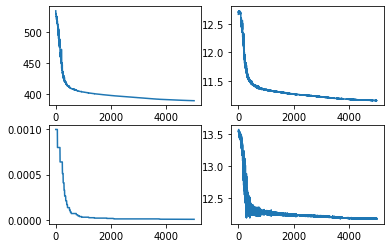

In [15]:
plt.subplot(2,2,1)
plt.plot(history['train']['energy'])
plt.subplot(2,2,2)
plt.plot(history['train']['epe'])
plt.subplot(2,2,3)
plt.plot(history['lr'])
plt.subplot(2,2,4)
plt.plot(history['val']['epe'])

In [16]:
dataset = build_dataset(file_paths[0:8], batch_size=1, cache=True, shuffle=False)
pred = model.predict(dataset, verbose=1)

      1/Unknown - 1s 594ms/step

     10/Unknown - 1s 6ms/step  

     17/Unknown - 1s 7ms/step

     22/Unknown - 1s 8ms/step

     31/Unknown - 1s 7ms/step

     40/Unknown - 1s 7ms/step

     49/Unknown - 1s 7ms/step

     59/Unknown - 1s 6ms/step

     65/Unknown - 1s 7ms/step

     71/Unknown - 1s 7ms/step

     77/Unknown - 1s 7ms/step

     83/Unknown - 1s 7ms/step

     90/Unknown - 1s 7ms/step

     97/Unknown - 1s 7ms/step

    102/Unknown - 1s 8ms/step

    107/Unknown - 1s 8ms/step

    113/Unknown - 1s 8ms/step

    119/Unknown - 2s 8ms/step

    126/Unknown - 2s 8ms/step

    135/Unknown - 2s 8ms/step

    145/Unknown - 2s 8ms/step

    154/Unknown - 2s 7ms/step

    163/Unknown - 2s 7ms/step

    172/Unknown - 2s 7ms/step

    181/Unknown - 2s 7ms/step

    190/Unknown - 2s 7ms/step

    200/Unknown - 2s 7ms/step

    209/Unknown - 2s 7ms/step

    219/Unknown - 2s 7ms/step

    229/Unknown - 2s 7ms/step

    239/Unknown - 2s 7ms/step

    248/Unknown - 2s 7ms/step

    257/Unknown - 2s 7ms/step

    266/Unknown - 2s 7ms/step

    275/Unknown - 2s 7ms/step

    284/Unknown - 2s 7ms/step

    293/Unknown - 3s 7ms/step

    302/Unknown - 3s 7ms/step

    311/Unknown - 3s 7ms/step

    319/Unknown - 3s 7ms/step

    326/Unknown - 3s 7ms/step

    335/Unknown - 3s 7ms/step

    344/Unknown - 3s 7ms/step

    353/Unknown - 3s 7ms/step

    362/Unknown - 3s 7ms/step

    371/Unknown - 3s 7ms/step

    380/Unknown - 3s 7ms/step

    389/Unknown - 3s 7ms/step

    398/Unknown - 3s 7ms/step

    407/Unknown - 3s 7ms/step

    416/Unknown - 3s 6ms/step

    425/Unknown - 3s 6ms/step

    432/Unknown - 3s 6ms/step

    440/Unknown - 3s 7ms/step

    449/Unknown - 4s 6ms/step

    456/Unknown - 4s 7ms/step

    464/Unknown - 4s 7ms/step

    473/Unknown - 4s 7ms/step

    482/Unknown - 4s 6ms/step

    491/Unknown - 4s 6ms/step

    500/Unknown - 4s 6ms/step

    509/Unknown - 4s 6ms/step

    518/Unknown - 4s 6ms/step

    526/Unknown - 4s 6ms/step

    535/Unknown - 4s 6ms/step

    543/Unknown - 4s 6ms/step

    550/Unknown - 4s 6ms/step

    557/Unknown - 4s 6ms/step

    566/Unknown - 4s 6ms/step

    575/Unknown - 4s 6ms/step

    584/Unknown - 4s 6ms/step

    593/Unknown - 4s 6ms/step

    602/Unknown - 4s 6ms/step

    611/Unknown - 5s 6ms/step

    620/Unknown - 5s 6ms/step

    629/Unknown - 5s 6ms/step

    638/Unknown - 5s 6ms/step

    647/Unknown - 5s 6ms/step

    656/Unknown - 5s 6ms/step

    666/Unknown - 5s 6ms/step

    676/Unknown - 5s 6ms/step

    686/Unknown - 5s 6ms/step

    695/Unknown - 5s 6ms/step

    705/Unknown - 5s 6ms/step

    714/Unknown - 5s 6ms/step

    724/Unknown - 5s 6ms/step

    733/Unknown - 5s 6ms/step

    743/Unknown - 5s 6ms/step

    752/Unknown - 5s 6ms/step

    762/Unknown - 5s 6ms/step

    771/Unknown - 5s 6ms/step

    781/Unknown - 5s 6ms/step

    790/Unknown - 6s 6ms/step

    798/Unknown - 6s 6ms/step

    807/Unknown - 6s 6ms/step

    817/Unknown - 6s 6ms/step

    826/Unknown - 6s 6ms/step

    835/Unknown - 6s 6ms/step

    845/Unknown - 6s 6ms/step

845/845 [==============================] - 6s 6ms/step


2022-08-23 12:08:39.244241: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 1329070080 exceeds 10% of free system memory.


In [17]:

img_list = []
flow_gt_list = []
for batch in dataset:
    for img in batch[0]:
        img_list.append(img[:, :, 0])        
    for flow in batch[1]:
        flow_gt_list.append(flow)

In [18]:
import matplotlib
import numpy as np

def generate_video(flow, gt: bool=True):
    rgb = []
    def cvt_flow(item):
        mask = np.zeros((item.shape[0], item.shape[1], 3))
        mask[..., 1] = 255
        magnitude, angle = cv.cartToPolar(item[:, :, 0], item[:, :, 1])
        mask[..., 0] = angle * 180 / np.pi / 2
        mask[..., 2] = cv.normalize(magnitude, None, 0, 255, cv.NORM_MINMAX)
        mask = np.array(mask, dtype=np.uint8)
        bgr = cv.cvtColor(mask,cv.COLOR_HSV2BGR)
        rgb2bgr = bgr[:, :, ::-1]
        return rgb2bgr

    def rescale(img):
        img = img - img.min() # Now between 0 and 8674
        img = img / img.max() * 255
        return np.uint8(img)

    for i in range(len(flow)):
        item = flow[i, :, :, 0:2]
        flow_pred = cvt_flow(item)
        img = cv.cvtColor(flow[i, :, :, 2], cv.COLOR_GRAY2RGB)
        img = rescale(img)
        superposed = cv.addWeighted(flow_pred, 1, img, 1, 0)
        if(gt):
            flow_gt = cvt_flow(flow_gt_list[i].numpy())
            combined = cv.hconcat([flow_pred, flow_gt, img, superposed])
        else:
            combined = cv.hconcat([flow_pred, img, superposed])
        rgb.append(combined) 

    frame = 0
    dpi = 72
    xpixels, ypixels = rgb[0].shape[:2]
    fig = plt.figure(figsize=(ypixels/dpi, xpixels/dpi), dpi=dpi)
    im = plt.figimage(rgb[0])
    plt.figure(figsize=(20, 16))
    # # Opens a new window and displays the output frame
    plt.imshow(rgb[20]) 
    def animate(i):
        im.set_array(rgb[i])
        im.autoscale()
        return (im,)

    anim = animation.FuncAnimation(fig, animate, frames=len(rgb), interval=33, repeat_delay=1, repeat=True)
    display(HTML(anim.to_html5_video()))

<Figure size 1024x128 with 0 Axes>

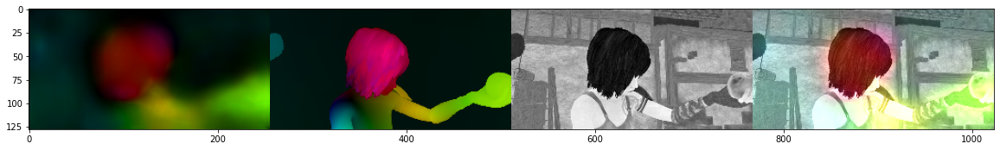

In [19]:
generate_video(pred[0], gt=True)

<Figure size 1024x128 with 0 Axes>

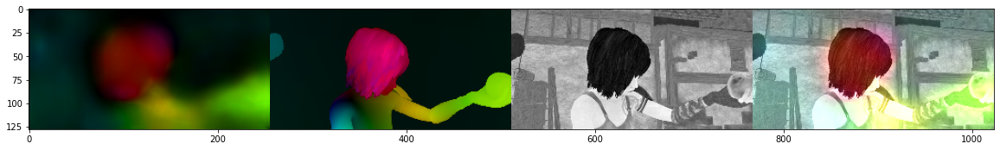

In [20]:
generate_video(pred[0], gt=True)

<Figure size 1024x128 with 0 Axes>

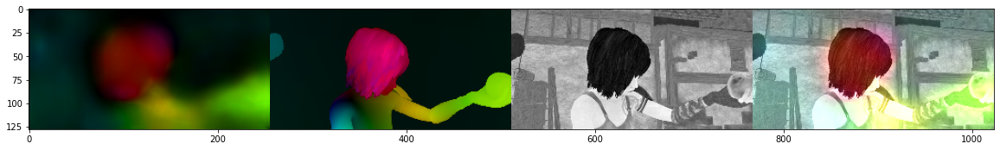

In [21]:
generate_video(pred[0], gt=True)

<Figure size 384x64 with 0 Axes>

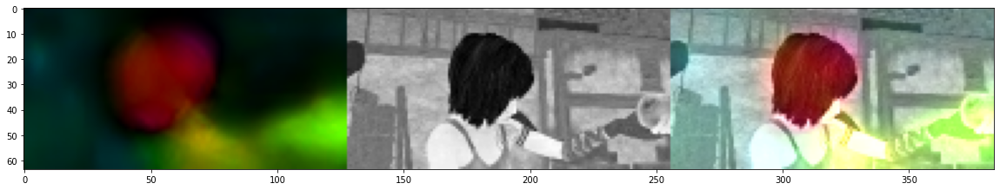

In [22]:
generate_video(pred[1], gt=False)

<Figure size 192x32 with 0 Axes>

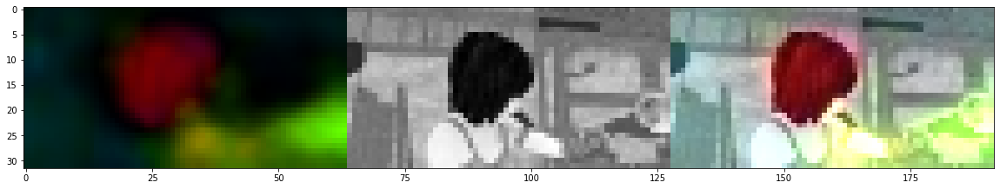

In [23]:
generate_video(pred[2], gt=False)

<Figure size 96x16 with 0 Axes>

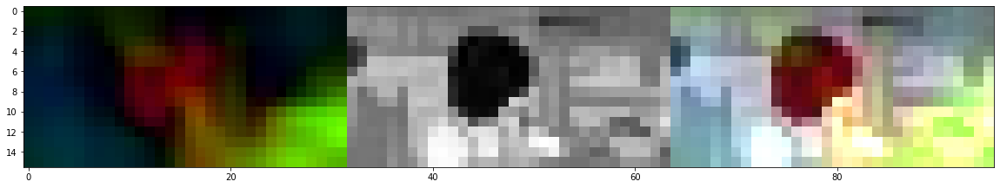

In [24]:
generate_video(pred[3], gt=False)

<Figure size 48x8 with 0 Axes>

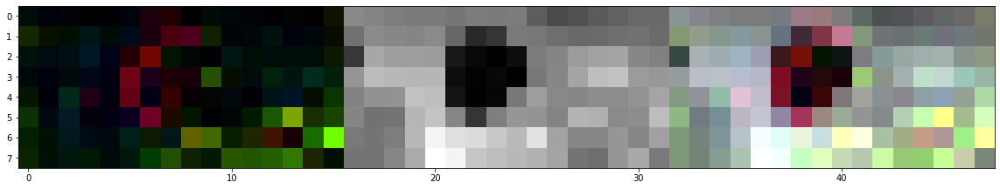

In [25]:
generate_video(pred[4], gt=False)

In [26]:
# plt.imshow(tf.sqrt(pred[0][0, :, :, 8]**2 + pred[0][0, :, :, 9]**2).numpy(), cmap='gray')

In [27]:
# plt.imshow(tf.sqrt( pred[0][0, :, :, 8]**2 + pred[0][0, :, :, 4]**2 + pred[0][0, :, :, 5]**2 + pred[0][0, :, :, 9]**2), cmap='gray')

      1/Unknown - 0s 50ms/step

     10/Unknown - 0s 6ms/step 

     18/Unknown - 0s 6ms/step

     27/Unknown - 0s 6ms/step

     36/Unknown - 0s 6ms/step

     44/Unknown - 0s 6ms/step

     52/Unknown - 0s 6ms/step

     61/Unknown - 0s 6ms/step

     70/Unknown - 0s 6ms/step

     79/Unknown - 1s 6ms/step

     88/Unknown - 1s 6ms/step

     97/Unknown - 1s 6ms/step

    106/Unknown - 1s 6ms/step

    115/Unknown - 1s 6ms/step

    124/Unknown - 1s 6ms/step

    133/Unknown - 1s 6ms/step

    143/Unknown - 1s 6ms/step

    152/Unknown - 1s 6ms/step

    161/Unknown - 1s 6ms/step

    170/Unknown - 1s 6ms/step

    179/Unknown - 1s 6ms/step

    188/Unknown - 1s 6ms/step

196/196 [==============================] - 1s 6ms/step


<Figure size 1024x128 with 0 Axes>

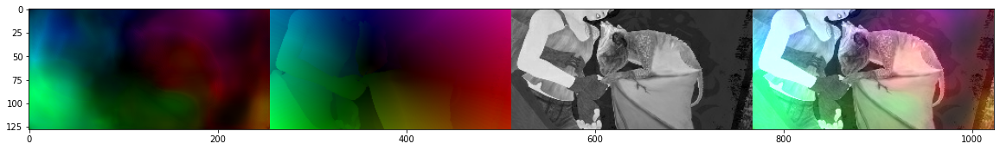

In [28]:
dataset = build_dataset(file_paths[8:], batch_size=1, cache=False, test=False)
img_list = []
flow_gt_list = []
for batch in dataset:
    for img in batch[0]:
        img_list.append(img[:, :, 0])        
    for flow in batch[1]:
        flow_gt_list.append(flow)
pred = model.predict(dataset, verbose=1)
generate_video(pred[0], gt=True)

      1/Unknown - 0s 464ms/step

      6/Unknown - 1s 10ms/step 

     12/Unknown - 1s 9ms/step 

     20/Unknown - 1s 8ms/step

     27/Unknown - 1s 8ms/step

     34/Unknown - 1s 8ms/step

     41/Unknown - 1s 8ms/step

     48/Unknown - 1s 8ms/step

     54/Unknown - 1s 8ms/step

     60/Unknown - 1s 8ms/step

     67/Unknown - 1s 8ms/step

     74/Unknown - 1s 8ms/step

     82/Unknown - 1s 8ms/step

     89/Unknown - 1s 8ms/step

     96/Unknown - 1s 8ms/step

    104/Unknown - 1s 8ms/step

    111/Unknown - 1s 8ms/step

    118/Unknown - 1s 8ms/step

    125/Unknown - 1s 8ms/step

    132/Unknown - 1s 8ms/step

    140/Unknown - 2s 8ms/step

    146/Unknown - 2s 8ms/step

    152/Unknown - 2s 8ms/step

    158/Unknown - 2s 8ms/step

    166/Unknown - 2s 8ms/step

    174/Unknown - 2s 8ms/step

    181/Unknown - 2s 8ms/step

    188/Unknown - 2s 8ms/step

    196/Unknown - 2s 8ms/step

    204/Unknown - 2s 8ms/step

    212/Unknown - 2s 8ms/step

    219/Unknown - 2s 8ms/step

    225/Unknown - 2s 8ms/step

    231/Unknown - 2s 8ms/step

    238/Unknown - 2s 8ms/step

    245/Unknown - 2s 8ms/step

    253/Unknown - 2s 8ms/step

    259/Unknown - 2s 8ms/step

    267/Unknown - 2s 8ms/step

    275/Unknown - 3s 8ms/step

    282/Unknown - 3s 8ms/step

    289/Unknown - 3s 8ms/step

    296/Unknown - 3s 8ms/step

    304/Unknown - 3s 8ms/step

    312/Unknown - 3s 8ms/step

    320/Unknown - 3s 8ms/step

    327/Unknown - 3s 8ms/step

    335/Unknown - 3s 7ms/step

    342/Unknown - 3s 7ms/step

    349/Unknown - 3s 7ms/step

    357/Unknown - 3s 7ms/step

    364/Unknown - 3s 7ms/step

    372/Unknown - 3s 7ms/step

    380/Unknown - 3s 7ms/step

    387/Unknown - 3s 7ms/step

    395/Unknown - 3s 7ms/step

    402/Unknown - 3s 7ms/step

    410/Unknown - 4s 7ms/step

    418/Unknown - 4s 7ms/step

    426/Unknown - 4s 7ms/step

    434/Unknown - 4s 7ms/step

    441/Unknown - 4s 7ms/step

    449/Unknown - 4s 7ms/step

    456/Unknown - 4s 7ms/step

    463/Unknown - 4s 7ms/step

    470/Unknown - 4s 7ms/step

    478/Unknown - 4s 7ms/step

    486/Unknown - 4s 7ms/step

    493/Unknown - 4s 7ms/step

    500/Unknown - 4s 7ms/step

    508/Unknown - 4s 7ms/step

    516/Unknown - 4s 7ms/step

    523/Unknown - 4s 7ms/step

    530/Unknown - 4s 7ms/step

    538/Unknown - 4s 7ms/step

    547/Unknown - 4s 7ms/step

552/552 [==============================] - 4s 7ms/step


<Figure size 768x128 with 0 Axes>

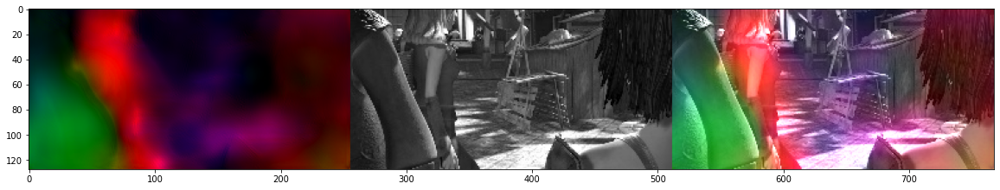

In [29]:
dataset = build_dataset( tf.io.gfile.glob('../input/mpisinteltfrecord/test/clean/*'), batch_size=1, cache=False, test=True)
pred = model.predict(dataset, verbose=1)
generate_video(pred[0], gt=False)

In [ ]:
!zip -r result.zip ./